In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import warnings

In [2]:
warnings.filterwarnings('ignore')

In [89]:
bureau = pd.read_csv('bureau.csv')

In [4]:
bureau.head(2).T

,0,1
SK_ID_CURR,215354,215354
SK_ID_BUREAU,5714462,5714463
CREDIT_ACTIVE,Closed,Active
CREDIT_CURRENCY,currency 1,currency 1
DAYS_CREDIT,-497,-208
CREDIT_DAY_OVERDUE,0,0
DAYS_CREDIT_ENDDATE,-153,1075
DAYS_ENDDATE_FACT,-153,NaN
AMT_CREDIT_MAX_OVERDUE,NaN,NaN
CNT_CREDIT_PROLONG,0,0


One SK_ID_CURR has more than one SK_ID_BUREAU

In [5]:
bureau['SK_ID_CURR'].nunique()

305811

In [6]:
bureau['SK_ID_BUREAU'].nunique()

1716428

In [7]:
bureau['SK_ID_BUREAU'].nunique()/bureau['SK_ID_CURR'].nunique()

5.612708502964249

On an average one SK_ID_CURR has 5 sk_id_bureau, which means for one customer's application there's an average of 5 bureau data.

In [8]:
bureau['CREDIT_ACTIVE'].value_counts()

Closed      1079273
Active       630607
Sold           6527
Bad debt         21
Name: CREDIT_ACTIVE, dtype: int64

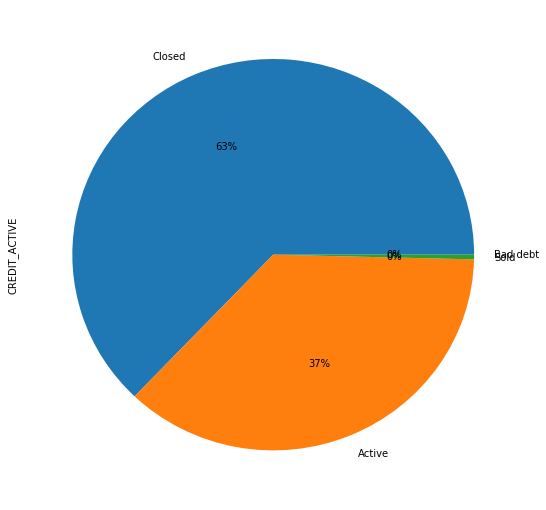

In [9]:
plt.figure(figsize=(9,9))
bureau['CREDIT_ACTIVE'].value_counts().plot.pie(autopct='%1.0f%%')
plt.show()

In [10]:
bureau['CREDIT_CURRENCY'].value_counts()

currency 1    1715020
currency 2       1224
currency 3        174
currency 4         10
Name: CREDIT_CURRENCY, dtype: int64

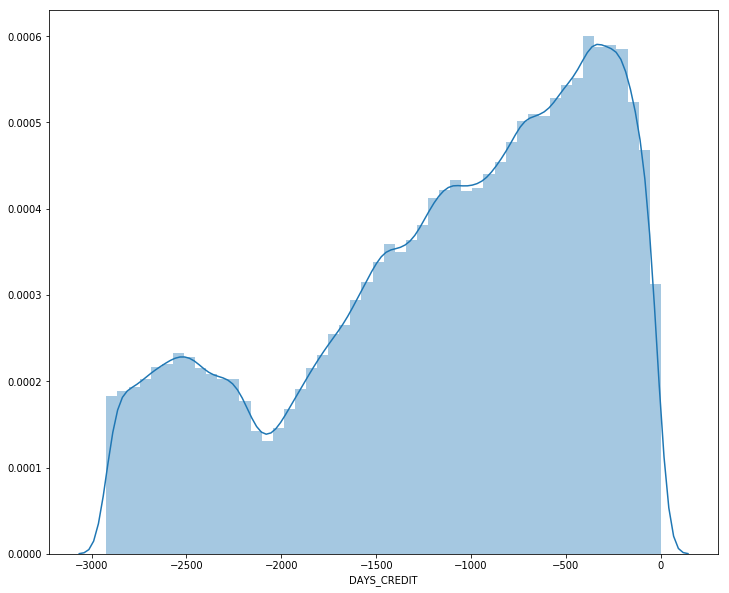

In [11]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['DAYS_CREDIT'])
plt.show()

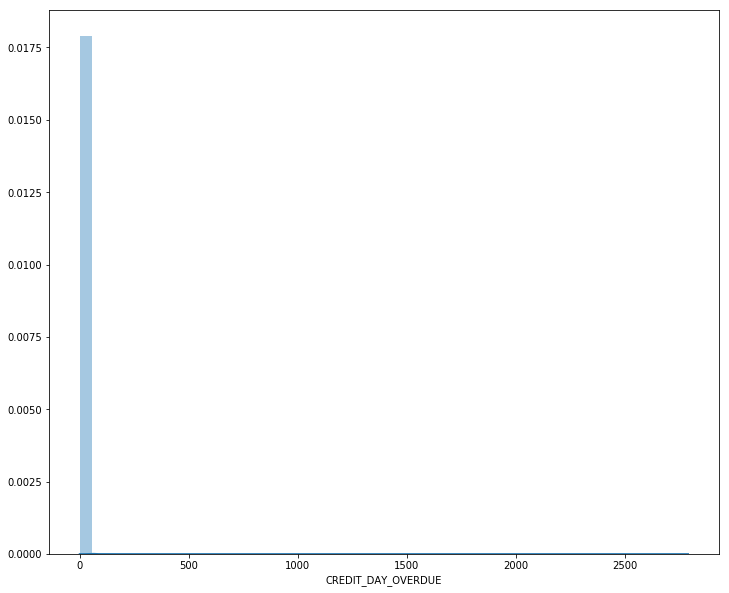

In [12]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['CREDIT_DAY_OVERDUE'])
plt.show()

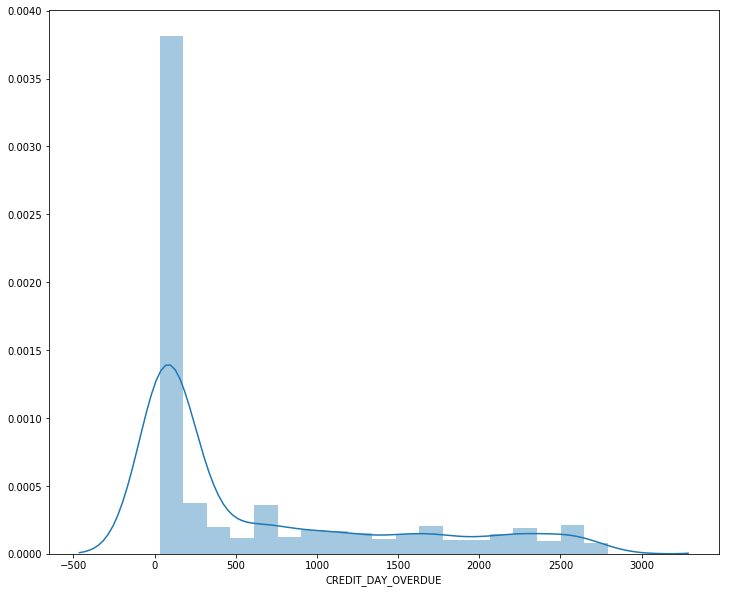

In [13]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_DAY_OVERDUE']>30]['CREDIT_DAY_OVERDUE'])
plt.show()

This data is highly skewed to the left, some non-linear transformation may help

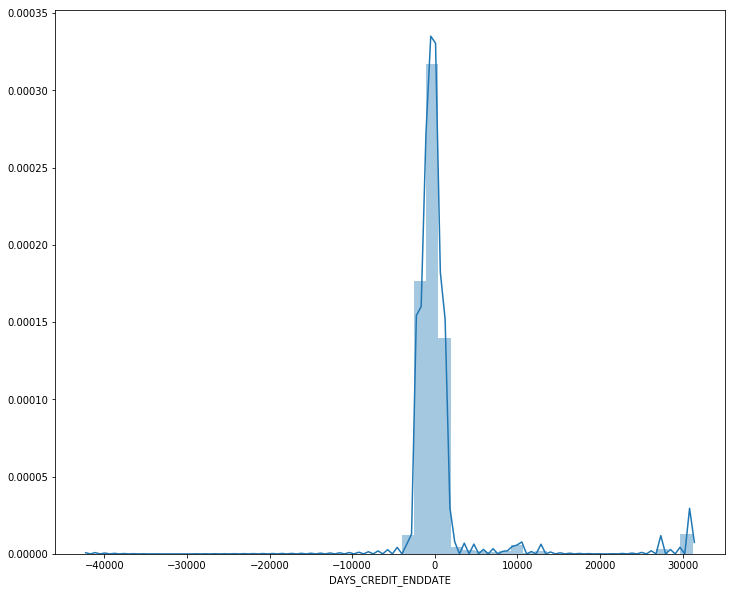

In [14]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['DAYS_CREDIT_ENDDATE'].dropna())
plt.show()

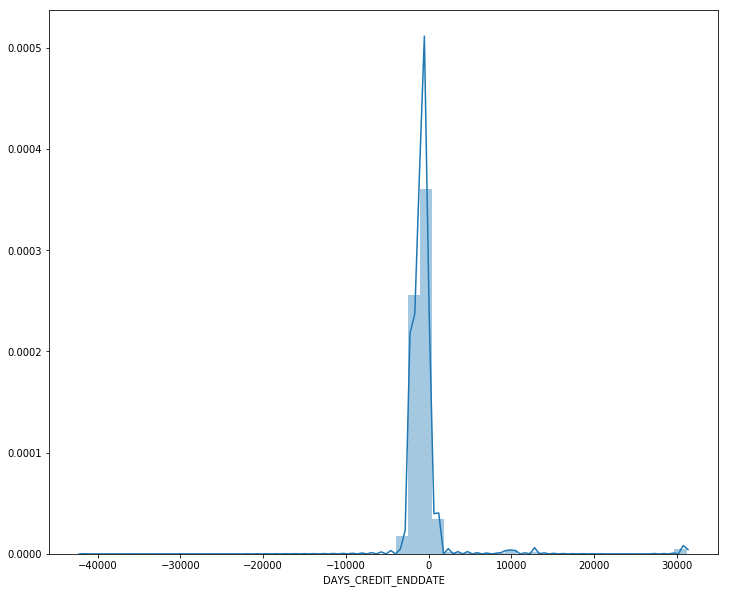

In [15]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Closed']['DAYS_CREDIT_ENDDATE'].dropna())
plt.show()

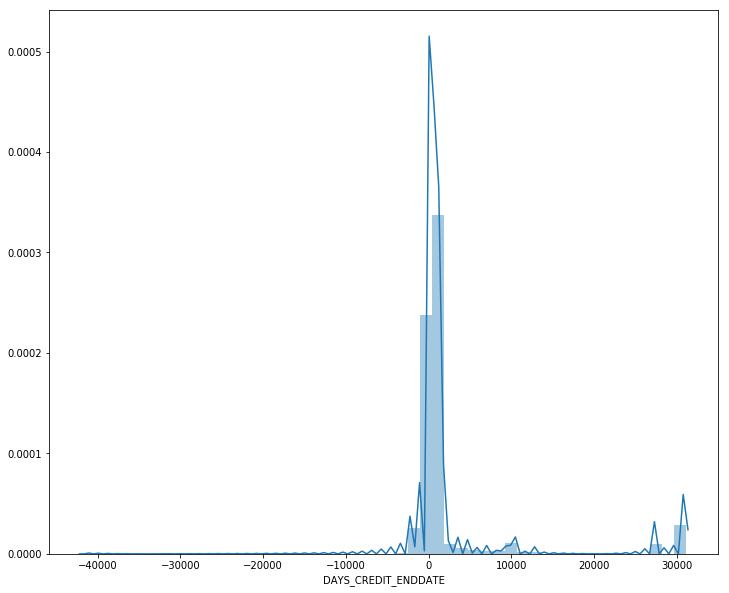

In [16]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Active']['DAYS_CREDIT_ENDDATE'].dropna())
plt.show()

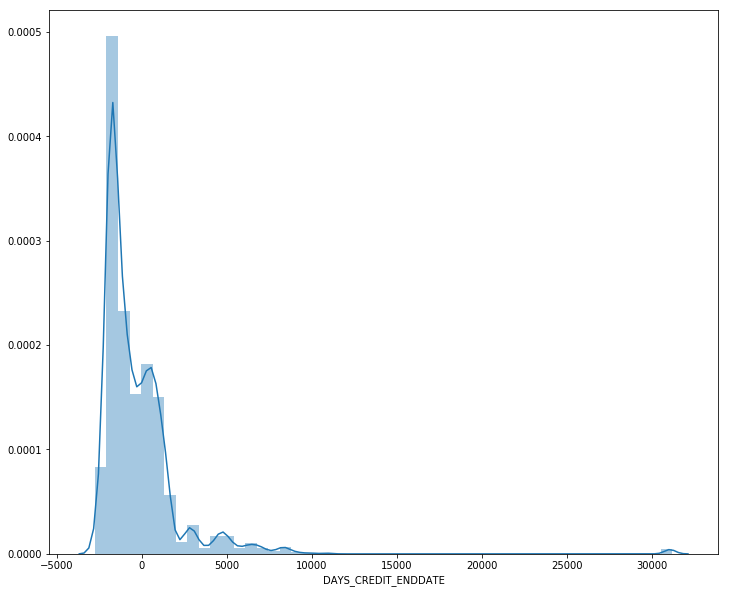

In [17]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Sold']['DAYS_CREDIT_ENDDATE'].dropna())
plt.show()

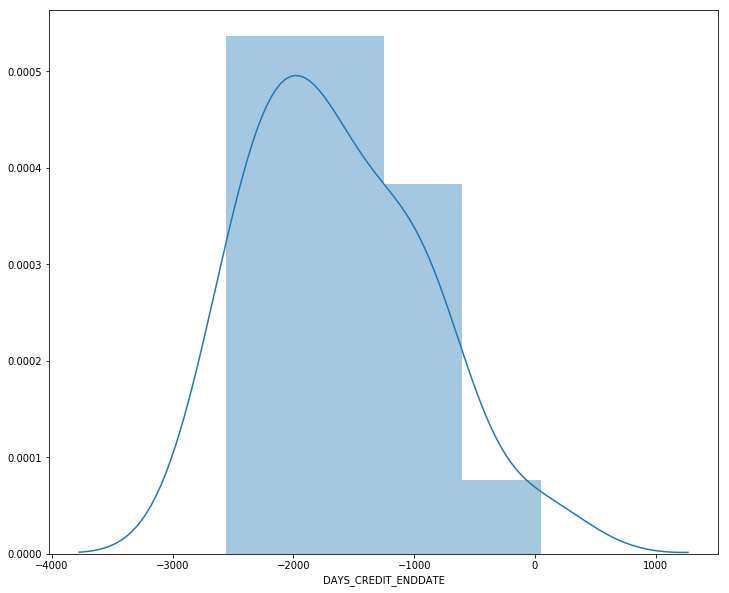

In [18]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Bad debt']['DAYS_CREDIT_ENDDATE'].dropna())
plt.show()

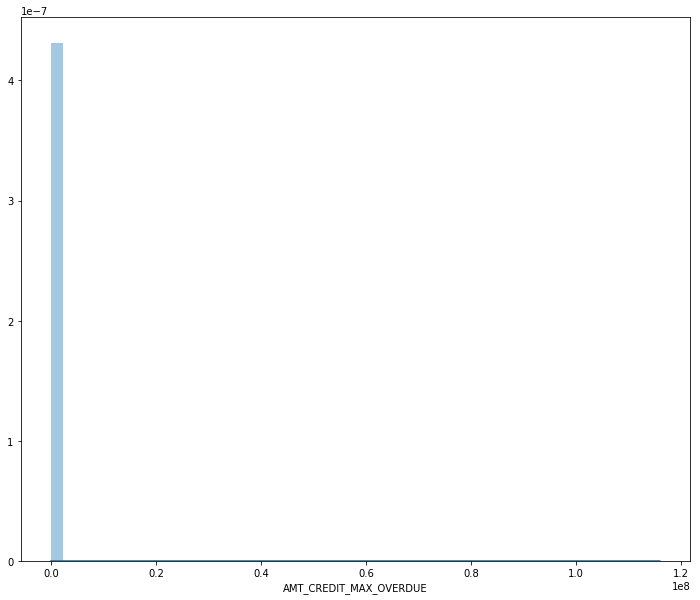

In [19]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['AMT_CREDIT_MAX_OVERDUE'].dropna())
plt.show()

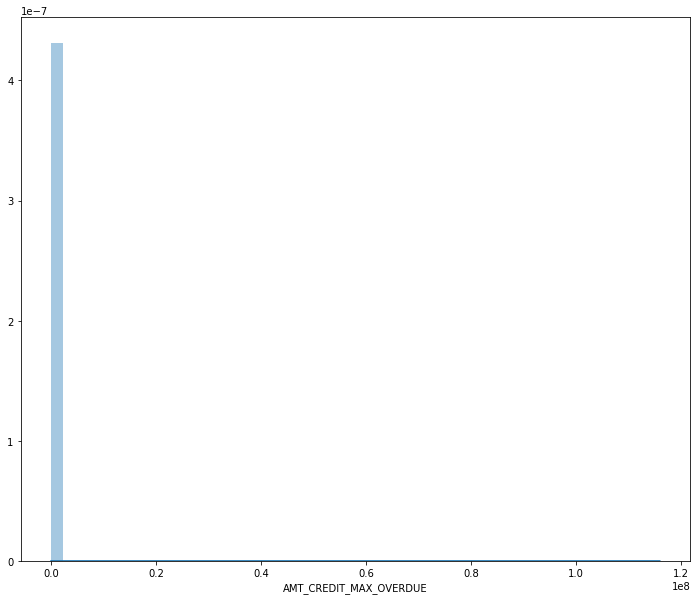

In [20]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Closed']['AMT_CREDIT_MAX_OVERDUE'].dropna())
plt.show()

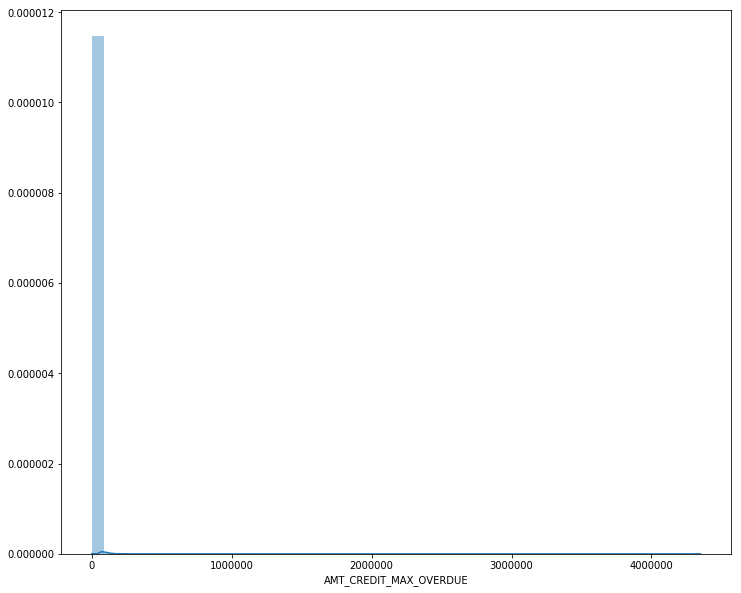

In [21]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Active']['AMT_CREDIT_MAX_OVERDUE'].dropna())
plt.show()

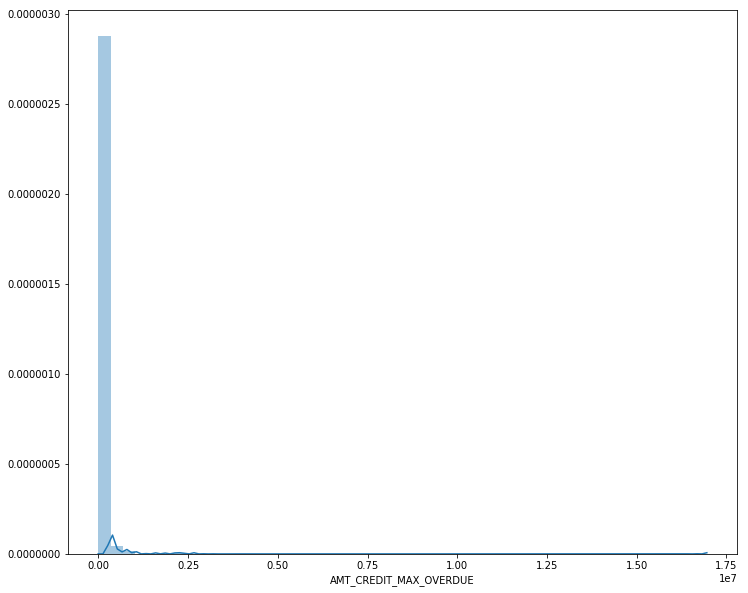

In [22]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Sold']['AMT_CREDIT_MAX_OVERDUE'].dropna())
plt.show()

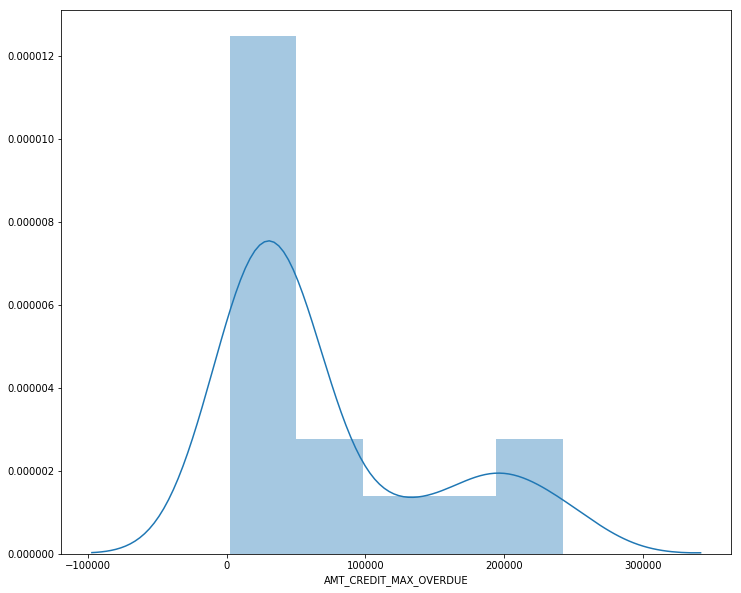

In [23]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Bad debt']['AMT_CREDIT_MAX_OVERDUE'].dropna())
plt.show()

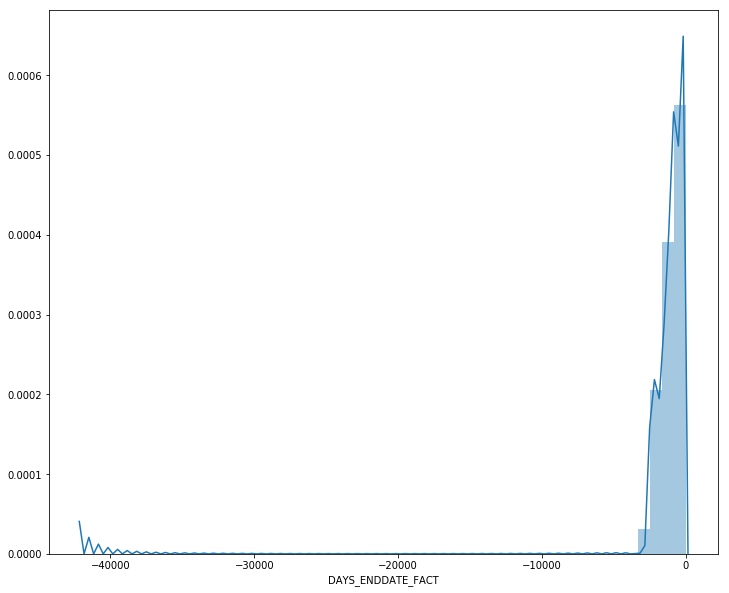

In [24]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['DAYS_ENDDATE_FACT'].dropna())
plt.show()

In [25]:
bureau[bureau['DAYS_ENDDATE_FACT'].isnull()]['CREDIT_ACTIVE'].value_counts()

Active      628638
Sold          4879
Closed         125
Bad debt        11
Name: CREDIT_ACTIVE, dtype: int64

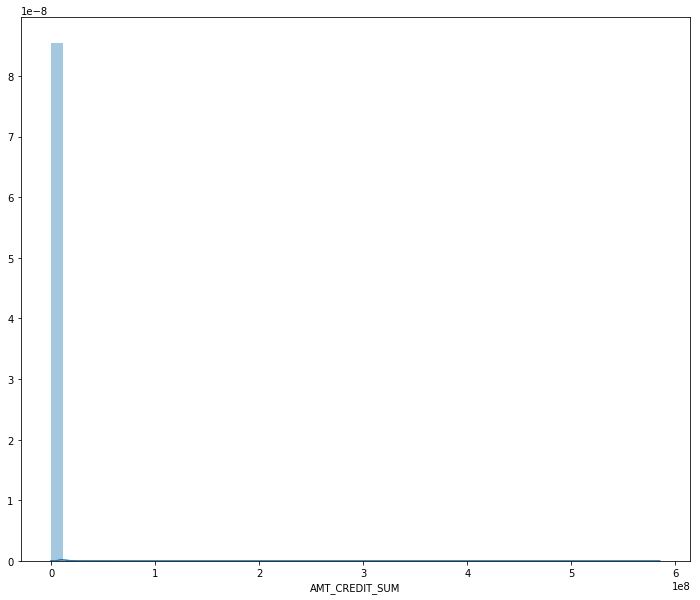

In [26]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['AMT_CREDIT_SUM'].dropna())
plt.show()

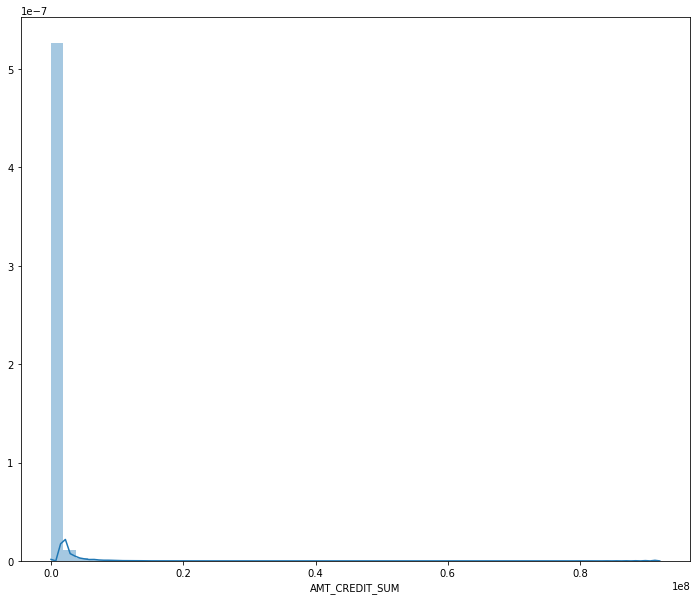

In [27]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['AMT_CREDIT_SUM']<1e8]['AMT_CREDIT_SUM'].dropna())
plt.show()

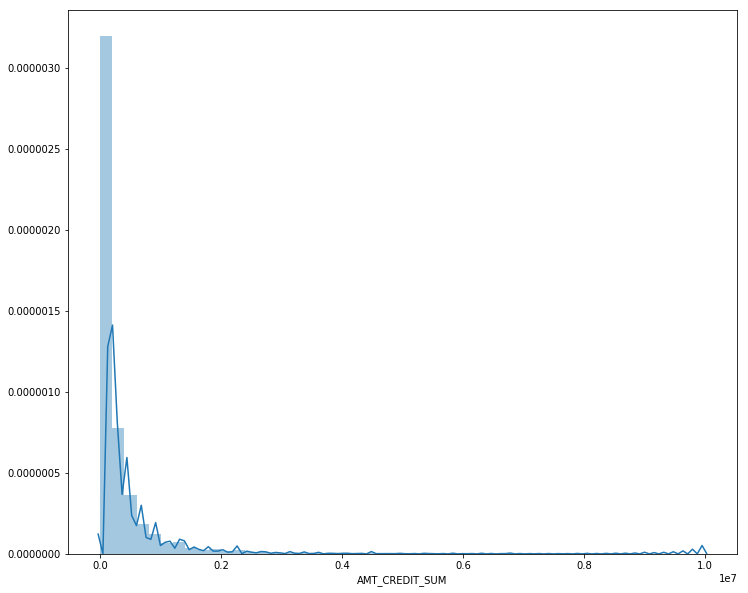

In [28]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['AMT_CREDIT_SUM']<1e7]['AMT_CREDIT_SUM'].dropna())
plt.show()

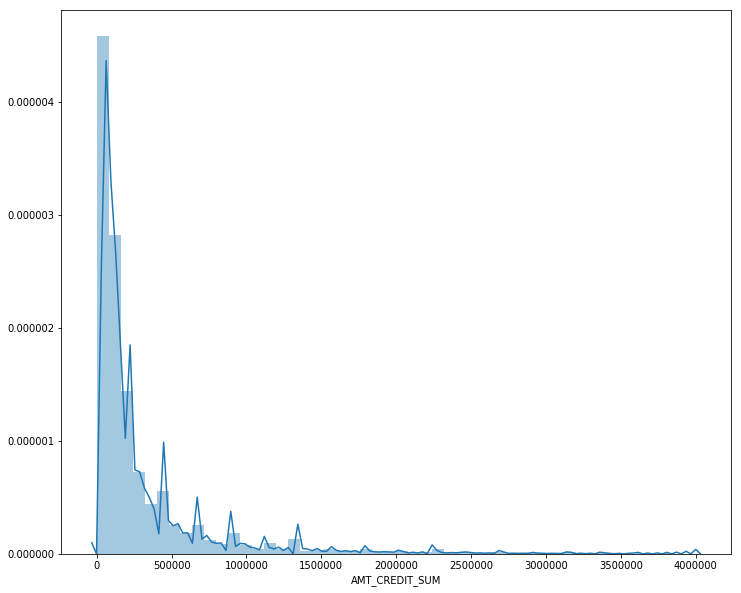

In [29]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['AMT_CREDIT_SUM']<4e6]['AMT_CREDIT_SUM'].dropna())
plt.show()

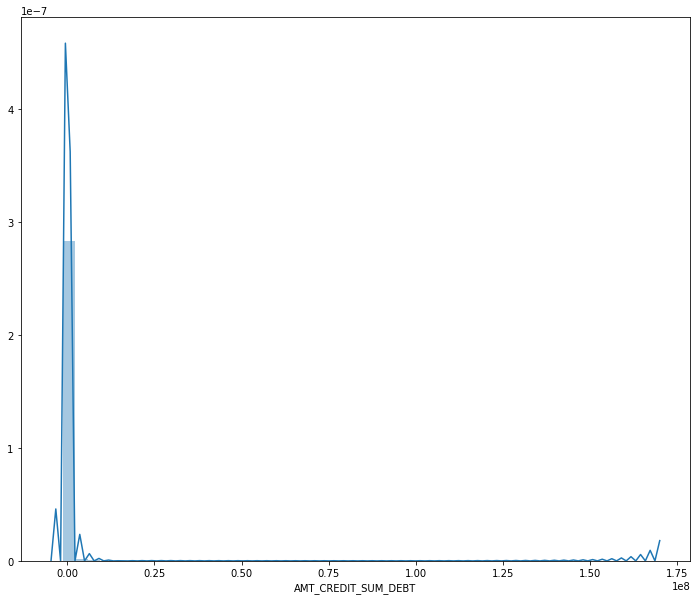

In [30]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['AMT_CREDIT_SUM_DEBT'].dropna())
plt.show()

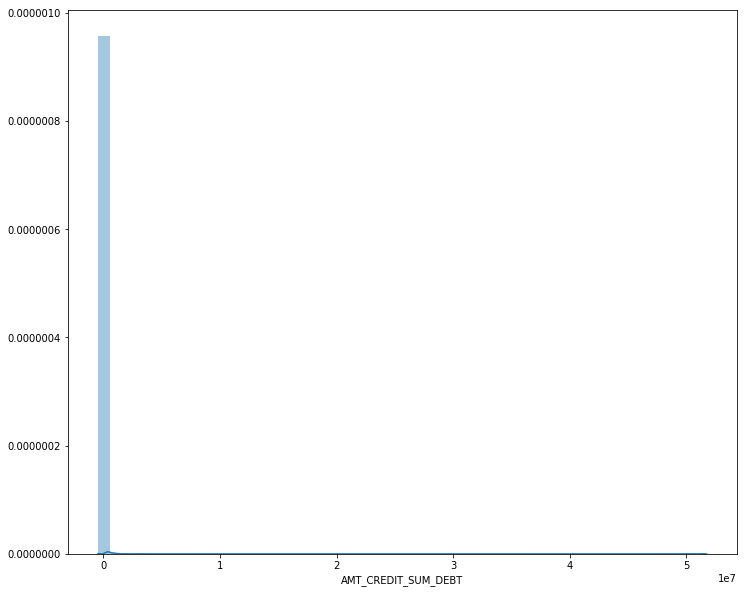

In [31]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Closed']['AMT_CREDIT_SUM_DEBT'].dropna())
plt.show()

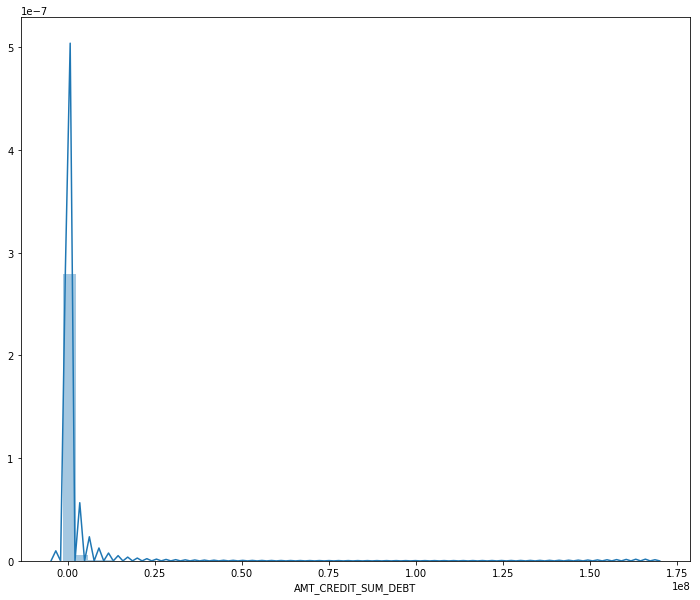

In [32]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Active']['AMT_CREDIT_SUM_DEBT'].dropna())
plt.show()

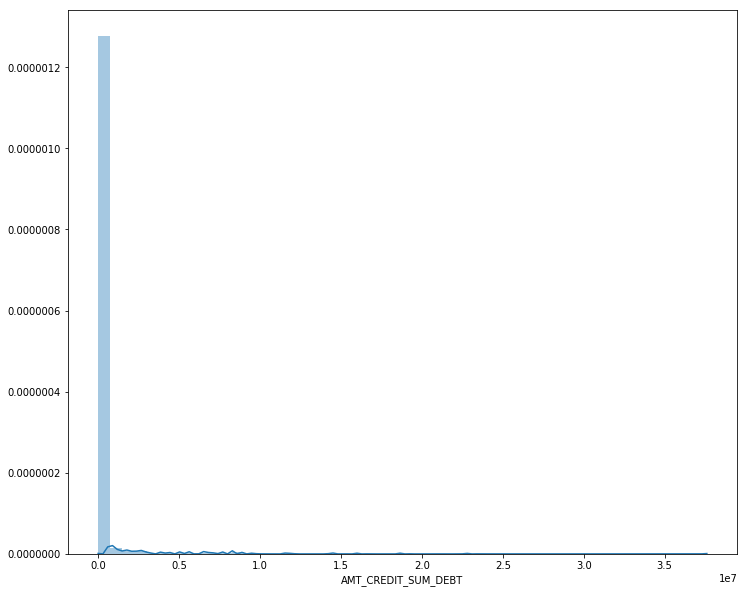

In [33]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Sold']['AMT_CREDIT_SUM_DEBT'].dropna())
plt.show()

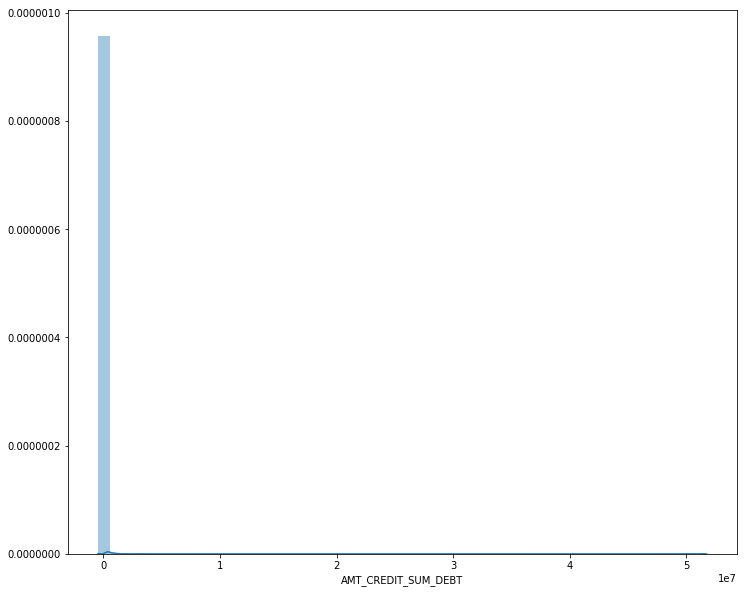

In [34]:
plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['CREDIT_ACTIVE']=='Closed']['AMT_CREDIT_SUM_DEBT'].dropna())
plt.show()

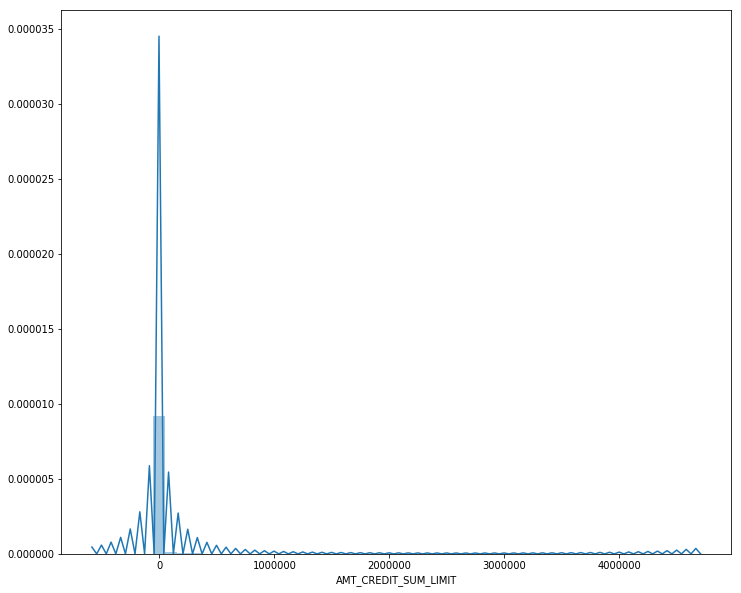

In [35]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['AMT_CREDIT_SUM_LIMIT'].dropna())
plt.show()

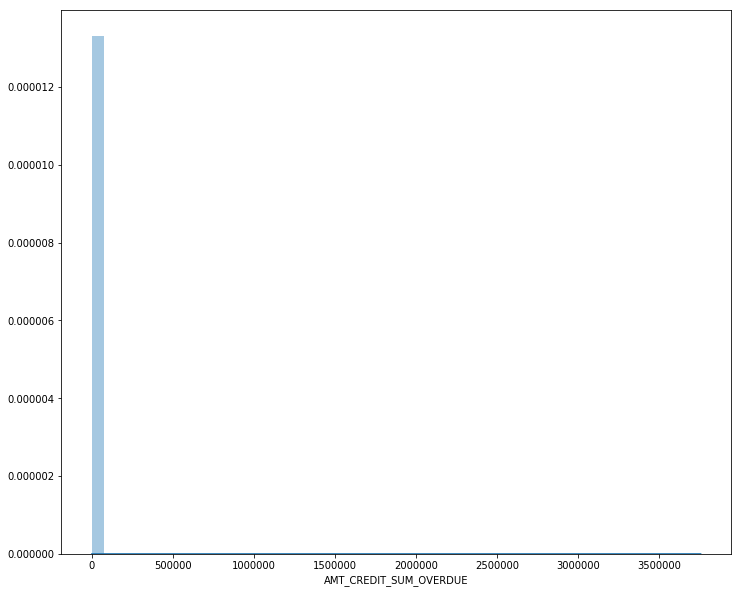

In [36]:
plt.figure(figsize=(12,10))
sns.distplot(bureau['AMT_CREDIT_SUM_OVERDUE'].dropna())
plt.show()

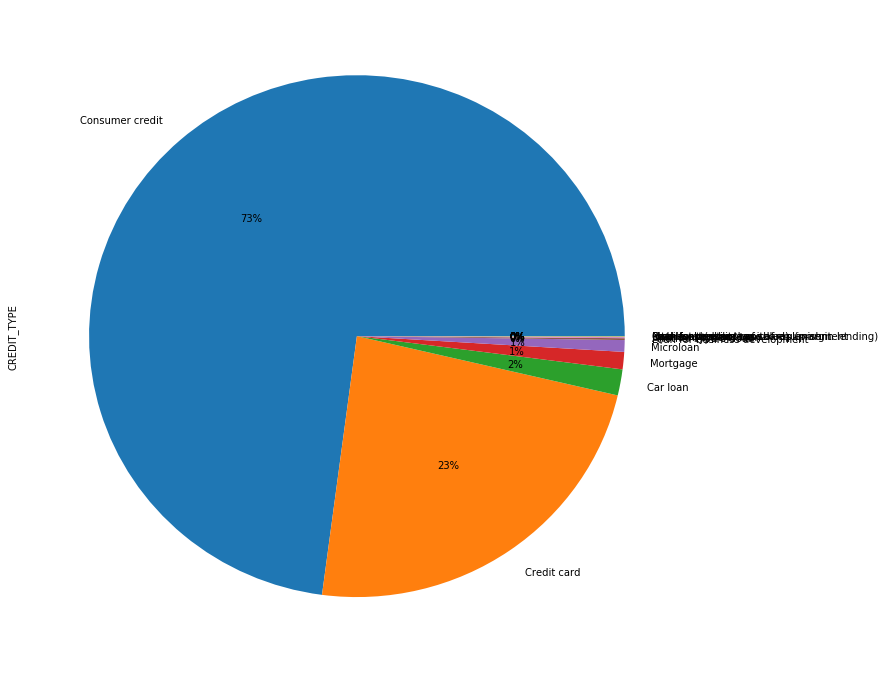

In [37]:
fig = plt.figure(figsize=(12,12))
bureau['CREDIT_TYPE'].value_counts().plot.pie(autopct='%1.0f%%')
plt.show()

In [38]:
bureau['CREDIT_TYPE'].value_counts()

Consumer credit                                 1251615
Credit card                                      402195
Car loan                                          27690
Mortgage                                          18391
Microloan                                         12413
Loan for business development                      1975
Another type of loan                               1017
Unknown type of loan                                555
Loan for working capital replenishment              469
Cash loan (non-earmarked)                            56
Real estate loan                                     27
Loan for the purchase of equipment                   19
Loan for purchase of shares (margin lending)          4
Interbank credit                                      1
Mobile operator loan                                  1
Name: CREDIT_TYPE, dtype: int64

There are some pretty rare types of credit removing which may benefit our model.

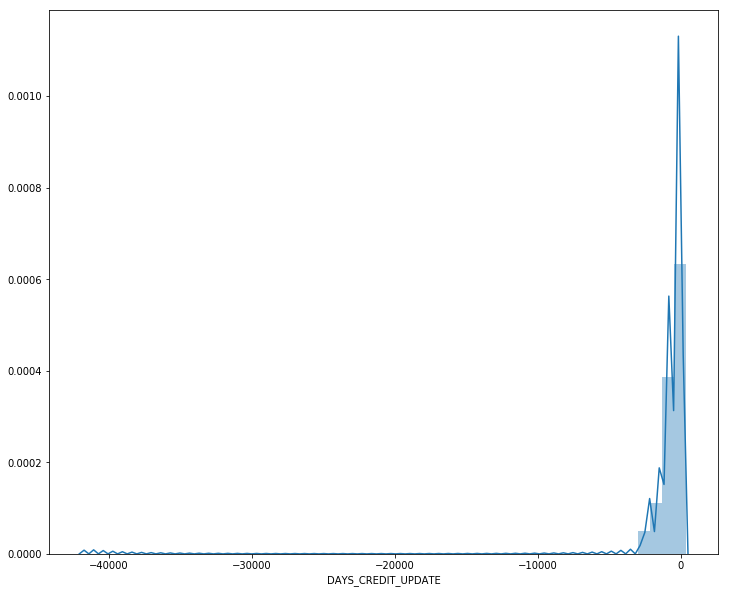

In [39]:
fig = plt.figure(figsize=(12,10))
sns.distplot(bureau['DAYS_CREDIT_UPDATE'])
plt.show()

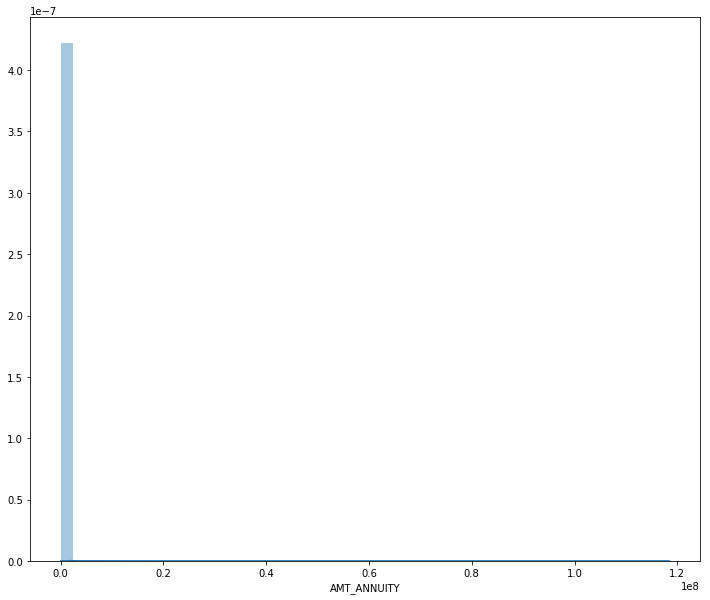

In [40]:
fig = plt.figure(figsize=(12,10))
sns.distplot(bureau['AMT_ANNUITY'].dropna())
plt.show()

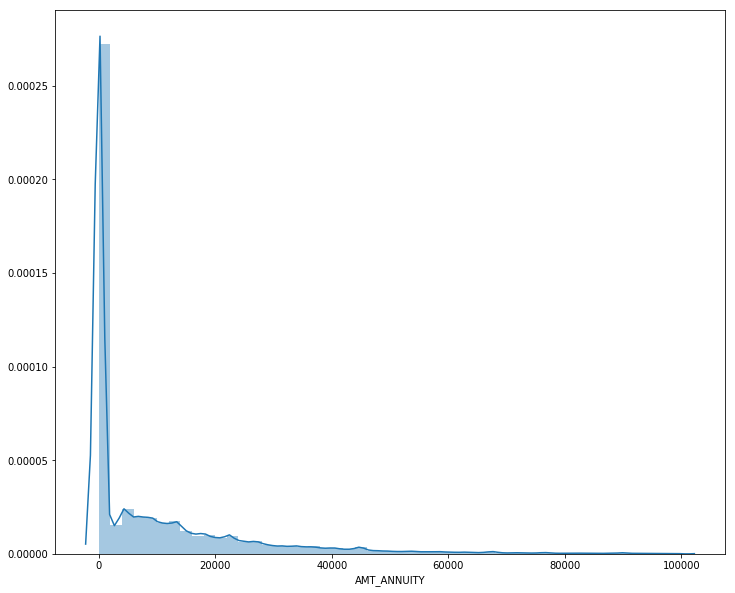

In [41]:
fig = plt.figure(figsize=(12,10))
sns.distplot(bureau[bureau['AMT_ANNUITY']<1e5]['AMT_ANNUITY'].dropna())
plt.show()

All these data are highly skewed to the left, which is not at all a good sign for linear models

## Combined Interactions

In [42]:
bureau.describe()

,SK_ID_CURR,SK_ID_BUREAU,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
count,1.716428e+06,1.716428e+06,1.716428e+06,1.716428e+06,1.610875e+06,1.082775e+06,5.919400e+05,1.716428e+06,1.716415e+06,1.458759e+06,1.124648e+06,1.716428e+06,1.716428e+06,4.896370e+05
mean,2.782149e+05,5.924434e+06,-1.142108e+03,8.181666e-01,5.105174e+02,-1.017437e+03,3.825418e+03,6.410406e-03,3.549946e+05,1.370851e+05,6.229515e+03,3.791276e+01,-5.937483e+02,1.571276e+04
std,1.029386e+05,5.322657e+05,7.951649e+02,3.654443e+01,4.994220e+03,7.140106e+02,2.060316e+05,9.622391e-02,1.149811e+06,6.774011e+05,4.503203e+04,5.937650e+03,7.207473e+02,3.258269e+05
min,1.000010e+05,5.000000e+06,-2.922000e+03,0.000000e+00,-4.206000e+04,-4.202300e+04,0.000000e+00,0.000000e+00,0.000000e+00,-4.705600e+06,-5.864061e+05,0.000000e+00,-4.194700e+04,0.000000e+00
25%,1.888668e+05,5.463954e+06,-1.666000e+03,0.000000e+00,-1.138000e+03,-1.489000e+03,0.000000e+00,0.000000e+00,5.130000e+04,0.000000e+00,0.000000e+00,0.000000e+00,-9.080000e+02,0.000000e+00
50%,2.780550e+05,5.926304e+06,-9.870000e+02,0.000000e+00,-3.300000e+02,-8.970000e+02,0.000000e+00,0.000000e+00,1.255185e+05,0.000000e+00,0.000000e+00,0.000000e+00,-3.950000e+02,0.000000e+00
75%,3.674260e+05,6.385681e+06,-4.740000e+02,0.000000e+00,4.740000e+02,-4.250000e+02,0.000000e+00,0.000000e+00,3.150000e+05,4.015350e+04,0.000000e+00,0.000000e+00,-3.300000e+01,1.350000e+04
max,4.562550e+05,6.843457e+06,0.000000e+00,2.792000e+03,3.119900e+04,0.000000e+00,1.159872e+08,9.000000e+00,5.850000e+08,1.701000e+08,4.705600e+06,3.756681e+06,3.720000e+02,1.184534e+08


<Figure size 1152x1152 with 0 Axes>

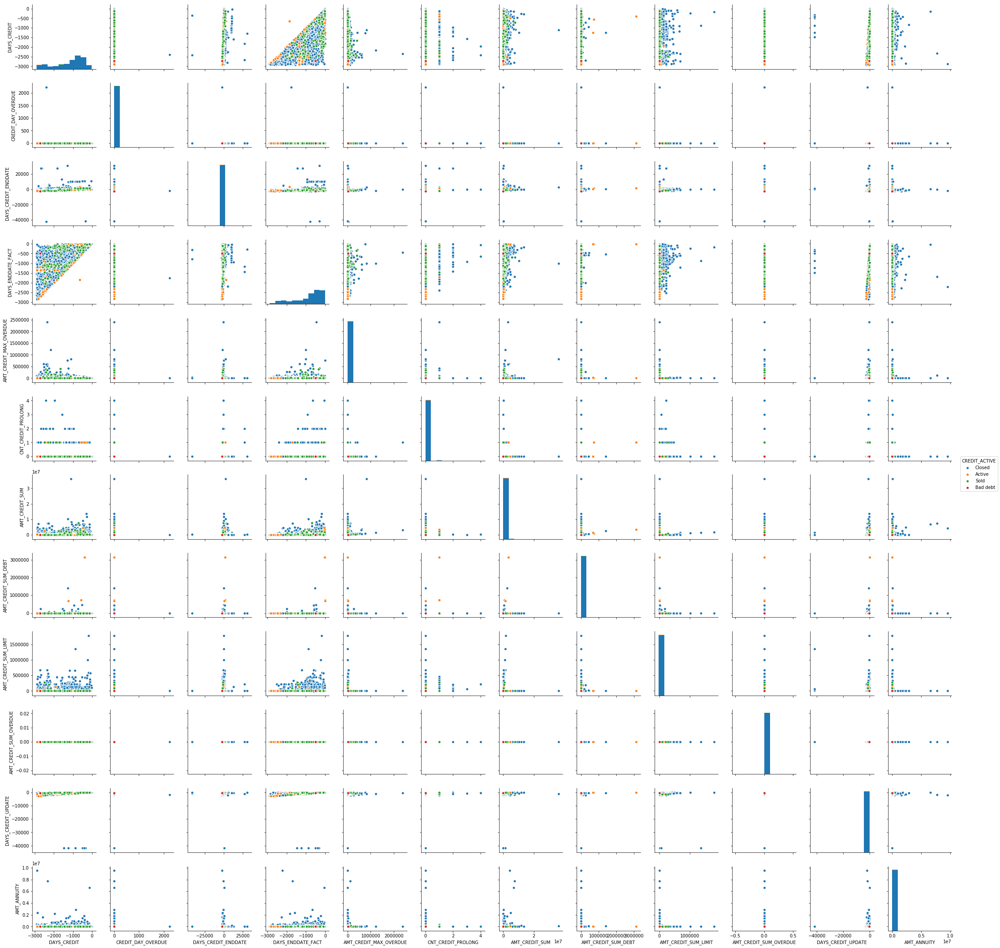

In [43]:
plt.figure(figsize=(16,16))
sns.pairplot(bureau.drop(['CREDIT_TYPE', 'CREDIT_CURRENCY', 'SK_ID_CURR','SK_ID_BUREAU'], axis=1).dropna(), hue='CREDIT_ACTIVE')
plt.show()

In [11]:
bureau_balance = pd.read_csv('bureau_balance.csv')

In [45]:
bureau.shape

(1716428, 17)

In [46]:
bureau_balance.shape

(27299925, 3)

In [48]:
bureau['SK_ID_BUREAU'].nunique()

1716428

In [49]:
bureau_balance['SK_ID_BUREAU'].nunique()

817395

In [50]:
bureau_balance.shape[0]/bureau_balance['SK_ID_BUREAU'].nunique()

33.39869341016277

In [6]:
bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY,HAS_BUREAU_BALANCE
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN,True
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN,True
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN,True
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN,True
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN,True


In [13]:
bureau_balance.head(20).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
SK_ID_BUREAU,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448,5715448
MONTHS_BALANCE,0,-1,-2,-3,-4,-5,-6,-7,-8,-9,-10,-11,-12,-13,-14,-15,-16,-17,-18,-19
STATUS,C,C,C,C,C,C,C,C,C,0,0,X,X,X,0,0,0,0,0,0


In [14]:
bureau_balance.STATUS.value_counts

C    13646993
0     7499507
X     5810482
1      242347
5       62406
2       23419
3        8924
4        5847
Name: STATUS, dtype: int64

In [17]:
bureau_balance['STATUS_X'] = bureau_balance['STATUS']=='X'

In [19]:
bureau_balance['STATUS_X'] = bureau_balance['STATUS_X'].apply(int)

In [21]:
bureau_balance['STATUS'].replace('C', -5, inplace=True)

In [43]:
bureau_balance.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS,STATUS_X
0,5715448,0,-5,0
1,5715448,-1,-5,0
2,5715448,-2,-5,0
3,5715448,-3,-5,0
4,5715448,-4,-5,0


In [31]:
bureau_balance_agg = {}
bureau_balance_agg['score'] = []
bureau_balance_agg['SK_ID_BUREAU'] = []
j = 0
for i in bureau_balance.SK_ID_BUREAU.unique():
    agg = 0
    for row in bureau_balance[bureau_balance['SK_ID_BUREAU']==i].iterrows():
        #print(row[1]['STATUS'])
        if row[1]['STATUS'] == 'X':
            pass
        else:
            agg = agg + np.exp(row[1]['MONTHS_BALANCE'])*int(row[1]['STATUS'])
    bureau_balance_agg['SK_ID_BUREAU'].append(i)
    bureau_balance_agg['score'].append(agg)
    j += 1
    print('{} jobs done'.format(j))

1 jobs done
2 jobs done
3 jobs done
4 jobs done
5 jobs done
6 jobs done
7 jobs done
8 jobs done
9 jobs done
10 jobs done
11 jobs done
12 jobs done
13 jobs done
14 jobs done
15 jobs done
16 jobs done
17 jobs done
18 jobs done
19 jobs done
20 jobs done
21 jobs done
22 jobs done
23 jobs done
24 jobs done
25 jobs done
26 jobs done
27 jobs done
28 jobs done
29 jobs done
30 jobs done
31 jobs done
32 jobs done
33 jobs done
34 jobs done
35 jobs done
36 jobs done
37 jobs done
38 jobs done
39 jobs done
40 jobs done
41 jobs done
42 jobs done
43 jobs done
44 jobs done
45 jobs done
46 jobs done
47 jobs done
48 jobs done
49 jobs done
50 jobs done
51 jobs done
52 jobs done
53 jobs done
54 jobs done
55 jobs done
56 jobs done
57 jobs done
58 jobs done
59 jobs done
60 jobs done
61 jobs done
62 jobs done
63 jobs done
64 jobs done
65 jobs done
66 jobs done
67 jobs done
68 jobs done
69 jobs done
70 jobs done
71 jobs done
72 jobs done
73 jobs done
74 jobs done
75 jobs done
76 jobs done
77 jobs done
78 jobs 

594 jobs done
595 jobs done
596 jobs done
597 jobs done
598 jobs done
599 jobs done
600 jobs done
601 jobs done
602 jobs done
603 jobs done
604 jobs done
605 jobs done
606 jobs done
607 jobs done
608 jobs done
609 jobs done
610 jobs done
611 jobs done
612 jobs done
613 jobs done
614 jobs done
615 jobs done
616 jobs done
617 jobs done
618 jobs done
619 jobs done
620 jobs done
621 jobs done
622 jobs done
623 jobs done
624 jobs done
625 jobs done
626 jobs done
627 jobs done
628 jobs done
629 jobs done
630 jobs done
631 jobs done
632 jobs done
633 jobs done
634 jobs done
635 jobs done
636 jobs done
637 jobs done
638 jobs done
639 jobs done
640 jobs done
641 jobs done
642 jobs done
643 jobs done
644 jobs done
645 jobs done
646 jobs done
647 jobs done
648 jobs done
649 jobs done
650 jobs done
651 jobs done
652 jobs done
653 jobs done
654 jobs done
655 jobs done
656 jobs done
657 jobs done
658 jobs done
659 jobs done
660 jobs done
661 jobs done
662 jobs done
663 jobs done
664 jobs done
665 jo

1173 jobs done
1174 jobs done
1175 jobs done
1176 jobs done
1177 jobs done
1178 jobs done
1179 jobs done
1180 jobs done
1181 jobs done
1182 jobs done
1183 jobs done
1184 jobs done
1185 jobs done
1186 jobs done
1187 jobs done
1188 jobs done
1189 jobs done
1190 jobs done
1191 jobs done
1192 jobs done
1193 jobs done
1194 jobs done
1195 jobs done
1196 jobs done
1197 jobs done
1198 jobs done
1199 jobs done
1200 jobs done
1201 jobs done
1202 jobs done
1203 jobs done
1204 jobs done
1205 jobs done
1206 jobs done
1207 jobs done
1208 jobs done
1209 jobs done
1210 jobs done
1211 jobs done
1212 jobs done
1213 jobs done
1214 jobs done
1215 jobs done
1216 jobs done
1217 jobs done
1218 jobs done
1219 jobs done
1220 jobs done
1221 jobs done
1222 jobs done
1223 jobs done
1224 jobs done
1225 jobs done
1226 jobs done
1227 jobs done
1228 jobs done
1229 jobs done
1230 jobs done
1231 jobs done
1232 jobs done
1233 jobs done
1234 jobs done
1235 jobs done
1236 jobs done
1237 jobs done
1238 jobs done
1239 jobs 

1721 jobs done
1722 jobs done
1723 jobs done
1724 jobs done
1725 jobs done
1726 jobs done
1727 jobs done
1728 jobs done
1729 jobs done
1730 jobs done
1731 jobs done
1732 jobs done
1733 jobs done
1734 jobs done
1735 jobs done
1736 jobs done
1737 jobs done
1738 jobs done
1739 jobs done
1740 jobs done
1741 jobs done
1742 jobs done
1743 jobs done
1744 jobs done
1745 jobs done
1746 jobs done
1747 jobs done
1748 jobs done
1749 jobs done
1750 jobs done
1751 jobs done
1752 jobs done
1753 jobs done
1754 jobs done
1755 jobs done
1756 jobs done
1757 jobs done
1758 jobs done
1759 jobs done
1760 jobs done
1761 jobs done
1762 jobs done
1763 jobs done
1764 jobs done
1765 jobs done
1766 jobs done
1767 jobs done
1768 jobs done
1769 jobs done
1770 jobs done
1771 jobs done
1772 jobs done
1773 jobs done
1774 jobs done
1775 jobs done
1776 jobs done
1777 jobs done
1778 jobs done
1779 jobs done
1780 jobs done
1781 jobs done
1782 jobs done
1783 jobs done
1784 jobs done
1785 jobs done
1786 jobs done
1787 jobs 

2268 jobs done
2269 jobs done
2270 jobs done
2271 jobs done
2272 jobs done
2273 jobs done
2274 jobs done
2275 jobs done
2276 jobs done
2277 jobs done
2278 jobs done
2279 jobs done
2280 jobs done
2281 jobs done
2282 jobs done
2283 jobs done
2284 jobs done
2285 jobs done
2286 jobs done
2287 jobs done
2288 jobs done
2289 jobs done
2290 jobs done
2291 jobs done
2292 jobs done
2293 jobs done
2294 jobs done
2295 jobs done
2296 jobs done
2297 jobs done
2298 jobs done
2299 jobs done
2300 jobs done
2301 jobs done
2302 jobs done
2303 jobs done
2304 jobs done
2305 jobs done
2306 jobs done
2307 jobs done
2308 jobs done
2309 jobs done
2310 jobs done
2311 jobs done
2312 jobs done
2313 jobs done
2314 jobs done
2315 jobs done
2316 jobs done
2317 jobs done
2318 jobs done
2319 jobs done
2320 jobs done
2321 jobs done
2322 jobs done
2323 jobs done
2324 jobs done
2325 jobs done
2326 jobs done
2327 jobs done
2328 jobs done
2329 jobs done
2330 jobs done
2331 jobs done
2332 jobs done
2333 jobs done
2334 jobs 

2818 jobs done
2819 jobs done
2820 jobs done
2821 jobs done
2822 jobs done
2823 jobs done
2824 jobs done
2825 jobs done
2826 jobs done
2827 jobs done
2828 jobs done
2829 jobs done
2830 jobs done
2831 jobs done
2832 jobs done
2833 jobs done
2834 jobs done
2835 jobs done
2836 jobs done
2837 jobs done
2838 jobs done
2839 jobs done
2840 jobs done
2841 jobs done
2842 jobs done
2843 jobs done
2844 jobs done
2845 jobs done
2846 jobs done
2847 jobs done
2848 jobs done
2849 jobs done
2850 jobs done
2851 jobs done
2852 jobs done
2853 jobs done
2854 jobs done
2855 jobs done
2856 jobs done
2857 jobs done
2858 jobs done
2859 jobs done
2860 jobs done
2861 jobs done
2862 jobs done
2863 jobs done
2864 jobs done
2865 jobs done
2866 jobs done
2867 jobs done
2868 jobs done
2869 jobs done
2870 jobs done
2871 jobs done
2872 jobs done
2873 jobs done
2874 jobs done
2875 jobs done
2876 jobs done
2877 jobs done
2878 jobs done
2879 jobs done
2880 jobs done
2881 jobs done
2882 jobs done
2883 jobs done
2884 jobs 

3366 jobs done
3367 jobs done
3368 jobs done
3369 jobs done
3370 jobs done
3371 jobs done
3372 jobs done
3373 jobs done
3374 jobs done
3375 jobs done
3376 jobs done
3377 jobs done
3378 jobs done
3379 jobs done
3380 jobs done
3381 jobs done
3382 jobs done
3383 jobs done
3384 jobs done
3385 jobs done
3386 jobs done
3387 jobs done
3388 jobs done
3389 jobs done
3390 jobs done
3391 jobs done
3392 jobs done
3393 jobs done
3394 jobs done
3395 jobs done
3396 jobs done
3397 jobs done
3398 jobs done
3399 jobs done
3400 jobs done
3401 jobs done
3402 jobs done
3403 jobs done
3404 jobs done
3405 jobs done
3406 jobs done
3407 jobs done
3408 jobs done
3409 jobs done
3410 jobs done
3411 jobs done
3412 jobs done
3413 jobs done
3414 jobs done
3415 jobs done
3416 jobs done
3417 jobs done
3418 jobs done
3419 jobs done
3420 jobs done
3421 jobs done
3422 jobs done
3423 jobs done
3424 jobs done
3425 jobs done
3426 jobs done
3427 jobs done
3428 jobs done
3429 jobs done
3430 jobs done
3431 jobs done
3432 jobs 

3913 jobs done
3914 jobs done
3915 jobs done
3916 jobs done
3917 jobs done
3918 jobs done
3919 jobs done
3920 jobs done
3921 jobs done
3922 jobs done
3923 jobs done
3924 jobs done
3925 jobs done
3926 jobs done
3927 jobs done
3928 jobs done
3929 jobs done
3930 jobs done
3931 jobs done
3932 jobs done
3933 jobs done
3934 jobs done
3935 jobs done
3936 jobs done
3937 jobs done
3938 jobs done
3939 jobs done
3940 jobs done
3941 jobs done
3942 jobs done
3943 jobs done
3944 jobs done
3945 jobs done
3946 jobs done
3947 jobs done
3948 jobs done
3949 jobs done
3950 jobs done
3951 jobs done
3952 jobs done
3953 jobs done
3954 jobs done
3955 jobs done
3956 jobs done
3957 jobs done
3958 jobs done
3959 jobs done
3960 jobs done
3961 jobs done
3962 jobs done
3963 jobs done
3964 jobs done
3965 jobs done
3966 jobs done
3967 jobs done
3968 jobs done
3969 jobs done
3970 jobs done
3971 jobs done
3972 jobs done
3973 jobs done
3974 jobs done
3975 jobs done
3976 jobs done
3977 jobs done
3978 jobs done
3979 jobs 

4463 jobs done
4464 jobs done
4465 jobs done
4466 jobs done
4467 jobs done
4468 jobs done
4469 jobs done
4470 jobs done
4471 jobs done
4472 jobs done
4473 jobs done
4474 jobs done
4475 jobs done
4476 jobs done
4477 jobs done
4478 jobs done
4479 jobs done
4480 jobs done
4481 jobs done
4482 jobs done
4483 jobs done
4484 jobs done
4485 jobs done
4486 jobs done
4487 jobs done
4488 jobs done
4489 jobs done
4490 jobs done
4491 jobs done
4492 jobs done
4493 jobs done
4494 jobs done
4495 jobs done
4496 jobs done
4497 jobs done
4498 jobs done
4499 jobs done
4500 jobs done
4501 jobs done
4502 jobs done
4503 jobs done
4504 jobs done
4505 jobs done
4506 jobs done
4507 jobs done
4508 jobs done
4509 jobs done
4510 jobs done
4511 jobs done
4512 jobs done
4513 jobs done
4514 jobs done
4515 jobs done
4516 jobs done
4517 jobs done
4518 jobs done
4519 jobs done
4520 jobs done
4521 jobs done
4522 jobs done
4523 jobs done
4524 jobs done
4525 jobs done
4526 jobs done
4527 jobs done
4528 jobs done
4529 jobs 

5011 jobs done
5012 jobs done
5013 jobs done
5014 jobs done
5015 jobs done
5016 jobs done
5017 jobs done
5018 jobs done
5019 jobs done
5020 jobs done
5021 jobs done
5022 jobs done
5023 jobs done
5024 jobs done
5025 jobs done
5026 jobs done
5027 jobs done
5028 jobs done
5029 jobs done
5030 jobs done
5031 jobs done
5032 jobs done
5033 jobs done
5034 jobs done
5035 jobs done
5036 jobs done
5037 jobs done
5038 jobs done
5039 jobs done
5040 jobs done
5041 jobs done
5042 jobs done
5043 jobs done
5044 jobs done
5045 jobs done
5046 jobs done
5047 jobs done
5048 jobs done
5049 jobs done
5050 jobs done
5051 jobs done
5052 jobs done
5053 jobs done
5054 jobs done
5055 jobs done
5056 jobs done
5057 jobs done
5058 jobs done
5059 jobs done
5060 jobs done
5061 jobs done
5062 jobs done
5063 jobs done
5064 jobs done
5065 jobs done
5066 jobs done
5067 jobs done
5068 jobs done
5069 jobs done
5070 jobs done
5071 jobs done
5072 jobs done
5073 jobs done
5074 jobs done
5075 jobs done
5076 jobs done
5077 jobs 

5563 jobs done
5564 jobs done
5565 jobs done
5566 jobs done
5567 jobs done
5568 jobs done
5569 jobs done
5570 jobs done
5571 jobs done
5572 jobs done
5573 jobs done
5574 jobs done
5575 jobs done
5576 jobs done
5577 jobs done
5578 jobs done
5579 jobs done
5580 jobs done
5581 jobs done
5582 jobs done
5583 jobs done
5584 jobs done
5585 jobs done
5586 jobs done
5587 jobs done
5588 jobs done
5589 jobs done
5590 jobs done
5591 jobs done
5592 jobs done
5593 jobs done
5594 jobs done
5595 jobs done
5596 jobs done
5597 jobs done
5598 jobs done
5599 jobs done
5600 jobs done
5601 jobs done
5602 jobs done
5603 jobs done
5604 jobs done
5605 jobs done
5606 jobs done
5607 jobs done
5608 jobs done
5609 jobs done
5610 jobs done
5611 jobs done
5612 jobs done
5613 jobs done
5614 jobs done
5615 jobs done
5616 jobs done
5617 jobs done
5618 jobs done
5619 jobs done
5620 jobs done
5621 jobs done
5622 jobs done
5623 jobs done
5624 jobs done
5625 jobs done
5626 jobs done
5627 jobs done
5628 jobs done
5629 jobs 

6112 jobs done
6113 jobs done
6114 jobs done
6115 jobs done
6116 jobs done
6117 jobs done
6118 jobs done
6119 jobs done
6120 jobs done
6121 jobs done
6122 jobs done
6123 jobs done
6124 jobs done
6125 jobs done
6126 jobs done
6127 jobs done
6128 jobs done
6129 jobs done
6130 jobs done
6131 jobs done
6132 jobs done
6133 jobs done
6134 jobs done
6135 jobs done
6136 jobs done
6137 jobs done
6138 jobs done
6139 jobs done
6140 jobs done
6141 jobs done
6142 jobs done
6143 jobs done
6144 jobs done
6145 jobs done
6146 jobs done
6147 jobs done
6148 jobs done
6149 jobs done
6150 jobs done
6151 jobs done
6152 jobs done
6153 jobs done
6154 jobs done
6155 jobs done
6156 jobs done
6157 jobs done
6158 jobs done
6159 jobs done
6160 jobs done
6161 jobs done
6162 jobs done
6163 jobs done
6164 jobs done
6165 jobs done
6166 jobs done
6167 jobs done
6168 jobs done
6169 jobs done
6170 jobs done
6171 jobs done
6172 jobs done
6173 jobs done
6174 jobs done
6175 jobs done
6176 jobs done
6177 jobs done
6178 jobs 

6663 jobs done
6664 jobs done
6665 jobs done
6666 jobs done
6667 jobs done
6668 jobs done
6669 jobs done
6670 jobs done
6671 jobs done
6672 jobs done
6673 jobs done
6674 jobs done
6675 jobs done
6676 jobs done
6677 jobs done
6678 jobs done
6679 jobs done
6680 jobs done
6681 jobs done
6682 jobs done
6683 jobs done
6684 jobs done
6685 jobs done
6686 jobs done
6687 jobs done
6688 jobs done
6689 jobs done
6690 jobs done
6691 jobs done
6692 jobs done
6693 jobs done
6694 jobs done
6695 jobs done
6696 jobs done
6697 jobs done
6698 jobs done
6699 jobs done
6700 jobs done
6701 jobs done
6702 jobs done
6703 jobs done
6704 jobs done
6705 jobs done
6706 jobs done
6707 jobs done
6708 jobs done
6709 jobs done
6710 jobs done
6711 jobs done
6712 jobs done
6713 jobs done
6714 jobs done
6715 jobs done
6716 jobs done
6717 jobs done
6718 jobs done
6719 jobs done
6720 jobs done
6721 jobs done
6722 jobs done
6723 jobs done
6724 jobs done
6725 jobs done
6726 jobs done
6727 jobs done
6728 jobs done
6729 jobs 

7212 jobs done
7213 jobs done
7214 jobs done
7215 jobs done
7216 jobs done
7217 jobs done
7218 jobs done
7219 jobs done
7220 jobs done
7221 jobs done
7222 jobs done
7223 jobs done
7224 jobs done
7225 jobs done
7226 jobs done
7227 jobs done
7228 jobs done
7229 jobs done
7230 jobs done
7231 jobs done
7232 jobs done
7233 jobs done
7234 jobs done
7235 jobs done
7236 jobs done
7237 jobs done
7238 jobs done
7239 jobs done
7240 jobs done
7241 jobs done
7242 jobs done
7243 jobs done
7244 jobs done
7245 jobs done
7246 jobs done
7247 jobs done
7248 jobs done
7249 jobs done
7250 jobs done
7251 jobs done
7252 jobs done
7253 jobs done
7254 jobs done
7255 jobs done
7256 jobs done
7257 jobs done
7258 jobs done
7259 jobs done
7260 jobs done
7261 jobs done
7262 jobs done
7263 jobs done
7264 jobs done
7265 jobs done
7266 jobs done
7267 jobs done
7268 jobs done
7269 jobs done
7270 jobs done
7271 jobs done
7272 jobs done
7273 jobs done
7274 jobs done
7275 jobs done
7276 jobs done
7277 jobs done
7278 jobs 

7759 jobs done
7760 jobs done
7761 jobs done
7762 jobs done
7763 jobs done
7764 jobs done
7765 jobs done
7766 jobs done
7767 jobs done
7768 jobs done
7769 jobs done
7770 jobs done
7771 jobs done
7772 jobs done
7773 jobs done
7774 jobs done
7775 jobs done
7776 jobs done
7777 jobs done
7778 jobs done
7779 jobs done
7780 jobs done
7781 jobs done
7782 jobs done
7783 jobs done
7784 jobs done
7785 jobs done
7786 jobs done
7787 jobs done
7788 jobs done
7789 jobs done
7790 jobs done
7791 jobs done
7792 jobs done
7793 jobs done
7794 jobs done
7795 jobs done
7796 jobs done
7797 jobs done
7798 jobs done
7799 jobs done
7800 jobs done
7801 jobs done
7802 jobs done
7803 jobs done
7804 jobs done
7805 jobs done
7806 jobs done
7807 jobs done
7808 jobs done
7809 jobs done
7810 jobs done
7811 jobs done
7812 jobs done
7813 jobs done
7814 jobs done
7815 jobs done
7816 jobs done
7817 jobs done
7818 jobs done
7819 jobs done
7820 jobs done
7821 jobs done
7822 jobs done
7823 jobs done
7824 jobs done
7825 jobs 

8310 jobs done
8311 jobs done
8312 jobs done
8313 jobs done
8314 jobs done
8315 jobs done
8316 jobs done
8317 jobs done
8318 jobs done
8319 jobs done
8320 jobs done
8321 jobs done
8322 jobs done
8323 jobs done
8324 jobs done
8325 jobs done
8326 jobs done
8327 jobs done
8328 jobs done
8329 jobs done
8330 jobs done
8331 jobs done
8332 jobs done
8333 jobs done
8334 jobs done
8335 jobs done
8336 jobs done
8337 jobs done
8338 jobs done
8339 jobs done
8340 jobs done
8341 jobs done
8342 jobs done
8343 jobs done
8344 jobs done
8345 jobs done
8346 jobs done
8347 jobs done
8348 jobs done
8349 jobs done
8350 jobs done
8351 jobs done
8352 jobs done
8353 jobs done
8354 jobs done
8355 jobs done
8356 jobs done
8357 jobs done
8358 jobs done
8359 jobs done
8360 jobs done
8361 jobs done
8362 jobs done
8363 jobs done
8364 jobs done
8365 jobs done
8366 jobs done
8367 jobs done
8368 jobs done
8369 jobs done
8370 jobs done
8371 jobs done
8372 jobs done
8373 jobs done
8374 jobs done
8375 jobs done
8376 jobs 

8858 jobs done
8859 jobs done
8860 jobs done
8861 jobs done
8862 jobs done
8863 jobs done
8864 jobs done
8865 jobs done
8866 jobs done
8867 jobs done
8868 jobs done
8869 jobs done
8870 jobs done
8871 jobs done
8872 jobs done
8873 jobs done
8874 jobs done
8875 jobs done
8876 jobs done
8877 jobs done
8878 jobs done
8879 jobs done
8880 jobs done
8881 jobs done
8882 jobs done
8883 jobs done
8884 jobs done
8885 jobs done
8886 jobs done
8887 jobs done
8888 jobs done
8889 jobs done
8890 jobs done
8891 jobs done
8892 jobs done
8893 jobs done
8894 jobs done
8895 jobs done
8896 jobs done
8897 jobs done
8898 jobs done
8899 jobs done
8900 jobs done
8901 jobs done
8902 jobs done
8903 jobs done
8904 jobs done
8905 jobs done
8906 jobs done
8907 jobs done
8908 jobs done
8909 jobs done
8910 jobs done
8911 jobs done
8912 jobs done
8913 jobs done
8914 jobs done
8915 jobs done
8916 jobs done
8917 jobs done
8918 jobs done
8919 jobs done
8920 jobs done
8921 jobs done
8922 jobs done
8923 jobs done
8924 jobs 

9409 jobs done
9410 jobs done
9411 jobs done
9412 jobs done
9413 jobs done
9414 jobs done
9415 jobs done
9416 jobs done
9417 jobs done
9418 jobs done
9419 jobs done
9420 jobs done
9421 jobs done
9422 jobs done
9423 jobs done
9424 jobs done
9425 jobs done
9426 jobs done
9427 jobs done
9428 jobs done
9429 jobs done
9430 jobs done
9431 jobs done
9432 jobs done
9433 jobs done
9434 jobs done
9435 jobs done
9436 jobs done
9437 jobs done
9438 jobs done
9439 jobs done
9440 jobs done
9441 jobs done
9442 jobs done
9443 jobs done
9444 jobs done
9445 jobs done
9446 jobs done
9447 jobs done
9448 jobs done
9449 jobs done
9450 jobs done
9451 jobs done
9452 jobs done
9453 jobs done
9454 jobs done
9455 jobs done
9456 jobs done
9457 jobs done
9458 jobs done
9459 jobs done
9460 jobs done
9461 jobs done
9462 jobs done
9463 jobs done
9464 jobs done
9465 jobs done
9466 jobs done
9467 jobs done
9468 jobs done
9469 jobs done
9470 jobs done
9471 jobs done
9472 jobs done
9473 jobs done
9474 jobs done
9475 jobs 

9957 jobs done
9958 jobs done
9959 jobs done
9960 jobs done
9961 jobs done
9962 jobs done
9963 jobs done
9964 jobs done
9965 jobs done
9966 jobs done
9967 jobs done
9968 jobs done
9969 jobs done
9970 jobs done
9971 jobs done
9972 jobs done
9973 jobs done
9974 jobs done
9975 jobs done
9976 jobs done
9977 jobs done
9978 jobs done
9979 jobs done
9980 jobs done
9981 jobs done
9982 jobs done
9983 jobs done
9984 jobs done
9985 jobs done
9986 jobs done
9987 jobs done
9988 jobs done
9989 jobs done
9990 jobs done
9991 jobs done
9992 jobs done
9993 jobs done
9994 jobs done
9995 jobs done
9996 jobs done
9997 jobs done
9998 jobs done
9999 jobs done
10000 jobs done
10001 jobs done
10002 jobs done
10003 jobs done
10004 jobs done
10005 jobs done
10006 jobs done
10007 jobs done
10008 jobs done
10009 jobs done
10010 jobs done
10011 jobs done
10012 jobs done
10013 jobs done
10014 jobs done
10015 jobs done
10016 jobs done
10017 jobs done
10018 jobs done
10019 jobs done
10020 jobs done
10021 jobs done
100

10475 jobs done
10476 jobs done
10477 jobs done
10478 jobs done
10479 jobs done
10480 jobs done
10481 jobs done
10482 jobs done
10483 jobs done
10484 jobs done
10485 jobs done
10486 jobs done
10487 jobs done
10488 jobs done
10489 jobs done
10490 jobs done
10491 jobs done
10492 jobs done
10493 jobs done
10494 jobs done
10495 jobs done
10496 jobs done
10497 jobs done
10498 jobs done
10499 jobs done
10500 jobs done
10501 jobs done
10502 jobs done
10503 jobs done
10504 jobs done
10505 jobs done
10506 jobs done
10507 jobs done
10508 jobs done
10509 jobs done
10510 jobs done
10511 jobs done
10512 jobs done
10513 jobs done
10514 jobs done
10515 jobs done
10516 jobs done
10517 jobs done
10518 jobs done
10519 jobs done
10520 jobs done
10521 jobs done
10522 jobs done
10523 jobs done
10524 jobs done
10525 jobs done
10526 jobs done
10527 jobs done
10528 jobs done
10529 jobs done
10530 jobs done
10531 jobs done
10532 jobs done
10533 jobs done
10534 jobs done
10535 jobs done
10536 jobs done
10537 jo

10990 jobs done
10991 jobs done
10992 jobs done
10993 jobs done
10994 jobs done
10995 jobs done
10996 jobs done
10997 jobs done
10998 jobs done
10999 jobs done
11000 jobs done
11001 jobs done
11002 jobs done
11003 jobs done
11004 jobs done
11005 jobs done
11006 jobs done
11007 jobs done
11008 jobs done
11009 jobs done
11010 jobs done
11011 jobs done
11012 jobs done
11013 jobs done
11014 jobs done
11015 jobs done
11016 jobs done
11017 jobs done
11018 jobs done
11019 jobs done
11020 jobs done
11021 jobs done
11022 jobs done
11023 jobs done
11024 jobs done
11025 jobs done
11026 jobs done
11027 jobs done
11028 jobs done
11029 jobs done
11030 jobs done
11031 jobs done
11032 jobs done
11033 jobs done
11034 jobs done
11035 jobs done
11036 jobs done
11037 jobs done
11038 jobs done
11039 jobs done
11040 jobs done
11041 jobs done
11042 jobs done
11043 jobs done
11044 jobs done
11045 jobs done
11046 jobs done
11047 jobs done
11048 jobs done
11049 jobs done
11050 jobs done
11051 jobs done
11052 jo

11505 jobs done
11506 jobs done
11507 jobs done
11508 jobs done
11509 jobs done
11510 jobs done
11511 jobs done
11512 jobs done
11513 jobs done
11514 jobs done
11515 jobs done
11516 jobs done
11517 jobs done
11518 jobs done
11519 jobs done
11520 jobs done
11521 jobs done
11522 jobs done
11523 jobs done
11524 jobs done
11525 jobs done
11526 jobs done
11527 jobs done
11528 jobs done
11529 jobs done
11530 jobs done
11531 jobs done
11532 jobs done
11533 jobs done
11534 jobs done
11535 jobs done
11536 jobs done
11537 jobs done
11538 jobs done
11539 jobs done
11540 jobs done
11541 jobs done
11542 jobs done
11543 jobs done
11544 jobs done
11545 jobs done
11546 jobs done
11547 jobs done
11548 jobs done
11549 jobs done
11550 jobs done
11551 jobs done
11552 jobs done
11553 jobs done
11554 jobs done
11555 jobs done
11556 jobs done
11557 jobs done
11558 jobs done
11559 jobs done
11560 jobs done
11561 jobs done
11562 jobs done
11563 jobs done
11564 jobs done
11565 jobs done
11566 jobs done
11567 jo

12020 jobs done
12021 jobs done
12022 jobs done
12023 jobs done
12024 jobs done
12025 jobs done
12026 jobs done
12027 jobs done
12028 jobs done
12029 jobs done
12030 jobs done
12031 jobs done
12032 jobs done
12033 jobs done
12034 jobs done
12035 jobs done
12036 jobs done
12037 jobs done
12038 jobs done
12039 jobs done
12040 jobs done
12041 jobs done
12042 jobs done
12043 jobs done
12044 jobs done
12045 jobs done
12046 jobs done
12047 jobs done
12048 jobs done
12049 jobs done
12050 jobs done
12051 jobs done
12052 jobs done
12053 jobs done
12054 jobs done
12055 jobs done
12056 jobs done
12057 jobs done
12058 jobs done
12059 jobs done
12060 jobs done
12061 jobs done
12062 jobs done
12063 jobs done
12064 jobs done
12065 jobs done
12066 jobs done
12067 jobs done
12068 jobs done
12069 jobs done
12070 jobs done
12071 jobs done
12072 jobs done
12073 jobs done
12074 jobs done
12075 jobs done
12076 jobs done
12077 jobs done
12078 jobs done
12079 jobs done
12080 jobs done
12081 jobs done
12082 jo

12534 jobs done
12535 jobs done
12536 jobs done
12537 jobs done
12538 jobs done
12539 jobs done
12540 jobs done
12541 jobs done
12542 jobs done
12543 jobs done
12544 jobs done
12545 jobs done
12546 jobs done
12547 jobs done
12548 jobs done
12549 jobs done
12550 jobs done
12551 jobs done
12552 jobs done
12553 jobs done
12554 jobs done
12555 jobs done
12556 jobs done
12557 jobs done
12558 jobs done
12559 jobs done
12560 jobs done
12561 jobs done
12562 jobs done
12563 jobs done
12564 jobs done
12565 jobs done
12566 jobs done
12567 jobs done
12568 jobs done
12569 jobs done
12570 jobs done
12571 jobs done
12572 jobs done
12573 jobs done
12574 jobs done
12575 jobs done
12576 jobs done
12577 jobs done
12578 jobs done
12579 jobs done
12580 jobs done
12581 jobs done
12582 jobs done
12583 jobs done
12584 jobs done
12585 jobs done
12586 jobs done
12587 jobs done
12588 jobs done
12589 jobs done
12590 jobs done
12591 jobs done
12592 jobs done
12593 jobs done
12594 jobs done
12595 jobs done
12596 jo

13047 jobs done
13048 jobs done
13049 jobs done
13050 jobs done
13051 jobs done
13052 jobs done
13053 jobs done
13054 jobs done
13055 jobs done
13056 jobs done
13057 jobs done
13058 jobs done
13059 jobs done
13060 jobs done
13061 jobs done
13062 jobs done
13063 jobs done
13064 jobs done
13065 jobs done
13066 jobs done
13067 jobs done
13068 jobs done
13069 jobs done
13070 jobs done
13071 jobs done
13072 jobs done
13073 jobs done
13074 jobs done
13075 jobs done
13076 jobs done
13077 jobs done
13078 jobs done
13079 jobs done
13080 jobs done
13081 jobs done
13082 jobs done
13083 jobs done
13084 jobs done
13085 jobs done
13086 jobs done
13087 jobs done
13088 jobs done
13089 jobs done
13090 jobs done
13091 jobs done
13092 jobs done
13093 jobs done
13094 jobs done
13095 jobs done
13096 jobs done
13097 jobs done
13098 jobs done
13099 jobs done
13100 jobs done
13101 jobs done
13102 jobs done
13103 jobs done
13104 jobs done
13105 jobs done
13106 jobs done
13107 jobs done
13108 jobs done
13109 jo

13560 jobs done
13561 jobs done
13562 jobs done
13563 jobs done
13564 jobs done
13565 jobs done
13566 jobs done
13567 jobs done
13568 jobs done
13569 jobs done
13570 jobs done
13571 jobs done
13572 jobs done
13573 jobs done
13574 jobs done
13575 jobs done
13576 jobs done
13577 jobs done
13578 jobs done
13579 jobs done
13580 jobs done
13581 jobs done
13582 jobs done
13583 jobs done
13584 jobs done
13585 jobs done
13586 jobs done
13587 jobs done
13588 jobs done
13589 jobs done
13590 jobs done
13591 jobs done
13592 jobs done
13593 jobs done
13594 jobs done
13595 jobs done
13596 jobs done
13597 jobs done
13598 jobs done
13599 jobs done
13600 jobs done
13601 jobs done
13602 jobs done
13603 jobs done
13604 jobs done
13605 jobs done
13606 jobs done
13607 jobs done
13608 jobs done
13609 jobs done
13610 jobs done
13611 jobs done
13612 jobs done
13613 jobs done
13614 jobs done
13615 jobs done
13616 jobs done
13617 jobs done
13618 jobs done
13619 jobs done
13620 jobs done
13621 jobs done
13622 jo

14074 jobs done
14075 jobs done
14076 jobs done
14077 jobs done
14078 jobs done
14079 jobs done
14080 jobs done
14081 jobs done
14082 jobs done
14083 jobs done
14084 jobs done
14085 jobs done
14086 jobs done
14087 jobs done
14088 jobs done
14089 jobs done
14090 jobs done
14091 jobs done
14092 jobs done
14093 jobs done
14094 jobs done
14095 jobs done
14096 jobs done
14097 jobs done
14098 jobs done
14099 jobs done
14100 jobs done
14101 jobs done
14102 jobs done
14103 jobs done
14104 jobs done
14105 jobs done
14106 jobs done
14107 jobs done
14108 jobs done
14109 jobs done
14110 jobs done
14111 jobs done
14112 jobs done
14113 jobs done
14114 jobs done
14115 jobs done
14116 jobs done
14117 jobs done
14118 jobs done
14119 jobs done
14120 jobs done
14121 jobs done
14122 jobs done
14123 jobs done
14124 jobs done
14125 jobs done
14126 jobs done
14127 jobs done
14128 jobs done
14129 jobs done
14130 jobs done
14131 jobs done
14132 jobs done
14133 jobs done
14134 jobs done
14135 jobs done
14136 jo

14589 jobs done
14590 jobs done
14591 jobs done
14592 jobs done
14593 jobs done
14594 jobs done
14595 jobs done
14596 jobs done
14597 jobs done
14598 jobs done
14599 jobs done
14600 jobs done
14601 jobs done
14602 jobs done
14603 jobs done
14604 jobs done
14605 jobs done
14606 jobs done
14607 jobs done
14608 jobs done
14609 jobs done
14610 jobs done
14611 jobs done
14612 jobs done
14613 jobs done
14614 jobs done
14615 jobs done
14616 jobs done
14617 jobs done
14618 jobs done
14619 jobs done
14620 jobs done
14621 jobs done
14622 jobs done
14623 jobs done
14624 jobs done
14625 jobs done
14626 jobs done
14627 jobs done
14628 jobs done
14629 jobs done
14630 jobs done
14631 jobs done
14632 jobs done
14633 jobs done
14634 jobs done
14635 jobs done
14636 jobs done
14637 jobs done
14638 jobs done
14639 jobs done
14640 jobs done
14641 jobs done
14642 jobs done
14643 jobs done
14644 jobs done
14645 jobs done
14646 jobs done
14647 jobs done
14648 jobs done
14649 jobs done
14650 jobs done
14651 jo

15102 jobs done
15103 jobs done
15104 jobs done
15105 jobs done
15106 jobs done
15107 jobs done
15108 jobs done
15109 jobs done
15110 jobs done
15111 jobs done
15112 jobs done
15113 jobs done
15114 jobs done
15115 jobs done
15116 jobs done
15117 jobs done
15118 jobs done
15119 jobs done
15120 jobs done
15121 jobs done
15122 jobs done
15123 jobs done
15124 jobs done
15125 jobs done
15126 jobs done
15127 jobs done
15128 jobs done
15129 jobs done
15130 jobs done
15131 jobs done
15132 jobs done
15133 jobs done
15134 jobs done
15135 jobs done
15136 jobs done
15137 jobs done
15138 jobs done
15139 jobs done
15140 jobs done
15141 jobs done
15142 jobs done
15143 jobs done
15144 jobs done
15145 jobs done
15146 jobs done
15147 jobs done
15148 jobs done
15149 jobs done
15150 jobs done
15151 jobs done
15152 jobs done
15153 jobs done
15154 jobs done
15155 jobs done
15156 jobs done
15157 jobs done
15158 jobs done
15159 jobs done
15160 jobs done
15161 jobs done
15162 jobs done
15163 jobs done
15164 jo

15615 jobs done
15616 jobs done
15617 jobs done
15618 jobs done
15619 jobs done
15620 jobs done
15621 jobs done
15622 jobs done
15623 jobs done
15624 jobs done
15625 jobs done
15626 jobs done
15627 jobs done
15628 jobs done
15629 jobs done
15630 jobs done
15631 jobs done
15632 jobs done
15633 jobs done
15634 jobs done
15635 jobs done
15636 jobs done
15637 jobs done
15638 jobs done
15639 jobs done
15640 jobs done
15641 jobs done
15642 jobs done
15643 jobs done
15644 jobs done
15645 jobs done
15646 jobs done
15647 jobs done
15648 jobs done
15649 jobs done
15650 jobs done
15651 jobs done
15652 jobs done
15653 jobs done
15654 jobs done
15655 jobs done
15656 jobs done
15657 jobs done
15658 jobs done
15659 jobs done
15660 jobs done
15661 jobs done
15662 jobs done
15663 jobs done
15664 jobs done
15665 jobs done
15666 jobs done
15667 jobs done
15668 jobs done
15669 jobs done
15670 jobs done
15671 jobs done
15672 jobs done
15673 jobs done
15674 jobs done
15675 jobs done
15676 jobs done
15677 jo

16129 jobs done
16130 jobs done
16131 jobs done
16132 jobs done
16133 jobs done
16134 jobs done
16135 jobs done
16136 jobs done
16137 jobs done
16138 jobs done
16139 jobs done
16140 jobs done
16141 jobs done
16142 jobs done
16143 jobs done
16144 jobs done
16145 jobs done
16146 jobs done
16147 jobs done
16148 jobs done
16149 jobs done
16150 jobs done
16151 jobs done
16152 jobs done
16153 jobs done
16154 jobs done
16155 jobs done
16156 jobs done
16157 jobs done
16158 jobs done
16159 jobs done
16160 jobs done
16161 jobs done
16162 jobs done
16163 jobs done
16164 jobs done
16165 jobs done
16166 jobs done
16167 jobs done
16168 jobs done
16169 jobs done
16170 jobs done
16171 jobs done
16172 jobs done
16173 jobs done
16174 jobs done
16175 jobs done
16176 jobs done
16177 jobs done
16178 jobs done
16179 jobs done
16180 jobs done
16181 jobs done
16182 jobs done
16183 jobs done
16184 jobs done
16185 jobs done
16186 jobs done
16187 jobs done
16188 jobs done
16189 jobs done
16190 jobs done
16191 jo

16645 jobs done
16646 jobs done
16647 jobs done
16648 jobs done
16649 jobs done
16650 jobs done
16651 jobs done
16652 jobs done
16653 jobs done
16654 jobs done
16655 jobs done
16656 jobs done
16657 jobs done
16658 jobs done
16659 jobs done
16660 jobs done
16661 jobs done
16662 jobs done
16663 jobs done
16664 jobs done
16665 jobs done
16666 jobs done
16667 jobs done
16668 jobs done
16669 jobs done
16670 jobs done
16671 jobs done
16672 jobs done
16673 jobs done
16674 jobs done
16675 jobs done
16676 jobs done
16677 jobs done
16678 jobs done
16679 jobs done
16680 jobs done
16681 jobs done
16682 jobs done
16683 jobs done
16684 jobs done
16685 jobs done
16686 jobs done
16687 jobs done
16688 jobs done
16689 jobs done
16690 jobs done
16691 jobs done
16692 jobs done
16693 jobs done
16694 jobs done
16695 jobs done
16696 jobs done
16697 jobs done
16698 jobs done
16699 jobs done
16700 jobs done
16701 jobs done
16702 jobs done
16703 jobs done
16704 jobs done
16705 jobs done
16706 jobs done
16707 jo

17160 jobs done
17161 jobs done
17162 jobs done
17163 jobs done
17164 jobs done
17165 jobs done
17166 jobs done
17167 jobs done
17168 jobs done
17169 jobs done
17170 jobs done
17171 jobs done
17172 jobs done
17173 jobs done
17174 jobs done
17175 jobs done
17176 jobs done
17177 jobs done
17178 jobs done
17179 jobs done
17180 jobs done
17181 jobs done
17182 jobs done
17183 jobs done
17184 jobs done
17185 jobs done
17186 jobs done
17187 jobs done
17188 jobs done
17189 jobs done
17190 jobs done
17191 jobs done
17192 jobs done
17193 jobs done
17194 jobs done
17195 jobs done
17196 jobs done
17197 jobs done
17198 jobs done
17199 jobs done
17200 jobs done
17201 jobs done
17202 jobs done
17203 jobs done
17204 jobs done
17205 jobs done
17206 jobs done
17207 jobs done
17208 jobs done
17209 jobs done
17210 jobs done
17211 jobs done
17212 jobs done
17213 jobs done
17214 jobs done
17215 jobs done
17216 jobs done
17217 jobs done
17218 jobs done
17219 jobs done
17220 jobs done
17221 jobs done
17222 jo

17674 jobs done
17675 jobs done
17676 jobs done
17677 jobs done
17678 jobs done
17679 jobs done
17680 jobs done
17681 jobs done
17682 jobs done
17683 jobs done
17684 jobs done
17685 jobs done
17686 jobs done
17687 jobs done
17688 jobs done
17689 jobs done
17690 jobs done
17691 jobs done
17692 jobs done
17693 jobs done
17694 jobs done
17695 jobs done
17696 jobs done
17697 jobs done
17698 jobs done
17699 jobs done
17700 jobs done
17701 jobs done
17702 jobs done
17703 jobs done
17704 jobs done
17705 jobs done
17706 jobs done
17707 jobs done
17708 jobs done
17709 jobs done
17710 jobs done
17711 jobs done
17712 jobs done
17713 jobs done
17714 jobs done
17715 jobs done
17716 jobs done
17717 jobs done
17718 jobs done
17719 jobs done
17720 jobs done
17721 jobs done
17722 jobs done
17723 jobs done
17724 jobs done
17725 jobs done
17726 jobs done
17727 jobs done
17728 jobs done
17729 jobs done
17730 jobs done
17731 jobs done
17732 jobs done
17733 jobs done
17734 jobs done
17735 jobs done
17736 jo

18190 jobs done
18191 jobs done
18192 jobs done
18193 jobs done
18194 jobs done
18195 jobs done
18196 jobs done
18197 jobs done
18198 jobs done
18199 jobs done
18200 jobs done
18201 jobs done
18202 jobs done
18203 jobs done
18204 jobs done
18205 jobs done
18206 jobs done
18207 jobs done
18208 jobs done
18209 jobs done
18210 jobs done
18211 jobs done
18212 jobs done
18213 jobs done
18214 jobs done
18215 jobs done
18216 jobs done
18217 jobs done
18218 jobs done
18219 jobs done
18220 jobs done
18221 jobs done
18222 jobs done
18223 jobs done
18224 jobs done
18225 jobs done
18226 jobs done
18227 jobs done
18228 jobs done
18229 jobs done
18230 jobs done
18231 jobs done
18232 jobs done
18233 jobs done
18234 jobs done
18235 jobs done
18236 jobs done
18237 jobs done
18238 jobs done
18239 jobs done
18240 jobs done
18241 jobs done
18242 jobs done
18243 jobs done
18244 jobs done
18245 jobs done
18246 jobs done
18247 jobs done
18248 jobs done
18249 jobs done
18250 jobs done
18251 jobs done
18252 jo

18703 jobs done
18704 jobs done
18705 jobs done
18706 jobs done
18707 jobs done
18708 jobs done
18709 jobs done
18710 jobs done
18711 jobs done
18712 jobs done
18713 jobs done
18714 jobs done
18715 jobs done
18716 jobs done
18717 jobs done
18718 jobs done
18719 jobs done
18720 jobs done
18721 jobs done
18722 jobs done
18723 jobs done
18724 jobs done
18725 jobs done
18726 jobs done
18727 jobs done
18728 jobs done
18729 jobs done
18730 jobs done
18731 jobs done
18732 jobs done
18733 jobs done
18734 jobs done
18735 jobs done
18736 jobs done
18737 jobs done
18738 jobs done
18739 jobs done
18740 jobs done
18741 jobs done
18742 jobs done
18743 jobs done
18744 jobs done
18745 jobs done
18746 jobs done
18747 jobs done
18748 jobs done
18749 jobs done
18750 jobs done
18751 jobs done
18752 jobs done
18753 jobs done
18754 jobs done
18755 jobs done
18756 jobs done
18757 jobs done
18758 jobs done
18759 jobs done
18760 jobs done
18761 jobs done
18762 jobs done
18763 jobs done
18764 jobs done
18765 jo

19218 jobs done
19219 jobs done
19220 jobs done
19221 jobs done
19222 jobs done
19223 jobs done
19224 jobs done
19225 jobs done
19226 jobs done
19227 jobs done
19228 jobs done
19229 jobs done
19230 jobs done
19231 jobs done
19232 jobs done
19233 jobs done
19234 jobs done
19235 jobs done
19236 jobs done
19237 jobs done
19238 jobs done
19239 jobs done
19240 jobs done
19241 jobs done
19242 jobs done
19243 jobs done
19244 jobs done
19245 jobs done
19246 jobs done
19247 jobs done
19248 jobs done
19249 jobs done
19250 jobs done
19251 jobs done
19252 jobs done
19253 jobs done
19254 jobs done
19255 jobs done
19256 jobs done
19257 jobs done
19258 jobs done
19259 jobs done
19260 jobs done
19261 jobs done
19262 jobs done
19263 jobs done
19264 jobs done
19265 jobs done
19266 jobs done
19267 jobs done
19268 jobs done
19269 jobs done
19270 jobs done
19271 jobs done
19272 jobs done
19273 jobs done
19274 jobs done
19275 jobs done
19276 jobs done
19277 jobs done
19278 jobs done
19279 jobs done
19280 jo

19731 jobs done
19732 jobs done
19733 jobs done
19734 jobs done
19735 jobs done
19736 jobs done
19737 jobs done
19738 jobs done
19739 jobs done
19740 jobs done
19741 jobs done
19742 jobs done
19743 jobs done
19744 jobs done
19745 jobs done
19746 jobs done
19747 jobs done
19748 jobs done
19749 jobs done
19750 jobs done
19751 jobs done
19752 jobs done
19753 jobs done
19754 jobs done
19755 jobs done
19756 jobs done
19757 jobs done
19758 jobs done
19759 jobs done
19760 jobs done
19761 jobs done
19762 jobs done
19763 jobs done
19764 jobs done
19765 jobs done
19766 jobs done
19767 jobs done
19768 jobs done
19769 jobs done
19770 jobs done
19771 jobs done
19772 jobs done
19773 jobs done
19774 jobs done
19775 jobs done
19776 jobs done
19777 jobs done
19778 jobs done
19779 jobs done
19780 jobs done
19781 jobs done
19782 jobs done
19783 jobs done
19784 jobs done
19785 jobs done
19786 jobs done
19787 jobs done
19788 jobs done
19789 jobs done
19790 jobs done
19791 jobs done
19792 jobs done
19793 jo

20246 jobs done
20247 jobs done
20248 jobs done
20249 jobs done
20250 jobs done
20251 jobs done
20252 jobs done
20253 jobs done
20254 jobs done
20255 jobs done
20256 jobs done
20257 jobs done
20258 jobs done
20259 jobs done
20260 jobs done
20261 jobs done
20262 jobs done
20263 jobs done
20264 jobs done
20265 jobs done
20266 jobs done
20267 jobs done
20268 jobs done
20269 jobs done
20270 jobs done
20271 jobs done
20272 jobs done
20273 jobs done
20274 jobs done
20275 jobs done
20276 jobs done
20277 jobs done
20278 jobs done
20279 jobs done
20280 jobs done
20281 jobs done
20282 jobs done
20283 jobs done
20284 jobs done
20285 jobs done
20286 jobs done
20287 jobs done
20288 jobs done
20289 jobs done
20290 jobs done
20291 jobs done
20292 jobs done
20293 jobs done
20294 jobs done
20295 jobs done
20296 jobs done
20297 jobs done
20298 jobs done
20299 jobs done
20300 jobs done
20301 jobs done
20302 jobs done
20303 jobs done
20304 jobs done
20305 jobs done
20306 jobs done
20307 jobs done
20308 jo

20759 jobs done
20760 jobs done
20761 jobs done
20762 jobs done
20763 jobs done
20764 jobs done
20765 jobs done
20766 jobs done
20767 jobs done
20768 jobs done
20769 jobs done
20770 jobs done
20771 jobs done
20772 jobs done
20773 jobs done
20774 jobs done
20775 jobs done
20776 jobs done
20777 jobs done
20778 jobs done
20779 jobs done
20780 jobs done
20781 jobs done
20782 jobs done
20783 jobs done
20784 jobs done
20785 jobs done
20786 jobs done
20787 jobs done
20788 jobs done
20789 jobs done
20790 jobs done
20791 jobs done
20792 jobs done
20793 jobs done
20794 jobs done
20795 jobs done
20796 jobs done
20797 jobs done
20798 jobs done
20799 jobs done
20800 jobs done
20801 jobs done
20802 jobs done
20803 jobs done
20804 jobs done
20805 jobs done
20806 jobs done
20807 jobs done
20808 jobs done
20809 jobs done
20810 jobs done
20811 jobs done
20812 jobs done
20813 jobs done
20814 jobs done
20815 jobs done
20816 jobs done
20817 jobs done
20818 jobs done
20819 jobs done
20820 jobs done
20821 jo

21273 jobs done
21274 jobs done
21275 jobs done
21276 jobs done
21277 jobs done
21278 jobs done
21279 jobs done
21280 jobs done
21281 jobs done
21282 jobs done
21283 jobs done
21284 jobs done
21285 jobs done
21286 jobs done
21287 jobs done
21288 jobs done
21289 jobs done
21290 jobs done
21291 jobs done
21292 jobs done
21293 jobs done
21294 jobs done
21295 jobs done
21296 jobs done
21297 jobs done
21298 jobs done
21299 jobs done
21300 jobs done
21301 jobs done
21302 jobs done
21303 jobs done
21304 jobs done
21305 jobs done
21306 jobs done
21307 jobs done
21308 jobs done
21309 jobs done
21310 jobs done
21311 jobs done
21312 jobs done
21313 jobs done
21314 jobs done
21315 jobs done
21316 jobs done
21317 jobs done
21318 jobs done
21319 jobs done
21320 jobs done
21321 jobs done
21322 jobs done
21323 jobs done
21324 jobs done
21325 jobs done
21326 jobs done
21327 jobs done
21328 jobs done
21329 jobs done
21330 jobs done
21331 jobs done
21332 jobs done
21333 jobs done
21334 jobs done
21335 jo

21786 jobs done
21787 jobs done
21788 jobs done
21789 jobs done
21790 jobs done
21791 jobs done
21792 jobs done
21793 jobs done
21794 jobs done
21795 jobs done
21796 jobs done
21797 jobs done
21798 jobs done
21799 jobs done
21800 jobs done
21801 jobs done
21802 jobs done
21803 jobs done
21804 jobs done
21805 jobs done
21806 jobs done
21807 jobs done
21808 jobs done
21809 jobs done
21810 jobs done
21811 jobs done
21812 jobs done
21813 jobs done
21814 jobs done
21815 jobs done
21816 jobs done
21817 jobs done
21818 jobs done
21819 jobs done
21820 jobs done
21821 jobs done
21822 jobs done
21823 jobs done
21824 jobs done
21825 jobs done
21826 jobs done
21827 jobs done
21828 jobs done
21829 jobs done
21830 jobs done
21831 jobs done
21832 jobs done
21833 jobs done
21834 jobs done
21835 jobs done
21836 jobs done
21837 jobs done
21838 jobs done
21839 jobs done
21840 jobs done
21841 jobs done
21842 jobs done
21843 jobs done
21844 jobs done
21845 jobs done
21846 jobs done
21847 jobs done
21848 jo

22299 jobs done
22300 jobs done
22301 jobs done
22302 jobs done
22303 jobs done
22304 jobs done
22305 jobs done
22306 jobs done
22307 jobs done
22308 jobs done
22309 jobs done
22310 jobs done
22311 jobs done
22312 jobs done
22313 jobs done
22314 jobs done
22315 jobs done
22316 jobs done
22317 jobs done
22318 jobs done
22319 jobs done
22320 jobs done
22321 jobs done
22322 jobs done
22323 jobs done
22324 jobs done
22325 jobs done
22326 jobs done
22327 jobs done
22328 jobs done
22329 jobs done
22330 jobs done
22331 jobs done
22332 jobs done
22333 jobs done
22334 jobs done
22335 jobs done
22336 jobs done
22337 jobs done
22338 jobs done
22339 jobs done
22340 jobs done
22341 jobs done
22342 jobs done
22343 jobs done
22344 jobs done
22345 jobs done
22346 jobs done
22347 jobs done
22348 jobs done
22349 jobs done
22350 jobs done
22351 jobs done
22352 jobs done
22353 jobs done
22354 jobs done
22355 jobs done
22356 jobs done
22357 jobs done
22358 jobs done
22359 jobs done
22360 jobs done
22361 jo

22814 jobs done
22815 jobs done
22816 jobs done
22817 jobs done
22818 jobs done
22819 jobs done
22820 jobs done
22821 jobs done
22822 jobs done
22823 jobs done
22824 jobs done
22825 jobs done
22826 jobs done
22827 jobs done
22828 jobs done
22829 jobs done
22830 jobs done
22831 jobs done
22832 jobs done
22833 jobs done
22834 jobs done
22835 jobs done
22836 jobs done
22837 jobs done
22838 jobs done
22839 jobs done
22840 jobs done
22841 jobs done
22842 jobs done
22843 jobs done
22844 jobs done
22845 jobs done
22846 jobs done
22847 jobs done
22848 jobs done
22849 jobs done
22850 jobs done
22851 jobs done
22852 jobs done
22853 jobs done
22854 jobs done
22855 jobs done
22856 jobs done
22857 jobs done
22858 jobs done
22859 jobs done
22860 jobs done
22861 jobs done
22862 jobs done
22863 jobs done
22864 jobs done
22865 jobs done
22866 jobs done
22867 jobs done
22868 jobs done
22869 jobs done
22870 jobs done
22871 jobs done
22872 jobs done
22873 jobs done
22874 jobs done
22875 jobs done
22876 jo

23330 jobs done
23331 jobs done
23332 jobs done
23333 jobs done
23334 jobs done
23335 jobs done
23336 jobs done
23337 jobs done
23338 jobs done
23339 jobs done
23340 jobs done
23341 jobs done
23342 jobs done
23343 jobs done
23344 jobs done
23345 jobs done
23346 jobs done
23347 jobs done
23348 jobs done
23349 jobs done
23350 jobs done
23351 jobs done
23352 jobs done
23353 jobs done
23354 jobs done
23355 jobs done
23356 jobs done
23357 jobs done
23358 jobs done
23359 jobs done
23360 jobs done
23361 jobs done
23362 jobs done
23363 jobs done
23364 jobs done
23365 jobs done
23366 jobs done
23367 jobs done
23368 jobs done
23369 jobs done
23370 jobs done
23371 jobs done
23372 jobs done
23373 jobs done
23374 jobs done
23375 jobs done
23376 jobs done
23377 jobs done
23378 jobs done
23379 jobs done
23380 jobs done
23381 jobs done
23382 jobs done
23383 jobs done
23384 jobs done
23385 jobs done
23386 jobs done
23387 jobs done
23388 jobs done
23389 jobs done
23390 jobs done
23391 jobs done
23392 jo

23845 jobs done
23846 jobs done
23847 jobs done
23848 jobs done
23849 jobs done
23850 jobs done
23851 jobs done
23852 jobs done
23853 jobs done
23854 jobs done
23855 jobs done
23856 jobs done
23857 jobs done
23858 jobs done
23859 jobs done
23860 jobs done
23861 jobs done
23862 jobs done
23863 jobs done
23864 jobs done
23865 jobs done
23866 jobs done
23867 jobs done
23868 jobs done
23869 jobs done
23870 jobs done
23871 jobs done
23872 jobs done
23873 jobs done
23874 jobs done
23875 jobs done
23876 jobs done
23877 jobs done
23878 jobs done
23879 jobs done
23880 jobs done
23881 jobs done
23882 jobs done
23883 jobs done
23884 jobs done
23885 jobs done
23886 jobs done
23887 jobs done
23888 jobs done
23889 jobs done
23890 jobs done
23891 jobs done
23892 jobs done
23893 jobs done
23894 jobs done
23895 jobs done
23896 jobs done
23897 jobs done
23898 jobs done
23899 jobs done
23900 jobs done
23901 jobs done
23902 jobs done
23903 jobs done
23904 jobs done
23905 jobs done
23906 jobs done
23907 jo

24363 jobs done
24364 jobs done
24365 jobs done
24366 jobs done
24367 jobs done
24368 jobs done
24369 jobs done
24370 jobs done
24371 jobs done
24372 jobs done
24373 jobs done
24374 jobs done
24375 jobs done
24376 jobs done
24377 jobs done
24378 jobs done
24379 jobs done
24380 jobs done
24381 jobs done
24382 jobs done
24383 jobs done
24384 jobs done
24385 jobs done
24386 jobs done
24387 jobs done
24388 jobs done
24389 jobs done
24390 jobs done
24391 jobs done
24392 jobs done
24393 jobs done
24394 jobs done
24395 jobs done
24396 jobs done
24397 jobs done
24398 jobs done
24399 jobs done
24400 jobs done
24401 jobs done
24402 jobs done
24403 jobs done
24404 jobs done
24405 jobs done
24406 jobs done
24407 jobs done
24408 jobs done
24409 jobs done
24410 jobs done
24411 jobs done
24412 jobs done
24413 jobs done
24414 jobs done
24415 jobs done
24416 jobs done
24417 jobs done
24418 jobs done
24419 jobs done
24420 jobs done
24421 jobs done
24422 jobs done
24423 jobs done
24424 jobs done
24425 jo

24879 jobs done
24880 jobs done
24881 jobs done
24882 jobs done
24883 jobs done
24884 jobs done
24885 jobs done
24886 jobs done
24887 jobs done
24888 jobs done
24889 jobs done
24890 jobs done
24891 jobs done
24892 jobs done
24893 jobs done
24894 jobs done
24895 jobs done
24896 jobs done
24897 jobs done
24898 jobs done
24899 jobs done
24900 jobs done
24901 jobs done
24902 jobs done
24903 jobs done
24904 jobs done
24905 jobs done
24906 jobs done
24907 jobs done
24908 jobs done
24909 jobs done
24910 jobs done
24911 jobs done
24912 jobs done
24913 jobs done
24914 jobs done
24915 jobs done
24916 jobs done
24917 jobs done
24918 jobs done
24919 jobs done
24920 jobs done
24921 jobs done
24922 jobs done
24923 jobs done
24924 jobs done
24925 jobs done
24926 jobs done
24927 jobs done
24928 jobs done
24929 jobs done
24930 jobs done
24931 jobs done
24932 jobs done
24933 jobs done
24934 jobs done
24935 jobs done
24936 jobs done
24937 jobs done
24938 jobs done
24939 jobs done
24940 jobs done
24941 jo

25396 jobs done
25397 jobs done
25398 jobs done
25399 jobs done
25400 jobs done
25401 jobs done
25402 jobs done
25403 jobs done
25404 jobs done
25405 jobs done
25406 jobs done
25407 jobs done
25408 jobs done
25409 jobs done
25410 jobs done
25411 jobs done
25412 jobs done
25413 jobs done
25414 jobs done
25415 jobs done
25416 jobs done
25417 jobs done
25418 jobs done
25419 jobs done
25420 jobs done
25421 jobs done
25422 jobs done
25423 jobs done
25424 jobs done
25425 jobs done
25426 jobs done
25427 jobs done
25428 jobs done
25429 jobs done
25430 jobs done
25431 jobs done
25432 jobs done
25433 jobs done
25434 jobs done
25435 jobs done
25436 jobs done
25437 jobs done
25438 jobs done
25439 jobs done
25440 jobs done
25441 jobs done
25442 jobs done
25443 jobs done
25444 jobs done
25445 jobs done
25446 jobs done
25447 jobs done
25448 jobs done
25449 jobs done
25450 jobs done
25451 jobs done
25452 jobs done
25453 jobs done
25454 jobs done
25455 jobs done
25456 jobs done
25457 jobs done
25458 jo

25911 jobs done
25912 jobs done
25913 jobs done
25914 jobs done
25915 jobs done
25916 jobs done
25917 jobs done
25918 jobs done
25919 jobs done
25920 jobs done
25921 jobs done
25922 jobs done
25923 jobs done
25924 jobs done
25925 jobs done
25926 jobs done
25927 jobs done
25928 jobs done
25929 jobs done
25930 jobs done
25931 jobs done
25932 jobs done
25933 jobs done
25934 jobs done
25935 jobs done
25936 jobs done
25937 jobs done
25938 jobs done
25939 jobs done
25940 jobs done
25941 jobs done
25942 jobs done
25943 jobs done
25944 jobs done
25945 jobs done
25946 jobs done
25947 jobs done
25948 jobs done
25949 jobs done
25950 jobs done
25951 jobs done
25952 jobs done
25953 jobs done
25954 jobs done
25955 jobs done
25956 jobs done
25957 jobs done
25958 jobs done
25959 jobs done
25960 jobs done
25961 jobs done
25962 jobs done
25963 jobs done
25964 jobs done
25965 jobs done
25966 jobs done
25967 jobs done
25968 jobs done
25969 jobs done
25970 jobs done
25971 jobs done
25972 jobs done
25973 jo

26427 jobs done
26428 jobs done
26429 jobs done
26430 jobs done
26431 jobs done
26432 jobs done
26433 jobs done
26434 jobs done
26435 jobs done
26436 jobs done
26437 jobs done
26438 jobs done
26439 jobs done
26440 jobs done
26441 jobs done
26442 jobs done
26443 jobs done
26444 jobs done
26445 jobs done
26446 jobs done
26447 jobs done
26448 jobs done
26449 jobs done
26450 jobs done
26451 jobs done
26452 jobs done
26453 jobs done
26454 jobs done
26455 jobs done
26456 jobs done
26457 jobs done
26458 jobs done
26459 jobs done
26460 jobs done
26461 jobs done
26462 jobs done
26463 jobs done
26464 jobs done
26465 jobs done
26466 jobs done
26467 jobs done
26468 jobs done
26469 jobs done
26470 jobs done
26471 jobs done
26472 jobs done
26473 jobs done
26474 jobs done
26475 jobs done
26476 jobs done
26477 jobs done
26478 jobs done
26479 jobs done
26480 jobs done
26481 jobs done
26482 jobs done
26483 jobs done
26484 jobs done
26485 jobs done
26486 jobs done
26487 jobs done
26488 jobs done
26489 jo

26944 jobs done
26945 jobs done
26946 jobs done
26947 jobs done
26948 jobs done
26949 jobs done
26950 jobs done
26951 jobs done
26952 jobs done
26953 jobs done
26954 jobs done
26955 jobs done
26956 jobs done
26957 jobs done
26958 jobs done
26959 jobs done
26960 jobs done
26961 jobs done
26962 jobs done
26963 jobs done
26964 jobs done
26965 jobs done
26966 jobs done
26967 jobs done
26968 jobs done
26969 jobs done
26970 jobs done
26971 jobs done
26972 jobs done
26973 jobs done
26974 jobs done
26975 jobs done
26976 jobs done
26977 jobs done
26978 jobs done
26979 jobs done
26980 jobs done
26981 jobs done
26982 jobs done
26983 jobs done
26984 jobs done
26985 jobs done
26986 jobs done
26987 jobs done
26988 jobs done
26989 jobs done
26990 jobs done
26991 jobs done
26992 jobs done
26993 jobs done
26994 jobs done
26995 jobs done
26996 jobs done
26997 jobs done
26998 jobs done
26999 jobs done
27000 jobs done
27001 jobs done
27002 jobs done
27003 jobs done
27004 jobs done
27005 jobs done
27006 jo

27458 jobs done
27459 jobs done
27460 jobs done
27461 jobs done
27462 jobs done
27463 jobs done
27464 jobs done
27465 jobs done
27466 jobs done
27467 jobs done
27468 jobs done
27469 jobs done
27470 jobs done
27471 jobs done
27472 jobs done
27473 jobs done
27474 jobs done
27475 jobs done
27476 jobs done
27477 jobs done
27478 jobs done
27479 jobs done
27480 jobs done
27481 jobs done
27482 jobs done
27483 jobs done
27484 jobs done
27485 jobs done
27486 jobs done
27487 jobs done
27488 jobs done
27489 jobs done
27490 jobs done
27491 jobs done
27492 jobs done
27493 jobs done
27494 jobs done
27495 jobs done
27496 jobs done
27497 jobs done
27498 jobs done
27499 jobs done
27500 jobs done
27501 jobs done
27502 jobs done
27503 jobs done
27504 jobs done
27505 jobs done
27506 jobs done
27507 jobs done
27508 jobs done
27509 jobs done
27510 jobs done
27511 jobs done
27512 jobs done
27513 jobs done
27514 jobs done
27515 jobs done
27516 jobs done
27517 jobs done
27518 jobs done
27519 jobs done
27520 jo

27976 jobs done
27977 jobs done
27978 jobs done
27979 jobs done
27980 jobs done
27981 jobs done
27982 jobs done
27983 jobs done
27984 jobs done
27985 jobs done
27986 jobs done
27987 jobs done
27988 jobs done
27989 jobs done
27990 jobs done
27991 jobs done
27992 jobs done
27993 jobs done
27994 jobs done
27995 jobs done
27996 jobs done
27997 jobs done
27998 jobs done
27999 jobs done
28000 jobs done
28001 jobs done
28002 jobs done
28003 jobs done
28004 jobs done
28005 jobs done
28006 jobs done
28007 jobs done
28008 jobs done
28009 jobs done
28010 jobs done
28011 jobs done
28012 jobs done
28013 jobs done
28014 jobs done
28015 jobs done
28016 jobs done
28017 jobs done
28018 jobs done
28019 jobs done
28020 jobs done
28021 jobs done
28022 jobs done
28023 jobs done
28024 jobs done
28025 jobs done
28026 jobs done
28027 jobs done
28028 jobs done
28029 jobs done
28030 jobs done
28031 jobs done
28032 jobs done
28033 jobs done
28034 jobs done
28035 jobs done
28036 jobs done
28037 jobs done
28038 jo

28493 jobs done
28494 jobs done
28495 jobs done
28496 jobs done
28497 jobs done
28498 jobs done
28499 jobs done
28500 jobs done
28501 jobs done
28502 jobs done
28503 jobs done
28504 jobs done
28505 jobs done
28506 jobs done
28507 jobs done
28508 jobs done
28509 jobs done
28510 jobs done
28511 jobs done
28512 jobs done
28513 jobs done
28514 jobs done
28515 jobs done
28516 jobs done
28517 jobs done
28518 jobs done
28519 jobs done
28520 jobs done
28521 jobs done
28522 jobs done
28523 jobs done
28524 jobs done
28525 jobs done
28526 jobs done
28527 jobs done
28528 jobs done
28529 jobs done
28530 jobs done
28531 jobs done
28532 jobs done
28533 jobs done
28534 jobs done
28535 jobs done
28536 jobs done
28537 jobs done
28538 jobs done
28539 jobs done
28540 jobs done
28541 jobs done
28542 jobs done
28543 jobs done
28544 jobs done
28545 jobs done
28546 jobs done
28547 jobs done
28548 jobs done
28549 jobs done
28550 jobs done
28551 jobs done
28552 jobs done
28553 jobs done
28554 jobs done
28555 jo

29010 jobs done
29011 jobs done
29012 jobs done
29013 jobs done
29014 jobs done
29015 jobs done
29016 jobs done
29017 jobs done
29018 jobs done
29019 jobs done
29020 jobs done
29021 jobs done
29022 jobs done
29023 jobs done
29024 jobs done
29025 jobs done
29026 jobs done
29027 jobs done
29028 jobs done
29029 jobs done
29030 jobs done
29031 jobs done
29032 jobs done
29033 jobs done
29034 jobs done
29035 jobs done
29036 jobs done
29037 jobs done
29038 jobs done
29039 jobs done
29040 jobs done
29041 jobs done
29042 jobs done
29043 jobs done
29044 jobs done
29045 jobs done
29046 jobs done
29047 jobs done
29048 jobs done
29049 jobs done
29050 jobs done
29051 jobs done
29052 jobs done
29053 jobs done
29054 jobs done
29055 jobs done
29056 jobs done
29057 jobs done
29058 jobs done
29059 jobs done
29060 jobs done
29061 jobs done
29062 jobs done
29063 jobs done
29064 jobs done
29065 jobs done
29066 jobs done
29067 jobs done
29068 jobs done
29069 jobs done
29070 jobs done
29071 jobs done
29072 jo

29525 jobs done
29526 jobs done
29527 jobs done
29528 jobs done
29529 jobs done
29530 jobs done
29531 jobs done
29532 jobs done
29533 jobs done
29534 jobs done
29535 jobs done
29536 jobs done
29537 jobs done
29538 jobs done
29539 jobs done
29540 jobs done
29541 jobs done
29542 jobs done
29543 jobs done
29544 jobs done
29545 jobs done
29546 jobs done
29547 jobs done
29548 jobs done
29549 jobs done
29550 jobs done
29551 jobs done
29552 jobs done
29553 jobs done
29554 jobs done
29555 jobs done
29556 jobs done
29557 jobs done
29558 jobs done
29559 jobs done
29560 jobs done
29561 jobs done
29562 jobs done
29563 jobs done
29564 jobs done
29565 jobs done
29566 jobs done
29567 jobs done
29568 jobs done
29569 jobs done
29570 jobs done
29571 jobs done
29572 jobs done
29573 jobs done
29574 jobs done
29575 jobs done
29576 jobs done
29577 jobs done
29578 jobs done
29579 jobs done
29580 jobs done
29581 jobs done
29582 jobs done
29583 jobs done
29584 jobs done
29585 jobs done
29586 jobs done
29587 jo

30040 jobs done
30041 jobs done
30042 jobs done
30043 jobs done
30044 jobs done
30045 jobs done
30046 jobs done
30047 jobs done
30048 jobs done
30049 jobs done
30050 jobs done
30051 jobs done
30052 jobs done
30053 jobs done
30054 jobs done
30055 jobs done
30056 jobs done
30057 jobs done
30058 jobs done
30059 jobs done
30060 jobs done
30061 jobs done
30062 jobs done
30063 jobs done
30064 jobs done
30065 jobs done
30066 jobs done
30067 jobs done
30068 jobs done
30069 jobs done
30070 jobs done
30071 jobs done
30072 jobs done
30073 jobs done
30074 jobs done
30075 jobs done
30076 jobs done
30077 jobs done
30078 jobs done
30079 jobs done
30080 jobs done
30081 jobs done
30082 jobs done
30083 jobs done
30084 jobs done
30085 jobs done
30086 jobs done
30087 jobs done
30088 jobs done
30089 jobs done
30090 jobs done
30091 jobs done
30092 jobs done
30093 jobs done
30094 jobs done
30095 jobs done
30096 jobs done
30097 jobs done
30098 jobs done
30099 jobs done
30100 jobs done
30101 jobs done
30102 jo

30557 jobs done
30558 jobs done
30559 jobs done
30560 jobs done
30561 jobs done
30562 jobs done
30563 jobs done
30564 jobs done
30565 jobs done
30566 jobs done
30567 jobs done
30568 jobs done
30569 jobs done
30570 jobs done
30571 jobs done
30572 jobs done
30573 jobs done
30574 jobs done
30575 jobs done
30576 jobs done
30577 jobs done
30578 jobs done
30579 jobs done
30580 jobs done
30581 jobs done
30582 jobs done
30583 jobs done
30584 jobs done
30585 jobs done
30586 jobs done
30587 jobs done
30588 jobs done
30589 jobs done
30590 jobs done
30591 jobs done
30592 jobs done
30593 jobs done
30594 jobs done
30595 jobs done
30596 jobs done
30597 jobs done
30598 jobs done
30599 jobs done
30600 jobs done
30601 jobs done
30602 jobs done
30603 jobs done
30604 jobs done
30605 jobs done
30606 jobs done
30607 jobs done
30608 jobs done
30609 jobs done
30610 jobs done
30611 jobs done
30612 jobs done
30613 jobs done
30614 jobs done
30615 jobs done
30616 jobs done
30617 jobs done
30618 jobs done
30619 jo

31070 jobs done
31071 jobs done
31072 jobs done
31073 jobs done
31074 jobs done
31075 jobs done
31076 jobs done
31077 jobs done
31078 jobs done
31079 jobs done
31080 jobs done
31081 jobs done
31082 jobs done
31083 jobs done
31084 jobs done
31085 jobs done
31086 jobs done
31087 jobs done
31088 jobs done
31089 jobs done
31090 jobs done
31091 jobs done
31092 jobs done
31093 jobs done
31094 jobs done
31095 jobs done
31096 jobs done
31097 jobs done
31098 jobs done
31099 jobs done
31100 jobs done
31101 jobs done
31102 jobs done
31103 jobs done
31104 jobs done
31105 jobs done
31106 jobs done
31107 jobs done
31108 jobs done
31109 jobs done
31110 jobs done
31111 jobs done
31112 jobs done
31113 jobs done
31114 jobs done
31115 jobs done
31116 jobs done
31117 jobs done
31118 jobs done
31119 jobs done
31120 jobs done
31121 jobs done
31122 jobs done
31123 jobs done
31124 jobs done
31125 jobs done
31126 jobs done
31127 jobs done
31128 jobs done
31129 jobs done
31130 jobs done
31131 jobs done
31132 jo

31584 jobs done
31585 jobs done
31586 jobs done
31587 jobs done
31588 jobs done
31589 jobs done
31590 jobs done
31591 jobs done
31592 jobs done
31593 jobs done
31594 jobs done
31595 jobs done
31596 jobs done
31597 jobs done
31598 jobs done
31599 jobs done
31600 jobs done
31601 jobs done
31602 jobs done
31603 jobs done
31604 jobs done
31605 jobs done
31606 jobs done
31607 jobs done
31608 jobs done
31609 jobs done
31610 jobs done
31611 jobs done
31612 jobs done
31613 jobs done
31614 jobs done
31615 jobs done
31616 jobs done
31617 jobs done
31618 jobs done
31619 jobs done
31620 jobs done
31621 jobs done
31622 jobs done
31623 jobs done
31624 jobs done
31625 jobs done
31626 jobs done
31627 jobs done
31628 jobs done
31629 jobs done
31630 jobs done
31631 jobs done
31632 jobs done
31633 jobs done
31634 jobs done
31635 jobs done
31636 jobs done
31637 jobs done
31638 jobs done
31639 jobs done
31640 jobs done
31641 jobs done
31642 jobs done
31643 jobs done
31644 jobs done
31645 jobs done
31646 jo

32097 jobs done
32098 jobs done
32099 jobs done
32100 jobs done
32101 jobs done
32102 jobs done
32103 jobs done
32104 jobs done
32105 jobs done
32106 jobs done
32107 jobs done
32108 jobs done
32109 jobs done
32110 jobs done
32111 jobs done
32112 jobs done
32113 jobs done
32114 jobs done
32115 jobs done
32116 jobs done
32117 jobs done
32118 jobs done
32119 jobs done
32120 jobs done
32121 jobs done
32122 jobs done
32123 jobs done
32124 jobs done
32125 jobs done
32126 jobs done
32127 jobs done
32128 jobs done
32129 jobs done
32130 jobs done
32131 jobs done
32132 jobs done
32133 jobs done
32134 jobs done
32135 jobs done
32136 jobs done
32137 jobs done
32138 jobs done
32139 jobs done
32140 jobs done
32141 jobs done
32142 jobs done
32143 jobs done
32144 jobs done
32145 jobs done
32146 jobs done
32147 jobs done
32148 jobs done
32149 jobs done
32150 jobs done
32151 jobs done
32152 jobs done
32153 jobs done
32154 jobs done
32155 jobs done
32156 jobs done
32157 jobs done
32158 jobs done
32159 jo

32614 jobs done
32615 jobs done
32616 jobs done
32617 jobs done
32618 jobs done
32619 jobs done
32620 jobs done
32621 jobs done
32622 jobs done
32623 jobs done
32624 jobs done
32625 jobs done
32626 jobs done
32627 jobs done
32628 jobs done
32629 jobs done
32630 jobs done
32631 jobs done
32632 jobs done
32633 jobs done
32634 jobs done
32635 jobs done
32636 jobs done
32637 jobs done
32638 jobs done
32639 jobs done
32640 jobs done
32641 jobs done
32642 jobs done
32643 jobs done
32644 jobs done
32645 jobs done
32646 jobs done
32647 jobs done
32648 jobs done
32649 jobs done
32650 jobs done
32651 jobs done
32652 jobs done
32653 jobs done
32654 jobs done
32655 jobs done
32656 jobs done
32657 jobs done
32658 jobs done
32659 jobs done
32660 jobs done
32661 jobs done
32662 jobs done
32663 jobs done
32664 jobs done
32665 jobs done
32666 jobs done
32667 jobs done
32668 jobs done
32669 jobs done
32670 jobs done
32671 jobs done
32672 jobs done
32673 jobs done
32674 jobs done
32675 jobs done
32676 jo

33131 jobs done
33132 jobs done
33133 jobs done
33134 jobs done
33135 jobs done
33136 jobs done
33137 jobs done
33138 jobs done
33139 jobs done
33140 jobs done
33141 jobs done
33142 jobs done
33143 jobs done
33144 jobs done
33145 jobs done
33146 jobs done
33147 jobs done
33148 jobs done
33149 jobs done
33150 jobs done
33151 jobs done
33152 jobs done
33153 jobs done
33154 jobs done
33155 jobs done
33156 jobs done
33157 jobs done
33158 jobs done
33159 jobs done
33160 jobs done
33161 jobs done
33162 jobs done
33163 jobs done
33164 jobs done
33165 jobs done
33166 jobs done
33167 jobs done
33168 jobs done
33169 jobs done
33170 jobs done
33171 jobs done
33172 jobs done
33173 jobs done
33174 jobs done
33175 jobs done
33176 jobs done
33177 jobs done
33178 jobs done
33179 jobs done
33180 jobs done
33181 jobs done
33182 jobs done
33183 jobs done
33184 jobs done
33185 jobs done
33186 jobs done
33187 jobs done
33188 jobs done
33189 jobs done
33190 jobs done
33191 jobs done
33192 jobs done
33193 jo

33648 jobs done
33649 jobs done
33650 jobs done
33651 jobs done
33652 jobs done
33653 jobs done
33654 jobs done
33655 jobs done
33656 jobs done
33657 jobs done
33658 jobs done
33659 jobs done
33660 jobs done
33661 jobs done
33662 jobs done
33663 jobs done
33664 jobs done
33665 jobs done
33666 jobs done
33667 jobs done
33668 jobs done
33669 jobs done
33670 jobs done
33671 jobs done
33672 jobs done
33673 jobs done
33674 jobs done
33675 jobs done
33676 jobs done
33677 jobs done
33678 jobs done
33679 jobs done
33680 jobs done
33681 jobs done
33682 jobs done
33683 jobs done
33684 jobs done
33685 jobs done
33686 jobs done
33687 jobs done
33688 jobs done
33689 jobs done
33690 jobs done
33691 jobs done
33692 jobs done
33693 jobs done
33694 jobs done
33695 jobs done
33696 jobs done
33697 jobs done
33698 jobs done
33699 jobs done
33700 jobs done
33701 jobs done
33702 jobs done
33703 jobs done
33704 jobs done
33705 jobs done
33706 jobs done
33707 jobs done
33708 jobs done
33709 jobs done
33710 jo

34164 jobs done
34165 jobs done
34166 jobs done
34167 jobs done
34168 jobs done
34169 jobs done
34170 jobs done
34171 jobs done
34172 jobs done
34173 jobs done
34174 jobs done
34175 jobs done
34176 jobs done
34177 jobs done
34178 jobs done
34179 jobs done
34180 jobs done
34181 jobs done
34182 jobs done
34183 jobs done
34184 jobs done
34185 jobs done
34186 jobs done
34187 jobs done
34188 jobs done
34189 jobs done
34190 jobs done
34191 jobs done
34192 jobs done
34193 jobs done
34194 jobs done
34195 jobs done
34196 jobs done
34197 jobs done
34198 jobs done
34199 jobs done
34200 jobs done
34201 jobs done
34202 jobs done
34203 jobs done
34204 jobs done
34205 jobs done
34206 jobs done
34207 jobs done
34208 jobs done
34209 jobs done
34210 jobs done
34211 jobs done
34212 jobs done
34213 jobs done
34214 jobs done
34215 jobs done
34216 jobs done
34217 jobs done
34218 jobs done
34219 jobs done
34220 jobs done
34221 jobs done
34222 jobs done
34223 jobs done
34224 jobs done
34225 jobs done
34226 jo

34680 jobs done
34681 jobs done
34682 jobs done
34683 jobs done
34684 jobs done
34685 jobs done
34686 jobs done
34687 jobs done
34688 jobs done
34689 jobs done
34690 jobs done
34691 jobs done
34692 jobs done
34693 jobs done
34694 jobs done
34695 jobs done
34696 jobs done
34697 jobs done
34698 jobs done
34699 jobs done
34700 jobs done
34701 jobs done
34702 jobs done
34703 jobs done
34704 jobs done
34705 jobs done
34706 jobs done
34707 jobs done
34708 jobs done
34709 jobs done
34710 jobs done
34711 jobs done
34712 jobs done
34713 jobs done
34714 jobs done
34715 jobs done
34716 jobs done
34717 jobs done
34718 jobs done
34719 jobs done
34720 jobs done
34721 jobs done
34722 jobs done
34723 jobs done
34724 jobs done
34725 jobs done
34726 jobs done
34727 jobs done
34728 jobs done
34729 jobs done
34730 jobs done
34731 jobs done
34732 jobs done
34733 jobs done
34734 jobs done
34735 jobs done
34736 jobs done
34737 jobs done
34738 jobs done
34739 jobs done
34740 jobs done
34741 jobs done
34742 jo

35196 jobs done
35197 jobs done
35198 jobs done
35199 jobs done
35200 jobs done
35201 jobs done
35202 jobs done
35203 jobs done
35204 jobs done
35205 jobs done
35206 jobs done
35207 jobs done
35208 jobs done
35209 jobs done
35210 jobs done
35211 jobs done
35212 jobs done
35213 jobs done
35214 jobs done
35215 jobs done
35216 jobs done
35217 jobs done
35218 jobs done
35219 jobs done
35220 jobs done
35221 jobs done
35222 jobs done
35223 jobs done
35224 jobs done
35225 jobs done
35226 jobs done
35227 jobs done
35228 jobs done
35229 jobs done
35230 jobs done
35231 jobs done
35232 jobs done
35233 jobs done
35234 jobs done
35235 jobs done
35236 jobs done
35237 jobs done
35238 jobs done
35239 jobs done
35240 jobs done
35241 jobs done
35242 jobs done
35243 jobs done
35244 jobs done
35245 jobs done
35246 jobs done
35247 jobs done
35248 jobs done
35249 jobs done
35250 jobs done
35251 jobs done
35252 jobs done
35253 jobs done
35254 jobs done
35255 jobs done
35256 jobs done
35257 jobs done
35258 jo

35711 jobs done
35712 jobs done
35713 jobs done
35714 jobs done
35715 jobs done
35716 jobs done
35717 jobs done
35718 jobs done
35719 jobs done
35720 jobs done
35721 jobs done
35722 jobs done
35723 jobs done
35724 jobs done
35725 jobs done
35726 jobs done
35727 jobs done
35728 jobs done
35729 jobs done
35730 jobs done
35731 jobs done
35732 jobs done
35733 jobs done
35734 jobs done
35735 jobs done
35736 jobs done
35737 jobs done
35738 jobs done
35739 jobs done
35740 jobs done
35741 jobs done
35742 jobs done
35743 jobs done
35744 jobs done
35745 jobs done
35746 jobs done
35747 jobs done
35748 jobs done
35749 jobs done
35750 jobs done
35751 jobs done
35752 jobs done
35753 jobs done
35754 jobs done
35755 jobs done
35756 jobs done
35757 jobs done
35758 jobs done
35759 jobs done
35760 jobs done
35761 jobs done
35762 jobs done
35763 jobs done
35764 jobs done
35765 jobs done
35766 jobs done
35767 jobs done
35768 jobs done
35769 jobs done
35770 jobs done
35771 jobs done
35772 jobs done
35773 jo

36224 jobs done
36225 jobs done
36226 jobs done
36227 jobs done
36228 jobs done
36229 jobs done
36230 jobs done
36231 jobs done
36232 jobs done
36233 jobs done
36234 jobs done
36235 jobs done
36236 jobs done
36237 jobs done
36238 jobs done
36239 jobs done
36240 jobs done
36241 jobs done
36242 jobs done
36243 jobs done
36244 jobs done
36245 jobs done
36246 jobs done
36247 jobs done
36248 jobs done
36249 jobs done
36250 jobs done
36251 jobs done
36252 jobs done
36253 jobs done
36254 jobs done
36255 jobs done
36256 jobs done
36257 jobs done
36258 jobs done
36259 jobs done
36260 jobs done
36261 jobs done
36262 jobs done
36263 jobs done
36264 jobs done
36265 jobs done
36266 jobs done
36267 jobs done
36268 jobs done
36269 jobs done
36270 jobs done
36271 jobs done
36272 jobs done
36273 jobs done
36274 jobs done
36275 jobs done
36276 jobs done
36277 jobs done
36278 jobs done
36279 jobs done
36280 jobs done
36281 jobs done
36282 jobs done
36283 jobs done
36284 jobs done
36285 jobs done
36286 jo

36737 jobs done
36738 jobs done
36739 jobs done
36740 jobs done
36741 jobs done
36742 jobs done
36743 jobs done
36744 jobs done
36745 jobs done
36746 jobs done
36747 jobs done
36748 jobs done
36749 jobs done
36750 jobs done
36751 jobs done
36752 jobs done
36753 jobs done
36754 jobs done
36755 jobs done
36756 jobs done
36757 jobs done
36758 jobs done
36759 jobs done
36760 jobs done
36761 jobs done
36762 jobs done
36763 jobs done
36764 jobs done
36765 jobs done
36766 jobs done
36767 jobs done
36768 jobs done
36769 jobs done
36770 jobs done
36771 jobs done
36772 jobs done
36773 jobs done
36774 jobs done
36775 jobs done
36776 jobs done
36777 jobs done
36778 jobs done
36779 jobs done
36780 jobs done
36781 jobs done
36782 jobs done
36783 jobs done
36784 jobs done
36785 jobs done
36786 jobs done
36787 jobs done
36788 jobs done
36789 jobs done
36790 jobs done
36791 jobs done
36792 jobs done
36793 jobs done
36794 jobs done
36795 jobs done
36796 jobs done
36797 jobs done
36798 jobs done
36799 jo

37254 jobs done
37255 jobs done
37256 jobs done
37257 jobs done
37258 jobs done
37259 jobs done
37260 jobs done
37261 jobs done
37262 jobs done
37263 jobs done
37264 jobs done
37265 jobs done
37266 jobs done
37267 jobs done
37268 jobs done
37269 jobs done
37270 jobs done
37271 jobs done
37272 jobs done
37273 jobs done
37274 jobs done
37275 jobs done
37276 jobs done
37277 jobs done
37278 jobs done
37279 jobs done
37280 jobs done
37281 jobs done
37282 jobs done
37283 jobs done
37284 jobs done
37285 jobs done
37286 jobs done
37287 jobs done
37288 jobs done
37289 jobs done
37290 jobs done
37291 jobs done
37292 jobs done
37293 jobs done
37294 jobs done
37295 jobs done
37296 jobs done
37297 jobs done
37298 jobs done
37299 jobs done
37300 jobs done
37301 jobs done
37302 jobs done
37303 jobs done
37304 jobs done
37305 jobs done
37306 jobs done
37307 jobs done
37308 jobs done
37309 jobs done
37310 jobs done
37311 jobs done
37312 jobs done
37313 jobs done
37314 jobs done
37315 jobs done
37316 jo

37767 jobs done
37768 jobs done
37769 jobs done
37770 jobs done
37771 jobs done
37772 jobs done
37773 jobs done
37774 jobs done
37775 jobs done
37776 jobs done
37777 jobs done
37778 jobs done
37779 jobs done
37780 jobs done
37781 jobs done
37782 jobs done
37783 jobs done
37784 jobs done
37785 jobs done
37786 jobs done
37787 jobs done
37788 jobs done
37789 jobs done
37790 jobs done
37791 jobs done
37792 jobs done
37793 jobs done
37794 jobs done
37795 jobs done
37796 jobs done
37797 jobs done
37798 jobs done
37799 jobs done
37800 jobs done
37801 jobs done
37802 jobs done
37803 jobs done
37804 jobs done
37805 jobs done
37806 jobs done
37807 jobs done
37808 jobs done
37809 jobs done
37810 jobs done
37811 jobs done
37812 jobs done
37813 jobs done
37814 jobs done
37815 jobs done
37816 jobs done
37817 jobs done
37818 jobs done
37819 jobs done
37820 jobs done
37821 jobs done
37822 jobs done
37823 jobs done
37824 jobs done
37825 jobs done
37826 jobs done
37827 jobs done
37828 jobs done
37829 jo

38280 jobs done
38281 jobs done
38282 jobs done
38283 jobs done
38284 jobs done
38285 jobs done
38286 jobs done
38287 jobs done
38288 jobs done
38289 jobs done
38290 jobs done
38291 jobs done
38292 jobs done
38293 jobs done
38294 jobs done
38295 jobs done
38296 jobs done
38297 jobs done
38298 jobs done
38299 jobs done
38300 jobs done
38301 jobs done
38302 jobs done
38303 jobs done
38304 jobs done
38305 jobs done
38306 jobs done
38307 jobs done
38308 jobs done
38309 jobs done
38310 jobs done
38311 jobs done
38312 jobs done
38313 jobs done
38314 jobs done
38315 jobs done
38316 jobs done
38317 jobs done
38318 jobs done
38319 jobs done
38320 jobs done
38321 jobs done
38322 jobs done
38323 jobs done
38324 jobs done
38325 jobs done
38326 jobs done
38327 jobs done
38328 jobs done
38329 jobs done
38330 jobs done
38331 jobs done
38332 jobs done
38333 jobs done
38334 jobs done
38335 jobs done
38336 jobs done
38337 jobs done
38338 jobs done
38339 jobs done
38340 jobs done
38341 jobs done
38342 jo

38794 jobs done
38795 jobs done
38796 jobs done
38797 jobs done
38798 jobs done
38799 jobs done
38800 jobs done
38801 jobs done
38802 jobs done
38803 jobs done
38804 jobs done
38805 jobs done
38806 jobs done
38807 jobs done
38808 jobs done
38809 jobs done
38810 jobs done
38811 jobs done
38812 jobs done
38813 jobs done
38814 jobs done
38815 jobs done
38816 jobs done
38817 jobs done
38818 jobs done
38819 jobs done
38820 jobs done
38821 jobs done
38822 jobs done
38823 jobs done
38824 jobs done
38825 jobs done
38826 jobs done
38827 jobs done
38828 jobs done
38829 jobs done
38830 jobs done
38831 jobs done
38832 jobs done
38833 jobs done
38834 jobs done
38835 jobs done
38836 jobs done
38837 jobs done
38838 jobs done
38839 jobs done
38840 jobs done
38841 jobs done
38842 jobs done
38843 jobs done
38844 jobs done
38845 jobs done
38846 jobs done
38847 jobs done
38848 jobs done
38849 jobs done
38850 jobs done
38851 jobs done
38852 jobs done
38853 jobs done
38854 jobs done
38855 jobs done
38856 jo

39310 jobs done
39311 jobs done
39312 jobs done
39313 jobs done
39314 jobs done
39315 jobs done
39316 jobs done
39317 jobs done
39318 jobs done
39319 jobs done
39320 jobs done
39321 jobs done
39322 jobs done
39323 jobs done
39324 jobs done
39325 jobs done
39326 jobs done
39327 jobs done
39328 jobs done
39329 jobs done
39330 jobs done
39331 jobs done
39332 jobs done
39333 jobs done
39334 jobs done
39335 jobs done
39336 jobs done
39337 jobs done
39338 jobs done
39339 jobs done
39340 jobs done
39341 jobs done
39342 jobs done
39343 jobs done
39344 jobs done
39345 jobs done
39346 jobs done
39347 jobs done
39348 jobs done
39349 jobs done
39350 jobs done
39351 jobs done
39352 jobs done
39353 jobs done
39354 jobs done
39355 jobs done
39356 jobs done
39357 jobs done
39358 jobs done
39359 jobs done
39360 jobs done
39361 jobs done
39362 jobs done
39363 jobs done
39364 jobs done
39365 jobs done
39366 jobs done
39367 jobs done
39368 jobs done
39369 jobs done
39370 jobs done
39371 jobs done
39372 jo

39829 jobs done
39830 jobs done
39831 jobs done
39832 jobs done
39833 jobs done
39834 jobs done
39835 jobs done
39836 jobs done
39837 jobs done
39838 jobs done
39839 jobs done
39840 jobs done
39841 jobs done
39842 jobs done
39843 jobs done
39844 jobs done
39845 jobs done
39846 jobs done
39847 jobs done
39848 jobs done
39849 jobs done
39850 jobs done
39851 jobs done
39852 jobs done
39853 jobs done
39854 jobs done
39855 jobs done
39856 jobs done
39857 jobs done
39858 jobs done
39859 jobs done
39860 jobs done
39861 jobs done
39862 jobs done
39863 jobs done
39864 jobs done
39865 jobs done
39866 jobs done
39867 jobs done
39868 jobs done
39869 jobs done
39870 jobs done
39871 jobs done
39872 jobs done
39873 jobs done
39874 jobs done
39875 jobs done
39876 jobs done
39877 jobs done
39878 jobs done
39879 jobs done
39880 jobs done
39881 jobs done
39882 jobs done
39883 jobs done
39884 jobs done
39885 jobs done
39886 jobs done
39887 jobs done
39888 jobs done
39889 jobs done
39890 jobs done
39891 jo

40345 jobs done
40346 jobs done
40347 jobs done
40348 jobs done
40349 jobs done
40350 jobs done
40351 jobs done
40352 jobs done
40353 jobs done
40354 jobs done
40355 jobs done
40356 jobs done
40357 jobs done
40358 jobs done
40359 jobs done
40360 jobs done
40361 jobs done
40362 jobs done
40363 jobs done
40364 jobs done
40365 jobs done
40366 jobs done
40367 jobs done
40368 jobs done
40369 jobs done
40370 jobs done
40371 jobs done
40372 jobs done
40373 jobs done
40374 jobs done
40375 jobs done
40376 jobs done
40377 jobs done
40378 jobs done
40379 jobs done
40380 jobs done
40381 jobs done
40382 jobs done
40383 jobs done
40384 jobs done
40385 jobs done
40386 jobs done
40387 jobs done
40388 jobs done
40389 jobs done
40390 jobs done
40391 jobs done
40392 jobs done
40393 jobs done
40394 jobs done
40395 jobs done
40396 jobs done
40397 jobs done
40398 jobs done
40399 jobs done
40400 jobs done
40401 jobs done
40402 jobs done
40403 jobs done
40404 jobs done
40405 jobs done
40406 jobs done
40407 jo

40858 jobs done
40859 jobs done
40860 jobs done
40861 jobs done
40862 jobs done
40863 jobs done
40864 jobs done
40865 jobs done
40866 jobs done
40867 jobs done
40868 jobs done
40869 jobs done
40870 jobs done
40871 jobs done
40872 jobs done
40873 jobs done
40874 jobs done
40875 jobs done
40876 jobs done
40877 jobs done
40878 jobs done
40879 jobs done
40880 jobs done
40881 jobs done
40882 jobs done
40883 jobs done
40884 jobs done
40885 jobs done
40886 jobs done
40887 jobs done
40888 jobs done
40889 jobs done
40890 jobs done
40891 jobs done
40892 jobs done
40893 jobs done
40894 jobs done
40895 jobs done
40896 jobs done
40897 jobs done
40898 jobs done
40899 jobs done
40900 jobs done
40901 jobs done
40902 jobs done
40903 jobs done
40904 jobs done
40905 jobs done
40906 jobs done
40907 jobs done
40908 jobs done
40909 jobs done
40910 jobs done
40911 jobs done
40912 jobs done
40913 jobs done
40914 jobs done
40915 jobs done
40916 jobs done
40917 jobs done
40918 jobs done
40919 jobs done
40920 jo

41374 jobs done
41375 jobs done
41376 jobs done
41377 jobs done
41378 jobs done
41379 jobs done
41380 jobs done
41381 jobs done
41382 jobs done
41383 jobs done
41384 jobs done
41385 jobs done
41386 jobs done
41387 jobs done
41388 jobs done
41389 jobs done
41390 jobs done
41391 jobs done
41392 jobs done
41393 jobs done
41394 jobs done
41395 jobs done
41396 jobs done
41397 jobs done
41398 jobs done
41399 jobs done
41400 jobs done
41401 jobs done
41402 jobs done
41403 jobs done
41404 jobs done
41405 jobs done
41406 jobs done
41407 jobs done
41408 jobs done
41409 jobs done
41410 jobs done
41411 jobs done
41412 jobs done
41413 jobs done
41414 jobs done
41415 jobs done
41416 jobs done
41417 jobs done
41418 jobs done
41419 jobs done
41420 jobs done
41421 jobs done
41422 jobs done
41423 jobs done
41424 jobs done
41425 jobs done
41426 jobs done
41427 jobs done
41428 jobs done
41429 jobs done
41430 jobs done
41431 jobs done
41432 jobs done
41433 jobs done
41434 jobs done
41435 jobs done
41436 jo

41887 jobs done
41888 jobs done
41889 jobs done
41890 jobs done
41891 jobs done
41892 jobs done
41893 jobs done
41894 jobs done
41895 jobs done
41896 jobs done
41897 jobs done
41898 jobs done
41899 jobs done
41900 jobs done
41901 jobs done
41902 jobs done
41903 jobs done
41904 jobs done
41905 jobs done
41906 jobs done
41907 jobs done
41908 jobs done
41909 jobs done
41910 jobs done
41911 jobs done
41912 jobs done
41913 jobs done
41914 jobs done
41915 jobs done
41916 jobs done
41917 jobs done
41918 jobs done
41919 jobs done
41920 jobs done
41921 jobs done
41922 jobs done
41923 jobs done
41924 jobs done
41925 jobs done
41926 jobs done
41927 jobs done
41928 jobs done
41929 jobs done
41930 jobs done
41931 jobs done
41932 jobs done
41933 jobs done
41934 jobs done
41935 jobs done
41936 jobs done
41937 jobs done
41938 jobs done
41939 jobs done
41940 jobs done
41941 jobs done
41942 jobs done
41943 jobs done
41944 jobs done
41945 jobs done
41946 jobs done
41947 jobs done
41948 jobs done
41949 jo

42402 jobs done
42403 jobs done
42404 jobs done
42405 jobs done
42406 jobs done
42407 jobs done
42408 jobs done
42409 jobs done
42410 jobs done
42411 jobs done
42412 jobs done
42413 jobs done
42414 jobs done
42415 jobs done
42416 jobs done
42417 jobs done
42418 jobs done
42419 jobs done
42420 jobs done
42421 jobs done
42422 jobs done
42423 jobs done
42424 jobs done
42425 jobs done
42426 jobs done
42427 jobs done
42428 jobs done
42429 jobs done
42430 jobs done
42431 jobs done
42432 jobs done
42433 jobs done
42434 jobs done
42435 jobs done
42436 jobs done
42437 jobs done
42438 jobs done
42439 jobs done
42440 jobs done
42441 jobs done
42442 jobs done
42443 jobs done
42444 jobs done
42445 jobs done
42446 jobs done
42447 jobs done
42448 jobs done
42449 jobs done
42450 jobs done
42451 jobs done
42452 jobs done
42453 jobs done
42454 jobs done
42455 jobs done
42456 jobs done
42457 jobs done
42458 jobs done
42459 jobs done
42460 jobs done
42461 jobs done
42462 jobs done
42463 jobs done
42464 jo

42917 jobs done
42918 jobs done
42919 jobs done
42920 jobs done
42921 jobs done
42922 jobs done
42923 jobs done
42924 jobs done
42925 jobs done
42926 jobs done
42927 jobs done
42928 jobs done
42929 jobs done
42930 jobs done
42931 jobs done
42932 jobs done
42933 jobs done
42934 jobs done
42935 jobs done
42936 jobs done
42937 jobs done
42938 jobs done
42939 jobs done
42940 jobs done
42941 jobs done
42942 jobs done
42943 jobs done
42944 jobs done
42945 jobs done
42946 jobs done
42947 jobs done
42948 jobs done
42949 jobs done
42950 jobs done
42951 jobs done
42952 jobs done
42953 jobs done
42954 jobs done
42955 jobs done
42956 jobs done
42957 jobs done
42958 jobs done
42959 jobs done
42960 jobs done
42961 jobs done
42962 jobs done
42963 jobs done
42964 jobs done
42965 jobs done
42966 jobs done
42967 jobs done
42968 jobs done
42969 jobs done
42970 jobs done
42971 jobs done
42972 jobs done
42973 jobs done
42974 jobs done
42975 jobs done
42976 jobs done
42977 jobs done
42978 jobs done
42979 jo

43430 jobs done
43431 jobs done
43432 jobs done
43433 jobs done
43434 jobs done
43435 jobs done
43436 jobs done
43437 jobs done
43438 jobs done
43439 jobs done
43440 jobs done
43441 jobs done
43442 jobs done
43443 jobs done
43444 jobs done
43445 jobs done
43446 jobs done
43447 jobs done
43448 jobs done
43449 jobs done
43450 jobs done
43451 jobs done
43452 jobs done
43453 jobs done
43454 jobs done
43455 jobs done
43456 jobs done
43457 jobs done
43458 jobs done
43459 jobs done
43460 jobs done
43461 jobs done
43462 jobs done
43463 jobs done
43464 jobs done
43465 jobs done
43466 jobs done
43467 jobs done
43468 jobs done
43469 jobs done
43470 jobs done
43471 jobs done
43472 jobs done
43473 jobs done
43474 jobs done
43475 jobs done
43476 jobs done
43477 jobs done
43478 jobs done
43479 jobs done
43480 jobs done
43481 jobs done
43482 jobs done
43483 jobs done
43484 jobs done
43485 jobs done
43486 jobs done
43487 jobs done
43488 jobs done
43489 jobs done
43490 jobs done
43491 jobs done
43492 jo

43945 jobs done
43946 jobs done
43947 jobs done
43948 jobs done
43949 jobs done
43950 jobs done
43951 jobs done
43952 jobs done
43953 jobs done
43954 jobs done
43955 jobs done
43956 jobs done
43957 jobs done
43958 jobs done
43959 jobs done
43960 jobs done
43961 jobs done
43962 jobs done
43963 jobs done
43964 jobs done
43965 jobs done
43966 jobs done
43967 jobs done
43968 jobs done
43969 jobs done
43970 jobs done
43971 jobs done
43972 jobs done
43973 jobs done
43974 jobs done
43975 jobs done
43976 jobs done
43977 jobs done
43978 jobs done
43979 jobs done
43980 jobs done
43981 jobs done
43982 jobs done
43983 jobs done
43984 jobs done
43985 jobs done
43986 jobs done
43987 jobs done
43988 jobs done
43989 jobs done
43990 jobs done
43991 jobs done
43992 jobs done
43993 jobs done
43994 jobs done
43995 jobs done
43996 jobs done
43997 jobs done
43998 jobs done
43999 jobs done
44000 jobs done
44001 jobs done
44002 jobs done
44003 jobs done
44004 jobs done
44005 jobs done
44006 jobs done
44007 jo

44459 jobs done
44460 jobs done
44461 jobs done
44462 jobs done
44463 jobs done
44464 jobs done
44465 jobs done
44466 jobs done
44467 jobs done
44468 jobs done
44469 jobs done
44470 jobs done
44471 jobs done
44472 jobs done
44473 jobs done
44474 jobs done
44475 jobs done
44476 jobs done
44477 jobs done
44478 jobs done
44479 jobs done
44480 jobs done
44481 jobs done
44482 jobs done
44483 jobs done
44484 jobs done
44485 jobs done
44486 jobs done
44487 jobs done
44488 jobs done
44489 jobs done
44490 jobs done
44491 jobs done
44492 jobs done
44493 jobs done
44494 jobs done
44495 jobs done
44496 jobs done
44497 jobs done
44498 jobs done
44499 jobs done
44500 jobs done
44501 jobs done
44502 jobs done
44503 jobs done
44504 jobs done
44505 jobs done
44506 jobs done
44507 jobs done
44508 jobs done
44509 jobs done
44510 jobs done
44511 jobs done
44512 jobs done
44513 jobs done
44514 jobs done
44515 jobs done
44516 jobs done
44517 jobs done
44518 jobs done
44519 jobs done
44520 jobs done
44521 jo

44972 jobs done
44973 jobs done
44974 jobs done
44975 jobs done
44976 jobs done
44977 jobs done
44978 jobs done
44979 jobs done
44980 jobs done
44981 jobs done
44982 jobs done
44983 jobs done
44984 jobs done
44985 jobs done
44986 jobs done
44987 jobs done
44988 jobs done
44989 jobs done
44990 jobs done
44991 jobs done
44992 jobs done
44993 jobs done
44994 jobs done
44995 jobs done
44996 jobs done
44997 jobs done
44998 jobs done
44999 jobs done
45000 jobs done
45001 jobs done
45002 jobs done
45003 jobs done
45004 jobs done
45005 jobs done
45006 jobs done
45007 jobs done
45008 jobs done
45009 jobs done
45010 jobs done
45011 jobs done
45012 jobs done
45013 jobs done
45014 jobs done
45015 jobs done
45016 jobs done
45017 jobs done
45018 jobs done
45019 jobs done
45020 jobs done
45021 jobs done
45022 jobs done
45023 jobs done
45024 jobs done
45025 jobs done
45026 jobs done
45027 jobs done
45028 jobs done
45029 jobs done
45030 jobs done
45031 jobs done
45032 jobs done
45033 jobs done
45034 jo

45486 jobs done
45487 jobs done
45488 jobs done
45489 jobs done
45490 jobs done
45491 jobs done
45492 jobs done
45493 jobs done
45494 jobs done
45495 jobs done
45496 jobs done
45497 jobs done
45498 jobs done
45499 jobs done
45500 jobs done
45501 jobs done
45502 jobs done
45503 jobs done
45504 jobs done
45505 jobs done
45506 jobs done
45507 jobs done
45508 jobs done
45509 jobs done
45510 jobs done
45511 jobs done
45512 jobs done
45513 jobs done
45514 jobs done
45515 jobs done
45516 jobs done
45517 jobs done
45518 jobs done
45519 jobs done
45520 jobs done
45521 jobs done
45522 jobs done
45523 jobs done
45524 jobs done
45525 jobs done
45526 jobs done
45527 jobs done
45528 jobs done
45529 jobs done
45530 jobs done
45531 jobs done
45532 jobs done
45533 jobs done
45534 jobs done
45535 jobs done
45536 jobs done
45537 jobs done
45538 jobs done
45539 jobs done
45540 jobs done
45541 jobs done
45542 jobs done
45543 jobs done
45544 jobs done
45545 jobs done
45546 jobs done
45547 jobs done
45548 jo

46001 jobs done
46002 jobs done
46003 jobs done
46004 jobs done
46005 jobs done
46006 jobs done
46007 jobs done
46008 jobs done
46009 jobs done
46010 jobs done
46011 jobs done
46012 jobs done
46013 jobs done
46014 jobs done
46015 jobs done
46016 jobs done
46017 jobs done
46018 jobs done
46019 jobs done
46020 jobs done
46021 jobs done
46022 jobs done
46023 jobs done
46024 jobs done
46025 jobs done
46026 jobs done
46027 jobs done
46028 jobs done
46029 jobs done
46030 jobs done
46031 jobs done
46032 jobs done
46033 jobs done
46034 jobs done
46035 jobs done
46036 jobs done
46037 jobs done
46038 jobs done
46039 jobs done
46040 jobs done
46041 jobs done
46042 jobs done
46043 jobs done
46044 jobs done
46045 jobs done
46046 jobs done
46047 jobs done
46048 jobs done
46049 jobs done
46050 jobs done
46051 jobs done
46052 jobs done
46053 jobs done
46054 jobs done
46055 jobs done
46056 jobs done
46057 jobs done
46058 jobs done
46059 jobs done
46060 jobs done
46061 jobs done
46062 jobs done
46063 jo

46517 jobs done
46518 jobs done
46519 jobs done
46520 jobs done
46521 jobs done
46522 jobs done
46523 jobs done
46524 jobs done
46525 jobs done
46526 jobs done
46527 jobs done
46528 jobs done
46529 jobs done
46530 jobs done
46531 jobs done
46532 jobs done
46533 jobs done
46534 jobs done
46535 jobs done
46536 jobs done
46537 jobs done
46538 jobs done
46539 jobs done
46540 jobs done
46541 jobs done
46542 jobs done
46543 jobs done
46544 jobs done
46545 jobs done
46546 jobs done
46547 jobs done
46548 jobs done
46549 jobs done
46550 jobs done
46551 jobs done
46552 jobs done
46553 jobs done
46554 jobs done
46555 jobs done
46556 jobs done
46557 jobs done
46558 jobs done
46559 jobs done
46560 jobs done
46561 jobs done
46562 jobs done
46563 jobs done
46564 jobs done
46565 jobs done
46566 jobs done
46567 jobs done
46568 jobs done
46569 jobs done
46570 jobs done
46571 jobs done
46572 jobs done
46573 jobs done
46574 jobs done
46575 jobs done
46576 jobs done
46577 jobs done
46578 jobs done
46579 jo

47030 jobs done
47031 jobs done
47032 jobs done
47033 jobs done
47034 jobs done
47035 jobs done
47036 jobs done
47037 jobs done
47038 jobs done
47039 jobs done
47040 jobs done
47041 jobs done
47042 jobs done
47043 jobs done
47044 jobs done
47045 jobs done
47046 jobs done
47047 jobs done
47048 jobs done
47049 jobs done
47050 jobs done
47051 jobs done
47052 jobs done
47053 jobs done
47054 jobs done
47055 jobs done
47056 jobs done
47057 jobs done
47058 jobs done
47059 jobs done
47060 jobs done
47061 jobs done
47062 jobs done
47063 jobs done
47064 jobs done
47065 jobs done
47066 jobs done
47067 jobs done
47068 jobs done
47069 jobs done
47070 jobs done
47071 jobs done
47072 jobs done
47073 jobs done
47074 jobs done
47075 jobs done
47076 jobs done
47077 jobs done
47078 jobs done
47079 jobs done
47080 jobs done
47081 jobs done
47082 jobs done
47083 jobs done
47084 jobs done
47085 jobs done
47086 jobs done
47087 jobs done
47088 jobs done
47089 jobs done
47090 jobs done
47091 jobs done
47092 jo

47544 jobs done
47545 jobs done
47546 jobs done
47547 jobs done
47548 jobs done
47549 jobs done
47550 jobs done
47551 jobs done
47552 jobs done
47553 jobs done
47554 jobs done
47555 jobs done
47556 jobs done
47557 jobs done
47558 jobs done
47559 jobs done
47560 jobs done
47561 jobs done
47562 jobs done
47563 jobs done
47564 jobs done
47565 jobs done
47566 jobs done
47567 jobs done
47568 jobs done
47569 jobs done
47570 jobs done
47571 jobs done
47572 jobs done
47573 jobs done
47574 jobs done
47575 jobs done
47576 jobs done
47577 jobs done
47578 jobs done
47579 jobs done
47580 jobs done
47581 jobs done
47582 jobs done
47583 jobs done
47584 jobs done
47585 jobs done
47586 jobs done
47587 jobs done
47588 jobs done
47589 jobs done
47590 jobs done
47591 jobs done
47592 jobs done
47593 jobs done
47594 jobs done
47595 jobs done
47596 jobs done
47597 jobs done
47598 jobs done
47599 jobs done
47600 jobs done
47601 jobs done
47602 jobs done
47603 jobs done
47604 jobs done
47605 jobs done
47606 jo

48062 jobs done
48063 jobs done
48064 jobs done
48065 jobs done
48066 jobs done
48067 jobs done
48068 jobs done
48069 jobs done
48070 jobs done
48071 jobs done
48072 jobs done
48073 jobs done
48074 jobs done
48075 jobs done
48076 jobs done
48077 jobs done
48078 jobs done
48079 jobs done
48080 jobs done
48081 jobs done
48082 jobs done
48083 jobs done
48084 jobs done
48085 jobs done
48086 jobs done
48087 jobs done
48088 jobs done
48089 jobs done
48090 jobs done
48091 jobs done
48092 jobs done
48093 jobs done
48094 jobs done
48095 jobs done
48096 jobs done
48097 jobs done
48098 jobs done
48099 jobs done
48100 jobs done
48101 jobs done
48102 jobs done
48103 jobs done
48104 jobs done
48105 jobs done
48106 jobs done
48107 jobs done
48108 jobs done
48109 jobs done
48110 jobs done
48111 jobs done
48112 jobs done
48113 jobs done
48114 jobs done
48115 jobs done
48116 jobs done
48117 jobs done
48118 jobs done
48119 jobs done
48120 jobs done
48121 jobs done
48122 jobs done
48123 jobs done
48124 jo

48579 jobs done
48580 jobs done
48581 jobs done
48582 jobs done
48583 jobs done
48584 jobs done
48585 jobs done
48586 jobs done
48587 jobs done
48588 jobs done
48589 jobs done
48590 jobs done
48591 jobs done
48592 jobs done
48593 jobs done
48594 jobs done
48595 jobs done
48596 jobs done
48597 jobs done
48598 jobs done
48599 jobs done
48600 jobs done
48601 jobs done
48602 jobs done
48603 jobs done
48604 jobs done
48605 jobs done
48606 jobs done
48607 jobs done
48608 jobs done
48609 jobs done
48610 jobs done
48611 jobs done
48612 jobs done
48613 jobs done
48614 jobs done
48615 jobs done
48616 jobs done
48617 jobs done
48618 jobs done
48619 jobs done
48620 jobs done
48621 jobs done
48622 jobs done
48623 jobs done
48624 jobs done
48625 jobs done
48626 jobs done
48627 jobs done
48628 jobs done
48629 jobs done
48630 jobs done
48631 jobs done
48632 jobs done
48633 jobs done
48634 jobs done
48635 jobs done
48636 jobs done
48637 jobs done
48638 jobs done
48639 jobs done
48640 jobs done
48641 jo

49097 jobs done
49098 jobs done
49099 jobs done
49100 jobs done
49101 jobs done
49102 jobs done
49103 jobs done
49104 jobs done
49105 jobs done
49106 jobs done
49107 jobs done
49108 jobs done
49109 jobs done
49110 jobs done
49111 jobs done
49112 jobs done
49113 jobs done
49114 jobs done
49115 jobs done
49116 jobs done
49117 jobs done
49118 jobs done
49119 jobs done
49120 jobs done
49121 jobs done
49122 jobs done
49123 jobs done
49124 jobs done
49125 jobs done
49126 jobs done
49127 jobs done
49128 jobs done
49129 jobs done
49130 jobs done
49131 jobs done
49132 jobs done
49133 jobs done
49134 jobs done
49135 jobs done
49136 jobs done
49137 jobs done
49138 jobs done
49139 jobs done
49140 jobs done
49141 jobs done
49142 jobs done
49143 jobs done
49144 jobs done
49145 jobs done
49146 jobs done
49147 jobs done
49148 jobs done
49149 jobs done
49150 jobs done
49151 jobs done
49152 jobs done
49153 jobs done
49154 jobs done
49155 jobs done
49156 jobs done
49157 jobs done
49158 jobs done
49159 jo

49615 jobs done
49616 jobs done
49617 jobs done
49618 jobs done
49619 jobs done
49620 jobs done
49621 jobs done
49622 jobs done
49623 jobs done
49624 jobs done
49625 jobs done
49626 jobs done
49627 jobs done
49628 jobs done
49629 jobs done
49630 jobs done
49631 jobs done
49632 jobs done
49633 jobs done
49634 jobs done
49635 jobs done
49636 jobs done
49637 jobs done
49638 jobs done
49639 jobs done
49640 jobs done
49641 jobs done
49642 jobs done
49643 jobs done
49644 jobs done
49645 jobs done
49646 jobs done
49647 jobs done
49648 jobs done
49649 jobs done
49650 jobs done
49651 jobs done
49652 jobs done
49653 jobs done
49654 jobs done
49655 jobs done
49656 jobs done
49657 jobs done
49658 jobs done
49659 jobs done
49660 jobs done
49661 jobs done
49662 jobs done
49663 jobs done
49664 jobs done
49665 jobs done
49666 jobs done
49667 jobs done
49668 jobs done
49669 jobs done
49670 jobs done
49671 jobs done
49672 jobs done
49673 jobs done
49674 jobs done
49675 jobs done
49676 jobs done
49677 jo

50131 jobs done
50132 jobs done
50133 jobs done
50134 jobs done
50135 jobs done
50136 jobs done
50137 jobs done
50138 jobs done
50139 jobs done
50140 jobs done
50141 jobs done
50142 jobs done
50143 jobs done
50144 jobs done
50145 jobs done
50146 jobs done
50147 jobs done
50148 jobs done
50149 jobs done
50150 jobs done
50151 jobs done
50152 jobs done
50153 jobs done
50154 jobs done
50155 jobs done
50156 jobs done
50157 jobs done
50158 jobs done
50159 jobs done
50160 jobs done
50161 jobs done
50162 jobs done
50163 jobs done
50164 jobs done
50165 jobs done
50166 jobs done
50167 jobs done
50168 jobs done
50169 jobs done
50170 jobs done
50171 jobs done
50172 jobs done
50173 jobs done
50174 jobs done
50175 jobs done
50176 jobs done
50177 jobs done
50178 jobs done
50179 jobs done
50180 jobs done
50181 jobs done
50182 jobs done
50183 jobs done
50184 jobs done
50185 jobs done
50186 jobs done
50187 jobs done
50188 jobs done
50189 jobs done
50190 jobs done
50191 jobs done
50192 jobs done
50193 jo

50648 jobs done
50649 jobs done
50650 jobs done
50651 jobs done
50652 jobs done
50653 jobs done
50654 jobs done
50655 jobs done
50656 jobs done
50657 jobs done
50658 jobs done
50659 jobs done
50660 jobs done
50661 jobs done
50662 jobs done
50663 jobs done
50664 jobs done
50665 jobs done
50666 jobs done
50667 jobs done
50668 jobs done
50669 jobs done
50670 jobs done
50671 jobs done
50672 jobs done
50673 jobs done
50674 jobs done
50675 jobs done
50676 jobs done
50677 jobs done
50678 jobs done
50679 jobs done
50680 jobs done
50681 jobs done
50682 jobs done
50683 jobs done
50684 jobs done
50685 jobs done
50686 jobs done
50687 jobs done
50688 jobs done
50689 jobs done
50690 jobs done
50691 jobs done
50692 jobs done
50693 jobs done
50694 jobs done
50695 jobs done
50696 jobs done
50697 jobs done
50698 jobs done
50699 jobs done
50700 jobs done
50701 jobs done
50702 jobs done
50703 jobs done
50704 jobs done
50705 jobs done
50706 jobs done
50707 jobs done
50708 jobs done
50709 jobs done
50710 jo

51163 jobs done
51164 jobs done
51165 jobs done
51166 jobs done
51167 jobs done
51168 jobs done
51169 jobs done
51170 jobs done
51171 jobs done
51172 jobs done
51173 jobs done
51174 jobs done
51175 jobs done
51176 jobs done
51177 jobs done
51178 jobs done
51179 jobs done
51180 jobs done
51181 jobs done
51182 jobs done
51183 jobs done
51184 jobs done
51185 jobs done
51186 jobs done
51187 jobs done
51188 jobs done
51189 jobs done
51190 jobs done
51191 jobs done
51192 jobs done
51193 jobs done
51194 jobs done
51195 jobs done
51196 jobs done
51197 jobs done
51198 jobs done
51199 jobs done
51200 jobs done
51201 jobs done
51202 jobs done
51203 jobs done
51204 jobs done
51205 jobs done
51206 jobs done
51207 jobs done
51208 jobs done
51209 jobs done
51210 jobs done
51211 jobs done
51212 jobs done
51213 jobs done
51214 jobs done
51215 jobs done
51216 jobs done
51217 jobs done
51218 jobs done
51219 jobs done
51220 jobs done
51221 jobs done
51222 jobs done
51223 jobs done
51224 jobs done
51225 jo

51680 jobs done
51681 jobs done
51682 jobs done
51683 jobs done
51684 jobs done
51685 jobs done
51686 jobs done
51687 jobs done
51688 jobs done
51689 jobs done
51690 jobs done
51691 jobs done
51692 jobs done
51693 jobs done
51694 jobs done
51695 jobs done
51696 jobs done
51697 jobs done
51698 jobs done
51699 jobs done
51700 jobs done
51701 jobs done
51702 jobs done
51703 jobs done
51704 jobs done
51705 jobs done
51706 jobs done
51707 jobs done
51708 jobs done
51709 jobs done
51710 jobs done
51711 jobs done
51712 jobs done
51713 jobs done
51714 jobs done
51715 jobs done
51716 jobs done
51717 jobs done
51718 jobs done
51719 jobs done
51720 jobs done
51721 jobs done
51722 jobs done
51723 jobs done
51724 jobs done
51725 jobs done
51726 jobs done
51727 jobs done
51728 jobs done
51729 jobs done
51730 jobs done
51731 jobs done
51732 jobs done
51733 jobs done
51734 jobs done
51735 jobs done
51736 jobs done
51737 jobs done
51738 jobs done
51739 jobs done
51740 jobs done
51741 jobs done
51742 jo

52198 jobs done
52199 jobs done
52200 jobs done
52201 jobs done
52202 jobs done
52203 jobs done
52204 jobs done
52205 jobs done
52206 jobs done
52207 jobs done
52208 jobs done
52209 jobs done
52210 jobs done
52211 jobs done
52212 jobs done
52213 jobs done
52214 jobs done
52215 jobs done
52216 jobs done
52217 jobs done
52218 jobs done
52219 jobs done
52220 jobs done
52221 jobs done
52222 jobs done
52223 jobs done
52224 jobs done
52225 jobs done
52226 jobs done
52227 jobs done
52228 jobs done
52229 jobs done
52230 jobs done
52231 jobs done
52232 jobs done
52233 jobs done
52234 jobs done
52235 jobs done
52236 jobs done
52237 jobs done
52238 jobs done
52239 jobs done
52240 jobs done
52241 jobs done
52242 jobs done
52243 jobs done
52244 jobs done
52245 jobs done
52246 jobs done
52247 jobs done
52248 jobs done
52249 jobs done
52250 jobs done
52251 jobs done
52252 jobs done
52253 jobs done
52254 jobs done
52255 jobs done
52256 jobs done
52257 jobs done
52258 jobs done
52259 jobs done
52260 jo

52715 jobs done
52716 jobs done
52717 jobs done
52718 jobs done
52719 jobs done
52720 jobs done
52721 jobs done
52722 jobs done
52723 jobs done
52724 jobs done
52725 jobs done
52726 jobs done
52727 jobs done
52728 jobs done
52729 jobs done
52730 jobs done
52731 jobs done
52732 jobs done
52733 jobs done
52734 jobs done
52735 jobs done
52736 jobs done
52737 jobs done
52738 jobs done
52739 jobs done
52740 jobs done
52741 jobs done
52742 jobs done
52743 jobs done
52744 jobs done
52745 jobs done
52746 jobs done
52747 jobs done
52748 jobs done
52749 jobs done
52750 jobs done
52751 jobs done
52752 jobs done
52753 jobs done
52754 jobs done
52755 jobs done
52756 jobs done
52757 jobs done
52758 jobs done
52759 jobs done
52760 jobs done
52761 jobs done
52762 jobs done
52763 jobs done
52764 jobs done
52765 jobs done
52766 jobs done
52767 jobs done
52768 jobs done
52769 jobs done
52770 jobs done
52771 jobs done
52772 jobs done
52773 jobs done
52774 jobs done
52775 jobs done
52776 jobs done
52777 jo

53230 jobs done
53231 jobs done
53232 jobs done
53233 jobs done
53234 jobs done
53235 jobs done
53236 jobs done
53237 jobs done
53238 jobs done
53239 jobs done
53240 jobs done
53241 jobs done
53242 jobs done
53243 jobs done
53244 jobs done
53245 jobs done
53246 jobs done
53247 jobs done
53248 jobs done
53249 jobs done
53250 jobs done
53251 jobs done
53252 jobs done
53253 jobs done
53254 jobs done
53255 jobs done
53256 jobs done
53257 jobs done
53258 jobs done
53259 jobs done
53260 jobs done
53261 jobs done
53262 jobs done
53263 jobs done
53264 jobs done
53265 jobs done
53266 jobs done
53267 jobs done
53268 jobs done
53269 jobs done
53270 jobs done
53271 jobs done
53272 jobs done
53273 jobs done
53274 jobs done
53275 jobs done
53276 jobs done
53277 jobs done
53278 jobs done
53279 jobs done
53280 jobs done
53281 jobs done
53282 jobs done
53283 jobs done
53284 jobs done
53285 jobs done
53286 jobs done
53287 jobs done
53288 jobs done
53289 jobs done
53290 jobs done
53291 jobs done
53292 jo

53743 jobs done
53744 jobs done
53745 jobs done
53746 jobs done
53747 jobs done
53748 jobs done
53749 jobs done
53750 jobs done
53751 jobs done
53752 jobs done
53753 jobs done
53754 jobs done
53755 jobs done
53756 jobs done
53757 jobs done
53758 jobs done
53759 jobs done
53760 jobs done
53761 jobs done
53762 jobs done
53763 jobs done
53764 jobs done
53765 jobs done
53766 jobs done
53767 jobs done
53768 jobs done
53769 jobs done
53770 jobs done
53771 jobs done
53772 jobs done
53773 jobs done
53774 jobs done
53775 jobs done
53776 jobs done
53777 jobs done
53778 jobs done
53779 jobs done
53780 jobs done
53781 jobs done
53782 jobs done
53783 jobs done
53784 jobs done
53785 jobs done
53786 jobs done
53787 jobs done
53788 jobs done
53789 jobs done
53790 jobs done
53791 jobs done
53792 jobs done
53793 jobs done
53794 jobs done
53795 jobs done
53796 jobs done
53797 jobs done
53798 jobs done
53799 jobs done
53800 jobs done
53801 jobs done
53802 jobs done
53803 jobs done
53804 jobs done
53805 jo

54261 jobs done
54262 jobs done
54263 jobs done
54264 jobs done
54265 jobs done
54266 jobs done
54267 jobs done
54268 jobs done
54269 jobs done
54270 jobs done
54271 jobs done
54272 jobs done
54273 jobs done
54274 jobs done
54275 jobs done
54276 jobs done
54277 jobs done
54278 jobs done
54279 jobs done
54280 jobs done
54281 jobs done
54282 jobs done
54283 jobs done
54284 jobs done
54285 jobs done
54286 jobs done
54287 jobs done
54288 jobs done
54289 jobs done
54290 jobs done
54291 jobs done
54292 jobs done
54293 jobs done
54294 jobs done
54295 jobs done
54296 jobs done
54297 jobs done
54298 jobs done
54299 jobs done
54300 jobs done
54301 jobs done
54302 jobs done
54303 jobs done
54304 jobs done
54305 jobs done
54306 jobs done
54307 jobs done
54308 jobs done
54309 jobs done
54310 jobs done
54311 jobs done
54312 jobs done
54313 jobs done
54314 jobs done
54315 jobs done
54316 jobs done
54317 jobs done
54318 jobs done
54319 jobs done
54320 jobs done
54321 jobs done
54322 jobs done
54323 jo

54778 jobs done
54779 jobs done
54780 jobs done
54781 jobs done
54782 jobs done
54783 jobs done
54784 jobs done
54785 jobs done
54786 jobs done
54787 jobs done
54788 jobs done
54789 jobs done
54790 jobs done
54791 jobs done
54792 jobs done
54793 jobs done
54794 jobs done
54795 jobs done
54796 jobs done
54797 jobs done
54798 jobs done
54799 jobs done
54800 jobs done
54801 jobs done
54802 jobs done
54803 jobs done
54804 jobs done
54805 jobs done
54806 jobs done
54807 jobs done
54808 jobs done
54809 jobs done
54810 jobs done
54811 jobs done
54812 jobs done
54813 jobs done
54814 jobs done
54815 jobs done
54816 jobs done
54817 jobs done
54818 jobs done
54819 jobs done
54820 jobs done
54821 jobs done
54822 jobs done
54823 jobs done
54824 jobs done
54825 jobs done
54826 jobs done
54827 jobs done
54828 jobs done
54829 jobs done
54830 jobs done
54831 jobs done
54832 jobs done
54833 jobs done
54834 jobs done
54835 jobs done
54836 jobs done
54837 jobs done
54838 jobs done
54839 jobs done
54840 jo

55296 jobs done
55297 jobs done
55298 jobs done
55299 jobs done
55300 jobs done
55301 jobs done
55302 jobs done
55303 jobs done
55304 jobs done
55305 jobs done
55306 jobs done
55307 jobs done
55308 jobs done
55309 jobs done
55310 jobs done
55311 jobs done
55312 jobs done
55313 jobs done
55314 jobs done
55315 jobs done
55316 jobs done
55317 jobs done
55318 jobs done
55319 jobs done
55320 jobs done
55321 jobs done
55322 jobs done
55323 jobs done
55324 jobs done
55325 jobs done
55326 jobs done
55327 jobs done
55328 jobs done
55329 jobs done
55330 jobs done
55331 jobs done
55332 jobs done
55333 jobs done
55334 jobs done
55335 jobs done
55336 jobs done
55337 jobs done
55338 jobs done
55339 jobs done
55340 jobs done
55341 jobs done
55342 jobs done
55343 jobs done
55344 jobs done
55345 jobs done
55346 jobs done
55347 jobs done
55348 jobs done
55349 jobs done
55350 jobs done
55351 jobs done
55352 jobs done
55353 jobs done
55354 jobs done
55355 jobs done
55356 jobs done
55357 jobs done
55358 jo

55809 jobs done
55810 jobs done
55811 jobs done
55812 jobs done
55813 jobs done
55814 jobs done
55815 jobs done
55816 jobs done
55817 jobs done
55818 jobs done
55819 jobs done
55820 jobs done
55821 jobs done
55822 jobs done
55823 jobs done
55824 jobs done
55825 jobs done
55826 jobs done
55827 jobs done
55828 jobs done
55829 jobs done
55830 jobs done
55831 jobs done
55832 jobs done
55833 jobs done
55834 jobs done
55835 jobs done
55836 jobs done
55837 jobs done
55838 jobs done
55839 jobs done
55840 jobs done
55841 jobs done
55842 jobs done
55843 jobs done
55844 jobs done
55845 jobs done
55846 jobs done
55847 jobs done
55848 jobs done
55849 jobs done
55850 jobs done
55851 jobs done
55852 jobs done
55853 jobs done
55854 jobs done
55855 jobs done
55856 jobs done
55857 jobs done
55858 jobs done
55859 jobs done
55860 jobs done
55861 jobs done
55862 jobs done
55863 jobs done
55864 jobs done
55865 jobs done
55866 jobs done
55867 jobs done
55868 jobs done
55869 jobs done
55870 jobs done
55871 jo

56326 jobs done
56327 jobs done
56328 jobs done
56329 jobs done
56330 jobs done
56331 jobs done
56332 jobs done
56333 jobs done
56334 jobs done
56335 jobs done
56336 jobs done
56337 jobs done
56338 jobs done
56339 jobs done
56340 jobs done
56341 jobs done
56342 jobs done
56343 jobs done
56344 jobs done
56345 jobs done
56346 jobs done
56347 jobs done
56348 jobs done
56349 jobs done
56350 jobs done
56351 jobs done
56352 jobs done
56353 jobs done
56354 jobs done
56355 jobs done
56356 jobs done
56357 jobs done
56358 jobs done
56359 jobs done
56360 jobs done
56361 jobs done
56362 jobs done
56363 jobs done
56364 jobs done
56365 jobs done
56366 jobs done
56367 jobs done
56368 jobs done
56369 jobs done
56370 jobs done
56371 jobs done
56372 jobs done
56373 jobs done
56374 jobs done
56375 jobs done
56376 jobs done
56377 jobs done
56378 jobs done
56379 jobs done
56380 jobs done
56381 jobs done
56382 jobs done
56383 jobs done
56384 jobs done
56385 jobs done
56386 jobs done
56387 jobs done
56388 jo

56840 jobs done
56841 jobs done
56842 jobs done
56843 jobs done
56844 jobs done
56845 jobs done
56846 jobs done
56847 jobs done
56848 jobs done
56849 jobs done
56850 jobs done
56851 jobs done
56852 jobs done
56853 jobs done
56854 jobs done
56855 jobs done
56856 jobs done
56857 jobs done
56858 jobs done
56859 jobs done
56860 jobs done
56861 jobs done
56862 jobs done
56863 jobs done
56864 jobs done
56865 jobs done
56866 jobs done
56867 jobs done
56868 jobs done
56869 jobs done
56870 jobs done
56871 jobs done
56872 jobs done
56873 jobs done
56874 jobs done
56875 jobs done
56876 jobs done
56877 jobs done
56878 jobs done
56879 jobs done
56880 jobs done
56881 jobs done
56882 jobs done
56883 jobs done
56884 jobs done
56885 jobs done
56886 jobs done
56887 jobs done
56888 jobs done
56889 jobs done
56890 jobs done
56891 jobs done
56892 jobs done
56893 jobs done
56894 jobs done
56895 jobs done
56896 jobs done
56897 jobs done
56898 jobs done
56899 jobs done
56900 jobs done
56901 jobs done
56902 jo

57353 jobs done
57354 jobs done
57355 jobs done
57356 jobs done
57357 jobs done
57358 jobs done
57359 jobs done
57360 jobs done
57361 jobs done
57362 jobs done
57363 jobs done
57364 jobs done
57365 jobs done
57366 jobs done
57367 jobs done
57368 jobs done
57369 jobs done
57370 jobs done
57371 jobs done
57372 jobs done
57373 jobs done
57374 jobs done
57375 jobs done
57376 jobs done
57377 jobs done
57378 jobs done
57379 jobs done
57380 jobs done
57381 jobs done
57382 jobs done
57383 jobs done
57384 jobs done
57385 jobs done
57386 jobs done
57387 jobs done
57388 jobs done
57389 jobs done
57390 jobs done
57391 jobs done
57392 jobs done
57393 jobs done
57394 jobs done
57395 jobs done
57396 jobs done
57397 jobs done
57398 jobs done
57399 jobs done
57400 jobs done
57401 jobs done
57402 jobs done
57403 jobs done
57404 jobs done
57405 jobs done
57406 jobs done
57407 jobs done
57408 jobs done
57409 jobs done
57410 jobs done
57411 jobs done
57412 jobs done
57413 jobs done
57414 jobs done
57415 jo

57866 jobs done
57867 jobs done
57868 jobs done
57869 jobs done
57870 jobs done
57871 jobs done
57872 jobs done
57873 jobs done
57874 jobs done
57875 jobs done
57876 jobs done
57877 jobs done
57878 jobs done
57879 jobs done
57880 jobs done
57881 jobs done
57882 jobs done
57883 jobs done
57884 jobs done
57885 jobs done
57886 jobs done
57887 jobs done
57888 jobs done
57889 jobs done
57890 jobs done
57891 jobs done
57892 jobs done
57893 jobs done
57894 jobs done
57895 jobs done
57896 jobs done
57897 jobs done
57898 jobs done
57899 jobs done
57900 jobs done
57901 jobs done
57902 jobs done
57903 jobs done
57904 jobs done
57905 jobs done
57906 jobs done
57907 jobs done
57908 jobs done
57909 jobs done
57910 jobs done
57911 jobs done
57912 jobs done
57913 jobs done
57914 jobs done
57915 jobs done
57916 jobs done
57917 jobs done
57918 jobs done
57919 jobs done
57920 jobs done
57921 jobs done
57922 jobs done
57923 jobs done
57924 jobs done
57925 jobs done
57926 jobs done
57927 jobs done
57928 jo

58380 jobs done
58381 jobs done
58382 jobs done
58383 jobs done
58384 jobs done
58385 jobs done
58386 jobs done
58387 jobs done
58388 jobs done
58389 jobs done
58390 jobs done
58391 jobs done
58392 jobs done
58393 jobs done
58394 jobs done
58395 jobs done
58396 jobs done
58397 jobs done
58398 jobs done
58399 jobs done
58400 jobs done
58401 jobs done
58402 jobs done
58403 jobs done
58404 jobs done
58405 jobs done
58406 jobs done
58407 jobs done
58408 jobs done
58409 jobs done
58410 jobs done
58411 jobs done
58412 jobs done
58413 jobs done
58414 jobs done
58415 jobs done
58416 jobs done
58417 jobs done
58418 jobs done
58419 jobs done
58420 jobs done
58421 jobs done
58422 jobs done
58423 jobs done
58424 jobs done
58425 jobs done
58426 jobs done
58427 jobs done
58428 jobs done
58429 jobs done
58430 jobs done
58431 jobs done
58432 jobs done
58433 jobs done
58434 jobs done
58435 jobs done
58436 jobs done
58437 jobs done
58438 jobs done
58439 jobs done
58440 jobs done
58441 jobs done
58442 jo

58895 jobs done
58896 jobs done
58897 jobs done
58898 jobs done
58899 jobs done
58900 jobs done
58901 jobs done
58902 jobs done
58903 jobs done
58904 jobs done
58905 jobs done
58906 jobs done
58907 jobs done
58908 jobs done
58909 jobs done
58910 jobs done
58911 jobs done
58912 jobs done
58913 jobs done
58914 jobs done
58915 jobs done
58916 jobs done
58917 jobs done
58918 jobs done
58919 jobs done
58920 jobs done
58921 jobs done
58922 jobs done
58923 jobs done
58924 jobs done
58925 jobs done
58926 jobs done
58927 jobs done
58928 jobs done
58929 jobs done
58930 jobs done
58931 jobs done
58932 jobs done
58933 jobs done
58934 jobs done
58935 jobs done
58936 jobs done
58937 jobs done
58938 jobs done
58939 jobs done
58940 jobs done
58941 jobs done
58942 jobs done
58943 jobs done
58944 jobs done
58945 jobs done
58946 jobs done
58947 jobs done
58948 jobs done
58949 jobs done
58950 jobs done
58951 jobs done
58952 jobs done
58953 jobs done
58954 jobs done
58955 jobs done
58956 jobs done
58957 jo

59408 jobs done
59409 jobs done
59410 jobs done
59411 jobs done
59412 jobs done
59413 jobs done
59414 jobs done
59415 jobs done
59416 jobs done
59417 jobs done
59418 jobs done
59419 jobs done
59420 jobs done
59421 jobs done
59422 jobs done
59423 jobs done
59424 jobs done
59425 jobs done
59426 jobs done
59427 jobs done
59428 jobs done
59429 jobs done
59430 jobs done
59431 jobs done
59432 jobs done
59433 jobs done
59434 jobs done
59435 jobs done
59436 jobs done
59437 jobs done
59438 jobs done
59439 jobs done
59440 jobs done
59441 jobs done
59442 jobs done
59443 jobs done
59444 jobs done
59445 jobs done
59446 jobs done
59447 jobs done
59448 jobs done
59449 jobs done
59450 jobs done
59451 jobs done
59452 jobs done
59453 jobs done
59454 jobs done
59455 jobs done
59456 jobs done
59457 jobs done
59458 jobs done
59459 jobs done
59460 jobs done
59461 jobs done
59462 jobs done
59463 jobs done
59464 jobs done
59465 jobs done
59466 jobs done
59467 jobs done
59468 jobs done
59469 jobs done
59470 jo

59923 jobs done
59924 jobs done
59925 jobs done
59926 jobs done
59927 jobs done
59928 jobs done
59929 jobs done
59930 jobs done
59931 jobs done
59932 jobs done
59933 jobs done
59934 jobs done
59935 jobs done
59936 jobs done
59937 jobs done
59938 jobs done
59939 jobs done
59940 jobs done
59941 jobs done
59942 jobs done
59943 jobs done
59944 jobs done
59945 jobs done
59946 jobs done
59947 jobs done
59948 jobs done
59949 jobs done
59950 jobs done
59951 jobs done
59952 jobs done
59953 jobs done
59954 jobs done
59955 jobs done
59956 jobs done
59957 jobs done
59958 jobs done
59959 jobs done
59960 jobs done
59961 jobs done
59962 jobs done
59963 jobs done
59964 jobs done
59965 jobs done
59966 jobs done
59967 jobs done
59968 jobs done
59969 jobs done
59970 jobs done
59971 jobs done
59972 jobs done
59973 jobs done
59974 jobs done
59975 jobs done
59976 jobs done
59977 jobs done
59978 jobs done
59979 jobs done
59980 jobs done
59981 jobs done
59982 jobs done
59983 jobs done
59984 jobs done
59985 jo

60441 jobs done
60442 jobs done
60443 jobs done
60444 jobs done
60445 jobs done
60446 jobs done
60447 jobs done
60448 jobs done
60449 jobs done
60450 jobs done
60451 jobs done
60452 jobs done
60453 jobs done
60454 jobs done
60455 jobs done
60456 jobs done
60457 jobs done
60458 jobs done
60459 jobs done
60460 jobs done
60461 jobs done
60462 jobs done
60463 jobs done
60464 jobs done
60465 jobs done
60466 jobs done
60467 jobs done
60468 jobs done
60469 jobs done
60470 jobs done
60471 jobs done
60472 jobs done
60473 jobs done
60474 jobs done
60475 jobs done
60476 jobs done
60477 jobs done
60478 jobs done
60479 jobs done
60480 jobs done
60481 jobs done
60482 jobs done
60483 jobs done
60484 jobs done
60485 jobs done
60486 jobs done
60487 jobs done
60488 jobs done
60489 jobs done
60490 jobs done
60491 jobs done
60492 jobs done
60493 jobs done
60494 jobs done
60495 jobs done
60496 jobs done
60497 jobs done
60498 jobs done
60499 jobs done
60500 jobs done
60501 jobs done
60502 jobs done
60503 jo

60955 jobs done
60956 jobs done
60957 jobs done
60958 jobs done
60959 jobs done
60960 jobs done
60961 jobs done
60962 jobs done
60963 jobs done
60964 jobs done
60965 jobs done
60966 jobs done
60967 jobs done
60968 jobs done
60969 jobs done
60970 jobs done
60971 jobs done
60972 jobs done
60973 jobs done
60974 jobs done
60975 jobs done
60976 jobs done
60977 jobs done
60978 jobs done
60979 jobs done
60980 jobs done
60981 jobs done
60982 jobs done
60983 jobs done
60984 jobs done
60985 jobs done
60986 jobs done
60987 jobs done
60988 jobs done
60989 jobs done
60990 jobs done
60991 jobs done
60992 jobs done
60993 jobs done
60994 jobs done
60995 jobs done
60996 jobs done
60997 jobs done
60998 jobs done
60999 jobs done
61000 jobs done
61001 jobs done
61002 jobs done
61003 jobs done
61004 jobs done
61005 jobs done
61006 jobs done
61007 jobs done
61008 jobs done
61009 jobs done
61010 jobs done
61011 jobs done
61012 jobs done
61013 jobs done
61014 jobs done
61015 jobs done
61016 jobs done
61017 jo

61469 jobs done
61470 jobs done
61471 jobs done
61472 jobs done
61473 jobs done
61474 jobs done
61475 jobs done
61476 jobs done
61477 jobs done
61478 jobs done
61479 jobs done
61480 jobs done
61481 jobs done
61482 jobs done
61483 jobs done
61484 jobs done
61485 jobs done
61486 jobs done
61487 jobs done
61488 jobs done
61489 jobs done
61490 jobs done
61491 jobs done
61492 jobs done
61493 jobs done
61494 jobs done
61495 jobs done
61496 jobs done
61497 jobs done
61498 jobs done
61499 jobs done
61500 jobs done
61501 jobs done
61502 jobs done
61503 jobs done
61504 jobs done
61505 jobs done
61506 jobs done
61507 jobs done
61508 jobs done
61509 jobs done
61510 jobs done
61511 jobs done
61512 jobs done
61513 jobs done
61514 jobs done
61515 jobs done
61516 jobs done
61517 jobs done
61518 jobs done
61519 jobs done
61520 jobs done
61521 jobs done
61522 jobs done
61523 jobs done
61524 jobs done
61525 jobs done
61526 jobs done
61527 jobs done
61528 jobs done
61529 jobs done
61530 jobs done
61531 jo

61987 jobs done
61988 jobs done
61989 jobs done
61990 jobs done
61991 jobs done
61992 jobs done
61993 jobs done
61994 jobs done
61995 jobs done
61996 jobs done
61997 jobs done
61998 jobs done
61999 jobs done
62000 jobs done
62001 jobs done
62002 jobs done
62003 jobs done
62004 jobs done
62005 jobs done
62006 jobs done
62007 jobs done
62008 jobs done
62009 jobs done
62010 jobs done
62011 jobs done
62012 jobs done
62013 jobs done
62014 jobs done
62015 jobs done
62016 jobs done
62017 jobs done
62018 jobs done
62019 jobs done
62020 jobs done
62021 jobs done
62022 jobs done
62023 jobs done
62024 jobs done
62025 jobs done
62026 jobs done
62027 jobs done
62028 jobs done
62029 jobs done
62030 jobs done
62031 jobs done
62032 jobs done
62033 jobs done
62034 jobs done
62035 jobs done
62036 jobs done
62037 jobs done
62038 jobs done
62039 jobs done
62040 jobs done
62041 jobs done
62042 jobs done
62043 jobs done
62044 jobs done
62045 jobs done
62046 jobs done
62047 jobs done
62048 jobs done
62049 jo

62500 jobs done
62501 jobs done
62502 jobs done
62503 jobs done
62504 jobs done
62505 jobs done
62506 jobs done
62507 jobs done
62508 jobs done
62509 jobs done
62510 jobs done
62511 jobs done
62512 jobs done
62513 jobs done
62514 jobs done
62515 jobs done
62516 jobs done
62517 jobs done
62518 jobs done
62519 jobs done
62520 jobs done
62521 jobs done
62522 jobs done
62523 jobs done
62524 jobs done
62525 jobs done
62526 jobs done
62527 jobs done
62528 jobs done
62529 jobs done
62530 jobs done
62531 jobs done
62532 jobs done
62533 jobs done
62534 jobs done
62535 jobs done
62536 jobs done
62537 jobs done
62538 jobs done
62539 jobs done
62540 jobs done
62541 jobs done
62542 jobs done
62543 jobs done
62544 jobs done
62545 jobs done
62546 jobs done
62547 jobs done
62548 jobs done
62549 jobs done
62550 jobs done
62551 jobs done
62552 jobs done
62553 jobs done
62554 jobs done
62555 jobs done
62556 jobs done
62557 jobs done
62558 jobs done
62559 jobs done
62560 jobs done
62561 jobs done
62562 jo

63014 jobs done
63015 jobs done
63016 jobs done
63017 jobs done
63018 jobs done
63019 jobs done
63020 jobs done
63021 jobs done
63022 jobs done
63023 jobs done
63024 jobs done
63025 jobs done
63026 jobs done
63027 jobs done
63028 jobs done
63029 jobs done
63030 jobs done
63031 jobs done
63032 jobs done
63033 jobs done
63034 jobs done
63035 jobs done
63036 jobs done
63037 jobs done
63038 jobs done
63039 jobs done
63040 jobs done
63041 jobs done
63042 jobs done
63043 jobs done
63044 jobs done
63045 jobs done
63046 jobs done
63047 jobs done
63048 jobs done
63049 jobs done
63050 jobs done
63051 jobs done
63052 jobs done
63053 jobs done
63054 jobs done
63055 jobs done
63056 jobs done
63057 jobs done
63058 jobs done
63059 jobs done
63060 jobs done
63061 jobs done
63062 jobs done
63063 jobs done
63064 jobs done
63065 jobs done
63066 jobs done
63067 jobs done
63068 jobs done
63069 jobs done
63070 jobs done
63071 jobs done
63072 jobs done
63073 jobs done
63074 jobs done
63075 jobs done
63076 jo

63528 jobs done
63529 jobs done
63530 jobs done
63531 jobs done
63532 jobs done
63533 jobs done
63534 jobs done
63535 jobs done
63536 jobs done
63537 jobs done
63538 jobs done
63539 jobs done
63540 jobs done
63541 jobs done
63542 jobs done
63543 jobs done
63544 jobs done
63545 jobs done
63546 jobs done
63547 jobs done
63548 jobs done
63549 jobs done
63550 jobs done
63551 jobs done
63552 jobs done
63553 jobs done
63554 jobs done
63555 jobs done
63556 jobs done
63557 jobs done
63558 jobs done
63559 jobs done
63560 jobs done
63561 jobs done
63562 jobs done
63563 jobs done
63564 jobs done
63565 jobs done
63566 jobs done
63567 jobs done
63568 jobs done
63569 jobs done
63570 jobs done
63571 jobs done
63572 jobs done
63573 jobs done
63574 jobs done
63575 jobs done
63576 jobs done
63577 jobs done
63578 jobs done
63579 jobs done
63580 jobs done
63581 jobs done
63582 jobs done
63583 jobs done
63584 jobs done
63585 jobs done
63586 jobs done
63587 jobs done
63588 jobs done
63589 jobs done
63590 jo

64041 jobs done
64042 jobs done
64043 jobs done
64044 jobs done
64045 jobs done
64046 jobs done
64047 jobs done
64048 jobs done
64049 jobs done
64050 jobs done
64051 jobs done
64052 jobs done
64053 jobs done
64054 jobs done
64055 jobs done
64056 jobs done
64057 jobs done
64058 jobs done
64059 jobs done
64060 jobs done
64061 jobs done
64062 jobs done
64063 jobs done
64064 jobs done
64065 jobs done
64066 jobs done
64067 jobs done
64068 jobs done
64069 jobs done
64070 jobs done
64071 jobs done
64072 jobs done
64073 jobs done
64074 jobs done
64075 jobs done
64076 jobs done
64077 jobs done
64078 jobs done
64079 jobs done
64080 jobs done
64081 jobs done
64082 jobs done
64083 jobs done
64084 jobs done
64085 jobs done
64086 jobs done
64087 jobs done
64088 jobs done
64089 jobs done
64090 jobs done
64091 jobs done
64092 jobs done
64093 jobs done
64094 jobs done
64095 jobs done
64096 jobs done
64097 jobs done
64098 jobs done
64099 jobs done
64100 jobs done
64101 jobs done
64102 jobs done
64103 jo

64559 jobs done
64560 jobs done
64561 jobs done
64562 jobs done
64563 jobs done
64564 jobs done
64565 jobs done
64566 jobs done
64567 jobs done
64568 jobs done
64569 jobs done
64570 jobs done
64571 jobs done
64572 jobs done
64573 jobs done
64574 jobs done
64575 jobs done
64576 jobs done
64577 jobs done
64578 jobs done
64579 jobs done
64580 jobs done
64581 jobs done
64582 jobs done
64583 jobs done
64584 jobs done
64585 jobs done
64586 jobs done
64587 jobs done
64588 jobs done
64589 jobs done
64590 jobs done
64591 jobs done
64592 jobs done
64593 jobs done
64594 jobs done
64595 jobs done
64596 jobs done
64597 jobs done
64598 jobs done
64599 jobs done
64600 jobs done
64601 jobs done
64602 jobs done
64603 jobs done
64604 jobs done
64605 jobs done
64606 jobs done
64607 jobs done
64608 jobs done
64609 jobs done
64610 jobs done
64611 jobs done
64612 jobs done
64613 jobs done
64614 jobs done
64615 jobs done
64616 jobs done
64617 jobs done
64618 jobs done
64619 jobs done
64620 jobs done
64621 jo

65076 jobs done
65077 jobs done
65078 jobs done
65079 jobs done
65080 jobs done
65081 jobs done
65082 jobs done
65083 jobs done
65084 jobs done
65085 jobs done
65086 jobs done
65087 jobs done
65088 jobs done
65089 jobs done
65090 jobs done
65091 jobs done
65092 jobs done
65093 jobs done
65094 jobs done
65095 jobs done
65096 jobs done
65097 jobs done
65098 jobs done
65099 jobs done
65100 jobs done
65101 jobs done
65102 jobs done
65103 jobs done
65104 jobs done
65105 jobs done
65106 jobs done
65107 jobs done
65108 jobs done
65109 jobs done
65110 jobs done
65111 jobs done
65112 jobs done
65113 jobs done
65114 jobs done
65115 jobs done
65116 jobs done
65117 jobs done
65118 jobs done
65119 jobs done
65120 jobs done
65121 jobs done
65122 jobs done
65123 jobs done
65124 jobs done
65125 jobs done
65126 jobs done
65127 jobs done
65128 jobs done
65129 jobs done
65130 jobs done
65131 jobs done
65132 jobs done
65133 jobs done
65134 jobs done
65135 jobs done
65136 jobs done
65137 jobs done
65138 jo

65589 jobs done
65590 jobs done
65591 jobs done
65592 jobs done
65593 jobs done
65594 jobs done
65595 jobs done
65596 jobs done
65597 jobs done
65598 jobs done
65599 jobs done
65600 jobs done
65601 jobs done
65602 jobs done
65603 jobs done
65604 jobs done
65605 jobs done
65606 jobs done
65607 jobs done
65608 jobs done
65609 jobs done
65610 jobs done
65611 jobs done
65612 jobs done
65613 jobs done
65614 jobs done
65615 jobs done
65616 jobs done
65617 jobs done
65618 jobs done
65619 jobs done
65620 jobs done
65621 jobs done
65622 jobs done
65623 jobs done
65624 jobs done
65625 jobs done
65626 jobs done
65627 jobs done
65628 jobs done
65629 jobs done
65630 jobs done
65631 jobs done
65632 jobs done
65633 jobs done
65634 jobs done
65635 jobs done
65636 jobs done
65637 jobs done
65638 jobs done
65639 jobs done
65640 jobs done
65641 jobs done
65642 jobs done
65643 jobs done
65644 jobs done
65645 jobs done
65646 jobs done
65647 jobs done
65648 jobs done
65649 jobs done
65650 jobs done
65651 jo

66105 jobs done
66106 jobs done
66107 jobs done
66108 jobs done
66109 jobs done
66110 jobs done
66111 jobs done
66112 jobs done
66113 jobs done
66114 jobs done
66115 jobs done
66116 jobs done
66117 jobs done
66118 jobs done
66119 jobs done
66120 jobs done
66121 jobs done
66122 jobs done
66123 jobs done
66124 jobs done
66125 jobs done
66126 jobs done
66127 jobs done
66128 jobs done
66129 jobs done
66130 jobs done
66131 jobs done
66132 jobs done
66133 jobs done
66134 jobs done
66135 jobs done
66136 jobs done
66137 jobs done
66138 jobs done
66139 jobs done
66140 jobs done
66141 jobs done
66142 jobs done
66143 jobs done
66144 jobs done
66145 jobs done
66146 jobs done
66147 jobs done
66148 jobs done
66149 jobs done
66150 jobs done
66151 jobs done
66152 jobs done
66153 jobs done
66154 jobs done
66155 jobs done
66156 jobs done
66157 jobs done
66158 jobs done
66159 jobs done
66160 jobs done
66161 jobs done
66162 jobs done
66163 jobs done
66164 jobs done
66165 jobs done
66166 jobs done
66167 jo

66619 jobs done
66620 jobs done
66621 jobs done
66622 jobs done
66623 jobs done
66624 jobs done
66625 jobs done
66626 jobs done
66627 jobs done
66628 jobs done
66629 jobs done
66630 jobs done
66631 jobs done
66632 jobs done
66633 jobs done
66634 jobs done
66635 jobs done
66636 jobs done
66637 jobs done
66638 jobs done
66639 jobs done
66640 jobs done
66641 jobs done
66642 jobs done
66643 jobs done
66644 jobs done
66645 jobs done
66646 jobs done
66647 jobs done
66648 jobs done
66649 jobs done
66650 jobs done
66651 jobs done
66652 jobs done
66653 jobs done
66654 jobs done
66655 jobs done
66656 jobs done
66657 jobs done
66658 jobs done
66659 jobs done
66660 jobs done
66661 jobs done
66662 jobs done
66663 jobs done
66664 jobs done
66665 jobs done
66666 jobs done
66667 jobs done
66668 jobs done
66669 jobs done
66670 jobs done
66671 jobs done
66672 jobs done
66673 jobs done
66674 jobs done
66675 jobs done
66676 jobs done
66677 jobs done
66678 jobs done
66679 jobs done
66680 jobs done
66681 jo

67137 jobs done
67138 jobs done
67139 jobs done
67140 jobs done
67141 jobs done
67142 jobs done
67143 jobs done
67144 jobs done
67145 jobs done
67146 jobs done
67147 jobs done
67148 jobs done
67149 jobs done
67150 jobs done
67151 jobs done
67152 jobs done
67153 jobs done
67154 jobs done
67155 jobs done
67156 jobs done
67157 jobs done
67158 jobs done
67159 jobs done
67160 jobs done
67161 jobs done
67162 jobs done
67163 jobs done
67164 jobs done
67165 jobs done
67166 jobs done
67167 jobs done
67168 jobs done
67169 jobs done
67170 jobs done
67171 jobs done
67172 jobs done
67173 jobs done
67174 jobs done
67175 jobs done
67176 jobs done
67177 jobs done
67178 jobs done
67179 jobs done
67180 jobs done
67181 jobs done
67182 jobs done
67183 jobs done
67184 jobs done
67185 jobs done
67186 jobs done
67187 jobs done
67188 jobs done
67189 jobs done
67190 jobs done
67191 jobs done
67192 jobs done
67193 jobs done
67194 jobs done
67195 jobs done
67196 jobs done
67197 jobs done
67198 jobs done
67199 jo

67650 jobs done
67651 jobs done
67652 jobs done
67653 jobs done
67654 jobs done
67655 jobs done
67656 jobs done
67657 jobs done
67658 jobs done
67659 jobs done
67660 jobs done
67661 jobs done
67662 jobs done
67663 jobs done
67664 jobs done
67665 jobs done
67666 jobs done
67667 jobs done
67668 jobs done
67669 jobs done
67670 jobs done
67671 jobs done
67672 jobs done
67673 jobs done
67674 jobs done
67675 jobs done
67676 jobs done
67677 jobs done
67678 jobs done
67679 jobs done
67680 jobs done
67681 jobs done
67682 jobs done
67683 jobs done
67684 jobs done
67685 jobs done
67686 jobs done
67687 jobs done
67688 jobs done
67689 jobs done
67690 jobs done
67691 jobs done
67692 jobs done
67693 jobs done
67694 jobs done
67695 jobs done
67696 jobs done
67697 jobs done
67698 jobs done
67699 jobs done
67700 jobs done
67701 jobs done
67702 jobs done
67703 jobs done
67704 jobs done
67705 jobs done
67706 jobs done
67707 jobs done
67708 jobs done
67709 jobs done
67710 jobs done
67711 jobs done
67712 jo

68164 jobs done
68165 jobs done
68166 jobs done
68167 jobs done
68168 jobs done
68169 jobs done
68170 jobs done
68171 jobs done
68172 jobs done
68173 jobs done
68174 jobs done
68175 jobs done
68176 jobs done
68177 jobs done
68178 jobs done
68179 jobs done
68180 jobs done
68181 jobs done
68182 jobs done
68183 jobs done
68184 jobs done
68185 jobs done
68186 jobs done
68187 jobs done
68188 jobs done
68189 jobs done
68190 jobs done
68191 jobs done
68192 jobs done
68193 jobs done
68194 jobs done
68195 jobs done
68196 jobs done
68197 jobs done
68198 jobs done
68199 jobs done
68200 jobs done
68201 jobs done
68202 jobs done
68203 jobs done
68204 jobs done
68205 jobs done
68206 jobs done
68207 jobs done
68208 jobs done
68209 jobs done
68210 jobs done
68211 jobs done
68212 jobs done
68213 jobs done
68214 jobs done
68215 jobs done
68216 jobs done
68217 jobs done
68218 jobs done
68219 jobs done
68220 jobs done
68221 jobs done
68222 jobs done
68223 jobs done
68224 jobs done
68225 jobs done
68226 jo

68682 jobs done
68683 jobs done
68684 jobs done
68685 jobs done
68686 jobs done
68687 jobs done
68688 jobs done
68689 jobs done
68690 jobs done
68691 jobs done
68692 jobs done
68693 jobs done
68694 jobs done
68695 jobs done
68696 jobs done
68697 jobs done
68698 jobs done
68699 jobs done
68700 jobs done
68701 jobs done
68702 jobs done
68703 jobs done
68704 jobs done
68705 jobs done
68706 jobs done
68707 jobs done
68708 jobs done
68709 jobs done
68710 jobs done
68711 jobs done
68712 jobs done
68713 jobs done
68714 jobs done
68715 jobs done
68716 jobs done
68717 jobs done
68718 jobs done
68719 jobs done
68720 jobs done
68721 jobs done
68722 jobs done
68723 jobs done
68724 jobs done
68725 jobs done
68726 jobs done
68727 jobs done
68728 jobs done
68729 jobs done
68730 jobs done
68731 jobs done
68732 jobs done
68733 jobs done
68734 jobs done
68735 jobs done
68736 jobs done
68737 jobs done
68738 jobs done
68739 jobs done
68740 jobs done
68741 jobs done
68742 jobs done
68743 jobs done
68744 jo

69200 jobs done
69201 jobs done
69202 jobs done
69203 jobs done
69204 jobs done
69205 jobs done
69206 jobs done
69207 jobs done
69208 jobs done
69209 jobs done
69210 jobs done
69211 jobs done
69212 jobs done
69213 jobs done
69214 jobs done
69215 jobs done
69216 jobs done
69217 jobs done
69218 jobs done
69219 jobs done
69220 jobs done
69221 jobs done
69222 jobs done
69223 jobs done
69224 jobs done
69225 jobs done
69226 jobs done
69227 jobs done
69228 jobs done
69229 jobs done
69230 jobs done
69231 jobs done
69232 jobs done
69233 jobs done
69234 jobs done
69235 jobs done
69236 jobs done
69237 jobs done
69238 jobs done
69239 jobs done
69240 jobs done
69241 jobs done
69242 jobs done
69243 jobs done
69244 jobs done
69245 jobs done
69246 jobs done
69247 jobs done
69248 jobs done
69249 jobs done
69250 jobs done
69251 jobs done
69252 jobs done
69253 jobs done
69254 jobs done
69255 jobs done
69256 jobs done
69257 jobs done
69258 jobs done
69259 jobs done
69260 jobs done
69261 jobs done
69262 jo

69716 jobs done
69717 jobs done
69718 jobs done
69719 jobs done
69720 jobs done
69721 jobs done
69722 jobs done
69723 jobs done
69724 jobs done
69725 jobs done
69726 jobs done
69727 jobs done
69728 jobs done
69729 jobs done
69730 jobs done
69731 jobs done
69732 jobs done
69733 jobs done
69734 jobs done
69735 jobs done
69736 jobs done
69737 jobs done
69738 jobs done
69739 jobs done
69740 jobs done
69741 jobs done
69742 jobs done
69743 jobs done
69744 jobs done
69745 jobs done
69746 jobs done
69747 jobs done
69748 jobs done
69749 jobs done
69750 jobs done
69751 jobs done
69752 jobs done
69753 jobs done
69754 jobs done
69755 jobs done
69756 jobs done
69757 jobs done
69758 jobs done
69759 jobs done
69760 jobs done
69761 jobs done
69762 jobs done
69763 jobs done
69764 jobs done
69765 jobs done
69766 jobs done
69767 jobs done
69768 jobs done
69769 jobs done
69770 jobs done
69771 jobs done
69772 jobs done
69773 jobs done
69774 jobs done
69775 jobs done
69776 jobs done
69777 jobs done
69778 jo

70229 jobs done
70230 jobs done
70231 jobs done
70232 jobs done
70233 jobs done
70234 jobs done
70235 jobs done
70236 jobs done
70237 jobs done
70238 jobs done
70239 jobs done
70240 jobs done
70241 jobs done
70242 jobs done
70243 jobs done
70244 jobs done
70245 jobs done
70246 jobs done
70247 jobs done
70248 jobs done
70249 jobs done
70250 jobs done
70251 jobs done
70252 jobs done
70253 jobs done
70254 jobs done
70255 jobs done
70256 jobs done
70257 jobs done
70258 jobs done
70259 jobs done
70260 jobs done
70261 jobs done
70262 jobs done
70263 jobs done
70264 jobs done
70265 jobs done
70266 jobs done
70267 jobs done
70268 jobs done
70269 jobs done
70270 jobs done
70271 jobs done
70272 jobs done
70273 jobs done
70274 jobs done
70275 jobs done
70276 jobs done
70277 jobs done
70278 jobs done
70279 jobs done
70280 jobs done
70281 jobs done
70282 jobs done
70283 jobs done
70284 jobs done
70285 jobs done
70286 jobs done
70287 jobs done
70288 jobs done
70289 jobs done
70290 jobs done
70291 jo

70742 jobs done
70743 jobs done
70744 jobs done
70745 jobs done
70746 jobs done
70747 jobs done
70748 jobs done
70749 jobs done
70750 jobs done
70751 jobs done
70752 jobs done
70753 jobs done
70754 jobs done
70755 jobs done
70756 jobs done
70757 jobs done
70758 jobs done
70759 jobs done
70760 jobs done
70761 jobs done
70762 jobs done
70763 jobs done
70764 jobs done
70765 jobs done
70766 jobs done
70767 jobs done
70768 jobs done
70769 jobs done
70770 jobs done
70771 jobs done
70772 jobs done
70773 jobs done
70774 jobs done
70775 jobs done
70776 jobs done
70777 jobs done
70778 jobs done
70779 jobs done
70780 jobs done
70781 jobs done
70782 jobs done
70783 jobs done
70784 jobs done
70785 jobs done
70786 jobs done
70787 jobs done
70788 jobs done
70789 jobs done
70790 jobs done
70791 jobs done
70792 jobs done
70793 jobs done
70794 jobs done
70795 jobs done
70796 jobs done
70797 jobs done
70798 jobs done
70799 jobs done
70800 jobs done
70801 jobs done
70802 jobs done
70803 jobs done
70804 jo

71256 jobs done
71257 jobs done
71258 jobs done
71259 jobs done
71260 jobs done
71261 jobs done
71262 jobs done
71263 jobs done
71264 jobs done
71265 jobs done
71266 jobs done
71267 jobs done
71268 jobs done
71269 jobs done
71270 jobs done
71271 jobs done
71272 jobs done
71273 jobs done
71274 jobs done
71275 jobs done
71276 jobs done
71277 jobs done
71278 jobs done
71279 jobs done
71280 jobs done
71281 jobs done
71282 jobs done
71283 jobs done
71284 jobs done
71285 jobs done
71286 jobs done
71287 jobs done
71288 jobs done
71289 jobs done
71290 jobs done
71291 jobs done
71292 jobs done
71293 jobs done
71294 jobs done
71295 jobs done
71296 jobs done
71297 jobs done
71298 jobs done
71299 jobs done
71300 jobs done
71301 jobs done
71302 jobs done
71303 jobs done
71304 jobs done
71305 jobs done
71306 jobs done
71307 jobs done
71308 jobs done
71309 jobs done
71310 jobs done
71311 jobs done
71312 jobs done
71313 jobs done
71314 jobs done
71315 jobs done
71316 jobs done
71317 jobs done
71318 jo

71772 jobs done
71773 jobs done
71774 jobs done
71775 jobs done
71776 jobs done
71777 jobs done
71778 jobs done
71779 jobs done
71780 jobs done
71781 jobs done
71782 jobs done
71783 jobs done
71784 jobs done
71785 jobs done
71786 jobs done
71787 jobs done
71788 jobs done
71789 jobs done
71790 jobs done
71791 jobs done
71792 jobs done
71793 jobs done
71794 jobs done
71795 jobs done
71796 jobs done
71797 jobs done
71798 jobs done
71799 jobs done
71800 jobs done
71801 jobs done
71802 jobs done
71803 jobs done
71804 jobs done
71805 jobs done
71806 jobs done
71807 jobs done
71808 jobs done
71809 jobs done
71810 jobs done
71811 jobs done
71812 jobs done
71813 jobs done
71814 jobs done
71815 jobs done
71816 jobs done
71817 jobs done
71818 jobs done
71819 jobs done
71820 jobs done
71821 jobs done
71822 jobs done
71823 jobs done
71824 jobs done
71825 jobs done
71826 jobs done
71827 jobs done
71828 jobs done
71829 jobs done
71830 jobs done
71831 jobs done
71832 jobs done
71833 jobs done
71834 jo

72288 jobs done
72289 jobs done
72290 jobs done
72291 jobs done
72292 jobs done
72293 jobs done
72294 jobs done
72295 jobs done
72296 jobs done
72297 jobs done
72298 jobs done
72299 jobs done
72300 jobs done
72301 jobs done
72302 jobs done
72303 jobs done
72304 jobs done
72305 jobs done
72306 jobs done
72307 jobs done
72308 jobs done
72309 jobs done
72310 jobs done
72311 jobs done
72312 jobs done
72313 jobs done
72314 jobs done
72315 jobs done
72316 jobs done
72317 jobs done
72318 jobs done
72319 jobs done
72320 jobs done
72321 jobs done
72322 jobs done
72323 jobs done
72324 jobs done
72325 jobs done
72326 jobs done
72327 jobs done
72328 jobs done
72329 jobs done
72330 jobs done
72331 jobs done
72332 jobs done
72333 jobs done
72334 jobs done
72335 jobs done
72336 jobs done
72337 jobs done
72338 jobs done
72339 jobs done
72340 jobs done
72341 jobs done
72342 jobs done
72343 jobs done
72344 jobs done
72345 jobs done
72346 jobs done
72347 jobs done
72348 jobs done
72349 jobs done
72350 jo

72806 jobs done
72807 jobs done
72808 jobs done
72809 jobs done
72810 jobs done
72811 jobs done
72812 jobs done
72813 jobs done
72814 jobs done
72815 jobs done
72816 jobs done
72817 jobs done
72818 jobs done
72819 jobs done
72820 jobs done
72821 jobs done
72822 jobs done
72823 jobs done
72824 jobs done
72825 jobs done
72826 jobs done
72827 jobs done
72828 jobs done
72829 jobs done
72830 jobs done
72831 jobs done
72832 jobs done
72833 jobs done
72834 jobs done
72835 jobs done
72836 jobs done
72837 jobs done
72838 jobs done
72839 jobs done
72840 jobs done
72841 jobs done
72842 jobs done
72843 jobs done
72844 jobs done
72845 jobs done
72846 jobs done
72847 jobs done
72848 jobs done
72849 jobs done
72850 jobs done
72851 jobs done
72852 jobs done
72853 jobs done
72854 jobs done
72855 jobs done
72856 jobs done
72857 jobs done
72858 jobs done
72859 jobs done
72860 jobs done
72861 jobs done
72862 jobs done
72863 jobs done
72864 jobs done
72865 jobs done
72866 jobs done
72867 jobs done
72868 jo

73323 jobs done
73324 jobs done
73325 jobs done
73326 jobs done
73327 jobs done
73328 jobs done
73329 jobs done
73330 jobs done
73331 jobs done
73332 jobs done
73333 jobs done
73334 jobs done
73335 jobs done
73336 jobs done
73337 jobs done
73338 jobs done
73339 jobs done
73340 jobs done
73341 jobs done
73342 jobs done
73343 jobs done
73344 jobs done
73345 jobs done
73346 jobs done
73347 jobs done
73348 jobs done
73349 jobs done
73350 jobs done
73351 jobs done
73352 jobs done
73353 jobs done
73354 jobs done
73355 jobs done
73356 jobs done
73357 jobs done
73358 jobs done
73359 jobs done
73360 jobs done
73361 jobs done
73362 jobs done
73363 jobs done
73364 jobs done
73365 jobs done
73366 jobs done
73367 jobs done
73368 jobs done
73369 jobs done
73370 jobs done
73371 jobs done
73372 jobs done
73373 jobs done
73374 jobs done
73375 jobs done
73376 jobs done
73377 jobs done
73378 jobs done
73379 jobs done
73380 jobs done
73381 jobs done
73382 jobs done
73383 jobs done
73384 jobs done
73385 jo

73840 jobs done
73841 jobs done
73842 jobs done
73843 jobs done
73844 jobs done
73845 jobs done
73846 jobs done
73847 jobs done
73848 jobs done
73849 jobs done
73850 jobs done
73851 jobs done
73852 jobs done
73853 jobs done
73854 jobs done
73855 jobs done
73856 jobs done
73857 jobs done
73858 jobs done
73859 jobs done
73860 jobs done
73861 jobs done
73862 jobs done
73863 jobs done
73864 jobs done
73865 jobs done
73866 jobs done
73867 jobs done
73868 jobs done
73869 jobs done
73870 jobs done
73871 jobs done
73872 jobs done
73873 jobs done
73874 jobs done
73875 jobs done
73876 jobs done
73877 jobs done
73878 jobs done
73879 jobs done
73880 jobs done
73881 jobs done
73882 jobs done
73883 jobs done
73884 jobs done
73885 jobs done
73886 jobs done
73887 jobs done
73888 jobs done
73889 jobs done
73890 jobs done
73891 jobs done
73892 jobs done
73893 jobs done
73894 jobs done
73895 jobs done
73896 jobs done
73897 jobs done
73898 jobs done
73899 jobs done
73900 jobs done
73901 jobs done
73902 jo

74353 jobs done
74354 jobs done
74355 jobs done
74356 jobs done
74357 jobs done
74358 jobs done
74359 jobs done
74360 jobs done
74361 jobs done
74362 jobs done
74363 jobs done
74364 jobs done
74365 jobs done
74366 jobs done
74367 jobs done
74368 jobs done
74369 jobs done
74370 jobs done
74371 jobs done
74372 jobs done
74373 jobs done
74374 jobs done
74375 jobs done
74376 jobs done
74377 jobs done
74378 jobs done
74379 jobs done
74380 jobs done
74381 jobs done
74382 jobs done
74383 jobs done
74384 jobs done
74385 jobs done
74386 jobs done
74387 jobs done
74388 jobs done
74389 jobs done
74390 jobs done
74391 jobs done
74392 jobs done
74393 jobs done
74394 jobs done
74395 jobs done
74396 jobs done
74397 jobs done
74398 jobs done
74399 jobs done
74400 jobs done
74401 jobs done
74402 jobs done
74403 jobs done
74404 jobs done
74405 jobs done
74406 jobs done
74407 jobs done
74408 jobs done
74409 jobs done
74410 jobs done
74411 jobs done
74412 jobs done
74413 jobs done
74414 jobs done
74415 jo

74866 jobs done
74867 jobs done
74868 jobs done
74869 jobs done
74870 jobs done
74871 jobs done
74872 jobs done
74873 jobs done
74874 jobs done
74875 jobs done
74876 jobs done
74877 jobs done
74878 jobs done
74879 jobs done
74880 jobs done
74881 jobs done
74882 jobs done
74883 jobs done
74884 jobs done
74885 jobs done
74886 jobs done
74887 jobs done
74888 jobs done
74889 jobs done
74890 jobs done
74891 jobs done
74892 jobs done
74893 jobs done
74894 jobs done
74895 jobs done
74896 jobs done
74897 jobs done
74898 jobs done
74899 jobs done
74900 jobs done
74901 jobs done
74902 jobs done
74903 jobs done
74904 jobs done
74905 jobs done
74906 jobs done
74907 jobs done
74908 jobs done
74909 jobs done
74910 jobs done
74911 jobs done
74912 jobs done
74913 jobs done
74914 jobs done
74915 jobs done
74916 jobs done
74917 jobs done
74918 jobs done
74919 jobs done
74920 jobs done
74921 jobs done
74922 jobs done
74923 jobs done
74924 jobs done
74925 jobs done
74926 jobs done
74927 jobs done
74928 jo

75379 jobs done
75380 jobs done
75381 jobs done
75382 jobs done
75383 jobs done
75384 jobs done
75385 jobs done
75386 jobs done
75387 jobs done
75388 jobs done
75389 jobs done
75390 jobs done
75391 jobs done
75392 jobs done
75393 jobs done
75394 jobs done
75395 jobs done
75396 jobs done
75397 jobs done
75398 jobs done
75399 jobs done
75400 jobs done
75401 jobs done
75402 jobs done
75403 jobs done
75404 jobs done
75405 jobs done
75406 jobs done
75407 jobs done
75408 jobs done
75409 jobs done
75410 jobs done
75411 jobs done
75412 jobs done
75413 jobs done
75414 jobs done
75415 jobs done
75416 jobs done
75417 jobs done
75418 jobs done
75419 jobs done
75420 jobs done
75421 jobs done
75422 jobs done
75423 jobs done
75424 jobs done
75425 jobs done
75426 jobs done
75427 jobs done
75428 jobs done
75429 jobs done
75430 jobs done
75431 jobs done
75432 jobs done
75433 jobs done
75434 jobs done
75435 jobs done
75436 jobs done
75437 jobs done
75438 jobs done
75439 jobs done
75440 jobs done
75441 jo

75894 jobs done
75895 jobs done
75896 jobs done
75897 jobs done
75898 jobs done
75899 jobs done
75900 jobs done
75901 jobs done
75902 jobs done
75903 jobs done
75904 jobs done
75905 jobs done
75906 jobs done
75907 jobs done
75908 jobs done
75909 jobs done
75910 jobs done
75911 jobs done
75912 jobs done
75913 jobs done
75914 jobs done
75915 jobs done
75916 jobs done
75917 jobs done
75918 jobs done
75919 jobs done
75920 jobs done
75921 jobs done
75922 jobs done
75923 jobs done
75924 jobs done
75925 jobs done
75926 jobs done
75927 jobs done
75928 jobs done
75929 jobs done
75930 jobs done
75931 jobs done
75932 jobs done
75933 jobs done
75934 jobs done
75935 jobs done
75936 jobs done
75937 jobs done
75938 jobs done
75939 jobs done
75940 jobs done
75941 jobs done
75942 jobs done
75943 jobs done
75944 jobs done
75945 jobs done
75946 jobs done
75947 jobs done
75948 jobs done
75949 jobs done
75950 jobs done
75951 jobs done
75952 jobs done
75953 jobs done
75954 jobs done
75955 jobs done
75956 jo

76407 jobs done
76408 jobs done
76409 jobs done
76410 jobs done
76411 jobs done
76412 jobs done
76413 jobs done
76414 jobs done
76415 jobs done
76416 jobs done
76417 jobs done
76418 jobs done
76419 jobs done
76420 jobs done
76421 jobs done
76422 jobs done
76423 jobs done
76424 jobs done
76425 jobs done
76426 jobs done
76427 jobs done
76428 jobs done
76429 jobs done
76430 jobs done
76431 jobs done
76432 jobs done
76433 jobs done
76434 jobs done
76435 jobs done
76436 jobs done
76437 jobs done
76438 jobs done
76439 jobs done
76440 jobs done
76441 jobs done
76442 jobs done
76443 jobs done
76444 jobs done
76445 jobs done
76446 jobs done
76447 jobs done
76448 jobs done
76449 jobs done
76450 jobs done
76451 jobs done
76452 jobs done
76453 jobs done
76454 jobs done
76455 jobs done
76456 jobs done
76457 jobs done
76458 jobs done
76459 jobs done
76460 jobs done
76461 jobs done
76462 jobs done
76463 jobs done
76464 jobs done
76465 jobs done
76466 jobs done
76467 jobs done
76468 jobs done
76469 jo

76920 jobs done
76921 jobs done
76922 jobs done
76923 jobs done
76924 jobs done
76925 jobs done
76926 jobs done
76927 jobs done
76928 jobs done
76929 jobs done
76930 jobs done
76931 jobs done
76932 jobs done
76933 jobs done
76934 jobs done
76935 jobs done
76936 jobs done
76937 jobs done
76938 jobs done
76939 jobs done
76940 jobs done
76941 jobs done
76942 jobs done
76943 jobs done
76944 jobs done
76945 jobs done
76946 jobs done
76947 jobs done
76948 jobs done
76949 jobs done
76950 jobs done
76951 jobs done
76952 jobs done
76953 jobs done
76954 jobs done
76955 jobs done
76956 jobs done
76957 jobs done
76958 jobs done
76959 jobs done
76960 jobs done
76961 jobs done
76962 jobs done
76963 jobs done
76964 jobs done
76965 jobs done
76966 jobs done
76967 jobs done
76968 jobs done
76969 jobs done
76970 jobs done
76971 jobs done
76972 jobs done
76973 jobs done
76974 jobs done
76975 jobs done
76976 jobs done
76977 jobs done
76978 jobs done
76979 jobs done
76980 jobs done
76981 jobs done
76982 jo

77438 jobs done
77439 jobs done
77440 jobs done
77441 jobs done
77442 jobs done
77443 jobs done
77444 jobs done
77445 jobs done
77446 jobs done
77447 jobs done
77448 jobs done
77449 jobs done
77450 jobs done
77451 jobs done
77452 jobs done
77453 jobs done
77454 jobs done
77455 jobs done
77456 jobs done
77457 jobs done
77458 jobs done
77459 jobs done
77460 jobs done
77461 jobs done
77462 jobs done
77463 jobs done
77464 jobs done
77465 jobs done
77466 jobs done
77467 jobs done
77468 jobs done
77469 jobs done
77470 jobs done
77471 jobs done
77472 jobs done
77473 jobs done
77474 jobs done
77475 jobs done
77476 jobs done
77477 jobs done
77478 jobs done
77479 jobs done
77480 jobs done
77481 jobs done
77482 jobs done
77483 jobs done
77484 jobs done
77485 jobs done
77486 jobs done
77487 jobs done
77488 jobs done
77489 jobs done
77490 jobs done
77491 jobs done
77492 jobs done
77493 jobs done
77494 jobs done
77495 jobs done
77496 jobs done
77497 jobs done
77498 jobs done
77499 jobs done
77500 jo

77951 jobs done
77952 jobs done
77953 jobs done
77954 jobs done
77955 jobs done
77956 jobs done
77957 jobs done
77958 jobs done
77959 jobs done
77960 jobs done
77961 jobs done
77962 jobs done
77963 jobs done
77964 jobs done
77965 jobs done
77966 jobs done
77967 jobs done
77968 jobs done
77969 jobs done
77970 jobs done
77971 jobs done
77972 jobs done
77973 jobs done
77974 jobs done
77975 jobs done
77976 jobs done
77977 jobs done
77978 jobs done
77979 jobs done
77980 jobs done
77981 jobs done
77982 jobs done
77983 jobs done
77984 jobs done
77985 jobs done
77986 jobs done
77987 jobs done
77988 jobs done
77989 jobs done
77990 jobs done
77991 jobs done
77992 jobs done
77993 jobs done
77994 jobs done
77995 jobs done
77996 jobs done
77997 jobs done
77998 jobs done
77999 jobs done
78000 jobs done
78001 jobs done
78002 jobs done
78003 jobs done
78004 jobs done
78005 jobs done
78006 jobs done
78007 jobs done
78008 jobs done
78009 jobs done
78010 jobs done
78011 jobs done
78012 jobs done
78013 jo

78468 jobs done
78469 jobs done
78470 jobs done
78471 jobs done
78472 jobs done
78473 jobs done
78474 jobs done
78475 jobs done
78476 jobs done
78477 jobs done
78478 jobs done
78479 jobs done
78480 jobs done
78481 jobs done
78482 jobs done
78483 jobs done
78484 jobs done
78485 jobs done
78486 jobs done
78487 jobs done
78488 jobs done
78489 jobs done
78490 jobs done
78491 jobs done
78492 jobs done
78493 jobs done
78494 jobs done
78495 jobs done
78496 jobs done
78497 jobs done
78498 jobs done
78499 jobs done
78500 jobs done
78501 jobs done
78502 jobs done
78503 jobs done
78504 jobs done
78505 jobs done
78506 jobs done
78507 jobs done
78508 jobs done
78509 jobs done
78510 jobs done
78511 jobs done
78512 jobs done
78513 jobs done
78514 jobs done
78515 jobs done
78516 jobs done
78517 jobs done
78518 jobs done
78519 jobs done
78520 jobs done
78521 jobs done
78522 jobs done
78523 jobs done
78524 jobs done
78525 jobs done
78526 jobs done
78527 jobs done
78528 jobs done
78529 jobs done
78530 jo

78982 jobs done
78983 jobs done
78984 jobs done
78985 jobs done
78986 jobs done
78987 jobs done
78988 jobs done
78989 jobs done
78990 jobs done
78991 jobs done
78992 jobs done
78993 jobs done
78994 jobs done
78995 jobs done
78996 jobs done
78997 jobs done
78998 jobs done
78999 jobs done
79000 jobs done
79001 jobs done
79002 jobs done
79003 jobs done
79004 jobs done
79005 jobs done
79006 jobs done
79007 jobs done
79008 jobs done
79009 jobs done
79010 jobs done
79011 jobs done
79012 jobs done
79013 jobs done
79014 jobs done
79015 jobs done
79016 jobs done
79017 jobs done
79018 jobs done
79019 jobs done
79020 jobs done
79021 jobs done
79022 jobs done
79023 jobs done
79024 jobs done
79025 jobs done
79026 jobs done
79027 jobs done
79028 jobs done
79029 jobs done
79030 jobs done
79031 jobs done
79032 jobs done
79033 jobs done
79034 jobs done
79035 jobs done
79036 jobs done
79037 jobs done
79038 jobs done
79039 jobs done
79040 jobs done
79041 jobs done
79042 jobs done
79043 jobs done
79044 jo

79495 jobs done
79496 jobs done
79497 jobs done
79498 jobs done
79499 jobs done
79500 jobs done
79501 jobs done
79502 jobs done
79503 jobs done
79504 jobs done
79505 jobs done
79506 jobs done
79507 jobs done
79508 jobs done
79509 jobs done
79510 jobs done
79511 jobs done
79512 jobs done
79513 jobs done
79514 jobs done
79515 jobs done
79516 jobs done
79517 jobs done
79518 jobs done
79519 jobs done
79520 jobs done
79521 jobs done
79522 jobs done
79523 jobs done
79524 jobs done
79525 jobs done
79526 jobs done
79527 jobs done
79528 jobs done
79529 jobs done
79530 jobs done
79531 jobs done
79532 jobs done
79533 jobs done
79534 jobs done
79535 jobs done
79536 jobs done
79537 jobs done
79538 jobs done
79539 jobs done
79540 jobs done
79541 jobs done
79542 jobs done
79543 jobs done
79544 jobs done
79545 jobs done
79546 jobs done
79547 jobs done
79548 jobs done
79549 jobs done
79550 jobs done
79551 jobs done
79552 jobs done
79553 jobs done
79554 jobs done
79555 jobs done
79556 jobs done
79557 jo

80008 jobs done
80009 jobs done
80010 jobs done
80011 jobs done
80012 jobs done
80013 jobs done
80014 jobs done
80015 jobs done
80016 jobs done
80017 jobs done
80018 jobs done
80019 jobs done
80020 jobs done
80021 jobs done
80022 jobs done
80023 jobs done
80024 jobs done
80025 jobs done
80026 jobs done
80027 jobs done
80028 jobs done
80029 jobs done
80030 jobs done
80031 jobs done
80032 jobs done
80033 jobs done
80034 jobs done
80035 jobs done
80036 jobs done
80037 jobs done
80038 jobs done
80039 jobs done
80040 jobs done
80041 jobs done
80042 jobs done
80043 jobs done
80044 jobs done
80045 jobs done
80046 jobs done
80047 jobs done
80048 jobs done
80049 jobs done
80050 jobs done
80051 jobs done
80052 jobs done
80053 jobs done
80054 jobs done
80055 jobs done
80056 jobs done
80057 jobs done
80058 jobs done
80059 jobs done
80060 jobs done
80061 jobs done
80062 jobs done
80063 jobs done
80064 jobs done
80065 jobs done
80066 jobs done
80067 jobs done
80068 jobs done
80069 jobs done
80070 jo

80524 jobs done
80525 jobs done
80526 jobs done
80527 jobs done
80528 jobs done
80529 jobs done
80530 jobs done
80531 jobs done
80532 jobs done
80533 jobs done
80534 jobs done
80535 jobs done
80536 jobs done
80537 jobs done
80538 jobs done
80539 jobs done
80540 jobs done
80541 jobs done
80542 jobs done
80543 jobs done
80544 jobs done
80545 jobs done
80546 jobs done
80547 jobs done
80548 jobs done
80549 jobs done
80550 jobs done
80551 jobs done
80552 jobs done
80553 jobs done
80554 jobs done
80555 jobs done
80556 jobs done
80557 jobs done
80558 jobs done
80559 jobs done
80560 jobs done
80561 jobs done
80562 jobs done
80563 jobs done
80564 jobs done
80565 jobs done
80566 jobs done
80567 jobs done
80568 jobs done
80569 jobs done
80570 jobs done
80571 jobs done
80572 jobs done
80573 jobs done
80574 jobs done
80575 jobs done
80576 jobs done
80577 jobs done
80578 jobs done
80579 jobs done
80580 jobs done
80581 jobs done
80582 jobs done
80583 jobs done
80584 jobs done
80585 jobs done
80586 jo

81038 jobs done
81039 jobs done
81040 jobs done
81041 jobs done
81042 jobs done
81043 jobs done
81044 jobs done
81045 jobs done
81046 jobs done
81047 jobs done
81048 jobs done
81049 jobs done
81050 jobs done
81051 jobs done
81052 jobs done
81053 jobs done
81054 jobs done
81055 jobs done
81056 jobs done
81057 jobs done
81058 jobs done
81059 jobs done
81060 jobs done
81061 jobs done
81062 jobs done
81063 jobs done
81064 jobs done
81065 jobs done
81066 jobs done
81067 jobs done
81068 jobs done
81069 jobs done
81070 jobs done
81071 jobs done
81072 jobs done
81073 jobs done
81074 jobs done
81075 jobs done
81076 jobs done
81077 jobs done
81078 jobs done
81079 jobs done
81080 jobs done
81081 jobs done
81082 jobs done
81083 jobs done
81084 jobs done
81085 jobs done
81086 jobs done
81087 jobs done
81088 jobs done
81089 jobs done
81090 jobs done
81091 jobs done
81092 jobs done
81093 jobs done
81094 jobs done
81095 jobs done
81096 jobs done
81097 jobs done
81098 jobs done
81099 jobs done
81100 jo

81551 jobs done
81552 jobs done
81553 jobs done
81554 jobs done
81555 jobs done
81556 jobs done
81557 jobs done
81558 jobs done
81559 jobs done
81560 jobs done
81561 jobs done
81562 jobs done
81563 jobs done
81564 jobs done
81565 jobs done
81566 jobs done
81567 jobs done
81568 jobs done
81569 jobs done
81570 jobs done
81571 jobs done
81572 jobs done
81573 jobs done
81574 jobs done
81575 jobs done
81576 jobs done
81577 jobs done
81578 jobs done
81579 jobs done
81580 jobs done
81581 jobs done
81582 jobs done
81583 jobs done
81584 jobs done
81585 jobs done
81586 jobs done
81587 jobs done
81588 jobs done
81589 jobs done
81590 jobs done
81591 jobs done
81592 jobs done
81593 jobs done
81594 jobs done
81595 jobs done
81596 jobs done
81597 jobs done
81598 jobs done
81599 jobs done
81600 jobs done
81601 jobs done
81602 jobs done
81603 jobs done
81604 jobs done
81605 jobs done
81606 jobs done
81607 jobs done
81608 jobs done
81609 jobs done
81610 jobs done
81611 jobs done
81612 jobs done
81613 jo

82066 jobs done
82067 jobs done
82068 jobs done
82069 jobs done
82070 jobs done
82071 jobs done
82072 jobs done
82073 jobs done
82074 jobs done
82075 jobs done
82076 jobs done
82077 jobs done
82078 jobs done
82079 jobs done
82080 jobs done
82081 jobs done
82082 jobs done
82083 jobs done
82084 jobs done
82085 jobs done
82086 jobs done
82087 jobs done
82088 jobs done
82089 jobs done
82090 jobs done
82091 jobs done
82092 jobs done
82093 jobs done
82094 jobs done
82095 jobs done
82096 jobs done
82097 jobs done
82098 jobs done
82099 jobs done
82100 jobs done
82101 jobs done
82102 jobs done
82103 jobs done
82104 jobs done
82105 jobs done
82106 jobs done
82107 jobs done
82108 jobs done
82109 jobs done
82110 jobs done
82111 jobs done
82112 jobs done
82113 jobs done
82114 jobs done
82115 jobs done
82116 jobs done
82117 jobs done
82118 jobs done
82119 jobs done
82120 jobs done
82121 jobs done
82122 jobs done
82123 jobs done
82124 jobs done
82125 jobs done
82126 jobs done
82127 jobs done
82128 jo

82584 jobs done
82585 jobs done
82586 jobs done
82587 jobs done
82588 jobs done
82589 jobs done
82590 jobs done
82591 jobs done
82592 jobs done
82593 jobs done
82594 jobs done
82595 jobs done
82596 jobs done
82597 jobs done
82598 jobs done
82599 jobs done
82600 jobs done
82601 jobs done
82602 jobs done
82603 jobs done
82604 jobs done
82605 jobs done
82606 jobs done
82607 jobs done
82608 jobs done
82609 jobs done
82610 jobs done
82611 jobs done
82612 jobs done
82613 jobs done
82614 jobs done
82615 jobs done
82616 jobs done
82617 jobs done
82618 jobs done
82619 jobs done
82620 jobs done
82621 jobs done
82622 jobs done
82623 jobs done
82624 jobs done
82625 jobs done
82626 jobs done
82627 jobs done
82628 jobs done
82629 jobs done
82630 jobs done
82631 jobs done
82632 jobs done
82633 jobs done
82634 jobs done
82635 jobs done
82636 jobs done
82637 jobs done
82638 jobs done
82639 jobs done
82640 jobs done
82641 jobs done
82642 jobs done
82643 jobs done
82644 jobs done
82645 jobs done
82646 jo

83097 jobs done
83098 jobs done
83099 jobs done
83100 jobs done
83101 jobs done
83102 jobs done
83103 jobs done
83104 jobs done
83105 jobs done
83106 jobs done
83107 jobs done
83108 jobs done
83109 jobs done
83110 jobs done
83111 jobs done
83112 jobs done
83113 jobs done
83114 jobs done
83115 jobs done
83116 jobs done
83117 jobs done
83118 jobs done
83119 jobs done
83120 jobs done
83121 jobs done
83122 jobs done
83123 jobs done
83124 jobs done
83125 jobs done
83126 jobs done
83127 jobs done
83128 jobs done
83129 jobs done
83130 jobs done
83131 jobs done
83132 jobs done
83133 jobs done
83134 jobs done
83135 jobs done
83136 jobs done
83137 jobs done
83138 jobs done
83139 jobs done
83140 jobs done
83141 jobs done
83142 jobs done
83143 jobs done
83144 jobs done
83145 jobs done
83146 jobs done
83147 jobs done
83148 jobs done
83149 jobs done
83150 jobs done
83151 jobs done
83152 jobs done
83153 jobs done
83154 jobs done
83155 jobs done
83156 jobs done
83157 jobs done
83158 jobs done
83159 jo

83614 jobs done
83615 jobs done
83616 jobs done
83617 jobs done
83618 jobs done
83619 jobs done
83620 jobs done
83621 jobs done
83622 jobs done
83623 jobs done
83624 jobs done
83625 jobs done
83626 jobs done
83627 jobs done
83628 jobs done
83629 jobs done
83630 jobs done
83631 jobs done
83632 jobs done
83633 jobs done
83634 jobs done
83635 jobs done
83636 jobs done
83637 jobs done
83638 jobs done
83639 jobs done
83640 jobs done
83641 jobs done
83642 jobs done
83643 jobs done
83644 jobs done
83645 jobs done
83646 jobs done
83647 jobs done
83648 jobs done
83649 jobs done
83650 jobs done
83651 jobs done
83652 jobs done
83653 jobs done
83654 jobs done
83655 jobs done
83656 jobs done
83657 jobs done
83658 jobs done
83659 jobs done
83660 jobs done
83661 jobs done
83662 jobs done
83663 jobs done
83664 jobs done
83665 jobs done
83666 jobs done
83667 jobs done
83668 jobs done
83669 jobs done
83670 jobs done
83671 jobs done
83672 jobs done
83673 jobs done
83674 jobs done
83675 jobs done
83676 jo

84127 jobs done
84128 jobs done
84129 jobs done
84130 jobs done
84131 jobs done
84132 jobs done
84133 jobs done
84134 jobs done
84135 jobs done
84136 jobs done
84137 jobs done
84138 jobs done
84139 jobs done
84140 jobs done
84141 jobs done
84142 jobs done
84143 jobs done
84144 jobs done
84145 jobs done
84146 jobs done
84147 jobs done
84148 jobs done
84149 jobs done
84150 jobs done
84151 jobs done
84152 jobs done
84153 jobs done
84154 jobs done
84155 jobs done
84156 jobs done
84157 jobs done
84158 jobs done
84159 jobs done
84160 jobs done
84161 jobs done
84162 jobs done
84163 jobs done
84164 jobs done
84165 jobs done
84166 jobs done
84167 jobs done
84168 jobs done
84169 jobs done
84170 jobs done
84171 jobs done
84172 jobs done
84173 jobs done
84174 jobs done
84175 jobs done
84176 jobs done
84177 jobs done
84178 jobs done
84179 jobs done
84180 jobs done
84181 jobs done
84182 jobs done
84183 jobs done
84184 jobs done
84185 jobs done
84186 jobs done
84187 jobs done
84188 jobs done
84189 jo

84644 jobs done
84645 jobs done
84646 jobs done
84647 jobs done
84648 jobs done
84649 jobs done
84650 jobs done
84651 jobs done
84652 jobs done
84653 jobs done
84654 jobs done
84655 jobs done
84656 jobs done
84657 jobs done
84658 jobs done
84659 jobs done
84660 jobs done
84661 jobs done
84662 jobs done
84663 jobs done
84664 jobs done
84665 jobs done
84666 jobs done
84667 jobs done
84668 jobs done
84669 jobs done
84670 jobs done
84671 jobs done
84672 jobs done
84673 jobs done
84674 jobs done
84675 jobs done
84676 jobs done
84677 jobs done
84678 jobs done
84679 jobs done
84680 jobs done
84681 jobs done
84682 jobs done
84683 jobs done
84684 jobs done
84685 jobs done
84686 jobs done
84687 jobs done
84688 jobs done
84689 jobs done
84690 jobs done
84691 jobs done
84692 jobs done
84693 jobs done
84694 jobs done
84695 jobs done
84696 jobs done
84697 jobs done
84698 jobs done
84699 jobs done
84700 jobs done
84701 jobs done
84702 jobs done
84703 jobs done
84704 jobs done
84705 jobs done
84706 jo

85163 jobs done
85164 jobs done
85165 jobs done
85166 jobs done
85167 jobs done
85168 jobs done
85169 jobs done
85170 jobs done
85171 jobs done
85172 jobs done
85173 jobs done
85174 jobs done
85175 jobs done
85176 jobs done
85177 jobs done
85178 jobs done
85179 jobs done
85180 jobs done
85181 jobs done
85182 jobs done
85183 jobs done
85184 jobs done
85185 jobs done
85186 jobs done
85187 jobs done
85188 jobs done
85189 jobs done
85190 jobs done
85191 jobs done
85192 jobs done
85193 jobs done
85194 jobs done
85195 jobs done
85196 jobs done
85197 jobs done
85198 jobs done
85199 jobs done
85200 jobs done
85201 jobs done
85202 jobs done
85203 jobs done
85204 jobs done
85205 jobs done
85206 jobs done
85207 jobs done
85208 jobs done
85209 jobs done
85210 jobs done
85211 jobs done
85212 jobs done
85213 jobs done
85214 jobs done
85215 jobs done
85216 jobs done
85217 jobs done
85218 jobs done
85219 jobs done
85220 jobs done
85221 jobs done
85222 jobs done
85223 jobs done
85224 jobs done
85225 jo

85680 jobs done
85681 jobs done
85682 jobs done
85683 jobs done
85684 jobs done
85685 jobs done
85686 jobs done
85687 jobs done
85688 jobs done
85689 jobs done
85690 jobs done
85691 jobs done
85692 jobs done
85693 jobs done
85694 jobs done
85695 jobs done
85696 jobs done
85697 jobs done
85698 jobs done
85699 jobs done
85700 jobs done
85701 jobs done
85702 jobs done
85703 jobs done
85704 jobs done
85705 jobs done
85706 jobs done
85707 jobs done
85708 jobs done
85709 jobs done
85710 jobs done
85711 jobs done
85712 jobs done
85713 jobs done
85714 jobs done
85715 jobs done
85716 jobs done
85717 jobs done
85718 jobs done
85719 jobs done
85720 jobs done
85721 jobs done
85722 jobs done
85723 jobs done
85724 jobs done
85725 jobs done
85726 jobs done
85727 jobs done
85728 jobs done
85729 jobs done
85730 jobs done
85731 jobs done
85732 jobs done
85733 jobs done
85734 jobs done
85735 jobs done
85736 jobs done
85737 jobs done
85738 jobs done
85739 jobs done
85740 jobs done
85741 jobs done
85742 jo

86199 jobs done
86200 jobs done
86201 jobs done
86202 jobs done
86203 jobs done
86204 jobs done
86205 jobs done
86206 jobs done
86207 jobs done
86208 jobs done
86209 jobs done
86210 jobs done
86211 jobs done
86212 jobs done
86213 jobs done
86214 jobs done
86215 jobs done
86216 jobs done
86217 jobs done
86218 jobs done
86219 jobs done
86220 jobs done
86221 jobs done
86222 jobs done
86223 jobs done
86224 jobs done
86225 jobs done
86226 jobs done
86227 jobs done
86228 jobs done
86229 jobs done
86230 jobs done
86231 jobs done
86232 jobs done
86233 jobs done
86234 jobs done
86235 jobs done
86236 jobs done
86237 jobs done
86238 jobs done
86239 jobs done
86240 jobs done
86241 jobs done
86242 jobs done
86243 jobs done
86244 jobs done
86245 jobs done
86246 jobs done
86247 jobs done
86248 jobs done
86249 jobs done
86250 jobs done
86251 jobs done
86252 jobs done
86253 jobs done
86254 jobs done
86255 jobs done
86256 jobs done
86257 jobs done
86258 jobs done
86259 jobs done
86260 jobs done
86261 jo

86712 jobs done
86713 jobs done
86714 jobs done
86715 jobs done
86716 jobs done
86717 jobs done
86718 jobs done
86719 jobs done
86720 jobs done
86721 jobs done
86722 jobs done
86723 jobs done
86724 jobs done
86725 jobs done
86726 jobs done
86727 jobs done
86728 jobs done
86729 jobs done
86730 jobs done
86731 jobs done
86732 jobs done
86733 jobs done
86734 jobs done
86735 jobs done
86736 jobs done
86737 jobs done
86738 jobs done
86739 jobs done
86740 jobs done
86741 jobs done
86742 jobs done
86743 jobs done
86744 jobs done
86745 jobs done
86746 jobs done
86747 jobs done
86748 jobs done
86749 jobs done
86750 jobs done
86751 jobs done
86752 jobs done
86753 jobs done
86754 jobs done
86755 jobs done
86756 jobs done
86757 jobs done
86758 jobs done
86759 jobs done
86760 jobs done
86761 jobs done
86762 jobs done
86763 jobs done
86764 jobs done
86765 jobs done
86766 jobs done
86767 jobs done
86768 jobs done
86769 jobs done
86770 jobs done
86771 jobs done
86772 jobs done
86773 jobs done
86774 jo

87225 jobs done
87226 jobs done
87227 jobs done
87228 jobs done
87229 jobs done
87230 jobs done
87231 jobs done
87232 jobs done
87233 jobs done
87234 jobs done
87235 jobs done
87236 jobs done
87237 jobs done
87238 jobs done
87239 jobs done
87240 jobs done
87241 jobs done
87242 jobs done
87243 jobs done
87244 jobs done
87245 jobs done
87246 jobs done
87247 jobs done
87248 jobs done
87249 jobs done
87250 jobs done
87251 jobs done
87252 jobs done
87253 jobs done
87254 jobs done
87255 jobs done
87256 jobs done
87257 jobs done
87258 jobs done
87259 jobs done
87260 jobs done
87261 jobs done
87262 jobs done
87263 jobs done
87264 jobs done
87265 jobs done
87266 jobs done
87267 jobs done
87268 jobs done
87269 jobs done
87270 jobs done
87271 jobs done
87272 jobs done
87273 jobs done
87274 jobs done
87275 jobs done
87276 jobs done
87277 jobs done
87278 jobs done
87279 jobs done
87280 jobs done
87281 jobs done
87282 jobs done
87283 jobs done
87284 jobs done
87285 jobs done
87286 jobs done
87287 jo

87741 jobs done
87742 jobs done
87743 jobs done
87744 jobs done
87745 jobs done
87746 jobs done
87747 jobs done
87748 jobs done
87749 jobs done
87750 jobs done
87751 jobs done
87752 jobs done
87753 jobs done
87754 jobs done
87755 jobs done
87756 jobs done
87757 jobs done
87758 jobs done
87759 jobs done
87760 jobs done
87761 jobs done
87762 jobs done
87763 jobs done
87764 jobs done
87765 jobs done
87766 jobs done
87767 jobs done
87768 jobs done
87769 jobs done
87770 jobs done
87771 jobs done
87772 jobs done
87773 jobs done
87774 jobs done
87775 jobs done
87776 jobs done
87777 jobs done
87778 jobs done
87779 jobs done
87780 jobs done
87781 jobs done
87782 jobs done
87783 jobs done
87784 jobs done
87785 jobs done
87786 jobs done
87787 jobs done
87788 jobs done
87789 jobs done
87790 jobs done
87791 jobs done
87792 jobs done
87793 jobs done
87794 jobs done
87795 jobs done
87796 jobs done
87797 jobs done
87798 jobs done
87799 jobs done
87800 jobs done
87801 jobs done
87802 jobs done
87803 jo

88256 jobs done
88257 jobs done
88258 jobs done
88259 jobs done
88260 jobs done
88261 jobs done
88262 jobs done
88263 jobs done
88264 jobs done
88265 jobs done
88266 jobs done
88267 jobs done
88268 jobs done
88269 jobs done
88270 jobs done
88271 jobs done
88272 jobs done
88273 jobs done
88274 jobs done
88275 jobs done
88276 jobs done
88277 jobs done
88278 jobs done
88279 jobs done
88280 jobs done
88281 jobs done
88282 jobs done
88283 jobs done
88284 jobs done
88285 jobs done
88286 jobs done
88287 jobs done
88288 jobs done
88289 jobs done
88290 jobs done
88291 jobs done
88292 jobs done
88293 jobs done
88294 jobs done
88295 jobs done
88296 jobs done
88297 jobs done
88298 jobs done
88299 jobs done
88300 jobs done
88301 jobs done
88302 jobs done
88303 jobs done
88304 jobs done
88305 jobs done
88306 jobs done
88307 jobs done
88308 jobs done
88309 jobs done
88310 jobs done
88311 jobs done
88312 jobs done
88313 jobs done
88314 jobs done
88315 jobs done
88316 jobs done
88317 jobs done
88318 jo

88771 jobs done
88772 jobs done
88773 jobs done
88774 jobs done
88775 jobs done
88776 jobs done
88777 jobs done
88778 jobs done
88779 jobs done
88780 jobs done
88781 jobs done
88782 jobs done
88783 jobs done
88784 jobs done
88785 jobs done
88786 jobs done
88787 jobs done
88788 jobs done
88789 jobs done
88790 jobs done
88791 jobs done
88792 jobs done
88793 jobs done
88794 jobs done
88795 jobs done
88796 jobs done
88797 jobs done
88798 jobs done
88799 jobs done
88800 jobs done
88801 jobs done
88802 jobs done
88803 jobs done
88804 jobs done
88805 jobs done
88806 jobs done
88807 jobs done
88808 jobs done
88809 jobs done
88810 jobs done
88811 jobs done
88812 jobs done
88813 jobs done
88814 jobs done
88815 jobs done
88816 jobs done
88817 jobs done
88818 jobs done
88819 jobs done
88820 jobs done
88821 jobs done
88822 jobs done
88823 jobs done
88824 jobs done
88825 jobs done
88826 jobs done
88827 jobs done
88828 jobs done
88829 jobs done
88830 jobs done
88831 jobs done
88832 jobs done
88833 jo

89286 jobs done
89287 jobs done
89288 jobs done
89289 jobs done
89290 jobs done
89291 jobs done
89292 jobs done
89293 jobs done
89294 jobs done
89295 jobs done
89296 jobs done
89297 jobs done
89298 jobs done
89299 jobs done
89300 jobs done
89301 jobs done
89302 jobs done
89303 jobs done
89304 jobs done
89305 jobs done
89306 jobs done
89307 jobs done
89308 jobs done
89309 jobs done
89310 jobs done
89311 jobs done
89312 jobs done
89313 jobs done
89314 jobs done
89315 jobs done
89316 jobs done
89317 jobs done
89318 jobs done
89319 jobs done
89320 jobs done
89321 jobs done
89322 jobs done
89323 jobs done
89324 jobs done
89325 jobs done
89326 jobs done
89327 jobs done
89328 jobs done
89329 jobs done
89330 jobs done
89331 jobs done
89332 jobs done
89333 jobs done
89334 jobs done
89335 jobs done
89336 jobs done
89337 jobs done
89338 jobs done
89339 jobs done
89340 jobs done
89341 jobs done
89342 jobs done
89343 jobs done
89344 jobs done
89345 jobs done
89346 jobs done
89347 jobs done
89348 jo

89804 jobs done
89805 jobs done
89806 jobs done
89807 jobs done
89808 jobs done
89809 jobs done
89810 jobs done
89811 jobs done
89812 jobs done
89813 jobs done
89814 jobs done
89815 jobs done
89816 jobs done
89817 jobs done
89818 jobs done
89819 jobs done
89820 jobs done
89821 jobs done
89822 jobs done
89823 jobs done
89824 jobs done
89825 jobs done
89826 jobs done
89827 jobs done
89828 jobs done
89829 jobs done
89830 jobs done
89831 jobs done
89832 jobs done
89833 jobs done
89834 jobs done
89835 jobs done
89836 jobs done
89837 jobs done
89838 jobs done
89839 jobs done
89840 jobs done
89841 jobs done
89842 jobs done
89843 jobs done
89844 jobs done
89845 jobs done
89846 jobs done
89847 jobs done
89848 jobs done
89849 jobs done
89850 jobs done
89851 jobs done
89852 jobs done
89853 jobs done
89854 jobs done
89855 jobs done
89856 jobs done
89857 jobs done
89858 jobs done
89859 jobs done
89860 jobs done
89861 jobs done
89862 jobs done
89863 jobs done
89864 jobs done
89865 jobs done
89866 jo

90321 jobs done
90322 jobs done
90323 jobs done
90324 jobs done
90325 jobs done
90326 jobs done
90327 jobs done
90328 jobs done
90329 jobs done
90330 jobs done
90331 jobs done
90332 jobs done
90333 jobs done
90334 jobs done
90335 jobs done
90336 jobs done
90337 jobs done
90338 jobs done
90339 jobs done
90340 jobs done
90341 jobs done
90342 jobs done
90343 jobs done
90344 jobs done
90345 jobs done
90346 jobs done
90347 jobs done
90348 jobs done
90349 jobs done
90350 jobs done
90351 jobs done
90352 jobs done
90353 jobs done
90354 jobs done
90355 jobs done
90356 jobs done
90357 jobs done
90358 jobs done
90359 jobs done
90360 jobs done
90361 jobs done
90362 jobs done
90363 jobs done
90364 jobs done
90365 jobs done
90366 jobs done
90367 jobs done
90368 jobs done
90369 jobs done
90370 jobs done
90371 jobs done
90372 jobs done
90373 jobs done
90374 jobs done
90375 jobs done
90376 jobs done
90377 jobs done
90378 jobs done
90379 jobs done
90380 jobs done
90381 jobs done
90382 jobs done
90383 jo

90835 jobs done
90836 jobs done
90837 jobs done
90838 jobs done
90839 jobs done
90840 jobs done
90841 jobs done
90842 jobs done
90843 jobs done
90844 jobs done
90845 jobs done
90846 jobs done
90847 jobs done
90848 jobs done
90849 jobs done
90850 jobs done
90851 jobs done
90852 jobs done
90853 jobs done
90854 jobs done
90855 jobs done
90856 jobs done
90857 jobs done
90858 jobs done
90859 jobs done
90860 jobs done
90861 jobs done
90862 jobs done
90863 jobs done
90864 jobs done
90865 jobs done
90866 jobs done
90867 jobs done
90868 jobs done
90869 jobs done
90870 jobs done
90871 jobs done
90872 jobs done
90873 jobs done
90874 jobs done
90875 jobs done
90876 jobs done
90877 jobs done
90878 jobs done
90879 jobs done
90880 jobs done
90881 jobs done
90882 jobs done
90883 jobs done
90884 jobs done
90885 jobs done
90886 jobs done
90887 jobs done
90888 jobs done
90889 jobs done
90890 jobs done
90891 jobs done
90892 jobs done
90893 jobs done
90894 jobs done
90895 jobs done
90896 jobs done
90897 jo

91349 jobs done
91350 jobs done
91351 jobs done
91352 jobs done
91353 jobs done
91354 jobs done
91355 jobs done
91356 jobs done
91357 jobs done
91358 jobs done
91359 jobs done
91360 jobs done
91361 jobs done
91362 jobs done
91363 jobs done
91364 jobs done
91365 jobs done
91366 jobs done
91367 jobs done
91368 jobs done
91369 jobs done
91370 jobs done
91371 jobs done
91372 jobs done
91373 jobs done
91374 jobs done
91375 jobs done
91376 jobs done
91377 jobs done
91378 jobs done
91379 jobs done
91380 jobs done
91381 jobs done
91382 jobs done
91383 jobs done
91384 jobs done
91385 jobs done
91386 jobs done
91387 jobs done
91388 jobs done
91389 jobs done
91390 jobs done
91391 jobs done
91392 jobs done
91393 jobs done
91394 jobs done
91395 jobs done
91396 jobs done
91397 jobs done
91398 jobs done
91399 jobs done
91400 jobs done
91401 jobs done
91402 jobs done
91403 jobs done
91404 jobs done
91405 jobs done
91406 jobs done
91407 jobs done
91408 jobs done
91409 jobs done
91410 jobs done
91411 jo

91868 jobs done
91869 jobs done
91870 jobs done
91871 jobs done
91872 jobs done
91873 jobs done
91874 jobs done
91875 jobs done
91876 jobs done
91877 jobs done
91878 jobs done
91879 jobs done
91880 jobs done
91881 jobs done
91882 jobs done
91883 jobs done
91884 jobs done
91885 jobs done
91886 jobs done
91887 jobs done
91888 jobs done
91889 jobs done
91890 jobs done
91891 jobs done
91892 jobs done
91893 jobs done
91894 jobs done
91895 jobs done
91896 jobs done
91897 jobs done
91898 jobs done
91899 jobs done
91900 jobs done
91901 jobs done
91902 jobs done
91903 jobs done
91904 jobs done
91905 jobs done
91906 jobs done
91907 jobs done
91908 jobs done
91909 jobs done
91910 jobs done
91911 jobs done
91912 jobs done
91913 jobs done
91914 jobs done
91915 jobs done
91916 jobs done
91917 jobs done
91918 jobs done
91919 jobs done
91920 jobs done
91921 jobs done
91922 jobs done
91923 jobs done
91924 jobs done
91925 jobs done
91926 jobs done
91927 jobs done
91928 jobs done
91929 jobs done
91930 jo

92383 jobs done
92384 jobs done
92385 jobs done
92386 jobs done
92387 jobs done
92388 jobs done
92389 jobs done
92390 jobs done
92391 jobs done
92392 jobs done
92393 jobs done
92394 jobs done
92395 jobs done
92396 jobs done
92397 jobs done
92398 jobs done
92399 jobs done
92400 jobs done
92401 jobs done
92402 jobs done
92403 jobs done
92404 jobs done
92405 jobs done
92406 jobs done
92407 jobs done
92408 jobs done
92409 jobs done
92410 jobs done
92411 jobs done
92412 jobs done
92413 jobs done
92414 jobs done
92415 jobs done
92416 jobs done
92417 jobs done
92418 jobs done
92419 jobs done
92420 jobs done
92421 jobs done
92422 jobs done
92423 jobs done
92424 jobs done
92425 jobs done
92426 jobs done
92427 jobs done
92428 jobs done
92429 jobs done
92430 jobs done
92431 jobs done
92432 jobs done
92433 jobs done
92434 jobs done
92435 jobs done
92436 jobs done
92437 jobs done
92438 jobs done
92439 jobs done
92440 jobs done
92441 jobs done
92442 jobs done
92443 jobs done
92444 jobs done
92445 jo

92896 jobs done
92897 jobs done
92898 jobs done
92899 jobs done
92900 jobs done
92901 jobs done
92902 jobs done
92903 jobs done
92904 jobs done
92905 jobs done
92906 jobs done
92907 jobs done
92908 jobs done
92909 jobs done
92910 jobs done
92911 jobs done
92912 jobs done
92913 jobs done
92914 jobs done
92915 jobs done
92916 jobs done
92917 jobs done
92918 jobs done
92919 jobs done
92920 jobs done
92921 jobs done
92922 jobs done
92923 jobs done
92924 jobs done
92925 jobs done
92926 jobs done
92927 jobs done
92928 jobs done
92929 jobs done
92930 jobs done
92931 jobs done
92932 jobs done
92933 jobs done
92934 jobs done
92935 jobs done
92936 jobs done
92937 jobs done
92938 jobs done
92939 jobs done
92940 jobs done
92941 jobs done
92942 jobs done
92943 jobs done
92944 jobs done
92945 jobs done
92946 jobs done
92947 jobs done
92948 jobs done
92949 jobs done
92950 jobs done
92951 jobs done
92952 jobs done
92953 jobs done
92954 jobs done
92955 jobs done
92956 jobs done
92957 jobs done
92958 jo

93415 jobs done
93416 jobs done
93417 jobs done
93418 jobs done
93419 jobs done
93420 jobs done
93421 jobs done
93422 jobs done
93423 jobs done
93424 jobs done
93425 jobs done
93426 jobs done
93427 jobs done
93428 jobs done
93429 jobs done
93430 jobs done
93431 jobs done
93432 jobs done
93433 jobs done
93434 jobs done
93435 jobs done
93436 jobs done
93437 jobs done
93438 jobs done
93439 jobs done
93440 jobs done
93441 jobs done
93442 jobs done
93443 jobs done
93444 jobs done
93445 jobs done
93446 jobs done
93447 jobs done
93448 jobs done
93449 jobs done
93450 jobs done
93451 jobs done
93452 jobs done
93453 jobs done
93454 jobs done
93455 jobs done
93456 jobs done
93457 jobs done
93458 jobs done
93459 jobs done
93460 jobs done
93461 jobs done
93462 jobs done
93463 jobs done
93464 jobs done
93465 jobs done
93466 jobs done
93467 jobs done
93468 jobs done
93469 jobs done
93470 jobs done
93471 jobs done
93472 jobs done
93473 jobs done
93474 jobs done
93475 jobs done
93476 jobs done
93477 jo

93931 jobs done
93932 jobs done
93933 jobs done
93934 jobs done
93935 jobs done
93936 jobs done
93937 jobs done
93938 jobs done
93939 jobs done
93940 jobs done
93941 jobs done
93942 jobs done
93943 jobs done
93944 jobs done
93945 jobs done
93946 jobs done
93947 jobs done
93948 jobs done
93949 jobs done
93950 jobs done
93951 jobs done
93952 jobs done
93953 jobs done
93954 jobs done
93955 jobs done
93956 jobs done
93957 jobs done
93958 jobs done
93959 jobs done
93960 jobs done
93961 jobs done
93962 jobs done
93963 jobs done
93964 jobs done
93965 jobs done
93966 jobs done
93967 jobs done
93968 jobs done
93969 jobs done
93970 jobs done
93971 jobs done
93972 jobs done
93973 jobs done
93974 jobs done
93975 jobs done
93976 jobs done
93977 jobs done
93978 jobs done
93979 jobs done
93980 jobs done
93981 jobs done
93982 jobs done
93983 jobs done
93984 jobs done
93985 jobs done
93986 jobs done
93987 jobs done
93988 jobs done
93989 jobs done
93990 jobs done
93991 jobs done
93992 jobs done
93993 jo

94449 jobs done
94450 jobs done
94451 jobs done
94452 jobs done
94453 jobs done
94454 jobs done
94455 jobs done
94456 jobs done
94457 jobs done
94458 jobs done
94459 jobs done
94460 jobs done
94461 jobs done
94462 jobs done
94463 jobs done
94464 jobs done
94465 jobs done
94466 jobs done
94467 jobs done
94468 jobs done
94469 jobs done
94470 jobs done
94471 jobs done
94472 jobs done
94473 jobs done
94474 jobs done
94475 jobs done
94476 jobs done
94477 jobs done
94478 jobs done
94479 jobs done
94480 jobs done
94481 jobs done
94482 jobs done
94483 jobs done
94484 jobs done
94485 jobs done
94486 jobs done
94487 jobs done
94488 jobs done
94489 jobs done
94490 jobs done
94491 jobs done
94492 jobs done
94493 jobs done
94494 jobs done
94495 jobs done
94496 jobs done
94497 jobs done
94498 jobs done
94499 jobs done
94500 jobs done
94501 jobs done
94502 jobs done
94503 jobs done
94504 jobs done
94505 jobs done
94506 jobs done
94507 jobs done
94508 jobs done
94509 jobs done
94510 jobs done
94511 jo

94967 jobs done
94968 jobs done
94969 jobs done
94970 jobs done
94971 jobs done
94972 jobs done
94973 jobs done
94974 jobs done
94975 jobs done
94976 jobs done
94977 jobs done
94978 jobs done
94979 jobs done
94980 jobs done
94981 jobs done
94982 jobs done
94983 jobs done
94984 jobs done
94985 jobs done
94986 jobs done
94987 jobs done
94988 jobs done
94989 jobs done
94990 jobs done
94991 jobs done
94992 jobs done
94993 jobs done
94994 jobs done
94995 jobs done
94996 jobs done
94997 jobs done
94998 jobs done
94999 jobs done
95000 jobs done
95001 jobs done
95002 jobs done
95003 jobs done
95004 jobs done
95005 jobs done
95006 jobs done
95007 jobs done
95008 jobs done
95009 jobs done
95010 jobs done
95011 jobs done
95012 jobs done
95013 jobs done
95014 jobs done
95015 jobs done
95016 jobs done
95017 jobs done
95018 jobs done
95019 jobs done
95020 jobs done
95021 jobs done
95022 jobs done
95023 jobs done
95024 jobs done
95025 jobs done
95026 jobs done
95027 jobs done
95028 jobs done
95029 jo

95484 jobs done
95485 jobs done
95486 jobs done
95487 jobs done
95488 jobs done
95489 jobs done
95490 jobs done
95491 jobs done
95492 jobs done
95493 jobs done
95494 jobs done
95495 jobs done
95496 jobs done
95497 jobs done
95498 jobs done
95499 jobs done
95500 jobs done
95501 jobs done
95502 jobs done
95503 jobs done
95504 jobs done
95505 jobs done
95506 jobs done
95507 jobs done
95508 jobs done
95509 jobs done
95510 jobs done
95511 jobs done
95512 jobs done
95513 jobs done
95514 jobs done
95515 jobs done
95516 jobs done
95517 jobs done
95518 jobs done
95519 jobs done
95520 jobs done
95521 jobs done
95522 jobs done
95523 jobs done
95524 jobs done
95525 jobs done
95526 jobs done
95527 jobs done
95528 jobs done
95529 jobs done
95530 jobs done
95531 jobs done
95532 jobs done
95533 jobs done
95534 jobs done
95535 jobs done
95536 jobs done
95537 jobs done
95538 jobs done
95539 jobs done
95540 jobs done
95541 jobs done
95542 jobs done
95543 jobs done
95544 jobs done
95545 jobs done
95546 jo

96000 jobs done
96001 jobs done
96002 jobs done
96003 jobs done
96004 jobs done
96005 jobs done
96006 jobs done
96007 jobs done
96008 jobs done
96009 jobs done
96010 jobs done
96011 jobs done
96012 jobs done
96013 jobs done
96014 jobs done
96015 jobs done
96016 jobs done
96017 jobs done
96018 jobs done
96019 jobs done
96020 jobs done
96021 jobs done
96022 jobs done
96023 jobs done
96024 jobs done
96025 jobs done
96026 jobs done
96027 jobs done
96028 jobs done
96029 jobs done
96030 jobs done
96031 jobs done
96032 jobs done
96033 jobs done
96034 jobs done
96035 jobs done
96036 jobs done
96037 jobs done
96038 jobs done
96039 jobs done
96040 jobs done
96041 jobs done
96042 jobs done
96043 jobs done
96044 jobs done
96045 jobs done
96046 jobs done
96047 jobs done
96048 jobs done
96049 jobs done
96050 jobs done
96051 jobs done
96052 jobs done
96053 jobs done
96054 jobs done
96055 jobs done
96056 jobs done
96057 jobs done
96058 jobs done
96059 jobs done
96060 jobs done
96061 jobs done
96062 jo

96515 jobs done
96516 jobs done
96517 jobs done
96518 jobs done
96519 jobs done
96520 jobs done
96521 jobs done
96522 jobs done
96523 jobs done
96524 jobs done
96525 jobs done
96526 jobs done
96527 jobs done
96528 jobs done
96529 jobs done
96530 jobs done
96531 jobs done
96532 jobs done
96533 jobs done
96534 jobs done
96535 jobs done
96536 jobs done
96537 jobs done
96538 jobs done
96539 jobs done
96540 jobs done
96541 jobs done
96542 jobs done
96543 jobs done
96544 jobs done
96545 jobs done
96546 jobs done
96547 jobs done
96548 jobs done
96549 jobs done
96550 jobs done
96551 jobs done
96552 jobs done
96553 jobs done
96554 jobs done
96555 jobs done
96556 jobs done
96557 jobs done
96558 jobs done
96559 jobs done
96560 jobs done
96561 jobs done
96562 jobs done
96563 jobs done
96564 jobs done
96565 jobs done
96566 jobs done
96567 jobs done
96568 jobs done
96569 jobs done
96570 jobs done
96571 jobs done
96572 jobs done
96573 jobs done
96574 jobs done
96575 jobs done
96576 jobs done
96577 jo

97031 jobs done
97032 jobs done
97033 jobs done
97034 jobs done
97035 jobs done
97036 jobs done
97037 jobs done
97038 jobs done
97039 jobs done
97040 jobs done
97041 jobs done
97042 jobs done
97043 jobs done
97044 jobs done
97045 jobs done
97046 jobs done
97047 jobs done
97048 jobs done
97049 jobs done
97050 jobs done
97051 jobs done
97052 jobs done
97053 jobs done
97054 jobs done
97055 jobs done
97056 jobs done
97057 jobs done
97058 jobs done
97059 jobs done
97060 jobs done
97061 jobs done
97062 jobs done
97063 jobs done
97064 jobs done
97065 jobs done
97066 jobs done
97067 jobs done
97068 jobs done
97069 jobs done
97070 jobs done
97071 jobs done
97072 jobs done
97073 jobs done
97074 jobs done
97075 jobs done
97076 jobs done
97077 jobs done
97078 jobs done
97079 jobs done
97080 jobs done
97081 jobs done
97082 jobs done
97083 jobs done
97084 jobs done
97085 jobs done
97086 jobs done
97087 jobs done
97088 jobs done
97089 jobs done
97090 jobs done
97091 jobs done
97092 jobs done
97093 jo

97547 jobs done
97548 jobs done
97549 jobs done
97550 jobs done
97551 jobs done
97552 jobs done
97553 jobs done
97554 jobs done
97555 jobs done
97556 jobs done
97557 jobs done
97558 jobs done
97559 jobs done
97560 jobs done
97561 jobs done
97562 jobs done
97563 jobs done
97564 jobs done
97565 jobs done
97566 jobs done
97567 jobs done
97568 jobs done
97569 jobs done
97570 jobs done
97571 jobs done
97572 jobs done
97573 jobs done
97574 jobs done
97575 jobs done
97576 jobs done
97577 jobs done
97578 jobs done
97579 jobs done
97580 jobs done
97581 jobs done
97582 jobs done
97583 jobs done
97584 jobs done
97585 jobs done
97586 jobs done
97587 jobs done
97588 jobs done
97589 jobs done
97590 jobs done
97591 jobs done
97592 jobs done
97593 jobs done
97594 jobs done
97595 jobs done
97596 jobs done
97597 jobs done
97598 jobs done
97599 jobs done
97600 jobs done
97601 jobs done
97602 jobs done
97603 jobs done
97604 jobs done
97605 jobs done
97606 jobs done
97607 jobs done
97608 jobs done
97609 jo

98064 jobs done
98065 jobs done
98066 jobs done
98067 jobs done
98068 jobs done
98069 jobs done
98070 jobs done
98071 jobs done
98072 jobs done
98073 jobs done
98074 jobs done
98075 jobs done
98076 jobs done
98077 jobs done
98078 jobs done
98079 jobs done
98080 jobs done
98081 jobs done
98082 jobs done
98083 jobs done
98084 jobs done
98085 jobs done
98086 jobs done
98087 jobs done
98088 jobs done
98089 jobs done
98090 jobs done
98091 jobs done
98092 jobs done
98093 jobs done
98094 jobs done
98095 jobs done
98096 jobs done
98097 jobs done
98098 jobs done
98099 jobs done
98100 jobs done
98101 jobs done
98102 jobs done
98103 jobs done
98104 jobs done
98105 jobs done
98106 jobs done
98107 jobs done
98108 jobs done
98109 jobs done
98110 jobs done
98111 jobs done
98112 jobs done
98113 jobs done
98114 jobs done
98115 jobs done
98116 jobs done
98117 jobs done
98118 jobs done
98119 jobs done
98120 jobs done
98121 jobs done
98122 jobs done
98123 jobs done
98124 jobs done
98125 jobs done
98126 jo

98580 jobs done
98581 jobs done
98582 jobs done
98583 jobs done
98584 jobs done
98585 jobs done
98586 jobs done
98587 jobs done
98588 jobs done
98589 jobs done
98590 jobs done
98591 jobs done
98592 jobs done
98593 jobs done
98594 jobs done
98595 jobs done
98596 jobs done
98597 jobs done
98598 jobs done
98599 jobs done
98600 jobs done
98601 jobs done
98602 jobs done
98603 jobs done
98604 jobs done
98605 jobs done
98606 jobs done
98607 jobs done
98608 jobs done
98609 jobs done
98610 jobs done
98611 jobs done
98612 jobs done
98613 jobs done
98614 jobs done
98615 jobs done
98616 jobs done
98617 jobs done
98618 jobs done
98619 jobs done
98620 jobs done
98621 jobs done
98622 jobs done
98623 jobs done
98624 jobs done
98625 jobs done
98626 jobs done
98627 jobs done
98628 jobs done
98629 jobs done
98630 jobs done
98631 jobs done
98632 jobs done
98633 jobs done
98634 jobs done
98635 jobs done
98636 jobs done
98637 jobs done
98638 jobs done
98639 jobs done
98640 jobs done
98641 jobs done
98642 jo

99096 jobs done
99097 jobs done
99098 jobs done
99099 jobs done
99100 jobs done
99101 jobs done
99102 jobs done
99103 jobs done
99104 jobs done
99105 jobs done
99106 jobs done
99107 jobs done
99108 jobs done
99109 jobs done
99110 jobs done
99111 jobs done
99112 jobs done
99113 jobs done
99114 jobs done
99115 jobs done
99116 jobs done
99117 jobs done
99118 jobs done
99119 jobs done
99120 jobs done
99121 jobs done
99122 jobs done
99123 jobs done
99124 jobs done
99125 jobs done
99126 jobs done
99127 jobs done
99128 jobs done
99129 jobs done
99130 jobs done
99131 jobs done
99132 jobs done
99133 jobs done
99134 jobs done
99135 jobs done
99136 jobs done
99137 jobs done
99138 jobs done
99139 jobs done
99140 jobs done
99141 jobs done
99142 jobs done
99143 jobs done
99144 jobs done
99145 jobs done
99146 jobs done
99147 jobs done
99148 jobs done
99149 jobs done
99150 jobs done
99151 jobs done
99152 jobs done
99153 jobs done
99154 jobs done
99155 jobs done
99156 jobs done
99157 jobs done
99158 jo

99611 jobs done
99612 jobs done
99613 jobs done
99614 jobs done
99615 jobs done
99616 jobs done
99617 jobs done
99618 jobs done
99619 jobs done
99620 jobs done
99621 jobs done
99622 jobs done
99623 jobs done
99624 jobs done
99625 jobs done
99626 jobs done
99627 jobs done
99628 jobs done
99629 jobs done
99630 jobs done
99631 jobs done
99632 jobs done
99633 jobs done
99634 jobs done
99635 jobs done
99636 jobs done
99637 jobs done
99638 jobs done
99639 jobs done
99640 jobs done
99641 jobs done
99642 jobs done
99643 jobs done
99644 jobs done
99645 jobs done
99646 jobs done
99647 jobs done
99648 jobs done
99649 jobs done
99650 jobs done
99651 jobs done
99652 jobs done
99653 jobs done
99654 jobs done
99655 jobs done
99656 jobs done
99657 jobs done
99658 jobs done
99659 jobs done
99660 jobs done
99661 jobs done
99662 jobs done
99663 jobs done
99664 jobs done
99665 jobs done
99666 jobs done
99667 jobs done
99668 jobs done
99669 jobs done
99670 jobs done
99671 jobs done
99672 jobs done
99673 jo

100121 jobs done
100122 jobs done
100123 jobs done
100124 jobs done
100125 jobs done
100126 jobs done
100127 jobs done
100128 jobs done
100129 jobs done
100130 jobs done
100131 jobs done
100132 jobs done
100133 jobs done
100134 jobs done
100135 jobs done
100136 jobs done
100137 jobs done
100138 jobs done
100139 jobs done
100140 jobs done
100141 jobs done
100142 jobs done
100143 jobs done
100144 jobs done
100145 jobs done
100146 jobs done
100147 jobs done
100148 jobs done
100149 jobs done
100150 jobs done
100151 jobs done
100152 jobs done
100153 jobs done
100154 jobs done
100155 jobs done
100156 jobs done
100157 jobs done
100158 jobs done
100159 jobs done
100160 jobs done
100161 jobs done
100162 jobs done
100163 jobs done
100164 jobs done
100165 jobs done
100166 jobs done
100167 jobs done
100168 jobs done
100169 jobs done
100170 jobs done
100171 jobs done
100172 jobs done
100173 jobs done
100174 jobs done
100175 jobs done
100176 jobs done
100177 jobs done
100178 jobs done
100179 jobs do

100603 jobs done
100604 jobs done
100605 jobs done
100606 jobs done
100607 jobs done
100608 jobs done
100609 jobs done
100610 jobs done
100611 jobs done
100612 jobs done
100613 jobs done
100614 jobs done
100615 jobs done
100616 jobs done
100617 jobs done
100618 jobs done
100619 jobs done
100620 jobs done
100621 jobs done
100622 jobs done
100623 jobs done
100624 jobs done
100625 jobs done
100626 jobs done
100627 jobs done
100628 jobs done
100629 jobs done
100630 jobs done
100631 jobs done
100632 jobs done
100633 jobs done
100634 jobs done
100635 jobs done
100636 jobs done
100637 jobs done
100638 jobs done
100639 jobs done
100640 jobs done
100641 jobs done
100642 jobs done
100643 jobs done
100644 jobs done
100645 jobs done
100646 jobs done
100647 jobs done
100648 jobs done
100649 jobs done
100650 jobs done
100651 jobs done
100652 jobs done
100653 jobs done
100654 jobs done
100655 jobs done
100656 jobs done
100657 jobs done
100658 jobs done
100659 jobs done
100660 jobs done
100661 jobs do

101085 jobs done
101086 jobs done
101087 jobs done
101088 jobs done
101089 jobs done
101090 jobs done
101091 jobs done
101092 jobs done
101093 jobs done
101094 jobs done
101095 jobs done
101096 jobs done
101097 jobs done
101098 jobs done
101099 jobs done
101100 jobs done
101101 jobs done
101102 jobs done
101103 jobs done
101104 jobs done
101105 jobs done
101106 jobs done
101107 jobs done
101108 jobs done
101109 jobs done
101110 jobs done
101111 jobs done
101112 jobs done
101113 jobs done
101114 jobs done
101115 jobs done
101116 jobs done
101117 jobs done
101118 jobs done
101119 jobs done
101120 jobs done
101121 jobs done
101122 jobs done
101123 jobs done
101124 jobs done
101125 jobs done
101126 jobs done
101127 jobs done
101128 jobs done
101129 jobs done
101130 jobs done
101131 jobs done
101132 jobs done
101133 jobs done
101134 jobs done
101135 jobs done
101136 jobs done
101137 jobs done
101138 jobs done
101139 jobs done
101140 jobs done
101141 jobs done
101142 jobs done
101143 jobs do

101572 jobs done
101573 jobs done
101574 jobs done
101575 jobs done
101576 jobs done
101577 jobs done
101578 jobs done
101579 jobs done
101580 jobs done
101581 jobs done
101582 jobs done
101583 jobs done
101584 jobs done
101585 jobs done
101586 jobs done
101587 jobs done
101588 jobs done
101589 jobs done
101590 jobs done
101591 jobs done
101592 jobs done
101593 jobs done
101594 jobs done
101595 jobs done
101596 jobs done
101597 jobs done
101598 jobs done
101599 jobs done
101600 jobs done
101601 jobs done
101602 jobs done
101603 jobs done
101604 jobs done
101605 jobs done
101606 jobs done
101607 jobs done
101608 jobs done
101609 jobs done
101610 jobs done
101611 jobs done
101612 jobs done
101613 jobs done
101614 jobs done
101615 jobs done
101616 jobs done
101617 jobs done
101618 jobs done
101619 jobs done
101620 jobs done
101621 jobs done
101622 jobs done
101623 jobs done
101624 jobs done
101625 jobs done
101626 jobs done
101627 jobs done
101628 jobs done
101629 jobs done
101630 jobs do

102059 jobs done
102060 jobs done
102061 jobs done
102062 jobs done
102063 jobs done
102064 jobs done
102065 jobs done
102066 jobs done
102067 jobs done
102068 jobs done
102069 jobs done
102070 jobs done
102071 jobs done
102072 jobs done
102073 jobs done
102074 jobs done
102075 jobs done
102076 jobs done
102077 jobs done
102078 jobs done
102079 jobs done
102080 jobs done
102081 jobs done
102082 jobs done
102083 jobs done
102084 jobs done
102085 jobs done
102086 jobs done
102087 jobs done
102088 jobs done
102089 jobs done
102090 jobs done
102091 jobs done
102092 jobs done
102093 jobs done
102094 jobs done
102095 jobs done
102096 jobs done
102097 jobs done
102098 jobs done
102099 jobs done
102100 jobs done
102101 jobs done
102102 jobs done
102103 jobs done
102104 jobs done
102105 jobs done
102106 jobs done
102107 jobs done
102108 jobs done
102109 jobs done
102110 jobs done
102111 jobs done
102112 jobs done
102113 jobs done
102114 jobs done
102115 jobs done
102116 jobs done
102117 jobs do

102546 jobs done
102547 jobs done
102548 jobs done
102549 jobs done
102550 jobs done
102551 jobs done
102552 jobs done
102553 jobs done
102554 jobs done
102555 jobs done
102556 jobs done
102557 jobs done
102558 jobs done
102559 jobs done
102560 jobs done
102561 jobs done
102562 jobs done
102563 jobs done
102564 jobs done
102565 jobs done
102566 jobs done
102567 jobs done
102568 jobs done
102569 jobs done
102570 jobs done
102571 jobs done
102572 jobs done
102573 jobs done
102574 jobs done
102575 jobs done
102576 jobs done
102577 jobs done
102578 jobs done
102579 jobs done
102580 jobs done
102581 jobs done
102582 jobs done
102583 jobs done
102584 jobs done
102585 jobs done
102586 jobs done
102587 jobs done
102588 jobs done
102589 jobs done
102590 jobs done
102591 jobs done
102592 jobs done
102593 jobs done
102594 jobs done
102595 jobs done
102596 jobs done
102597 jobs done
102598 jobs done
102599 jobs done
102600 jobs done
102601 jobs done
102602 jobs done
102603 jobs done
102604 jobs do

103032 jobs done
103033 jobs done
103034 jobs done
103035 jobs done
103036 jobs done
103037 jobs done
103038 jobs done
103039 jobs done
103040 jobs done
103041 jobs done
103042 jobs done
103043 jobs done
103044 jobs done
103045 jobs done
103046 jobs done
103047 jobs done
103048 jobs done
103049 jobs done
103050 jobs done
103051 jobs done
103052 jobs done
103053 jobs done
103054 jobs done
103055 jobs done
103056 jobs done
103057 jobs done
103058 jobs done
103059 jobs done
103060 jobs done
103061 jobs done
103062 jobs done
103063 jobs done
103064 jobs done
103065 jobs done
103066 jobs done
103067 jobs done
103068 jobs done
103069 jobs done
103070 jobs done
103071 jobs done
103072 jobs done
103073 jobs done
103074 jobs done
103075 jobs done
103076 jobs done
103077 jobs done
103078 jobs done
103079 jobs done
103080 jobs done
103081 jobs done
103082 jobs done
103083 jobs done
103084 jobs done
103085 jobs done
103086 jobs done
103087 jobs done
103088 jobs done
103089 jobs done
103090 jobs do

103519 jobs done
103520 jobs done
103521 jobs done
103522 jobs done
103523 jobs done
103524 jobs done
103525 jobs done
103526 jobs done
103527 jobs done
103528 jobs done
103529 jobs done
103530 jobs done
103531 jobs done
103532 jobs done
103533 jobs done
103534 jobs done
103535 jobs done
103536 jobs done
103537 jobs done
103538 jobs done
103539 jobs done
103540 jobs done
103541 jobs done
103542 jobs done
103543 jobs done
103544 jobs done
103545 jobs done
103546 jobs done
103547 jobs done
103548 jobs done
103549 jobs done
103550 jobs done
103551 jobs done
103552 jobs done
103553 jobs done
103554 jobs done
103555 jobs done
103556 jobs done
103557 jobs done
103558 jobs done
103559 jobs done
103560 jobs done
103561 jobs done
103562 jobs done
103563 jobs done
103564 jobs done
103565 jobs done
103566 jobs done
103567 jobs done
103568 jobs done
103569 jobs done
103570 jobs done
103571 jobs done
103572 jobs done
103573 jobs done
103574 jobs done
103575 jobs done
103576 jobs done
103577 jobs do

104001 jobs done
104002 jobs done
104003 jobs done
104004 jobs done
104005 jobs done
104006 jobs done
104007 jobs done
104008 jobs done
104009 jobs done
104010 jobs done
104011 jobs done
104012 jobs done
104013 jobs done
104014 jobs done
104015 jobs done
104016 jobs done
104017 jobs done
104018 jobs done
104019 jobs done
104020 jobs done
104021 jobs done
104022 jobs done
104023 jobs done
104024 jobs done
104025 jobs done
104026 jobs done
104027 jobs done
104028 jobs done
104029 jobs done
104030 jobs done
104031 jobs done
104032 jobs done
104033 jobs done
104034 jobs done
104035 jobs done
104036 jobs done
104037 jobs done
104038 jobs done
104039 jobs done
104040 jobs done
104041 jobs done
104042 jobs done
104043 jobs done
104044 jobs done
104045 jobs done
104046 jobs done
104047 jobs done
104048 jobs done
104049 jobs done
104050 jobs done
104051 jobs done
104052 jobs done
104053 jobs done
104054 jobs done
104055 jobs done
104056 jobs done
104057 jobs done
104058 jobs done
104059 jobs do

104487 jobs done
104488 jobs done
104489 jobs done
104490 jobs done
104491 jobs done
104492 jobs done
104493 jobs done
104494 jobs done
104495 jobs done
104496 jobs done
104497 jobs done
104498 jobs done
104499 jobs done
104500 jobs done
104501 jobs done
104502 jobs done
104503 jobs done
104504 jobs done
104505 jobs done
104506 jobs done
104507 jobs done
104508 jobs done
104509 jobs done
104510 jobs done
104511 jobs done
104512 jobs done
104513 jobs done
104514 jobs done
104515 jobs done
104516 jobs done
104517 jobs done
104518 jobs done
104519 jobs done
104520 jobs done
104521 jobs done
104522 jobs done
104523 jobs done
104524 jobs done
104525 jobs done
104526 jobs done
104527 jobs done
104528 jobs done
104529 jobs done
104530 jobs done
104531 jobs done
104532 jobs done
104533 jobs done
104534 jobs done
104535 jobs done
104536 jobs done
104537 jobs done
104538 jobs done
104539 jobs done
104540 jobs done
104541 jobs done
104542 jobs done
104543 jobs done
104544 jobs done
104545 jobs do

104972 jobs done
104973 jobs done
104974 jobs done
104975 jobs done
104976 jobs done
104977 jobs done
104978 jobs done
104979 jobs done
104980 jobs done
104981 jobs done
104982 jobs done
104983 jobs done
104984 jobs done
104985 jobs done
104986 jobs done
104987 jobs done
104988 jobs done
104989 jobs done
104990 jobs done
104991 jobs done
104992 jobs done
104993 jobs done
104994 jobs done
104995 jobs done
104996 jobs done
104997 jobs done
104998 jobs done
104999 jobs done
105000 jobs done
105001 jobs done
105002 jobs done
105003 jobs done
105004 jobs done
105005 jobs done
105006 jobs done
105007 jobs done
105008 jobs done
105009 jobs done
105010 jobs done
105011 jobs done
105012 jobs done
105013 jobs done
105014 jobs done
105015 jobs done
105016 jobs done
105017 jobs done
105018 jobs done
105019 jobs done
105020 jobs done
105021 jobs done
105022 jobs done
105023 jobs done
105024 jobs done
105025 jobs done
105026 jobs done
105027 jobs done
105028 jobs done
105029 jobs done
105030 jobs do

105456 jobs done
105457 jobs done
105458 jobs done
105459 jobs done
105460 jobs done
105461 jobs done
105462 jobs done
105463 jobs done
105464 jobs done
105465 jobs done
105466 jobs done
105467 jobs done
105468 jobs done
105469 jobs done
105470 jobs done
105471 jobs done
105472 jobs done
105473 jobs done
105474 jobs done
105475 jobs done
105476 jobs done
105477 jobs done
105478 jobs done
105479 jobs done
105480 jobs done
105481 jobs done
105482 jobs done
105483 jobs done
105484 jobs done
105485 jobs done
105486 jobs done
105487 jobs done
105488 jobs done
105489 jobs done
105490 jobs done
105491 jobs done
105492 jobs done
105493 jobs done
105494 jobs done
105495 jobs done
105496 jobs done
105497 jobs done
105498 jobs done
105499 jobs done
105500 jobs done
105501 jobs done
105502 jobs done
105503 jobs done
105504 jobs done
105505 jobs done
105506 jobs done
105507 jobs done
105508 jobs done
105509 jobs done
105510 jobs done
105511 jobs done
105512 jobs done
105513 jobs done
105514 jobs do

105943 jobs done
105944 jobs done
105945 jobs done
105946 jobs done
105947 jobs done
105948 jobs done
105949 jobs done
105950 jobs done
105951 jobs done
105952 jobs done
105953 jobs done
105954 jobs done
105955 jobs done
105956 jobs done
105957 jobs done
105958 jobs done
105959 jobs done
105960 jobs done
105961 jobs done
105962 jobs done
105963 jobs done
105964 jobs done
105965 jobs done
105966 jobs done
105967 jobs done
105968 jobs done
105969 jobs done
105970 jobs done
105971 jobs done
105972 jobs done
105973 jobs done
105974 jobs done
105975 jobs done
105976 jobs done
105977 jobs done
105978 jobs done
105979 jobs done
105980 jobs done
105981 jobs done
105982 jobs done
105983 jobs done
105984 jobs done
105985 jobs done
105986 jobs done
105987 jobs done
105988 jobs done
105989 jobs done
105990 jobs done
105991 jobs done
105992 jobs done
105993 jobs done
105994 jobs done
105995 jobs done
105996 jobs done
105997 jobs done
105998 jobs done
105999 jobs done
106000 jobs done
106001 jobs do

106429 jobs done
106430 jobs done
106431 jobs done
106432 jobs done
106433 jobs done
106434 jobs done
106435 jobs done
106436 jobs done
106437 jobs done
106438 jobs done
106439 jobs done
106440 jobs done
106441 jobs done
106442 jobs done
106443 jobs done
106444 jobs done
106445 jobs done
106446 jobs done
106447 jobs done
106448 jobs done
106449 jobs done
106450 jobs done
106451 jobs done
106452 jobs done
106453 jobs done
106454 jobs done
106455 jobs done
106456 jobs done
106457 jobs done
106458 jobs done
106459 jobs done
106460 jobs done
106461 jobs done
106462 jobs done
106463 jobs done
106464 jobs done
106465 jobs done
106466 jobs done
106467 jobs done
106468 jobs done
106469 jobs done
106470 jobs done
106471 jobs done
106472 jobs done
106473 jobs done
106474 jobs done
106475 jobs done
106476 jobs done
106477 jobs done
106478 jobs done
106479 jobs done
106480 jobs done
106481 jobs done
106482 jobs done
106483 jobs done
106484 jobs done
106485 jobs done
106486 jobs done
106487 jobs do

106912 jobs done
106913 jobs done
106914 jobs done
106915 jobs done
106916 jobs done
106917 jobs done
106918 jobs done
106919 jobs done
106920 jobs done
106921 jobs done
106922 jobs done
106923 jobs done
106924 jobs done
106925 jobs done
106926 jobs done
106927 jobs done
106928 jobs done
106929 jobs done
106930 jobs done
106931 jobs done
106932 jobs done
106933 jobs done
106934 jobs done
106935 jobs done
106936 jobs done
106937 jobs done
106938 jobs done
106939 jobs done
106940 jobs done
106941 jobs done
106942 jobs done
106943 jobs done
106944 jobs done
106945 jobs done
106946 jobs done
106947 jobs done
106948 jobs done
106949 jobs done
106950 jobs done
106951 jobs done
106952 jobs done
106953 jobs done
106954 jobs done
106955 jobs done
106956 jobs done
106957 jobs done
106958 jobs done
106959 jobs done
106960 jobs done
106961 jobs done
106962 jobs done
106963 jobs done
106964 jobs done
106965 jobs done
106966 jobs done
106967 jobs done
106968 jobs done
106969 jobs done
106970 jobs do

107398 jobs done
107399 jobs done
107400 jobs done
107401 jobs done
107402 jobs done
107403 jobs done
107404 jobs done
107405 jobs done
107406 jobs done
107407 jobs done
107408 jobs done
107409 jobs done
107410 jobs done
107411 jobs done
107412 jobs done
107413 jobs done
107414 jobs done
107415 jobs done
107416 jobs done
107417 jobs done
107418 jobs done
107419 jobs done
107420 jobs done
107421 jobs done
107422 jobs done
107423 jobs done
107424 jobs done
107425 jobs done
107426 jobs done
107427 jobs done
107428 jobs done
107429 jobs done
107430 jobs done
107431 jobs done
107432 jobs done
107433 jobs done
107434 jobs done
107435 jobs done
107436 jobs done
107437 jobs done
107438 jobs done
107439 jobs done
107440 jobs done
107441 jobs done
107442 jobs done
107443 jobs done
107444 jobs done
107445 jobs done
107446 jobs done
107447 jobs done
107448 jobs done
107449 jobs done
107450 jobs done
107451 jobs done
107452 jobs done
107453 jobs done
107454 jobs done
107455 jobs done
107456 jobs do

107883 jobs done
107884 jobs done
107885 jobs done
107886 jobs done
107887 jobs done
107888 jobs done
107889 jobs done
107890 jobs done
107891 jobs done
107892 jobs done
107893 jobs done
107894 jobs done
107895 jobs done
107896 jobs done
107897 jobs done
107898 jobs done
107899 jobs done
107900 jobs done
107901 jobs done
107902 jobs done
107903 jobs done
107904 jobs done
107905 jobs done
107906 jobs done
107907 jobs done
107908 jobs done
107909 jobs done
107910 jobs done
107911 jobs done
107912 jobs done
107913 jobs done
107914 jobs done
107915 jobs done
107916 jobs done
107917 jobs done
107918 jobs done
107919 jobs done
107920 jobs done
107921 jobs done
107922 jobs done
107923 jobs done
107924 jobs done
107925 jobs done
107926 jobs done
107927 jobs done
107928 jobs done
107929 jobs done
107930 jobs done
107931 jobs done
107932 jobs done
107933 jobs done
107934 jobs done
107935 jobs done
107936 jobs done
107937 jobs done
107938 jobs done
107939 jobs done
107940 jobs done
107941 jobs do

108366 jobs done
108367 jobs done
108368 jobs done
108369 jobs done
108370 jobs done
108371 jobs done
108372 jobs done
108373 jobs done
108374 jobs done
108375 jobs done
108376 jobs done
108377 jobs done
108378 jobs done
108379 jobs done
108380 jobs done
108381 jobs done
108382 jobs done
108383 jobs done
108384 jobs done
108385 jobs done
108386 jobs done
108387 jobs done
108388 jobs done
108389 jobs done
108390 jobs done
108391 jobs done
108392 jobs done
108393 jobs done
108394 jobs done
108395 jobs done
108396 jobs done
108397 jobs done
108398 jobs done
108399 jobs done
108400 jobs done
108401 jobs done
108402 jobs done
108403 jobs done
108404 jobs done
108405 jobs done
108406 jobs done
108407 jobs done
108408 jobs done
108409 jobs done
108410 jobs done
108411 jobs done
108412 jobs done
108413 jobs done
108414 jobs done
108415 jobs done
108416 jobs done
108417 jobs done
108418 jobs done
108419 jobs done
108420 jobs done
108421 jobs done
108422 jobs done
108423 jobs done
108424 jobs do

108850 jobs done
108851 jobs done
108852 jobs done
108853 jobs done
108854 jobs done
108855 jobs done
108856 jobs done
108857 jobs done
108858 jobs done
108859 jobs done
108860 jobs done
108861 jobs done
108862 jobs done
108863 jobs done
108864 jobs done
108865 jobs done
108866 jobs done
108867 jobs done
108868 jobs done
108869 jobs done
108870 jobs done
108871 jobs done
108872 jobs done
108873 jobs done
108874 jobs done
108875 jobs done
108876 jobs done
108877 jobs done
108878 jobs done
108879 jobs done
108880 jobs done
108881 jobs done
108882 jobs done
108883 jobs done
108884 jobs done
108885 jobs done
108886 jobs done
108887 jobs done
108888 jobs done
108889 jobs done
108890 jobs done
108891 jobs done
108892 jobs done
108893 jobs done
108894 jobs done
108895 jobs done
108896 jobs done
108897 jobs done
108898 jobs done
108899 jobs done
108900 jobs done
108901 jobs done
108902 jobs done
108903 jobs done
108904 jobs done
108905 jobs done
108906 jobs done
108907 jobs done
108908 jobs do

109335 jobs done
109336 jobs done
109337 jobs done
109338 jobs done
109339 jobs done
109340 jobs done
109341 jobs done
109342 jobs done
109343 jobs done
109344 jobs done
109345 jobs done
109346 jobs done
109347 jobs done
109348 jobs done
109349 jobs done
109350 jobs done
109351 jobs done
109352 jobs done
109353 jobs done
109354 jobs done
109355 jobs done
109356 jobs done
109357 jobs done
109358 jobs done
109359 jobs done
109360 jobs done
109361 jobs done
109362 jobs done
109363 jobs done
109364 jobs done
109365 jobs done
109366 jobs done
109367 jobs done
109368 jobs done
109369 jobs done
109370 jobs done
109371 jobs done
109372 jobs done
109373 jobs done
109374 jobs done
109375 jobs done
109376 jobs done
109377 jobs done
109378 jobs done
109379 jobs done
109380 jobs done
109381 jobs done
109382 jobs done
109383 jobs done
109384 jobs done
109385 jobs done
109386 jobs done
109387 jobs done
109388 jobs done
109389 jobs done
109390 jobs done
109391 jobs done
109392 jobs done
109393 jobs do

109817 jobs done
109818 jobs done
109819 jobs done
109820 jobs done
109821 jobs done
109822 jobs done
109823 jobs done
109824 jobs done
109825 jobs done
109826 jobs done
109827 jobs done
109828 jobs done
109829 jobs done
109830 jobs done
109831 jobs done
109832 jobs done
109833 jobs done
109834 jobs done
109835 jobs done
109836 jobs done
109837 jobs done
109838 jobs done
109839 jobs done
109840 jobs done
109841 jobs done
109842 jobs done
109843 jobs done
109844 jobs done
109845 jobs done
109846 jobs done
109847 jobs done
109848 jobs done
109849 jobs done
109850 jobs done
109851 jobs done
109852 jobs done
109853 jobs done
109854 jobs done
109855 jobs done
109856 jobs done
109857 jobs done
109858 jobs done
109859 jobs done
109860 jobs done
109861 jobs done
109862 jobs done
109863 jobs done
109864 jobs done
109865 jobs done
109866 jobs done
109867 jobs done
109868 jobs done
109869 jobs done
109870 jobs done
109871 jobs done
109872 jobs done
109873 jobs done
109874 jobs done
109875 jobs do

110302 jobs done
110303 jobs done
110304 jobs done
110305 jobs done
110306 jobs done
110307 jobs done
110308 jobs done
110309 jobs done
110310 jobs done
110311 jobs done
110312 jobs done
110313 jobs done
110314 jobs done
110315 jobs done
110316 jobs done
110317 jobs done
110318 jobs done
110319 jobs done
110320 jobs done
110321 jobs done
110322 jobs done
110323 jobs done
110324 jobs done
110325 jobs done
110326 jobs done
110327 jobs done
110328 jobs done
110329 jobs done
110330 jobs done
110331 jobs done
110332 jobs done
110333 jobs done
110334 jobs done
110335 jobs done
110336 jobs done
110337 jobs done
110338 jobs done
110339 jobs done
110340 jobs done
110341 jobs done
110342 jobs done
110343 jobs done
110344 jobs done
110345 jobs done
110346 jobs done
110347 jobs done
110348 jobs done
110349 jobs done
110350 jobs done
110351 jobs done
110352 jobs done
110353 jobs done
110354 jobs done
110355 jobs done
110356 jobs done
110357 jobs done
110358 jobs done
110359 jobs done
110360 jobs do

110786 jobs done
110787 jobs done
110788 jobs done
110789 jobs done
110790 jobs done
110791 jobs done
110792 jobs done
110793 jobs done
110794 jobs done
110795 jobs done
110796 jobs done
110797 jobs done
110798 jobs done
110799 jobs done
110800 jobs done
110801 jobs done
110802 jobs done
110803 jobs done
110804 jobs done
110805 jobs done
110806 jobs done
110807 jobs done
110808 jobs done
110809 jobs done
110810 jobs done
110811 jobs done
110812 jobs done
110813 jobs done
110814 jobs done
110815 jobs done
110816 jobs done
110817 jobs done
110818 jobs done
110819 jobs done
110820 jobs done
110821 jobs done
110822 jobs done
110823 jobs done
110824 jobs done
110825 jobs done
110826 jobs done
110827 jobs done
110828 jobs done
110829 jobs done
110830 jobs done
110831 jobs done
110832 jobs done
110833 jobs done
110834 jobs done
110835 jobs done
110836 jobs done
110837 jobs done
110838 jobs done
110839 jobs done
110840 jobs done
110841 jobs done
110842 jobs done
110843 jobs done
110844 jobs do

111271 jobs done
111272 jobs done
111273 jobs done
111274 jobs done
111275 jobs done
111276 jobs done
111277 jobs done
111278 jobs done
111279 jobs done
111280 jobs done
111281 jobs done
111282 jobs done
111283 jobs done
111284 jobs done
111285 jobs done
111286 jobs done
111287 jobs done
111288 jobs done
111289 jobs done
111290 jobs done
111291 jobs done
111292 jobs done
111293 jobs done
111294 jobs done
111295 jobs done
111296 jobs done
111297 jobs done
111298 jobs done
111299 jobs done
111300 jobs done
111301 jobs done
111302 jobs done
111303 jobs done
111304 jobs done
111305 jobs done
111306 jobs done
111307 jobs done
111308 jobs done
111309 jobs done
111310 jobs done
111311 jobs done
111312 jobs done
111313 jobs done
111314 jobs done
111315 jobs done
111316 jobs done
111317 jobs done
111318 jobs done
111319 jobs done
111320 jobs done
111321 jobs done
111322 jobs done
111323 jobs done
111324 jobs done
111325 jobs done
111326 jobs done
111327 jobs done
111328 jobs done
111329 jobs do

111758 jobs done
111759 jobs done
111760 jobs done
111761 jobs done
111762 jobs done
111763 jobs done
111764 jobs done
111765 jobs done
111766 jobs done
111767 jobs done
111768 jobs done
111769 jobs done
111770 jobs done
111771 jobs done
111772 jobs done
111773 jobs done
111774 jobs done
111775 jobs done
111776 jobs done
111777 jobs done
111778 jobs done
111779 jobs done
111780 jobs done
111781 jobs done
111782 jobs done
111783 jobs done
111784 jobs done
111785 jobs done
111786 jobs done
111787 jobs done
111788 jobs done
111789 jobs done
111790 jobs done
111791 jobs done
111792 jobs done
111793 jobs done
111794 jobs done
111795 jobs done
111796 jobs done
111797 jobs done
111798 jobs done
111799 jobs done
111800 jobs done
111801 jobs done
111802 jobs done
111803 jobs done
111804 jobs done
111805 jobs done
111806 jobs done
111807 jobs done
111808 jobs done
111809 jobs done
111810 jobs done
111811 jobs done
111812 jobs done
111813 jobs done
111814 jobs done
111815 jobs done
111816 jobs do

112242 jobs done
112243 jobs done
112244 jobs done
112245 jobs done
112246 jobs done
112247 jobs done
112248 jobs done
112249 jobs done
112250 jobs done
112251 jobs done
112252 jobs done
112253 jobs done
112254 jobs done
112255 jobs done
112256 jobs done
112257 jobs done
112258 jobs done
112259 jobs done
112260 jobs done
112261 jobs done
112262 jobs done
112263 jobs done
112264 jobs done
112265 jobs done
112266 jobs done
112267 jobs done
112268 jobs done
112269 jobs done
112270 jobs done
112271 jobs done
112272 jobs done
112273 jobs done
112274 jobs done
112275 jobs done
112276 jobs done
112277 jobs done
112278 jobs done
112279 jobs done
112280 jobs done
112281 jobs done
112282 jobs done
112283 jobs done
112284 jobs done
112285 jobs done
112286 jobs done
112287 jobs done
112288 jobs done
112289 jobs done
112290 jobs done
112291 jobs done
112292 jobs done
112293 jobs done
112294 jobs done
112295 jobs done
112296 jobs done
112297 jobs done
112298 jobs done
112299 jobs done
112300 jobs do

112730 jobs done
112731 jobs done
112732 jobs done
112733 jobs done
112734 jobs done
112735 jobs done
112736 jobs done
112737 jobs done
112738 jobs done
112739 jobs done
112740 jobs done
112741 jobs done
112742 jobs done
112743 jobs done
112744 jobs done
112745 jobs done
112746 jobs done
112747 jobs done
112748 jobs done
112749 jobs done
112750 jobs done
112751 jobs done
112752 jobs done
112753 jobs done
112754 jobs done
112755 jobs done
112756 jobs done
112757 jobs done
112758 jobs done
112759 jobs done
112760 jobs done
112761 jobs done
112762 jobs done
112763 jobs done
112764 jobs done
112765 jobs done
112766 jobs done
112767 jobs done
112768 jobs done
112769 jobs done
112770 jobs done
112771 jobs done
112772 jobs done
112773 jobs done
112774 jobs done
112775 jobs done
112776 jobs done
112777 jobs done
112778 jobs done
112779 jobs done
112780 jobs done
112781 jobs done
112782 jobs done
112783 jobs done
112784 jobs done
112785 jobs done
112786 jobs done
112787 jobs done
112788 jobs do

113216 jobs done
113217 jobs done
113218 jobs done
113219 jobs done
113220 jobs done
113221 jobs done
113222 jobs done
113223 jobs done
113224 jobs done
113225 jobs done
113226 jobs done
113227 jobs done
113228 jobs done
113229 jobs done
113230 jobs done
113231 jobs done
113232 jobs done
113233 jobs done
113234 jobs done
113235 jobs done
113236 jobs done
113237 jobs done
113238 jobs done
113239 jobs done
113240 jobs done
113241 jobs done
113242 jobs done
113243 jobs done
113244 jobs done
113245 jobs done
113246 jobs done
113247 jobs done
113248 jobs done
113249 jobs done
113250 jobs done
113251 jobs done
113252 jobs done
113253 jobs done
113254 jobs done
113255 jobs done
113256 jobs done
113257 jobs done
113258 jobs done
113259 jobs done
113260 jobs done
113261 jobs done
113262 jobs done
113263 jobs done
113264 jobs done
113265 jobs done
113266 jobs done
113267 jobs done
113268 jobs done
113269 jobs done
113270 jobs done
113271 jobs done
113272 jobs done
113273 jobs done
113274 jobs do

113699 jobs done
113700 jobs done
113701 jobs done
113702 jobs done
113703 jobs done
113704 jobs done
113705 jobs done
113706 jobs done
113707 jobs done
113708 jobs done
113709 jobs done
113710 jobs done
113711 jobs done
113712 jobs done
113713 jobs done
113714 jobs done
113715 jobs done
113716 jobs done
113717 jobs done
113718 jobs done
113719 jobs done
113720 jobs done
113721 jobs done
113722 jobs done
113723 jobs done
113724 jobs done
113725 jobs done
113726 jobs done
113727 jobs done
113728 jobs done
113729 jobs done
113730 jobs done
113731 jobs done
113732 jobs done
113733 jobs done
113734 jobs done
113735 jobs done
113736 jobs done
113737 jobs done
113738 jobs done
113739 jobs done
113740 jobs done
113741 jobs done
113742 jobs done
113743 jobs done
113744 jobs done
113745 jobs done
113746 jobs done
113747 jobs done
113748 jobs done
113749 jobs done
113750 jobs done
113751 jobs done
113752 jobs done
113753 jobs done
113754 jobs done
113755 jobs done
113756 jobs done
113757 jobs do

114183 jobs done
114184 jobs done
114185 jobs done
114186 jobs done
114187 jobs done
114188 jobs done
114189 jobs done
114190 jobs done
114191 jobs done
114192 jobs done
114193 jobs done
114194 jobs done
114195 jobs done
114196 jobs done
114197 jobs done
114198 jobs done
114199 jobs done
114200 jobs done
114201 jobs done
114202 jobs done
114203 jobs done
114204 jobs done
114205 jobs done
114206 jobs done
114207 jobs done
114208 jobs done
114209 jobs done
114210 jobs done
114211 jobs done
114212 jobs done
114213 jobs done
114214 jobs done
114215 jobs done
114216 jobs done
114217 jobs done
114218 jobs done
114219 jobs done
114220 jobs done
114221 jobs done
114222 jobs done
114223 jobs done
114224 jobs done
114225 jobs done
114226 jobs done
114227 jobs done
114228 jobs done
114229 jobs done
114230 jobs done
114231 jobs done
114232 jobs done
114233 jobs done
114234 jobs done
114235 jobs done
114236 jobs done
114237 jobs done
114238 jobs done
114239 jobs done
114240 jobs done
114241 jobs do

114665 jobs done
114666 jobs done
114667 jobs done
114668 jobs done
114669 jobs done
114670 jobs done
114671 jobs done
114672 jobs done
114673 jobs done
114674 jobs done
114675 jobs done
114676 jobs done
114677 jobs done
114678 jobs done
114679 jobs done
114680 jobs done
114681 jobs done
114682 jobs done
114683 jobs done
114684 jobs done
114685 jobs done
114686 jobs done
114687 jobs done
114688 jobs done
114689 jobs done
114690 jobs done
114691 jobs done
114692 jobs done
114693 jobs done
114694 jobs done
114695 jobs done
114696 jobs done
114697 jobs done
114698 jobs done
114699 jobs done
114700 jobs done
114701 jobs done
114702 jobs done
114703 jobs done
114704 jobs done
114705 jobs done
114706 jobs done
114707 jobs done
114708 jobs done
114709 jobs done
114710 jobs done
114711 jobs done
114712 jobs done
114713 jobs done
114714 jobs done
114715 jobs done
114716 jobs done
114717 jobs done
114718 jobs done
114719 jobs done
114720 jobs done
114721 jobs done
114722 jobs done
114723 jobs do

115147 jobs done
115148 jobs done
115149 jobs done
115150 jobs done
115151 jobs done
115152 jobs done
115153 jobs done
115154 jobs done
115155 jobs done
115156 jobs done
115157 jobs done
115158 jobs done
115159 jobs done
115160 jobs done
115161 jobs done
115162 jobs done
115163 jobs done
115164 jobs done
115165 jobs done
115166 jobs done
115167 jobs done
115168 jobs done
115169 jobs done
115170 jobs done
115171 jobs done
115172 jobs done
115173 jobs done
115174 jobs done
115175 jobs done
115176 jobs done
115177 jobs done
115178 jobs done
115179 jobs done
115180 jobs done
115181 jobs done
115182 jobs done
115183 jobs done
115184 jobs done
115185 jobs done
115186 jobs done
115187 jobs done
115188 jobs done
115189 jobs done
115190 jobs done
115191 jobs done
115192 jobs done
115193 jobs done
115194 jobs done
115195 jobs done
115196 jobs done
115197 jobs done
115198 jobs done
115199 jobs done
115200 jobs done
115201 jobs done
115202 jobs done
115203 jobs done
115204 jobs done
115205 jobs do

115632 jobs done
115633 jobs done
115634 jobs done
115635 jobs done
115636 jobs done
115637 jobs done
115638 jobs done
115639 jobs done
115640 jobs done
115641 jobs done
115642 jobs done
115643 jobs done
115644 jobs done
115645 jobs done
115646 jobs done
115647 jobs done
115648 jobs done
115649 jobs done
115650 jobs done
115651 jobs done
115652 jobs done
115653 jobs done
115654 jobs done
115655 jobs done
115656 jobs done
115657 jobs done
115658 jobs done
115659 jobs done
115660 jobs done
115661 jobs done
115662 jobs done
115663 jobs done
115664 jobs done
115665 jobs done
115666 jobs done
115667 jobs done
115668 jobs done
115669 jobs done
115670 jobs done
115671 jobs done
115672 jobs done
115673 jobs done
115674 jobs done
115675 jobs done
115676 jobs done
115677 jobs done
115678 jobs done
115679 jobs done
115680 jobs done
115681 jobs done
115682 jobs done
115683 jobs done
115684 jobs done
115685 jobs done
115686 jobs done
115687 jobs done
115688 jobs done
115689 jobs done
115690 jobs do

116115 jobs done
116116 jobs done
116117 jobs done
116118 jobs done
116119 jobs done
116120 jobs done
116121 jobs done
116122 jobs done
116123 jobs done
116124 jobs done
116125 jobs done
116126 jobs done
116127 jobs done
116128 jobs done
116129 jobs done
116130 jobs done
116131 jobs done
116132 jobs done
116133 jobs done
116134 jobs done
116135 jobs done
116136 jobs done
116137 jobs done
116138 jobs done
116139 jobs done
116140 jobs done
116141 jobs done
116142 jobs done
116143 jobs done
116144 jobs done
116145 jobs done
116146 jobs done
116147 jobs done
116148 jobs done
116149 jobs done
116150 jobs done
116151 jobs done
116152 jobs done
116153 jobs done
116154 jobs done
116155 jobs done
116156 jobs done
116157 jobs done
116158 jobs done
116159 jobs done
116160 jobs done
116161 jobs done
116162 jobs done
116163 jobs done
116164 jobs done
116165 jobs done
116166 jobs done
116167 jobs done
116168 jobs done
116169 jobs done
116170 jobs done
116171 jobs done
116172 jobs done
116173 jobs do

116597 jobs done
116598 jobs done
116599 jobs done
116600 jobs done
116601 jobs done
116602 jobs done
116603 jobs done
116604 jobs done
116605 jobs done
116606 jobs done
116607 jobs done
116608 jobs done
116609 jobs done
116610 jobs done
116611 jobs done
116612 jobs done
116613 jobs done
116614 jobs done
116615 jobs done
116616 jobs done
116617 jobs done
116618 jobs done
116619 jobs done
116620 jobs done
116621 jobs done
116622 jobs done
116623 jobs done
116624 jobs done
116625 jobs done
116626 jobs done
116627 jobs done
116628 jobs done
116629 jobs done
116630 jobs done
116631 jobs done
116632 jobs done
116633 jobs done
116634 jobs done
116635 jobs done
116636 jobs done
116637 jobs done
116638 jobs done
116639 jobs done
116640 jobs done
116641 jobs done
116642 jobs done
116643 jobs done
116644 jobs done
116645 jobs done
116646 jobs done
116647 jobs done
116648 jobs done
116649 jobs done
116650 jobs done
116651 jobs done
116652 jobs done
116653 jobs done
116654 jobs done
116655 jobs do

117083 jobs done
117084 jobs done
117085 jobs done
117086 jobs done
117087 jobs done
117088 jobs done
117089 jobs done
117090 jobs done
117091 jobs done
117092 jobs done
117093 jobs done
117094 jobs done
117095 jobs done
117096 jobs done
117097 jobs done
117098 jobs done
117099 jobs done
117100 jobs done
117101 jobs done
117102 jobs done
117103 jobs done
117104 jobs done
117105 jobs done
117106 jobs done
117107 jobs done
117108 jobs done
117109 jobs done
117110 jobs done
117111 jobs done
117112 jobs done
117113 jobs done
117114 jobs done
117115 jobs done
117116 jobs done
117117 jobs done
117118 jobs done
117119 jobs done
117120 jobs done
117121 jobs done
117122 jobs done
117123 jobs done
117124 jobs done
117125 jobs done
117126 jobs done
117127 jobs done
117128 jobs done
117129 jobs done
117130 jobs done
117131 jobs done
117132 jobs done
117133 jobs done
117134 jobs done
117135 jobs done
117136 jobs done
117137 jobs done
117138 jobs done
117139 jobs done
117140 jobs done
117141 jobs do

117570 jobs done
117571 jobs done
117572 jobs done
117573 jobs done
117574 jobs done
117575 jobs done
117576 jobs done
117577 jobs done
117578 jobs done
117579 jobs done
117580 jobs done
117581 jobs done
117582 jobs done
117583 jobs done
117584 jobs done
117585 jobs done
117586 jobs done
117587 jobs done
117588 jobs done
117589 jobs done
117590 jobs done
117591 jobs done
117592 jobs done
117593 jobs done
117594 jobs done
117595 jobs done
117596 jobs done
117597 jobs done
117598 jobs done
117599 jobs done
117600 jobs done
117601 jobs done
117602 jobs done
117603 jobs done
117604 jobs done
117605 jobs done
117606 jobs done
117607 jobs done
117608 jobs done
117609 jobs done
117610 jobs done
117611 jobs done
117612 jobs done
117613 jobs done
117614 jobs done
117615 jobs done
117616 jobs done
117617 jobs done
117618 jobs done
117619 jobs done
117620 jobs done
117621 jobs done
117622 jobs done
117623 jobs done
117624 jobs done
117625 jobs done
117626 jobs done
117627 jobs done
117628 jobs do

118052 jobs done
118053 jobs done
118054 jobs done
118055 jobs done
118056 jobs done
118057 jobs done
118058 jobs done
118059 jobs done
118060 jobs done
118061 jobs done
118062 jobs done
118063 jobs done
118064 jobs done
118065 jobs done
118066 jobs done
118067 jobs done
118068 jobs done
118069 jobs done
118070 jobs done
118071 jobs done
118072 jobs done
118073 jobs done
118074 jobs done
118075 jobs done
118076 jobs done
118077 jobs done
118078 jobs done
118079 jobs done
118080 jobs done
118081 jobs done
118082 jobs done
118083 jobs done
118084 jobs done
118085 jobs done
118086 jobs done
118087 jobs done
118088 jobs done
118089 jobs done
118090 jobs done
118091 jobs done
118092 jobs done
118093 jobs done
118094 jobs done
118095 jobs done
118096 jobs done
118097 jobs done
118098 jobs done
118099 jobs done
118100 jobs done
118101 jobs done
118102 jobs done
118103 jobs done
118104 jobs done
118105 jobs done
118106 jobs done
118107 jobs done
118108 jobs done
118109 jobs done
118110 jobs do

118535 jobs done
118536 jobs done
118537 jobs done
118538 jobs done
118539 jobs done
118540 jobs done
118541 jobs done
118542 jobs done
118543 jobs done
118544 jobs done
118545 jobs done
118546 jobs done
118547 jobs done
118548 jobs done
118549 jobs done
118550 jobs done
118551 jobs done
118552 jobs done
118553 jobs done
118554 jobs done
118555 jobs done
118556 jobs done
118557 jobs done
118558 jobs done
118559 jobs done
118560 jobs done
118561 jobs done
118562 jobs done
118563 jobs done
118564 jobs done
118565 jobs done
118566 jobs done
118567 jobs done
118568 jobs done
118569 jobs done
118570 jobs done
118571 jobs done
118572 jobs done
118573 jobs done
118574 jobs done
118575 jobs done
118576 jobs done
118577 jobs done
118578 jobs done
118579 jobs done
118580 jobs done
118581 jobs done
118582 jobs done
118583 jobs done
118584 jobs done
118585 jobs done
118586 jobs done
118587 jobs done
118588 jobs done
118589 jobs done
118590 jobs done
118591 jobs done
118592 jobs done
118593 jobs do

119020 jobs done
119021 jobs done
119022 jobs done
119023 jobs done
119024 jobs done
119025 jobs done
119026 jobs done
119027 jobs done
119028 jobs done
119029 jobs done
119030 jobs done
119031 jobs done
119032 jobs done
119033 jobs done
119034 jobs done
119035 jobs done
119036 jobs done
119037 jobs done
119038 jobs done
119039 jobs done
119040 jobs done
119041 jobs done
119042 jobs done
119043 jobs done
119044 jobs done
119045 jobs done
119046 jobs done
119047 jobs done
119048 jobs done
119049 jobs done
119050 jobs done
119051 jobs done
119052 jobs done
119053 jobs done
119054 jobs done
119055 jobs done
119056 jobs done
119057 jobs done
119058 jobs done
119059 jobs done
119060 jobs done
119061 jobs done
119062 jobs done
119063 jobs done
119064 jobs done
119065 jobs done
119066 jobs done
119067 jobs done
119068 jobs done
119069 jobs done
119070 jobs done
119071 jobs done
119072 jobs done
119073 jobs done
119074 jobs done
119075 jobs done
119076 jobs done
119077 jobs done
119078 jobs do

119502 jobs done
119503 jobs done
119504 jobs done
119505 jobs done
119506 jobs done
119507 jobs done
119508 jobs done
119509 jobs done
119510 jobs done
119511 jobs done
119512 jobs done
119513 jobs done
119514 jobs done
119515 jobs done
119516 jobs done
119517 jobs done
119518 jobs done
119519 jobs done
119520 jobs done
119521 jobs done
119522 jobs done
119523 jobs done
119524 jobs done
119525 jobs done
119526 jobs done
119527 jobs done
119528 jobs done
119529 jobs done
119530 jobs done
119531 jobs done
119532 jobs done
119533 jobs done
119534 jobs done
119535 jobs done
119536 jobs done
119537 jobs done
119538 jobs done
119539 jobs done
119540 jobs done
119541 jobs done
119542 jobs done
119543 jobs done
119544 jobs done
119545 jobs done
119546 jobs done
119547 jobs done
119548 jobs done
119549 jobs done
119550 jobs done
119551 jobs done
119552 jobs done
119553 jobs done
119554 jobs done
119555 jobs done
119556 jobs done
119557 jobs done
119558 jobs done
119559 jobs done
119560 jobs do

119988 jobs done
119989 jobs done
119990 jobs done
119991 jobs done
119992 jobs done
119993 jobs done
119994 jobs done
119995 jobs done
119996 jobs done
119997 jobs done
119998 jobs done
119999 jobs done
120000 jobs done
120001 jobs done
120002 jobs done
120003 jobs done
120004 jobs done
120005 jobs done
120006 jobs done
120007 jobs done
120008 jobs done
120009 jobs done
120010 jobs done
120011 jobs done
120012 jobs done
120013 jobs done
120014 jobs done
120015 jobs done
120016 jobs done
120017 jobs done
120018 jobs done
120019 jobs done
120020 jobs done
120021 jobs done
120022 jobs done
120023 jobs done
120024 jobs done
120025 jobs done
120026 jobs done
120027 jobs done
120028 jobs done
120029 jobs done
120030 jobs done
120031 jobs done
120032 jobs done
120033 jobs done
120034 jobs done
120035 jobs done
120036 jobs done
120037 jobs done
120038 jobs done
120039 jobs done
120040 jobs done
120041 jobs done
120042 jobs done
120043 jobs done
120044 jobs done
120045 jobs done
120046 jobs do

120472 jobs done
120473 jobs done
120474 jobs done
120475 jobs done
120476 jobs done
120477 jobs done
120478 jobs done
120479 jobs done
120480 jobs done
120481 jobs done
120482 jobs done
120483 jobs done
120484 jobs done
120485 jobs done
120486 jobs done
120487 jobs done
120488 jobs done
120489 jobs done
120490 jobs done
120491 jobs done
120492 jobs done
120493 jobs done
120494 jobs done
120495 jobs done
120496 jobs done
120497 jobs done
120498 jobs done
120499 jobs done
120500 jobs done
120501 jobs done
120502 jobs done
120503 jobs done
120504 jobs done
120505 jobs done
120506 jobs done
120507 jobs done
120508 jobs done
120509 jobs done
120510 jobs done
120511 jobs done
120512 jobs done
120513 jobs done
120514 jobs done
120515 jobs done
120516 jobs done
120517 jobs done
120518 jobs done
120519 jobs done
120520 jobs done
120521 jobs done
120522 jobs done
120523 jobs done
120524 jobs done
120525 jobs done
120526 jobs done
120527 jobs done
120528 jobs done
120529 jobs done
120530 jobs do

120956 jobs done
120957 jobs done
120958 jobs done
120959 jobs done
120960 jobs done
120961 jobs done
120962 jobs done
120963 jobs done
120964 jobs done
120965 jobs done
120966 jobs done
120967 jobs done
120968 jobs done
120969 jobs done
120970 jobs done
120971 jobs done
120972 jobs done
120973 jobs done
120974 jobs done
120975 jobs done
120976 jobs done
120977 jobs done
120978 jobs done
120979 jobs done
120980 jobs done
120981 jobs done
120982 jobs done
120983 jobs done
120984 jobs done
120985 jobs done
120986 jobs done
120987 jobs done
120988 jobs done
120989 jobs done
120990 jobs done
120991 jobs done
120992 jobs done
120993 jobs done
120994 jobs done
120995 jobs done
120996 jobs done
120997 jobs done
120998 jobs done
120999 jobs done
121000 jobs done
121001 jobs done
121002 jobs done
121003 jobs done
121004 jobs done
121005 jobs done
121006 jobs done
121007 jobs done
121008 jobs done
121009 jobs done
121010 jobs done
121011 jobs done
121012 jobs done
121013 jobs done
121014 jobs do

121440 jobs done
121441 jobs done
121442 jobs done
121443 jobs done
121444 jobs done
121445 jobs done
121446 jobs done
121447 jobs done
121448 jobs done
121449 jobs done
121450 jobs done
121451 jobs done
121452 jobs done
121453 jobs done
121454 jobs done
121455 jobs done
121456 jobs done
121457 jobs done
121458 jobs done
121459 jobs done
121460 jobs done
121461 jobs done
121462 jobs done
121463 jobs done
121464 jobs done
121465 jobs done
121466 jobs done
121467 jobs done
121468 jobs done
121469 jobs done
121470 jobs done
121471 jobs done
121472 jobs done
121473 jobs done
121474 jobs done
121475 jobs done
121476 jobs done
121477 jobs done
121478 jobs done
121479 jobs done
121480 jobs done
121481 jobs done
121482 jobs done
121483 jobs done
121484 jobs done
121485 jobs done
121486 jobs done
121487 jobs done
121488 jobs done
121489 jobs done
121490 jobs done
121491 jobs done
121492 jobs done
121493 jobs done
121494 jobs done
121495 jobs done
121496 jobs done
121497 jobs done
121498 jobs do

121925 jobs done
121926 jobs done
121927 jobs done
121928 jobs done
121929 jobs done
121930 jobs done
121931 jobs done
121932 jobs done
121933 jobs done
121934 jobs done
121935 jobs done
121936 jobs done
121937 jobs done
121938 jobs done
121939 jobs done
121940 jobs done
121941 jobs done
121942 jobs done
121943 jobs done
121944 jobs done
121945 jobs done
121946 jobs done
121947 jobs done
121948 jobs done
121949 jobs done
121950 jobs done
121951 jobs done
121952 jobs done
121953 jobs done
121954 jobs done
121955 jobs done
121956 jobs done
121957 jobs done
121958 jobs done
121959 jobs done
121960 jobs done
121961 jobs done
121962 jobs done
121963 jobs done
121964 jobs done
121965 jobs done
121966 jobs done
121967 jobs done
121968 jobs done
121969 jobs done
121970 jobs done
121971 jobs done
121972 jobs done
121973 jobs done
121974 jobs done
121975 jobs done
121976 jobs done
121977 jobs done
121978 jobs done
121979 jobs done
121980 jobs done
121981 jobs done
121982 jobs done
121983 jobs do

122409 jobs done
122410 jobs done
122411 jobs done
122412 jobs done
122413 jobs done
122414 jobs done
122415 jobs done
122416 jobs done
122417 jobs done
122418 jobs done
122419 jobs done
122420 jobs done
122421 jobs done
122422 jobs done
122423 jobs done
122424 jobs done
122425 jobs done
122426 jobs done
122427 jobs done
122428 jobs done
122429 jobs done
122430 jobs done
122431 jobs done
122432 jobs done
122433 jobs done
122434 jobs done
122435 jobs done
122436 jobs done
122437 jobs done
122438 jobs done
122439 jobs done
122440 jobs done
122441 jobs done
122442 jobs done
122443 jobs done
122444 jobs done
122445 jobs done
122446 jobs done
122447 jobs done
122448 jobs done
122449 jobs done
122450 jobs done
122451 jobs done
122452 jobs done
122453 jobs done
122454 jobs done
122455 jobs done
122456 jobs done
122457 jobs done
122458 jobs done
122459 jobs done
122460 jobs done
122461 jobs done
122462 jobs done
122463 jobs done
122464 jobs done
122465 jobs done
122466 jobs done
122467 jobs do

122891 jobs done
122892 jobs done
122893 jobs done
122894 jobs done
122895 jobs done
122896 jobs done
122897 jobs done
122898 jobs done
122899 jobs done
122900 jobs done
122901 jobs done
122902 jobs done
122903 jobs done
122904 jobs done
122905 jobs done
122906 jobs done
122907 jobs done
122908 jobs done
122909 jobs done
122910 jobs done
122911 jobs done
122912 jobs done
122913 jobs done
122914 jobs done
122915 jobs done
122916 jobs done
122917 jobs done
122918 jobs done
122919 jobs done
122920 jobs done
122921 jobs done
122922 jobs done
122923 jobs done
122924 jobs done
122925 jobs done
122926 jobs done
122927 jobs done
122928 jobs done
122929 jobs done
122930 jobs done
122931 jobs done
122932 jobs done
122933 jobs done
122934 jobs done
122935 jobs done
122936 jobs done
122937 jobs done
122938 jobs done
122939 jobs done
122940 jobs done
122941 jobs done
122942 jobs done
122943 jobs done
122944 jobs done
122945 jobs done
122946 jobs done
122947 jobs done
122948 jobs done
122949 jobs do

123374 jobs done
123375 jobs done
123376 jobs done
123377 jobs done
123378 jobs done
123379 jobs done
123380 jobs done
123381 jobs done
123382 jobs done
123383 jobs done
123384 jobs done
123385 jobs done
123386 jobs done
123387 jobs done
123388 jobs done
123389 jobs done
123390 jobs done
123391 jobs done
123392 jobs done
123393 jobs done
123394 jobs done
123395 jobs done
123396 jobs done
123397 jobs done
123398 jobs done
123399 jobs done
123400 jobs done
123401 jobs done
123402 jobs done
123403 jobs done
123404 jobs done
123405 jobs done
123406 jobs done
123407 jobs done
123408 jobs done
123409 jobs done
123410 jobs done
123411 jobs done
123412 jobs done
123413 jobs done
123414 jobs done
123415 jobs done
123416 jobs done
123417 jobs done
123418 jobs done
123419 jobs done
123420 jobs done
123421 jobs done
123422 jobs done
123423 jobs done
123424 jobs done
123425 jobs done
123426 jobs done
123427 jobs done
123428 jobs done
123429 jobs done
123430 jobs done
123431 jobs done
123432 jobs do

123861 jobs done
123862 jobs done
123863 jobs done
123864 jobs done
123865 jobs done
123866 jobs done
123867 jobs done
123868 jobs done
123869 jobs done
123870 jobs done
123871 jobs done
123872 jobs done
123873 jobs done
123874 jobs done
123875 jobs done
123876 jobs done
123877 jobs done
123878 jobs done
123879 jobs done
123880 jobs done
123881 jobs done
123882 jobs done
123883 jobs done
123884 jobs done
123885 jobs done
123886 jobs done
123887 jobs done
123888 jobs done
123889 jobs done
123890 jobs done
123891 jobs done
123892 jobs done
123893 jobs done
123894 jobs done
123895 jobs done
123896 jobs done
123897 jobs done
123898 jobs done
123899 jobs done
123900 jobs done
123901 jobs done
123902 jobs done
123903 jobs done
123904 jobs done
123905 jobs done
123906 jobs done
123907 jobs done
123908 jobs done
123909 jobs done
123910 jobs done
123911 jobs done
123912 jobs done
123913 jobs done
123914 jobs done
123915 jobs done
123916 jobs done
123917 jobs done
123918 jobs done
123919 jobs do

124343 jobs done
124344 jobs done
124345 jobs done
124346 jobs done
124347 jobs done
124348 jobs done
124349 jobs done
124350 jobs done
124351 jobs done
124352 jobs done
124353 jobs done
124354 jobs done
124355 jobs done
124356 jobs done
124357 jobs done
124358 jobs done
124359 jobs done
124360 jobs done
124361 jobs done
124362 jobs done
124363 jobs done
124364 jobs done
124365 jobs done
124366 jobs done
124367 jobs done
124368 jobs done
124369 jobs done
124370 jobs done
124371 jobs done
124372 jobs done
124373 jobs done
124374 jobs done
124375 jobs done
124376 jobs done
124377 jobs done
124378 jobs done
124379 jobs done
124380 jobs done
124381 jobs done
124382 jobs done
124383 jobs done
124384 jobs done
124385 jobs done
124386 jobs done
124387 jobs done
124388 jobs done
124389 jobs done
124390 jobs done
124391 jobs done
124392 jobs done
124393 jobs done
124394 jobs done
124395 jobs done
124396 jobs done
124397 jobs done
124398 jobs done
124399 jobs done
124400 jobs done
124401 jobs do

124828 jobs done
124829 jobs done
124830 jobs done
124831 jobs done
124832 jobs done
124833 jobs done
124834 jobs done
124835 jobs done
124836 jobs done
124837 jobs done
124838 jobs done
124839 jobs done
124840 jobs done
124841 jobs done
124842 jobs done
124843 jobs done
124844 jobs done
124845 jobs done
124846 jobs done
124847 jobs done
124848 jobs done
124849 jobs done
124850 jobs done
124851 jobs done
124852 jobs done
124853 jobs done
124854 jobs done
124855 jobs done
124856 jobs done
124857 jobs done
124858 jobs done
124859 jobs done
124860 jobs done
124861 jobs done
124862 jobs done
124863 jobs done
124864 jobs done
124865 jobs done
124866 jobs done
124867 jobs done
124868 jobs done
124869 jobs done
124870 jobs done
124871 jobs done
124872 jobs done
124873 jobs done
124874 jobs done
124875 jobs done
124876 jobs done
124877 jobs done
124878 jobs done
124879 jobs done
124880 jobs done
124881 jobs done
124882 jobs done
124883 jobs done
124884 jobs done
124885 jobs done
124886 jobs do

125314 jobs done
125315 jobs done
125316 jobs done
125317 jobs done
125318 jobs done
125319 jobs done
125320 jobs done
125321 jobs done
125322 jobs done
125323 jobs done
125324 jobs done
125325 jobs done
125326 jobs done
125327 jobs done
125328 jobs done
125329 jobs done
125330 jobs done
125331 jobs done
125332 jobs done
125333 jobs done
125334 jobs done
125335 jobs done
125336 jobs done
125337 jobs done
125338 jobs done
125339 jobs done
125340 jobs done
125341 jobs done
125342 jobs done
125343 jobs done
125344 jobs done
125345 jobs done
125346 jobs done
125347 jobs done
125348 jobs done
125349 jobs done
125350 jobs done
125351 jobs done
125352 jobs done
125353 jobs done
125354 jobs done
125355 jobs done
125356 jobs done
125357 jobs done
125358 jobs done
125359 jobs done
125360 jobs done
125361 jobs done
125362 jobs done
125363 jobs done
125364 jobs done
125365 jobs done
125366 jobs done
125367 jobs done
125368 jobs done
125369 jobs done
125370 jobs done
125371 jobs done
125372 jobs do

125797 jobs done
125798 jobs done
125799 jobs done
125800 jobs done
125801 jobs done
125802 jobs done
125803 jobs done
125804 jobs done
125805 jobs done
125806 jobs done
125807 jobs done
125808 jobs done
125809 jobs done
125810 jobs done
125811 jobs done
125812 jobs done
125813 jobs done
125814 jobs done
125815 jobs done
125816 jobs done
125817 jobs done
125818 jobs done
125819 jobs done
125820 jobs done
125821 jobs done
125822 jobs done
125823 jobs done
125824 jobs done
125825 jobs done
125826 jobs done
125827 jobs done
125828 jobs done
125829 jobs done
125830 jobs done
125831 jobs done
125832 jobs done
125833 jobs done
125834 jobs done
125835 jobs done
125836 jobs done
125837 jobs done
125838 jobs done
125839 jobs done
125840 jobs done
125841 jobs done
125842 jobs done
125843 jobs done
125844 jobs done
125845 jobs done
125846 jobs done
125847 jobs done
125848 jobs done
125849 jobs done
125850 jobs done
125851 jobs done
125852 jobs done
125853 jobs done
125854 jobs done
125855 jobs do

126282 jobs done
126283 jobs done
126284 jobs done
126285 jobs done
126286 jobs done
126287 jobs done
126288 jobs done
126289 jobs done
126290 jobs done
126291 jobs done
126292 jobs done
126293 jobs done
126294 jobs done
126295 jobs done
126296 jobs done
126297 jobs done
126298 jobs done
126299 jobs done
126300 jobs done
126301 jobs done
126302 jobs done
126303 jobs done
126304 jobs done
126305 jobs done
126306 jobs done
126307 jobs done
126308 jobs done
126309 jobs done
126310 jobs done
126311 jobs done
126312 jobs done
126313 jobs done
126314 jobs done
126315 jobs done
126316 jobs done
126317 jobs done
126318 jobs done
126319 jobs done
126320 jobs done
126321 jobs done
126322 jobs done
126323 jobs done
126324 jobs done
126325 jobs done
126326 jobs done
126327 jobs done
126328 jobs done
126329 jobs done
126330 jobs done
126331 jobs done
126332 jobs done
126333 jobs done
126334 jobs done
126335 jobs done
126336 jobs done
126337 jobs done
126338 jobs done
126339 jobs done
126340 jobs do

126769 jobs done
126770 jobs done
126771 jobs done
126772 jobs done
126773 jobs done
126774 jobs done
126775 jobs done
126776 jobs done
126777 jobs done
126778 jobs done
126779 jobs done
126780 jobs done
126781 jobs done
126782 jobs done
126783 jobs done
126784 jobs done
126785 jobs done
126786 jobs done
126787 jobs done
126788 jobs done
126789 jobs done
126790 jobs done
126791 jobs done
126792 jobs done
126793 jobs done
126794 jobs done
126795 jobs done
126796 jobs done
126797 jobs done
126798 jobs done
126799 jobs done
126800 jobs done
126801 jobs done
126802 jobs done
126803 jobs done
126804 jobs done
126805 jobs done
126806 jobs done
126807 jobs done
126808 jobs done
126809 jobs done
126810 jobs done
126811 jobs done
126812 jobs done
126813 jobs done
126814 jobs done
126815 jobs done
126816 jobs done
126817 jobs done
126818 jobs done
126819 jobs done
126820 jobs done
126821 jobs done
126822 jobs done
126823 jobs done
126824 jobs done
126825 jobs done
126826 jobs done
126827 jobs do

127255 jobs done
127256 jobs done
127257 jobs done
127258 jobs done
127259 jobs done
127260 jobs done
127261 jobs done
127262 jobs done
127263 jobs done
127264 jobs done
127265 jobs done
127266 jobs done
127267 jobs done
127268 jobs done
127269 jobs done
127270 jobs done
127271 jobs done
127272 jobs done
127273 jobs done
127274 jobs done
127275 jobs done
127276 jobs done
127277 jobs done
127278 jobs done
127279 jobs done
127280 jobs done
127281 jobs done
127282 jobs done
127283 jobs done
127284 jobs done
127285 jobs done
127286 jobs done
127287 jobs done
127288 jobs done
127289 jobs done
127290 jobs done
127291 jobs done
127292 jobs done
127293 jobs done
127294 jobs done
127295 jobs done
127296 jobs done
127297 jobs done
127298 jobs done
127299 jobs done
127300 jobs done
127301 jobs done
127302 jobs done
127303 jobs done
127304 jobs done
127305 jobs done
127306 jobs done
127307 jobs done
127308 jobs done
127309 jobs done
127310 jobs done
127311 jobs done
127312 jobs done
127313 jobs do

127742 jobs done
127743 jobs done
127744 jobs done
127745 jobs done
127746 jobs done
127747 jobs done
127748 jobs done
127749 jobs done
127750 jobs done
127751 jobs done
127752 jobs done
127753 jobs done
127754 jobs done
127755 jobs done
127756 jobs done
127757 jobs done
127758 jobs done
127759 jobs done
127760 jobs done
127761 jobs done
127762 jobs done
127763 jobs done
127764 jobs done
127765 jobs done
127766 jobs done
127767 jobs done
127768 jobs done
127769 jobs done
127770 jobs done
127771 jobs done
127772 jobs done
127773 jobs done
127774 jobs done
127775 jobs done
127776 jobs done
127777 jobs done
127778 jobs done
127779 jobs done
127780 jobs done
127781 jobs done
127782 jobs done
127783 jobs done
127784 jobs done
127785 jobs done
127786 jobs done
127787 jobs done
127788 jobs done
127789 jobs done
127790 jobs done
127791 jobs done
127792 jobs done
127793 jobs done
127794 jobs done
127795 jobs done
127796 jobs done
127797 jobs done
127798 jobs done
127799 jobs done
127800 jobs do

128226 jobs done
128227 jobs done
128228 jobs done
128229 jobs done
128230 jobs done
128231 jobs done
128232 jobs done
128233 jobs done
128234 jobs done
128235 jobs done
128236 jobs done
128237 jobs done
128238 jobs done
128239 jobs done
128240 jobs done
128241 jobs done
128242 jobs done
128243 jobs done
128244 jobs done
128245 jobs done
128246 jobs done
128247 jobs done
128248 jobs done
128249 jobs done
128250 jobs done
128251 jobs done
128252 jobs done
128253 jobs done
128254 jobs done
128255 jobs done
128256 jobs done
128257 jobs done
128258 jobs done
128259 jobs done
128260 jobs done
128261 jobs done
128262 jobs done
128263 jobs done
128264 jobs done
128265 jobs done
128266 jobs done
128267 jobs done
128268 jobs done
128269 jobs done
128270 jobs done
128271 jobs done
128272 jobs done
128273 jobs done
128274 jobs done
128275 jobs done
128276 jobs done
128277 jobs done
128278 jobs done
128279 jobs done
128280 jobs done
128281 jobs done
128282 jobs done
128283 jobs done
128284 jobs do

128709 jobs done
128710 jobs done
128711 jobs done
128712 jobs done
128713 jobs done
128714 jobs done
128715 jobs done
128716 jobs done
128717 jobs done
128718 jobs done
128719 jobs done
128720 jobs done
128721 jobs done
128722 jobs done
128723 jobs done
128724 jobs done
128725 jobs done
128726 jobs done
128727 jobs done
128728 jobs done
128729 jobs done
128730 jobs done
128731 jobs done
128732 jobs done
128733 jobs done
128734 jobs done
128735 jobs done
128736 jobs done
128737 jobs done
128738 jobs done
128739 jobs done
128740 jobs done
128741 jobs done
128742 jobs done
128743 jobs done
128744 jobs done
128745 jobs done
128746 jobs done
128747 jobs done
128748 jobs done
128749 jobs done
128750 jobs done
128751 jobs done
128752 jobs done
128753 jobs done
128754 jobs done
128755 jobs done
128756 jobs done
128757 jobs done
128758 jobs done
128759 jobs done
128760 jobs done
128761 jobs done
128762 jobs done
128763 jobs done
128764 jobs done
128765 jobs done
128766 jobs done
128767 jobs do

129194 jobs done
129195 jobs done
129196 jobs done
129197 jobs done
129198 jobs done
129199 jobs done
129200 jobs done
129201 jobs done
129202 jobs done
129203 jobs done
129204 jobs done
129205 jobs done
129206 jobs done
129207 jobs done
129208 jobs done
129209 jobs done
129210 jobs done
129211 jobs done
129212 jobs done
129213 jobs done
129214 jobs done
129215 jobs done
129216 jobs done
129217 jobs done
129218 jobs done
129219 jobs done
129220 jobs done
129221 jobs done
129222 jobs done
129223 jobs done
129224 jobs done
129225 jobs done
129226 jobs done
129227 jobs done
129228 jobs done
129229 jobs done
129230 jobs done
129231 jobs done
129232 jobs done
129233 jobs done
129234 jobs done
129235 jobs done
129236 jobs done
129237 jobs done
129238 jobs done
129239 jobs done
129240 jobs done
129241 jobs done
129242 jobs done
129243 jobs done
129244 jobs done
129245 jobs done
129246 jobs done
129247 jobs done
129248 jobs done
129249 jobs done
129250 jobs done
129251 jobs done
129252 jobs do

129681 jobs done
129682 jobs done
129683 jobs done
129684 jobs done
129685 jobs done
129686 jobs done
129687 jobs done
129688 jobs done
129689 jobs done
129690 jobs done
129691 jobs done
129692 jobs done
129693 jobs done
129694 jobs done
129695 jobs done
129696 jobs done
129697 jobs done
129698 jobs done
129699 jobs done
129700 jobs done
129701 jobs done
129702 jobs done
129703 jobs done
129704 jobs done
129705 jobs done
129706 jobs done
129707 jobs done
129708 jobs done
129709 jobs done
129710 jobs done
129711 jobs done
129712 jobs done
129713 jobs done
129714 jobs done
129715 jobs done
129716 jobs done
129717 jobs done
129718 jobs done
129719 jobs done
129720 jobs done
129721 jobs done
129722 jobs done
129723 jobs done
129724 jobs done
129725 jobs done
129726 jobs done
129727 jobs done
129728 jobs done
129729 jobs done
129730 jobs done
129731 jobs done
129732 jobs done
129733 jobs done
129734 jobs done
129735 jobs done
129736 jobs done
129737 jobs done
129738 jobs done
129739 jobs do

130166 jobs done
130167 jobs done
130168 jobs done
130169 jobs done
130170 jobs done
130171 jobs done
130172 jobs done
130173 jobs done
130174 jobs done
130175 jobs done
130176 jobs done
130177 jobs done
130178 jobs done
130179 jobs done
130180 jobs done
130181 jobs done
130182 jobs done
130183 jobs done
130184 jobs done
130185 jobs done
130186 jobs done
130187 jobs done
130188 jobs done
130189 jobs done
130190 jobs done
130191 jobs done
130192 jobs done
130193 jobs done
130194 jobs done
130195 jobs done
130196 jobs done
130197 jobs done
130198 jobs done
130199 jobs done
130200 jobs done
130201 jobs done
130202 jobs done
130203 jobs done
130204 jobs done
130205 jobs done
130206 jobs done
130207 jobs done
130208 jobs done
130209 jobs done
130210 jobs done
130211 jobs done
130212 jobs done
130213 jobs done
130214 jobs done
130215 jobs done
130216 jobs done
130217 jobs done
130218 jobs done
130219 jobs done
130220 jobs done
130221 jobs done
130222 jobs done
130223 jobs done
130224 jobs do

130650 jobs done
130651 jobs done
130652 jobs done
130653 jobs done
130654 jobs done
130655 jobs done
130656 jobs done
130657 jobs done
130658 jobs done
130659 jobs done
130660 jobs done
130661 jobs done
130662 jobs done
130663 jobs done
130664 jobs done
130665 jobs done
130666 jobs done
130667 jobs done
130668 jobs done
130669 jobs done
130670 jobs done
130671 jobs done
130672 jobs done
130673 jobs done
130674 jobs done
130675 jobs done
130676 jobs done
130677 jobs done
130678 jobs done
130679 jobs done
130680 jobs done
130681 jobs done
130682 jobs done
130683 jobs done
130684 jobs done
130685 jobs done
130686 jobs done
130687 jobs done
130688 jobs done
130689 jobs done
130690 jobs done
130691 jobs done
130692 jobs done
130693 jobs done
130694 jobs done
130695 jobs done
130696 jobs done
130697 jobs done
130698 jobs done
130699 jobs done
130700 jobs done
130701 jobs done
130702 jobs done
130703 jobs done
130704 jobs done
130705 jobs done
130706 jobs done
130707 jobs done
130708 jobs do

131135 jobs done
131136 jobs done
131137 jobs done
131138 jobs done
131139 jobs done
131140 jobs done
131141 jobs done
131142 jobs done
131143 jobs done
131144 jobs done
131145 jobs done
131146 jobs done
131147 jobs done
131148 jobs done
131149 jobs done
131150 jobs done
131151 jobs done
131152 jobs done
131153 jobs done
131154 jobs done
131155 jobs done
131156 jobs done
131157 jobs done
131158 jobs done
131159 jobs done
131160 jobs done
131161 jobs done
131162 jobs done
131163 jobs done
131164 jobs done
131165 jobs done
131166 jobs done
131167 jobs done
131168 jobs done
131169 jobs done
131170 jobs done
131171 jobs done
131172 jobs done
131173 jobs done
131174 jobs done
131175 jobs done
131176 jobs done
131177 jobs done
131178 jobs done
131179 jobs done
131180 jobs done
131181 jobs done
131182 jobs done
131183 jobs done
131184 jobs done
131185 jobs done
131186 jobs done
131187 jobs done
131188 jobs done
131189 jobs done
131190 jobs done
131191 jobs done
131192 jobs done
131193 jobs do

131620 jobs done
131621 jobs done
131622 jobs done
131623 jobs done
131624 jobs done
131625 jobs done
131626 jobs done
131627 jobs done
131628 jobs done
131629 jobs done
131630 jobs done
131631 jobs done
131632 jobs done
131633 jobs done
131634 jobs done
131635 jobs done
131636 jobs done
131637 jobs done
131638 jobs done
131639 jobs done
131640 jobs done
131641 jobs done
131642 jobs done
131643 jobs done
131644 jobs done
131645 jobs done
131646 jobs done
131647 jobs done
131648 jobs done
131649 jobs done
131650 jobs done
131651 jobs done
131652 jobs done
131653 jobs done
131654 jobs done
131655 jobs done
131656 jobs done
131657 jobs done
131658 jobs done
131659 jobs done
131660 jobs done
131661 jobs done
131662 jobs done
131663 jobs done
131664 jobs done
131665 jobs done
131666 jobs done
131667 jobs done
131668 jobs done
131669 jobs done
131670 jobs done
131671 jobs done
131672 jobs done
131673 jobs done
131674 jobs done
131675 jobs done
131676 jobs done
131677 jobs done
131678 jobs do

132103 jobs done
132104 jobs done
132105 jobs done
132106 jobs done
132107 jobs done
132108 jobs done
132109 jobs done
132110 jobs done
132111 jobs done
132112 jobs done
132113 jobs done
132114 jobs done
132115 jobs done
132116 jobs done
132117 jobs done
132118 jobs done
132119 jobs done
132120 jobs done
132121 jobs done
132122 jobs done
132123 jobs done
132124 jobs done
132125 jobs done
132126 jobs done
132127 jobs done
132128 jobs done
132129 jobs done
132130 jobs done
132131 jobs done
132132 jobs done
132133 jobs done
132134 jobs done
132135 jobs done
132136 jobs done
132137 jobs done
132138 jobs done
132139 jobs done
132140 jobs done
132141 jobs done
132142 jobs done
132143 jobs done
132144 jobs done
132145 jobs done
132146 jobs done
132147 jobs done
132148 jobs done
132149 jobs done
132150 jobs done
132151 jobs done
132152 jobs done
132153 jobs done
132154 jobs done
132155 jobs done
132156 jobs done
132157 jobs done
132158 jobs done
132159 jobs done
132160 jobs done
132161 jobs do

132585 jobs done
132586 jobs done
132587 jobs done
132588 jobs done
132589 jobs done
132590 jobs done
132591 jobs done
132592 jobs done
132593 jobs done
132594 jobs done
132595 jobs done
132596 jobs done
132597 jobs done
132598 jobs done
132599 jobs done
132600 jobs done
132601 jobs done
132602 jobs done
132603 jobs done
132604 jobs done
132605 jobs done
132606 jobs done
132607 jobs done
132608 jobs done
132609 jobs done
132610 jobs done
132611 jobs done
132612 jobs done
132613 jobs done
132614 jobs done
132615 jobs done
132616 jobs done
132617 jobs done
132618 jobs done
132619 jobs done
132620 jobs done
132621 jobs done
132622 jobs done
132623 jobs done
132624 jobs done
132625 jobs done
132626 jobs done
132627 jobs done
132628 jobs done
132629 jobs done
132630 jobs done
132631 jobs done
132632 jobs done
132633 jobs done
132634 jobs done
132635 jobs done
132636 jobs done
132637 jobs done
132638 jobs done
132639 jobs done
132640 jobs done
132641 jobs done
132642 jobs done
132643 jobs do

133068 jobs done
133069 jobs done
133070 jobs done
133071 jobs done
133072 jobs done
133073 jobs done
133074 jobs done
133075 jobs done
133076 jobs done
133077 jobs done
133078 jobs done
133079 jobs done
133080 jobs done
133081 jobs done
133082 jobs done
133083 jobs done
133084 jobs done
133085 jobs done
133086 jobs done
133087 jobs done
133088 jobs done
133089 jobs done
133090 jobs done
133091 jobs done
133092 jobs done
133093 jobs done
133094 jobs done
133095 jobs done
133096 jobs done
133097 jobs done
133098 jobs done
133099 jobs done
133100 jobs done
133101 jobs done
133102 jobs done
133103 jobs done
133104 jobs done
133105 jobs done
133106 jobs done
133107 jobs done
133108 jobs done
133109 jobs done
133110 jobs done
133111 jobs done
133112 jobs done
133113 jobs done
133114 jobs done
133115 jobs done
133116 jobs done
133117 jobs done
133118 jobs done
133119 jobs done
133120 jobs done
133121 jobs done
133122 jobs done
133123 jobs done
133124 jobs done
133125 jobs done
133126 jobs do

133553 jobs done
133554 jobs done
133555 jobs done
133556 jobs done
133557 jobs done
133558 jobs done
133559 jobs done
133560 jobs done
133561 jobs done
133562 jobs done
133563 jobs done
133564 jobs done
133565 jobs done
133566 jobs done
133567 jobs done
133568 jobs done
133569 jobs done
133570 jobs done
133571 jobs done
133572 jobs done
133573 jobs done
133574 jobs done
133575 jobs done
133576 jobs done
133577 jobs done
133578 jobs done
133579 jobs done
133580 jobs done
133581 jobs done
133582 jobs done
133583 jobs done
133584 jobs done
133585 jobs done
133586 jobs done
133587 jobs done
133588 jobs done
133589 jobs done
133590 jobs done
133591 jobs done
133592 jobs done
133593 jobs done
133594 jobs done
133595 jobs done
133596 jobs done
133597 jobs done
133598 jobs done
133599 jobs done
133600 jobs done
133601 jobs done
133602 jobs done
133603 jobs done
133604 jobs done
133605 jobs done
133606 jobs done
133607 jobs done
133608 jobs done
133609 jobs done
133610 jobs done
133611 jobs do

134038 jobs done
134039 jobs done
134040 jobs done
134041 jobs done
134042 jobs done
134043 jobs done
134044 jobs done
134045 jobs done
134046 jobs done
134047 jobs done
134048 jobs done
134049 jobs done
134050 jobs done
134051 jobs done
134052 jobs done
134053 jobs done
134054 jobs done
134055 jobs done
134056 jobs done
134057 jobs done
134058 jobs done
134059 jobs done
134060 jobs done
134061 jobs done
134062 jobs done
134063 jobs done
134064 jobs done
134065 jobs done
134066 jobs done
134067 jobs done
134068 jobs done
134069 jobs done
134070 jobs done
134071 jobs done
134072 jobs done
134073 jobs done
134074 jobs done
134075 jobs done
134076 jobs done
134077 jobs done
134078 jobs done
134079 jobs done
134080 jobs done
134081 jobs done
134082 jobs done
134083 jobs done
134084 jobs done
134085 jobs done
134086 jobs done
134087 jobs done
134088 jobs done
134089 jobs done
134090 jobs done
134091 jobs done
134092 jobs done
134093 jobs done
134094 jobs done
134095 jobs done
134096 jobs do

134524 jobs done
134525 jobs done
134526 jobs done
134527 jobs done
134528 jobs done
134529 jobs done
134530 jobs done
134531 jobs done
134532 jobs done
134533 jobs done
134534 jobs done
134535 jobs done
134536 jobs done
134537 jobs done
134538 jobs done
134539 jobs done
134540 jobs done
134541 jobs done
134542 jobs done
134543 jobs done
134544 jobs done
134545 jobs done
134546 jobs done
134547 jobs done
134548 jobs done
134549 jobs done
134550 jobs done
134551 jobs done
134552 jobs done
134553 jobs done
134554 jobs done
134555 jobs done
134556 jobs done
134557 jobs done
134558 jobs done
134559 jobs done
134560 jobs done
134561 jobs done
134562 jobs done
134563 jobs done
134564 jobs done
134565 jobs done
134566 jobs done
134567 jobs done
134568 jobs done
134569 jobs done
134570 jobs done
134571 jobs done
134572 jobs done
134573 jobs done
134574 jobs done
134575 jobs done
134576 jobs done
134577 jobs done
134578 jobs done
134579 jobs done
134580 jobs done
134581 jobs done
134582 jobs do

135009 jobs done
135010 jobs done
135011 jobs done
135012 jobs done
135013 jobs done
135014 jobs done
135015 jobs done
135016 jobs done
135017 jobs done
135018 jobs done
135019 jobs done
135020 jobs done
135021 jobs done
135022 jobs done
135023 jobs done
135024 jobs done
135025 jobs done
135026 jobs done
135027 jobs done
135028 jobs done
135029 jobs done
135030 jobs done
135031 jobs done
135032 jobs done
135033 jobs done
135034 jobs done
135035 jobs done
135036 jobs done
135037 jobs done
135038 jobs done
135039 jobs done
135040 jobs done
135041 jobs done
135042 jobs done
135043 jobs done
135044 jobs done
135045 jobs done
135046 jobs done
135047 jobs done
135048 jobs done
135049 jobs done
135050 jobs done
135051 jobs done
135052 jobs done
135053 jobs done
135054 jobs done
135055 jobs done
135056 jobs done
135057 jobs done
135058 jobs done
135059 jobs done
135060 jobs done
135061 jobs done
135062 jobs done
135063 jobs done
135064 jobs done
135065 jobs done
135066 jobs done
135067 jobs do

135496 jobs done
135497 jobs done
135498 jobs done
135499 jobs done
135500 jobs done
135501 jobs done
135502 jobs done
135503 jobs done
135504 jobs done
135505 jobs done
135506 jobs done
135507 jobs done
135508 jobs done
135509 jobs done
135510 jobs done
135511 jobs done
135512 jobs done
135513 jobs done
135514 jobs done
135515 jobs done
135516 jobs done
135517 jobs done
135518 jobs done
135519 jobs done
135520 jobs done
135521 jobs done
135522 jobs done
135523 jobs done
135524 jobs done
135525 jobs done
135526 jobs done
135527 jobs done
135528 jobs done
135529 jobs done
135530 jobs done
135531 jobs done
135532 jobs done
135533 jobs done
135534 jobs done
135535 jobs done
135536 jobs done
135537 jobs done
135538 jobs done
135539 jobs done
135540 jobs done
135541 jobs done
135542 jobs done
135543 jobs done
135544 jobs done
135545 jobs done
135546 jobs done
135547 jobs done
135548 jobs done
135549 jobs done
135550 jobs done
135551 jobs done
135552 jobs done
135553 jobs done
135554 jobs do

135981 jobs done
135982 jobs done
135983 jobs done
135984 jobs done
135985 jobs done
135986 jobs done
135987 jobs done
135988 jobs done
135989 jobs done
135990 jobs done
135991 jobs done
135992 jobs done
135993 jobs done
135994 jobs done
135995 jobs done
135996 jobs done
135997 jobs done
135998 jobs done
135999 jobs done
136000 jobs done
136001 jobs done
136002 jobs done
136003 jobs done
136004 jobs done
136005 jobs done
136006 jobs done
136007 jobs done
136008 jobs done
136009 jobs done
136010 jobs done
136011 jobs done
136012 jobs done
136013 jobs done
136014 jobs done
136015 jobs done
136016 jobs done
136017 jobs done
136018 jobs done
136019 jobs done
136020 jobs done
136021 jobs done
136022 jobs done
136023 jobs done
136024 jobs done
136025 jobs done
136026 jobs done
136027 jobs done
136028 jobs done
136029 jobs done
136030 jobs done
136031 jobs done
136032 jobs done
136033 jobs done
136034 jobs done
136035 jobs done
136036 jobs done
136037 jobs done
136038 jobs done
136039 jobs do

136468 jobs done
136469 jobs done
136470 jobs done
136471 jobs done
136472 jobs done
136473 jobs done
136474 jobs done
136475 jobs done
136476 jobs done
136477 jobs done
136478 jobs done
136479 jobs done
136480 jobs done
136481 jobs done
136482 jobs done
136483 jobs done
136484 jobs done
136485 jobs done
136486 jobs done
136487 jobs done
136488 jobs done
136489 jobs done
136490 jobs done
136491 jobs done
136492 jobs done
136493 jobs done
136494 jobs done
136495 jobs done
136496 jobs done
136497 jobs done
136498 jobs done
136499 jobs done
136500 jobs done
136501 jobs done
136502 jobs done
136503 jobs done
136504 jobs done
136505 jobs done
136506 jobs done
136507 jobs done
136508 jobs done
136509 jobs done
136510 jobs done
136511 jobs done
136512 jobs done
136513 jobs done
136514 jobs done
136515 jobs done
136516 jobs done
136517 jobs done
136518 jobs done
136519 jobs done
136520 jobs done
136521 jobs done
136522 jobs done
136523 jobs done
136524 jobs done
136525 jobs done
136526 jobs do

136952 jobs done
136953 jobs done
136954 jobs done
136955 jobs done
136956 jobs done
136957 jobs done
136958 jobs done
136959 jobs done
136960 jobs done
136961 jobs done
136962 jobs done
136963 jobs done
136964 jobs done
136965 jobs done
136966 jobs done
136967 jobs done
136968 jobs done
136969 jobs done
136970 jobs done
136971 jobs done
136972 jobs done
136973 jobs done
136974 jobs done
136975 jobs done
136976 jobs done
136977 jobs done
136978 jobs done
136979 jobs done
136980 jobs done
136981 jobs done
136982 jobs done
136983 jobs done
136984 jobs done
136985 jobs done
136986 jobs done
136987 jobs done
136988 jobs done
136989 jobs done
136990 jobs done
136991 jobs done
136992 jobs done
136993 jobs done
136994 jobs done
136995 jobs done
136996 jobs done
136997 jobs done
136998 jobs done
136999 jobs done
137000 jobs done
137001 jobs done
137002 jobs done
137003 jobs done
137004 jobs done
137005 jobs done
137006 jobs done
137007 jobs done
137008 jobs done
137009 jobs done
137010 jobs do

137438 jobs done
137439 jobs done
137440 jobs done
137441 jobs done
137442 jobs done
137443 jobs done
137444 jobs done
137445 jobs done
137446 jobs done
137447 jobs done
137448 jobs done
137449 jobs done
137450 jobs done
137451 jobs done
137452 jobs done
137453 jobs done
137454 jobs done
137455 jobs done
137456 jobs done
137457 jobs done
137458 jobs done
137459 jobs done
137460 jobs done
137461 jobs done
137462 jobs done
137463 jobs done
137464 jobs done
137465 jobs done
137466 jobs done
137467 jobs done
137468 jobs done
137469 jobs done
137470 jobs done
137471 jobs done
137472 jobs done
137473 jobs done
137474 jobs done
137475 jobs done
137476 jobs done
137477 jobs done
137478 jobs done
137479 jobs done
137480 jobs done
137481 jobs done
137482 jobs done
137483 jobs done
137484 jobs done
137485 jobs done
137486 jobs done
137487 jobs done
137488 jobs done
137489 jobs done
137490 jobs done
137491 jobs done
137492 jobs done
137493 jobs done
137494 jobs done
137495 jobs done
137496 jobs do

137923 jobs done
137924 jobs done
137925 jobs done
137926 jobs done
137927 jobs done
137928 jobs done
137929 jobs done
137930 jobs done
137931 jobs done
137932 jobs done
137933 jobs done
137934 jobs done
137935 jobs done
137936 jobs done
137937 jobs done
137938 jobs done
137939 jobs done
137940 jobs done
137941 jobs done
137942 jobs done
137943 jobs done
137944 jobs done
137945 jobs done
137946 jobs done
137947 jobs done
137948 jobs done
137949 jobs done
137950 jobs done
137951 jobs done
137952 jobs done
137953 jobs done
137954 jobs done
137955 jobs done
137956 jobs done
137957 jobs done
137958 jobs done
137959 jobs done
137960 jobs done
137961 jobs done
137962 jobs done
137963 jobs done
137964 jobs done
137965 jobs done
137966 jobs done
137967 jobs done
137968 jobs done
137969 jobs done
137970 jobs done
137971 jobs done
137972 jobs done
137973 jobs done
137974 jobs done
137975 jobs done
137976 jobs done
137977 jobs done
137978 jobs done
137979 jobs done
137980 jobs done
137981 jobs do

138406 jobs done
138407 jobs done
138408 jobs done
138409 jobs done
138410 jobs done
138411 jobs done
138412 jobs done
138413 jobs done
138414 jobs done
138415 jobs done
138416 jobs done
138417 jobs done
138418 jobs done
138419 jobs done
138420 jobs done
138421 jobs done
138422 jobs done
138423 jobs done
138424 jobs done
138425 jobs done
138426 jobs done
138427 jobs done
138428 jobs done
138429 jobs done
138430 jobs done
138431 jobs done
138432 jobs done
138433 jobs done
138434 jobs done
138435 jobs done
138436 jobs done
138437 jobs done
138438 jobs done
138439 jobs done
138440 jobs done
138441 jobs done
138442 jobs done
138443 jobs done
138444 jobs done
138445 jobs done
138446 jobs done
138447 jobs done
138448 jobs done
138449 jobs done
138450 jobs done
138451 jobs done
138452 jobs done
138453 jobs done
138454 jobs done
138455 jobs done
138456 jobs done
138457 jobs done
138458 jobs done
138459 jobs done
138460 jobs done
138461 jobs done
138462 jobs done
138463 jobs done
138464 jobs do

138890 jobs done
138891 jobs done
138892 jobs done
138893 jobs done
138894 jobs done
138895 jobs done
138896 jobs done
138897 jobs done
138898 jobs done
138899 jobs done
138900 jobs done
138901 jobs done
138902 jobs done
138903 jobs done
138904 jobs done
138905 jobs done
138906 jobs done
138907 jobs done
138908 jobs done
138909 jobs done
138910 jobs done
138911 jobs done
138912 jobs done
138913 jobs done
138914 jobs done
138915 jobs done
138916 jobs done
138917 jobs done
138918 jobs done
138919 jobs done
138920 jobs done
138921 jobs done
138922 jobs done
138923 jobs done
138924 jobs done
138925 jobs done
138926 jobs done
138927 jobs done
138928 jobs done
138929 jobs done
138930 jobs done
138931 jobs done
138932 jobs done
138933 jobs done
138934 jobs done
138935 jobs done
138936 jobs done
138937 jobs done
138938 jobs done
138939 jobs done
138940 jobs done
138941 jobs done
138942 jobs done
138943 jobs done
138944 jobs done
138945 jobs done
138946 jobs done
138947 jobs done
138948 jobs do

139374 jobs done
139375 jobs done
139376 jobs done
139377 jobs done
139378 jobs done
139379 jobs done
139380 jobs done
139381 jobs done
139382 jobs done
139383 jobs done
139384 jobs done
139385 jobs done
139386 jobs done
139387 jobs done
139388 jobs done
139389 jobs done
139390 jobs done
139391 jobs done
139392 jobs done
139393 jobs done
139394 jobs done
139395 jobs done
139396 jobs done
139397 jobs done
139398 jobs done
139399 jobs done
139400 jobs done
139401 jobs done
139402 jobs done
139403 jobs done
139404 jobs done
139405 jobs done
139406 jobs done
139407 jobs done
139408 jobs done
139409 jobs done
139410 jobs done
139411 jobs done
139412 jobs done
139413 jobs done
139414 jobs done
139415 jobs done
139416 jobs done
139417 jobs done
139418 jobs done
139419 jobs done
139420 jobs done
139421 jobs done
139422 jobs done
139423 jobs done
139424 jobs done
139425 jobs done
139426 jobs done
139427 jobs done
139428 jobs done
139429 jobs done
139430 jobs done
139431 jobs done
139432 jobs do

139861 jobs done
139862 jobs done
139863 jobs done
139864 jobs done
139865 jobs done
139866 jobs done
139867 jobs done
139868 jobs done
139869 jobs done
139870 jobs done
139871 jobs done
139872 jobs done
139873 jobs done
139874 jobs done
139875 jobs done
139876 jobs done
139877 jobs done
139878 jobs done
139879 jobs done
139880 jobs done
139881 jobs done
139882 jobs done
139883 jobs done
139884 jobs done
139885 jobs done
139886 jobs done
139887 jobs done
139888 jobs done
139889 jobs done
139890 jobs done
139891 jobs done
139892 jobs done
139893 jobs done
139894 jobs done
139895 jobs done
139896 jobs done
139897 jobs done
139898 jobs done
139899 jobs done
139900 jobs done
139901 jobs done
139902 jobs done
139903 jobs done
139904 jobs done
139905 jobs done
139906 jobs done
139907 jobs done
139908 jobs done
139909 jobs done
139910 jobs done
139911 jobs done
139912 jobs done
139913 jobs done
139914 jobs done
139915 jobs done
139916 jobs done
139917 jobs done
139918 jobs done
139919 jobs do

140343 jobs done
140344 jobs done
140345 jobs done
140346 jobs done
140347 jobs done
140348 jobs done
140349 jobs done
140350 jobs done
140351 jobs done
140352 jobs done
140353 jobs done
140354 jobs done
140355 jobs done
140356 jobs done
140357 jobs done
140358 jobs done
140359 jobs done
140360 jobs done
140361 jobs done
140362 jobs done
140363 jobs done
140364 jobs done
140365 jobs done
140366 jobs done
140367 jobs done
140368 jobs done
140369 jobs done
140370 jobs done
140371 jobs done
140372 jobs done
140373 jobs done
140374 jobs done
140375 jobs done
140376 jobs done
140377 jobs done
140378 jobs done
140379 jobs done
140380 jobs done
140381 jobs done
140382 jobs done
140383 jobs done
140384 jobs done
140385 jobs done
140386 jobs done
140387 jobs done
140388 jobs done
140389 jobs done
140390 jobs done
140391 jobs done
140392 jobs done
140393 jobs done
140394 jobs done
140395 jobs done
140396 jobs done
140397 jobs done
140398 jobs done
140399 jobs done
140400 jobs done
140401 jobs do

140830 jobs done
140831 jobs done
140832 jobs done
140833 jobs done
140834 jobs done
140835 jobs done
140836 jobs done
140837 jobs done
140838 jobs done
140839 jobs done
140840 jobs done
140841 jobs done
140842 jobs done
140843 jobs done
140844 jobs done
140845 jobs done
140846 jobs done
140847 jobs done
140848 jobs done
140849 jobs done
140850 jobs done
140851 jobs done
140852 jobs done
140853 jobs done
140854 jobs done
140855 jobs done
140856 jobs done
140857 jobs done
140858 jobs done
140859 jobs done
140860 jobs done
140861 jobs done
140862 jobs done
140863 jobs done
140864 jobs done
140865 jobs done
140866 jobs done
140867 jobs done
140868 jobs done
140869 jobs done
140870 jobs done
140871 jobs done
140872 jobs done
140873 jobs done
140874 jobs done
140875 jobs done
140876 jobs done
140877 jobs done
140878 jobs done
140879 jobs done
140880 jobs done
140881 jobs done
140882 jobs done
140883 jobs done
140884 jobs done
140885 jobs done
140886 jobs done
140887 jobs done
140888 jobs do

141318 jobs done
141319 jobs done
141320 jobs done
141321 jobs done
141322 jobs done
141323 jobs done
141324 jobs done
141325 jobs done
141326 jobs done
141327 jobs done
141328 jobs done
141329 jobs done
141330 jobs done
141331 jobs done
141332 jobs done
141333 jobs done
141334 jobs done
141335 jobs done
141336 jobs done
141337 jobs done
141338 jobs done
141339 jobs done
141340 jobs done
141341 jobs done
141342 jobs done
141343 jobs done
141344 jobs done
141345 jobs done
141346 jobs done
141347 jobs done
141348 jobs done
141349 jobs done
141350 jobs done
141351 jobs done
141352 jobs done
141353 jobs done
141354 jobs done
141355 jobs done
141356 jobs done
141357 jobs done
141358 jobs done
141359 jobs done
141360 jobs done
141361 jobs done
141362 jobs done
141363 jobs done
141364 jobs done
141365 jobs done
141366 jobs done
141367 jobs done
141368 jobs done
141369 jobs done
141370 jobs done
141371 jobs done
141372 jobs done
141373 jobs done
141374 jobs done
141375 jobs done
141376 jobs do

141804 jobs done
141805 jobs done
141806 jobs done
141807 jobs done
141808 jobs done
141809 jobs done
141810 jobs done
141811 jobs done
141812 jobs done
141813 jobs done
141814 jobs done
141815 jobs done
141816 jobs done
141817 jobs done
141818 jobs done
141819 jobs done
141820 jobs done
141821 jobs done
141822 jobs done
141823 jobs done
141824 jobs done
141825 jobs done
141826 jobs done
141827 jobs done
141828 jobs done
141829 jobs done
141830 jobs done
141831 jobs done
141832 jobs done
141833 jobs done
141834 jobs done
141835 jobs done
141836 jobs done
141837 jobs done
141838 jobs done
141839 jobs done
141840 jobs done
141841 jobs done
141842 jobs done
141843 jobs done
141844 jobs done
141845 jobs done
141846 jobs done
141847 jobs done
141848 jobs done
141849 jobs done
141850 jobs done
141851 jobs done
141852 jobs done
141853 jobs done
141854 jobs done
141855 jobs done
141856 jobs done
141857 jobs done
141858 jobs done
141859 jobs done
141860 jobs done
141861 jobs done
141862 jobs do

142286 jobs done
142287 jobs done
142288 jobs done
142289 jobs done
142290 jobs done
142291 jobs done
142292 jobs done
142293 jobs done
142294 jobs done
142295 jobs done
142296 jobs done
142297 jobs done
142298 jobs done
142299 jobs done
142300 jobs done
142301 jobs done
142302 jobs done
142303 jobs done
142304 jobs done
142305 jobs done
142306 jobs done
142307 jobs done
142308 jobs done
142309 jobs done
142310 jobs done
142311 jobs done
142312 jobs done
142313 jobs done
142314 jobs done
142315 jobs done
142316 jobs done
142317 jobs done
142318 jobs done
142319 jobs done
142320 jobs done
142321 jobs done
142322 jobs done
142323 jobs done
142324 jobs done
142325 jobs done
142326 jobs done
142327 jobs done
142328 jobs done
142329 jobs done
142330 jobs done
142331 jobs done
142332 jobs done
142333 jobs done
142334 jobs done
142335 jobs done
142336 jobs done
142337 jobs done
142338 jobs done
142339 jobs done
142340 jobs done
142341 jobs done
142342 jobs done
142343 jobs done
142344 jobs do

142771 jobs done
142772 jobs done
142773 jobs done
142774 jobs done
142775 jobs done
142776 jobs done
142777 jobs done
142778 jobs done
142779 jobs done
142780 jobs done
142781 jobs done
142782 jobs done
142783 jobs done
142784 jobs done
142785 jobs done
142786 jobs done
142787 jobs done
142788 jobs done
142789 jobs done
142790 jobs done
142791 jobs done
142792 jobs done
142793 jobs done
142794 jobs done
142795 jobs done
142796 jobs done
142797 jobs done
142798 jobs done
142799 jobs done
142800 jobs done
142801 jobs done
142802 jobs done
142803 jobs done
142804 jobs done
142805 jobs done
142806 jobs done
142807 jobs done
142808 jobs done
142809 jobs done
142810 jobs done
142811 jobs done
142812 jobs done
142813 jobs done
142814 jobs done
142815 jobs done
142816 jobs done
142817 jobs done
142818 jobs done
142819 jobs done
142820 jobs done
142821 jobs done
142822 jobs done
142823 jobs done
142824 jobs done
142825 jobs done
142826 jobs done
142827 jobs done
142828 jobs done
142829 jobs do

143254 jobs done
143255 jobs done
143256 jobs done
143257 jobs done
143258 jobs done
143259 jobs done
143260 jobs done
143261 jobs done
143262 jobs done
143263 jobs done
143264 jobs done
143265 jobs done
143266 jobs done
143267 jobs done
143268 jobs done
143269 jobs done
143270 jobs done
143271 jobs done
143272 jobs done
143273 jobs done
143274 jobs done
143275 jobs done
143276 jobs done
143277 jobs done
143278 jobs done
143279 jobs done
143280 jobs done
143281 jobs done
143282 jobs done
143283 jobs done
143284 jobs done
143285 jobs done
143286 jobs done
143287 jobs done
143288 jobs done
143289 jobs done
143290 jobs done
143291 jobs done
143292 jobs done
143293 jobs done
143294 jobs done
143295 jobs done
143296 jobs done
143297 jobs done
143298 jobs done
143299 jobs done
143300 jobs done
143301 jobs done
143302 jobs done
143303 jobs done
143304 jobs done
143305 jobs done
143306 jobs done
143307 jobs done
143308 jobs done
143309 jobs done
143310 jobs done
143311 jobs done
143312 jobs do

143738 jobs done
143739 jobs done
143740 jobs done
143741 jobs done
143742 jobs done
143743 jobs done
143744 jobs done
143745 jobs done
143746 jobs done
143747 jobs done
143748 jobs done
143749 jobs done
143750 jobs done
143751 jobs done
143752 jobs done
143753 jobs done
143754 jobs done
143755 jobs done
143756 jobs done
143757 jobs done
143758 jobs done
143759 jobs done
143760 jobs done
143761 jobs done
143762 jobs done
143763 jobs done
143764 jobs done
143765 jobs done
143766 jobs done
143767 jobs done
143768 jobs done
143769 jobs done
143770 jobs done
143771 jobs done
143772 jobs done
143773 jobs done
143774 jobs done
143775 jobs done
143776 jobs done
143777 jobs done
143778 jobs done
143779 jobs done
143780 jobs done
143781 jobs done
143782 jobs done
143783 jobs done
143784 jobs done
143785 jobs done
143786 jobs done
143787 jobs done
143788 jobs done
143789 jobs done
143790 jobs done
143791 jobs done
143792 jobs done
143793 jobs done
143794 jobs done
143795 jobs done
143796 jobs do

144221 jobs done
144222 jobs done
144223 jobs done
144224 jobs done
144225 jobs done
144226 jobs done
144227 jobs done
144228 jobs done
144229 jobs done
144230 jobs done
144231 jobs done
144232 jobs done
144233 jobs done
144234 jobs done
144235 jobs done
144236 jobs done
144237 jobs done
144238 jobs done
144239 jobs done
144240 jobs done
144241 jobs done
144242 jobs done
144243 jobs done
144244 jobs done
144245 jobs done
144246 jobs done
144247 jobs done
144248 jobs done
144249 jobs done
144250 jobs done
144251 jobs done
144252 jobs done
144253 jobs done
144254 jobs done
144255 jobs done
144256 jobs done
144257 jobs done
144258 jobs done
144259 jobs done
144260 jobs done
144261 jobs done
144262 jobs done
144263 jobs done
144264 jobs done
144265 jobs done
144266 jobs done
144267 jobs done
144268 jobs done
144269 jobs done
144270 jobs done
144271 jobs done
144272 jobs done
144273 jobs done
144274 jobs done
144275 jobs done
144276 jobs done
144277 jobs done
144278 jobs done
144279 jobs do

144706 jobs done
144707 jobs done
144708 jobs done
144709 jobs done
144710 jobs done
144711 jobs done
144712 jobs done
144713 jobs done
144714 jobs done
144715 jobs done
144716 jobs done
144717 jobs done
144718 jobs done
144719 jobs done
144720 jobs done
144721 jobs done
144722 jobs done
144723 jobs done
144724 jobs done
144725 jobs done
144726 jobs done
144727 jobs done
144728 jobs done
144729 jobs done
144730 jobs done
144731 jobs done
144732 jobs done
144733 jobs done
144734 jobs done
144735 jobs done
144736 jobs done
144737 jobs done
144738 jobs done
144739 jobs done
144740 jobs done
144741 jobs done
144742 jobs done
144743 jobs done
144744 jobs done
144745 jobs done
144746 jobs done
144747 jobs done
144748 jobs done
144749 jobs done
144750 jobs done
144751 jobs done
144752 jobs done
144753 jobs done
144754 jobs done
144755 jobs done
144756 jobs done
144757 jobs done
144758 jobs done
144759 jobs done
144760 jobs done
144761 jobs done
144762 jobs done
144763 jobs done
144764 jobs do

145189 jobs done
145190 jobs done
145191 jobs done
145192 jobs done
145193 jobs done
145194 jobs done
145195 jobs done
145196 jobs done
145197 jobs done
145198 jobs done
145199 jobs done
145200 jobs done
145201 jobs done
145202 jobs done
145203 jobs done
145204 jobs done
145205 jobs done
145206 jobs done
145207 jobs done
145208 jobs done
145209 jobs done
145210 jobs done
145211 jobs done
145212 jobs done
145213 jobs done
145214 jobs done
145215 jobs done
145216 jobs done
145217 jobs done
145218 jobs done
145219 jobs done
145220 jobs done
145221 jobs done
145222 jobs done
145223 jobs done
145224 jobs done
145225 jobs done
145226 jobs done
145227 jobs done
145228 jobs done
145229 jobs done
145230 jobs done
145231 jobs done
145232 jobs done
145233 jobs done
145234 jobs done
145235 jobs done
145236 jobs done
145237 jobs done
145238 jobs done
145239 jobs done
145240 jobs done
145241 jobs done
145242 jobs done
145243 jobs done
145244 jobs done
145245 jobs done
145246 jobs done
145247 jobs do

145672 jobs done
145673 jobs done
145674 jobs done
145675 jobs done
145676 jobs done
145677 jobs done
145678 jobs done
145679 jobs done
145680 jobs done
145681 jobs done
145682 jobs done
145683 jobs done
145684 jobs done
145685 jobs done
145686 jobs done
145687 jobs done
145688 jobs done
145689 jobs done
145690 jobs done
145691 jobs done
145692 jobs done
145693 jobs done
145694 jobs done
145695 jobs done
145696 jobs done
145697 jobs done
145698 jobs done
145699 jobs done
145700 jobs done
145701 jobs done
145702 jobs done
145703 jobs done
145704 jobs done
145705 jobs done
145706 jobs done
145707 jobs done
145708 jobs done
145709 jobs done
145710 jobs done
145711 jobs done
145712 jobs done
145713 jobs done
145714 jobs done
145715 jobs done
145716 jobs done
145717 jobs done
145718 jobs done
145719 jobs done
145720 jobs done
145721 jobs done
145722 jobs done
145723 jobs done
145724 jobs done
145725 jobs done
145726 jobs done
145727 jobs done
145728 jobs done
145729 jobs done
145730 jobs do

146159 jobs done
146160 jobs done
146161 jobs done
146162 jobs done
146163 jobs done
146164 jobs done
146165 jobs done
146166 jobs done
146167 jobs done
146168 jobs done
146169 jobs done
146170 jobs done
146171 jobs done
146172 jobs done
146173 jobs done
146174 jobs done
146175 jobs done
146176 jobs done
146177 jobs done
146178 jobs done
146179 jobs done
146180 jobs done
146181 jobs done
146182 jobs done
146183 jobs done
146184 jobs done
146185 jobs done
146186 jobs done
146187 jobs done
146188 jobs done
146189 jobs done
146190 jobs done
146191 jobs done
146192 jobs done
146193 jobs done
146194 jobs done
146195 jobs done
146196 jobs done
146197 jobs done
146198 jobs done
146199 jobs done
146200 jobs done
146201 jobs done
146202 jobs done
146203 jobs done
146204 jobs done
146205 jobs done
146206 jobs done
146207 jobs done
146208 jobs done
146209 jobs done
146210 jobs done
146211 jobs done
146212 jobs done
146213 jobs done
146214 jobs done
146215 jobs done
146216 jobs done
146217 jobs do

146643 jobs done
146644 jobs done
146645 jobs done
146646 jobs done
146647 jobs done
146648 jobs done
146649 jobs done
146650 jobs done
146651 jobs done
146652 jobs done
146653 jobs done
146654 jobs done
146655 jobs done
146656 jobs done
146657 jobs done
146658 jobs done
146659 jobs done
146660 jobs done
146661 jobs done
146662 jobs done
146663 jobs done
146664 jobs done
146665 jobs done
146666 jobs done
146667 jobs done
146668 jobs done
146669 jobs done
146670 jobs done
146671 jobs done
146672 jobs done
146673 jobs done
146674 jobs done
146675 jobs done
146676 jobs done
146677 jobs done
146678 jobs done
146679 jobs done
146680 jobs done
146681 jobs done
146682 jobs done
146683 jobs done
146684 jobs done
146685 jobs done
146686 jobs done
146687 jobs done
146688 jobs done
146689 jobs done
146690 jobs done
146691 jobs done
146692 jobs done
146693 jobs done
146694 jobs done
146695 jobs done
146696 jobs done
146697 jobs done
146698 jobs done
146699 jobs done
146700 jobs done
146701 jobs do

147129 jobs done
147130 jobs done
147131 jobs done
147132 jobs done
147133 jobs done
147134 jobs done
147135 jobs done
147136 jobs done
147137 jobs done
147138 jobs done
147139 jobs done
147140 jobs done
147141 jobs done
147142 jobs done
147143 jobs done
147144 jobs done
147145 jobs done
147146 jobs done
147147 jobs done
147148 jobs done
147149 jobs done
147150 jobs done
147151 jobs done
147152 jobs done
147153 jobs done
147154 jobs done
147155 jobs done
147156 jobs done
147157 jobs done
147158 jobs done
147159 jobs done
147160 jobs done
147161 jobs done
147162 jobs done
147163 jobs done
147164 jobs done
147165 jobs done
147166 jobs done
147167 jobs done
147168 jobs done
147169 jobs done
147170 jobs done
147171 jobs done
147172 jobs done
147173 jobs done
147174 jobs done
147175 jobs done
147176 jobs done
147177 jobs done
147178 jobs done
147179 jobs done
147180 jobs done
147181 jobs done
147182 jobs done
147183 jobs done
147184 jobs done
147185 jobs done
147186 jobs done
147187 jobs do

147611 jobs done
147612 jobs done
147613 jobs done
147614 jobs done
147615 jobs done
147616 jobs done
147617 jobs done
147618 jobs done
147619 jobs done
147620 jobs done
147621 jobs done
147622 jobs done
147623 jobs done
147624 jobs done
147625 jobs done
147626 jobs done
147627 jobs done
147628 jobs done
147629 jobs done
147630 jobs done
147631 jobs done
147632 jobs done
147633 jobs done
147634 jobs done
147635 jobs done
147636 jobs done
147637 jobs done
147638 jobs done
147639 jobs done
147640 jobs done
147641 jobs done
147642 jobs done
147643 jobs done
147644 jobs done
147645 jobs done
147646 jobs done
147647 jobs done
147648 jobs done
147649 jobs done
147650 jobs done
147651 jobs done
147652 jobs done
147653 jobs done
147654 jobs done
147655 jobs done
147656 jobs done
147657 jobs done
147658 jobs done
147659 jobs done
147660 jobs done
147661 jobs done
147662 jobs done
147663 jobs done
147664 jobs done
147665 jobs done
147666 jobs done
147667 jobs done
147668 jobs done
147669 jobs do

148097 jobs done
148098 jobs done
148099 jobs done
148100 jobs done
148101 jobs done
148102 jobs done
148103 jobs done
148104 jobs done
148105 jobs done
148106 jobs done
148107 jobs done
148108 jobs done
148109 jobs done
148110 jobs done
148111 jobs done
148112 jobs done
148113 jobs done
148114 jobs done
148115 jobs done
148116 jobs done
148117 jobs done
148118 jobs done
148119 jobs done
148120 jobs done
148121 jobs done
148122 jobs done
148123 jobs done
148124 jobs done
148125 jobs done
148126 jobs done
148127 jobs done
148128 jobs done
148129 jobs done
148130 jobs done
148131 jobs done
148132 jobs done
148133 jobs done
148134 jobs done
148135 jobs done
148136 jobs done
148137 jobs done
148138 jobs done
148139 jobs done
148140 jobs done
148141 jobs done
148142 jobs done
148143 jobs done
148144 jobs done
148145 jobs done
148146 jobs done
148147 jobs done
148148 jobs done
148149 jobs done
148150 jobs done
148151 jobs done
148152 jobs done
148153 jobs done
148154 jobs done
148155 jobs do

148582 jobs done
148583 jobs done
148584 jobs done
148585 jobs done
148586 jobs done
148587 jobs done
148588 jobs done
148589 jobs done
148590 jobs done
148591 jobs done
148592 jobs done
148593 jobs done
148594 jobs done
148595 jobs done
148596 jobs done
148597 jobs done
148598 jobs done
148599 jobs done
148600 jobs done
148601 jobs done
148602 jobs done
148603 jobs done
148604 jobs done
148605 jobs done
148606 jobs done
148607 jobs done
148608 jobs done
148609 jobs done
148610 jobs done
148611 jobs done
148612 jobs done
148613 jobs done
148614 jobs done
148615 jobs done
148616 jobs done
148617 jobs done
148618 jobs done
148619 jobs done
148620 jobs done
148621 jobs done
148622 jobs done
148623 jobs done
148624 jobs done
148625 jobs done
148626 jobs done
148627 jobs done
148628 jobs done
148629 jobs done
148630 jobs done
148631 jobs done
148632 jobs done
148633 jobs done
148634 jobs done
148635 jobs done
148636 jobs done
148637 jobs done
148638 jobs done
148639 jobs done
148640 jobs do

149065 jobs done
149066 jobs done
149067 jobs done
149068 jobs done
149069 jobs done
149070 jobs done
149071 jobs done
149072 jobs done
149073 jobs done
149074 jobs done
149075 jobs done
149076 jobs done
149077 jobs done
149078 jobs done
149079 jobs done
149080 jobs done
149081 jobs done
149082 jobs done
149083 jobs done
149084 jobs done
149085 jobs done
149086 jobs done
149087 jobs done
149088 jobs done
149089 jobs done
149090 jobs done
149091 jobs done
149092 jobs done
149093 jobs done
149094 jobs done
149095 jobs done
149096 jobs done
149097 jobs done
149098 jobs done
149099 jobs done
149100 jobs done
149101 jobs done
149102 jobs done
149103 jobs done
149104 jobs done
149105 jobs done
149106 jobs done
149107 jobs done
149108 jobs done
149109 jobs done
149110 jobs done
149111 jobs done
149112 jobs done
149113 jobs done
149114 jobs done
149115 jobs done
149116 jobs done
149117 jobs done
149118 jobs done
149119 jobs done
149120 jobs done
149121 jobs done
149122 jobs done
149123 jobs do

149547 jobs done
149548 jobs done
149549 jobs done
149550 jobs done
149551 jobs done
149552 jobs done
149553 jobs done
149554 jobs done
149555 jobs done
149556 jobs done
149557 jobs done
149558 jobs done
149559 jobs done
149560 jobs done
149561 jobs done
149562 jobs done
149563 jobs done
149564 jobs done
149565 jobs done
149566 jobs done
149567 jobs done
149568 jobs done
149569 jobs done
149570 jobs done
149571 jobs done
149572 jobs done
149573 jobs done
149574 jobs done
149575 jobs done
149576 jobs done
149577 jobs done
149578 jobs done
149579 jobs done
149580 jobs done
149581 jobs done
149582 jobs done
149583 jobs done
149584 jobs done
149585 jobs done
149586 jobs done
149587 jobs done
149588 jobs done
149589 jobs done
149590 jobs done
149591 jobs done
149592 jobs done
149593 jobs done
149594 jobs done
149595 jobs done
149596 jobs done
149597 jobs done
149598 jobs done
149599 jobs done
149600 jobs done
149601 jobs done
149602 jobs done
149603 jobs done
149604 jobs done
149605 jobs do

150033 jobs done
150034 jobs done
150035 jobs done
150036 jobs done
150037 jobs done
150038 jobs done
150039 jobs done
150040 jobs done
150041 jobs done
150042 jobs done
150043 jobs done
150044 jobs done
150045 jobs done
150046 jobs done
150047 jobs done
150048 jobs done
150049 jobs done
150050 jobs done
150051 jobs done
150052 jobs done
150053 jobs done
150054 jobs done
150055 jobs done
150056 jobs done
150057 jobs done
150058 jobs done
150059 jobs done
150060 jobs done
150061 jobs done
150062 jobs done
150063 jobs done
150064 jobs done
150065 jobs done
150066 jobs done
150067 jobs done
150068 jobs done
150069 jobs done
150070 jobs done
150071 jobs done
150072 jobs done
150073 jobs done
150074 jobs done
150075 jobs done
150076 jobs done
150077 jobs done
150078 jobs done
150079 jobs done
150080 jobs done
150081 jobs done
150082 jobs done
150083 jobs done
150084 jobs done
150085 jobs done
150086 jobs done
150087 jobs done
150088 jobs done
150089 jobs done
150090 jobs done
150091 jobs do

150519 jobs done
150520 jobs done
150521 jobs done
150522 jobs done
150523 jobs done
150524 jobs done
150525 jobs done
150526 jobs done
150527 jobs done
150528 jobs done
150529 jobs done
150530 jobs done
150531 jobs done
150532 jobs done
150533 jobs done
150534 jobs done
150535 jobs done
150536 jobs done
150537 jobs done
150538 jobs done
150539 jobs done
150540 jobs done
150541 jobs done
150542 jobs done
150543 jobs done
150544 jobs done
150545 jobs done
150546 jobs done
150547 jobs done
150548 jobs done
150549 jobs done
150550 jobs done
150551 jobs done
150552 jobs done
150553 jobs done
150554 jobs done
150555 jobs done
150556 jobs done
150557 jobs done
150558 jobs done
150559 jobs done
150560 jobs done
150561 jobs done
150562 jobs done
150563 jobs done
150564 jobs done
150565 jobs done
150566 jobs done
150567 jobs done
150568 jobs done
150569 jobs done
150570 jobs done
150571 jobs done
150572 jobs done
150573 jobs done
150574 jobs done
150575 jobs done
150576 jobs done
150577 jobs do

151005 jobs done
151006 jobs done
151007 jobs done
151008 jobs done
151009 jobs done
151010 jobs done
151011 jobs done
151012 jobs done
151013 jobs done
151014 jobs done
151015 jobs done
151016 jobs done
151017 jobs done
151018 jobs done
151019 jobs done
151020 jobs done
151021 jobs done
151022 jobs done
151023 jobs done
151024 jobs done
151025 jobs done
151026 jobs done
151027 jobs done
151028 jobs done
151029 jobs done
151030 jobs done
151031 jobs done
151032 jobs done
151033 jobs done
151034 jobs done
151035 jobs done
151036 jobs done
151037 jobs done
151038 jobs done
151039 jobs done
151040 jobs done
151041 jobs done
151042 jobs done
151043 jobs done
151044 jobs done
151045 jobs done
151046 jobs done
151047 jobs done
151048 jobs done
151049 jobs done
151050 jobs done
151051 jobs done
151052 jobs done
151053 jobs done
151054 jobs done
151055 jobs done
151056 jobs done
151057 jobs done
151058 jobs done
151059 jobs done
151060 jobs done
151061 jobs done
151062 jobs done
151063 jobs do

151488 jobs done
151489 jobs done
151490 jobs done
151491 jobs done
151492 jobs done
151493 jobs done
151494 jobs done
151495 jobs done
151496 jobs done
151497 jobs done
151498 jobs done
151499 jobs done
151500 jobs done
151501 jobs done
151502 jobs done
151503 jobs done
151504 jobs done
151505 jobs done
151506 jobs done
151507 jobs done
151508 jobs done
151509 jobs done
151510 jobs done
151511 jobs done
151512 jobs done
151513 jobs done
151514 jobs done
151515 jobs done
151516 jobs done
151517 jobs done
151518 jobs done
151519 jobs done
151520 jobs done
151521 jobs done
151522 jobs done
151523 jobs done
151524 jobs done
151525 jobs done
151526 jobs done
151527 jobs done
151528 jobs done
151529 jobs done
151530 jobs done
151531 jobs done
151532 jobs done
151533 jobs done
151534 jobs done
151535 jobs done
151536 jobs done
151537 jobs done
151538 jobs done
151539 jobs done
151540 jobs done
151541 jobs done
151542 jobs done
151543 jobs done
151544 jobs done
151545 jobs done
151546 jobs do

151974 jobs done
151975 jobs done
151976 jobs done
151977 jobs done
151978 jobs done
151979 jobs done
151980 jobs done
151981 jobs done
151982 jobs done
151983 jobs done
151984 jobs done
151985 jobs done
151986 jobs done
151987 jobs done
151988 jobs done
151989 jobs done
151990 jobs done
151991 jobs done
151992 jobs done
151993 jobs done
151994 jobs done
151995 jobs done
151996 jobs done
151997 jobs done
151998 jobs done
151999 jobs done
152000 jobs done
152001 jobs done
152002 jobs done
152003 jobs done
152004 jobs done
152005 jobs done
152006 jobs done
152007 jobs done
152008 jobs done
152009 jobs done
152010 jobs done
152011 jobs done
152012 jobs done
152013 jobs done
152014 jobs done
152015 jobs done
152016 jobs done
152017 jobs done
152018 jobs done
152019 jobs done
152020 jobs done
152021 jobs done
152022 jobs done
152023 jobs done
152024 jobs done
152025 jobs done
152026 jobs done
152027 jobs done
152028 jobs done
152029 jobs done
152030 jobs done
152031 jobs done
152032 jobs do

152461 jobs done
152462 jobs done
152463 jobs done
152464 jobs done
152465 jobs done
152466 jobs done
152467 jobs done
152468 jobs done
152469 jobs done
152470 jobs done
152471 jobs done
152472 jobs done
152473 jobs done
152474 jobs done
152475 jobs done
152476 jobs done
152477 jobs done
152478 jobs done
152479 jobs done
152480 jobs done
152481 jobs done
152482 jobs done
152483 jobs done
152484 jobs done
152485 jobs done
152486 jobs done
152487 jobs done
152488 jobs done
152489 jobs done
152490 jobs done
152491 jobs done
152492 jobs done
152493 jobs done
152494 jobs done
152495 jobs done
152496 jobs done
152497 jobs done
152498 jobs done
152499 jobs done
152500 jobs done
152501 jobs done
152502 jobs done
152503 jobs done
152504 jobs done
152505 jobs done
152506 jobs done
152507 jobs done
152508 jobs done
152509 jobs done
152510 jobs done
152511 jobs done
152512 jobs done
152513 jobs done
152514 jobs done
152515 jobs done
152516 jobs done
152517 jobs done
152518 jobs done
152519 jobs do

152947 jobs done
152948 jobs done
152949 jobs done
152950 jobs done
152951 jobs done
152952 jobs done
152953 jobs done
152954 jobs done
152955 jobs done
152956 jobs done
152957 jobs done
152958 jobs done
152959 jobs done
152960 jobs done
152961 jobs done
152962 jobs done
152963 jobs done
152964 jobs done
152965 jobs done
152966 jobs done
152967 jobs done
152968 jobs done
152969 jobs done
152970 jobs done
152971 jobs done
152972 jobs done
152973 jobs done
152974 jobs done
152975 jobs done
152976 jobs done
152977 jobs done
152978 jobs done
152979 jobs done
152980 jobs done
152981 jobs done
152982 jobs done
152983 jobs done
152984 jobs done
152985 jobs done
152986 jobs done
152987 jobs done
152988 jobs done
152989 jobs done
152990 jobs done
152991 jobs done
152992 jobs done
152993 jobs done
152994 jobs done
152995 jobs done
152996 jobs done
152997 jobs done
152998 jobs done
152999 jobs done
153000 jobs done
153001 jobs done
153002 jobs done
153003 jobs done
153004 jobs done
153005 jobs do

153431 jobs done
153432 jobs done
153433 jobs done
153434 jobs done
153435 jobs done
153436 jobs done
153437 jobs done
153438 jobs done
153439 jobs done
153440 jobs done
153441 jobs done
153442 jobs done
153443 jobs done
153444 jobs done
153445 jobs done
153446 jobs done
153447 jobs done
153448 jobs done
153449 jobs done
153450 jobs done
153451 jobs done
153452 jobs done
153453 jobs done
153454 jobs done
153455 jobs done
153456 jobs done
153457 jobs done
153458 jobs done
153459 jobs done
153460 jobs done
153461 jobs done
153462 jobs done
153463 jobs done
153464 jobs done
153465 jobs done
153466 jobs done
153467 jobs done
153468 jobs done
153469 jobs done
153470 jobs done
153471 jobs done
153472 jobs done
153473 jobs done
153474 jobs done
153475 jobs done
153476 jobs done
153477 jobs done
153478 jobs done
153479 jobs done
153480 jobs done
153481 jobs done
153482 jobs done
153483 jobs done
153484 jobs done
153485 jobs done
153486 jobs done
153487 jobs done
153488 jobs done
153489 jobs do

153916 jobs done
153917 jobs done
153918 jobs done
153919 jobs done
153920 jobs done
153921 jobs done
153922 jobs done
153923 jobs done
153924 jobs done
153925 jobs done
153926 jobs done
153927 jobs done
153928 jobs done
153929 jobs done
153930 jobs done
153931 jobs done
153932 jobs done
153933 jobs done
153934 jobs done
153935 jobs done
153936 jobs done
153937 jobs done
153938 jobs done
153939 jobs done
153940 jobs done
153941 jobs done
153942 jobs done
153943 jobs done
153944 jobs done
153945 jobs done
153946 jobs done
153947 jobs done
153948 jobs done
153949 jobs done
153950 jobs done
153951 jobs done
153952 jobs done
153953 jobs done
153954 jobs done
153955 jobs done
153956 jobs done
153957 jobs done
153958 jobs done
153959 jobs done
153960 jobs done
153961 jobs done
153962 jobs done
153963 jobs done
153964 jobs done
153965 jobs done
153966 jobs done
153967 jobs done
153968 jobs done
153969 jobs done
153970 jobs done
153971 jobs done
153972 jobs done
153973 jobs done
153974 jobs do

154402 jobs done
154403 jobs done
154404 jobs done
154405 jobs done
154406 jobs done
154407 jobs done
154408 jobs done
154409 jobs done
154410 jobs done
154411 jobs done
154412 jobs done
154413 jobs done
154414 jobs done
154415 jobs done
154416 jobs done
154417 jobs done
154418 jobs done
154419 jobs done
154420 jobs done
154421 jobs done
154422 jobs done
154423 jobs done
154424 jobs done
154425 jobs done
154426 jobs done
154427 jobs done
154428 jobs done
154429 jobs done
154430 jobs done
154431 jobs done
154432 jobs done
154433 jobs done
154434 jobs done
154435 jobs done
154436 jobs done
154437 jobs done
154438 jobs done
154439 jobs done
154440 jobs done
154441 jobs done
154442 jobs done
154443 jobs done
154444 jobs done
154445 jobs done
154446 jobs done
154447 jobs done
154448 jobs done
154449 jobs done
154450 jobs done
154451 jobs done
154452 jobs done
154453 jobs done
154454 jobs done
154455 jobs done
154456 jobs done
154457 jobs done
154458 jobs done
154459 jobs done
154460 jobs do

154887 jobs done
154888 jobs done
154889 jobs done
154890 jobs done
154891 jobs done
154892 jobs done
154893 jobs done
154894 jobs done
154895 jobs done
154896 jobs done
154897 jobs done
154898 jobs done
154899 jobs done
154900 jobs done
154901 jobs done
154902 jobs done
154903 jobs done
154904 jobs done
154905 jobs done
154906 jobs done
154907 jobs done
154908 jobs done
154909 jobs done
154910 jobs done
154911 jobs done
154912 jobs done
154913 jobs done
154914 jobs done
154915 jobs done
154916 jobs done
154917 jobs done
154918 jobs done
154919 jobs done
154920 jobs done
154921 jobs done
154922 jobs done
154923 jobs done
154924 jobs done
154925 jobs done
154926 jobs done
154927 jobs done
154928 jobs done
154929 jobs done
154930 jobs done
154931 jobs done
154932 jobs done
154933 jobs done
154934 jobs done
154935 jobs done
154936 jobs done
154937 jobs done
154938 jobs done
154939 jobs done
154940 jobs done
154941 jobs done
154942 jobs done
154943 jobs done
154944 jobs done
154945 jobs do

155374 jobs done
155375 jobs done
155376 jobs done
155377 jobs done
155378 jobs done
155379 jobs done
155380 jobs done
155381 jobs done
155382 jobs done
155383 jobs done
155384 jobs done
155385 jobs done
155386 jobs done
155387 jobs done
155388 jobs done
155389 jobs done
155390 jobs done
155391 jobs done
155392 jobs done
155393 jobs done
155394 jobs done
155395 jobs done
155396 jobs done
155397 jobs done
155398 jobs done
155399 jobs done
155400 jobs done
155401 jobs done
155402 jobs done
155403 jobs done
155404 jobs done
155405 jobs done
155406 jobs done
155407 jobs done
155408 jobs done
155409 jobs done
155410 jobs done
155411 jobs done
155412 jobs done
155413 jobs done
155414 jobs done
155415 jobs done
155416 jobs done
155417 jobs done
155418 jobs done
155419 jobs done
155420 jobs done
155421 jobs done
155422 jobs done
155423 jobs done
155424 jobs done
155425 jobs done
155426 jobs done
155427 jobs done
155428 jobs done
155429 jobs done
155430 jobs done
155431 jobs done
155432 jobs do

155862 jobs done
155863 jobs done
155864 jobs done
155865 jobs done
155866 jobs done
155867 jobs done
155868 jobs done
155869 jobs done
155870 jobs done
155871 jobs done
155872 jobs done
155873 jobs done
155874 jobs done
155875 jobs done
155876 jobs done
155877 jobs done
155878 jobs done
155879 jobs done
155880 jobs done
155881 jobs done
155882 jobs done
155883 jobs done
155884 jobs done
155885 jobs done
155886 jobs done
155887 jobs done
155888 jobs done
155889 jobs done
155890 jobs done
155891 jobs done
155892 jobs done
155893 jobs done
155894 jobs done
155895 jobs done
155896 jobs done
155897 jobs done
155898 jobs done
155899 jobs done
155900 jobs done
155901 jobs done
155902 jobs done
155903 jobs done
155904 jobs done
155905 jobs done
155906 jobs done
155907 jobs done
155908 jobs done
155909 jobs done
155910 jobs done
155911 jobs done
155912 jobs done
155913 jobs done
155914 jobs done
155915 jobs done
155916 jobs done
155917 jobs done
155918 jobs done
155919 jobs done
155920 jobs do

156349 jobs done
156350 jobs done
156351 jobs done
156352 jobs done
156353 jobs done
156354 jobs done
156355 jobs done
156356 jobs done
156357 jobs done
156358 jobs done
156359 jobs done
156360 jobs done
156361 jobs done
156362 jobs done
156363 jobs done
156364 jobs done
156365 jobs done
156366 jobs done
156367 jobs done
156368 jobs done
156369 jobs done
156370 jobs done
156371 jobs done
156372 jobs done
156373 jobs done
156374 jobs done
156375 jobs done
156376 jobs done
156377 jobs done
156378 jobs done
156379 jobs done
156380 jobs done
156381 jobs done
156382 jobs done
156383 jobs done
156384 jobs done
156385 jobs done
156386 jobs done
156387 jobs done
156388 jobs done
156389 jobs done
156390 jobs done
156391 jobs done
156392 jobs done
156393 jobs done
156394 jobs done
156395 jobs done
156396 jobs done
156397 jobs done
156398 jobs done
156399 jobs done
156400 jobs done
156401 jobs done
156402 jobs done
156403 jobs done
156404 jobs done
156405 jobs done
156406 jobs done
156407 jobs do

156832 jobs done
156833 jobs done
156834 jobs done
156835 jobs done
156836 jobs done
156837 jobs done
156838 jobs done
156839 jobs done
156840 jobs done
156841 jobs done
156842 jobs done
156843 jobs done
156844 jobs done
156845 jobs done
156846 jobs done
156847 jobs done
156848 jobs done
156849 jobs done
156850 jobs done
156851 jobs done
156852 jobs done
156853 jobs done
156854 jobs done
156855 jobs done
156856 jobs done
156857 jobs done
156858 jobs done
156859 jobs done
156860 jobs done
156861 jobs done
156862 jobs done
156863 jobs done
156864 jobs done
156865 jobs done
156866 jobs done
156867 jobs done
156868 jobs done
156869 jobs done
156870 jobs done
156871 jobs done
156872 jobs done
156873 jobs done
156874 jobs done
156875 jobs done
156876 jobs done
156877 jobs done
156878 jobs done
156879 jobs done
156880 jobs done
156881 jobs done
156882 jobs done
156883 jobs done
156884 jobs done
156885 jobs done
156886 jobs done
156887 jobs done
156888 jobs done
156889 jobs done
156890 jobs do

157314 jobs done
157315 jobs done
157316 jobs done
157317 jobs done
157318 jobs done
157319 jobs done
157320 jobs done
157321 jobs done
157322 jobs done
157323 jobs done
157324 jobs done
157325 jobs done
157326 jobs done
157327 jobs done
157328 jobs done
157329 jobs done
157330 jobs done
157331 jobs done
157332 jobs done
157333 jobs done
157334 jobs done
157335 jobs done
157336 jobs done
157337 jobs done
157338 jobs done
157339 jobs done
157340 jobs done
157341 jobs done
157342 jobs done
157343 jobs done
157344 jobs done
157345 jobs done
157346 jobs done
157347 jobs done
157348 jobs done
157349 jobs done
157350 jobs done
157351 jobs done
157352 jobs done
157353 jobs done
157354 jobs done
157355 jobs done
157356 jobs done
157357 jobs done
157358 jobs done
157359 jobs done
157360 jobs done
157361 jobs done
157362 jobs done
157363 jobs done
157364 jobs done
157365 jobs done
157366 jobs done
157367 jobs done
157368 jobs done
157369 jobs done
157370 jobs done
157371 jobs done
157372 jobs do

157799 jobs done
157800 jobs done
157801 jobs done
157802 jobs done
157803 jobs done
157804 jobs done
157805 jobs done
157806 jobs done
157807 jobs done
157808 jobs done
157809 jobs done
157810 jobs done
157811 jobs done
157812 jobs done
157813 jobs done
157814 jobs done
157815 jobs done
157816 jobs done
157817 jobs done
157818 jobs done
157819 jobs done
157820 jobs done
157821 jobs done
157822 jobs done
157823 jobs done
157824 jobs done
157825 jobs done
157826 jobs done
157827 jobs done
157828 jobs done
157829 jobs done
157830 jobs done
157831 jobs done
157832 jobs done
157833 jobs done
157834 jobs done
157835 jobs done
157836 jobs done
157837 jobs done
157838 jobs done
157839 jobs done
157840 jobs done
157841 jobs done
157842 jobs done
157843 jobs done
157844 jobs done
157845 jobs done
157846 jobs done
157847 jobs done
157848 jobs done
157849 jobs done
157850 jobs done
157851 jobs done
157852 jobs done
157853 jobs done
157854 jobs done
157855 jobs done
157856 jobs done
157857 jobs do

158285 jobs done
158286 jobs done
158287 jobs done
158288 jobs done
158289 jobs done
158290 jobs done
158291 jobs done
158292 jobs done
158293 jobs done
158294 jobs done
158295 jobs done
158296 jobs done
158297 jobs done
158298 jobs done
158299 jobs done
158300 jobs done
158301 jobs done
158302 jobs done
158303 jobs done
158304 jobs done
158305 jobs done
158306 jobs done
158307 jobs done
158308 jobs done
158309 jobs done
158310 jobs done
158311 jobs done
158312 jobs done
158313 jobs done
158314 jobs done
158315 jobs done
158316 jobs done
158317 jobs done
158318 jobs done
158319 jobs done
158320 jobs done
158321 jobs done
158322 jobs done
158323 jobs done
158324 jobs done
158325 jobs done
158326 jobs done
158327 jobs done
158328 jobs done
158329 jobs done
158330 jobs done
158331 jobs done
158332 jobs done
158333 jobs done
158334 jobs done
158335 jobs done
158336 jobs done
158337 jobs done
158338 jobs done
158339 jobs done
158340 jobs done
158341 jobs done
158342 jobs done
158343 jobs do

158771 jobs done
158772 jobs done
158773 jobs done
158774 jobs done
158775 jobs done
158776 jobs done
158777 jobs done
158778 jobs done
158779 jobs done
158780 jobs done
158781 jobs done
158782 jobs done
158783 jobs done
158784 jobs done
158785 jobs done
158786 jobs done
158787 jobs done
158788 jobs done
158789 jobs done
158790 jobs done
158791 jobs done
158792 jobs done
158793 jobs done
158794 jobs done
158795 jobs done
158796 jobs done
158797 jobs done
158798 jobs done
158799 jobs done
158800 jobs done
158801 jobs done
158802 jobs done
158803 jobs done
158804 jobs done
158805 jobs done
158806 jobs done
158807 jobs done
158808 jobs done
158809 jobs done
158810 jobs done
158811 jobs done
158812 jobs done
158813 jobs done
158814 jobs done
158815 jobs done
158816 jobs done
158817 jobs done
158818 jobs done
158819 jobs done
158820 jobs done
158821 jobs done
158822 jobs done
158823 jobs done
158824 jobs done
158825 jobs done
158826 jobs done
158827 jobs done
158828 jobs done
158829 jobs do

159253 jobs done
159254 jobs done
159255 jobs done
159256 jobs done
159257 jobs done
159258 jobs done
159259 jobs done
159260 jobs done
159261 jobs done
159262 jobs done
159263 jobs done
159264 jobs done
159265 jobs done
159266 jobs done
159267 jobs done
159268 jobs done
159269 jobs done
159270 jobs done
159271 jobs done
159272 jobs done
159273 jobs done
159274 jobs done
159275 jobs done
159276 jobs done
159277 jobs done
159278 jobs done
159279 jobs done
159280 jobs done
159281 jobs done
159282 jobs done
159283 jobs done
159284 jobs done
159285 jobs done
159286 jobs done
159287 jobs done
159288 jobs done
159289 jobs done
159290 jobs done
159291 jobs done
159292 jobs done
159293 jobs done
159294 jobs done
159295 jobs done
159296 jobs done
159297 jobs done
159298 jobs done
159299 jobs done
159300 jobs done
159301 jobs done
159302 jobs done
159303 jobs done
159304 jobs done
159305 jobs done
159306 jobs done
159307 jobs done
159308 jobs done
159309 jobs done
159310 jobs done
159311 jobs do

159740 jobs done
159741 jobs done
159742 jobs done
159743 jobs done
159744 jobs done
159745 jobs done
159746 jobs done
159747 jobs done
159748 jobs done
159749 jobs done
159750 jobs done
159751 jobs done
159752 jobs done
159753 jobs done
159754 jobs done
159755 jobs done
159756 jobs done
159757 jobs done
159758 jobs done
159759 jobs done
159760 jobs done
159761 jobs done
159762 jobs done
159763 jobs done
159764 jobs done
159765 jobs done
159766 jobs done
159767 jobs done
159768 jobs done
159769 jobs done
159770 jobs done
159771 jobs done
159772 jobs done
159773 jobs done
159774 jobs done
159775 jobs done
159776 jobs done
159777 jobs done
159778 jobs done
159779 jobs done
159780 jobs done
159781 jobs done
159782 jobs done
159783 jobs done
159784 jobs done
159785 jobs done
159786 jobs done
159787 jobs done
159788 jobs done
159789 jobs done
159790 jobs done
159791 jobs done
159792 jobs done
159793 jobs done
159794 jobs done
159795 jobs done
159796 jobs done
159797 jobs done
159798 jobs do

160227 jobs done
160228 jobs done
160229 jobs done
160230 jobs done
160231 jobs done
160232 jobs done
160233 jobs done
160234 jobs done
160235 jobs done
160236 jobs done
160237 jobs done
160238 jobs done
160239 jobs done
160240 jobs done
160241 jobs done
160242 jobs done
160243 jobs done
160244 jobs done
160245 jobs done
160246 jobs done
160247 jobs done
160248 jobs done
160249 jobs done
160250 jobs done
160251 jobs done
160252 jobs done
160253 jobs done
160254 jobs done
160255 jobs done
160256 jobs done
160257 jobs done
160258 jobs done
160259 jobs done
160260 jobs done
160261 jobs done
160262 jobs done
160263 jobs done
160264 jobs done
160265 jobs done
160266 jobs done
160267 jobs done
160268 jobs done
160269 jobs done
160270 jobs done
160271 jobs done
160272 jobs done
160273 jobs done
160274 jobs done
160275 jobs done
160276 jobs done
160277 jobs done
160278 jobs done
160279 jobs done
160280 jobs done
160281 jobs done
160282 jobs done
160283 jobs done
160284 jobs done
160285 jobs do

160712 jobs done
160713 jobs done
160714 jobs done
160715 jobs done
160716 jobs done
160717 jobs done
160718 jobs done
160719 jobs done
160720 jobs done
160721 jobs done
160722 jobs done
160723 jobs done
160724 jobs done
160725 jobs done
160726 jobs done
160727 jobs done
160728 jobs done
160729 jobs done
160730 jobs done
160731 jobs done
160732 jobs done
160733 jobs done
160734 jobs done
160735 jobs done
160736 jobs done
160737 jobs done
160738 jobs done
160739 jobs done
160740 jobs done
160741 jobs done
160742 jobs done
160743 jobs done
160744 jobs done
160745 jobs done
160746 jobs done
160747 jobs done
160748 jobs done
160749 jobs done
160750 jobs done
160751 jobs done
160752 jobs done
160753 jobs done
160754 jobs done
160755 jobs done
160756 jobs done
160757 jobs done
160758 jobs done
160759 jobs done
160760 jobs done
160761 jobs done
160762 jobs done
160763 jobs done
160764 jobs done
160765 jobs done
160766 jobs done
160767 jobs done
160768 jobs done
160769 jobs done
160770 jobs do

161196 jobs done
161197 jobs done
161198 jobs done
161199 jobs done
161200 jobs done
161201 jobs done
161202 jobs done
161203 jobs done
161204 jobs done
161205 jobs done
161206 jobs done
161207 jobs done
161208 jobs done
161209 jobs done
161210 jobs done
161211 jobs done
161212 jobs done
161213 jobs done
161214 jobs done
161215 jobs done
161216 jobs done
161217 jobs done
161218 jobs done
161219 jobs done
161220 jobs done
161221 jobs done
161222 jobs done
161223 jobs done
161224 jobs done
161225 jobs done
161226 jobs done
161227 jobs done
161228 jobs done
161229 jobs done
161230 jobs done
161231 jobs done
161232 jobs done
161233 jobs done
161234 jobs done
161235 jobs done
161236 jobs done
161237 jobs done
161238 jobs done
161239 jobs done
161240 jobs done
161241 jobs done
161242 jobs done
161243 jobs done
161244 jobs done
161245 jobs done
161246 jobs done
161247 jobs done
161248 jobs done
161249 jobs done
161250 jobs done
161251 jobs done
161252 jobs done
161253 jobs done
161254 jobs do

161678 jobs done
161679 jobs done
161680 jobs done
161681 jobs done
161682 jobs done
161683 jobs done
161684 jobs done
161685 jobs done
161686 jobs done
161687 jobs done
161688 jobs done
161689 jobs done
161690 jobs done
161691 jobs done
161692 jobs done
161693 jobs done
161694 jobs done
161695 jobs done
161696 jobs done
161697 jobs done
161698 jobs done
161699 jobs done
161700 jobs done
161701 jobs done
161702 jobs done
161703 jobs done
161704 jobs done
161705 jobs done
161706 jobs done
161707 jobs done
161708 jobs done
161709 jobs done
161710 jobs done
161711 jobs done
161712 jobs done
161713 jobs done
161714 jobs done
161715 jobs done
161716 jobs done
161717 jobs done
161718 jobs done
161719 jobs done
161720 jobs done
161721 jobs done
161722 jobs done
161723 jobs done
161724 jobs done
161725 jobs done
161726 jobs done
161727 jobs done
161728 jobs done
161729 jobs done
161730 jobs done
161731 jobs done
161732 jobs done
161733 jobs done
161734 jobs done
161735 jobs done
161736 jobs do

162161 jobs done
162162 jobs done
162163 jobs done
162164 jobs done
162165 jobs done
162166 jobs done
162167 jobs done
162168 jobs done
162169 jobs done
162170 jobs done
162171 jobs done
162172 jobs done
162173 jobs done
162174 jobs done
162175 jobs done
162176 jobs done
162177 jobs done
162178 jobs done
162179 jobs done
162180 jobs done
162181 jobs done
162182 jobs done
162183 jobs done
162184 jobs done
162185 jobs done
162186 jobs done
162187 jobs done
162188 jobs done
162189 jobs done
162190 jobs done
162191 jobs done
162192 jobs done
162193 jobs done
162194 jobs done
162195 jobs done
162196 jobs done
162197 jobs done
162198 jobs done
162199 jobs done
162200 jobs done
162201 jobs done
162202 jobs done
162203 jobs done
162204 jobs done
162205 jobs done
162206 jobs done
162207 jobs done
162208 jobs done
162209 jobs done
162210 jobs done
162211 jobs done
162212 jobs done
162213 jobs done
162214 jobs done
162215 jobs done
162216 jobs done
162217 jobs done
162218 jobs done
162219 jobs do

162643 jobs done
162644 jobs done
162645 jobs done
162646 jobs done
162647 jobs done
162648 jobs done
162649 jobs done
162650 jobs done
162651 jobs done
162652 jobs done
162653 jobs done
162654 jobs done
162655 jobs done
162656 jobs done
162657 jobs done
162658 jobs done
162659 jobs done
162660 jobs done
162661 jobs done
162662 jobs done
162663 jobs done
162664 jobs done
162665 jobs done
162666 jobs done
162667 jobs done
162668 jobs done
162669 jobs done
162670 jobs done
162671 jobs done
162672 jobs done
162673 jobs done
162674 jobs done
162675 jobs done
162676 jobs done
162677 jobs done
162678 jobs done
162679 jobs done
162680 jobs done
162681 jobs done
162682 jobs done
162683 jobs done
162684 jobs done
162685 jobs done
162686 jobs done
162687 jobs done
162688 jobs done
162689 jobs done
162690 jobs done
162691 jobs done
162692 jobs done
162693 jobs done
162694 jobs done
162695 jobs done
162696 jobs done
162697 jobs done
162698 jobs done
162699 jobs done
162700 jobs done
162701 jobs do

163126 jobs done
163127 jobs done
163128 jobs done
163129 jobs done
163130 jobs done
163131 jobs done
163132 jobs done
163133 jobs done
163134 jobs done
163135 jobs done
163136 jobs done
163137 jobs done
163138 jobs done
163139 jobs done
163140 jobs done
163141 jobs done
163142 jobs done
163143 jobs done
163144 jobs done
163145 jobs done
163146 jobs done
163147 jobs done
163148 jobs done
163149 jobs done
163150 jobs done
163151 jobs done
163152 jobs done
163153 jobs done
163154 jobs done
163155 jobs done
163156 jobs done
163157 jobs done
163158 jobs done
163159 jobs done
163160 jobs done
163161 jobs done
163162 jobs done
163163 jobs done
163164 jobs done
163165 jobs done
163166 jobs done
163167 jobs done
163168 jobs done
163169 jobs done
163170 jobs done
163171 jobs done
163172 jobs done
163173 jobs done
163174 jobs done
163175 jobs done
163176 jobs done
163177 jobs done
163178 jobs done
163179 jobs done
163180 jobs done
163181 jobs done
163182 jobs done
163183 jobs done
163184 jobs do

163609 jobs done
163610 jobs done
163611 jobs done
163612 jobs done
163613 jobs done
163614 jobs done
163615 jobs done
163616 jobs done
163617 jobs done
163618 jobs done
163619 jobs done
163620 jobs done
163621 jobs done
163622 jobs done
163623 jobs done
163624 jobs done
163625 jobs done
163626 jobs done
163627 jobs done
163628 jobs done
163629 jobs done
163630 jobs done
163631 jobs done
163632 jobs done
163633 jobs done
163634 jobs done
163635 jobs done
163636 jobs done
163637 jobs done
163638 jobs done
163639 jobs done
163640 jobs done
163641 jobs done
163642 jobs done
163643 jobs done
163644 jobs done
163645 jobs done
163646 jobs done
163647 jobs done
163648 jobs done
163649 jobs done
163650 jobs done
163651 jobs done
163652 jobs done
163653 jobs done
163654 jobs done
163655 jobs done
163656 jobs done
163657 jobs done
163658 jobs done
163659 jobs done
163660 jobs done
163661 jobs done
163662 jobs done
163663 jobs done
163664 jobs done
163665 jobs done
163666 jobs done
163667 jobs do

164095 jobs done
164096 jobs done
164097 jobs done
164098 jobs done
164099 jobs done
164100 jobs done
164101 jobs done
164102 jobs done
164103 jobs done
164104 jobs done
164105 jobs done
164106 jobs done
164107 jobs done
164108 jobs done
164109 jobs done
164110 jobs done
164111 jobs done
164112 jobs done
164113 jobs done
164114 jobs done
164115 jobs done
164116 jobs done
164117 jobs done
164118 jobs done
164119 jobs done
164120 jobs done
164121 jobs done
164122 jobs done
164123 jobs done
164124 jobs done
164125 jobs done
164126 jobs done
164127 jobs done
164128 jobs done
164129 jobs done
164130 jobs done
164131 jobs done
164132 jobs done
164133 jobs done
164134 jobs done
164135 jobs done
164136 jobs done
164137 jobs done
164138 jobs done
164139 jobs done
164140 jobs done
164141 jobs done
164142 jobs done
164143 jobs done
164144 jobs done
164145 jobs done
164146 jobs done
164147 jobs done
164148 jobs done
164149 jobs done
164150 jobs done
164151 jobs done
164152 jobs done
164153 jobs do

164579 jobs done
164580 jobs done
164581 jobs done
164582 jobs done
164583 jobs done
164584 jobs done
164585 jobs done
164586 jobs done
164587 jobs done
164588 jobs done
164589 jobs done
164590 jobs done
164591 jobs done
164592 jobs done
164593 jobs done
164594 jobs done
164595 jobs done
164596 jobs done
164597 jobs done
164598 jobs done
164599 jobs done
164600 jobs done
164601 jobs done
164602 jobs done
164603 jobs done
164604 jobs done
164605 jobs done
164606 jobs done
164607 jobs done
164608 jobs done
164609 jobs done
164610 jobs done
164611 jobs done
164612 jobs done
164613 jobs done
164614 jobs done
164615 jobs done
164616 jobs done
164617 jobs done
164618 jobs done
164619 jobs done
164620 jobs done
164621 jobs done
164622 jobs done
164623 jobs done
164624 jobs done
164625 jobs done
164626 jobs done
164627 jobs done
164628 jobs done
164629 jobs done
164630 jobs done
164631 jobs done
164632 jobs done
164633 jobs done
164634 jobs done
164635 jobs done
164636 jobs done
164637 jobs do

165063 jobs done
165064 jobs done
165065 jobs done
165066 jobs done
165067 jobs done
165068 jobs done
165069 jobs done
165070 jobs done
165071 jobs done
165072 jobs done
165073 jobs done
165074 jobs done
165075 jobs done
165076 jobs done
165077 jobs done
165078 jobs done
165079 jobs done
165080 jobs done
165081 jobs done
165082 jobs done
165083 jobs done
165084 jobs done
165085 jobs done
165086 jobs done
165087 jobs done
165088 jobs done
165089 jobs done
165090 jobs done
165091 jobs done
165092 jobs done
165093 jobs done
165094 jobs done
165095 jobs done
165096 jobs done
165097 jobs done
165098 jobs done
165099 jobs done
165100 jobs done
165101 jobs done
165102 jobs done
165103 jobs done
165104 jobs done
165105 jobs done
165106 jobs done
165107 jobs done
165108 jobs done
165109 jobs done
165110 jobs done
165111 jobs done
165112 jobs done
165113 jobs done
165114 jobs done
165115 jobs done
165116 jobs done
165117 jobs done
165118 jobs done
165119 jobs done
165120 jobs done
165121 jobs do

165546 jobs done
165547 jobs done
165548 jobs done
165549 jobs done
165550 jobs done
165551 jobs done
165552 jobs done
165553 jobs done
165554 jobs done
165555 jobs done
165556 jobs done
165557 jobs done
165558 jobs done
165559 jobs done
165560 jobs done
165561 jobs done
165562 jobs done
165563 jobs done
165564 jobs done
165565 jobs done
165566 jobs done
165567 jobs done
165568 jobs done
165569 jobs done
165570 jobs done
165571 jobs done
165572 jobs done
165573 jobs done
165574 jobs done
165575 jobs done
165576 jobs done
165577 jobs done
165578 jobs done
165579 jobs done
165580 jobs done
165581 jobs done
165582 jobs done
165583 jobs done
165584 jobs done
165585 jobs done
165586 jobs done
165587 jobs done
165588 jobs done
165589 jobs done
165590 jobs done
165591 jobs done
165592 jobs done
165593 jobs done
165594 jobs done
165595 jobs done
165596 jobs done
165597 jobs done
165598 jobs done
165599 jobs done
165600 jobs done
165601 jobs done
165602 jobs done
165603 jobs done
165604 jobs do

166033 jobs done
166034 jobs done
166035 jobs done
166036 jobs done
166037 jobs done
166038 jobs done
166039 jobs done
166040 jobs done
166041 jobs done
166042 jobs done
166043 jobs done
166044 jobs done
166045 jobs done
166046 jobs done
166047 jobs done
166048 jobs done
166049 jobs done
166050 jobs done
166051 jobs done
166052 jobs done
166053 jobs done
166054 jobs done
166055 jobs done
166056 jobs done
166057 jobs done
166058 jobs done
166059 jobs done
166060 jobs done
166061 jobs done
166062 jobs done
166063 jobs done
166064 jobs done
166065 jobs done
166066 jobs done
166067 jobs done
166068 jobs done
166069 jobs done
166070 jobs done
166071 jobs done
166072 jobs done
166073 jobs done
166074 jobs done
166075 jobs done
166076 jobs done
166077 jobs done
166078 jobs done
166079 jobs done
166080 jobs done
166081 jobs done
166082 jobs done
166083 jobs done
166084 jobs done
166085 jobs done
166086 jobs done
166087 jobs done
166088 jobs done
166089 jobs done
166090 jobs done
166091 jobs do

166516 jobs done
166517 jobs done
166518 jobs done
166519 jobs done
166520 jobs done
166521 jobs done
166522 jobs done
166523 jobs done
166524 jobs done
166525 jobs done
166526 jobs done
166527 jobs done
166528 jobs done
166529 jobs done
166530 jobs done
166531 jobs done
166532 jobs done
166533 jobs done
166534 jobs done
166535 jobs done
166536 jobs done
166537 jobs done
166538 jobs done
166539 jobs done
166540 jobs done
166541 jobs done
166542 jobs done
166543 jobs done
166544 jobs done
166545 jobs done
166546 jobs done
166547 jobs done
166548 jobs done
166549 jobs done
166550 jobs done
166551 jobs done
166552 jobs done
166553 jobs done
166554 jobs done
166555 jobs done
166556 jobs done
166557 jobs done
166558 jobs done
166559 jobs done
166560 jobs done
166561 jobs done
166562 jobs done
166563 jobs done
166564 jobs done
166565 jobs done
166566 jobs done
166567 jobs done
166568 jobs done
166569 jobs done
166570 jobs done
166571 jobs done
166572 jobs done
166573 jobs done
166574 jobs do

167002 jobs done
167003 jobs done
167004 jobs done
167005 jobs done
167006 jobs done
167007 jobs done
167008 jobs done
167009 jobs done
167010 jobs done
167011 jobs done
167012 jobs done
167013 jobs done
167014 jobs done
167015 jobs done
167016 jobs done
167017 jobs done
167018 jobs done
167019 jobs done
167020 jobs done
167021 jobs done
167022 jobs done
167023 jobs done
167024 jobs done
167025 jobs done
167026 jobs done
167027 jobs done
167028 jobs done
167029 jobs done
167030 jobs done
167031 jobs done
167032 jobs done
167033 jobs done
167034 jobs done
167035 jobs done
167036 jobs done
167037 jobs done
167038 jobs done
167039 jobs done
167040 jobs done
167041 jobs done
167042 jobs done
167043 jobs done
167044 jobs done
167045 jobs done
167046 jobs done
167047 jobs done
167048 jobs done
167049 jobs done
167050 jobs done
167051 jobs done
167052 jobs done
167053 jobs done
167054 jobs done
167055 jobs done
167056 jobs done
167057 jobs done
167058 jobs done
167059 jobs done
167060 jobs do

167487 jobs done
167488 jobs done
167489 jobs done
167490 jobs done
167491 jobs done
167492 jobs done
167493 jobs done
167494 jobs done
167495 jobs done
167496 jobs done
167497 jobs done
167498 jobs done
167499 jobs done
167500 jobs done
167501 jobs done
167502 jobs done
167503 jobs done
167504 jobs done
167505 jobs done
167506 jobs done
167507 jobs done
167508 jobs done
167509 jobs done
167510 jobs done
167511 jobs done
167512 jobs done
167513 jobs done
167514 jobs done
167515 jobs done
167516 jobs done
167517 jobs done
167518 jobs done
167519 jobs done
167520 jobs done
167521 jobs done
167522 jobs done
167523 jobs done
167524 jobs done
167525 jobs done
167526 jobs done
167527 jobs done
167528 jobs done
167529 jobs done
167530 jobs done
167531 jobs done
167532 jobs done
167533 jobs done
167534 jobs done
167535 jobs done
167536 jobs done
167537 jobs done
167538 jobs done
167539 jobs done
167540 jobs done
167541 jobs done
167542 jobs done
167543 jobs done
167544 jobs done
167545 jobs do

167969 jobs done
167970 jobs done
167971 jobs done
167972 jobs done
167973 jobs done
167974 jobs done
167975 jobs done
167976 jobs done
167977 jobs done
167978 jobs done
167979 jobs done
167980 jobs done
167981 jobs done
167982 jobs done
167983 jobs done
167984 jobs done
167985 jobs done
167986 jobs done
167987 jobs done
167988 jobs done
167989 jobs done
167990 jobs done
167991 jobs done
167992 jobs done
167993 jobs done
167994 jobs done
167995 jobs done
167996 jobs done
167997 jobs done
167998 jobs done
167999 jobs done
168000 jobs done
168001 jobs done
168002 jobs done
168003 jobs done
168004 jobs done
168005 jobs done
168006 jobs done
168007 jobs done
168008 jobs done
168009 jobs done
168010 jobs done
168011 jobs done
168012 jobs done
168013 jobs done
168014 jobs done
168015 jobs done
168016 jobs done
168017 jobs done
168018 jobs done
168019 jobs done
168020 jobs done
168021 jobs done
168022 jobs done
168023 jobs done
168024 jobs done
168025 jobs done
168026 jobs done
168027 jobs do

168451 jobs done
168452 jobs done
168453 jobs done
168454 jobs done
168455 jobs done
168456 jobs done
168457 jobs done
168458 jobs done
168459 jobs done
168460 jobs done
168461 jobs done
168462 jobs done
168463 jobs done
168464 jobs done
168465 jobs done
168466 jobs done
168467 jobs done
168468 jobs done
168469 jobs done
168470 jobs done
168471 jobs done
168472 jobs done
168473 jobs done
168474 jobs done
168475 jobs done
168476 jobs done
168477 jobs done
168478 jobs done
168479 jobs done
168480 jobs done
168481 jobs done
168482 jobs done
168483 jobs done
168484 jobs done
168485 jobs done
168486 jobs done
168487 jobs done
168488 jobs done
168489 jobs done
168490 jobs done
168491 jobs done
168492 jobs done
168493 jobs done
168494 jobs done
168495 jobs done
168496 jobs done
168497 jobs done
168498 jobs done
168499 jobs done
168500 jobs done
168501 jobs done
168502 jobs done
168503 jobs done
168504 jobs done
168505 jobs done
168506 jobs done
168507 jobs done
168508 jobs done
168509 jobs do

168936 jobs done
168937 jobs done
168938 jobs done
168939 jobs done
168940 jobs done
168941 jobs done
168942 jobs done
168943 jobs done
168944 jobs done
168945 jobs done
168946 jobs done
168947 jobs done
168948 jobs done
168949 jobs done
168950 jobs done
168951 jobs done
168952 jobs done
168953 jobs done
168954 jobs done
168955 jobs done
168956 jobs done
168957 jobs done
168958 jobs done
168959 jobs done
168960 jobs done
168961 jobs done
168962 jobs done
168963 jobs done
168964 jobs done
168965 jobs done
168966 jobs done
168967 jobs done
168968 jobs done
168969 jobs done
168970 jobs done
168971 jobs done
168972 jobs done
168973 jobs done
168974 jobs done
168975 jobs done
168976 jobs done
168977 jobs done
168978 jobs done
168979 jobs done
168980 jobs done
168981 jobs done
168982 jobs done
168983 jobs done
168984 jobs done
168985 jobs done
168986 jobs done
168987 jobs done
168988 jobs done
168989 jobs done
168990 jobs done
168991 jobs done
168992 jobs done
168993 jobs done
168994 jobs do

169419 jobs done
169420 jobs done
169421 jobs done
169422 jobs done
169423 jobs done
169424 jobs done
169425 jobs done
169426 jobs done
169427 jobs done
169428 jobs done
169429 jobs done
169430 jobs done
169431 jobs done
169432 jobs done
169433 jobs done
169434 jobs done
169435 jobs done
169436 jobs done
169437 jobs done
169438 jobs done
169439 jobs done
169440 jobs done
169441 jobs done
169442 jobs done
169443 jobs done
169444 jobs done
169445 jobs done
169446 jobs done
169447 jobs done
169448 jobs done
169449 jobs done
169450 jobs done
169451 jobs done
169452 jobs done
169453 jobs done
169454 jobs done
169455 jobs done
169456 jobs done
169457 jobs done
169458 jobs done
169459 jobs done
169460 jobs done
169461 jobs done
169462 jobs done
169463 jobs done
169464 jobs done
169465 jobs done
169466 jobs done
169467 jobs done
169468 jobs done
169469 jobs done
169470 jobs done
169471 jobs done
169472 jobs done
169473 jobs done
169474 jobs done
169475 jobs done
169476 jobs done
169477 jobs do

169905 jobs done
169906 jobs done
169907 jobs done
169908 jobs done
169909 jobs done
169910 jobs done
169911 jobs done
169912 jobs done
169913 jobs done
169914 jobs done
169915 jobs done
169916 jobs done
169917 jobs done
169918 jobs done
169919 jobs done
169920 jobs done
169921 jobs done
169922 jobs done
169923 jobs done
169924 jobs done
169925 jobs done
169926 jobs done
169927 jobs done
169928 jobs done
169929 jobs done
169930 jobs done
169931 jobs done
169932 jobs done
169933 jobs done
169934 jobs done
169935 jobs done
169936 jobs done
169937 jobs done
169938 jobs done
169939 jobs done
169940 jobs done
169941 jobs done
169942 jobs done
169943 jobs done
169944 jobs done
169945 jobs done
169946 jobs done
169947 jobs done
169948 jobs done
169949 jobs done
169950 jobs done
169951 jobs done
169952 jobs done
169953 jobs done
169954 jobs done
169955 jobs done
169956 jobs done
169957 jobs done
169958 jobs done
169959 jobs done
169960 jobs done
169961 jobs done
169962 jobs done
169963 jobs do

170393 jobs done
170394 jobs done
170395 jobs done
170396 jobs done
170397 jobs done
170398 jobs done
170399 jobs done
170400 jobs done
170401 jobs done
170402 jobs done
170403 jobs done
170404 jobs done
170405 jobs done
170406 jobs done
170407 jobs done
170408 jobs done
170409 jobs done
170410 jobs done
170411 jobs done
170412 jobs done
170413 jobs done
170414 jobs done
170415 jobs done
170416 jobs done
170417 jobs done
170418 jobs done
170419 jobs done
170420 jobs done
170421 jobs done
170422 jobs done
170423 jobs done
170424 jobs done
170425 jobs done
170426 jobs done
170427 jobs done
170428 jobs done
170429 jobs done
170430 jobs done
170431 jobs done
170432 jobs done
170433 jobs done
170434 jobs done
170435 jobs done
170436 jobs done
170437 jobs done
170438 jobs done
170439 jobs done
170440 jobs done
170441 jobs done
170442 jobs done
170443 jobs done
170444 jobs done
170445 jobs done
170446 jobs done
170447 jobs done
170448 jobs done
170449 jobs done
170450 jobs done
170451 jobs do

170880 jobs done
170881 jobs done
170882 jobs done
170883 jobs done
170884 jobs done
170885 jobs done
170886 jobs done
170887 jobs done
170888 jobs done
170889 jobs done
170890 jobs done
170891 jobs done
170892 jobs done
170893 jobs done
170894 jobs done
170895 jobs done
170896 jobs done
170897 jobs done
170898 jobs done
170899 jobs done
170900 jobs done
170901 jobs done
170902 jobs done
170903 jobs done
170904 jobs done
170905 jobs done
170906 jobs done
170907 jobs done
170908 jobs done
170909 jobs done
170910 jobs done
170911 jobs done
170912 jobs done
170913 jobs done
170914 jobs done
170915 jobs done
170916 jobs done
170917 jobs done
170918 jobs done
170919 jobs done
170920 jobs done
170921 jobs done
170922 jobs done
170923 jobs done
170924 jobs done
170925 jobs done
170926 jobs done
170927 jobs done
170928 jobs done
170929 jobs done
170930 jobs done
170931 jobs done
170932 jobs done
170933 jobs done
170934 jobs done
170935 jobs done
170936 jobs done
170937 jobs done
170938 jobs do

171364 jobs done
171365 jobs done
171366 jobs done
171367 jobs done
171368 jobs done
171369 jobs done
171370 jobs done
171371 jobs done
171372 jobs done
171373 jobs done
171374 jobs done
171375 jobs done
171376 jobs done
171377 jobs done
171378 jobs done
171379 jobs done
171380 jobs done
171381 jobs done
171382 jobs done
171383 jobs done
171384 jobs done
171385 jobs done
171386 jobs done
171387 jobs done
171388 jobs done
171389 jobs done
171390 jobs done
171391 jobs done
171392 jobs done
171393 jobs done
171394 jobs done
171395 jobs done
171396 jobs done
171397 jobs done
171398 jobs done
171399 jobs done
171400 jobs done
171401 jobs done
171402 jobs done
171403 jobs done
171404 jobs done
171405 jobs done
171406 jobs done
171407 jobs done
171408 jobs done
171409 jobs done
171410 jobs done
171411 jobs done
171412 jobs done
171413 jobs done
171414 jobs done
171415 jobs done
171416 jobs done
171417 jobs done
171418 jobs done
171419 jobs done
171420 jobs done
171421 jobs done
171422 jobs do

171850 jobs done
171851 jobs done
171852 jobs done
171853 jobs done
171854 jobs done
171855 jobs done
171856 jobs done
171857 jobs done
171858 jobs done
171859 jobs done
171860 jobs done
171861 jobs done
171862 jobs done
171863 jobs done
171864 jobs done
171865 jobs done
171866 jobs done
171867 jobs done
171868 jobs done
171869 jobs done
171870 jobs done
171871 jobs done
171872 jobs done
171873 jobs done
171874 jobs done
171875 jobs done
171876 jobs done
171877 jobs done
171878 jobs done
171879 jobs done
171880 jobs done
171881 jobs done
171882 jobs done
171883 jobs done
171884 jobs done
171885 jobs done
171886 jobs done
171887 jobs done
171888 jobs done
171889 jobs done
171890 jobs done
171891 jobs done
171892 jobs done
171893 jobs done
171894 jobs done
171895 jobs done
171896 jobs done
171897 jobs done
171898 jobs done
171899 jobs done
171900 jobs done
171901 jobs done
171902 jobs done
171903 jobs done
171904 jobs done
171905 jobs done
171906 jobs done
171907 jobs done
171908 jobs do

172333 jobs done
172334 jobs done
172335 jobs done
172336 jobs done
172337 jobs done
172338 jobs done
172339 jobs done
172340 jobs done
172341 jobs done
172342 jobs done
172343 jobs done
172344 jobs done
172345 jobs done
172346 jobs done
172347 jobs done
172348 jobs done
172349 jobs done
172350 jobs done
172351 jobs done
172352 jobs done
172353 jobs done
172354 jobs done
172355 jobs done
172356 jobs done
172357 jobs done
172358 jobs done
172359 jobs done
172360 jobs done
172361 jobs done
172362 jobs done
172363 jobs done
172364 jobs done
172365 jobs done
172366 jobs done
172367 jobs done
172368 jobs done
172369 jobs done
172370 jobs done
172371 jobs done
172372 jobs done
172373 jobs done
172374 jobs done
172375 jobs done
172376 jobs done
172377 jobs done
172378 jobs done
172379 jobs done
172380 jobs done
172381 jobs done
172382 jobs done
172383 jobs done
172384 jobs done
172385 jobs done
172386 jobs done
172387 jobs done
172388 jobs done
172389 jobs done
172390 jobs done
172391 jobs do

172817 jobs done
172818 jobs done
172819 jobs done
172820 jobs done
172821 jobs done
172822 jobs done
172823 jobs done
172824 jobs done
172825 jobs done
172826 jobs done
172827 jobs done
172828 jobs done
172829 jobs done
172830 jobs done
172831 jobs done
172832 jobs done
172833 jobs done
172834 jobs done
172835 jobs done
172836 jobs done
172837 jobs done
172838 jobs done
172839 jobs done
172840 jobs done
172841 jobs done
172842 jobs done
172843 jobs done
172844 jobs done
172845 jobs done
172846 jobs done
172847 jobs done
172848 jobs done
172849 jobs done
172850 jobs done
172851 jobs done
172852 jobs done
172853 jobs done
172854 jobs done
172855 jobs done
172856 jobs done
172857 jobs done
172858 jobs done
172859 jobs done
172860 jobs done
172861 jobs done
172862 jobs done
172863 jobs done
172864 jobs done
172865 jobs done
172866 jobs done
172867 jobs done
172868 jobs done
172869 jobs done
172870 jobs done
172871 jobs done
172872 jobs done
172873 jobs done
172874 jobs done
172875 jobs do

173304 jobs done
173305 jobs done
173306 jobs done
173307 jobs done
173308 jobs done
173309 jobs done
173310 jobs done
173311 jobs done
173312 jobs done
173313 jobs done
173314 jobs done
173315 jobs done
173316 jobs done
173317 jobs done
173318 jobs done
173319 jobs done
173320 jobs done
173321 jobs done
173322 jobs done
173323 jobs done
173324 jobs done
173325 jobs done
173326 jobs done
173327 jobs done
173328 jobs done
173329 jobs done
173330 jobs done
173331 jobs done
173332 jobs done
173333 jobs done
173334 jobs done
173335 jobs done
173336 jobs done
173337 jobs done
173338 jobs done
173339 jobs done
173340 jobs done
173341 jobs done
173342 jobs done
173343 jobs done
173344 jobs done
173345 jobs done
173346 jobs done
173347 jobs done
173348 jobs done
173349 jobs done
173350 jobs done
173351 jobs done
173352 jobs done
173353 jobs done
173354 jobs done
173355 jobs done
173356 jobs done
173357 jobs done
173358 jobs done
173359 jobs done
173360 jobs done
173361 jobs done
173362 jobs do

173786 jobs done
173787 jobs done
173788 jobs done
173789 jobs done
173790 jobs done
173791 jobs done
173792 jobs done
173793 jobs done
173794 jobs done
173795 jobs done
173796 jobs done
173797 jobs done
173798 jobs done
173799 jobs done
173800 jobs done
173801 jobs done
173802 jobs done
173803 jobs done
173804 jobs done
173805 jobs done
173806 jobs done
173807 jobs done
173808 jobs done
173809 jobs done
173810 jobs done
173811 jobs done
173812 jobs done
173813 jobs done
173814 jobs done
173815 jobs done
173816 jobs done
173817 jobs done
173818 jobs done
173819 jobs done
173820 jobs done
173821 jobs done
173822 jobs done
173823 jobs done
173824 jobs done
173825 jobs done
173826 jobs done
173827 jobs done
173828 jobs done
173829 jobs done
173830 jobs done
173831 jobs done
173832 jobs done
173833 jobs done
173834 jobs done
173835 jobs done
173836 jobs done
173837 jobs done
173838 jobs done
173839 jobs done
173840 jobs done
173841 jobs done
173842 jobs done
173843 jobs done
173844 jobs do

174269 jobs done
174270 jobs done
174271 jobs done
174272 jobs done
174273 jobs done
174274 jobs done
174275 jobs done
174276 jobs done
174277 jobs done
174278 jobs done
174279 jobs done
174280 jobs done
174281 jobs done
174282 jobs done
174283 jobs done
174284 jobs done
174285 jobs done
174286 jobs done
174287 jobs done
174288 jobs done
174289 jobs done
174290 jobs done
174291 jobs done
174292 jobs done
174293 jobs done
174294 jobs done
174295 jobs done
174296 jobs done
174297 jobs done
174298 jobs done
174299 jobs done
174300 jobs done
174301 jobs done
174302 jobs done
174303 jobs done
174304 jobs done
174305 jobs done
174306 jobs done
174307 jobs done
174308 jobs done
174309 jobs done
174310 jobs done
174311 jobs done
174312 jobs done
174313 jobs done
174314 jobs done
174315 jobs done
174316 jobs done
174317 jobs done
174318 jobs done
174319 jobs done
174320 jobs done
174321 jobs done
174322 jobs done
174323 jobs done
174324 jobs done
174325 jobs done
174326 jobs done
174327 jobs do

174756 jobs done
174757 jobs done
174758 jobs done
174759 jobs done
174760 jobs done
174761 jobs done
174762 jobs done
174763 jobs done
174764 jobs done
174765 jobs done
174766 jobs done
174767 jobs done
174768 jobs done
174769 jobs done
174770 jobs done
174771 jobs done
174772 jobs done
174773 jobs done
174774 jobs done
174775 jobs done
174776 jobs done
174777 jobs done
174778 jobs done
174779 jobs done
174780 jobs done
174781 jobs done
174782 jobs done
174783 jobs done
174784 jobs done
174785 jobs done
174786 jobs done
174787 jobs done
174788 jobs done
174789 jobs done
174790 jobs done
174791 jobs done
174792 jobs done
174793 jobs done
174794 jobs done
174795 jobs done
174796 jobs done
174797 jobs done
174798 jobs done
174799 jobs done
174800 jobs done
174801 jobs done
174802 jobs done
174803 jobs done
174804 jobs done
174805 jobs done
174806 jobs done
174807 jobs done
174808 jobs done
174809 jobs done
174810 jobs done
174811 jobs done
174812 jobs done
174813 jobs done
174814 jobs do

175240 jobs done
175241 jobs done
175242 jobs done
175243 jobs done
175244 jobs done
175245 jobs done
175246 jobs done
175247 jobs done
175248 jobs done
175249 jobs done
175250 jobs done
175251 jobs done
175252 jobs done
175253 jobs done
175254 jobs done
175255 jobs done
175256 jobs done
175257 jobs done
175258 jobs done
175259 jobs done
175260 jobs done
175261 jobs done
175262 jobs done
175263 jobs done
175264 jobs done
175265 jobs done
175266 jobs done
175267 jobs done
175268 jobs done
175269 jobs done
175270 jobs done
175271 jobs done
175272 jobs done
175273 jobs done
175274 jobs done
175275 jobs done
175276 jobs done
175277 jobs done
175278 jobs done
175279 jobs done
175280 jobs done
175281 jobs done
175282 jobs done
175283 jobs done
175284 jobs done
175285 jobs done
175286 jobs done
175287 jobs done
175288 jobs done
175289 jobs done
175290 jobs done
175291 jobs done
175292 jobs done
175293 jobs done
175294 jobs done
175295 jobs done
175296 jobs done
175297 jobs done
175298 jobs do

175726 jobs done
175727 jobs done
175728 jobs done
175729 jobs done
175730 jobs done
175731 jobs done
175732 jobs done
175733 jobs done
175734 jobs done
175735 jobs done
175736 jobs done
175737 jobs done
175738 jobs done
175739 jobs done
175740 jobs done
175741 jobs done
175742 jobs done
175743 jobs done
175744 jobs done
175745 jobs done
175746 jobs done
175747 jobs done
175748 jobs done
175749 jobs done
175750 jobs done
175751 jobs done
175752 jobs done
175753 jobs done
175754 jobs done
175755 jobs done
175756 jobs done
175757 jobs done
175758 jobs done
175759 jobs done
175760 jobs done
175761 jobs done
175762 jobs done
175763 jobs done
175764 jobs done
175765 jobs done
175766 jobs done
175767 jobs done
175768 jobs done
175769 jobs done
175770 jobs done
175771 jobs done
175772 jobs done
175773 jobs done
175774 jobs done
175775 jobs done
175776 jobs done
175777 jobs done
175778 jobs done
175779 jobs done
175780 jobs done
175781 jobs done
175782 jobs done
175783 jobs done
175784 jobs do

176209 jobs done
176210 jobs done
176211 jobs done
176212 jobs done
176213 jobs done
176214 jobs done
176215 jobs done
176216 jobs done
176217 jobs done
176218 jobs done
176219 jobs done
176220 jobs done
176221 jobs done
176222 jobs done
176223 jobs done
176224 jobs done
176225 jobs done
176226 jobs done
176227 jobs done
176228 jobs done
176229 jobs done
176230 jobs done
176231 jobs done
176232 jobs done
176233 jobs done
176234 jobs done
176235 jobs done
176236 jobs done
176237 jobs done
176238 jobs done
176239 jobs done
176240 jobs done
176241 jobs done
176242 jobs done
176243 jobs done
176244 jobs done
176245 jobs done
176246 jobs done
176247 jobs done
176248 jobs done
176249 jobs done
176250 jobs done
176251 jobs done
176252 jobs done
176253 jobs done
176254 jobs done
176255 jobs done
176256 jobs done
176257 jobs done
176258 jobs done
176259 jobs done
176260 jobs done
176261 jobs done
176262 jobs done
176263 jobs done
176264 jobs done
176265 jobs done
176266 jobs done
176267 jobs do

176693 jobs done
176694 jobs done
176695 jobs done
176696 jobs done
176697 jobs done
176698 jobs done
176699 jobs done
176700 jobs done
176701 jobs done
176702 jobs done
176703 jobs done
176704 jobs done
176705 jobs done
176706 jobs done
176707 jobs done
176708 jobs done
176709 jobs done
176710 jobs done
176711 jobs done
176712 jobs done
176713 jobs done
176714 jobs done
176715 jobs done
176716 jobs done
176717 jobs done
176718 jobs done
176719 jobs done
176720 jobs done
176721 jobs done
176722 jobs done
176723 jobs done
176724 jobs done
176725 jobs done
176726 jobs done
176727 jobs done
176728 jobs done
176729 jobs done
176730 jobs done
176731 jobs done
176732 jobs done
176733 jobs done
176734 jobs done
176735 jobs done
176736 jobs done
176737 jobs done
176738 jobs done
176739 jobs done
176740 jobs done
176741 jobs done
176742 jobs done
176743 jobs done
176744 jobs done
176745 jobs done
176746 jobs done
176747 jobs done
176748 jobs done
176749 jobs done
176750 jobs done
176751 jobs do

177179 jobs done
177180 jobs done
177181 jobs done
177182 jobs done
177183 jobs done
177184 jobs done
177185 jobs done
177186 jobs done
177187 jobs done
177188 jobs done
177189 jobs done
177190 jobs done
177191 jobs done
177192 jobs done
177193 jobs done
177194 jobs done
177195 jobs done
177196 jobs done
177197 jobs done
177198 jobs done
177199 jobs done
177200 jobs done
177201 jobs done
177202 jobs done
177203 jobs done
177204 jobs done
177205 jobs done
177206 jobs done
177207 jobs done
177208 jobs done
177209 jobs done
177210 jobs done
177211 jobs done
177212 jobs done
177213 jobs done
177214 jobs done
177215 jobs done
177216 jobs done
177217 jobs done
177218 jobs done
177219 jobs done
177220 jobs done
177221 jobs done
177222 jobs done
177223 jobs done
177224 jobs done
177225 jobs done
177226 jobs done
177227 jobs done
177228 jobs done
177229 jobs done
177230 jobs done
177231 jobs done
177232 jobs done
177233 jobs done
177234 jobs done
177235 jobs done
177236 jobs done
177237 jobs do

177662 jobs done
177663 jobs done
177664 jobs done
177665 jobs done
177666 jobs done
177667 jobs done
177668 jobs done
177669 jobs done
177670 jobs done
177671 jobs done
177672 jobs done
177673 jobs done
177674 jobs done
177675 jobs done
177676 jobs done
177677 jobs done
177678 jobs done
177679 jobs done
177680 jobs done
177681 jobs done
177682 jobs done
177683 jobs done
177684 jobs done
177685 jobs done
177686 jobs done
177687 jobs done
177688 jobs done
177689 jobs done
177690 jobs done
177691 jobs done
177692 jobs done
177693 jobs done
177694 jobs done
177695 jobs done
177696 jobs done
177697 jobs done
177698 jobs done
177699 jobs done
177700 jobs done
177701 jobs done
177702 jobs done
177703 jobs done
177704 jobs done
177705 jobs done
177706 jobs done
177707 jobs done
177708 jobs done
177709 jobs done
177710 jobs done
177711 jobs done
177712 jobs done
177713 jobs done
177714 jobs done
177715 jobs done
177716 jobs done
177717 jobs done
177718 jobs done
177719 jobs done
177720 jobs do

178148 jobs done
178149 jobs done
178150 jobs done
178151 jobs done
178152 jobs done
178153 jobs done
178154 jobs done
178155 jobs done
178156 jobs done
178157 jobs done
178158 jobs done
178159 jobs done
178160 jobs done
178161 jobs done
178162 jobs done
178163 jobs done
178164 jobs done
178165 jobs done
178166 jobs done
178167 jobs done
178168 jobs done
178169 jobs done
178170 jobs done
178171 jobs done
178172 jobs done
178173 jobs done
178174 jobs done
178175 jobs done
178176 jobs done
178177 jobs done
178178 jobs done
178179 jobs done
178180 jobs done
178181 jobs done
178182 jobs done
178183 jobs done
178184 jobs done
178185 jobs done
178186 jobs done
178187 jobs done
178188 jobs done
178189 jobs done
178190 jobs done
178191 jobs done
178192 jobs done
178193 jobs done
178194 jobs done
178195 jobs done
178196 jobs done
178197 jobs done
178198 jobs done
178199 jobs done
178200 jobs done
178201 jobs done
178202 jobs done
178203 jobs done
178204 jobs done
178205 jobs done
178206 jobs do

178631 jobs done
178632 jobs done
178633 jobs done
178634 jobs done
178635 jobs done
178636 jobs done
178637 jobs done
178638 jobs done
178639 jobs done
178640 jobs done
178641 jobs done
178642 jobs done
178643 jobs done
178644 jobs done
178645 jobs done
178646 jobs done
178647 jobs done
178648 jobs done
178649 jobs done
178650 jobs done
178651 jobs done
178652 jobs done
178653 jobs done
178654 jobs done
178655 jobs done
178656 jobs done
178657 jobs done
178658 jobs done
178659 jobs done
178660 jobs done
178661 jobs done
178662 jobs done
178663 jobs done
178664 jobs done
178665 jobs done
178666 jobs done
178667 jobs done
178668 jobs done
178669 jobs done
178670 jobs done
178671 jobs done
178672 jobs done
178673 jobs done
178674 jobs done
178675 jobs done
178676 jobs done
178677 jobs done
178678 jobs done
178679 jobs done
178680 jobs done
178681 jobs done
178682 jobs done
178683 jobs done
178684 jobs done
178685 jobs done
178686 jobs done
178687 jobs done
178688 jobs done
178689 jobs do

179114 jobs done
179115 jobs done
179116 jobs done
179117 jobs done
179118 jobs done
179119 jobs done
179120 jobs done
179121 jobs done
179122 jobs done
179123 jobs done
179124 jobs done
179125 jobs done
179126 jobs done
179127 jobs done
179128 jobs done
179129 jobs done
179130 jobs done
179131 jobs done
179132 jobs done
179133 jobs done
179134 jobs done
179135 jobs done
179136 jobs done
179137 jobs done
179138 jobs done
179139 jobs done
179140 jobs done
179141 jobs done
179142 jobs done
179143 jobs done
179144 jobs done
179145 jobs done
179146 jobs done
179147 jobs done
179148 jobs done
179149 jobs done
179150 jobs done
179151 jobs done
179152 jobs done
179153 jobs done
179154 jobs done
179155 jobs done
179156 jobs done
179157 jobs done
179158 jobs done
179159 jobs done
179160 jobs done
179161 jobs done
179162 jobs done
179163 jobs done
179164 jobs done
179165 jobs done
179166 jobs done
179167 jobs done
179168 jobs done
179169 jobs done
179170 jobs done
179171 jobs done
179172 jobs do

179598 jobs done
179599 jobs done
179600 jobs done
179601 jobs done
179602 jobs done
179603 jobs done
179604 jobs done
179605 jobs done
179606 jobs done
179607 jobs done
179608 jobs done
179609 jobs done
179610 jobs done
179611 jobs done
179612 jobs done
179613 jobs done
179614 jobs done
179615 jobs done
179616 jobs done
179617 jobs done
179618 jobs done
179619 jobs done
179620 jobs done
179621 jobs done
179622 jobs done
179623 jobs done
179624 jobs done
179625 jobs done
179626 jobs done
179627 jobs done
179628 jobs done
179629 jobs done
179630 jobs done
179631 jobs done
179632 jobs done
179633 jobs done
179634 jobs done
179635 jobs done
179636 jobs done
179637 jobs done
179638 jobs done
179639 jobs done
179640 jobs done
179641 jobs done
179642 jobs done
179643 jobs done
179644 jobs done
179645 jobs done
179646 jobs done
179647 jobs done
179648 jobs done
179649 jobs done
179650 jobs done
179651 jobs done
179652 jobs done
179653 jobs done
179654 jobs done
179655 jobs done
179656 jobs do

180086 jobs done
180087 jobs done
180088 jobs done
180089 jobs done
180090 jobs done
180091 jobs done
180092 jobs done
180093 jobs done
180094 jobs done
180095 jobs done
180096 jobs done
180097 jobs done
180098 jobs done
180099 jobs done
180100 jobs done
180101 jobs done
180102 jobs done
180103 jobs done
180104 jobs done
180105 jobs done
180106 jobs done
180107 jobs done
180108 jobs done
180109 jobs done
180110 jobs done
180111 jobs done
180112 jobs done
180113 jobs done
180114 jobs done
180115 jobs done
180116 jobs done
180117 jobs done
180118 jobs done
180119 jobs done
180120 jobs done
180121 jobs done
180122 jobs done
180123 jobs done
180124 jobs done
180125 jobs done
180126 jobs done
180127 jobs done
180128 jobs done
180129 jobs done
180130 jobs done
180131 jobs done
180132 jobs done
180133 jobs done
180134 jobs done
180135 jobs done
180136 jobs done
180137 jobs done
180138 jobs done
180139 jobs done
180140 jobs done
180141 jobs done
180142 jobs done
180143 jobs done
180144 jobs do

180570 jobs done
180571 jobs done
180572 jobs done
180573 jobs done
180574 jobs done
180575 jobs done
180576 jobs done
180577 jobs done
180578 jobs done
180579 jobs done
180580 jobs done
180581 jobs done
180582 jobs done
180583 jobs done
180584 jobs done
180585 jobs done
180586 jobs done
180587 jobs done
180588 jobs done
180589 jobs done
180590 jobs done
180591 jobs done
180592 jobs done
180593 jobs done
180594 jobs done
180595 jobs done
180596 jobs done
180597 jobs done
180598 jobs done
180599 jobs done
180600 jobs done
180601 jobs done
180602 jobs done
180603 jobs done
180604 jobs done
180605 jobs done
180606 jobs done
180607 jobs done
180608 jobs done
180609 jobs done
180610 jobs done
180611 jobs done
180612 jobs done
180613 jobs done
180614 jobs done
180615 jobs done
180616 jobs done
180617 jobs done
180618 jobs done
180619 jobs done
180620 jobs done
180621 jobs done
180622 jobs done
180623 jobs done
180624 jobs done
180625 jobs done
180626 jobs done
180627 jobs done
180628 jobs do

181058 jobs done
181059 jobs done
181060 jobs done
181061 jobs done
181062 jobs done
181063 jobs done
181064 jobs done
181065 jobs done
181066 jobs done
181067 jobs done
181068 jobs done
181069 jobs done
181070 jobs done
181071 jobs done
181072 jobs done
181073 jobs done
181074 jobs done
181075 jobs done
181076 jobs done
181077 jobs done
181078 jobs done
181079 jobs done
181080 jobs done
181081 jobs done
181082 jobs done
181083 jobs done
181084 jobs done
181085 jobs done
181086 jobs done
181087 jobs done
181088 jobs done
181089 jobs done
181090 jobs done
181091 jobs done
181092 jobs done
181093 jobs done
181094 jobs done
181095 jobs done
181096 jobs done
181097 jobs done
181098 jobs done
181099 jobs done
181100 jobs done
181101 jobs done
181102 jobs done
181103 jobs done
181104 jobs done
181105 jobs done
181106 jobs done
181107 jobs done
181108 jobs done
181109 jobs done
181110 jobs done
181111 jobs done
181112 jobs done
181113 jobs done
181114 jobs done
181115 jobs done
181116 jobs do

181540 jobs done
181541 jobs done
181542 jobs done
181543 jobs done
181544 jobs done
181545 jobs done
181546 jobs done
181547 jobs done
181548 jobs done
181549 jobs done
181550 jobs done
181551 jobs done
181552 jobs done
181553 jobs done
181554 jobs done
181555 jobs done
181556 jobs done
181557 jobs done
181558 jobs done
181559 jobs done
181560 jobs done
181561 jobs done
181562 jobs done
181563 jobs done
181564 jobs done
181565 jobs done
181566 jobs done
181567 jobs done
181568 jobs done
181569 jobs done
181570 jobs done
181571 jobs done
181572 jobs done
181573 jobs done
181574 jobs done
181575 jobs done
181576 jobs done
181577 jobs done
181578 jobs done
181579 jobs done
181580 jobs done
181581 jobs done
181582 jobs done
181583 jobs done
181584 jobs done
181585 jobs done
181586 jobs done
181587 jobs done
181588 jobs done
181589 jobs done
181590 jobs done
181591 jobs done
181592 jobs done
181593 jobs done
181594 jobs done
181595 jobs done
181596 jobs done
181597 jobs done
181598 jobs do

182024 jobs done
182025 jobs done
182026 jobs done
182027 jobs done
182028 jobs done
182029 jobs done
182030 jobs done
182031 jobs done
182032 jobs done
182033 jobs done
182034 jobs done
182035 jobs done
182036 jobs done
182037 jobs done
182038 jobs done
182039 jobs done
182040 jobs done
182041 jobs done
182042 jobs done
182043 jobs done
182044 jobs done
182045 jobs done
182046 jobs done
182047 jobs done
182048 jobs done
182049 jobs done
182050 jobs done
182051 jobs done
182052 jobs done
182053 jobs done
182054 jobs done
182055 jobs done
182056 jobs done
182057 jobs done
182058 jobs done
182059 jobs done
182060 jobs done
182061 jobs done
182062 jobs done
182063 jobs done
182064 jobs done
182065 jobs done
182066 jobs done
182067 jobs done
182068 jobs done
182069 jobs done
182070 jobs done
182071 jobs done
182072 jobs done
182073 jobs done
182074 jobs done
182075 jobs done
182076 jobs done
182077 jobs done
182078 jobs done
182079 jobs done
182080 jobs done
182081 jobs done
182082 jobs do

182510 jobs done
182511 jobs done
182512 jobs done
182513 jobs done
182514 jobs done
182515 jobs done
182516 jobs done
182517 jobs done
182518 jobs done
182519 jobs done
182520 jobs done
182521 jobs done
182522 jobs done
182523 jobs done
182524 jobs done
182525 jobs done
182526 jobs done
182527 jobs done
182528 jobs done
182529 jobs done
182530 jobs done
182531 jobs done
182532 jobs done
182533 jobs done
182534 jobs done
182535 jobs done
182536 jobs done
182537 jobs done
182538 jobs done
182539 jobs done
182540 jobs done
182541 jobs done
182542 jobs done
182543 jobs done
182544 jobs done
182545 jobs done
182546 jobs done
182547 jobs done
182548 jobs done
182549 jobs done
182550 jobs done
182551 jobs done
182552 jobs done
182553 jobs done
182554 jobs done
182555 jobs done
182556 jobs done
182557 jobs done
182558 jobs done
182559 jobs done
182560 jobs done
182561 jobs done
182562 jobs done
182563 jobs done
182564 jobs done
182565 jobs done
182566 jobs done
182567 jobs done
182568 jobs do

182995 jobs done
182996 jobs done
182997 jobs done
182998 jobs done
182999 jobs done
183000 jobs done
183001 jobs done
183002 jobs done
183003 jobs done
183004 jobs done
183005 jobs done
183006 jobs done
183007 jobs done
183008 jobs done
183009 jobs done
183010 jobs done
183011 jobs done
183012 jobs done
183013 jobs done
183014 jobs done
183015 jobs done
183016 jobs done
183017 jobs done
183018 jobs done
183019 jobs done
183020 jobs done
183021 jobs done
183022 jobs done
183023 jobs done
183024 jobs done
183025 jobs done
183026 jobs done
183027 jobs done
183028 jobs done
183029 jobs done
183030 jobs done
183031 jobs done
183032 jobs done
183033 jobs done
183034 jobs done
183035 jobs done
183036 jobs done
183037 jobs done
183038 jobs done
183039 jobs done
183040 jobs done
183041 jobs done
183042 jobs done
183043 jobs done
183044 jobs done
183045 jobs done
183046 jobs done
183047 jobs done
183048 jobs done
183049 jobs done
183050 jobs done
183051 jobs done
183052 jobs done
183053 jobs do

183482 jobs done
183483 jobs done
183484 jobs done
183485 jobs done
183486 jobs done
183487 jobs done
183488 jobs done
183489 jobs done
183490 jobs done
183491 jobs done
183492 jobs done
183493 jobs done
183494 jobs done
183495 jobs done
183496 jobs done
183497 jobs done
183498 jobs done
183499 jobs done
183500 jobs done
183501 jobs done
183502 jobs done
183503 jobs done
183504 jobs done
183505 jobs done
183506 jobs done
183507 jobs done
183508 jobs done
183509 jobs done
183510 jobs done
183511 jobs done
183512 jobs done
183513 jobs done
183514 jobs done
183515 jobs done
183516 jobs done
183517 jobs done
183518 jobs done
183519 jobs done
183520 jobs done
183521 jobs done
183522 jobs done
183523 jobs done
183524 jobs done
183525 jobs done
183526 jobs done
183527 jobs done
183528 jobs done
183529 jobs done
183530 jobs done
183531 jobs done
183532 jobs done
183533 jobs done
183534 jobs done
183535 jobs done
183536 jobs done
183537 jobs done
183538 jobs done
183539 jobs done
183540 jobs do

183965 jobs done
183966 jobs done
183967 jobs done
183968 jobs done
183969 jobs done
183970 jobs done
183971 jobs done
183972 jobs done
183973 jobs done
183974 jobs done
183975 jobs done
183976 jobs done
183977 jobs done
183978 jobs done
183979 jobs done
183980 jobs done
183981 jobs done
183982 jobs done
183983 jobs done
183984 jobs done
183985 jobs done
183986 jobs done
183987 jobs done
183988 jobs done
183989 jobs done
183990 jobs done
183991 jobs done
183992 jobs done
183993 jobs done
183994 jobs done
183995 jobs done
183996 jobs done
183997 jobs done
183998 jobs done
183999 jobs done
184000 jobs done
184001 jobs done
184002 jobs done
184003 jobs done
184004 jobs done
184005 jobs done
184006 jobs done
184007 jobs done
184008 jobs done
184009 jobs done
184010 jobs done
184011 jobs done
184012 jobs done
184013 jobs done
184014 jobs done
184015 jobs done
184016 jobs done
184017 jobs done
184018 jobs done
184019 jobs done
184020 jobs done
184021 jobs done
184022 jobs done
184023 jobs do

184449 jobs done
184450 jobs done
184451 jobs done
184452 jobs done
184453 jobs done
184454 jobs done
184455 jobs done
184456 jobs done
184457 jobs done
184458 jobs done
184459 jobs done
184460 jobs done
184461 jobs done
184462 jobs done
184463 jobs done
184464 jobs done
184465 jobs done
184466 jobs done
184467 jobs done
184468 jobs done
184469 jobs done
184470 jobs done
184471 jobs done
184472 jobs done
184473 jobs done
184474 jobs done
184475 jobs done
184476 jobs done
184477 jobs done
184478 jobs done
184479 jobs done
184480 jobs done
184481 jobs done
184482 jobs done
184483 jobs done
184484 jobs done
184485 jobs done
184486 jobs done
184487 jobs done
184488 jobs done
184489 jobs done
184490 jobs done
184491 jobs done
184492 jobs done
184493 jobs done
184494 jobs done
184495 jobs done
184496 jobs done
184497 jobs done
184498 jobs done
184499 jobs done
184500 jobs done
184501 jobs done
184502 jobs done
184503 jobs done
184504 jobs done
184505 jobs done
184506 jobs done
184507 jobs do

184933 jobs done
184934 jobs done
184935 jobs done
184936 jobs done
184937 jobs done
184938 jobs done
184939 jobs done
184940 jobs done
184941 jobs done
184942 jobs done
184943 jobs done
184944 jobs done
184945 jobs done
184946 jobs done
184947 jobs done
184948 jobs done
184949 jobs done
184950 jobs done
184951 jobs done
184952 jobs done
184953 jobs done
184954 jobs done
184955 jobs done
184956 jobs done
184957 jobs done
184958 jobs done
184959 jobs done
184960 jobs done
184961 jobs done
184962 jobs done
184963 jobs done
184964 jobs done
184965 jobs done
184966 jobs done
184967 jobs done
184968 jobs done
184969 jobs done
184970 jobs done
184971 jobs done
184972 jobs done
184973 jobs done
184974 jobs done
184975 jobs done
184976 jobs done
184977 jobs done
184978 jobs done
184979 jobs done
184980 jobs done
184981 jobs done
184982 jobs done
184983 jobs done
184984 jobs done
184985 jobs done
184986 jobs done
184987 jobs done
184988 jobs done
184989 jobs done
184990 jobs done
184991 jobs do

185420 jobs done
185421 jobs done
185422 jobs done
185423 jobs done
185424 jobs done
185425 jobs done
185426 jobs done
185427 jobs done
185428 jobs done
185429 jobs done
185430 jobs done
185431 jobs done
185432 jobs done
185433 jobs done
185434 jobs done
185435 jobs done
185436 jobs done
185437 jobs done
185438 jobs done
185439 jobs done
185440 jobs done
185441 jobs done
185442 jobs done
185443 jobs done
185444 jobs done
185445 jobs done
185446 jobs done
185447 jobs done
185448 jobs done
185449 jobs done
185450 jobs done
185451 jobs done
185452 jobs done
185453 jobs done
185454 jobs done
185455 jobs done
185456 jobs done
185457 jobs done
185458 jobs done
185459 jobs done
185460 jobs done
185461 jobs done
185462 jobs done
185463 jobs done
185464 jobs done
185465 jobs done
185466 jobs done
185467 jobs done
185468 jobs done
185469 jobs done
185470 jobs done
185471 jobs done
185472 jobs done
185473 jobs done
185474 jobs done
185475 jobs done
185476 jobs done
185477 jobs done
185478 jobs do

185902 jobs done
185903 jobs done
185904 jobs done
185905 jobs done
185906 jobs done
185907 jobs done
185908 jobs done
185909 jobs done
185910 jobs done
185911 jobs done
185912 jobs done
185913 jobs done
185914 jobs done
185915 jobs done
185916 jobs done
185917 jobs done
185918 jobs done
185919 jobs done
185920 jobs done
185921 jobs done
185922 jobs done
185923 jobs done
185924 jobs done
185925 jobs done
185926 jobs done
185927 jobs done
185928 jobs done
185929 jobs done
185930 jobs done
185931 jobs done
185932 jobs done
185933 jobs done
185934 jobs done
185935 jobs done
185936 jobs done
185937 jobs done
185938 jobs done
185939 jobs done
185940 jobs done
185941 jobs done
185942 jobs done
185943 jobs done
185944 jobs done
185945 jobs done
185946 jobs done
185947 jobs done
185948 jobs done
185949 jobs done
185950 jobs done
185951 jobs done
185952 jobs done
185953 jobs done
185954 jobs done
185955 jobs done
185956 jobs done
185957 jobs done
185958 jobs done
185959 jobs done
185960 jobs do

186386 jobs done
186387 jobs done
186388 jobs done
186389 jobs done
186390 jobs done
186391 jobs done
186392 jobs done
186393 jobs done
186394 jobs done
186395 jobs done
186396 jobs done
186397 jobs done
186398 jobs done
186399 jobs done
186400 jobs done
186401 jobs done
186402 jobs done
186403 jobs done
186404 jobs done
186405 jobs done
186406 jobs done
186407 jobs done
186408 jobs done
186409 jobs done
186410 jobs done
186411 jobs done
186412 jobs done
186413 jobs done
186414 jobs done
186415 jobs done
186416 jobs done
186417 jobs done
186418 jobs done
186419 jobs done
186420 jobs done
186421 jobs done
186422 jobs done
186423 jobs done
186424 jobs done
186425 jobs done
186426 jobs done
186427 jobs done
186428 jobs done
186429 jobs done
186430 jobs done
186431 jobs done
186432 jobs done
186433 jobs done
186434 jobs done
186435 jobs done
186436 jobs done
186437 jobs done
186438 jobs done
186439 jobs done
186440 jobs done
186441 jobs done
186442 jobs done
186443 jobs done
186444 jobs do

186871 jobs done
186872 jobs done
186873 jobs done
186874 jobs done
186875 jobs done
186876 jobs done
186877 jobs done
186878 jobs done
186879 jobs done
186880 jobs done
186881 jobs done
186882 jobs done
186883 jobs done
186884 jobs done
186885 jobs done
186886 jobs done
186887 jobs done
186888 jobs done
186889 jobs done
186890 jobs done
186891 jobs done
186892 jobs done
186893 jobs done
186894 jobs done
186895 jobs done
186896 jobs done
186897 jobs done
186898 jobs done
186899 jobs done
186900 jobs done
186901 jobs done
186902 jobs done
186903 jobs done
186904 jobs done
186905 jobs done
186906 jobs done
186907 jobs done
186908 jobs done
186909 jobs done
186910 jobs done
186911 jobs done
186912 jobs done
186913 jobs done
186914 jobs done
186915 jobs done
186916 jobs done
186917 jobs done
186918 jobs done
186919 jobs done
186920 jobs done
186921 jobs done
186922 jobs done
186923 jobs done
186924 jobs done
186925 jobs done
186926 jobs done
186927 jobs done
186928 jobs done
186929 jobs do

187354 jobs done
187355 jobs done
187356 jobs done
187357 jobs done
187358 jobs done
187359 jobs done
187360 jobs done
187361 jobs done
187362 jobs done
187363 jobs done
187364 jobs done
187365 jobs done
187366 jobs done
187367 jobs done
187368 jobs done
187369 jobs done
187370 jobs done
187371 jobs done
187372 jobs done
187373 jobs done
187374 jobs done
187375 jobs done
187376 jobs done
187377 jobs done
187378 jobs done
187379 jobs done
187380 jobs done
187381 jobs done
187382 jobs done
187383 jobs done
187384 jobs done
187385 jobs done
187386 jobs done
187387 jobs done
187388 jobs done
187389 jobs done
187390 jobs done
187391 jobs done
187392 jobs done
187393 jobs done
187394 jobs done
187395 jobs done
187396 jobs done
187397 jobs done
187398 jobs done
187399 jobs done
187400 jobs done
187401 jobs done
187402 jobs done
187403 jobs done
187404 jobs done
187405 jobs done
187406 jobs done
187407 jobs done
187408 jobs done
187409 jobs done
187410 jobs done
187411 jobs done
187412 jobs do

187841 jobs done
187842 jobs done
187843 jobs done
187844 jobs done
187845 jobs done
187846 jobs done
187847 jobs done
187848 jobs done
187849 jobs done
187850 jobs done
187851 jobs done
187852 jobs done
187853 jobs done
187854 jobs done
187855 jobs done
187856 jobs done
187857 jobs done
187858 jobs done
187859 jobs done
187860 jobs done
187861 jobs done
187862 jobs done
187863 jobs done
187864 jobs done
187865 jobs done
187866 jobs done
187867 jobs done
187868 jobs done
187869 jobs done
187870 jobs done
187871 jobs done
187872 jobs done
187873 jobs done
187874 jobs done
187875 jobs done
187876 jobs done
187877 jobs done
187878 jobs done
187879 jobs done
187880 jobs done
187881 jobs done
187882 jobs done
187883 jobs done
187884 jobs done
187885 jobs done
187886 jobs done
187887 jobs done
187888 jobs done
187889 jobs done
187890 jobs done
187891 jobs done
187892 jobs done
187893 jobs done
187894 jobs done
187895 jobs done
187896 jobs done
187897 jobs done
187898 jobs done
187899 jobs do

188329 jobs done
188330 jobs done
188331 jobs done
188332 jobs done
188333 jobs done
188334 jobs done
188335 jobs done
188336 jobs done
188337 jobs done
188338 jobs done
188339 jobs done
188340 jobs done
188341 jobs done
188342 jobs done
188343 jobs done
188344 jobs done
188345 jobs done
188346 jobs done
188347 jobs done
188348 jobs done
188349 jobs done
188350 jobs done
188351 jobs done
188352 jobs done
188353 jobs done
188354 jobs done
188355 jobs done
188356 jobs done
188357 jobs done
188358 jobs done
188359 jobs done
188360 jobs done
188361 jobs done
188362 jobs done
188363 jobs done
188364 jobs done
188365 jobs done
188366 jobs done
188367 jobs done
188368 jobs done
188369 jobs done
188370 jobs done
188371 jobs done
188372 jobs done
188373 jobs done
188374 jobs done
188375 jobs done
188376 jobs done
188377 jobs done
188378 jobs done
188379 jobs done
188380 jobs done
188381 jobs done
188382 jobs done
188383 jobs done
188384 jobs done
188385 jobs done
188386 jobs done
188387 jobs do

188812 jobs done
188813 jobs done
188814 jobs done
188815 jobs done
188816 jobs done
188817 jobs done
188818 jobs done
188819 jobs done
188820 jobs done
188821 jobs done
188822 jobs done
188823 jobs done
188824 jobs done
188825 jobs done
188826 jobs done
188827 jobs done
188828 jobs done
188829 jobs done
188830 jobs done
188831 jobs done
188832 jobs done
188833 jobs done
188834 jobs done
188835 jobs done
188836 jobs done
188837 jobs done
188838 jobs done
188839 jobs done
188840 jobs done
188841 jobs done
188842 jobs done
188843 jobs done
188844 jobs done
188845 jobs done
188846 jobs done
188847 jobs done
188848 jobs done
188849 jobs done
188850 jobs done
188851 jobs done
188852 jobs done
188853 jobs done
188854 jobs done
188855 jobs done
188856 jobs done
188857 jobs done
188858 jobs done
188859 jobs done
188860 jobs done
188861 jobs done
188862 jobs done
188863 jobs done
188864 jobs done
188865 jobs done
188866 jobs done
188867 jobs done
188868 jobs done
188869 jobs done
188870 jobs do

189297 jobs done
189298 jobs done
189299 jobs done
189300 jobs done
189301 jobs done
189302 jobs done
189303 jobs done
189304 jobs done
189305 jobs done
189306 jobs done
189307 jobs done
189308 jobs done
189309 jobs done
189310 jobs done
189311 jobs done
189312 jobs done
189313 jobs done
189314 jobs done
189315 jobs done
189316 jobs done
189317 jobs done
189318 jobs done
189319 jobs done
189320 jobs done
189321 jobs done
189322 jobs done
189323 jobs done
189324 jobs done
189325 jobs done
189326 jobs done
189327 jobs done
189328 jobs done
189329 jobs done
189330 jobs done
189331 jobs done
189332 jobs done
189333 jobs done
189334 jobs done
189335 jobs done
189336 jobs done
189337 jobs done
189338 jobs done
189339 jobs done
189340 jobs done
189341 jobs done
189342 jobs done
189343 jobs done
189344 jobs done
189345 jobs done
189346 jobs done
189347 jobs done
189348 jobs done
189349 jobs done
189350 jobs done
189351 jobs done
189352 jobs done
189353 jobs done
189354 jobs done
189355 jobs do

189781 jobs done
189782 jobs done
189783 jobs done
189784 jobs done
189785 jobs done
189786 jobs done
189787 jobs done
189788 jobs done
189789 jobs done
189790 jobs done
189791 jobs done
189792 jobs done
189793 jobs done
189794 jobs done
189795 jobs done
189796 jobs done
189797 jobs done
189798 jobs done
189799 jobs done
189800 jobs done
189801 jobs done
189802 jobs done
189803 jobs done
189804 jobs done
189805 jobs done
189806 jobs done
189807 jobs done
189808 jobs done
189809 jobs done
189810 jobs done
189811 jobs done
189812 jobs done
189813 jobs done
189814 jobs done
189815 jobs done
189816 jobs done
189817 jobs done
189818 jobs done
189819 jobs done
189820 jobs done
189821 jobs done
189822 jobs done
189823 jobs done
189824 jobs done
189825 jobs done
189826 jobs done
189827 jobs done
189828 jobs done
189829 jobs done
189830 jobs done
189831 jobs done
189832 jobs done
189833 jobs done
189834 jobs done
189835 jobs done
189836 jobs done
189837 jobs done
189838 jobs done
189839 jobs do

190267 jobs done
190268 jobs done
190269 jobs done
190270 jobs done
190271 jobs done
190272 jobs done
190273 jobs done
190274 jobs done
190275 jobs done
190276 jobs done
190277 jobs done
190278 jobs done
190279 jobs done
190280 jobs done
190281 jobs done
190282 jobs done
190283 jobs done
190284 jobs done
190285 jobs done
190286 jobs done
190287 jobs done
190288 jobs done
190289 jobs done
190290 jobs done
190291 jobs done
190292 jobs done
190293 jobs done
190294 jobs done
190295 jobs done
190296 jobs done
190297 jobs done
190298 jobs done
190299 jobs done
190300 jobs done
190301 jobs done
190302 jobs done
190303 jobs done
190304 jobs done
190305 jobs done
190306 jobs done
190307 jobs done
190308 jobs done
190309 jobs done
190310 jobs done
190311 jobs done
190312 jobs done
190313 jobs done
190314 jobs done
190315 jobs done
190316 jobs done
190317 jobs done
190318 jobs done
190319 jobs done
190320 jobs done
190321 jobs done
190322 jobs done
190323 jobs done
190324 jobs done
190325 jobs do

190751 jobs done
190752 jobs done
190753 jobs done
190754 jobs done
190755 jobs done
190756 jobs done
190757 jobs done
190758 jobs done
190759 jobs done
190760 jobs done
190761 jobs done
190762 jobs done
190763 jobs done
190764 jobs done
190765 jobs done
190766 jobs done
190767 jobs done
190768 jobs done
190769 jobs done
190770 jobs done
190771 jobs done
190772 jobs done
190773 jobs done
190774 jobs done
190775 jobs done
190776 jobs done
190777 jobs done
190778 jobs done
190779 jobs done
190780 jobs done
190781 jobs done
190782 jobs done
190783 jobs done
190784 jobs done
190785 jobs done
190786 jobs done
190787 jobs done
190788 jobs done
190789 jobs done
190790 jobs done
190791 jobs done
190792 jobs done
190793 jobs done
190794 jobs done
190795 jobs done
190796 jobs done
190797 jobs done
190798 jobs done
190799 jobs done
190800 jobs done
190801 jobs done
190802 jobs done
190803 jobs done
190804 jobs done
190805 jobs done
190806 jobs done
190807 jobs done
190808 jobs done
190809 jobs do

191237 jobs done
191238 jobs done
191239 jobs done
191240 jobs done
191241 jobs done
191242 jobs done
191243 jobs done
191244 jobs done
191245 jobs done
191246 jobs done
191247 jobs done
191248 jobs done
191249 jobs done
191250 jobs done
191251 jobs done
191252 jobs done
191253 jobs done
191254 jobs done
191255 jobs done
191256 jobs done
191257 jobs done
191258 jobs done
191259 jobs done
191260 jobs done
191261 jobs done
191262 jobs done
191263 jobs done
191264 jobs done
191265 jobs done
191266 jobs done
191267 jobs done
191268 jobs done
191269 jobs done
191270 jobs done
191271 jobs done
191272 jobs done
191273 jobs done
191274 jobs done
191275 jobs done
191276 jobs done
191277 jobs done
191278 jobs done
191279 jobs done
191280 jobs done
191281 jobs done
191282 jobs done
191283 jobs done
191284 jobs done
191285 jobs done
191286 jobs done
191287 jobs done
191288 jobs done
191289 jobs done
191290 jobs done
191291 jobs done
191292 jobs done
191293 jobs done
191294 jobs done
191295 jobs do

191722 jobs done
191723 jobs done
191724 jobs done
191725 jobs done
191726 jobs done
191727 jobs done
191728 jobs done
191729 jobs done
191730 jobs done
191731 jobs done
191732 jobs done
191733 jobs done
191734 jobs done
191735 jobs done
191736 jobs done
191737 jobs done
191738 jobs done
191739 jobs done
191740 jobs done
191741 jobs done
191742 jobs done
191743 jobs done
191744 jobs done
191745 jobs done
191746 jobs done
191747 jobs done
191748 jobs done
191749 jobs done
191750 jobs done
191751 jobs done
191752 jobs done
191753 jobs done
191754 jobs done
191755 jobs done
191756 jobs done
191757 jobs done
191758 jobs done
191759 jobs done
191760 jobs done
191761 jobs done
191762 jobs done
191763 jobs done
191764 jobs done
191765 jobs done
191766 jobs done
191767 jobs done
191768 jobs done
191769 jobs done
191770 jobs done
191771 jobs done
191772 jobs done
191773 jobs done
191774 jobs done
191775 jobs done
191776 jobs done
191777 jobs done
191778 jobs done
191779 jobs done
191780 jobs do

192205 jobs done
192206 jobs done
192207 jobs done
192208 jobs done
192209 jobs done
192210 jobs done
192211 jobs done
192212 jobs done
192213 jobs done
192214 jobs done
192215 jobs done
192216 jobs done
192217 jobs done
192218 jobs done
192219 jobs done
192220 jobs done
192221 jobs done
192222 jobs done
192223 jobs done
192224 jobs done
192225 jobs done
192226 jobs done
192227 jobs done
192228 jobs done
192229 jobs done
192230 jobs done
192231 jobs done
192232 jobs done
192233 jobs done
192234 jobs done
192235 jobs done
192236 jobs done
192237 jobs done
192238 jobs done
192239 jobs done
192240 jobs done
192241 jobs done
192242 jobs done
192243 jobs done
192244 jobs done
192245 jobs done
192246 jobs done
192247 jobs done
192248 jobs done
192249 jobs done
192250 jobs done
192251 jobs done
192252 jobs done
192253 jobs done
192254 jobs done
192255 jobs done
192256 jobs done
192257 jobs done
192258 jobs done
192259 jobs done
192260 jobs done
192261 jobs done
192262 jobs done
192263 jobs do

192691 jobs done
192692 jobs done
192693 jobs done
192694 jobs done
192695 jobs done
192696 jobs done
192697 jobs done
192698 jobs done
192699 jobs done
192700 jobs done
192701 jobs done
192702 jobs done
192703 jobs done
192704 jobs done
192705 jobs done
192706 jobs done
192707 jobs done
192708 jobs done
192709 jobs done
192710 jobs done
192711 jobs done
192712 jobs done
192713 jobs done
192714 jobs done
192715 jobs done
192716 jobs done
192717 jobs done
192718 jobs done
192719 jobs done
192720 jobs done
192721 jobs done
192722 jobs done
192723 jobs done
192724 jobs done
192725 jobs done
192726 jobs done
192727 jobs done
192728 jobs done
192729 jobs done
192730 jobs done
192731 jobs done
192732 jobs done
192733 jobs done
192734 jobs done
192735 jobs done
192736 jobs done
192737 jobs done
192738 jobs done
192739 jobs done
192740 jobs done
192741 jobs done
192742 jobs done
192743 jobs done
192744 jobs done
192745 jobs done
192746 jobs done
192747 jobs done
192748 jobs done
192749 jobs do

193175 jobs done
193176 jobs done
193177 jobs done
193178 jobs done
193179 jobs done
193180 jobs done
193181 jobs done
193182 jobs done
193183 jobs done
193184 jobs done
193185 jobs done
193186 jobs done
193187 jobs done
193188 jobs done
193189 jobs done
193190 jobs done
193191 jobs done
193192 jobs done
193193 jobs done
193194 jobs done
193195 jobs done
193196 jobs done
193197 jobs done
193198 jobs done
193199 jobs done
193200 jobs done
193201 jobs done
193202 jobs done
193203 jobs done
193204 jobs done
193205 jobs done
193206 jobs done
193207 jobs done
193208 jobs done
193209 jobs done
193210 jobs done
193211 jobs done
193212 jobs done
193213 jobs done
193214 jobs done
193215 jobs done
193216 jobs done
193217 jobs done
193218 jobs done
193219 jobs done
193220 jobs done
193221 jobs done
193222 jobs done
193223 jobs done
193224 jobs done
193225 jobs done
193226 jobs done
193227 jobs done
193228 jobs done
193229 jobs done
193230 jobs done
193231 jobs done
193232 jobs done
193233 jobs do

193663 jobs done
193664 jobs done
193665 jobs done
193666 jobs done
193667 jobs done
193668 jobs done
193669 jobs done
193670 jobs done
193671 jobs done
193672 jobs done
193673 jobs done
193674 jobs done
193675 jobs done
193676 jobs done
193677 jobs done
193678 jobs done
193679 jobs done
193680 jobs done
193681 jobs done
193682 jobs done
193683 jobs done
193684 jobs done
193685 jobs done
193686 jobs done
193687 jobs done
193688 jobs done
193689 jobs done
193690 jobs done
193691 jobs done
193692 jobs done
193693 jobs done
193694 jobs done
193695 jobs done
193696 jobs done
193697 jobs done
193698 jobs done
193699 jobs done
193700 jobs done
193701 jobs done
193702 jobs done
193703 jobs done
193704 jobs done
193705 jobs done
193706 jobs done
193707 jobs done
193708 jobs done
193709 jobs done
193710 jobs done
193711 jobs done
193712 jobs done
193713 jobs done
193714 jobs done
193715 jobs done
193716 jobs done
193717 jobs done
193718 jobs done
193719 jobs done
193720 jobs done
193721 jobs do

194145 jobs done
194146 jobs done
194147 jobs done
194148 jobs done
194149 jobs done
194150 jobs done
194151 jobs done
194152 jobs done
194153 jobs done
194154 jobs done
194155 jobs done
194156 jobs done
194157 jobs done
194158 jobs done
194159 jobs done
194160 jobs done
194161 jobs done
194162 jobs done
194163 jobs done
194164 jobs done
194165 jobs done
194166 jobs done
194167 jobs done
194168 jobs done
194169 jobs done
194170 jobs done
194171 jobs done
194172 jobs done
194173 jobs done
194174 jobs done
194175 jobs done
194176 jobs done
194177 jobs done
194178 jobs done
194179 jobs done
194180 jobs done
194181 jobs done
194182 jobs done
194183 jobs done
194184 jobs done
194185 jobs done
194186 jobs done
194187 jobs done
194188 jobs done
194189 jobs done
194190 jobs done
194191 jobs done
194192 jobs done
194193 jobs done
194194 jobs done
194195 jobs done
194196 jobs done
194197 jobs done
194198 jobs done
194199 jobs done
194200 jobs done
194201 jobs done
194202 jobs done
194203 jobs do

194630 jobs done
194631 jobs done
194632 jobs done
194633 jobs done
194634 jobs done
194635 jobs done
194636 jobs done
194637 jobs done
194638 jobs done
194639 jobs done
194640 jobs done
194641 jobs done
194642 jobs done
194643 jobs done
194644 jobs done
194645 jobs done
194646 jobs done
194647 jobs done
194648 jobs done
194649 jobs done
194650 jobs done
194651 jobs done
194652 jobs done
194653 jobs done
194654 jobs done
194655 jobs done
194656 jobs done
194657 jobs done
194658 jobs done
194659 jobs done
194660 jobs done
194661 jobs done
194662 jobs done
194663 jobs done
194664 jobs done
194665 jobs done
194666 jobs done
194667 jobs done
194668 jobs done
194669 jobs done
194670 jobs done
194671 jobs done
194672 jobs done
194673 jobs done
194674 jobs done
194675 jobs done
194676 jobs done
194677 jobs done
194678 jobs done
194679 jobs done
194680 jobs done
194681 jobs done
194682 jobs done
194683 jobs done
194684 jobs done
194685 jobs done
194686 jobs done
194687 jobs done
194688 jobs do

195112 jobs done
195113 jobs done
195114 jobs done
195115 jobs done
195116 jobs done
195117 jobs done
195118 jobs done
195119 jobs done
195120 jobs done
195121 jobs done
195122 jobs done
195123 jobs done
195124 jobs done
195125 jobs done
195126 jobs done
195127 jobs done
195128 jobs done
195129 jobs done
195130 jobs done
195131 jobs done
195132 jobs done
195133 jobs done
195134 jobs done
195135 jobs done
195136 jobs done
195137 jobs done
195138 jobs done
195139 jobs done
195140 jobs done
195141 jobs done
195142 jobs done
195143 jobs done
195144 jobs done
195145 jobs done
195146 jobs done
195147 jobs done
195148 jobs done
195149 jobs done
195150 jobs done
195151 jobs done
195152 jobs done
195153 jobs done
195154 jobs done
195155 jobs done
195156 jobs done
195157 jobs done
195158 jobs done
195159 jobs done
195160 jobs done
195161 jobs done
195162 jobs done
195163 jobs done
195164 jobs done
195165 jobs done
195166 jobs done
195167 jobs done
195168 jobs done
195169 jobs done
195170 jobs do

195599 jobs done
195600 jobs done
195601 jobs done
195602 jobs done
195603 jobs done
195604 jobs done
195605 jobs done
195606 jobs done
195607 jobs done
195608 jobs done
195609 jobs done
195610 jobs done
195611 jobs done
195612 jobs done
195613 jobs done
195614 jobs done
195615 jobs done
195616 jobs done
195617 jobs done
195618 jobs done
195619 jobs done
195620 jobs done
195621 jobs done
195622 jobs done
195623 jobs done
195624 jobs done
195625 jobs done
195626 jobs done
195627 jobs done
195628 jobs done
195629 jobs done
195630 jobs done
195631 jobs done
195632 jobs done
195633 jobs done
195634 jobs done
195635 jobs done
195636 jobs done
195637 jobs done
195638 jobs done
195639 jobs done
195640 jobs done
195641 jobs done
195642 jobs done
195643 jobs done
195644 jobs done
195645 jobs done
195646 jobs done
195647 jobs done
195648 jobs done
195649 jobs done
195650 jobs done
195651 jobs done
195652 jobs done
195653 jobs done
195654 jobs done
195655 jobs done
195656 jobs done
195657 jobs do

196082 jobs done
196083 jobs done
196084 jobs done
196085 jobs done
196086 jobs done
196087 jobs done
196088 jobs done
196089 jobs done
196090 jobs done
196091 jobs done
196092 jobs done
196093 jobs done
196094 jobs done
196095 jobs done
196096 jobs done
196097 jobs done
196098 jobs done
196099 jobs done
196100 jobs done
196101 jobs done
196102 jobs done
196103 jobs done
196104 jobs done
196105 jobs done
196106 jobs done
196107 jobs done
196108 jobs done
196109 jobs done
196110 jobs done
196111 jobs done
196112 jobs done
196113 jobs done
196114 jobs done
196115 jobs done
196116 jobs done
196117 jobs done
196118 jobs done
196119 jobs done
196120 jobs done
196121 jobs done
196122 jobs done
196123 jobs done
196124 jobs done
196125 jobs done
196126 jobs done
196127 jobs done
196128 jobs done
196129 jobs done
196130 jobs done
196131 jobs done
196132 jobs done
196133 jobs done
196134 jobs done
196135 jobs done
196136 jobs done
196137 jobs done
196138 jobs done
196139 jobs done
196140 jobs do

196564 jobs done
196565 jobs done
196566 jobs done
196567 jobs done
196568 jobs done
196569 jobs done
196570 jobs done
196571 jobs done
196572 jobs done
196573 jobs done
196574 jobs done
196575 jobs done
196576 jobs done
196577 jobs done
196578 jobs done
196579 jobs done
196580 jobs done
196581 jobs done
196582 jobs done
196583 jobs done
196584 jobs done
196585 jobs done
196586 jobs done
196587 jobs done
196588 jobs done
196589 jobs done
196590 jobs done
196591 jobs done
196592 jobs done
196593 jobs done
196594 jobs done
196595 jobs done
196596 jobs done
196597 jobs done
196598 jobs done
196599 jobs done
196600 jobs done
196601 jobs done
196602 jobs done
196603 jobs done
196604 jobs done
196605 jobs done
196606 jobs done
196607 jobs done
196608 jobs done
196609 jobs done
196610 jobs done
196611 jobs done
196612 jobs done
196613 jobs done
196614 jobs done
196615 jobs done
196616 jobs done
196617 jobs done
196618 jobs done
196619 jobs done
196620 jobs done
196621 jobs done
196622 jobs do

197052 jobs done
197053 jobs done
197054 jobs done
197055 jobs done
197056 jobs done
197057 jobs done
197058 jobs done
197059 jobs done
197060 jobs done
197061 jobs done
197062 jobs done
197063 jobs done
197064 jobs done
197065 jobs done
197066 jobs done
197067 jobs done
197068 jobs done
197069 jobs done
197070 jobs done
197071 jobs done
197072 jobs done
197073 jobs done
197074 jobs done
197075 jobs done
197076 jobs done
197077 jobs done
197078 jobs done
197079 jobs done
197080 jobs done
197081 jobs done
197082 jobs done
197083 jobs done
197084 jobs done
197085 jobs done
197086 jobs done
197087 jobs done
197088 jobs done
197089 jobs done
197090 jobs done
197091 jobs done
197092 jobs done
197093 jobs done
197094 jobs done
197095 jobs done
197096 jobs done
197097 jobs done
197098 jobs done
197099 jobs done
197100 jobs done
197101 jobs done
197102 jobs done
197103 jobs done
197104 jobs done
197105 jobs done
197106 jobs done
197107 jobs done
197108 jobs done
197109 jobs done
197110 jobs do

197537 jobs done
197538 jobs done
197539 jobs done
197540 jobs done
197541 jobs done
197542 jobs done
197543 jobs done
197544 jobs done
197545 jobs done
197546 jobs done
197547 jobs done
197548 jobs done
197549 jobs done
197550 jobs done
197551 jobs done
197552 jobs done
197553 jobs done
197554 jobs done
197555 jobs done
197556 jobs done
197557 jobs done
197558 jobs done
197559 jobs done
197560 jobs done
197561 jobs done
197562 jobs done
197563 jobs done
197564 jobs done
197565 jobs done
197566 jobs done
197567 jobs done
197568 jobs done
197569 jobs done
197570 jobs done
197571 jobs done
197572 jobs done
197573 jobs done
197574 jobs done
197575 jobs done
197576 jobs done
197577 jobs done
197578 jobs done
197579 jobs done
197580 jobs done
197581 jobs done
197582 jobs done
197583 jobs done
197584 jobs done
197585 jobs done
197586 jobs done
197587 jobs done
197588 jobs done
197589 jobs done
197590 jobs done
197591 jobs done
197592 jobs done
197593 jobs done
197594 jobs done
197595 jobs do

198020 jobs done
198021 jobs done
198022 jobs done
198023 jobs done
198024 jobs done
198025 jobs done
198026 jobs done
198027 jobs done
198028 jobs done
198029 jobs done
198030 jobs done
198031 jobs done
198032 jobs done
198033 jobs done
198034 jobs done
198035 jobs done
198036 jobs done
198037 jobs done
198038 jobs done
198039 jobs done
198040 jobs done
198041 jobs done
198042 jobs done
198043 jobs done
198044 jobs done
198045 jobs done
198046 jobs done
198047 jobs done
198048 jobs done
198049 jobs done
198050 jobs done
198051 jobs done
198052 jobs done
198053 jobs done
198054 jobs done
198055 jobs done
198056 jobs done
198057 jobs done
198058 jobs done
198059 jobs done
198060 jobs done
198061 jobs done
198062 jobs done
198063 jobs done
198064 jobs done
198065 jobs done
198066 jobs done
198067 jobs done
198068 jobs done
198069 jobs done
198070 jobs done
198071 jobs done
198072 jobs done
198073 jobs done
198074 jobs done
198075 jobs done
198076 jobs done
198077 jobs done
198078 jobs do

198504 jobs done
198505 jobs done
198506 jobs done
198507 jobs done
198508 jobs done
198509 jobs done
198510 jobs done
198511 jobs done
198512 jobs done
198513 jobs done
198514 jobs done
198515 jobs done
198516 jobs done
198517 jobs done
198518 jobs done
198519 jobs done
198520 jobs done
198521 jobs done
198522 jobs done
198523 jobs done
198524 jobs done
198525 jobs done
198526 jobs done
198527 jobs done
198528 jobs done
198529 jobs done
198530 jobs done
198531 jobs done
198532 jobs done
198533 jobs done
198534 jobs done
198535 jobs done
198536 jobs done
198537 jobs done
198538 jobs done
198539 jobs done
198540 jobs done
198541 jobs done
198542 jobs done
198543 jobs done
198544 jobs done
198545 jobs done
198546 jobs done
198547 jobs done
198548 jobs done
198549 jobs done
198550 jobs done
198551 jobs done
198552 jobs done
198553 jobs done
198554 jobs done
198555 jobs done
198556 jobs done
198557 jobs done
198558 jobs done
198559 jobs done
198560 jobs done
198561 jobs done
198562 jobs do

198986 jobs done
198987 jobs done
198988 jobs done
198989 jobs done
198990 jobs done
198991 jobs done
198992 jobs done
198993 jobs done
198994 jobs done
198995 jobs done
198996 jobs done
198997 jobs done
198998 jobs done
198999 jobs done
199000 jobs done
199001 jobs done
199002 jobs done
199003 jobs done
199004 jobs done
199005 jobs done
199006 jobs done
199007 jobs done
199008 jobs done
199009 jobs done
199010 jobs done
199011 jobs done
199012 jobs done
199013 jobs done
199014 jobs done
199015 jobs done
199016 jobs done
199017 jobs done
199018 jobs done
199019 jobs done
199020 jobs done
199021 jobs done
199022 jobs done
199023 jobs done
199024 jobs done
199025 jobs done
199026 jobs done
199027 jobs done
199028 jobs done
199029 jobs done
199030 jobs done
199031 jobs done
199032 jobs done
199033 jobs done
199034 jobs done
199035 jobs done
199036 jobs done
199037 jobs done
199038 jobs done
199039 jobs done
199040 jobs done
199041 jobs done
199042 jobs done
199043 jobs done
199044 jobs do

199468 jobs done
199469 jobs done
199470 jobs done
199471 jobs done
199472 jobs done
199473 jobs done
199474 jobs done
199475 jobs done
199476 jobs done
199477 jobs done
199478 jobs done
199479 jobs done
199480 jobs done
199481 jobs done
199482 jobs done
199483 jobs done
199484 jobs done
199485 jobs done
199486 jobs done
199487 jobs done
199488 jobs done
199489 jobs done
199490 jobs done
199491 jobs done
199492 jobs done
199493 jobs done
199494 jobs done
199495 jobs done
199496 jobs done
199497 jobs done
199498 jobs done
199499 jobs done
199500 jobs done
199501 jobs done
199502 jobs done
199503 jobs done
199504 jobs done
199505 jobs done
199506 jobs done
199507 jobs done
199508 jobs done
199509 jobs done
199510 jobs done
199511 jobs done
199512 jobs done
199513 jobs done
199514 jobs done
199515 jobs done
199516 jobs done
199517 jobs done
199518 jobs done
199519 jobs done
199520 jobs done
199521 jobs done
199522 jobs done
199523 jobs done
199524 jobs done
199525 jobs done
199526 jobs do

199950 jobs done
199951 jobs done
199952 jobs done
199953 jobs done
199954 jobs done
199955 jobs done
199956 jobs done
199957 jobs done
199958 jobs done
199959 jobs done
199960 jobs done
199961 jobs done
199962 jobs done
199963 jobs done
199964 jobs done
199965 jobs done
199966 jobs done
199967 jobs done
199968 jobs done
199969 jobs done
199970 jobs done
199971 jobs done
199972 jobs done
199973 jobs done
199974 jobs done
199975 jobs done
199976 jobs done
199977 jobs done
199978 jobs done
199979 jobs done
199980 jobs done
199981 jobs done
199982 jobs done
199983 jobs done
199984 jobs done
199985 jobs done
199986 jobs done
199987 jobs done
199988 jobs done
199989 jobs done
199990 jobs done
199991 jobs done
199992 jobs done
199993 jobs done
199994 jobs done
199995 jobs done
199996 jobs done
199997 jobs done
199998 jobs done
199999 jobs done
200000 jobs done
200001 jobs done
200002 jobs done
200003 jobs done
200004 jobs done
200005 jobs done
200006 jobs done
200007 jobs done
200008 jobs do

200434 jobs done
200435 jobs done
200436 jobs done
200437 jobs done
200438 jobs done
200439 jobs done
200440 jobs done
200441 jobs done
200442 jobs done
200443 jobs done
200444 jobs done
200445 jobs done
200446 jobs done
200447 jobs done
200448 jobs done
200449 jobs done
200450 jobs done
200451 jobs done
200452 jobs done
200453 jobs done
200454 jobs done
200455 jobs done
200456 jobs done
200457 jobs done
200458 jobs done
200459 jobs done
200460 jobs done
200461 jobs done
200462 jobs done
200463 jobs done
200464 jobs done
200465 jobs done
200466 jobs done
200467 jobs done
200468 jobs done
200469 jobs done
200470 jobs done
200471 jobs done
200472 jobs done
200473 jobs done
200474 jobs done
200475 jobs done
200476 jobs done
200477 jobs done
200478 jobs done
200479 jobs done
200480 jobs done
200481 jobs done
200482 jobs done
200483 jobs done
200484 jobs done
200485 jobs done
200486 jobs done
200487 jobs done
200488 jobs done
200489 jobs done
200490 jobs done
200491 jobs done
200492 jobs do

200919 jobs done
200920 jobs done
200921 jobs done
200922 jobs done
200923 jobs done
200924 jobs done
200925 jobs done
200926 jobs done
200927 jobs done
200928 jobs done
200929 jobs done
200930 jobs done
200931 jobs done
200932 jobs done
200933 jobs done
200934 jobs done
200935 jobs done
200936 jobs done
200937 jobs done
200938 jobs done
200939 jobs done
200940 jobs done
200941 jobs done
200942 jobs done
200943 jobs done
200944 jobs done
200945 jobs done
200946 jobs done
200947 jobs done
200948 jobs done
200949 jobs done
200950 jobs done
200951 jobs done
200952 jobs done
200953 jobs done
200954 jobs done
200955 jobs done
200956 jobs done
200957 jobs done
200958 jobs done
200959 jobs done
200960 jobs done
200961 jobs done
200962 jobs done
200963 jobs done
200964 jobs done
200965 jobs done
200966 jobs done
200967 jobs done
200968 jobs done
200969 jobs done
200970 jobs done
200971 jobs done
200972 jobs done
200973 jobs done
200974 jobs done
200975 jobs done
200976 jobs done
200977 jobs do

201406 jobs done
201407 jobs done
201408 jobs done
201409 jobs done
201410 jobs done
201411 jobs done
201412 jobs done
201413 jobs done
201414 jobs done
201415 jobs done
201416 jobs done
201417 jobs done
201418 jobs done
201419 jobs done
201420 jobs done
201421 jobs done
201422 jobs done
201423 jobs done
201424 jobs done
201425 jobs done
201426 jobs done
201427 jobs done
201428 jobs done
201429 jobs done
201430 jobs done
201431 jobs done
201432 jobs done
201433 jobs done
201434 jobs done
201435 jobs done
201436 jobs done
201437 jobs done
201438 jobs done
201439 jobs done
201440 jobs done
201441 jobs done
201442 jobs done
201443 jobs done
201444 jobs done
201445 jobs done
201446 jobs done
201447 jobs done
201448 jobs done
201449 jobs done
201450 jobs done
201451 jobs done
201452 jobs done
201453 jobs done
201454 jobs done
201455 jobs done
201456 jobs done
201457 jobs done
201458 jobs done
201459 jobs done
201460 jobs done
201461 jobs done
201462 jobs done
201463 jobs done
201464 jobs do

201891 jobs done
201892 jobs done
201893 jobs done
201894 jobs done
201895 jobs done
201896 jobs done
201897 jobs done
201898 jobs done
201899 jobs done
201900 jobs done
201901 jobs done
201902 jobs done
201903 jobs done
201904 jobs done
201905 jobs done
201906 jobs done
201907 jobs done
201908 jobs done
201909 jobs done
201910 jobs done
201911 jobs done
201912 jobs done
201913 jobs done
201914 jobs done
201915 jobs done
201916 jobs done
201917 jobs done
201918 jobs done
201919 jobs done
201920 jobs done
201921 jobs done
201922 jobs done
201923 jobs done
201924 jobs done
201925 jobs done
201926 jobs done
201927 jobs done
201928 jobs done
201929 jobs done
201930 jobs done
201931 jobs done
201932 jobs done
201933 jobs done
201934 jobs done
201935 jobs done
201936 jobs done
201937 jobs done
201938 jobs done
201939 jobs done
201940 jobs done
201941 jobs done
201942 jobs done
201943 jobs done
201944 jobs done
201945 jobs done
201946 jobs done
201947 jobs done
201948 jobs done
201949 jobs do

202373 jobs done
202374 jobs done
202375 jobs done
202376 jobs done
202377 jobs done
202378 jobs done
202379 jobs done
202380 jobs done
202381 jobs done
202382 jobs done
202383 jobs done
202384 jobs done
202385 jobs done
202386 jobs done
202387 jobs done
202388 jobs done
202389 jobs done
202390 jobs done
202391 jobs done
202392 jobs done
202393 jobs done
202394 jobs done
202395 jobs done
202396 jobs done
202397 jobs done
202398 jobs done
202399 jobs done
202400 jobs done
202401 jobs done
202402 jobs done
202403 jobs done
202404 jobs done
202405 jobs done
202406 jobs done
202407 jobs done
202408 jobs done
202409 jobs done
202410 jobs done
202411 jobs done
202412 jobs done
202413 jobs done
202414 jobs done
202415 jobs done
202416 jobs done
202417 jobs done
202418 jobs done
202419 jobs done
202420 jobs done
202421 jobs done
202422 jobs done
202423 jobs done
202424 jobs done
202425 jobs done
202426 jobs done
202427 jobs done
202428 jobs done
202429 jobs done
202430 jobs done
202431 jobs do

202859 jobs done
202860 jobs done
202861 jobs done
202862 jobs done
202863 jobs done
202864 jobs done
202865 jobs done
202866 jobs done
202867 jobs done
202868 jobs done
202869 jobs done
202870 jobs done
202871 jobs done
202872 jobs done
202873 jobs done
202874 jobs done
202875 jobs done
202876 jobs done
202877 jobs done
202878 jobs done
202879 jobs done
202880 jobs done
202881 jobs done
202882 jobs done
202883 jobs done
202884 jobs done
202885 jobs done
202886 jobs done
202887 jobs done
202888 jobs done
202889 jobs done
202890 jobs done
202891 jobs done
202892 jobs done
202893 jobs done
202894 jobs done
202895 jobs done
202896 jobs done
202897 jobs done
202898 jobs done
202899 jobs done
202900 jobs done
202901 jobs done
202902 jobs done
202903 jobs done
202904 jobs done
202905 jobs done
202906 jobs done
202907 jobs done
202908 jobs done
202909 jobs done
202910 jobs done
202911 jobs done
202912 jobs done
202913 jobs done
202914 jobs done
202915 jobs done
202916 jobs done
202917 jobs do

203341 jobs done
203342 jobs done
203343 jobs done
203344 jobs done
203345 jobs done
203346 jobs done
203347 jobs done
203348 jobs done
203349 jobs done
203350 jobs done
203351 jobs done
203352 jobs done
203353 jobs done
203354 jobs done
203355 jobs done
203356 jobs done
203357 jobs done
203358 jobs done
203359 jobs done
203360 jobs done
203361 jobs done
203362 jobs done
203363 jobs done
203364 jobs done
203365 jobs done
203366 jobs done
203367 jobs done
203368 jobs done
203369 jobs done
203370 jobs done
203371 jobs done
203372 jobs done
203373 jobs done
203374 jobs done
203375 jobs done
203376 jobs done
203377 jobs done
203378 jobs done
203379 jobs done
203380 jobs done
203381 jobs done
203382 jobs done
203383 jobs done
203384 jobs done
203385 jobs done
203386 jobs done
203387 jobs done
203388 jobs done
203389 jobs done
203390 jobs done
203391 jobs done
203392 jobs done
203393 jobs done
203394 jobs done
203395 jobs done
203396 jobs done
203397 jobs done
203398 jobs done
203399 jobs do

203826 jobs done
203827 jobs done
203828 jobs done
203829 jobs done
203830 jobs done
203831 jobs done
203832 jobs done
203833 jobs done
203834 jobs done
203835 jobs done
203836 jobs done
203837 jobs done
203838 jobs done
203839 jobs done
203840 jobs done
203841 jobs done
203842 jobs done
203843 jobs done
203844 jobs done
203845 jobs done
203846 jobs done
203847 jobs done
203848 jobs done
203849 jobs done
203850 jobs done
203851 jobs done
203852 jobs done
203853 jobs done
203854 jobs done
203855 jobs done
203856 jobs done
203857 jobs done
203858 jobs done
203859 jobs done
203860 jobs done
203861 jobs done
203862 jobs done
203863 jobs done
203864 jobs done
203865 jobs done
203866 jobs done
203867 jobs done
203868 jobs done
203869 jobs done
203870 jobs done
203871 jobs done
203872 jobs done
203873 jobs done
203874 jobs done
203875 jobs done
203876 jobs done
203877 jobs done
203878 jobs done
203879 jobs done
203880 jobs done
203881 jobs done
203882 jobs done
203883 jobs done
203884 jobs do

204313 jobs done
204314 jobs done
204315 jobs done
204316 jobs done
204317 jobs done
204318 jobs done
204319 jobs done
204320 jobs done
204321 jobs done
204322 jobs done
204323 jobs done
204324 jobs done
204325 jobs done
204326 jobs done
204327 jobs done
204328 jobs done
204329 jobs done
204330 jobs done
204331 jobs done
204332 jobs done
204333 jobs done
204334 jobs done
204335 jobs done
204336 jobs done
204337 jobs done
204338 jobs done
204339 jobs done
204340 jobs done
204341 jobs done
204342 jobs done
204343 jobs done
204344 jobs done
204345 jobs done
204346 jobs done
204347 jobs done
204348 jobs done
204349 jobs done
204350 jobs done
204351 jobs done
204352 jobs done
204353 jobs done
204354 jobs done
204355 jobs done
204356 jobs done
204357 jobs done
204358 jobs done
204359 jobs done
204360 jobs done
204361 jobs done
204362 jobs done
204363 jobs done
204364 jobs done
204365 jobs done
204366 jobs done
204367 jobs done
204368 jobs done
204369 jobs done
204370 jobs done
204371 jobs do

204797 jobs done
204798 jobs done
204799 jobs done
204800 jobs done
204801 jobs done
204802 jobs done
204803 jobs done
204804 jobs done
204805 jobs done
204806 jobs done
204807 jobs done
204808 jobs done
204809 jobs done
204810 jobs done
204811 jobs done
204812 jobs done
204813 jobs done
204814 jobs done
204815 jobs done
204816 jobs done
204817 jobs done
204818 jobs done
204819 jobs done
204820 jobs done
204821 jobs done
204822 jobs done
204823 jobs done
204824 jobs done
204825 jobs done
204826 jobs done
204827 jobs done
204828 jobs done
204829 jobs done
204830 jobs done
204831 jobs done
204832 jobs done
204833 jobs done
204834 jobs done
204835 jobs done
204836 jobs done
204837 jobs done
204838 jobs done
204839 jobs done
204840 jobs done
204841 jobs done
204842 jobs done
204843 jobs done
204844 jobs done
204845 jobs done
204846 jobs done
204847 jobs done
204848 jobs done
204849 jobs done
204850 jobs done
204851 jobs done
204852 jobs done
204853 jobs done
204854 jobs done
204855 jobs do

205284 jobs done
205285 jobs done
205286 jobs done
205287 jobs done
205288 jobs done
205289 jobs done
205290 jobs done
205291 jobs done
205292 jobs done
205293 jobs done
205294 jobs done
205295 jobs done
205296 jobs done
205297 jobs done
205298 jobs done
205299 jobs done
205300 jobs done
205301 jobs done
205302 jobs done
205303 jobs done
205304 jobs done
205305 jobs done
205306 jobs done
205307 jobs done
205308 jobs done
205309 jobs done
205310 jobs done
205311 jobs done
205312 jobs done
205313 jobs done
205314 jobs done
205315 jobs done
205316 jobs done
205317 jobs done
205318 jobs done
205319 jobs done
205320 jobs done
205321 jobs done
205322 jobs done
205323 jobs done
205324 jobs done
205325 jobs done
205326 jobs done
205327 jobs done
205328 jobs done
205329 jobs done
205330 jobs done
205331 jobs done
205332 jobs done
205333 jobs done
205334 jobs done
205335 jobs done
205336 jobs done
205337 jobs done
205338 jobs done
205339 jobs done
205340 jobs done
205341 jobs done
205342 jobs do

205770 jobs done
205771 jobs done
205772 jobs done
205773 jobs done
205774 jobs done
205775 jobs done
205776 jobs done
205777 jobs done
205778 jobs done
205779 jobs done
205780 jobs done
205781 jobs done
205782 jobs done
205783 jobs done
205784 jobs done
205785 jobs done
205786 jobs done
205787 jobs done
205788 jobs done
205789 jobs done
205790 jobs done
205791 jobs done
205792 jobs done
205793 jobs done
205794 jobs done
205795 jobs done
205796 jobs done
205797 jobs done
205798 jobs done
205799 jobs done
205800 jobs done
205801 jobs done
205802 jobs done
205803 jobs done
205804 jobs done
205805 jobs done
205806 jobs done
205807 jobs done
205808 jobs done
205809 jobs done
205810 jobs done
205811 jobs done
205812 jobs done
205813 jobs done
205814 jobs done
205815 jobs done
205816 jobs done
205817 jobs done
205818 jobs done
205819 jobs done
205820 jobs done
205821 jobs done
205822 jobs done
205823 jobs done
205824 jobs done
205825 jobs done
205826 jobs done
205827 jobs done
205828 jobs do

206253 jobs done
206254 jobs done
206255 jobs done
206256 jobs done
206257 jobs done
206258 jobs done
206259 jobs done
206260 jobs done
206261 jobs done
206262 jobs done
206263 jobs done
206264 jobs done
206265 jobs done
206266 jobs done
206267 jobs done
206268 jobs done
206269 jobs done
206270 jobs done
206271 jobs done
206272 jobs done
206273 jobs done
206274 jobs done
206275 jobs done
206276 jobs done
206277 jobs done
206278 jobs done
206279 jobs done
206280 jobs done
206281 jobs done
206282 jobs done
206283 jobs done
206284 jobs done
206285 jobs done
206286 jobs done
206287 jobs done
206288 jobs done
206289 jobs done
206290 jobs done
206291 jobs done
206292 jobs done
206293 jobs done
206294 jobs done
206295 jobs done
206296 jobs done
206297 jobs done
206298 jobs done
206299 jobs done
206300 jobs done
206301 jobs done
206302 jobs done
206303 jobs done
206304 jobs done
206305 jobs done
206306 jobs done
206307 jobs done
206308 jobs done
206309 jobs done
206310 jobs done
206311 jobs do

206735 jobs done
206736 jobs done
206737 jobs done
206738 jobs done
206739 jobs done
206740 jobs done
206741 jobs done
206742 jobs done
206743 jobs done
206744 jobs done
206745 jobs done
206746 jobs done
206747 jobs done
206748 jobs done
206749 jobs done
206750 jobs done
206751 jobs done
206752 jobs done
206753 jobs done
206754 jobs done
206755 jobs done
206756 jobs done
206757 jobs done
206758 jobs done
206759 jobs done
206760 jobs done
206761 jobs done
206762 jobs done
206763 jobs done
206764 jobs done
206765 jobs done
206766 jobs done
206767 jobs done
206768 jobs done
206769 jobs done
206770 jobs done
206771 jobs done
206772 jobs done
206773 jobs done
206774 jobs done
206775 jobs done
206776 jobs done
206777 jobs done
206778 jobs done
206779 jobs done
206780 jobs done
206781 jobs done
206782 jobs done
206783 jobs done
206784 jobs done
206785 jobs done
206786 jobs done
206787 jobs done
206788 jobs done
206789 jobs done
206790 jobs done
206791 jobs done
206792 jobs done
206793 jobs do

207221 jobs done
207222 jobs done
207223 jobs done
207224 jobs done
207225 jobs done
207226 jobs done
207227 jobs done
207228 jobs done
207229 jobs done
207230 jobs done
207231 jobs done
207232 jobs done
207233 jobs done
207234 jobs done
207235 jobs done
207236 jobs done
207237 jobs done
207238 jobs done
207239 jobs done
207240 jobs done
207241 jobs done
207242 jobs done
207243 jobs done
207244 jobs done
207245 jobs done
207246 jobs done
207247 jobs done
207248 jobs done
207249 jobs done
207250 jobs done
207251 jobs done
207252 jobs done
207253 jobs done
207254 jobs done
207255 jobs done
207256 jobs done
207257 jobs done
207258 jobs done
207259 jobs done
207260 jobs done
207261 jobs done
207262 jobs done
207263 jobs done
207264 jobs done
207265 jobs done
207266 jobs done
207267 jobs done
207268 jobs done
207269 jobs done
207270 jobs done
207271 jobs done
207272 jobs done
207273 jobs done
207274 jobs done
207275 jobs done
207276 jobs done
207277 jobs done
207278 jobs done
207279 jobs do

207705 jobs done
207706 jobs done
207707 jobs done
207708 jobs done
207709 jobs done
207710 jobs done
207711 jobs done
207712 jobs done
207713 jobs done
207714 jobs done
207715 jobs done
207716 jobs done
207717 jobs done
207718 jobs done
207719 jobs done
207720 jobs done
207721 jobs done
207722 jobs done
207723 jobs done
207724 jobs done
207725 jobs done
207726 jobs done
207727 jobs done
207728 jobs done
207729 jobs done
207730 jobs done
207731 jobs done
207732 jobs done
207733 jobs done
207734 jobs done
207735 jobs done
207736 jobs done
207737 jobs done
207738 jobs done
207739 jobs done
207740 jobs done
207741 jobs done
207742 jobs done
207743 jobs done
207744 jobs done
207745 jobs done
207746 jobs done
207747 jobs done
207748 jobs done
207749 jobs done
207750 jobs done
207751 jobs done
207752 jobs done
207753 jobs done
207754 jobs done
207755 jobs done
207756 jobs done
207757 jobs done
207758 jobs done
207759 jobs done
207760 jobs done
207761 jobs done
207762 jobs done
207763 jobs do

208189 jobs done
208190 jobs done
208191 jobs done
208192 jobs done
208193 jobs done
208194 jobs done
208195 jobs done
208196 jobs done
208197 jobs done
208198 jobs done
208199 jobs done
208200 jobs done
208201 jobs done
208202 jobs done
208203 jobs done
208204 jobs done
208205 jobs done
208206 jobs done
208207 jobs done
208208 jobs done
208209 jobs done
208210 jobs done
208211 jobs done
208212 jobs done
208213 jobs done
208214 jobs done
208215 jobs done
208216 jobs done
208217 jobs done
208218 jobs done
208219 jobs done
208220 jobs done
208221 jobs done
208222 jobs done
208223 jobs done
208224 jobs done
208225 jobs done
208226 jobs done
208227 jobs done
208228 jobs done
208229 jobs done
208230 jobs done
208231 jobs done
208232 jobs done
208233 jobs done
208234 jobs done
208235 jobs done
208236 jobs done
208237 jobs done
208238 jobs done
208239 jobs done
208240 jobs done
208241 jobs done
208242 jobs done
208243 jobs done
208244 jobs done
208245 jobs done
208246 jobs done
208247 jobs do

208675 jobs done
208676 jobs done
208677 jobs done
208678 jobs done
208679 jobs done
208680 jobs done
208681 jobs done
208682 jobs done
208683 jobs done
208684 jobs done
208685 jobs done
208686 jobs done
208687 jobs done
208688 jobs done
208689 jobs done
208690 jobs done
208691 jobs done
208692 jobs done
208693 jobs done
208694 jobs done
208695 jobs done
208696 jobs done
208697 jobs done
208698 jobs done
208699 jobs done
208700 jobs done
208701 jobs done
208702 jobs done
208703 jobs done
208704 jobs done
208705 jobs done
208706 jobs done
208707 jobs done
208708 jobs done
208709 jobs done
208710 jobs done
208711 jobs done
208712 jobs done
208713 jobs done
208714 jobs done
208715 jobs done
208716 jobs done
208717 jobs done
208718 jobs done
208719 jobs done
208720 jobs done
208721 jobs done
208722 jobs done
208723 jobs done
208724 jobs done
208725 jobs done
208726 jobs done
208727 jobs done
208728 jobs done
208729 jobs done
208730 jobs done
208731 jobs done
208732 jobs done
208733 jobs do

209159 jobs done
209160 jobs done
209161 jobs done
209162 jobs done
209163 jobs done
209164 jobs done
209165 jobs done
209166 jobs done
209167 jobs done
209168 jobs done
209169 jobs done
209170 jobs done
209171 jobs done
209172 jobs done
209173 jobs done
209174 jobs done
209175 jobs done
209176 jobs done
209177 jobs done
209178 jobs done
209179 jobs done
209180 jobs done
209181 jobs done
209182 jobs done
209183 jobs done
209184 jobs done
209185 jobs done
209186 jobs done
209187 jobs done
209188 jobs done
209189 jobs done
209190 jobs done
209191 jobs done
209192 jobs done
209193 jobs done
209194 jobs done
209195 jobs done
209196 jobs done
209197 jobs done
209198 jobs done
209199 jobs done
209200 jobs done
209201 jobs done
209202 jobs done
209203 jobs done
209204 jobs done
209205 jobs done
209206 jobs done
209207 jobs done
209208 jobs done
209209 jobs done
209210 jobs done
209211 jobs done
209212 jobs done
209213 jobs done
209214 jobs done
209215 jobs done
209216 jobs done
209217 jobs do

209643 jobs done
209644 jobs done
209645 jobs done
209646 jobs done
209647 jobs done
209648 jobs done
209649 jobs done
209650 jobs done
209651 jobs done
209652 jobs done
209653 jobs done
209654 jobs done
209655 jobs done
209656 jobs done
209657 jobs done
209658 jobs done
209659 jobs done
209660 jobs done
209661 jobs done
209662 jobs done
209663 jobs done
209664 jobs done
209665 jobs done
209666 jobs done
209667 jobs done
209668 jobs done
209669 jobs done
209670 jobs done
209671 jobs done
209672 jobs done
209673 jobs done
209674 jobs done
209675 jobs done
209676 jobs done
209677 jobs done
209678 jobs done
209679 jobs done
209680 jobs done
209681 jobs done
209682 jobs done
209683 jobs done
209684 jobs done
209685 jobs done
209686 jobs done
209687 jobs done
209688 jobs done
209689 jobs done
209690 jobs done
209691 jobs done
209692 jobs done
209693 jobs done
209694 jobs done
209695 jobs done
209696 jobs done
209697 jobs done
209698 jobs done
209699 jobs done
209700 jobs done
209701 jobs do

210126 jobs done
210127 jobs done
210128 jobs done
210129 jobs done
210130 jobs done
210131 jobs done
210132 jobs done
210133 jobs done
210134 jobs done
210135 jobs done
210136 jobs done
210137 jobs done
210138 jobs done
210139 jobs done
210140 jobs done
210141 jobs done
210142 jobs done
210143 jobs done
210144 jobs done
210145 jobs done
210146 jobs done
210147 jobs done
210148 jobs done
210149 jobs done
210150 jobs done
210151 jobs done
210152 jobs done
210153 jobs done
210154 jobs done
210155 jobs done
210156 jobs done
210157 jobs done
210158 jobs done
210159 jobs done
210160 jobs done
210161 jobs done
210162 jobs done
210163 jobs done
210164 jobs done
210165 jobs done
210166 jobs done
210167 jobs done
210168 jobs done
210169 jobs done
210170 jobs done
210171 jobs done
210172 jobs done
210173 jobs done
210174 jobs done
210175 jobs done
210176 jobs done
210177 jobs done
210178 jobs done
210179 jobs done
210180 jobs done
210181 jobs done
210182 jobs done
210183 jobs done
210184 jobs do

210610 jobs done
210611 jobs done
210612 jobs done
210613 jobs done
210614 jobs done
210615 jobs done
210616 jobs done
210617 jobs done
210618 jobs done
210619 jobs done
210620 jobs done
210621 jobs done
210622 jobs done
210623 jobs done
210624 jobs done
210625 jobs done
210626 jobs done
210627 jobs done
210628 jobs done
210629 jobs done
210630 jobs done
210631 jobs done
210632 jobs done
210633 jobs done
210634 jobs done
210635 jobs done
210636 jobs done
210637 jobs done
210638 jobs done
210639 jobs done
210640 jobs done
210641 jobs done
210642 jobs done
210643 jobs done
210644 jobs done
210645 jobs done
210646 jobs done
210647 jobs done
210648 jobs done
210649 jobs done
210650 jobs done
210651 jobs done
210652 jobs done
210653 jobs done
210654 jobs done
210655 jobs done
210656 jobs done
210657 jobs done
210658 jobs done
210659 jobs done
210660 jobs done
210661 jobs done
210662 jobs done
210663 jobs done
210664 jobs done
210665 jobs done
210666 jobs done
210667 jobs done
210668 jobs do

211096 jobs done
211097 jobs done
211098 jobs done
211099 jobs done
211100 jobs done
211101 jobs done
211102 jobs done
211103 jobs done
211104 jobs done
211105 jobs done
211106 jobs done
211107 jobs done
211108 jobs done
211109 jobs done
211110 jobs done
211111 jobs done
211112 jobs done
211113 jobs done
211114 jobs done
211115 jobs done
211116 jobs done
211117 jobs done
211118 jobs done
211119 jobs done
211120 jobs done
211121 jobs done
211122 jobs done
211123 jobs done
211124 jobs done
211125 jobs done
211126 jobs done
211127 jobs done
211128 jobs done
211129 jobs done
211130 jobs done
211131 jobs done
211132 jobs done
211133 jobs done
211134 jobs done
211135 jobs done
211136 jobs done
211137 jobs done
211138 jobs done
211139 jobs done
211140 jobs done
211141 jobs done
211142 jobs done
211143 jobs done
211144 jobs done
211145 jobs done
211146 jobs done
211147 jobs done
211148 jobs done
211149 jobs done
211150 jobs done
211151 jobs done
211152 jobs done
211153 jobs done
211154 jobs do

211579 jobs done
211580 jobs done
211581 jobs done
211582 jobs done
211583 jobs done
211584 jobs done
211585 jobs done
211586 jobs done
211587 jobs done
211588 jobs done
211589 jobs done
211590 jobs done
211591 jobs done
211592 jobs done
211593 jobs done
211594 jobs done
211595 jobs done
211596 jobs done
211597 jobs done
211598 jobs done
211599 jobs done
211600 jobs done
211601 jobs done
211602 jobs done
211603 jobs done
211604 jobs done
211605 jobs done
211606 jobs done
211607 jobs done
211608 jobs done
211609 jobs done
211610 jobs done
211611 jobs done
211612 jobs done
211613 jobs done
211614 jobs done
211615 jobs done
211616 jobs done
211617 jobs done
211618 jobs done
211619 jobs done
211620 jobs done
211621 jobs done
211622 jobs done
211623 jobs done
211624 jobs done
211625 jobs done
211626 jobs done
211627 jobs done
211628 jobs done
211629 jobs done
211630 jobs done
211631 jobs done
211632 jobs done
211633 jobs done
211634 jobs done
211635 jobs done
211636 jobs done
211637 jobs do

212064 jobs done
212065 jobs done
212066 jobs done
212067 jobs done
212068 jobs done
212069 jobs done
212070 jobs done
212071 jobs done
212072 jobs done
212073 jobs done
212074 jobs done
212075 jobs done
212076 jobs done
212077 jobs done
212078 jobs done
212079 jobs done
212080 jobs done
212081 jobs done
212082 jobs done
212083 jobs done
212084 jobs done
212085 jobs done
212086 jobs done
212087 jobs done
212088 jobs done
212089 jobs done
212090 jobs done
212091 jobs done
212092 jobs done
212093 jobs done
212094 jobs done
212095 jobs done
212096 jobs done
212097 jobs done
212098 jobs done
212099 jobs done
212100 jobs done
212101 jobs done
212102 jobs done
212103 jobs done
212104 jobs done
212105 jobs done
212106 jobs done
212107 jobs done
212108 jobs done
212109 jobs done
212110 jobs done
212111 jobs done
212112 jobs done
212113 jobs done
212114 jobs done
212115 jobs done
212116 jobs done
212117 jobs done
212118 jobs done
212119 jobs done
212120 jobs done
212121 jobs done
212122 jobs do

212547 jobs done
212548 jobs done
212549 jobs done
212550 jobs done
212551 jobs done
212552 jobs done
212553 jobs done
212554 jobs done
212555 jobs done
212556 jobs done
212557 jobs done
212558 jobs done
212559 jobs done
212560 jobs done
212561 jobs done
212562 jobs done
212563 jobs done
212564 jobs done
212565 jobs done
212566 jobs done
212567 jobs done
212568 jobs done
212569 jobs done
212570 jobs done
212571 jobs done
212572 jobs done
212573 jobs done
212574 jobs done
212575 jobs done
212576 jobs done
212577 jobs done
212578 jobs done
212579 jobs done
212580 jobs done
212581 jobs done
212582 jobs done
212583 jobs done
212584 jobs done
212585 jobs done
212586 jobs done
212587 jobs done
212588 jobs done
212589 jobs done
212590 jobs done
212591 jobs done
212592 jobs done
212593 jobs done
212594 jobs done
212595 jobs done
212596 jobs done
212597 jobs done
212598 jobs done
212599 jobs done
212600 jobs done
212601 jobs done
212602 jobs done
212603 jobs done
212604 jobs done
212605 jobs do

213029 jobs done
213030 jobs done
213031 jobs done
213032 jobs done
213033 jobs done
213034 jobs done
213035 jobs done
213036 jobs done
213037 jobs done
213038 jobs done
213039 jobs done
213040 jobs done
213041 jobs done
213042 jobs done
213043 jobs done
213044 jobs done
213045 jobs done
213046 jobs done
213047 jobs done
213048 jobs done
213049 jobs done
213050 jobs done
213051 jobs done
213052 jobs done
213053 jobs done
213054 jobs done
213055 jobs done
213056 jobs done
213057 jobs done
213058 jobs done
213059 jobs done
213060 jobs done
213061 jobs done
213062 jobs done
213063 jobs done
213064 jobs done
213065 jobs done
213066 jobs done
213067 jobs done
213068 jobs done
213069 jobs done
213070 jobs done
213071 jobs done
213072 jobs done
213073 jobs done
213074 jobs done
213075 jobs done
213076 jobs done
213077 jobs done
213078 jobs done
213079 jobs done
213080 jobs done
213081 jobs done
213082 jobs done
213083 jobs done
213084 jobs done
213085 jobs done
213086 jobs done
213087 jobs do

213511 jobs done
213512 jobs done
213513 jobs done
213514 jobs done
213515 jobs done
213516 jobs done
213517 jobs done
213518 jobs done
213519 jobs done
213520 jobs done
213521 jobs done
213522 jobs done
213523 jobs done
213524 jobs done
213525 jobs done
213526 jobs done
213527 jobs done
213528 jobs done
213529 jobs done
213530 jobs done
213531 jobs done
213532 jobs done
213533 jobs done
213534 jobs done
213535 jobs done
213536 jobs done
213537 jobs done
213538 jobs done
213539 jobs done
213540 jobs done
213541 jobs done
213542 jobs done
213543 jobs done
213544 jobs done
213545 jobs done
213546 jobs done
213547 jobs done
213548 jobs done
213549 jobs done
213550 jobs done
213551 jobs done
213552 jobs done
213553 jobs done
213554 jobs done
213555 jobs done
213556 jobs done
213557 jobs done
213558 jobs done
213559 jobs done
213560 jobs done
213561 jobs done
213562 jobs done
213563 jobs done
213564 jobs done
213565 jobs done
213566 jobs done
213567 jobs done
213568 jobs done
213569 jobs do

213996 jobs done
213997 jobs done
213998 jobs done
213999 jobs done
214000 jobs done
214001 jobs done
214002 jobs done
214003 jobs done
214004 jobs done
214005 jobs done
214006 jobs done
214007 jobs done
214008 jobs done
214009 jobs done
214010 jobs done
214011 jobs done
214012 jobs done
214013 jobs done
214014 jobs done
214015 jobs done
214016 jobs done
214017 jobs done
214018 jobs done
214019 jobs done
214020 jobs done
214021 jobs done
214022 jobs done
214023 jobs done
214024 jobs done
214025 jobs done
214026 jobs done
214027 jobs done
214028 jobs done
214029 jobs done
214030 jobs done
214031 jobs done
214032 jobs done
214033 jobs done
214034 jobs done
214035 jobs done
214036 jobs done
214037 jobs done
214038 jobs done
214039 jobs done
214040 jobs done
214041 jobs done
214042 jobs done
214043 jobs done
214044 jobs done
214045 jobs done
214046 jobs done
214047 jobs done
214048 jobs done
214049 jobs done
214050 jobs done
214051 jobs done
214052 jobs done
214053 jobs done
214054 jobs do

214478 jobs done
214479 jobs done
214480 jobs done
214481 jobs done
214482 jobs done
214483 jobs done
214484 jobs done
214485 jobs done
214486 jobs done
214487 jobs done
214488 jobs done
214489 jobs done
214490 jobs done
214491 jobs done
214492 jobs done
214493 jobs done
214494 jobs done
214495 jobs done
214496 jobs done
214497 jobs done
214498 jobs done
214499 jobs done
214500 jobs done
214501 jobs done
214502 jobs done
214503 jobs done
214504 jobs done
214505 jobs done
214506 jobs done
214507 jobs done
214508 jobs done
214509 jobs done
214510 jobs done
214511 jobs done
214512 jobs done
214513 jobs done
214514 jobs done
214515 jobs done
214516 jobs done
214517 jobs done
214518 jobs done
214519 jobs done
214520 jobs done
214521 jobs done
214522 jobs done
214523 jobs done
214524 jobs done
214525 jobs done
214526 jobs done
214527 jobs done
214528 jobs done
214529 jobs done
214530 jobs done
214531 jobs done
214532 jobs done
214533 jobs done
214534 jobs done
214535 jobs done
214536 jobs do

214962 jobs done
214963 jobs done
214964 jobs done
214965 jobs done
214966 jobs done
214967 jobs done
214968 jobs done
214969 jobs done
214970 jobs done
214971 jobs done
214972 jobs done
214973 jobs done
214974 jobs done
214975 jobs done
214976 jobs done
214977 jobs done
214978 jobs done
214979 jobs done
214980 jobs done
214981 jobs done
214982 jobs done
214983 jobs done
214984 jobs done
214985 jobs done
214986 jobs done
214987 jobs done
214988 jobs done
214989 jobs done
214990 jobs done
214991 jobs done
214992 jobs done
214993 jobs done
214994 jobs done
214995 jobs done
214996 jobs done
214997 jobs done
214998 jobs done
214999 jobs done
215000 jobs done
215001 jobs done
215002 jobs done
215003 jobs done
215004 jobs done
215005 jobs done
215006 jobs done
215007 jobs done
215008 jobs done
215009 jobs done
215010 jobs done
215011 jobs done
215012 jobs done
215013 jobs done
215014 jobs done
215015 jobs done
215016 jobs done
215017 jobs done
215018 jobs done
215019 jobs done
215020 jobs do

215446 jobs done
215447 jobs done
215448 jobs done
215449 jobs done
215450 jobs done
215451 jobs done
215452 jobs done
215453 jobs done
215454 jobs done
215455 jobs done
215456 jobs done
215457 jobs done
215458 jobs done
215459 jobs done
215460 jobs done
215461 jobs done
215462 jobs done
215463 jobs done
215464 jobs done
215465 jobs done
215466 jobs done
215467 jobs done
215468 jobs done
215469 jobs done
215470 jobs done
215471 jobs done
215472 jobs done
215473 jobs done
215474 jobs done
215475 jobs done
215476 jobs done
215477 jobs done
215478 jobs done
215479 jobs done
215480 jobs done
215481 jobs done
215482 jobs done
215483 jobs done
215484 jobs done
215485 jobs done
215486 jobs done
215487 jobs done
215488 jobs done
215489 jobs done
215490 jobs done
215491 jobs done
215492 jobs done
215493 jobs done
215494 jobs done
215495 jobs done
215496 jobs done
215497 jobs done
215498 jobs done
215499 jobs done
215500 jobs done
215501 jobs done
215502 jobs done
215503 jobs done
215504 jobs do

215929 jobs done
215930 jobs done
215931 jobs done
215932 jobs done
215933 jobs done
215934 jobs done
215935 jobs done
215936 jobs done
215937 jobs done
215938 jobs done
215939 jobs done
215940 jobs done
215941 jobs done
215942 jobs done
215943 jobs done
215944 jobs done
215945 jobs done
215946 jobs done
215947 jobs done
215948 jobs done
215949 jobs done
215950 jobs done
215951 jobs done
215952 jobs done
215953 jobs done
215954 jobs done
215955 jobs done
215956 jobs done
215957 jobs done
215958 jobs done
215959 jobs done
215960 jobs done
215961 jobs done
215962 jobs done
215963 jobs done
215964 jobs done
215965 jobs done
215966 jobs done
215967 jobs done
215968 jobs done
215969 jobs done
215970 jobs done
215971 jobs done
215972 jobs done
215973 jobs done
215974 jobs done
215975 jobs done
215976 jobs done
215977 jobs done
215978 jobs done
215979 jobs done
215980 jobs done
215981 jobs done
215982 jobs done
215983 jobs done
215984 jobs done
215985 jobs done
215986 jobs done
215987 jobs do

216415 jobs done
216416 jobs done
216417 jobs done
216418 jobs done
216419 jobs done
216420 jobs done
216421 jobs done
216422 jobs done
216423 jobs done
216424 jobs done
216425 jobs done
216426 jobs done
216427 jobs done
216428 jobs done
216429 jobs done
216430 jobs done
216431 jobs done
216432 jobs done
216433 jobs done
216434 jobs done
216435 jobs done
216436 jobs done
216437 jobs done
216438 jobs done
216439 jobs done
216440 jobs done
216441 jobs done
216442 jobs done
216443 jobs done
216444 jobs done
216445 jobs done
216446 jobs done
216447 jobs done
216448 jobs done
216449 jobs done
216450 jobs done
216451 jobs done
216452 jobs done
216453 jobs done
216454 jobs done
216455 jobs done
216456 jobs done
216457 jobs done
216458 jobs done
216459 jobs done
216460 jobs done
216461 jobs done
216462 jobs done
216463 jobs done
216464 jobs done
216465 jobs done
216466 jobs done
216467 jobs done
216468 jobs done
216469 jobs done
216470 jobs done
216471 jobs done
216472 jobs done
216473 jobs do

216898 jobs done
216899 jobs done
216900 jobs done
216901 jobs done
216902 jobs done
216903 jobs done
216904 jobs done
216905 jobs done
216906 jobs done
216907 jobs done
216908 jobs done
216909 jobs done
216910 jobs done
216911 jobs done
216912 jobs done
216913 jobs done
216914 jobs done
216915 jobs done
216916 jobs done
216917 jobs done
216918 jobs done
216919 jobs done
216920 jobs done
216921 jobs done
216922 jobs done
216923 jobs done
216924 jobs done
216925 jobs done
216926 jobs done
216927 jobs done
216928 jobs done
216929 jobs done
216930 jobs done
216931 jobs done
216932 jobs done
216933 jobs done
216934 jobs done
216935 jobs done
216936 jobs done
216937 jobs done
216938 jobs done
216939 jobs done
216940 jobs done
216941 jobs done
216942 jobs done
216943 jobs done
216944 jobs done
216945 jobs done
216946 jobs done
216947 jobs done
216948 jobs done
216949 jobs done
216950 jobs done
216951 jobs done
216952 jobs done
216953 jobs done
216954 jobs done
216955 jobs done
216956 jobs do

217382 jobs done
217383 jobs done
217384 jobs done
217385 jobs done
217386 jobs done
217387 jobs done
217388 jobs done
217389 jobs done
217390 jobs done
217391 jobs done
217392 jobs done
217393 jobs done
217394 jobs done
217395 jobs done
217396 jobs done
217397 jobs done
217398 jobs done
217399 jobs done
217400 jobs done
217401 jobs done
217402 jobs done
217403 jobs done
217404 jobs done
217405 jobs done
217406 jobs done
217407 jobs done
217408 jobs done
217409 jobs done
217410 jobs done
217411 jobs done
217412 jobs done
217413 jobs done
217414 jobs done
217415 jobs done
217416 jobs done
217417 jobs done
217418 jobs done
217419 jobs done
217420 jobs done
217421 jobs done
217422 jobs done
217423 jobs done
217424 jobs done
217425 jobs done
217426 jobs done
217427 jobs done
217428 jobs done
217429 jobs done
217430 jobs done
217431 jobs done
217432 jobs done
217433 jobs done
217434 jobs done
217435 jobs done
217436 jobs done
217437 jobs done
217438 jobs done
217439 jobs done
217440 jobs do

217869 jobs done
217870 jobs done
217871 jobs done
217872 jobs done
217873 jobs done
217874 jobs done
217875 jobs done
217876 jobs done
217877 jobs done
217878 jobs done
217879 jobs done
217880 jobs done
217881 jobs done
217882 jobs done
217883 jobs done
217884 jobs done
217885 jobs done
217886 jobs done
217887 jobs done
217888 jobs done
217889 jobs done
217890 jobs done
217891 jobs done
217892 jobs done
217893 jobs done
217894 jobs done
217895 jobs done
217896 jobs done
217897 jobs done
217898 jobs done
217899 jobs done
217900 jobs done
217901 jobs done
217902 jobs done
217903 jobs done
217904 jobs done
217905 jobs done
217906 jobs done
217907 jobs done
217908 jobs done
217909 jobs done
217910 jobs done
217911 jobs done
217912 jobs done
217913 jobs done
217914 jobs done
217915 jobs done
217916 jobs done
217917 jobs done
217918 jobs done
217919 jobs done
217920 jobs done
217921 jobs done
217922 jobs done
217923 jobs done
217924 jobs done
217925 jobs done
217926 jobs done
217927 jobs do

218351 jobs done
218352 jobs done
218353 jobs done
218354 jobs done
218355 jobs done
218356 jobs done
218357 jobs done
218358 jobs done
218359 jobs done
218360 jobs done
218361 jobs done
218362 jobs done
218363 jobs done
218364 jobs done
218365 jobs done
218366 jobs done
218367 jobs done
218368 jobs done
218369 jobs done
218370 jobs done
218371 jobs done
218372 jobs done
218373 jobs done
218374 jobs done
218375 jobs done
218376 jobs done
218377 jobs done
218378 jobs done
218379 jobs done
218380 jobs done
218381 jobs done
218382 jobs done
218383 jobs done
218384 jobs done
218385 jobs done
218386 jobs done
218387 jobs done
218388 jobs done
218389 jobs done
218390 jobs done
218391 jobs done
218392 jobs done
218393 jobs done
218394 jobs done
218395 jobs done
218396 jobs done
218397 jobs done
218398 jobs done
218399 jobs done
218400 jobs done
218401 jobs done
218402 jobs done
218403 jobs done
218404 jobs done
218405 jobs done
218406 jobs done
218407 jobs done
218408 jobs done
218409 jobs do

218833 jobs done
218834 jobs done
218835 jobs done
218836 jobs done
218837 jobs done
218838 jobs done
218839 jobs done
218840 jobs done
218841 jobs done
218842 jobs done
218843 jobs done
218844 jobs done
218845 jobs done
218846 jobs done
218847 jobs done
218848 jobs done
218849 jobs done
218850 jobs done
218851 jobs done
218852 jobs done
218853 jobs done
218854 jobs done
218855 jobs done
218856 jobs done
218857 jobs done
218858 jobs done
218859 jobs done
218860 jobs done
218861 jobs done
218862 jobs done
218863 jobs done
218864 jobs done
218865 jobs done
218866 jobs done
218867 jobs done
218868 jobs done
218869 jobs done
218870 jobs done
218871 jobs done
218872 jobs done
218873 jobs done
218874 jobs done
218875 jobs done
218876 jobs done
218877 jobs done
218878 jobs done
218879 jobs done
218880 jobs done
218881 jobs done
218882 jobs done
218883 jobs done
218884 jobs done
218885 jobs done
218886 jobs done
218887 jobs done
218888 jobs done
218889 jobs done
218890 jobs done
218891 jobs do

219316 jobs done
219317 jobs done
219318 jobs done
219319 jobs done
219320 jobs done
219321 jobs done
219322 jobs done
219323 jobs done
219324 jobs done
219325 jobs done
219326 jobs done
219327 jobs done
219328 jobs done
219329 jobs done
219330 jobs done
219331 jobs done
219332 jobs done
219333 jobs done
219334 jobs done
219335 jobs done
219336 jobs done
219337 jobs done
219338 jobs done
219339 jobs done
219340 jobs done
219341 jobs done
219342 jobs done
219343 jobs done
219344 jobs done
219345 jobs done
219346 jobs done
219347 jobs done
219348 jobs done
219349 jobs done
219350 jobs done
219351 jobs done
219352 jobs done
219353 jobs done
219354 jobs done
219355 jobs done
219356 jobs done
219357 jobs done
219358 jobs done
219359 jobs done
219360 jobs done
219361 jobs done
219362 jobs done
219363 jobs done
219364 jobs done
219365 jobs done
219366 jobs done
219367 jobs done
219368 jobs done
219369 jobs done
219370 jobs done
219371 jobs done
219372 jobs done
219373 jobs done
219374 jobs do

219801 jobs done
219802 jobs done
219803 jobs done
219804 jobs done
219805 jobs done
219806 jobs done
219807 jobs done
219808 jobs done
219809 jobs done
219810 jobs done
219811 jobs done
219812 jobs done
219813 jobs done
219814 jobs done
219815 jobs done
219816 jobs done
219817 jobs done
219818 jobs done
219819 jobs done
219820 jobs done
219821 jobs done
219822 jobs done
219823 jobs done
219824 jobs done
219825 jobs done
219826 jobs done
219827 jobs done
219828 jobs done
219829 jobs done
219830 jobs done
219831 jobs done
219832 jobs done
219833 jobs done
219834 jobs done
219835 jobs done
219836 jobs done
219837 jobs done
219838 jobs done
219839 jobs done
219840 jobs done
219841 jobs done
219842 jobs done
219843 jobs done
219844 jobs done
219845 jobs done
219846 jobs done
219847 jobs done
219848 jobs done
219849 jobs done
219850 jobs done
219851 jobs done
219852 jobs done
219853 jobs done
219854 jobs done
219855 jobs done
219856 jobs done
219857 jobs done
219858 jobs done
219859 jobs do

220288 jobs done
220289 jobs done
220290 jobs done
220291 jobs done
220292 jobs done
220293 jobs done
220294 jobs done
220295 jobs done
220296 jobs done
220297 jobs done
220298 jobs done
220299 jobs done
220300 jobs done
220301 jobs done
220302 jobs done
220303 jobs done
220304 jobs done
220305 jobs done
220306 jobs done
220307 jobs done
220308 jobs done
220309 jobs done
220310 jobs done
220311 jobs done
220312 jobs done
220313 jobs done
220314 jobs done
220315 jobs done
220316 jobs done
220317 jobs done
220318 jobs done
220319 jobs done
220320 jobs done
220321 jobs done
220322 jobs done
220323 jobs done
220324 jobs done
220325 jobs done
220326 jobs done
220327 jobs done
220328 jobs done
220329 jobs done
220330 jobs done
220331 jobs done
220332 jobs done
220333 jobs done
220334 jobs done
220335 jobs done
220336 jobs done
220337 jobs done
220338 jobs done
220339 jobs done
220340 jobs done
220341 jobs done
220342 jobs done
220343 jobs done
220344 jobs done
220345 jobs done
220346 jobs do

220772 jobs done
220773 jobs done
220774 jobs done
220775 jobs done
220776 jobs done
220777 jobs done
220778 jobs done
220779 jobs done
220780 jobs done
220781 jobs done
220782 jobs done
220783 jobs done
220784 jobs done
220785 jobs done
220786 jobs done
220787 jobs done
220788 jobs done
220789 jobs done
220790 jobs done
220791 jobs done
220792 jobs done
220793 jobs done
220794 jobs done
220795 jobs done
220796 jobs done
220797 jobs done
220798 jobs done
220799 jobs done
220800 jobs done
220801 jobs done
220802 jobs done
220803 jobs done
220804 jobs done
220805 jobs done
220806 jobs done
220807 jobs done
220808 jobs done
220809 jobs done
220810 jobs done
220811 jobs done
220812 jobs done
220813 jobs done
220814 jobs done
220815 jobs done
220816 jobs done
220817 jobs done
220818 jobs done
220819 jobs done
220820 jobs done
220821 jobs done
220822 jobs done
220823 jobs done
220824 jobs done
220825 jobs done
220826 jobs done
220827 jobs done
220828 jobs done
220829 jobs done
220830 jobs do

221258 jobs done
221259 jobs done
221260 jobs done
221261 jobs done
221262 jobs done
221263 jobs done
221264 jobs done
221265 jobs done
221266 jobs done
221267 jobs done
221268 jobs done
221269 jobs done
221270 jobs done
221271 jobs done
221272 jobs done
221273 jobs done
221274 jobs done
221275 jobs done
221276 jobs done
221277 jobs done
221278 jobs done
221279 jobs done
221280 jobs done
221281 jobs done
221282 jobs done
221283 jobs done
221284 jobs done
221285 jobs done
221286 jobs done
221287 jobs done
221288 jobs done
221289 jobs done
221290 jobs done
221291 jobs done
221292 jobs done
221293 jobs done
221294 jobs done
221295 jobs done
221296 jobs done
221297 jobs done
221298 jobs done
221299 jobs done
221300 jobs done
221301 jobs done
221302 jobs done
221303 jobs done
221304 jobs done
221305 jobs done
221306 jobs done
221307 jobs done
221308 jobs done
221309 jobs done
221310 jobs done
221311 jobs done
221312 jobs done
221313 jobs done
221314 jobs done
221315 jobs done
221316 jobs do

221741 jobs done
221742 jobs done
221743 jobs done
221744 jobs done
221745 jobs done
221746 jobs done
221747 jobs done
221748 jobs done
221749 jobs done
221750 jobs done
221751 jobs done
221752 jobs done
221753 jobs done
221754 jobs done
221755 jobs done
221756 jobs done
221757 jobs done
221758 jobs done
221759 jobs done
221760 jobs done
221761 jobs done
221762 jobs done
221763 jobs done
221764 jobs done
221765 jobs done
221766 jobs done
221767 jobs done
221768 jobs done
221769 jobs done
221770 jobs done
221771 jobs done
221772 jobs done
221773 jobs done
221774 jobs done
221775 jobs done
221776 jobs done
221777 jobs done
221778 jobs done
221779 jobs done
221780 jobs done
221781 jobs done
221782 jobs done
221783 jobs done
221784 jobs done
221785 jobs done
221786 jobs done
221787 jobs done
221788 jobs done
221789 jobs done
221790 jobs done
221791 jobs done
221792 jobs done
221793 jobs done
221794 jobs done
221795 jobs done
221796 jobs done
221797 jobs done
221798 jobs done
221799 jobs do

222224 jobs done
222225 jobs done
222226 jobs done
222227 jobs done
222228 jobs done
222229 jobs done
222230 jobs done
222231 jobs done
222232 jobs done
222233 jobs done
222234 jobs done
222235 jobs done
222236 jobs done
222237 jobs done
222238 jobs done
222239 jobs done
222240 jobs done
222241 jobs done
222242 jobs done
222243 jobs done
222244 jobs done
222245 jobs done
222246 jobs done
222247 jobs done
222248 jobs done
222249 jobs done
222250 jobs done
222251 jobs done
222252 jobs done
222253 jobs done
222254 jobs done
222255 jobs done
222256 jobs done
222257 jobs done
222258 jobs done
222259 jobs done
222260 jobs done
222261 jobs done
222262 jobs done
222263 jobs done
222264 jobs done
222265 jobs done
222266 jobs done
222267 jobs done
222268 jobs done
222269 jobs done
222270 jobs done
222271 jobs done
222272 jobs done
222273 jobs done
222274 jobs done
222275 jobs done
222276 jobs done
222277 jobs done
222278 jobs done
222279 jobs done
222280 jobs done
222281 jobs done
222282 jobs do

222708 jobs done
222709 jobs done
222710 jobs done
222711 jobs done
222712 jobs done
222713 jobs done
222714 jobs done
222715 jobs done
222716 jobs done
222717 jobs done
222718 jobs done
222719 jobs done
222720 jobs done
222721 jobs done
222722 jobs done
222723 jobs done
222724 jobs done
222725 jobs done
222726 jobs done
222727 jobs done
222728 jobs done
222729 jobs done
222730 jobs done
222731 jobs done
222732 jobs done
222733 jobs done
222734 jobs done
222735 jobs done
222736 jobs done
222737 jobs done
222738 jobs done
222739 jobs done
222740 jobs done
222741 jobs done
222742 jobs done
222743 jobs done
222744 jobs done
222745 jobs done
222746 jobs done
222747 jobs done
222748 jobs done
222749 jobs done
222750 jobs done
222751 jobs done
222752 jobs done
222753 jobs done
222754 jobs done
222755 jobs done
222756 jobs done
222757 jobs done
222758 jobs done
222759 jobs done
222760 jobs done
222761 jobs done
222762 jobs done
222763 jobs done
222764 jobs done
222765 jobs done
222766 jobs do

223190 jobs done
223191 jobs done
223192 jobs done
223193 jobs done
223194 jobs done
223195 jobs done
223196 jobs done
223197 jobs done
223198 jobs done
223199 jobs done
223200 jobs done
223201 jobs done
223202 jobs done
223203 jobs done
223204 jobs done
223205 jobs done
223206 jobs done
223207 jobs done
223208 jobs done
223209 jobs done
223210 jobs done
223211 jobs done
223212 jobs done
223213 jobs done
223214 jobs done
223215 jobs done
223216 jobs done
223217 jobs done
223218 jobs done
223219 jobs done
223220 jobs done
223221 jobs done
223222 jobs done
223223 jobs done
223224 jobs done
223225 jobs done
223226 jobs done
223227 jobs done
223228 jobs done
223229 jobs done
223230 jobs done
223231 jobs done
223232 jobs done
223233 jobs done
223234 jobs done
223235 jobs done
223236 jobs done
223237 jobs done
223238 jobs done
223239 jobs done
223240 jobs done
223241 jobs done
223242 jobs done
223243 jobs done
223244 jobs done
223245 jobs done
223246 jobs done
223247 jobs done
223248 jobs do

223674 jobs done
223675 jobs done
223676 jobs done
223677 jobs done
223678 jobs done
223679 jobs done
223680 jobs done
223681 jobs done
223682 jobs done
223683 jobs done
223684 jobs done
223685 jobs done
223686 jobs done
223687 jobs done
223688 jobs done
223689 jobs done
223690 jobs done
223691 jobs done
223692 jobs done
223693 jobs done
223694 jobs done
223695 jobs done
223696 jobs done
223697 jobs done
223698 jobs done
223699 jobs done
223700 jobs done
223701 jobs done
223702 jobs done
223703 jobs done
223704 jobs done
223705 jobs done
223706 jobs done
223707 jobs done
223708 jobs done
223709 jobs done
223710 jobs done
223711 jobs done
223712 jobs done
223713 jobs done
223714 jobs done
223715 jobs done
223716 jobs done
223717 jobs done
223718 jobs done
223719 jobs done
223720 jobs done
223721 jobs done
223722 jobs done
223723 jobs done
223724 jobs done
223725 jobs done
223726 jobs done
223727 jobs done
223728 jobs done
223729 jobs done
223730 jobs done
223731 jobs done
223732 jobs do

224156 jobs done
224157 jobs done
224158 jobs done
224159 jobs done
224160 jobs done
224161 jobs done
224162 jobs done
224163 jobs done
224164 jobs done
224165 jobs done
224166 jobs done
224167 jobs done
224168 jobs done
224169 jobs done
224170 jobs done
224171 jobs done
224172 jobs done
224173 jobs done
224174 jobs done
224175 jobs done
224176 jobs done
224177 jobs done
224178 jobs done
224179 jobs done
224180 jobs done
224181 jobs done
224182 jobs done
224183 jobs done
224184 jobs done
224185 jobs done
224186 jobs done
224187 jobs done
224188 jobs done
224189 jobs done
224190 jobs done
224191 jobs done
224192 jobs done
224193 jobs done
224194 jobs done
224195 jobs done
224196 jobs done
224197 jobs done
224198 jobs done
224199 jobs done
224200 jobs done
224201 jobs done
224202 jobs done
224203 jobs done
224204 jobs done
224205 jobs done
224206 jobs done
224207 jobs done
224208 jobs done
224209 jobs done
224210 jobs done
224211 jobs done
224212 jobs done
224213 jobs done
224214 jobs do

224641 jobs done
224642 jobs done
224643 jobs done
224644 jobs done
224645 jobs done
224646 jobs done
224647 jobs done
224648 jobs done
224649 jobs done
224650 jobs done
224651 jobs done
224652 jobs done
224653 jobs done
224654 jobs done
224655 jobs done
224656 jobs done
224657 jobs done
224658 jobs done
224659 jobs done
224660 jobs done
224661 jobs done
224662 jobs done
224663 jobs done
224664 jobs done
224665 jobs done
224666 jobs done
224667 jobs done
224668 jobs done
224669 jobs done
224670 jobs done
224671 jobs done
224672 jobs done
224673 jobs done
224674 jobs done
224675 jobs done
224676 jobs done
224677 jobs done
224678 jobs done
224679 jobs done
224680 jobs done
224681 jobs done
224682 jobs done
224683 jobs done
224684 jobs done
224685 jobs done
224686 jobs done
224687 jobs done
224688 jobs done
224689 jobs done
224690 jobs done
224691 jobs done
224692 jobs done
224693 jobs done
224694 jobs done
224695 jobs done
224696 jobs done
224697 jobs done
224698 jobs done
224699 jobs do

225123 jobs done
225124 jobs done
225125 jobs done
225126 jobs done
225127 jobs done
225128 jobs done
225129 jobs done
225130 jobs done
225131 jobs done
225132 jobs done
225133 jobs done
225134 jobs done
225135 jobs done
225136 jobs done
225137 jobs done
225138 jobs done
225139 jobs done
225140 jobs done
225141 jobs done
225142 jobs done
225143 jobs done
225144 jobs done
225145 jobs done
225146 jobs done
225147 jobs done
225148 jobs done
225149 jobs done
225150 jobs done
225151 jobs done
225152 jobs done
225153 jobs done
225154 jobs done
225155 jobs done
225156 jobs done
225157 jobs done
225158 jobs done
225159 jobs done
225160 jobs done
225161 jobs done
225162 jobs done
225163 jobs done
225164 jobs done
225165 jobs done
225166 jobs done
225167 jobs done
225168 jobs done
225169 jobs done
225170 jobs done
225171 jobs done
225172 jobs done
225173 jobs done
225174 jobs done
225175 jobs done
225176 jobs done
225177 jobs done
225178 jobs done
225179 jobs done
225180 jobs done
225181 jobs do

225605 jobs done
225606 jobs done
225607 jobs done
225608 jobs done
225609 jobs done
225610 jobs done
225611 jobs done
225612 jobs done
225613 jobs done
225614 jobs done
225615 jobs done
225616 jobs done
225617 jobs done
225618 jobs done
225619 jobs done
225620 jobs done
225621 jobs done
225622 jobs done
225623 jobs done
225624 jobs done
225625 jobs done
225626 jobs done
225627 jobs done
225628 jobs done
225629 jobs done
225630 jobs done
225631 jobs done
225632 jobs done
225633 jobs done
225634 jobs done
225635 jobs done
225636 jobs done
225637 jobs done
225638 jobs done
225639 jobs done
225640 jobs done
225641 jobs done
225642 jobs done
225643 jobs done
225644 jobs done
225645 jobs done
225646 jobs done
225647 jobs done
225648 jobs done
225649 jobs done
225650 jobs done
225651 jobs done
225652 jobs done
225653 jobs done
225654 jobs done
225655 jobs done
225656 jobs done
225657 jobs done
225658 jobs done
225659 jobs done
225660 jobs done
225661 jobs done
225662 jobs done
225663 jobs do

226092 jobs done
226093 jobs done
226094 jobs done
226095 jobs done
226096 jobs done
226097 jobs done
226098 jobs done
226099 jobs done
226100 jobs done
226101 jobs done
226102 jobs done
226103 jobs done
226104 jobs done
226105 jobs done
226106 jobs done
226107 jobs done
226108 jobs done
226109 jobs done
226110 jobs done
226111 jobs done
226112 jobs done
226113 jobs done
226114 jobs done
226115 jobs done
226116 jobs done
226117 jobs done
226118 jobs done
226119 jobs done
226120 jobs done
226121 jobs done
226122 jobs done
226123 jobs done
226124 jobs done
226125 jobs done
226126 jobs done
226127 jobs done
226128 jobs done
226129 jobs done
226130 jobs done
226131 jobs done
226132 jobs done
226133 jobs done
226134 jobs done
226135 jobs done
226136 jobs done
226137 jobs done
226138 jobs done
226139 jobs done
226140 jobs done
226141 jobs done
226142 jobs done
226143 jobs done
226144 jobs done
226145 jobs done
226146 jobs done
226147 jobs done
226148 jobs done
226149 jobs done
226150 jobs do

226578 jobs done
226579 jobs done
226580 jobs done
226581 jobs done
226582 jobs done
226583 jobs done
226584 jobs done
226585 jobs done
226586 jobs done
226587 jobs done
226588 jobs done
226589 jobs done
226590 jobs done
226591 jobs done
226592 jobs done
226593 jobs done
226594 jobs done
226595 jobs done
226596 jobs done
226597 jobs done
226598 jobs done
226599 jobs done
226600 jobs done
226601 jobs done
226602 jobs done
226603 jobs done
226604 jobs done
226605 jobs done
226606 jobs done
226607 jobs done
226608 jobs done
226609 jobs done
226610 jobs done
226611 jobs done
226612 jobs done
226613 jobs done
226614 jobs done
226615 jobs done
226616 jobs done
226617 jobs done
226618 jobs done
226619 jobs done
226620 jobs done
226621 jobs done
226622 jobs done
226623 jobs done
226624 jobs done
226625 jobs done
226626 jobs done
226627 jobs done
226628 jobs done
226629 jobs done
226630 jobs done
226631 jobs done
226632 jobs done
226633 jobs done
226634 jobs done
226635 jobs done
226636 jobs do

227062 jobs done
227063 jobs done
227064 jobs done
227065 jobs done
227066 jobs done
227067 jobs done
227068 jobs done
227069 jobs done
227070 jobs done
227071 jobs done
227072 jobs done
227073 jobs done
227074 jobs done
227075 jobs done
227076 jobs done
227077 jobs done
227078 jobs done
227079 jobs done
227080 jobs done
227081 jobs done
227082 jobs done
227083 jobs done
227084 jobs done
227085 jobs done
227086 jobs done
227087 jobs done
227088 jobs done
227089 jobs done
227090 jobs done
227091 jobs done
227092 jobs done
227093 jobs done
227094 jobs done
227095 jobs done
227096 jobs done
227097 jobs done
227098 jobs done
227099 jobs done
227100 jobs done
227101 jobs done
227102 jobs done
227103 jobs done
227104 jobs done
227105 jobs done
227106 jobs done
227107 jobs done
227108 jobs done
227109 jobs done
227110 jobs done
227111 jobs done
227112 jobs done
227113 jobs done
227114 jobs done
227115 jobs done
227116 jobs done
227117 jobs done
227118 jobs done
227119 jobs done
227120 jobs do

227549 jobs done
227550 jobs done
227551 jobs done
227552 jobs done
227553 jobs done
227554 jobs done
227555 jobs done
227556 jobs done
227557 jobs done
227558 jobs done
227559 jobs done
227560 jobs done
227561 jobs done
227562 jobs done
227563 jobs done
227564 jobs done
227565 jobs done
227566 jobs done
227567 jobs done
227568 jobs done
227569 jobs done
227570 jobs done
227571 jobs done
227572 jobs done
227573 jobs done
227574 jobs done
227575 jobs done
227576 jobs done
227577 jobs done
227578 jobs done
227579 jobs done
227580 jobs done
227581 jobs done
227582 jobs done
227583 jobs done
227584 jobs done
227585 jobs done
227586 jobs done
227587 jobs done
227588 jobs done
227589 jobs done
227590 jobs done
227591 jobs done
227592 jobs done
227593 jobs done
227594 jobs done
227595 jobs done
227596 jobs done
227597 jobs done
227598 jobs done
227599 jobs done
227600 jobs done
227601 jobs done
227602 jobs done
227603 jobs done
227604 jobs done
227605 jobs done
227606 jobs done
227607 jobs do

228034 jobs done
228035 jobs done
228036 jobs done
228037 jobs done
228038 jobs done
228039 jobs done
228040 jobs done
228041 jobs done
228042 jobs done
228043 jobs done
228044 jobs done
228045 jobs done
228046 jobs done
228047 jobs done
228048 jobs done
228049 jobs done
228050 jobs done
228051 jobs done
228052 jobs done
228053 jobs done
228054 jobs done
228055 jobs done
228056 jobs done
228057 jobs done
228058 jobs done
228059 jobs done
228060 jobs done
228061 jobs done
228062 jobs done
228063 jobs done
228064 jobs done
228065 jobs done
228066 jobs done
228067 jobs done
228068 jobs done
228069 jobs done
228070 jobs done
228071 jobs done
228072 jobs done
228073 jobs done
228074 jobs done
228075 jobs done
228076 jobs done
228077 jobs done
228078 jobs done
228079 jobs done
228080 jobs done
228081 jobs done
228082 jobs done
228083 jobs done
228084 jobs done
228085 jobs done
228086 jobs done
228087 jobs done
228088 jobs done
228089 jobs done
228090 jobs done
228091 jobs done
228092 jobs do

228521 jobs done
228522 jobs done
228523 jobs done
228524 jobs done
228525 jobs done
228526 jobs done
228527 jobs done
228528 jobs done
228529 jobs done
228530 jobs done
228531 jobs done
228532 jobs done
228533 jobs done
228534 jobs done
228535 jobs done
228536 jobs done
228537 jobs done
228538 jobs done
228539 jobs done
228540 jobs done
228541 jobs done
228542 jobs done
228543 jobs done
228544 jobs done
228545 jobs done
228546 jobs done
228547 jobs done
228548 jobs done
228549 jobs done
228550 jobs done
228551 jobs done
228552 jobs done
228553 jobs done
228554 jobs done
228555 jobs done
228556 jobs done
228557 jobs done
228558 jobs done
228559 jobs done
228560 jobs done
228561 jobs done
228562 jobs done
228563 jobs done
228564 jobs done
228565 jobs done
228566 jobs done
228567 jobs done
228568 jobs done
228569 jobs done
228570 jobs done
228571 jobs done
228572 jobs done
228573 jobs done
228574 jobs done
228575 jobs done
228576 jobs done
228577 jobs done
228578 jobs done
228579 jobs do

229003 jobs done
229004 jobs done
229005 jobs done
229006 jobs done
229007 jobs done
229008 jobs done
229009 jobs done
229010 jobs done
229011 jobs done
229012 jobs done
229013 jobs done
229014 jobs done
229015 jobs done
229016 jobs done
229017 jobs done
229018 jobs done
229019 jobs done
229020 jobs done
229021 jobs done
229022 jobs done
229023 jobs done
229024 jobs done
229025 jobs done
229026 jobs done
229027 jobs done
229028 jobs done
229029 jobs done
229030 jobs done
229031 jobs done
229032 jobs done
229033 jobs done
229034 jobs done
229035 jobs done
229036 jobs done
229037 jobs done
229038 jobs done
229039 jobs done
229040 jobs done
229041 jobs done
229042 jobs done
229043 jobs done
229044 jobs done
229045 jobs done
229046 jobs done
229047 jobs done
229048 jobs done
229049 jobs done
229050 jobs done
229051 jobs done
229052 jobs done
229053 jobs done
229054 jobs done
229055 jobs done
229056 jobs done
229057 jobs done
229058 jobs done
229059 jobs done
229060 jobs done
229061 jobs do

229486 jobs done
229487 jobs done
229488 jobs done
229489 jobs done
229490 jobs done
229491 jobs done
229492 jobs done
229493 jobs done
229494 jobs done
229495 jobs done
229496 jobs done
229497 jobs done
229498 jobs done
229499 jobs done
229500 jobs done
229501 jobs done
229502 jobs done
229503 jobs done
229504 jobs done
229505 jobs done
229506 jobs done
229507 jobs done
229508 jobs done
229509 jobs done
229510 jobs done
229511 jobs done
229512 jobs done
229513 jobs done
229514 jobs done
229515 jobs done
229516 jobs done
229517 jobs done
229518 jobs done
229519 jobs done
229520 jobs done
229521 jobs done
229522 jobs done
229523 jobs done
229524 jobs done
229525 jobs done
229526 jobs done
229527 jobs done
229528 jobs done
229529 jobs done
229530 jobs done
229531 jobs done
229532 jobs done
229533 jobs done
229534 jobs done
229535 jobs done
229536 jobs done
229537 jobs done
229538 jobs done
229539 jobs done
229540 jobs done
229541 jobs done
229542 jobs done
229543 jobs done
229544 jobs do

229973 jobs done
229974 jobs done
229975 jobs done
229976 jobs done
229977 jobs done
229978 jobs done
229979 jobs done
229980 jobs done
229981 jobs done
229982 jobs done
229983 jobs done
229984 jobs done
229985 jobs done
229986 jobs done
229987 jobs done
229988 jobs done
229989 jobs done
229990 jobs done
229991 jobs done
229992 jobs done
229993 jobs done
229994 jobs done
229995 jobs done
229996 jobs done
229997 jobs done
229998 jobs done
229999 jobs done
230000 jobs done
230001 jobs done
230002 jobs done
230003 jobs done
230004 jobs done
230005 jobs done
230006 jobs done
230007 jobs done
230008 jobs done
230009 jobs done
230010 jobs done
230011 jobs done
230012 jobs done
230013 jobs done
230014 jobs done
230015 jobs done
230016 jobs done
230017 jobs done
230018 jobs done
230019 jobs done
230020 jobs done
230021 jobs done
230022 jobs done
230023 jobs done
230024 jobs done
230025 jobs done
230026 jobs done
230027 jobs done
230028 jobs done
230029 jobs done
230030 jobs done
230031 jobs do

230458 jobs done
230459 jobs done
230460 jobs done
230461 jobs done
230462 jobs done
230463 jobs done
230464 jobs done
230465 jobs done
230466 jobs done
230467 jobs done
230468 jobs done
230469 jobs done
230470 jobs done
230471 jobs done
230472 jobs done
230473 jobs done
230474 jobs done
230475 jobs done
230476 jobs done
230477 jobs done
230478 jobs done
230479 jobs done
230480 jobs done
230481 jobs done
230482 jobs done
230483 jobs done
230484 jobs done
230485 jobs done
230486 jobs done
230487 jobs done
230488 jobs done
230489 jobs done
230490 jobs done
230491 jobs done
230492 jobs done
230493 jobs done
230494 jobs done
230495 jobs done
230496 jobs done
230497 jobs done
230498 jobs done
230499 jobs done
230500 jobs done
230501 jobs done
230502 jobs done
230503 jobs done
230504 jobs done
230505 jobs done
230506 jobs done
230507 jobs done
230508 jobs done
230509 jobs done
230510 jobs done
230511 jobs done
230512 jobs done
230513 jobs done
230514 jobs done
230515 jobs done
230516 jobs do

230942 jobs done
230943 jobs done
230944 jobs done
230945 jobs done
230946 jobs done
230947 jobs done
230948 jobs done
230949 jobs done
230950 jobs done
230951 jobs done
230952 jobs done
230953 jobs done
230954 jobs done
230955 jobs done
230956 jobs done
230957 jobs done
230958 jobs done
230959 jobs done
230960 jobs done
230961 jobs done
230962 jobs done
230963 jobs done
230964 jobs done
230965 jobs done
230966 jobs done
230967 jobs done
230968 jobs done
230969 jobs done
230970 jobs done
230971 jobs done
230972 jobs done
230973 jobs done
230974 jobs done
230975 jobs done
230976 jobs done
230977 jobs done
230978 jobs done
230979 jobs done
230980 jobs done
230981 jobs done
230982 jobs done
230983 jobs done
230984 jobs done
230985 jobs done
230986 jobs done
230987 jobs done
230988 jobs done
230989 jobs done
230990 jobs done
230991 jobs done
230992 jobs done
230993 jobs done
230994 jobs done
230995 jobs done
230996 jobs done
230997 jobs done
230998 jobs done
230999 jobs done
231000 jobs do

231424 jobs done
231425 jobs done
231426 jobs done
231427 jobs done
231428 jobs done
231429 jobs done
231430 jobs done
231431 jobs done
231432 jobs done
231433 jobs done
231434 jobs done
231435 jobs done
231436 jobs done
231437 jobs done
231438 jobs done
231439 jobs done
231440 jobs done
231441 jobs done
231442 jobs done
231443 jobs done
231444 jobs done
231445 jobs done
231446 jobs done
231447 jobs done
231448 jobs done
231449 jobs done
231450 jobs done
231451 jobs done
231452 jobs done
231453 jobs done
231454 jobs done
231455 jobs done
231456 jobs done
231457 jobs done
231458 jobs done
231459 jobs done
231460 jobs done
231461 jobs done
231462 jobs done
231463 jobs done
231464 jobs done
231465 jobs done
231466 jobs done
231467 jobs done
231468 jobs done
231469 jobs done
231470 jobs done
231471 jobs done
231472 jobs done
231473 jobs done
231474 jobs done
231475 jobs done
231476 jobs done
231477 jobs done
231478 jobs done
231479 jobs done
231480 jobs done
231481 jobs done
231482 jobs do

231910 jobs done
231911 jobs done
231912 jobs done
231913 jobs done
231914 jobs done
231915 jobs done
231916 jobs done
231917 jobs done
231918 jobs done
231919 jobs done
231920 jobs done
231921 jobs done
231922 jobs done
231923 jobs done
231924 jobs done
231925 jobs done
231926 jobs done
231927 jobs done
231928 jobs done
231929 jobs done
231930 jobs done
231931 jobs done
231932 jobs done
231933 jobs done
231934 jobs done
231935 jobs done
231936 jobs done
231937 jobs done
231938 jobs done
231939 jobs done
231940 jobs done
231941 jobs done
231942 jobs done
231943 jobs done
231944 jobs done
231945 jobs done
231946 jobs done
231947 jobs done
231948 jobs done
231949 jobs done
231950 jobs done
231951 jobs done
231952 jobs done
231953 jobs done
231954 jobs done
231955 jobs done
231956 jobs done
231957 jobs done
231958 jobs done
231959 jobs done
231960 jobs done
231961 jobs done
231962 jobs done
231963 jobs done
231964 jobs done
231965 jobs done
231966 jobs done
231967 jobs done
231968 jobs do

232396 jobs done
232397 jobs done
232398 jobs done
232399 jobs done
232400 jobs done
232401 jobs done
232402 jobs done
232403 jobs done
232404 jobs done
232405 jobs done
232406 jobs done
232407 jobs done
232408 jobs done
232409 jobs done
232410 jobs done
232411 jobs done
232412 jobs done
232413 jobs done
232414 jobs done
232415 jobs done
232416 jobs done
232417 jobs done
232418 jobs done
232419 jobs done
232420 jobs done
232421 jobs done
232422 jobs done
232423 jobs done
232424 jobs done
232425 jobs done
232426 jobs done
232427 jobs done
232428 jobs done
232429 jobs done
232430 jobs done
232431 jobs done
232432 jobs done
232433 jobs done
232434 jobs done
232435 jobs done
232436 jobs done
232437 jobs done
232438 jobs done
232439 jobs done
232440 jobs done
232441 jobs done
232442 jobs done
232443 jobs done
232444 jobs done
232445 jobs done
232446 jobs done
232447 jobs done
232448 jobs done
232449 jobs done
232450 jobs done
232451 jobs done
232452 jobs done
232453 jobs done
232454 jobs do

232880 jobs done
232881 jobs done
232882 jobs done
232883 jobs done
232884 jobs done
232885 jobs done
232886 jobs done
232887 jobs done
232888 jobs done
232889 jobs done
232890 jobs done
232891 jobs done
232892 jobs done
232893 jobs done
232894 jobs done
232895 jobs done
232896 jobs done
232897 jobs done
232898 jobs done
232899 jobs done
232900 jobs done
232901 jobs done
232902 jobs done
232903 jobs done
232904 jobs done
232905 jobs done
232906 jobs done
232907 jobs done
232908 jobs done
232909 jobs done
232910 jobs done
232911 jobs done
232912 jobs done
232913 jobs done
232914 jobs done
232915 jobs done
232916 jobs done
232917 jobs done
232918 jobs done
232919 jobs done
232920 jobs done
232921 jobs done
232922 jobs done
232923 jobs done
232924 jobs done
232925 jobs done
232926 jobs done
232927 jobs done
232928 jobs done
232929 jobs done
232930 jobs done
232931 jobs done
232932 jobs done
232933 jobs done
232934 jobs done
232935 jobs done
232936 jobs done
232937 jobs done
232938 jobs do

233366 jobs done
233367 jobs done
233368 jobs done
233369 jobs done
233370 jobs done
233371 jobs done
233372 jobs done
233373 jobs done
233374 jobs done
233375 jobs done
233376 jobs done
233377 jobs done
233378 jobs done
233379 jobs done
233380 jobs done
233381 jobs done
233382 jobs done
233383 jobs done
233384 jobs done
233385 jobs done
233386 jobs done
233387 jobs done
233388 jobs done
233389 jobs done
233390 jobs done
233391 jobs done
233392 jobs done
233393 jobs done
233394 jobs done
233395 jobs done
233396 jobs done
233397 jobs done
233398 jobs done
233399 jobs done
233400 jobs done
233401 jobs done
233402 jobs done
233403 jobs done
233404 jobs done
233405 jobs done
233406 jobs done
233407 jobs done
233408 jobs done
233409 jobs done
233410 jobs done
233411 jobs done
233412 jobs done
233413 jobs done
233414 jobs done
233415 jobs done
233416 jobs done
233417 jobs done
233418 jobs done
233419 jobs done
233420 jobs done
233421 jobs done
233422 jobs done
233423 jobs done
233424 jobs do

233848 jobs done
233849 jobs done
233850 jobs done
233851 jobs done
233852 jobs done
233853 jobs done
233854 jobs done
233855 jobs done
233856 jobs done
233857 jobs done
233858 jobs done
233859 jobs done
233860 jobs done
233861 jobs done
233862 jobs done
233863 jobs done
233864 jobs done
233865 jobs done
233866 jobs done
233867 jobs done
233868 jobs done
233869 jobs done
233870 jobs done
233871 jobs done
233872 jobs done
233873 jobs done
233874 jobs done
233875 jobs done
233876 jobs done
233877 jobs done
233878 jobs done
233879 jobs done
233880 jobs done
233881 jobs done
233882 jobs done
233883 jobs done
233884 jobs done
233885 jobs done
233886 jobs done
233887 jobs done
233888 jobs done
233889 jobs done
233890 jobs done
233891 jobs done
233892 jobs done
233893 jobs done
233894 jobs done
233895 jobs done
233896 jobs done
233897 jobs done
233898 jobs done
233899 jobs done
233900 jobs done
233901 jobs done
233902 jobs done
233903 jobs done
233904 jobs done
233905 jobs done
233906 jobs do

234330 jobs done
234331 jobs done
234332 jobs done
234333 jobs done
234334 jobs done
234335 jobs done
234336 jobs done
234337 jobs done
234338 jobs done
234339 jobs done
234340 jobs done
234341 jobs done
234342 jobs done
234343 jobs done
234344 jobs done
234345 jobs done
234346 jobs done
234347 jobs done
234348 jobs done
234349 jobs done
234350 jobs done
234351 jobs done
234352 jobs done
234353 jobs done
234354 jobs done
234355 jobs done
234356 jobs done
234357 jobs done
234358 jobs done
234359 jobs done
234360 jobs done
234361 jobs done
234362 jobs done
234363 jobs done
234364 jobs done
234365 jobs done
234366 jobs done
234367 jobs done
234368 jobs done
234369 jobs done
234370 jobs done
234371 jobs done
234372 jobs done
234373 jobs done
234374 jobs done
234375 jobs done
234376 jobs done
234377 jobs done
234378 jobs done
234379 jobs done
234380 jobs done
234381 jobs done
234382 jobs done
234383 jobs done
234384 jobs done
234385 jobs done
234386 jobs done
234387 jobs done
234388 jobs do

234812 jobs done
234813 jobs done
234814 jobs done
234815 jobs done
234816 jobs done
234817 jobs done
234818 jobs done
234819 jobs done
234820 jobs done
234821 jobs done
234822 jobs done
234823 jobs done
234824 jobs done
234825 jobs done
234826 jobs done
234827 jobs done
234828 jobs done
234829 jobs done
234830 jobs done
234831 jobs done
234832 jobs done
234833 jobs done
234834 jobs done
234835 jobs done
234836 jobs done
234837 jobs done
234838 jobs done
234839 jobs done
234840 jobs done
234841 jobs done
234842 jobs done
234843 jobs done
234844 jobs done
234845 jobs done
234846 jobs done
234847 jobs done
234848 jobs done
234849 jobs done
234850 jobs done
234851 jobs done
234852 jobs done
234853 jobs done
234854 jobs done
234855 jobs done
234856 jobs done
234857 jobs done
234858 jobs done
234859 jobs done
234860 jobs done
234861 jobs done
234862 jobs done
234863 jobs done
234864 jobs done
234865 jobs done
234866 jobs done
234867 jobs done
234868 jobs done
234869 jobs done
234870 jobs do

235296 jobs done
235297 jobs done
235298 jobs done
235299 jobs done
235300 jobs done
235301 jobs done
235302 jobs done
235303 jobs done
235304 jobs done
235305 jobs done
235306 jobs done
235307 jobs done
235308 jobs done
235309 jobs done
235310 jobs done
235311 jobs done
235312 jobs done
235313 jobs done
235314 jobs done
235315 jobs done
235316 jobs done
235317 jobs done
235318 jobs done
235319 jobs done
235320 jobs done
235321 jobs done
235322 jobs done
235323 jobs done
235324 jobs done
235325 jobs done
235326 jobs done
235327 jobs done
235328 jobs done
235329 jobs done
235330 jobs done
235331 jobs done
235332 jobs done
235333 jobs done
235334 jobs done
235335 jobs done
235336 jobs done
235337 jobs done
235338 jobs done
235339 jobs done
235340 jobs done
235341 jobs done
235342 jobs done
235343 jobs done
235344 jobs done
235345 jobs done
235346 jobs done
235347 jobs done
235348 jobs done
235349 jobs done
235350 jobs done
235351 jobs done
235352 jobs done
235353 jobs done
235354 jobs do

235783 jobs done
235784 jobs done
235785 jobs done
235786 jobs done
235787 jobs done
235788 jobs done
235789 jobs done
235790 jobs done
235791 jobs done
235792 jobs done
235793 jobs done
235794 jobs done
235795 jobs done
235796 jobs done
235797 jobs done
235798 jobs done
235799 jobs done
235800 jobs done
235801 jobs done
235802 jobs done
235803 jobs done
235804 jobs done
235805 jobs done
235806 jobs done
235807 jobs done
235808 jobs done
235809 jobs done
235810 jobs done
235811 jobs done
235812 jobs done
235813 jobs done
235814 jobs done
235815 jobs done
235816 jobs done
235817 jobs done
235818 jobs done
235819 jobs done
235820 jobs done
235821 jobs done
235822 jobs done
235823 jobs done
235824 jobs done
235825 jobs done
235826 jobs done
235827 jobs done
235828 jobs done
235829 jobs done
235830 jobs done
235831 jobs done
235832 jobs done
235833 jobs done
235834 jobs done
235835 jobs done
235836 jobs done
235837 jobs done
235838 jobs done
235839 jobs done
235840 jobs done
235841 jobs do

236267 jobs done
236268 jobs done
236269 jobs done
236270 jobs done
236271 jobs done
236272 jobs done
236273 jobs done
236274 jobs done
236275 jobs done
236276 jobs done
236277 jobs done
236278 jobs done
236279 jobs done
236280 jobs done
236281 jobs done
236282 jobs done
236283 jobs done
236284 jobs done
236285 jobs done
236286 jobs done
236287 jobs done
236288 jobs done
236289 jobs done
236290 jobs done
236291 jobs done
236292 jobs done
236293 jobs done
236294 jobs done
236295 jobs done
236296 jobs done
236297 jobs done
236298 jobs done
236299 jobs done
236300 jobs done
236301 jobs done
236302 jobs done
236303 jobs done
236304 jobs done
236305 jobs done
236306 jobs done
236307 jobs done
236308 jobs done
236309 jobs done
236310 jobs done
236311 jobs done
236312 jobs done
236313 jobs done
236314 jobs done
236315 jobs done
236316 jobs done
236317 jobs done
236318 jobs done
236319 jobs done
236320 jobs done
236321 jobs done
236322 jobs done
236323 jobs done
236324 jobs done
236325 jobs do

236749 jobs done
236750 jobs done
236751 jobs done
236752 jobs done
236753 jobs done
236754 jobs done
236755 jobs done
236756 jobs done
236757 jobs done
236758 jobs done
236759 jobs done
236760 jobs done
236761 jobs done
236762 jobs done
236763 jobs done
236764 jobs done
236765 jobs done
236766 jobs done
236767 jobs done
236768 jobs done
236769 jobs done
236770 jobs done
236771 jobs done
236772 jobs done
236773 jobs done
236774 jobs done
236775 jobs done
236776 jobs done
236777 jobs done
236778 jobs done
236779 jobs done
236780 jobs done
236781 jobs done
236782 jobs done
236783 jobs done
236784 jobs done
236785 jobs done
236786 jobs done
236787 jobs done
236788 jobs done
236789 jobs done
236790 jobs done
236791 jobs done
236792 jobs done
236793 jobs done
236794 jobs done
236795 jobs done
236796 jobs done
236797 jobs done
236798 jobs done
236799 jobs done
236800 jobs done
236801 jobs done
236802 jobs done
236803 jobs done
236804 jobs done
236805 jobs done
236806 jobs done
236807 jobs do

237231 jobs done
237232 jobs done
237233 jobs done
237234 jobs done
237235 jobs done
237236 jobs done
237237 jobs done
237238 jobs done
237239 jobs done
237240 jobs done
237241 jobs done
237242 jobs done
237243 jobs done
237244 jobs done
237245 jobs done
237246 jobs done
237247 jobs done
237248 jobs done
237249 jobs done
237250 jobs done
237251 jobs done
237252 jobs done
237253 jobs done
237254 jobs done
237255 jobs done
237256 jobs done
237257 jobs done
237258 jobs done
237259 jobs done
237260 jobs done
237261 jobs done
237262 jobs done
237263 jobs done
237264 jobs done
237265 jobs done
237266 jobs done
237267 jobs done
237268 jobs done
237269 jobs done
237270 jobs done
237271 jobs done
237272 jobs done
237273 jobs done
237274 jobs done
237275 jobs done
237276 jobs done
237277 jobs done
237278 jobs done
237279 jobs done
237280 jobs done
237281 jobs done
237282 jobs done
237283 jobs done
237284 jobs done
237285 jobs done
237286 jobs done
237287 jobs done
237288 jobs done
237289 jobs do

237713 jobs done
237714 jobs done
237715 jobs done
237716 jobs done
237717 jobs done
237718 jobs done
237719 jobs done
237720 jobs done
237721 jobs done
237722 jobs done
237723 jobs done
237724 jobs done
237725 jobs done
237726 jobs done
237727 jobs done
237728 jobs done
237729 jobs done
237730 jobs done
237731 jobs done
237732 jobs done
237733 jobs done
237734 jobs done
237735 jobs done
237736 jobs done
237737 jobs done
237738 jobs done
237739 jobs done
237740 jobs done
237741 jobs done
237742 jobs done
237743 jobs done
237744 jobs done
237745 jobs done
237746 jobs done
237747 jobs done
237748 jobs done
237749 jobs done
237750 jobs done
237751 jobs done
237752 jobs done
237753 jobs done
237754 jobs done
237755 jobs done
237756 jobs done
237757 jobs done
237758 jobs done
237759 jobs done
237760 jobs done
237761 jobs done
237762 jobs done
237763 jobs done
237764 jobs done
237765 jobs done
237766 jobs done
237767 jobs done
237768 jobs done
237769 jobs done
237770 jobs done
237771 jobs do

238195 jobs done
238196 jobs done
238197 jobs done
238198 jobs done
238199 jobs done
238200 jobs done
238201 jobs done
238202 jobs done
238203 jobs done
238204 jobs done
238205 jobs done
238206 jobs done
238207 jobs done
238208 jobs done
238209 jobs done
238210 jobs done
238211 jobs done
238212 jobs done
238213 jobs done
238214 jobs done
238215 jobs done
238216 jobs done
238217 jobs done
238218 jobs done
238219 jobs done
238220 jobs done
238221 jobs done
238222 jobs done
238223 jobs done
238224 jobs done
238225 jobs done
238226 jobs done
238227 jobs done
238228 jobs done
238229 jobs done
238230 jobs done
238231 jobs done
238232 jobs done
238233 jobs done
238234 jobs done
238235 jobs done
238236 jobs done
238237 jobs done
238238 jobs done
238239 jobs done
238240 jobs done
238241 jobs done
238242 jobs done
238243 jobs done
238244 jobs done
238245 jobs done
238246 jobs done
238247 jobs done
238248 jobs done
238249 jobs done
238250 jobs done
238251 jobs done
238252 jobs done
238253 jobs do

238680 jobs done
238681 jobs done
238682 jobs done
238683 jobs done
238684 jobs done
238685 jobs done
238686 jobs done
238687 jobs done
238688 jobs done
238689 jobs done
238690 jobs done
238691 jobs done
238692 jobs done
238693 jobs done
238694 jobs done
238695 jobs done
238696 jobs done
238697 jobs done
238698 jobs done
238699 jobs done
238700 jobs done
238701 jobs done
238702 jobs done
238703 jobs done
238704 jobs done
238705 jobs done
238706 jobs done
238707 jobs done
238708 jobs done
238709 jobs done
238710 jobs done
238711 jobs done
238712 jobs done
238713 jobs done
238714 jobs done
238715 jobs done
238716 jobs done
238717 jobs done
238718 jobs done
238719 jobs done
238720 jobs done
238721 jobs done
238722 jobs done
238723 jobs done
238724 jobs done
238725 jobs done
238726 jobs done
238727 jobs done
238728 jobs done
238729 jobs done
238730 jobs done
238731 jobs done
238732 jobs done
238733 jobs done
238734 jobs done
238735 jobs done
238736 jobs done
238737 jobs done
238738 jobs do

239163 jobs done
239164 jobs done
239165 jobs done
239166 jobs done
239167 jobs done
239168 jobs done
239169 jobs done
239170 jobs done
239171 jobs done
239172 jobs done
239173 jobs done
239174 jobs done
239175 jobs done
239176 jobs done
239177 jobs done
239178 jobs done
239179 jobs done
239180 jobs done
239181 jobs done
239182 jobs done
239183 jobs done
239184 jobs done
239185 jobs done
239186 jobs done
239187 jobs done
239188 jobs done
239189 jobs done
239190 jobs done
239191 jobs done
239192 jobs done
239193 jobs done
239194 jobs done
239195 jobs done
239196 jobs done
239197 jobs done
239198 jobs done
239199 jobs done
239200 jobs done
239201 jobs done
239202 jobs done
239203 jobs done
239204 jobs done
239205 jobs done
239206 jobs done
239207 jobs done
239208 jobs done
239209 jobs done
239210 jobs done
239211 jobs done
239212 jobs done
239213 jobs done
239214 jobs done
239215 jobs done
239216 jobs done
239217 jobs done
239218 jobs done
239219 jobs done
239220 jobs done
239221 jobs do

239649 jobs done
239650 jobs done
239651 jobs done
239652 jobs done
239653 jobs done
239654 jobs done
239655 jobs done
239656 jobs done
239657 jobs done
239658 jobs done
239659 jobs done
239660 jobs done
239661 jobs done
239662 jobs done
239663 jobs done
239664 jobs done
239665 jobs done
239666 jobs done
239667 jobs done
239668 jobs done
239669 jobs done
239670 jobs done
239671 jobs done
239672 jobs done
239673 jobs done
239674 jobs done
239675 jobs done
239676 jobs done
239677 jobs done
239678 jobs done
239679 jobs done
239680 jobs done
239681 jobs done
239682 jobs done
239683 jobs done
239684 jobs done
239685 jobs done
239686 jobs done
239687 jobs done
239688 jobs done
239689 jobs done
239690 jobs done
239691 jobs done
239692 jobs done
239693 jobs done
239694 jobs done
239695 jobs done
239696 jobs done
239697 jobs done
239698 jobs done
239699 jobs done
239700 jobs done
239701 jobs done
239702 jobs done
239703 jobs done
239704 jobs done
239705 jobs done
239706 jobs done
239707 jobs do

240134 jobs done
240135 jobs done
240136 jobs done
240137 jobs done
240138 jobs done
240139 jobs done
240140 jobs done
240141 jobs done
240142 jobs done
240143 jobs done
240144 jobs done
240145 jobs done
240146 jobs done
240147 jobs done
240148 jobs done
240149 jobs done
240150 jobs done
240151 jobs done
240152 jobs done
240153 jobs done
240154 jobs done
240155 jobs done
240156 jobs done
240157 jobs done
240158 jobs done
240159 jobs done
240160 jobs done
240161 jobs done
240162 jobs done
240163 jobs done
240164 jobs done
240165 jobs done
240166 jobs done
240167 jobs done
240168 jobs done
240169 jobs done
240170 jobs done
240171 jobs done
240172 jobs done
240173 jobs done
240174 jobs done
240175 jobs done
240176 jobs done
240177 jobs done
240178 jobs done
240179 jobs done
240180 jobs done
240181 jobs done
240182 jobs done
240183 jobs done
240184 jobs done
240185 jobs done
240186 jobs done
240187 jobs done
240188 jobs done
240189 jobs done
240190 jobs done
240191 jobs done
240192 jobs do

240620 jobs done
240621 jobs done
240622 jobs done
240623 jobs done
240624 jobs done
240625 jobs done
240626 jobs done
240627 jobs done
240628 jobs done
240629 jobs done
240630 jobs done
240631 jobs done
240632 jobs done
240633 jobs done
240634 jobs done
240635 jobs done
240636 jobs done
240637 jobs done
240638 jobs done
240639 jobs done
240640 jobs done
240641 jobs done
240642 jobs done
240643 jobs done
240644 jobs done
240645 jobs done
240646 jobs done
240647 jobs done
240648 jobs done
240649 jobs done
240650 jobs done
240651 jobs done
240652 jobs done
240653 jobs done
240654 jobs done
240655 jobs done
240656 jobs done
240657 jobs done
240658 jobs done
240659 jobs done
240660 jobs done
240661 jobs done
240662 jobs done
240663 jobs done
240664 jobs done
240665 jobs done
240666 jobs done
240667 jobs done
240668 jobs done
240669 jobs done
240670 jobs done
240671 jobs done
240672 jobs done
240673 jobs done
240674 jobs done
240675 jobs done
240676 jobs done
240677 jobs done
240678 jobs do

241107 jobs done
241108 jobs done
241109 jobs done
241110 jobs done
241111 jobs done
241112 jobs done
241113 jobs done
241114 jobs done
241115 jobs done
241116 jobs done
241117 jobs done
241118 jobs done
241119 jobs done
241120 jobs done
241121 jobs done
241122 jobs done
241123 jobs done
241124 jobs done
241125 jobs done
241126 jobs done
241127 jobs done
241128 jobs done
241129 jobs done
241130 jobs done
241131 jobs done
241132 jobs done
241133 jobs done
241134 jobs done
241135 jobs done
241136 jobs done
241137 jobs done
241138 jobs done
241139 jobs done
241140 jobs done
241141 jobs done
241142 jobs done
241143 jobs done
241144 jobs done
241145 jobs done
241146 jobs done
241147 jobs done
241148 jobs done
241149 jobs done
241150 jobs done
241151 jobs done
241152 jobs done
241153 jobs done
241154 jobs done
241155 jobs done
241156 jobs done
241157 jobs done
241158 jobs done
241159 jobs done
241160 jobs done
241161 jobs done
241162 jobs done
241163 jobs done
241164 jobs done
241165 jobs do

241590 jobs done
241591 jobs done
241592 jobs done
241593 jobs done
241594 jobs done
241595 jobs done
241596 jobs done
241597 jobs done
241598 jobs done
241599 jobs done
241600 jobs done
241601 jobs done
241602 jobs done
241603 jobs done
241604 jobs done
241605 jobs done
241606 jobs done
241607 jobs done
241608 jobs done
241609 jobs done
241610 jobs done
241611 jobs done
241612 jobs done
241613 jobs done
241614 jobs done
241615 jobs done
241616 jobs done
241617 jobs done
241618 jobs done
241619 jobs done
241620 jobs done
241621 jobs done
241622 jobs done
241623 jobs done
241624 jobs done
241625 jobs done
241626 jobs done
241627 jobs done
241628 jobs done
241629 jobs done
241630 jobs done
241631 jobs done
241632 jobs done
241633 jobs done
241634 jobs done
241635 jobs done
241636 jobs done
241637 jobs done
241638 jobs done
241639 jobs done
241640 jobs done
241641 jobs done
241642 jobs done
241643 jobs done
241644 jobs done
241645 jobs done
241646 jobs done
241647 jobs done
241648 jobs do

242078 jobs done
242079 jobs done
242080 jobs done
242081 jobs done
242082 jobs done
242083 jobs done
242084 jobs done
242085 jobs done
242086 jobs done
242087 jobs done
242088 jobs done
242089 jobs done
242090 jobs done
242091 jobs done
242092 jobs done
242093 jobs done
242094 jobs done
242095 jobs done
242096 jobs done
242097 jobs done
242098 jobs done
242099 jobs done
242100 jobs done
242101 jobs done
242102 jobs done
242103 jobs done
242104 jobs done
242105 jobs done
242106 jobs done
242107 jobs done
242108 jobs done
242109 jobs done
242110 jobs done
242111 jobs done
242112 jobs done
242113 jobs done
242114 jobs done
242115 jobs done
242116 jobs done
242117 jobs done
242118 jobs done
242119 jobs done
242120 jobs done
242121 jobs done
242122 jobs done
242123 jobs done
242124 jobs done
242125 jobs done
242126 jobs done
242127 jobs done
242128 jobs done
242129 jobs done
242130 jobs done
242131 jobs done
242132 jobs done
242133 jobs done
242134 jobs done
242135 jobs done
242136 jobs do

242564 jobs done
242565 jobs done
242566 jobs done
242567 jobs done
242568 jobs done
242569 jobs done
242570 jobs done
242571 jobs done
242572 jobs done
242573 jobs done
242574 jobs done
242575 jobs done
242576 jobs done
242577 jobs done
242578 jobs done
242579 jobs done
242580 jobs done
242581 jobs done
242582 jobs done
242583 jobs done
242584 jobs done
242585 jobs done
242586 jobs done
242587 jobs done
242588 jobs done
242589 jobs done
242590 jobs done
242591 jobs done
242592 jobs done
242593 jobs done
242594 jobs done
242595 jobs done
242596 jobs done
242597 jobs done
242598 jobs done
242599 jobs done
242600 jobs done
242601 jobs done
242602 jobs done
242603 jobs done
242604 jobs done
242605 jobs done
242606 jobs done
242607 jobs done
242608 jobs done
242609 jobs done
242610 jobs done
242611 jobs done
242612 jobs done
242613 jobs done
242614 jobs done
242615 jobs done
242616 jobs done
242617 jobs done
242618 jobs done
242619 jobs done
242620 jobs done
242621 jobs done
242622 jobs do

243052 jobs done
243053 jobs done
243054 jobs done
243055 jobs done
243056 jobs done
243057 jobs done
243058 jobs done
243059 jobs done
243060 jobs done
243061 jobs done
243062 jobs done
243063 jobs done
243064 jobs done
243065 jobs done
243066 jobs done
243067 jobs done
243068 jobs done
243069 jobs done
243070 jobs done
243071 jobs done
243072 jobs done
243073 jobs done
243074 jobs done
243075 jobs done
243076 jobs done
243077 jobs done
243078 jobs done
243079 jobs done
243080 jobs done
243081 jobs done
243082 jobs done
243083 jobs done
243084 jobs done
243085 jobs done
243086 jobs done
243087 jobs done
243088 jobs done
243089 jobs done
243090 jobs done
243091 jobs done
243092 jobs done
243093 jobs done
243094 jobs done
243095 jobs done
243096 jobs done
243097 jobs done
243098 jobs done
243099 jobs done
243100 jobs done
243101 jobs done
243102 jobs done
243103 jobs done
243104 jobs done
243105 jobs done
243106 jobs done
243107 jobs done
243108 jobs done
243109 jobs done
243110 jobs do

243537 jobs done
243538 jobs done
243539 jobs done
243540 jobs done
243541 jobs done
243542 jobs done
243543 jobs done
243544 jobs done
243545 jobs done
243546 jobs done
243547 jobs done
243548 jobs done
243549 jobs done
243550 jobs done
243551 jobs done
243552 jobs done
243553 jobs done
243554 jobs done
243555 jobs done
243556 jobs done
243557 jobs done
243558 jobs done
243559 jobs done
243560 jobs done
243561 jobs done
243562 jobs done
243563 jobs done
243564 jobs done
243565 jobs done
243566 jobs done
243567 jobs done
243568 jobs done
243569 jobs done
243570 jobs done
243571 jobs done
243572 jobs done
243573 jobs done
243574 jobs done
243575 jobs done
243576 jobs done
243577 jobs done
243578 jobs done
243579 jobs done
243580 jobs done
243581 jobs done
243582 jobs done
243583 jobs done
243584 jobs done
243585 jobs done
243586 jobs done
243587 jobs done
243588 jobs done
243589 jobs done
243590 jobs done
243591 jobs done
243592 jobs done
243593 jobs done
243594 jobs done
243595 jobs do

244022 jobs done
244023 jobs done
244024 jobs done
244025 jobs done
244026 jobs done
244027 jobs done
244028 jobs done
244029 jobs done
244030 jobs done
244031 jobs done
244032 jobs done
244033 jobs done
244034 jobs done
244035 jobs done
244036 jobs done
244037 jobs done
244038 jobs done
244039 jobs done
244040 jobs done
244041 jobs done
244042 jobs done
244043 jobs done
244044 jobs done
244045 jobs done
244046 jobs done
244047 jobs done
244048 jobs done
244049 jobs done
244050 jobs done
244051 jobs done
244052 jobs done
244053 jobs done
244054 jobs done
244055 jobs done
244056 jobs done
244057 jobs done
244058 jobs done
244059 jobs done
244060 jobs done
244061 jobs done
244062 jobs done
244063 jobs done
244064 jobs done
244065 jobs done
244066 jobs done
244067 jobs done
244068 jobs done
244069 jobs done
244070 jobs done
244071 jobs done
244072 jobs done
244073 jobs done
244074 jobs done
244075 jobs done
244076 jobs done
244077 jobs done
244078 jobs done
244079 jobs done
244080 jobs do

244505 jobs done
244506 jobs done
244507 jobs done
244508 jobs done
244509 jobs done
244510 jobs done
244511 jobs done
244512 jobs done
244513 jobs done
244514 jobs done
244515 jobs done
244516 jobs done
244517 jobs done
244518 jobs done
244519 jobs done
244520 jobs done
244521 jobs done
244522 jobs done
244523 jobs done
244524 jobs done
244525 jobs done
244526 jobs done
244527 jobs done
244528 jobs done
244529 jobs done
244530 jobs done
244531 jobs done
244532 jobs done
244533 jobs done
244534 jobs done
244535 jobs done
244536 jobs done
244537 jobs done
244538 jobs done
244539 jobs done
244540 jobs done
244541 jobs done
244542 jobs done
244543 jobs done
244544 jobs done
244545 jobs done
244546 jobs done
244547 jobs done
244548 jobs done
244549 jobs done
244550 jobs done
244551 jobs done
244552 jobs done
244553 jobs done
244554 jobs done
244555 jobs done
244556 jobs done
244557 jobs done
244558 jobs done
244559 jobs done
244560 jobs done
244561 jobs done
244562 jobs done
244563 jobs do

244990 jobs done
244991 jobs done
244992 jobs done
244993 jobs done
244994 jobs done
244995 jobs done
244996 jobs done
244997 jobs done
244998 jobs done
244999 jobs done
245000 jobs done
245001 jobs done
245002 jobs done
245003 jobs done
245004 jobs done
245005 jobs done
245006 jobs done
245007 jobs done
245008 jobs done
245009 jobs done
245010 jobs done
245011 jobs done
245012 jobs done
245013 jobs done
245014 jobs done
245015 jobs done
245016 jobs done
245017 jobs done
245018 jobs done
245019 jobs done
245020 jobs done
245021 jobs done
245022 jobs done
245023 jobs done
245024 jobs done
245025 jobs done
245026 jobs done
245027 jobs done
245028 jobs done
245029 jobs done
245030 jobs done
245031 jobs done
245032 jobs done
245033 jobs done
245034 jobs done
245035 jobs done
245036 jobs done
245037 jobs done
245038 jobs done
245039 jobs done
245040 jobs done
245041 jobs done
245042 jobs done
245043 jobs done
245044 jobs done
245045 jobs done
245046 jobs done
245047 jobs done
245048 jobs do

245476 jobs done
245477 jobs done
245478 jobs done
245479 jobs done
245480 jobs done
245481 jobs done
245482 jobs done
245483 jobs done
245484 jobs done
245485 jobs done
245486 jobs done
245487 jobs done
245488 jobs done
245489 jobs done
245490 jobs done
245491 jobs done
245492 jobs done
245493 jobs done
245494 jobs done
245495 jobs done
245496 jobs done
245497 jobs done
245498 jobs done
245499 jobs done
245500 jobs done
245501 jobs done
245502 jobs done
245503 jobs done
245504 jobs done
245505 jobs done
245506 jobs done
245507 jobs done
245508 jobs done
245509 jobs done
245510 jobs done
245511 jobs done
245512 jobs done
245513 jobs done
245514 jobs done
245515 jobs done
245516 jobs done
245517 jobs done
245518 jobs done
245519 jobs done
245520 jobs done
245521 jobs done
245522 jobs done
245523 jobs done
245524 jobs done
245525 jobs done
245526 jobs done
245527 jobs done
245528 jobs done
245529 jobs done
245530 jobs done
245531 jobs done
245532 jobs done
245533 jobs done
245534 jobs do

245960 jobs done
245961 jobs done
245962 jobs done
245963 jobs done
245964 jobs done
245965 jobs done
245966 jobs done
245967 jobs done
245968 jobs done
245969 jobs done
245970 jobs done
245971 jobs done
245972 jobs done
245973 jobs done
245974 jobs done
245975 jobs done
245976 jobs done
245977 jobs done
245978 jobs done
245979 jobs done
245980 jobs done
245981 jobs done
245982 jobs done
245983 jobs done
245984 jobs done
245985 jobs done
245986 jobs done
245987 jobs done
245988 jobs done
245989 jobs done
245990 jobs done
245991 jobs done
245992 jobs done
245993 jobs done
245994 jobs done
245995 jobs done
245996 jobs done
245997 jobs done
245998 jobs done
245999 jobs done
246000 jobs done
246001 jobs done
246002 jobs done
246003 jobs done
246004 jobs done
246005 jobs done
246006 jobs done
246007 jobs done
246008 jobs done
246009 jobs done
246010 jobs done
246011 jobs done
246012 jobs done
246013 jobs done
246014 jobs done
246015 jobs done
246016 jobs done
246017 jobs done
246018 jobs do

246442 jobs done
246443 jobs done
246444 jobs done
246445 jobs done
246446 jobs done
246447 jobs done
246448 jobs done
246449 jobs done
246450 jobs done
246451 jobs done
246452 jobs done
246453 jobs done
246454 jobs done
246455 jobs done
246456 jobs done
246457 jobs done
246458 jobs done
246459 jobs done
246460 jobs done
246461 jobs done
246462 jobs done
246463 jobs done
246464 jobs done
246465 jobs done
246466 jobs done
246467 jobs done
246468 jobs done
246469 jobs done
246470 jobs done
246471 jobs done
246472 jobs done
246473 jobs done
246474 jobs done
246475 jobs done
246476 jobs done
246477 jobs done
246478 jobs done
246479 jobs done
246480 jobs done
246481 jobs done
246482 jobs done
246483 jobs done
246484 jobs done
246485 jobs done
246486 jobs done
246487 jobs done
246488 jobs done
246489 jobs done
246490 jobs done
246491 jobs done
246492 jobs done
246493 jobs done
246494 jobs done
246495 jobs done
246496 jobs done
246497 jobs done
246498 jobs done
246499 jobs done
246500 jobs do

246927 jobs done
246928 jobs done
246929 jobs done
246930 jobs done
246931 jobs done
246932 jobs done
246933 jobs done
246934 jobs done
246935 jobs done
246936 jobs done
246937 jobs done
246938 jobs done
246939 jobs done
246940 jobs done
246941 jobs done
246942 jobs done
246943 jobs done
246944 jobs done
246945 jobs done
246946 jobs done
246947 jobs done
246948 jobs done
246949 jobs done
246950 jobs done
246951 jobs done
246952 jobs done
246953 jobs done
246954 jobs done
246955 jobs done
246956 jobs done
246957 jobs done
246958 jobs done
246959 jobs done
246960 jobs done
246961 jobs done
246962 jobs done
246963 jobs done
246964 jobs done
246965 jobs done
246966 jobs done
246967 jobs done
246968 jobs done
246969 jobs done
246970 jobs done
246971 jobs done
246972 jobs done
246973 jobs done
246974 jobs done
246975 jobs done
246976 jobs done
246977 jobs done
246978 jobs done
246979 jobs done
246980 jobs done
246981 jobs done
246982 jobs done
246983 jobs done
246984 jobs done
246985 jobs do

247410 jobs done
247411 jobs done
247412 jobs done
247413 jobs done
247414 jobs done
247415 jobs done
247416 jobs done
247417 jobs done
247418 jobs done
247419 jobs done
247420 jobs done
247421 jobs done
247422 jobs done
247423 jobs done
247424 jobs done
247425 jobs done
247426 jobs done
247427 jobs done
247428 jobs done
247429 jobs done
247430 jobs done
247431 jobs done
247432 jobs done
247433 jobs done
247434 jobs done
247435 jobs done
247436 jobs done
247437 jobs done
247438 jobs done
247439 jobs done
247440 jobs done
247441 jobs done
247442 jobs done
247443 jobs done
247444 jobs done
247445 jobs done
247446 jobs done
247447 jobs done
247448 jobs done
247449 jobs done
247450 jobs done
247451 jobs done
247452 jobs done
247453 jobs done
247454 jobs done
247455 jobs done
247456 jobs done
247457 jobs done
247458 jobs done
247459 jobs done
247460 jobs done
247461 jobs done
247462 jobs done
247463 jobs done
247464 jobs done
247465 jobs done
247466 jobs done
247467 jobs done
247468 jobs do

247892 jobs done
247893 jobs done
247894 jobs done
247895 jobs done
247896 jobs done
247897 jobs done
247898 jobs done
247899 jobs done
247900 jobs done
247901 jobs done
247902 jobs done
247903 jobs done
247904 jobs done
247905 jobs done
247906 jobs done
247907 jobs done
247908 jobs done
247909 jobs done
247910 jobs done
247911 jobs done
247912 jobs done
247913 jobs done
247914 jobs done
247915 jobs done
247916 jobs done
247917 jobs done
247918 jobs done
247919 jobs done
247920 jobs done
247921 jobs done
247922 jobs done
247923 jobs done
247924 jobs done
247925 jobs done
247926 jobs done
247927 jobs done
247928 jobs done
247929 jobs done
247930 jobs done
247931 jobs done
247932 jobs done
247933 jobs done
247934 jobs done
247935 jobs done
247936 jobs done
247937 jobs done
247938 jobs done
247939 jobs done
247940 jobs done
247941 jobs done
247942 jobs done
247943 jobs done
247944 jobs done
247945 jobs done
247946 jobs done
247947 jobs done
247948 jobs done
247949 jobs done
247950 jobs do

248374 jobs done
248375 jobs done
248376 jobs done
248377 jobs done
248378 jobs done
248379 jobs done
248380 jobs done
248381 jobs done
248382 jobs done
248383 jobs done
248384 jobs done
248385 jobs done
248386 jobs done
248387 jobs done
248388 jobs done
248389 jobs done
248390 jobs done
248391 jobs done
248392 jobs done
248393 jobs done
248394 jobs done
248395 jobs done
248396 jobs done
248397 jobs done
248398 jobs done
248399 jobs done
248400 jobs done
248401 jobs done
248402 jobs done
248403 jobs done
248404 jobs done
248405 jobs done
248406 jobs done
248407 jobs done
248408 jobs done
248409 jobs done
248410 jobs done
248411 jobs done
248412 jobs done
248413 jobs done
248414 jobs done
248415 jobs done
248416 jobs done
248417 jobs done
248418 jobs done
248419 jobs done
248420 jobs done
248421 jobs done
248422 jobs done
248423 jobs done
248424 jobs done
248425 jobs done
248426 jobs done
248427 jobs done
248428 jobs done
248429 jobs done
248430 jobs done
248431 jobs done
248432 jobs do

248858 jobs done
248859 jobs done
248860 jobs done
248861 jobs done
248862 jobs done
248863 jobs done
248864 jobs done
248865 jobs done
248866 jobs done
248867 jobs done
248868 jobs done
248869 jobs done
248870 jobs done
248871 jobs done
248872 jobs done
248873 jobs done
248874 jobs done
248875 jobs done
248876 jobs done
248877 jobs done
248878 jobs done
248879 jobs done
248880 jobs done
248881 jobs done
248882 jobs done
248883 jobs done
248884 jobs done
248885 jobs done
248886 jobs done
248887 jobs done
248888 jobs done
248889 jobs done
248890 jobs done
248891 jobs done
248892 jobs done
248893 jobs done
248894 jobs done
248895 jobs done
248896 jobs done
248897 jobs done
248898 jobs done
248899 jobs done
248900 jobs done
248901 jobs done
248902 jobs done
248903 jobs done
248904 jobs done
248905 jobs done
248906 jobs done
248907 jobs done
248908 jobs done
248909 jobs done
248910 jobs done
248911 jobs done
248912 jobs done
248913 jobs done
248914 jobs done
248915 jobs done
248916 jobs do

249343 jobs done
249344 jobs done
249345 jobs done
249346 jobs done
249347 jobs done
249348 jobs done
249349 jobs done
249350 jobs done
249351 jobs done
249352 jobs done
249353 jobs done
249354 jobs done
249355 jobs done
249356 jobs done
249357 jobs done
249358 jobs done
249359 jobs done
249360 jobs done
249361 jobs done
249362 jobs done
249363 jobs done
249364 jobs done
249365 jobs done
249366 jobs done
249367 jobs done
249368 jobs done
249369 jobs done
249370 jobs done
249371 jobs done
249372 jobs done
249373 jobs done
249374 jobs done
249375 jobs done
249376 jobs done
249377 jobs done
249378 jobs done
249379 jobs done
249380 jobs done
249381 jobs done
249382 jobs done
249383 jobs done
249384 jobs done
249385 jobs done
249386 jobs done
249387 jobs done
249388 jobs done
249389 jobs done
249390 jobs done
249391 jobs done
249392 jobs done
249393 jobs done
249394 jobs done
249395 jobs done
249396 jobs done
249397 jobs done
249398 jobs done
249399 jobs done
249400 jobs done
249401 jobs do

249825 jobs done
249826 jobs done
249827 jobs done
249828 jobs done
249829 jobs done
249830 jobs done
249831 jobs done
249832 jobs done
249833 jobs done
249834 jobs done
249835 jobs done
249836 jobs done
249837 jobs done
249838 jobs done
249839 jobs done
249840 jobs done
249841 jobs done
249842 jobs done
249843 jobs done
249844 jobs done
249845 jobs done
249846 jobs done
249847 jobs done
249848 jobs done
249849 jobs done
249850 jobs done
249851 jobs done
249852 jobs done
249853 jobs done
249854 jobs done
249855 jobs done
249856 jobs done
249857 jobs done
249858 jobs done
249859 jobs done
249860 jobs done
249861 jobs done
249862 jobs done
249863 jobs done
249864 jobs done
249865 jobs done
249866 jobs done
249867 jobs done
249868 jobs done
249869 jobs done
249870 jobs done
249871 jobs done
249872 jobs done
249873 jobs done
249874 jobs done
249875 jobs done
249876 jobs done
249877 jobs done
249878 jobs done
249879 jobs done
249880 jobs done
249881 jobs done
249882 jobs done
249883 jobs do

250310 jobs done
250311 jobs done
250312 jobs done
250313 jobs done
250314 jobs done
250315 jobs done
250316 jobs done
250317 jobs done
250318 jobs done
250319 jobs done
250320 jobs done
250321 jobs done
250322 jobs done
250323 jobs done
250324 jobs done
250325 jobs done
250326 jobs done
250327 jobs done
250328 jobs done
250329 jobs done
250330 jobs done
250331 jobs done
250332 jobs done
250333 jobs done
250334 jobs done
250335 jobs done
250336 jobs done
250337 jobs done
250338 jobs done
250339 jobs done
250340 jobs done
250341 jobs done
250342 jobs done
250343 jobs done
250344 jobs done
250345 jobs done
250346 jobs done
250347 jobs done
250348 jobs done
250349 jobs done
250350 jobs done
250351 jobs done
250352 jobs done
250353 jobs done
250354 jobs done
250355 jobs done
250356 jobs done
250357 jobs done
250358 jobs done
250359 jobs done
250360 jobs done
250361 jobs done
250362 jobs done
250363 jobs done
250364 jobs done
250365 jobs done
250366 jobs done
250367 jobs done
250368 jobs do

250792 jobs done
250793 jobs done
250794 jobs done
250795 jobs done
250796 jobs done
250797 jobs done
250798 jobs done
250799 jobs done
250800 jobs done
250801 jobs done
250802 jobs done
250803 jobs done
250804 jobs done
250805 jobs done
250806 jobs done
250807 jobs done
250808 jobs done
250809 jobs done
250810 jobs done
250811 jobs done
250812 jobs done
250813 jobs done
250814 jobs done
250815 jobs done
250816 jobs done
250817 jobs done
250818 jobs done
250819 jobs done
250820 jobs done
250821 jobs done
250822 jobs done
250823 jobs done
250824 jobs done
250825 jobs done
250826 jobs done
250827 jobs done
250828 jobs done
250829 jobs done
250830 jobs done
250831 jobs done
250832 jobs done
250833 jobs done
250834 jobs done
250835 jobs done
250836 jobs done
250837 jobs done
250838 jobs done
250839 jobs done
250840 jobs done
250841 jobs done
250842 jobs done
250843 jobs done
250844 jobs done
250845 jobs done
250846 jobs done
250847 jobs done
250848 jobs done
250849 jobs done
250850 jobs do

251277 jobs done
251278 jobs done
251279 jobs done
251280 jobs done
251281 jobs done
251282 jobs done
251283 jobs done
251284 jobs done
251285 jobs done
251286 jobs done
251287 jobs done
251288 jobs done
251289 jobs done
251290 jobs done
251291 jobs done
251292 jobs done
251293 jobs done
251294 jobs done
251295 jobs done
251296 jobs done
251297 jobs done
251298 jobs done
251299 jobs done
251300 jobs done
251301 jobs done
251302 jobs done
251303 jobs done
251304 jobs done
251305 jobs done
251306 jobs done
251307 jobs done
251308 jobs done
251309 jobs done
251310 jobs done
251311 jobs done
251312 jobs done
251313 jobs done
251314 jobs done
251315 jobs done
251316 jobs done
251317 jobs done
251318 jobs done
251319 jobs done
251320 jobs done
251321 jobs done
251322 jobs done
251323 jobs done
251324 jobs done
251325 jobs done
251326 jobs done
251327 jobs done
251328 jobs done
251329 jobs done
251330 jobs done
251331 jobs done
251332 jobs done
251333 jobs done
251334 jobs done
251335 jobs do

251764 jobs done
251765 jobs done
251766 jobs done
251767 jobs done
251768 jobs done
251769 jobs done
251770 jobs done
251771 jobs done
251772 jobs done
251773 jobs done
251774 jobs done
251775 jobs done
251776 jobs done
251777 jobs done
251778 jobs done
251779 jobs done
251780 jobs done
251781 jobs done
251782 jobs done
251783 jobs done
251784 jobs done
251785 jobs done
251786 jobs done
251787 jobs done
251788 jobs done
251789 jobs done
251790 jobs done
251791 jobs done
251792 jobs done
251793 jobs done
251794 jobs done
251795 jobs done
251796 jobs done
251797 jobs done
251798 jobs done
251799 jobs done
251800 jobs done
251801 jobs done
251802 jobs done
251803 jobs done
251804 jobs done
251805 jobs done
251806 jobs done
251807 jobs done
251808 jobs done
251809 jobs done
251810 jobs done
251811 jobs done
251812 jobs done
251813 jobs done
251814 jobs done
251815 jobs done
251816 jobs done
251817 jobs done
251818 jobs done
251819 jobs done
251820 jobs done
251821 jobs done
251822 jobs do

252251 jobs done
252252 jobs done
252253 jobs done
252254 jobs done
252255 jobs done
252256 jobs done
252257 jobs done
252258 jobs done
252259 jobs done
252260 jobs done
252261 jobs done
252262 jobs done
252263 jobs done
252264 jobs done
252265 jobs done
252266 jobs done
252267 jobs done
252268 jobs done
252269 jobs done
252270 jobs done
252271 jobs done
252272 jobs done
252273 jobs done
252274 jobs done
252275 jobs done
252276 jobs done
252277 jobs done
252278 jobs done
252279 jobs done
252280 jobs done
252281 jobs done
252282 jobs done
252283 jobs done
252284 jobs done
252285 jobs done
252286 jobs done
252287 jobs done
252288 jobs done
252289 jobs done
252290 jobs done
252291 jobs done
252292 jobs done
252293 jobs done
252294 jobs done
252295 jobs done
252296 jobs done
252297 jobs done
252298 jobs done
252299 jobs done
252300 jobs done
252301 jobs done
252302 jobs done
252303 jobs done
252304 jobs done
252305 jobs done
252306 jobs done
252307 jobs done
252308 jobs done
252309 jobs do

252737 jobs done
252738 jobs done
252739 jobs done
252740 jobs done
252741 jobs done
252742 jobs done
252743 jobs done
252744 jobs done
252745 jobs done
252746 jobs done
252747 jobs done
252748 jobs done
252749 jobs done
252750 jobs done
252751 jobs done
252752 jobs done
252753 jobs done
252754 jobs done
252755 jobs done
252756 jobs done
252757 jobs done
252758 jobs done
252759 jobs done
252760 jobs done
252761 jobs done
252762 jobs done
252763 jobs done
252764 jobs done
252765 jobs done
252766 jobs done
252767 jobs done
252768 jobs done
252769 jobs done
252770 jobs done
252771 jobs done
252772 jobs done
252773 jobs done
252774 jobs done
252775 jobs done
252776 jobs done
252777 jobs done
252778 jobs done
252779 jobs done
252780 jobs done
252781 jobs done
252782 jobs done
252783 jobs done
252784 jobs done
252785 jobs done
252786 jobs done
252787 jobs done
252788 jobs done
252789 jobs done
252790 jobs done
252791 jobs done
252792 jobs done
252793 jobs done
252794 jobs done
252795 jobs do

253222 jobs done
253223 jobs done
253224 jobs done
253225 jobs done
253226 jobs done
253227 jobs done
253228 jobs done
253229 jobs done
253230 jobs done
253231 jobs done
253232 jobs done
253233 jobs done
253234 jobs done
253235 jobs done
253236 jobs done
253237 jobs done
253238 jobs done
253239 jobs done
253240 jobs done
253241 jobs done
253242 jobs done
253243 jobs done
253244 jobs done
253245 jobs done
253246 jobs done
253247 jobs done
253248 jobs done
253249 jobs done
253250 jobs done
253251 jobs done
253252 jobs done
253253 jobs done
253254 jobs done
253255 jobs done
253256 jobs done
253257 jobs done
253258 jobs done
253259 jobs done
253260 jobs done
253261 jobs done
253262 jobs done
253263 jobs done
253264 jobs done
253265 jobs done
253266 jobs done
253267 jobs done
253268 jobs done
253269 jobs done
253270 jobs done
253271 jobs done
253272 jobs done
253273 jobs done
253274 jobs done
253275 jobs done
253276 jobs done
253277 jobs done
253278 jobs done
253279 jobs done
253280 jobs do

253704 jobs done
253705 jobs done
253706 jobs done
253707 jobs done
253708 jobs done
253709 jobs done
253710 jobs done
253711 jobs done
253712 jobs done
253713 jobs done
253714 jobs done
253715 jobs done
253716 jobs done
253717 jobs done
253718 jobs done
253719 jobs done
253720 jobs done
253721 jobs done
253722 jobs done
253723 jobs done
253724 jobs done
253725 jobs done
253726 jobs done
253727 jobs done
253728 jobs done
253729 jobs done
253730 jobs done
253731 jobs done
253732 jobs done
253733 jobs done
253734 jobs done
253735 jobs done
253736 jobs done
253737 jobs done
253738 jobs done
253739 jobs done
253740 jobs done
253741 jobs done
253742 jobs done
253743 jobs done
253744 jobs done
253745 jobs done
253746 jobs done
253747 jobs done
253748 jobs done
253749 jobs done
253750 jobs done
253751 jobs done
253752 jobs done
253753 jobs done
253754 jobs done
253755 jobs done
253756 jobs done
253757 jobs done
253758 jobs done
253759 jobs done
253760 jobs done
253761 jobs done
253762 jobs do

254186 jobs done
254187 jobs done
254188 jobs done
254189 jobs done
254190 jobs done
254191 jobs done
254192 jobs done
254193 jobs done
254194 jobs done
254195 jobs done
254196 jobs done
254197 jobs done
254198 jobs done
254199 jobs done
254200 jobs done
254201 jobs done
254202 jobs done
254203 jobs done
254204 jobs done
254205 jobs done
254206 jobs done
254207 jobs done
254208 jobs done
254209 jobs done
254210 jobs done
254211 jobs done
254212 jobs done
254213 jobs done
254214 jobs done
254215 jobs done
254216 jobs done
254217 jobs done
254218 jobs done
254219 jobs done
254220 jobs done
254221 jobs done
254222 jobs done
254223 jobs done
254224 jobs done
254225 jobs done
254226 jobs done
254227 jobs done
254228 jobs done
254229 jobs done
254230 jobs done
254231 jobs done
254232 jobs done
254233 jobs done
254234 jobs done
254235 jobs done
254236 jobs done
254237 jobs done
254238 jobs done
254239 jobs done
254240 jobs done
254241 jobs done
254242 jobs done
254243 jobs done
254244 jobs do

254669 jobs done
254670 jobs done
254671 jobs done
254672 jobs done
254673 jobs done
254674 jobs done
254675 jobs done
254676 jobs done
254677 jobs done
254678 jobs done
254679 jobs done
254680 jobs done
254681 jobs done
254682 jobs done
254683 jobs done
254684 jobs done
254685 jobs done
254686 jobs done
254687 jobs done
254688 jobs done
254689 jobs done
254690 jobs done
254691 jobs done
254692 jobs done
254693 jobs done
254694 jobs done
254695 jobs done
254696 jobs done
254697 jobs done
254698 jobs done
254699 jobs done
254700 jobs done
254701 jobs done
254702 jobs done
254703 jobs done
254704 jobs done
254705 jobs done
254706 jobs done
254707 jobs done
254708 jobs done
254709 jobs done
254710 jobs done
254711 jobs done
254712 jobs done
254713 jobs done
254714 jobs done
254715 jobs done
254716 jobs done
254717 jobs done
254718 jobs done
254719 jobs done
254720 jobs done
254721 jobs done
254722 jobs done
254723 jobs done
254724 jobs done
254725 jobs done
254726 jobs done
254727 jobs do

255152 jobs done
255153 jobs done
255154 jobs done
255155 jobs done
255156 jobs done
255157 jobs done
255158 jobs done
255159 jobs done
255160 jobs done
255161 jobs done
255162 jobs done
255163 jobs done
255164 jobs done
255165 jobs done
255166 jobs done
255167 jobs done
255168 jobs done
255169 jobs done
255170 jobs done
255171 jobs done
255172 jobs done
255173 jobs done
255174 jobs done
255175 jobs done
255176 jobs done
255177 jobs done
255178 jobs done
255179 jobs done
255180 jobs done
255181 jobs done
255182 jobs done
255183 jobs done
255184 jobs done
255185 jobs done
255186 jobs done
255187 jobs done
255188 jobs done
255189 jobs done
255190 jobs done
255191 jobs done
255192 jobs done
255193 jobs done
255194 jobs done
255195 jobs done
255196 jobs done
255197 jobs done
255198 jobs done
255199 jobs done
255200 jobs done
255201 jobs done
255202 jobs done
255203 jobs done
255204 jobs done
255205 jobs done
255206 jobs done
255207 jobs done
255208 jobs done
255209 jobs done
255210 jobs do

255639 jobs done
255640 jobs done
255641 jobs done
255642 jobs done
255643 jobs done
255644 jobs done
255645 jobs done
255646 jobs done
255647 jobs done
255648 jobs done
255649 jobs done
255650 jobs done
255651 jobs done
255652 jobs done
255653 jobs done
255654 jobs done
255655 jobs done
255656 jobs done
255657 jobs done
255658 jobs done
255659 jobs done
255660 jobs done
255661 jobs done
255662 jobs done
255663 jobs done
255664 jobs done
255665 jobs done
255666 jobs done
255667 jobs done
255668 jobs done
255669 jobs done
255670 jobs done
255671 jobs done
255672 jobs done
255673 jobs done
255674 jobs done
255675 jobs done
255676 jobs done
255677 jobs done
255678 jobs done
255679 jobs done
255680 jobs done
255681 jobs done
255682 jobs done
255683 jobs done
255684 jobs done
255685 jobs done
255686 jobs done
255687 jobs done
255688 jobs done
255689 jobs done
255690 jobs done
255691 jobs done
255692 jobs done
255693 jobs done
255694 jobs done
255695 jobs done
255696 jobs done
255697 jobs do

256126 jobs done
256127 jobs done
256128 jobs done
256129 jobs done
256130 jobs done
256131 jobs done
256132 jobs done
256133 jobs done
256134 jobs done
256135 jobs done
256136 jobs done
256137 jobs done
256138 jobs done
256139 jobs done
256140 jobs done
256141 jobs done
256142 jobs done
256143 jobs done
256144 jobs done
256145 jobs done
256146 jobs done
256147 jobs done
256148 jobs done
256149 jobs done
256150 jobs done
256151 jobs done
256152 jobs done
256153 jobs done
256154 jobs done
256155 jobs done
256156 jobs done
256157 jobs done
256158 jobs done
256159 jobs done
256160 jobs done
256161 jobs done
256162 jobs done
256163 jobs done
256164 jobs done
256165 jobs done
256166 jobs done
256167 jobs done
256168 jobs done
256169 jobs done
256170 jobs done
256171 jobs done
256172 jobs done
256173 jobs done
256174 jobs done
256175 jobs done
256176 jobs done
256177 jobs done
256178 jobs done
256179 jobs done
256180 jobs done
256181 jobs done
256182 jobs done
256183 jobs done
256184 jobs do

256613 jobs done
256614 jobs done
256615 jobs done
256616 jobs done
256617 jobs done
256618 jobs done
256619 jobs done
256620 jobs done
256621 jobs done
256622 jobs done
256623 jobs done
256624 jobs done
256625 jobs done
256626 jobs done
256627 jobs done
256628 jobs done
256629 jobs done
256630 jobs done
256631 jobs done
256632 jobs done
256633 jobs done
256634 jobs done
256635 jobs done
256636 jobs done
256637 jobs done
256638 jobs done
256639 jobs done
256640 jobs done
256641 jobs done
256642 jobs done
256643 jobs done
256644 jobs done
256645 jobs done
256646 jobs done
256647 jobs done
256648 jobs done
256649 jobs done
256650 jobs done
256651 jobs done
256652 jobs done
256653 jobs done
256654 jobs done
256655 jobs done
256656 jobs done
256657 jobs done
256658 jobs done
256659 jobs done
256660 jobs done
256661 jobs done
256662 jobs done
256663 jobs done
256664 jobs done
256665 jobs done
256666 jobs done
256667 jobs done
256668 jobs done
256669 jobs done
256670 jobs done
256671 jobs do

257097 jobs done
257098 jobs done
257099 jobs done
257100 jobs done
257101 jobs done
257102 jobs done
257103 jobs done
257104 jobs done
257105 jobs done
257106 jobs done
257107 jobs done
257108 jobs done
257109 jobs done
257110 jobs done
257111 jobs done
257112 jobs done
257113 jobs done
257114 jobs done
257115 jobs done
257116 jobs done
257117 jobs done
257118 jobs done
257119 jobs done
257120 jobs done
257121 jobs done
257122 jobs done
257123 jobs done
257124 jobs done
257125 jobs done
257126 jobs done
257127 jobs done
257128 jobs done
257129 jobs done
257130 jobs done
257131 jobs done
257132 jobs done
257133 jobs done
257134 jobs done
257135 jobs done
257136 jobs done
257137 jobs done
257138 jobs done
257139 jobs done
257140 jobs done
257141 jobs done
257142 jobs done
257143 jobs done
257144 jobs done
257145 jobs done
257146 jobs done
257147 jobs done
257148 jobs done
257149 jobs done
257150 jobs done
257151 jobs done
257152 jobs done
257153 jobs done
257154 jobs done
257155 jobs do

257581 jobs done
257582 jobs done
257583 jobs done
257584 jobs done
257585 jobs done
257586 jobs done
257587 jobs done
257588 jobs done
257589 jobs done
257590 jobs done
257591 jobs done
257592 jobs done
257593 jobs done
257594 jobs done
257595 jobs done
257596 jobs done
257597 jobs done
257598 jobs done
257599 jobs done
257600 jobs done
257601 jobs done
257602 jobs done
257603 jobs done
257604 jobs done
257605 jobs done
257606 jobs done
257607 jobs done
257608 jobs done
257609 jobs done
257610 jobs done
257611 jobs done
257612 jobs done
257613 jobs done
257614 jobs done
257615 jobs done
257616 jobs done
257617 jobs done
257618 jobs done
257619 jobs done
257620 jobs done
257621 jobs done
257622 jobs done
257623 jobs done
257624 jobs done
257625 jobs done
257626 jobs done
257627 jobs done
257628 jobs done
257629 jobs done
257630 jobs done
257631 jobs done
257632 jobs done
257633 jobs done
257634 jobs done
257635 jobs done
257636 jobs done
257637 jobs done
257638 jobs done
257639 jobs do

258064 jobs done
258065 jobs done
258066 jobs done
258067 jobs done
258068 jobs done
258069 jobs done
258070 jobs done
258071 jobs done
258072 jobs done
258073 jobs done
258074 jobs done
258075 jobs done
258076 jobs done
258077 jobs done
258078 jobs done
258079 jobs done
258080 jobs done
258081 jobs done
258082 jobs done
258083 jobs done
258084 jobs done
258085 jobs done
258086 jobs done
258087 jobs done
258088 jobs done
258089 jobs done
258090 jobs done
258091 jobs done
258092 jobs done
258093 jobs done
258094 jobs done
258095 jobs done
258096 jobs done
258097 jobs done
258098 jobs done
258099 jobs done
258100 jobs done
258101 jobs done
258102 jobs done
258103 jobs done
258104 jobs done
258105 jobs done
258106 jobs done
258107 jobs done
258108 jobs done
258109 jobs done
258110 jobs done
258111 jobs done
258112 jobs done
258113 jobs done
258114 jobs done
258115 jobs done
258116 jobs done
258117 jobs done
258118 jobs done
258119 jobs done
258120 jobs done
258121 jobs done
258122 jobs do

258548 jobs done
258549 jobs done
258550 jobs done
258551 jobs done
258552 jobs done
258553 jobs done
258554 jobs done
258555 jobs done
258556 jobs done
258557 jobs done
258558 jobs done
258559 jobs done
258560 jobs done
258561 jobs done
258562 jobs done
258563 jobs done
258564 jobs done
258565 jobs done
258566 jobs done
258567 jobs done
258568 jobs done
258569 jobs done
258570 jobs done
258571 jobs done
258572 jobs done
258573 jobs done
258574 jobs done
258575 jobs done
258576 jobs done
258577 jobs done
258578 jobs done
258579 jobs done
258580 jobs done
258581 jobs done
258582 jobs done
258583 jobs done
258584 jobs done
258585 jobs done
258586 jobs done
258587 jobs done
258588 jobs done
258589 jobs done
258590 jobs done
258591 jobs done
258592 jobs done
258593 jobs done
258594 jobs done
258595 jobs done
258596 jobs done
258597 jobs done
258598 jobs done
258599 jobs done
258600 jobs done
258601 jobs done
258602 jobs done
258603 jobs done
258604 jobs done
258605 jobs done
258606 jobs do

259035 jobs done
259036 jobs done
259037 jobs done
259038 jobs done
259039 jobs done
259040 jobs done
259041 jobs done
259042 jobs done
259043 jobs done
259044 jobs done
259045 jobs done
259046 jobs done
259047 jobs done
259048 jobs done
259049 jobs done
259050 jobs done
259051 jobs done
259052 jobs done
259053 jobs done
259054 jobs done
259055 jobs done
259056 jobs done
259057 jobs done
259058 jobs done
259059 jobs done
259060 jobs done
259061 jobs done
259062 jobs done
259063 jobs done
259064 jobs done
259065 jobs done
259066 jobs done
259067 jobs done
259068 jobs done
259069 jobs done
259070 jobs done
259071 jobs done
259072 jobs done
259073 jobs done
259074 jobs done
259075 jobs done
259076 jobs done
259077 jobs done
259078 jobs done
259079 jobs done
259080 jobs done
259081 jobs done
259082 jobs done
259083 jobs done
259084 jobs done
259085 jobs done
259086 jobs done
259087 jobs done
259088 jobs done
259089 jobs done
259090 jobs done
259091 jobs done
259092 jobs done
259093 jobs do

259522 jobs done
259523 jobs done
259524 jobs done
259525 jobs done
259526 jobs done
259527 jobs done
259528 jobs done
259529 jobs done
259530 jobs done
259531 jobs done
259532 jobs done
259533 jobs done
259534 jobs done
259535 jobs done
259536 jobs done
259537 jobs done
259538 jobs done
259539 jobs done
259540 jobs done
259541 jobs done
259542 jobs done
259543 jobs done
259544 jobs done
259545 jobs done
259546 jobs done
259547 jobs done
259548 jobs done
259549 jobs done
259550 jobs done
259551 jobs done
259552 jobs done
259553 jobs done
259554 jobs done
259555 jobs done
259556 jobs done
259557 jobs done
259558 jobs done
259559 jobs done
259560 jobs done
259561 jobs done
259562 jobs done
259563 jobs done
259564 jobs done
259565 jobs done
259566 jobs done
259567 jobs done
259568 jobs done
259569 jobs done
259570 jobs done
259571 jobs done
259572 jobs done
259573 jobs done
259574 jobs done
259575 jobs done
259576 jobs done
259577 jobs done
259578 jobs done
259579 jobs done
259580 jobs do

260007 jobs done
260008 jobs done
260009 jobs done
260010 jobs done
260011 jobs done
260012 jobs done
260013 jobs done
260014 jobs done
260015 jobs done
260016 jobs done
260017 jobs done
260018 jobs done
260019 jobs done
260020 jobs done
260021 jobs done
260022 jobs done
260023 jobs done
260024 jobs done
260025 jobs done
260026 jobs done
260027 jobs done
260028 jobs done
260029 jobs done
260030 jobs done
260031 jobs done
260032 jobs done
260033 jobs done
260034 jobs done
260035 jobs done
260036 jobs done
260037 jobs done
260038 jobs done
260039 jobs done
260040 jobs done
260041 jobs done
260042 jobs done
260043 jobs done
260044 jobs done
260045 jobs done
260046 jobs done
260047 jobs done
260048 jobs done
260049 jobs done
260050 jobs done
260051 jobs done
260052 jobs done
260053 jobs done
260054 jobs done
260055 jobs done
260056 jobs done
260057 jobs done
260058 jobs done
260059 jobs done
260060 jobs done
260061 jobs done
260062 jobs done
260063 jobs done
260064 jobs done
260065 jobs do

260494 jobs done
260495 jobs done
260496 jobs done
260497 jobs done
260498 jobs done
260499 jobs done
260500 jobs done
260501 jobs done
260502 jobs done
260503 jobs done
260504 jobs done
260505 jobs done
260506 jobs done
260507 jobs done
260508 jobs done
260509 jobs done
260510 jobs done
260511 jobs done
260512 jobs done
260513 jobs done
260514 jobs done
260515 jobs done
260516 jobs done
260517 jobs done
260518 jobs done
260519 jobs done
260520 jobs done
260521 jobs done
260522 jobs done
260523 jobs done
260524 jobs done
260525 jobs done
260526 jobs done
260527 jobs done
260528 jobs done
260529 jobs done
260530 jobs done
260531 jobs done
260532 jobs done
260533 jobs done
260534 jobs done
260535 jobs done
260536 jobs done
260537 jobs done
260538 jobs done
260539 jobs done
260540 jobs done
260541 jobs done
260542 jobs done
260543 jobs done
260544 jobs done
260545 jobs done
260546 jobs done
260547 jobs done
260548 jobs done
260549 jobs done
260550 jobs done
260551 jobs done
260552 jobs do

260979 jobs done
260980 jobs done
260981 jobs done
260982 jobs done
260983 jobs done
260984 jobs done
260985 jobs done
260986 jobs done
260987 jobs done
260988 jobs done
260989 jobs done
260990 jobs done
260991 jobs done
260992 jobs done
260993 jobs done
260994 jobs done
260995 jobs done
260996 jobs done
260997 jobs done
260998 jobs done
260999 jobs done
261000 jobs done
261001 jobs done
261002 jobs done
261003 jobs done
261004 jobs done
261005 jobs done
261006 jobs done
261007 jobs done
261008 jobs done
261009 jobs done
261010 jobs done
261011 jobs done
261012 jobs done
261013 jobs done
261014 jobs done
261015 jobs done
261016 jobs done
261017 jobs done
261018 jobs done
261019 jobs done
261020 jobs done
261021 jobs done
261022 jobs done
261023 jobs done
261024 jobs done
261025 jobs done
261026 jobs done
261027 jobs done
261028 jobs done
261029 jobs done
261030 jobs done
261031 jobs done
261032 jobs done
261033 jobs done
261034 jobs done
261035 jobs done
261036 jobs done
261037 jobs do

261464 jobs done
261465 jobs done
261466 jobs done
261467 jobs done
261468 jobs done
261469 jobs done
261470 jobs done
261471 jobs done
261472 jobs done
261473 jobs done
261474 jobs done
261475 jobs done
261476 jobs done
261477 jobs done
261478 jobs done
261479 jobs done
261480 jobs done
261481 jobs done
261482 jobs done
261483 jobs done
261484 jobs done
261485 jobs done
261486 jobs done
261487 jobs done
261488 jobs done
261489 jobs done
261490 jobs done
261491 jobs done
261492 jobs done
261493 jobs done
261494 jobs done
261495 jobs done
261496 jobs done
261497 jobs done
261498 jobs done
261499 jobs done
261500 jobs done
261501 jobs done
261502 jobs done
261503 jobs done
261504 jobs done
261505 jobs done
261506 jobs done
261507 jobs done
261508 jobs done
261509 jobs done
261510 jobs done
261511 jobs done
261512 jobs done
261513 jobs done
261514 jobs done
261515 jobs done
261516 jobs done
261517 jobs done
261518 jobs done
261519 jobs done
261520 jobs done
261521 jobs done
261522 jobs do

261948 jobs done
261949 jobs done
261950 jobs done
261951 jobs done
261952 jobs done
261953 jobs done
261954 jobs done
261955 jobs done
261956 jobs done
261957 jobs done
261958 jobs done
261959 jobs done
261960 jobs done
261961 jobs done
261962 jobs done
261963 jobs done
261964 jobs done
261965 jobs done
261966 jobs done
261967 jobs done
261968 jobs done
261969 jobs done
261970 jobs done
261971 jobs done
261972 jobs done
261973 jobs done
261974 jobs done
261975 jobs done
261976 jobs done
261977 jobs done
261978 jobs done
261979 jobs done
261980 jobs done
261981 jobs done
261982 jobs done
261983 jobs done
261984 jobs done
261985 jobs done
261986 jobs done
261987 jobs done
261988 jobs done
261989 jobs done
261990 jobs done
261991 jobs done
261992 jobs done
261993 jobs done
261994 jobs done
261995 jobs done
261996 jobs done
261997 jobs done
261998 jobs done
261999 jobs done
262000 jobs done
262001 jobs done
262002 jobs done
262003 jobs done
262004 jobs done
262005 jobs done
262006 jobs do

262436 jobs done
262437 jobs done
262438 jobs done
262439 jobs done
262440 jobs done
262441 jobs done
262442 jobs done
262443 jobs done
262444 jobs done
262445 jobs done
262446 jobs done
262447 jobs done
262448 jobs done
262449 jobs done
262450 jobs done
262451 jobs done
262452 jobs done
262453 jobs done
262454 jobs done
262455 jobs done
262456 jobs done
262457 jobs done
262458 jobs done
262459 jobs done
262460 jobs done
262461 jobs done
262462 jobs done
262463 jobs done
262464 jobs done
262465 jobs done
262466 jobs done
262467 jobs done
262468 jobs done
262469 jobs done
262470 jobs done
262471 jobs done
262472 jobs done
262473 jobs done
262474 jobs done
262475 jobs done
262476 jobs done
262477 jobs done
262478 jobs done
262479 jobs done
262480 jobs done
262481 jobs done
262482 jobs done
262483 jobs done
262484 jobs done
262485 jobs done
262486 jobs done
262487 jobs done
262488 jobs done
262489 jobs done
262490 jobs done
262491 jobs done
262492 jobs done
262493 jobs done
262494 jobs do

262920 jobs done
262921 jobs done
262922 jobs done
262923 jobs done
262924 jobs done
262925 jobs done
262926 jobs done
262927 jobs done
262928 jobs done
262929 jobs done
262930 jobs done
262931 jobs done
262932 jobs done
262933 jobs done
262934 jobs done
262935 jobs done
262936 jobs done
262937 jobs done
262938 jobs done
262939 jobs done
262940 jobs done
262941 jobs done
262942 jobs done
262943 jobs done
262944 jobs done
262945 jobs done
262946 jobs done
262947 jobs done
262948 jobs done
262949 jobs done
262950 jobs done
262951 jobs done
262952 jobs done
262953 jobs done
262954 jobs done
262955 jobs done
262956 jobs done
262957 jobs done
262958 jobs done
262959 jobs done
262960 jobs done
262961 jobs done
262962 jobs done
262963 jobs done
262964 jobs done
262965 jobs done
262966 jobs done
262967 jobs done
262968 jobs done
262969 jobs done
262970 jobs done
262971 jobs done
262972 jobs done
262973 jobs done
262974 jobs done
262975 jobs done
262976 jobs done
262977 jobs done
262978 jobs do

263406 jobs done
263407 jobs done
263408 jobs done
263409 jobs done
263410 jobs done
263411 jobs done
263412 jobs done
263413 jobs done
263414 jobs done
263415 jobs done
263416 jobs done
263417 jobs done
263418 jobs done
263419 jobs done
263420 jobs done
263421 jobs done
263422 jobs done
263423 jobs done
263424 jobs done
263425 jobs done
263426 jobs done
263427 jobs done
263428 jobs done
263429 jobs done
263430 jobs done
263431 jobs done
263432 jobs done
263433 jobs done
263434 jobs done
263435 jobs done
263436 jobs done
263437 jobs done
263438 jobs done
263439 jobs done
263440 jobs done
263441 jobs done
263442 jobs done
263443 jobs done
263444 jobs done
263445 jobs done
263446 jobs done
263447 jobs done
263448 jobs done
263449 jobs done
263450 jobs done
263451 jobs done
263452 jobs done
263453 jobs done
263454 jobs done
263455 jobs done
263456 jobs done
263457 jobs done
263458 jobs done
263459 jobs done
263460 jobs done
263461 jobs done
263462 jobs done
263463 jobs done
263464 jobs do

263893 jobs done
263894 jobs done
263895 jobs done
263896 jobs done
263897 jobs done
263898 jobs done
263899 jobs done
263900 jobs done
263901 jobs done
263902 jobs done
263903 jobs done
263904 jobs done
263905 jobs done
263906 jobs done
263907 jobs done
263908 jobs done
263909 jobs done
263910 jobs done
263911 jobs done
263912 jobs done
263913 jobs done
263914 jobs done
263915 jobs done
263916 jobs done
263917 jobs done
263918 jobs done
263919 jobs done
263920 jobs done
263921 jobs done
263922 jobs done
263923 jobs done
263924 jobs done
263925 jobs done
263926 jobs done
263927 jobs done
263928 jobs done
263929 jobs done
263930 jobs done
263931 jobs done
263932 jobs done
263933 jobs done
263934 jobs done
263935 jobs done
263936 jobs done
263937 jobs done
263938 jobs done
263939 jobs done
263940 jobs done
263941 jobs done
263942 jobs done
263943 jobs done
263944 jobs done
263945 jobs done
263946 jobs done
263947 jobs done
263948 jobs done
263949 jobs done
263950 jobs done
263951 jobs do

264378 jobs done
264379 jobs done
264380 jobs done
264381 jobs done
264382 jobs done
264383 jobs done
264384 jobs done
264385 jobs done
264386 jobs done
264387 jobs done
264388 jobs done
264389 jobs done
264390 jobs done
264391 jobs done
264392 jobs done
264393 jobs done
264394 jobs done
264395 jobs done
264396 jobs done
264397 jobs done
264398 jobs done
264399 jobs done
264400 jobs done
264401 jobs done
264402 jobs done
264403 jobs done
264404 jobs done
264405 jobs done
264406 jobs done
264407 jobs done
264408 jobs done
264409 jobs done
264410 jobs done
264411 jobs done
264412 jobs done
264413 jobs done
264414 jobs done
264415 jobs done
264416 jobs done
264417 jobs done
264418 jobs done
264419 jobs done
264420 jobs done
264421 jobs done
264422 jobs done
264423 jobs done
264424 jobs done
264425 jobs done
264426 jobs done
264427 jobs done
264428 jobs done
264429 jobs done
264430 jobs done
264431 jobs done
264432 jobs done
264433 jobs done
264434 jobs done
264435 jobs done
264436 jobs do

264862 jobs done
264863 jobs done
264864 jobs done
264865 jobs done
264866 jobs done
264867 jobs done
264868 jobs done
264869 jobs done
264870 jobs done
264871 jobs done
264872 jobs done
264873 jobs done
264874 jobs done
264875 jobs done
264876 jobs done
264877 jobs done
264878 jobs done
264879 jobs done
264880 jobs done
264881 jobs done
264882 jobs done
264883 jobs done
264884 jobs done
264885 jobs done
264886 jobs done
264887 jobs done
264888 jobs done
264889 jobs done
264890 jobs done
264891 jobs done
264892 jobs done
264893 jobs done
264894 jobs done
264895 jobs done
264896 jobs done
264897 jobs done
264898 jobs done
264899 jobs done
264900 jobs done
264901 jobs done
264902 jobs done
264903 jobs done
264904 jobs done
264905 jobs done
264906 jobs done
264907 jobs done
264908 jobs done
264909 jobs done
264910 jobs done
264911 jobs done
264912 jobs done
264913 jobs done
264914 jobs done
264915 jobs done
264916 jobs done
264917 jobs done
264918 jobs done
264919 jobs done
264920 jobs do

265345 jobs done
265346 jobs done
265347 jobs done
265348 jobs done
265349 jobs done
265350 jobs done
265351 jobs done
265352 jobs done
265353 jobs done
265354 jobs done
265355 jobs done
265356 jobs done
265357 jobs done
265358 jobs done
265359 jobs done
265360 jobs done
265361 jobs done
265362 jobs done
265363 jobs done
265364 jobs done
265365 jobs done
265366 jobs done
265367 jobs done
265368 jobs done
265369 jobs done
265370 jobs done
265371 jobs done
265372 jobs done
265373 jobs done
265374 jobs done
265375 jobs done
265376 jobs done
265377 jobs done
265378 jobs done
265379 jobs done
265380 jobs done
265381 jobs done
265382 jobs done
265383 jobs done
265384 jobs done
265385 jobs done
265386 jobs done
265387 jobs done
265388 jobs done
265389 jobs done
265390 jobs done
265391 jobs done
265392 jobs done
265393 jobs done
265394 jobs done
265395 jobs done
265396 jobs done
265397 jobs done
265398 jobs done
265399 jobs done
265400 jobs done
265401 jobs done
265402 jobs done
265403 jobs do

265827 jobs done
265828 jobs done
265829 jobs done
265830 jobs done
265831 jobs done
265832 jobs done
265833 jobs done
265834 jobs done
265835 jobs done
265836 jobs done
265837 jobs done
265838 jobs done
265839 jobs done
265840 jobs done
265841 jobs done
265842 jobs done
265843 jobs done
265844 jobs done
265845 jobs done
265846 jobs done
265847 jobs done
265848 jobs done
265849 jobs done
265850 jobs done
265851 jobs done
265852 jobs done
265853 jobs done
265854 jobs done
265855 jobs done
265856 jobs done
265857 jobs done
265858 jobs done
265859 jobs done
265860 jobs done
265861 jobs done
265862 jobs done
265863 jobs done
265864 jobs done
265865 jobs done
265866 jobs done
265867 jobs done
265868 jobs done
265869 jobs done
265870 jobs done
265871 jobs done
265872 jobs done
265873 jobs done
265874 jobs done
265875 jobs done
265876 jobs done
265877 jobs done
265878 jobs done
265879 jobs done
265880 jobs done
265881 jobs done
265882 jobs done
265883 jobs done
265884 jobs done
265885 jobs do

266309 jobs done
266310 jobs done
266311 jobs done
266312 jobs done
266313 jobs done
266314 jobs done
266315 jobs done
266316 jobs done
266317 jobs done
266318 jobs done
266319 jobs done
266320 jobs done
266321 jobs done
266322 jobs done
266323 jobs done
266324 jobs done
266325 jobs done
266326 jobs done
266327 jobs done
266328 jobs done
266329 jobs done
266330 jobs done
266331 jobs done
266332 jobs done
266333 jobs done
266334 jobs done
266335 jobs done
266336 jobs done
266337 jobs done
266338 jobs done
266339 jobs done
266340 jobs done
266341 jobs done
266342 jobs done
266343 jobs done
266344 jobs done
266345 jobs done
266346 jobs done
266347 jobs done
266348 jobs done
266349 jobs done
266350 jobs done
266351 jobs done
266352 jobs done
266353 jobs done
266354 jobs done
266355 jobs done
266356 jobs done
266357 jobs done
266358 jobs done
266359 jobs done
266360 jobs done
266361 jobs done
266362 jobs done
266363 jobs done
266364 jobs done
266365 jobs done
266366 jobs done
266367 jobs do

266794 jobs done
266795 jobs done
266796 jobs done
266797 jobs done
266798 jobs done
266799 jobs done
266800 jobs done
266801 jobs done
266802 jobs done
266803 jobs done
266804 jobs done
266805 jobs done
266806 jobs done
266807 jobs done
266808 jobs done
266809 jobs done
266810 jobs done
266811 jobs done
266812 jobs done
266813 jobs done
266814 jobs done
266815 jobs done
266816 jobs done
266817 jobs done
266818 jobs done
266819 jobs done
266820 jobs done
266821 jobs done
266822 jobs done
266823 jobs done
266824 jobs done
266825 jobs done
266826 jobs done
266827 jobs done
266828 jobs done
266829 jobs done
266830 jobs done
266831 jobs done
266832 jobs done
266833 jobs done
266834 jobs done
266835 jobs done
266836 jobs done
266837 jobs done
266838 jobs done
266839 jobs done
266840 jobs done
266841 jobs done
266842 jobs done
266843 jobs done
266844 jobs done
266845 jobs done
266846 jobs done
266847 jobs done
266848 jobs done
266849 jobs done
266850 jobs done
266851 jobs done
266852 jobs do

267276 jobs done
267277 jobs done
267278 jobs done
267279 jobs done
267280 jobs done
267281 jobs done
267282 jobs done
267283 jobs done
267284 jobs done
267285 jobs done
267286 jobs done
267287 jobs done
267288 jobs done
267289 jobs done
267290 jobs done
267291 jobs done
267292 jobs done
267293 jobs done
267294 jobs done
267295 jobs done
267296 jobs done
267297 jobs done
267298 jobs done
267299 jobs done
267300 jobs done
267301 jobs done
267302 jobs done
267303 jobs done
267304 jobs done
267305 jobs done
267306 jobs done
267307 jobs done
267308 jobs done
267309 jobs done
267310 jobs done
267311 jobs done
267312 jobs done
267313 jobs done
267314 jobs done
267315 jobs done
267316 jobs done
267317 jobs done
267318 jobs done
267319 jobs done
267320 jobs done
267321 jobs done
267322 jobs done
267323 jobs done
267324 jobs done
267325 jobs done
267326 jobs done
267327 jobs done
267328 jobs done
267329 jobs done
267330 jobs done
267331 jobs done
267332 jobs done
267333 jobs done
267334 jobs do

267758 jobs done
267759 jobs done
267760 jobs done
267761 jobs done
267762 jobs done
267763 jobs done
267764 jobs done
267765 jobs done
267766 jobs done
267767 jobs done
267768 jobs done
267769 jobs done
267770 jobs done
267771 jobs done
267772 jobs done
267773 jobs done
267774 jobs done
267775 jobs done
267776 jobs done
267777 jobs done
267778 jobs done
267779 jobs done
267780 jobs done
267781 jobs done
267782 jobs done
267783 jobs done
267784 jobs done
267785 jobs done
267786 jobs done
267787 jobs done
267788 jobs done
267789 jobs done
267790 jobs done
267791 jobs done
267792 jobs done
267793 jobs done
267794 jobs done
267795 jobs done
267796 jobs done
267797 jobs done
267798 jobs done
267799 jobs done
267800 jobs done
267801 jobs done
267802 jobs done
267803 jobs done
267804 jobs done
267805 jobs done
267806 jobs done
267807 jobs done
267808 jobs done
267809 jobs done
267810 jobs done
267811 jobs done
267812 jobs done
267813 jobs done
267814 jobs done
267815 jobs done
267816 jobs do

268243 jobs done
268244 jobs done
268245 jobs done
268246 jobs done
268247 jobs done
268248 jobs done
268249 jobs done
268250 jobs done
268251 jobs done
268252 jobs done
268253 jobs done
268254 jobs done
268255 jobs done
268256 jobs done
268257 jobs done
268258 jobs done
268259 jobs done
268260 jobs done
268261 jobs done
268262 jobs done
268263 jobs done
268264 jobs done
268265 jobs done
268266 jobs done
268267 jobs done
268268 jobs done
268269 jobs done
268270 jobs done
268271 jobs done
268272 jobs done
268273 jobs done
268274 jobs done
268275 jobs done
268276 jobs done
268277 jobs done
268278 jobs done
268279 jobs done
268280 jobs done
268281 jobs done
268282 jobs done
268283 jobs done
268284 jobs done
268285 jobs done
268286 jobs done
268287 jobs done
268288 jobs done
268289 jobs done
268290 jobs done
268291 jobs done
268292 jobs done
268293 jobs done
268294 jobs done
268295 jobs done
268296 jobs done
268297 jobs done
268298 jobs done
268299 jobs done
268300 jobs done
268301 jobs do

268726 jobs done
268727 jobs done
268728 jobs done
268729 jobs done
268730 jobs done
268731 jobs done
268732 jobs done
268733 jobs done
268734 jobs done
268735 jobs done
268736 jobs done
268737 jobs done
268738 jobs done
268739 jobs done
268740 jobs done
268741 jobs done
268742 jobs done
268743 jobs done
268744 jobs done
268745 jobs done
268746 jobs done
268747 jobs done
268748 jobs done
268749 jobs done
268750 jobs done
268751 jobs done
268752 jobs done
268753 jobs done
268754 jobs done
268755 jobs done
268756 jobs done
268757 jobs done
268758 jobs done
268759 jobs done
268760 jobs done
268761 jobs done
268762 jobs done
268763 jobs done
268764 jobs done
268765 jobs done
268766 jobs done
268767 jobs done
268768 jobs done
268769 jobs done
268770 jobs done
268771 jobs done
268772 jobs done
268773 jobs done
268774 jobs done
268775 jobs done
268776 jobs done
268777 jobs done
268778 jobs done
268779 jobs done
268780 jobs done
268781 jobs done
268782 jobs done
268783 jobs done
268784 jobs do

269213 jobs done
269214 jobs done
269215 jobs done
269216 jobs done
269217 jobs done
269218 jobs done
269219 jobs done
269220 jobs done
269221 jobs done
269222 jobs done
269223 jobs done
269224 jobs done
269225 jobs done
269226 jobs done
269227 jobs done
269228 jobs done
269229 jobs done
269230 jobs done
269231 jobs done
269232 jobs done
269233 jobs done
269234 jobs done
269235 jobs done
269236 jobs done
269237 jobs done
269238 jobs done
269239 jobs done
269240 jobs done
269241 jobs done
269242 jobs done
269243 jobs done
269244 jobs done
269245 jobs done
269246 jobs done
269247 jobs done
269248 jobs done
269249 jobs done
269250 jobs done
269251 jobs done
269252 jobs done
269253 jobs done
269254 jobs done
269255 jobs done
269256 jobs done
269257 jobs done
269258 jobs done
269259 jobs done
269260 jobs done
269261 jobs done
269262 jobs done
269263 jobs done
269264 jobs done
269265 jobs done
269266 jobs done
269267 jobs done
269268 jobs done
269269 jobs done
269270 jobs done
269271 jobs do

269697 jobs done
269698 jobs done
269699 jobs done
269700 jobs done
269701 jobs done
269702 jobs done
269703 jobs done
269704 jobs done
269705 jobs done
269706 jobs done
269707 jobs done
269708 jobs done
269709 jobs done
269710 jobs done
269711 jobs done
269712 jobs done
269713 jobs done
269714 jobs done
269715 jobs done
269716 jobs done
269717 jobs done
269718 jobs done
269719 jobs done
269720 jobs done
269721 jobs done
269722 jobs done
269723 jobs done
269724 jobs done
269725 jobs done
269726 jobs done
269727 jobs done
269728 jobs done
269729 jobs done
269730 jobs done
269731 jobs done
269732 jobs done
269733 jobs done
269734 jobs done
269735 jobs done
269736 jobs done
269737 jobs done
269738 jobs done
269739 jobs done
269740 jobs done
269741 jobs done
269742 jobs done
269743 jobs done
269744 jobs done
269745 jobs done
269746 jobs done
269747 jobs done
269748 jobs done
269749 jobs done
269750 jobs done
269751 jobs done
269752 jobs done
269753 jobs done
269754 jobs done
269755 jobs do

270182 jobs done
270183 jobs done
270184 jobs done
270185 jobs done
270186 jobs done
270187 jobs done
270188 jobs done
270189 jobs done
270190 jobs done
270191 jobs done
270192 jobs done
270193 jobs done
270194 jobs done
270195 jobs done
270196 jobs done
270197 jobs done
270198 jobs done
270199 jobs done
270200 jobs done
270201 jobs done
270202 jobs done
270203 jobs done
270204 jobs done
270205 jobs done
270206 jobs done
270207 jobs done
270208 jobs done
270209 jobs done
270210 jobs done
270211 jobs done
270212 jobs done
270213 jobs done
270214 jobs done
270215 jobs done
270216 jobs done
270217 jobs done
270218 jobs done
270219 jobs done
270220 jobs done
270221 jobs done
270222 jobs done
270223 jobs done
270224 jobs done
270225 jobs done
270226 jobs done
270227 jobs done
270228 jobs done
270229 jobs done
270230 jobs done
270231 jobs done
270232 jobs done
270233 jobs done
270234 jobs done
270235 jobs done
270236 jobs done
270237 jobs done
270238 jobs done
270239 jobs done
270240 jobs do

270664 jobs done
270665 jobs done
270666 jobs done
270667 jobs done
270668 jobs done
270669 jobs done
270670 jobs done
270671 jobs done
270672 jobs done
270673 jobs done
270674 jobs done
270675 jobs done
270676 jobs done
270677 jobs done
270678 jobs done
270679 jobs done
270680 jobs done
270681 jobs done
270682 jobs done
270683 jobs done
270684 jobs done
270685 jobs done
270686 jobs done
270687 jobs done
270688 jobs done
270689 jobs done
270690 jobs done
270691 jobs done
270692 jobs done
270693 jobs done
270694 jobs done
270695 jobs done
270696 jobs done
270697 jobs done
270698 jobs done
270699 jobs done
270700 jobs done
270701 jobs done
270702 jobs done
270703 jobs done
270704 jobs done
270705 jobs done
270706 jobs done
270707 jobs done
270708 jobs done
270709 jobs done
270710 jobs done
270711 jobs done
270712 jobs done
270713 jobs done
270714 jobs done
270715 jobs done
270716 jobs done
270717 jobs done
270718 jobs done
270719 jobs done
270720 jobs done
270721 jobs done
270722 jobs do

271147 jobs done
271148 jobs done
271149 jobs done
271150 jobs done
271151 jobs done
271152 jobs done
271153 jobs done
271154 jobs done
271155 jobs done
271156 jobs done
271157 jobs done
271158 jobs done
271159 jobs done
271160 jobs done
271161 jobs done
271162 jobs done
271163 jobs done
271164 jobs done
271165 jobs done
271166 jobs done
271167 jobs done
271168 jobs done
271169 jobs done
271170 jobs done
271171 jobs done
271172 jobs done
271173 jobs done
271174 jobs done
271175 jobs done
271176 jobs done
271177 jobs done
271178 jobs done
271179 jobs done
271180 jobs done
271181 jobs done
271182 jobs done
271183 jobs done
271184 jobs done
271185 jobs done
271186 jobs done
271187 jobs done
271188 jobs done
271189 jobs done
271190 jobs done
271191 jobs done
271192 jobs done
271193 jobs done
271194 jobs done
271195 jobs done
271196 jobs done
271197 jobs done
271198 jobs done
271199 jobs done
271200 jobs done
271201 jobs done
271202 jobs done
271203 jobs done
271204 jobs done
271205 jobs do

271632 jobs done
271633 jobs done
271634 jobs done
271635 jobs done
271636 jobs done
271637 jobs done
271638 jobs done
271639 jobs done
271640 jobs done
271641 jobs done
271642 jobs done
271643 jobs done
271644 jobs done
271645 jobs done
271646 jobs done
271647 jobs done
271648 jobs done
271649 jobs done
271650 jobs done
271651 jobs done
271652 jobs done
271653 jobs done
271654 jobs done
271655 jobs done
271656 jobs done
271657 jobs done
271658 jobs done
271659 jobs done
271660 jobs done
271661 jobs done
271662 jobs done
271663 jobs done
271664 jobs done
271665 jobs done
271666 jobs done
271667 jobs done
271668 jobs done
271669 jobs done
271670 jobs done
271671 jobs done
271672 jobs done
271673 jobs done
271674 jobs done
271675 jobs done
271676 jobs done
271677 jobs done
271678 jobs done
271679 jobs done
271680 jobs done
271681 jobs done
271682 jobs done
271683 jobs done
271684 jobs done
271685 jobs done
271686 jobs done
271687 jobs done
271688 jobs done
271689 jobs done
271690 jobs do

272116 jobs done
272117 jobs done
272118 jobs done
272119 jobs done
272120 jobs done
272121 jobs done
272122 jobs done
272123 jobs done
272124 jobs done
272125 jobs done
272126 jobs done
272127 jobs done
272128 jobs done
272129 jobs done
272130 jobs done
272131 jobs done
272132 jobs done
272133 jobs done
272134 jobs done
272135 jobs done
272136 jobs done
272137 jobs done
272138 jobs done
272139 jobs done
272140 jobs done
272141 jobs done
272142 jobs done
272143 jobs done
272144 jobs done
272145 jobs done
272146 jobs done
272147 jobs done
272148 jobs done
272149 jobs done
272150 jobs done
272151 jobs done
272152 jobs done
272153 jobs done
272154 jobs done
272155 jobs done
272156 jobs done
272157 jobs done
272158 jobs done
272159 jobs done
272160 jobs done
272161 jobs done
272162 jobs done
272163 jobs done
272164 jobs done
272165 jobs done
272166 jobs done
272167 jobs done
272168 jobs done
272169 jobs done
272170 jobs done
272171 jobs done
272172 jobs done
272173 jobs done
272174 jobs do

272601 jobs done
272602 jobs done
272603 jobs done
272604 jobs done
272605 jobs done
272606 jobs done
272607 jobs done
272608 jobs done
272609 jobs done
272610 jobs done
272611 jobs done
272612 jobs done
272613 jobs done
272614 jobs done
272615 jobs done
272616 jobs done
272617 jobs done
272618 jobs done
272619 jobs done
272620 jobs done
272621 jobs done
272622 jobs done
272623 jobs done
272624 jobs done
272625 jobs done
272626 jobs done
272627 jobs done
272628 jobs done
272629 jobs done
272630 jobs done
272631 jobs done
272632 jobs done
272633 jobs done
272634 jobs done
272635 jobs done
272636 jobs done
272637 jobs done
272638 jobs done
272639 jobs done
272640 jobs done
272641 jobs done
272642 jobs done
272643 jobs done
272644 jobs done
272645 jobs done
272646 jobs done
272647 jobs done
272648 jobs done
272649 jobs done
272650 jobs done
272651 jobs done
272652 jobs done
272653 jobs done
272654 jobs done
272655 jobs done
272656 jobs done
272657 jobs done
272658 jobs done
272659 jobs do

273084 jobs done
273085 jobs done
273086 jobs done
273087 jobs done
273088 jobs done
273089 jobs done
273090 jobs done
273091 jobs done
273092 jobs done
273093 jobs done
273094 jobs done
273095 jobs done
273096 jobs done
273097 jobs done
273098 jobs done
273099 jobs done
273100 jobs done
273101 jobs done
273102 jobs done
273103 jobs done
273104 jobs done
273105 jobs done
273106 jobs done
273107 jobs done
273108 jobs done
273109 jobs done
273110 jobs done
273111 jobs done
273112 jobs done
273113 jobs done
273114 jobs done
273115 jobs done
273116 jobs done
273117 jobs done
273118 jobs done
273119 jobs done
273120 jobs done
273121 jobs done
273122 jobs done
273123 jobs done
273124 jobs done
273125 jobs done
273126 jobs done
273127 jobs done
273128 jobs done
273129 jobs done
273130 jobs done
273131 jobs done
273132 jobs done
273133 jobs done
273134 jobs done
273135 jobs done
273136 jobs done
273137 jobs done
273138 jobs done
273139 jobs done
273140 jobs done
273141 jobs done
273142 jobs do

273571 jobs done
273572 jobs done
273573 jobs done
273574 jobs done
273575 jobs done
273576 jobs done
273577 jobs done
273578 jobs done
273579 jobs done
273580 jobs done
273581 jobs done
273582 jobs done
273583 jobs done
273584 jobs done
273585 jobs done
273586 jobs done
273587 jobs done
273588 jobs done
273589 jobs done
273590 jobs done
273591 jobs done
273592 jobs done
273593 jobs done
273594 jobs done
273595 jobs done
273596 jobs done
273597 jobs done
273598 jobs done
273599 jobs done
273600 jobs done
273601 jobs done
273602 jobs done
273603 jobs done
273604 jobs done
273605 jobs done
273606 jobs done
273607 jobs done
273608 jobs done
273609 jobs done
273610 jobs done
273611 jobs done
273612 jobs done
273613 jobs done
273614 jobs done
273615 jobs done
273616 jobs done
273617 jobs done
273618 jobs done
273619 jobs done
273620 jobs done
273621 jobs done
273622 jobs done
273623 jobs done
273624 jobs done
273625 jobs done
273626 jobs done
273627 jobs done
273628 jobs done
273629 jobs do

274054 jobs done
274055 jobs done
274056 jobs done
274057 jobs done
274058 jobs done
274059 jobs done
274060 jobs done
274061 jobs done
274062 jobs done
274063 jobs done
274064 jobs done
274065 jobs done
274066 jobs done
274067 jobs done
274068 jobs done
274069 jobs done
274070 jobs done
274071 jobs done
274072 jobs done
274073 jobs done
274074 jobs done
274075 jobs done
274076 jobs done
274077 jobs done
274078 jobs done
274079 jobs done
274080 jobs done
274081 jobs done
274082 jobs done
274083 jobs done
274084 jobs done
274085 jobs done
274086 jobs done
274087 jobs done
274088 jobs done
274089 jobs done
274090 jobs done
274091 jobs done
274092 jobs done
274093 jobs done
274094 jobs done
274095 jobs done
274096 jobs done
274097 jobs done
274098 jobs done
274099 jobs done
274100 jobs done
274101 jobs done
274102 jobs done
274103 jobs done
274104 jobs done
274105 jobs done
274106 jobs done
274107 jobs done
274108 jobs done
274109 jobs done
274110 jobs done
274111 jobs done
274112 jobs do

274542 jobs done
274543 jobs done
274544 jobs done
274545 jobs done
274546 jobs done
274547 jobs done
274548 jobs done
274549 jobs done
274550 jobs done
274551 jobs done
274552 jobs done
274553 jobs done
274554 jobs done
274555 jobs done
274556 jobs done
274557 jobs done
274558 jobs done
274559 jobs done
274560 jobs done
274561 jobs done
274562 jobs done
274563 jobs done
274564 jobs done
274565 jobs done
274566 jobs done
274567 jobs done
274568 jobs done
274569 jobs done
274570 jobs done
274571 jobs done
274572 jobs done
274573 jobs done
274574 jobs done
274575 jobs done
274576 jobs done
274577 jobs done
274578 jobs done
274579 jobs done
274580 jobs done
274581 jobs done
274582 jobs done
274583 jobs done
274584 jobs done
274585 jobs done
274586 jobs done
274587 jobs done
274588 jobs done
274589 jobs done
274590 jobs done
274591 jobs done
274592 jobs done
274593 jobs done
274594 jobs done
274595 jobs done
274596 jobs done
274597 jobs done
274598 jobs done
274599 jobs done
274600 jobs do

275026 jobs done
275027 jobs done
275028 jobs done
275029 jobs done
275030 jobs done
275031 jobs done
275032 jobs done
275033 jobs done
275034 jobs done
275035 jobs done
275036 jobs done
275037 jobs done
275038 jobs done
275039 jobs done
275040 jobs done
275041 jobs done
275042 jobs done
275043 jobs done
275044 jobs done
275045 jobs done
275046 jobs done
275047 jobs done
275048 jobs done
275049 jobs done
275050 jobs done
275051 jobs done
275052 jobs done
275053 jobs done
275054 jobs done
275055 jobs done
275056 jobs done
275057 jobs done
275058 jobs done
275059 jobs done
275060 jobs done
275061 jobs done
275062 jobs done
275063 jobs done
275064 jobs done
275065 jobs done
275066 jobs done
275067 jobs done
275068 jobs done
275069 jobs done
275070 jobs done
275071 jobs done
275072 jobs done
275073 jobs done
275074 jobs done
275075 jobs done
275076 jobs done
275077 jobs done
275078 jobs done
275079 jobs done
275080 jobs done
275081 jobs done
275082 jobs done
275083 jobs done
275084 jobs do

275510 jobs done
275511 jobs done
275512 jobs done
275513 jobs done
275514 jobs done
275515 jobs done
275516 jobs done
275517 jobs done
275518 jobs done
275519 jobs done
275520 jobs done
275521 jobs done
275522 jobs done
275523 jobs done
275524 jobs done
275525 jobs done
275526 jobs done
275527 jobs done
275528 jobs done
275529 jobs done
275530 jobs done
275531 jobs done
275532 jobs done
275533 jobs done
275534 jobs done
275535 jobs done
275536 jobs done
275537 jobs done
275538 jobs done
275539 jobs done
275540 jobs done
275541 jobs done
275542 jobs done
275543 jobs done
275544 jobs done
275545 jobs done
275546 jobs done
275547 jobs done
275548 jobs done
275549 jobs done
275550 jobs done
275551 jobs done
275552 jobs done
275553 jobs done
275554 jobs done
275555 jobs done
275556 jobs done
275557 jobs done
275558 jobs done
275559 jobs done
275560 jobs done
275561 jobs done
275562 jobs done
275563 jobs done
275564 jobs done
275565 jobs done
275566 jobs done
275567 jobs done
275568 jobs do

275997 jobs done
275998 jobs done
275999 jobs done
276000 jobs done
276001 jobs done
276002 jobs done
276003 jobs done
276004 jobs done
276005 jobs done
276006 jobs done
276007 jobs done
276008 jobs done
276009 jobs done
276010 jobs done
276011 jobs done
276012 jobs done
276013 jobs done
276014 jobs done
276015 jobs done
276016 jobs done
276017 jobs done
276018 jobs done
276019 jobs done
276020 jobs done
276021 jobs done
276022 jobs done
276023 jobs done
276024 jobs done
276025 jobs done
276026 jobs done
276027 jobs done
276028 jobs done
276029 jobs done
276030 jobs done
276031 jobs done
276032 jobs done
276033 jobs done
276034 jobs done
276035 jobs done
276036 jobs done
276037 jobs done
276038 jobs done
276039 jobs done
276040 jobs done
276041 jobs done
276042 jobs done
276043 jobs done
276044 jobs done
276045 jobs done
276046 jobs done
276047 jobs done
276048 jobs done
276049 jobs done
276050 jobs done
276051 jobs done
276052 jobs done
276053 jobs done
276054 jobs done
276055 jobs do

276483 jobs done
276484 jobs done
276485 jobs done
276486 jobs done
276487 jobs done
276488 jobs done
276489 jobs done
276490 jobs done
276491 jobs done
276492 jobs done
276493 jobs done
276494 jobs done
276495 jobs done
276496 jobs done
276497 jobs done
276498 jobs done
276499 jobs done
276500 jobs done
276501 jobs done
276502 jobs done
276503 jobs done
276504 jobs done
276505 jobs done
276506 jobs done
276507 jobs done
276508 jobs done
276509 jobs done
276510 jobs done
276511 jobs done
276512 jobs done
276513 jobs done
276514 jobs done
276515 jobs done
276516 jobs done
276517 jobs done
276518 jobs done
276519 jobs done
276520 jobs done
276521 jobs done
276522 jobs done
276523 jobs done
276524 jobs done
276525 jobs done
276526 jobs done
276527 jobs done
276528 jobs done
276529 jobs done
276530 jobs done
276531 jobs done
276532 jobs done
276533 jobs done
276534 jobs done
276535 jobs done
276536 jobs done
276537 jobs done
276538 jobs done
276539 jobs done
276540 jobs done
276541 jobs do

276967 jobs done
276968 jobs done
276969 jobs done
276970 jobs done
276971 jobs done
276972 jobs done
276973 jobs done
276974 jobs done
276975 jobs done
276976 jobs done
276977 jobs done
276978 jobs done
276979 jobs done
276980 jobs done
276981 jobs done
276982 jobs done
276983 jobs done
276984 jobs done
276985 jobs done
276986 jobs done
276987 jobs done
276988 jobs done
276989 jobs done
276990 jobs done
276991 jobs done
276992 jobs done
276993 jobs done
276994 jobs done
276995 jobs done
276996 jobs done
276997 jobs done
276998 jobs done
276999 jobs done
277000 jobs done
277001 jobs done
277002 jobs done
277003 jobs done
277004 jobs done
277005 jobs done
277006 jobs done
277007 jobs done
277008 jobs done
277009 jobs done
277010 jobs done
277011 jobs done
277012 jobs done
277013 jobs done
277014 jobs done
277015 jobs done
277016 jobs done
277017 jobs done
277018 jobs done
277019 jobs done
277020 jobs done
277021 jobs done
277022 jobs done
277023 jobs done
277024 jobs done
277025 jobs do

277450 jobs done
277451 jobs done
277452 jobs done
277453 jobs done
277454 jobs done
277455 jobs done
277456 jobs done
277457 jobs done
277458 jobs done
277459 jobs done
277460 jobs done
277461 jobs done
277462 jobs done
277463 jobs done
277464 jobs done
277465 jobs done
277466 jobs done
277467 jobs done
277468 jobs done
277469 jobs done
277470 jobs done
277471 jobs done
277472 jobs done
277473 jobs done
277474 jobs done
277475 jobs done
277476 jobs done
277477 jobs done
277478 jobs done
277479 jobs done
277480 jobs done
277481 jobs done
277482 jobs done
277483 jobs done
277484 jobs done
277485 jobs done
277486 jobs done
277487 jobs done
277488 jobs done
277489 jobs done
277490 jobs done
277491 jobs done
277492 jobs done
277493 jobs done
277494 jobs done
277495 jobs done
277496 jobs done
277497 jobs done
277498 jobs done
277499 jobs done
277500 jobs done
277501 jobs done
277502 jobs done
277503 jobs done
277504 jobs done
277505 jobs done
277506 jobs done
277507 jobs done
277508 jobs do

277937 jobs done
277938 jobs done
277939 jobs done
277940 jobs done
277941 jobs done
277942 jobs done
277943 jobs done
277944 jobs done
277945 jobs done
277946 jobs done
277947 jobs done
277948 jobs done
277949 jobs done
277950 jobs done
277951 jobs done
277952 jobs done
277953 jobs done
277954 jobs done
277955 jobs done
277956 jobs done
277957 jobs done
277958 jobs done
277959 jobs done
277960 jobs done
277961 jobs done
277962 jobs done
277963 jobs done
277964 jobs done
277965 jobs done
277966 jobs done
277967 jobs done
277968 jobs done
277969 jobs done
277970 jobs done
277971 jobs done
277972 jobs done
277973 jobs done
277974 jobs done
277975 jobs done
277976 jobs done
277977 jobs done
277978 jobs done
277979 jobs done
277980 jobs done
277981 jobs done
277982 jobs done
277983 jobs done
277984 jobs done
277985 jobs done
277986 jobs done
277987 jobs done
277988 jobs done
277989 jobs done
277990 jobs done
277991 jobs done
277992 jobs done
277993 jobs done
277994 jobs done
277995 jobs do

278419 jobs done
278420 jobs done
278421 jobs done
278422 jobs done
278423 jobs done
278424 jobs done
278425 jobs done
278426 jobs done
278427 jobs done
278428 jobs done
278429 jobs done
278430 jobs done
278431 jobs done
278432 jobs done
278433 jobs done
278434 jobs done
278435 jobs done
278436 jobs done
278437 jobs done
278438 jobs done
278439 jobs done
278440 jobs done
278441 jobs done
278442 jobs done
278443 jobs done
278444 jobs done
278445 jobs done
278446 jobs done
278447 jobs done
278448 jobs done
278449 jobs done
278450 jobs done
278451 jobs done
278452 jobs done
278453 jobs done
278454 jobs done
278455 jobs done
278456 jobs done
278457 jobs done
278458 jobs done
278459 jobs done
278460 jobs done
278461 jobs done
278462 jobs done
278463 jobs done
278464 jobs done
278465 jobs done
278466 jobs done
278467 jobs done
278468 jobs done
278469 jobs done
278470 jobs done
278471 jobs done
278472 jobs done
278473 jobs done
278474 jobs done
278475 jobs done
278476 jobs done
278477 jobs do

278905 jobs done
278906 jobs done
278907 jobs done
278908 jobs done
278909 jobs done
278910 jobs done
278911 jobs done
278912 jobs done
278913 jobs done
278914 jobs done
278915 jobs done
278916 jobs done
278917 jobs done
278918 jobs done
278919 jobs done
278920 jobs done
278921 jobs done
278922 jobs done
278923 jobs done
278924 jobs done
278925 jobs done
278926 jobs done
278927 jobs done
278928 jobs done
278929 jobs done
278930 jobs done
278931 jobs done
278932 jobs done
278933 jobs done
278934 jobs done
278935 jobs done
278936 jobs done
278937 jobs done
278938 jobs done
278939 jobs done
278940 jobs done
278941 jobs done
278942 jobs done
278943 jobs done
278944 jobs done
278945 jobs done
278946 jobs done
278947 jobs done
278948 jobs done
278949 jobs done
278950 jobs done
278951 jobs done
278952 jobs done
278953 jobs done
278954 jobs done
278955 jobs done
278956 jobs done
278957 jobs done
278958 jobs done
278959 jobs done
278960 jobs done
278961 jobs done
278962 jobs done
278963 jobs do

279391 jobs done
279392 jobs done
279393 jobs done
279394 jobs done
279395 jobs done
279396 jobs done
279397 jobs done
279398 jobs done
279399 jobs done
279400 jobs done
279401 jobs done
279402 jobs done
279403 jobs done
279404 jobs done
279405 jobs done
279406 jobs done
279407 jobs done
279408 jobs done
279409 jobs done
279410 jobs done
279411 jobs done
279412 jobs done
279413 jobs done
279414 jobs done
279415 jobs done
279416 jobs done
279417 jobs done
279418 jobs done
279419 jobs done
279420 jobs done
279421 jobs done
279422 jobs done
279423 jobs done
279424 jobs done
279425 jobs done
279426 jobs done
279427 jobs done
279428 jobs done
279429 jobs done
279430 jobs done
279431 jobs done
279432 jobs done
279433 jobs done
279434 jobs done
279435 jobs done
279436 jobs done
279437 jobs done
279438 jobs done
279439 jobs done
279440 jobs done
279441 jobs done
279442 jobs done
279443 jobs done
279444 jobs done
279445 jobs done
279446 jobs done
279447 jobs done
279448 jobs done
279449 jobs do

279874 jobs done
279875 jobs done
279876 jobs done
279877 jobs done
279878 jobs done
279879 jobs done
279880 jobs done
279881 jobs done
279882 jobs done
279883 jobs done
279884 jobs done
279885 jobs done
279886 jobs done
279887 jobs done
279888 jobs done
279889 jobs done
279890 jobs done
279891 jobs done
279892 jobs done
279893 jobs done
279894 jobs done
279895 jobs done
279896 jobs done
279897 jobs done
279898 jobs done
279899 jobs done
279900 jobs done
279901 jobs done
279902 jobs done
279903 jobs done
279904 jobs done
279905 jobs done
279906 jobs done
279907 jobs done
279908 jobs done
279909 jobs done
279910 jobs done
279911 jobs done
279912 jobs done
279913 jobs done
279914 jobs done
279915 jobs done
279916 jobs done
279917 jobs done
279918 jobs done
279919 jobs done
279920 jobs done
279921 jobs done
279922 jobs done
279923 jobs done
279924 jobs done
279925 jobs done
279926 jobs done
279927 jobs done
279928 jobs done
279929 jobs done
279930 jobs done
279931 jobs done
279932 jobs do

280357 jobs done
280358 jobs done
280359 jobs done
280360 jobs done
280361 jobs done
280362 jobs done
280363 jobs done
280364 jobs done
280365 jobs done
280366 jobs done
280367 jobs done
280368 jobs done
280369 jobs done
280370 jobs done
280371 jobs done
280372 jobs done
280373 jobs done
280374 jobs done
280375 jobs done
280376 jobs done
280377 jobs done
280378 jobs done
280379 jobs done
280380 jobs done
280381 jobs done
280382 jobs done
280383 jobs done
280384 jobs done
280385 jobs done
280386 jobs done
280387 jobs done
280388 jobs done
280389 jobs done
280390 jobs done
280391 jobs done
280392 jobs done
280393 jobs done
280394 jobs done
280395 jobs done
280396 jobs done
280397 jobs done
280398 jobs done
280399 jobs done
280400 jobs done
280401 jobs done
280402 jobs done
280403 jobs done
280404 jobs done
280405 jobs done
280406 jobs done
280407 jobs done
280408 jobs done
280409 jobs done
280410 jobs done
280411 jobs done
280412 jobs done
280413 jobs done
280414 jobs done
280415 jobs do

280842 jobs done
280843 jobs done
280844 jobs done
280845 jobs done
280846 jobs done
280847 jobs done
280848 jobs done
280849 jobs done
280850 jobs done
280851 jobs done
280852 jobs done
280853 jobs done
280854 jobs done
280855 jobs done
280856 jobs done
280857 jobs done
280858 jobs done
280859 jobs done
280860 jobs done
280861 jobs done
280862 jobs done
280863 jobs done
280864 jobs done
280865 jobs done
280866 jobs done
280867 jobs done
280868 jobs done
280869 jobs done
280870 jobs done
280871 jobs done
280872 jobs done
280873 jobs done
280874 jobs done
280875 jobs done
280876 jobs done
280877 jobs done
280878 jobs done
280879 jobs done
280880 jobs done
280881 jobs done
280882 jobs done
280883 jobs done
280884 jobs done
280885 jobs done
280886 jobs done
280887 jobs done
280888 jobs done
280889 jobs done
280890 jobs done
280891 jobs done
280892 jobs done
280893 jobs done
280894 jobs done
280895 jobs done
280896 jobs done
280897 jobs done
280898 jobs done
280899 jobs done
280900 jobs do

281328 jobs done
281329 jobs done
281330 jobs done
281331 jobs done
281332 jobs done
281333 jobs done
281334 jobs done
281335 jobs done
281336 jobs done
281337 jobs done
281338 jobs done
281339 jobs done
281340 jobs done
281341 jobs done
281342 jobs done
281343 jobs done
281344 jobs done
281345 jobs done
281346 jobs done
281347 jobs done
281348 jobs done
281349 jobs done
281350 jobs done
281351 jobs done
281352 jobs done
281353 jobs done
281354 jobs done
281355 jobs done
281356 jobs done
281357 jobs done
281358 jobs done
281359 jobs done
281360 jobs done
281361 jobs done
281362 jobs done
281363 jobs done
281364 jobs done
281365 jobs done
281366 jobs done
281367 jobs done
281368 jobs done
281369 jobs done
281370 jobs done
281371 jobs done
281372 jobs done
281373 jobs done
281374 jobs done
281375 jobs done
281376 jobs done
281377 jobs done
281378 jobs done
281379 jobs done
281380 jobs done
281381 jobs done
281382 jobs done
281383 jobs done
281384 jobs done
281385 jobs done
281386 jobs do

281811 jobs done
281812 jobs done
281813 jobs done
281814 jobs done
281815 jobs done
281816 jobs done
281817 jobs done
281818 jobs done
281819 jobs done
281820 jobs done
281821 jobs done
281822 jobs done
281823 jobs done
281824 jobs done
281825 jobs done
281826 jobs done
281827 jobs done
281828 jobs done
281829 jobs done
281830 jobs done
281831 jobs done
281832 jobs done
281833 jobs done
281834 jobs done
281835 jobs done
281836 jobs done
281837 jobs done
281838 jobs done
281839 jobs done
281840 jobs done
281841 jobs done
281842 jobs done
281843 jobs done
281844 jobs done
281845 jobs done
281846 jobs done
281847 jobs done
281848 jobs done
281849 jobs done
281850 jobs done
281851 jobs done
281852 jobs done
281853 jobs done
281854 jobs done
281855 jobs done
281856 jobs done
281857 jobs done
281858 jobs done
281859 jobs done
281860 jobs done
281861 jobs done
281862 jobs done
281863 jobs done
281864 jobs done
281865 jobs done
281866 jobs done
281867 jobs done
281868 jobs done
281869 jobs do

282296 jobs done
282297 jobs done
282298 jobs done
282299 jobs done
282300 jobs done
282301 jobs done
282302 jobs done
282303 jobs done
282304 jobs done
282305 jobs done
282306 jobs done
282307 jobs done
282308 jobs done
282309 jobs done
282310 jobs done
282311 jobs done
282312 jobs done
282313 jobs done
282314 jobs done
282315 jobs done
282316 jobs done
282317 jobs done
282318 jobs done
282319 jobs done
282320 jobs done
282321 jobs done
282322 jobs done
282323 jobs done
282324 jobs done
282325 jobs done
282326 jobs done
282327 jobs done
282328 jobs done
282329 jobs done
282330 jobs done
282331 jobs done
282332 jobs done
282333 jobs done
282334 jobs done
282335 jobs done
282336 jobs done
282337 jobs done
282338 jobs done
282339 jobs done
282340 jobs done
282341 jobs done
282342 jobs done
282343 jobs done
282344 jobs done
282345 jobs done
282346 jobs done
282347 jobs done
282348 jobs done
282349 jobs done
282350 jobs done
282351 jobs done
282352 jobs done
282353 jobs done
282354 jobs do

282781 jobs done
282782 jobs done
282783 jobs done
282784 jobs done
282785 jobs done
282786 jobs done
282787 jobs done
282788 jobs done
282789 jobs done
282790 jobs done
282791 jobs done
282792 jobs done
282793 jobs done
282794 jobs done
282795 jobs done
282796 jobs done
282797 jobs done
282798 jobs done
282799 jobs done
282800 jobs done
282801 jobs done
282802 jobs done
282803 jobs done
282804 jobs done
282805 jobs done
282806 jobs done
282807 jobs done
282808 jobs done
282809 jobs done
282810 jobs done
282811 jobs done
282812 jobs done
282813 jobs done
282814 jobs done
282815 jobs done
282816 jobs done
282817 jobs done
282818 jobs done
282819 jobs done
282820 jobs done
282821 jobs done
282822 jobs done
282823 jobs done
282824 jobs done
282825 jobs done
282826 jobs done
282827 jobs done
282828 jobs done
282829 jobs done
282830 jobs done
282831 jobs done
282832 jobs done
282833 jobs done
282834 jobs done
282835 jobs done
282836 jobs done
282837 jobs done
282838 jobs done
282839 jobs do

283263 jobs done
283264 jobs done
283265 jobs done
283266 jobs done
283267 jobs done
283268 jobs done
283269 jobs done
283270 jobs done
283271 jobs done
283272 jobs done
283273 jobs done
283274 jobs done
283275 jobs done
283276 jobs done
283277 jobs done
283278 jobs done
283279 jobs done
283280 jobs done
283281 jobs done
283282 jobs done
283283 jobs done
283284 jobs done
283285 jobs done
283286 jobs done
283287 jobs done
283288 jobs done
283289 jobs done
283290 jobs done
283291 jobs done
283292 jobs done
283293 jobs done
283294 jobs done
283295 jobs done
283296 jobs done
283297 jobs done
283298 jobs done
283299 jobs done
283300 jobs done
283301 jobs done
283302 jobs done
283303 jobs done
283304 jobs done
283305 jobs done
283306 jobs done
283307 jobs done
283308 jobs done
283309 jobs done
283310 jobs done
283311 jobs done
283312 jobs done
283313 jobs done
283314 jobs done
283315 jobs done
283316 jobs done
283317 jobs done
283318 jobs done
283319 jobs done
283320 jobs done
283321 jobs do

283745 jobs done
283746 jobs done
283747 jobs done
283748 jobs done
283749 jobs done
283750 jobs done
283751 jobs done
283752 jobs done
283753 jobs done
283754 jobs done
283755 jobs done
283756 jobs done
283757 jobs done
283758 jobs done
283759 jobs done
283760 jobs done
283761 jobs done
283762 jobs done
283763 jobs done
283764 jobs done
283765 jobs done
283766 jobs done
283767 jobs done
283768 jobs done
283769 jobs done
283770 jobs done
283771 jobs done
283772 jobs done
283773 jobs done
283774 jobs done
283775 jobs done
283776 jobs done
283777 jobs done
283778 jobs done
283779 jobs done
283780 jobs done
283781 jobs done
283782 jobs done
283783 jobs done
283784 jobs done
283785 jobs done
283786 jobs done
283787 jobs done
283788 jobs done
283789 jobs done
283790 jobs done
283791 jobs done
283792 jobs done
283793 jobs done
283794 jobs done
283795 jobs done
283796 jobs done
283797 jobs done
283798 jobs done
283799 jobs done
283800 jobs done
283801 jobs done
283802 jobs done
283803 jobs do

284232 jobs done
284233 jobs done
284234 jobs done
284235 jobs done
284236 jobs done
284237 jobs done
284238 jobs done
284239 jobs done
284240 jobs done
284241 jobs done
284242 jobs done
284243 jobs done
284244 jobs done
284245 jobs done
284246 jobs done
284247 jobs done
284248 jobs done
284249 jobs done
284250 jobs done
284251 jobs done
284252 jobs done
284253 jobs done
284254 jobs done
284255 jobs done
284256 jobs done
284257 jobs done
284258 jobs done
284259 jobs done
284260 jobs done
284261 jobs done
284262 jobs done
284263 jobs done
284264 jobs done
284265 jobs done
284266 jobs done
284267 jobs done
284268 jobs done
284269 jobs done
284270 jobs done
284271 jobs done
284272 jobs done
284273 jobs done
284274 jobs done
284275 jobs done
284276 jobs done
284277 jobs done
284278 jobs done
284279 jobs done
284280 jobs done
284281 jobs done
284282 jobs done
284283 jobs done
284284 jobs done
284285 jobs done
284286 jobs done
284287 jobs done
284288 jobs done
284289 jobs done
284290 jobs do

284719 jobs done
284720 jobs done
284721 jobs done
284722 jobs done
284723 jobs done
284724 jobs done
284725 jobs done
284726 jobs done
284727 jobs done
284728 jobs done
284729 jobs done
284730 jobs done
284731 jobs done
284732 jobs done
284733 jobs done
284734 jobs done
284735 jobs done
284736 jobs done
284737 jobs done
284738 jobs done
284739 jobs done
284740 jobs done
284741 jobs done
284742 jobs done
284743 jobs done
284744 jobs done
284745 jobs done
284746 jobs done
284747 jobs done
284748 jobs done
284749 jobs done
284750 jobs done
284751 jobs done
284752 jobs done
284753 jobs done
284754 jobs done
284755 jobs done
284756 jobs done
284757 jobs done
284758 jobs done
284759 jobs done
284760 jobs done
284761 jobs done
284762 jobs done
284763 jobs done
284764 jobs done
284765 jobs done
284766 jobs done
284767 jobs done
284768 jobs done
284769 jobs done
284770 jobs done
284771 jobs done
284772 jobs done
284773 jobs done
284774 jobs done
284775 jobs done
284776 jobs done
284777 jobs do

285205 jobs done
285206 jobs done
285207 jobs done
285208 jobs done
285209 jobs done
285210 jobs done
285211 jobs done
285212 jobs done
285213 jobs done
285214 jobs done
285215 jobs done
285216 jobs done
285217 jobs done
285218 jobs done
285219 jobs done
285220 jobs done
285221 jobs done
285222 jobs done
285223 jobs done
285224 jobs done
285225 jobs done
285226 jobs done
285227 jobs done
285228 jobs done
285229 jobs done
285230 jobs done
285231 jobs done
285232 jobs done
285233 jobs done
285234 jobs done
285235 jobs done
285236 jobs done
285237 jobs done
285238 jobs done
285239 jobs done
285240 jobs done
285241 jobs done
285242 jobs done
285243 jobs done
285244 jobs done
285245 jobs done
285246 jobs done
285247 jobs done
285248 jobs done
285249 jobs done
285250 jobs done
285251 jobs done
285252 jobs done
285253 jobs done
285254 jobs done
285255 jobs done
285256 jobs done
285257 jobs done
285258 jobs done
285259 jobs done
285260 jobs done
285261 jobs done
285262 jobs done
285263 jobs do

285687 jobs done
285688 jobs done
285689 jobs done
285690 jobs done
285691 jobs done
285692 jobs done
285693 jobs done
285694 jobs done
285695 jobs done
285696 jobs done
285697 jobs done
285698 jobs done
285699 jobs done
285700 jobs done
285701 jobs done
285702 jobs done
285703 jobs done
285704 jobs done
285705 jobs done
285706 jobs done
285707 jobs done
285708 jobs done
285709 jobs done
285710 jobs done
285711 jobs done
285712 jobs done
285713 jobs done
285714 jobs done
285715 jobs done
285716 jobs done
285717 jobs done
285718 jobs done
285719 jobs done
285720 jobs done
285721 jobs done
285722 jobs done
285723 jobs done
285724 jobs done
285725 jobs done
285726 jobs done
285727 jobs done
285728 jobs done
285729 jobs done
285730 jobs done
285731 jobs done
285732 jobs done
285733 jobs done
285734 jobs done
285735 jobs done
285736 jobs done
285737 jobs done
285738 jobs done
285739 jobs done
285740 jobs done
285741 jobs done
285742 jobs done
285743 jobs done
285744 jobs done
285745 jobs do

286169 jobs done
286170 jobs done
286171 jobs done
286172 jobs done
286173 jobs done
286174 jobs done
286175 jobs done
286176 jobs done
286177 jobs done
286178 jobs done
286179 jobs done
286180 jobs done
286181 jobs done
286182 jobs done
286183 jobs done
286184 jobs done
286185 jobs done
286186 jobs done
286187 jobs done
286188 jobs done
286189 jobs done
286190 jobs done
286191 jobs done
286192 jobs done
286193 jobs done
286194 jobs done
286195 jobs done
286196 jobs done
286197 jobs done
286198 jobs done
286199 jobs done
286200 jobs done
286201 jobs done
286202 jobs done
286203 jobs done
286204 jobs done
286205 jobs done
286206 jobs done
286207 jobs done
286208 jobs done
286209 jobs done
286210 jobs done
286211 jobs done
286212 jobs done
286213 jobs done
286214 jobs done
286215 jobs done
286216 jobs done
286217 jobs done
286218 jobs done
286219 jobs done
286220 jobs done
286221 jobs done
286222 jobs done
286223 jobs done
286224 jobs done
286225 jobs done
286226 jobs done
286227 jobs do

286654 jobs done
286655 jobs done
286656 jobs done
286657 jobs done
286658 jobs done
286659 jobs done
286660 jobs done
286661 jobs done
286662 jobs done
286663 jobs done
286664 jobs done
286665 jobs done
286666 jobs done
286667 jobs done
286668 jobs done
286669 jobs done
286670 jobs done
286671 jobs done
286672 jobs done
286673 jobs done
286674 jobs done
286675 jobs done
286676 jobs done
286677 jobs done
286678 jobs done
286679 jobs done
286680 jobs done
286681 jobs done
286682 jobs done
286683 jobs done
286684 jobs done
286685 jobs done
286686 jobs done
286687 jobs done
286688 jobs done
286689 jobs done
286690 jobs done
286691 jobs done
286692 jobs done
286693 jobs done
286694 jobs done
286695 jobs done
286696 jobs done
286697 jobs done
286698 jobs done
286699 jobs done
286700 jobs done
286701 jobs done
286702 jobs done
286703 jobs done
286704 jobs done
286705 jobs done
286706 jobs done
286707 jobs done
286708 jobs done
286709 jobs done
286710 jobs done
286711 jobs done
286712 jobs do

287139 jobs done
287140 jobs done
287141 jobs done
287142 jobs done
287143 jobs done
287144 jobs done
287145 jobs done
287146 jobs done
287147 jobs done
287148 jobs done
287149 jobs done
287150 jobs done
287151 jobs done
287152 jobs done
287153 jobs done
287154 jobs done
287155 jobs done
287156 jobs done
287157 jobs done
287158 jobs done
287159 jobs done
287160 jobs done
287161 jobs done
287162 jobs done
287163 jobs done
287164 jobs done
287165 jobs done
287166 jobs done
287167 jobs done
287168 jobs done
287169 jobs done
287170 jobs done
287171 jobs done
287172 jobs done
287173 jobs done
287174 jobs done
287175 jobs done
287176 jobs done
287177 jobs done
287178 jobs done
287179 jobs done
287180 jobs done
287181 jobs done
287182 jobs done
287183 jobs done
287184 jobs done
287185 jobs done
287186 jobs done
287187 jobs done
287188 jobs done
287189 jobs done
287190 jobs done
287191 jobs done
287192 jobs done
287193 jobs done
287194 jobs done
287195 jobs done
287196 jobs done
287197 jobs do

287623 jobs done
287624 jobs done
287625 jobs done
287626 jobs done
287627 jobs done
287628 jobs done
287629 jobs done
287630 jobs done
287631 jobs done
287632 jobs done
287633 jobs done
287634 jobs done
287635 jobs done
287636 jobs done
287637 jobs done
287638 jobs done
287639 jobs done
287640 jobs done
287641 jobs done
287642 jobs done
287643 jobs done
287644 jobs done
287645 jobs done
287646 jobs done
287647 jobs done
287648 jobs done
287649 jobs done
287650 jobs done
287651 jobs done
287652 jobs done
287653 jobs done
287654 jobs done
287655 jobs done
287656 jobs done
287657 jobs done
287658 jobs done
287659 jobs done
287660 jobs done
287661 jobs done
287662 jobs done
287663 jobs done
287664 jobs done
287665 jobs done
287666 jobs done
287667 jobs done
287668 jobs done
287669 jobs done
287670 jobs done
287671 jobs done
287672 jobs done
287673 jobs done
287674 jobs done
287675 jobs done
287676 jobs done
287677 jobs done
287678 jobs done
287679 jobs done
287680 jobs done
287681 jobs do

288106 jobs done
288107 jobs done
288108 jobs done
288109 jobs done
288110 jobs done
288111 jobs done
288112 jobs done
288113 jobs done
288114 jobs done
288115 jobs done
288116 jobs done
288117 jobs done
288118 jobs done
288119 jobs done
288120 jobs done
288121 jobs done
288122 jobs done
288123 jobs done
288124 jobs done
288125 jobs done
288126 jobs done
288127 jobs done
288128 jobs done
288129 jobs done
288130 jobs done
288131 jobs done
288132 jobs done
288133 jobs done
288134 jobs done
288135 jobs done
288136 jobs done
288137 jobs done
288138 jobs done
288139 jobs done
288140 jobs done
288141 jobs done
288142 jobs done
288143 jobs done
288144 jobs done
288145 jobs done
288146 jobs done
288147 jobs done
288148 jobs done
288149 jobs done
288150 jobs done
288151 jobs done
288152 jobs done
288153 jobs done
288154 jobs done
288155 jobs done
288156 jobs done
288157 jobs done
288158 jobs done
288159 jobs done
288160 jobs done
288161 jobs done
288162 jobs done
288163 jobs done
288164 jobs do

288589 jobs done
288590 jobs done
288591 jobs done
288592 jobs done
288593 jobs done
288594 jobs done
288595 jobs done
288596 jobs done
288597 jobs done
288598 jobs done
288599 jobs done
288600 jobs done
288601 jobs done
288602 jobs done
288603 jobs done
288604 jobs done
288605 jobs done
288606 jobs done
288607 jobs done
288608 jobs done
288609 jobs done
288610 jobs done
288611 jobs done
288612 jobs done
288613 jobs done
288614 jobs done
288615 jobs done
288616 jobs done
288617 jobs done
288618 jobs done
288619 jobs done
288620 jobs done
288621 jobs done
288622 jobs done
288623 jobs done
288624 jobs done
288625 jobs done
288626 jobs done
288627 jobs done
288628 jobs done
288629 jobs done
288630 jobs done
288631 jobs done
288632 jobs done
288633 jobs done
288634 jobs done
288635 jobs done
288636 jobs done
288637 jobs done
288638 jobs done
288639 jobs done
288640 jobs done
288641 jobs done
288642 jobs done
288643 jobs done
288644 jobs done
288645 jobs done
288646 jobs done
288647 jobs do

289072 jobs done
289073 jobs done
289074 jobs done
289075 jobs done
289076 jobs done
289077 jobs done
289078 jobs done
289079 jobs done
289080 jobs done
289081 jobs done
289082 jobs done
289083 jobs done
289084 jobs done
289085 jobs done
289086 jobs done
289087 jobs done
289088 jobs done
289089 jobs done
289090 jobs done
289091 jobs done
289092 jobs done
289093 jobs done
289094 jobs done
289095 jobs done
289096 jobs done
289097 jobs done
289098 jobs done
289099 jobs done
289100 jobs done
289101 jobs done
289102 jobs done
289103 jobs done
289104 jobs done
289105 jobs done
289106 jobs done
289107 jobs done
289108 jobs done
289109 jobs done
289110 jobs done
289111 jobs done
289112 jobs done
289113 jobs done
289114 jobs done
289115 jobs done
289116 jobs done
289117 jobs done
289118 jobs done
289119 jobs done
289120 jobs done
289121 jobs done
289122 jobs done
289123 jobs done
289124 jobs done
289125 jobs done
289126 jobs done
289127 jobs done
289128 jobs done
289129 jobs done
289130 jobs do

289556 jobs done
289557 jobs done
289558 jobs done
289559 jobs done
289560 jobs done
289561 jobs done
289562 jobs done
289563 jobs done
289564 jobs done
289565 jobs done
289566 jobs done
289567 jobs done
289568 jobs done
289569 jobs done
289570 jobs done
289571 jobs done
289572 jobs done
289573 jobs done
289574 jobs done
289575 jobs done
289576 jobs done
289577 jobs done
289578 jobs done
289579 jobs done
289580 jobs done
289581 jobs done
289582 jobs done
289583 jobs done
289584 jobs done
289585 jobs done
289586 jobs done
289587 jobs done
289588 jobs done
289589 jobs done
289590 jobs done
289591 jobs done
289592 jobs done
289593 jobs done
289594 jobs done
289595 jobs done
289596 jobs done
289597 jobs done
289598 jobs done
289599 jobs done
289600 jobs done
289601 jobs done
289602 jobs done
289603 jobs done
289604 jobs done
289605 jobs done
289606 jobs done
289607 jobs done
289608 jobs done
289609 jobs done
289610 jobs done
289611 jobs done
289612 jobs done
289613 jobs done
289614 jobs do

290043 jobs done
290044 jobs done
290045 jobs done
290046 jobs done
290047 jobs done
290048 jobs done
290049 jobs done
290050 jobs done
290051 jobs done
290052 jobs done
290053 jobs done
290054 jobs done
290055 jobs done
290056 jobs done
290057 jobs done
290058 jobs done
290059 jobs done
290060 jobs done
290061 jobs done
290062 jobs done
290063 jobs done
290064 jobs done
290065 jobs done
290066 jobs done
290067 jobs done
290068 jobs done
290069 jobs done
290070 jobs done
290071 jobs done
290072 jobs done
290073 jobs done
290074 jobs done
290075 jobs done
290076 jobs done
290077 jobs done
290078 jobs done
290079 jobs done
290080 jobs done
290081 jobs done
290082 jobs done
290083 jobs done
290084 jobs done
290085 jobs done
290086 jobs done
290087 jobs done
290088 jobs done
290089 jobs done
290090 jobs done
290091 jobs done
290092 jobs done
290093 jobs done
290094 jobs done
290095 jobs done
290096 jobs done
290097 jobs done
290098 jobs done
290099 jobs done
290100 jobs done
290101 jobs do

290527 jobs done
290528 jobs done
290529 jobs done
290530 jobs done
290531 jobs done
290532 jobs done
290533 jobs done
290534 jobs done
290535 jobs done
290536 jobs done
290537 jobs done
290538 jobs done
290539 jobs done
290540 jobs done
290541 jobs done
290542 jobs done
290543 jobs done
290544 jobs done
290545 jobs done
290546 jobs done
290547 jobs done
290548 jobs done
290549 jobs done
290550 jobs done
290551 jobs done
290552 jobs done
290553 jobs done
290554 jobs done
290555 jobs done
290556 jobs done
290557 jobs done
290558 jobs done
290559 jobs done
290560 jobs done
290561 jobs done
290562 jobs done
290563 jobs done
290564 jobs done
290565 jobs done
290566 jobs done
290567 jobs done
290568 jobs done
290569 jobs done
290570 jobs done
290571 jobs done
290572 jobs done
290573 jobs done
290574 jobs done
290575 jobs done
290576 jobs done
290577 jobs done
290578 jobs done
290579 jobs done
290580 jobs done
290581 jobs done
290582 jobs done
290583 jobs done
290584 jobs done
290585 jobs do

291013 jobs done
291014 jobs done
291015 jobs done
291016 jobs done
291017 jobs done
291018 jobs done
291019 jobs done
291020 jobs done
291021 jobs done
291022 jobs done
291023 jobs done
291024 jobs done
291025 jobs done
291026 jobs done
291027 jobs done
291028 jobs done
291029 jobs done
291030 jobs done
291031 jobs done
291032 jobs done
291033 jobs done
291034 jobs done
291035 jobs done
291036 jobs done
291037 jobs done
291038 jobs done
291039 jobs done
291040 jobs done
291041 jobs done
291042 jobs done
291043 jobs done
291044 jobs done
291045 jobs done
291046 jobs done
291047 jobs done
291048 jobs done
291049 jobs done
291050 jobs done
291051 jobs done
291052 jobs done
291053 jobs done
291054 jobs done
291055 jobs done
291056 jobs done
291057 jobs done
291058 jobs done
291059 jobs done
291060 jobs done
291061 jobs done
291062 jobs done
291063 jobs done
291064 jobs done
291065 jobs done
291066 jobs done
291067 jobs done
291068 jobs done
291069 jobs done
291070 jobs done
291071 jobs do

291499 jobs done
291500 jobs done
291501 jobs done
291502 jobs done
291503 jobs done
291504 jobs done
291505 jobs done
291506 jobs done
291507 jobs done
291508 jobs done
291509 jobs done
291510 jobs done
291511 jobs done
291512 jobs done
291513 jobs done
291514 jobs done
291515 jobs done
291516 jobs done
291517 jobs done
291518 jobs done
291519 jobs done
291520 jobs done
291521 jobs done
291522 jobs done
291523 jobs done
291524 jobs done
291525 jobs done
291526 jobs done
291527 jobs done
291528 jobs done
291529 jobs done
291530 jobs done
291531 jobs done
291532 jobs done
291533 jobs done
291534 jobs done
291535 jobs done
291536 jobs done
291537 jobs done
291538 jobs done
291539 jobs done
291540 jobs done
291541 jobs done
291542 jobs done
291543 jobs done
291544 jobs done
291545 jobs done
291546 jobs done
291547 jobs done
291548 jobs done
291549 jobs done
291550 jobs done
291551 jobs done
291552 jobs done
291553 jobs done
291554 jobs done
291555 jobs done
291556 jobs done
291557 jobs do

291981 jobs done
291982 jobs done
291983 jobs done
291984 jobs done
291985 jobs done
291986 jobs done
291987 jobs done
291988 jobs done
291989 jobs done
291990 jobs done
291991 jobs done
291992 jobs done
291993 jobs done
291994 jobs done
291995 jobs done
291996 jobs done
291997 jobs done
291998 jobs done
291999 jobs done
292000 jobs done
292001 jobs done
292002 jobs done
292003 jobs done
292004 jobs done
292005 jobs done
292006 jobs done
292007 jobs done
292008 jobs done
292009 jobs done
292010 jobs done
292011 jobs done
292012 jobs done
292013 jobs done
292014 jobs done
292015 jobs done
292016 jobs done
292017 jobs done
292018 jobs done
292019 jobs done
292020 jobs done
292021 jobs done
292022 jobs done
292023 jobs done
292024 jobs done
292025 jobs done
292026 jobs done
292027 jobs done
292028 jobs done
292029 jobs done
292030 jobs done
292031 jobs done
292032 jobs done
292033 jobs done
292034 jobs done
292035 jobs done
292036 jobs done
292037 jobs done
292038 jobs done
292039 jobs do

292465 jobs done
292466 jobs done
292467 jobs done
292468 jobs done
292469 jobs done
292470 jobs done
292471 jobs done
292472 jobs done
292473 jobs done
292474 jobs done
292475 jobs done
292476 jobs done
292477 jobs done
292478 jobs done
292479 jobs done
292480 jobs done
292481 jobs done
292482 jobs done
292483 jobs done
292484 jobs done
292485 jobs done
292486 jobs done
292487 jobs done
292488 jobs done
292489 jobs done
292490 jobs done
292491 jobs done
292492 jobs done
292493 jobs done
292494 jobs done
292495 jobs done
292496 jobs done
292497 jobs done
292498 jobs done
292499 jobs done
292500 jobs done
292501 jobs done
292502 jobs done
292503 jobs done
292504 jobs done
292505 jobs done
292506 jobs done
292507 jobs done
292508 jobs done
292509 jobs done
292510 jobs done
292511 jobs done
292512 jobs done
292513 jobs done
292514 jobs done
292515 jobs done
292516 jobs done
292517 jobs done
292518 jobs done
292519 jobs done
292520 jobs done
292521 jobs done
292522 jobs done
292523 jobs do

292947 jobs done
292948 jobs done
292949 jobs done
292950 jobs done
292951 jobs done
292952 jobs done
292953 jobs done
292954 jobs done
292955 jobs done
292956 jobs done
292957 jobs done
292958 jobs done
292959 jobs done
292960 jobs done
292961 jobs done
292962 jobs done
292963 jobs done
292964 jobs done
292965 jobs done
292966 jobs done
292967 jobs done
292968 jobs done
292969 jobs done
292970 jobs done
292971 jobs done
292972 jobs done
292973 jobs done
292974 jobs done
292975 jobs done
292976 jobs done
292977 jobs done
292978 jobs done
292979 jobs done
292980 jobs done
292981 jobs done
292982 jobs done
292983 jobs done
292984 jobs done
292985 jobs done
292986 jobs done
292987 jobs done
292988 jobs done
292989 jobs done
292990 jobs done
292991 jobs done
292992 jobs done
292993 jobs done
292994 jobs done
292995 jobs done
292996 jobs done
292997 jobs done
292998 jobs done
292999 jobs done
293000 jobs done
293001 jobs done
293002 jobs done
293003 jobs done
293004 jobs done
293005 jobs do

293432 jobs done
293433 jobs done
293434 jobs done
293435 jobs done
293436 jobs done
293437 jobs done
293438 jobs done
293439 jobs done
293440 jobs done
293441 jobs done
293442 jobs done
293443 jobs done
293444 jobs done
293445 jobs done
293446 jobs done
293447 jobs done
293448 jobs done
293449 jobs done
293450 jobs done
293451 jobs done
293452 jobs done
293453 jobs done
293454 jobs done
293455 jobs done
293456 jobs done
293457 jobs done
293458 jobs done
293459 jobs done
293460 jobs done
293461 jobs done
293462 jobs done
293463 jobs done
293464 jobs done
293465 jobs done
293466 jobs done
293467 jobs done
293468 jobs done
293469 jobs done
293470 jobs done
293471 jobs done
293472 jobs done
293473 jobs done
293474 jobs done
293475 jobs done
293476 jobs done
293477 jobs done
293478 jobs done
293479 jobs done
293480 jobs done
293481 jobs done
293482 jobs done
293483 jobs done
293484 jobs done
293485 jobs done
293486 jobs done
293487 jobs done
293488 jobs done
293489 jobs done
293490 jobs do

293918 jobs done
293919 jobs done
293920 jobs done
293921 jobs done
293922 jobs done
293923 jobs done
293924 jobs done
293925 jobs done
293926 jobs done
293927 jobs done
293928 jobs done
293929 jobs done
293930 jobs done
293931 jobs done
293932 jobs done
293933 jobs done
293934 jobs done
293935 jobs done
293936 jobs done
293937 jobs done
293938 jobs done
293939 jobs done
293940 jobs done
293941 jobs done
293942 jobs done
293943 jobs done
293944 jobs done
293945 jobs done
293946 jobs done
293947 jobs done
293948 jobs done
293949 jobs done
293950 jobs done
293951 jobs done
293952 jobs done
293953 jobs done
293954 jobs done
293955 jobs done
293956 jobs done
293957 jobs done
293958 jobs done
293959 jobs done
293960 jobs done
293961 jobs done
293962 jobs done
293963 jobs done
293964 jobs done
293965 jobs done
293966 jobs done
293967 jobs done
293968 jobs done
293969 jobs done
293970 jobs done
293971 jobs done
293972 jobs done
293973 jobs done
293974 jobs done
293975 jobs done
293976 jobs do

294400 jobs done
294401 jobs done
294402 jobs done
294403 jobs done
294404 jobs done
294405 jobs done
294406 jobs done
294407 jobs done
294408 jobs done
294409 jobs done
294410 jobs done
294411 jobs done
294412 jobs done
294413 jobs done
294414 jobs done
294415 jobs done
294416 jobs done
294417 jobs done
294418 jobs done
294419 jobs done
294420 jobs done
294421 jobs done
294422 jobs done
294423 jobs done
294424 jobs done
294425 jobs done
294426 jobs done
294427 jobs done
294428 jobs done
294429 jobs done
294430 jobs done
294431 jobs done
294432 jobs done
294433 jobs done
294434 jobs done
294435 jobs done
294436 jobs done
294437 jobs done
294438 jobs done
294439 jobs done
294440 jobs done
294441 jobs done
294442 jobs done
294443 jobs done
294444 jobs done
294445 jobs done
294446 jobs done
294447 jobs done
294448 jobs done
294449 jobs done
294450 jobs done
294451 jobs done
294452 jobs done
294453 jobs done
294454 jobs done
294455 jobs done
294456 jobs done
294457 jobs done
294458 jobs do

294884 jobs done
294885 jobs done
294886 jobs done
294887 jobs done
294888 jobs done
294889 jobs done
294890 jobs done
294891 jobs done
294892 jobs done
294893 jobs done
294894 jobs done
294895 jobs done
294896 jobs done
294897 jobs done
294898 jobs done
294899 jobs done
294900 jobs done
294901 jobs done
294902 jobs done
294903 jobs done
294904 jobs done
294905 jobs done
294906 jobs done
294907 jobs done
294908 jobs done
294909 jobs done
294910 jobs done
294911 jobs done
294912 jobs done
294913 jobs done
294914 jobs done
294915 jobs done
294916 jobs done
294917 jobs done
294918 jobs done
294919 jobs done
294920 jobs done
294921 jobs done
294922 jobs done
294923 jobs done
294924 jobs done
294925 jobs done
294926 jobs done
294927 jobs done
294928 jobs done
294929 jobs done
294930 jobs done
294931 jobs done
294932 jobs done
294933 jobs done
294934 jobs done
294935 jobs done
294936 jobs done
294937 jobs done
294938 jobs done
294939 jobs done
294940 jobs done
294941 jobs done
294942 jobs do

295368 jobs done
295369 jobs done
295370 jobs done
295371 jobs done
295372 jobs done
295373 jobs done
295374 jobs done
295375 jobs done
295376 jobs done
295377 jobs done
295378 jobs done
295379 jobs done
295380 jobs done
295381 jobs done
295382 jobs done
295383 jobs done
295384 jobs done
295385 jobs done
295386 jobs done
295387 jobs done
295388 jobs done
295389 jobs done
295390 jobs done
295391 jobs done
295392 jobs done
295393 jobs done
295394 jobs done
295395 jobs done
295396 jobs done
295397 jobs done
295398 jobs done
295399 jobs done
295400 jobs done
295401 jobs done
295402 jobs done
295403 jobs done
295404 jobs done
295405 jobs done
295406 jobs done
295407 jobs done
295408 jobs done
295409 jobs done
295410 jobs done
295411 jobs done
295412 jobs done
295413 jobs done
295414 jobs done
295415 jobs done
295416 jobs done
295417 jobs done
295418 jobs done
295419 jobs done
295420 jobs done
295421 jobs done
295422 jobs done
295423 jobs done
295424 jobs done
295425 jobs done
295426 jobs do

295855 jobs done
295856 jobs done
295857 jobs done
295858 jobs done
295859 jobs done
295860 jobs done
295861 jobs done
295862 jobs done
295863 jobs done
295864 jobs done
295865 jobs done
295866 jobs done
295867 jobs done
295868 jobs done
295869 jobs done
295870 jobs done
295871 jobs done
295872 jobs done
295873 jobs done
295874 jobs done
295875 jobs done
295876 jobs done
295877 jobs done
295878 jobs done
295879 jobs done
295880 jobs done
295881 jobs done
295882 jobs done
295883 jobs done
295884 jobs done
295885 jobs done
295886 jobs done
295887 jobs done
295888 jobs done
295889 jobs done
295890 jobs done
295891 jobs done
295892 jobs done
295893 jobs done
295894 jobs done
295895 jobs done
295896 jobs done
295897 jobs done
295898 jobs done
295899 jobs done
295900 jobs done
295901 jobs done
295902 jobs done
295903 jobs done
295904 jobs done
295905 jobs done
295906 jobs done
295907 jobs done
295908 jobs done
295909 jobs done
295910 jobs done
295911 jobs done
295912 jobs done
295913 jobs do

296342 jobs done
296343 jobs done
296344 jobs done
296345 jobs done
296346 jobs done
296347 jobs done
296348 jobs done
296349 jobs done
296350 jobs done
296351 jobs done
296352 jobs done
296353 jobs done
296354 jobs done
296355 jobs done
296356 jobs done
296357 jobs done
296358 jobs done
296359 jobs done
296360 jobs done
296361 jobs done
296362 jobs done
296363 jobs done
296364 jobs done
296365 jobs done
296366 jobs done
296367 jobs done
296368 jobs done
296369 jobs done
296370 jobs done
296371 jobs done
296372 jobs done
296373 jobs done
296374 jobs done
296375 jobs done
296376 jobs done
296377 jobs done
296378 jobs done
296379 jobs done
296380 jobs done
296381 jobs done
296382 jobs done
296383 jobs done
296384 jobs done
296385 jobs done
296386 jobs done
296387 jobs done
296388 jobs done
296389 jobs done
296390 jobs done
296391 jobs done
296392 jobs done
296393 jobs done
296394 jobs done
296395 jobs done
296396 jobs done
296397 jobs done
296398 jobs done
296399 jobs done
296400 jobs do

296827 jobs done
296828 jobs done
296829 jobs done
296830 jobs done
296831 jobs done
296832 jobs done
296833 jobs done
296834 jobs done
296835 jobs done
296836 jobs done
296837 jobs done
296838 jobs done
296839 jobs done
296840 jobs done
296841 jobs done
296842 jobs done
296843 jobs done
296844 jobs done
296845 jobs done
296846 jobs done
296847 jobs done
296848 jobs done
296849 jobs done
296850 jobs done
296851 jobs done
296852 jobs done
296853 jobs done
296854 jobs done
296855 jobs done
296856 jobs done
296857 jobs done
296858 jobs done
296859 jobs done
296860 jobs done
296861 jobs done
296862 jobs done
296863 jobs done
296864 jobs done
296865 jobs done
296866 jobs done
296867 jobs done
296868 jobs done
296869 jobs done
296870 jobs done
296871 jobs done
296872 jobs done
296873 jobs done
296874 jobs done
296875 jobs done
296876 jobs done
296877 jobs done
296878 jobs done
296879 jobs done
296880 jobs done
296881 jobs done
296882 jobs done
296883 jobs done
296884 jobs done
296885 jobs do

297311 jobs done
297312 jobs done
297313 jobs done
297314 jobs done
297315 jobs done
297316 jobs done
297317 jobs done
297318 jobs done
297319 jobs done
297320 jobs done
297321 jobs done
297322 jobs done
297323 jobs done
297324 jobs done
297325 jobs done
297326 jobs done
297327 jobs done
297328 jobs done
297329 jobs done
297330 jobs done
297331 jobs done
297332 jobs done
297333 jobs done
297334 jobs done
297335 jobs done
297336 jobs done
297337 jobs done
297338 jobs done
297339 jobs done
297340 jobs done
297341 jobs done
297342 jobs done
297343 jobs done
297344 jobs done
297345 jobs done
297346 jobs done
297347 jobs done
297348 jobs done
297349 jobs done
297350 jobs done
297351 jobs done
297352 jobs done
297353 jobs done
297354 jobs done
297355 jobs done
297356 jobs done
297357 jobs done
297358 jobs done
297359 jobs done
297360 jobs done
297361 jobs done
297362 jobs done
297363 jobs done
297364 jobs done
297365 jobs done
297366 jobs done
297367 jobs done
297368 jobs done
297369 jobs do

297794 jobs done
297795 jobs done
297796 jobs done
297797 jobs done
297798 jobs done
297799 jobs done
297800 jobs done
297801 jobs done
297802 jobs done
297803 jobs done
297804 jobs done
297805 jobs done
297806 jobs done
297807 jobs done
297808 jobs done
297809 jobs done
297810 jobs done
297811 jobs done
297812 jobs done
297813 jobs done
297814 jobs done
297815 jobs done
297816 jobs done
297817 jobs done
297818 jobs done
297819 jobs done
297820 jobs done
297821 jobs done
297822 jobs done
297823 jobs done
297824 jobs done
297825 jobs done
297826 jobs done
297827 jobs done
297828 jobs done
297829 jobs done
297830 jobs done
297831 jobs done
297832 jobs done
297833 jobs done
297834 jobs done
297835 jobs done
297836 jobs done
297837 jobs done
297838 jobs done
297839 jobs done
297840 jobs done
297841 jobs done
297842 jobs done
297843 jobs done
297844 jobs done
297845 jobs done
297846 jobs done
297847 jobs done
297848 jobs done
297849 jobs done
297850 jobs done
297851 jobs done
297852 jobs do

298279 jobs done
298280 jobs done
298281 jobs done
298282 jobs done
298283 jobs done
298284 jobs done
298285 jobs done
298286 jobs done
298287 jobs done
298288 jobs done
298289 jobs done
298290 jobs done
298291 jobs done
298292 jobs done
298293 jobs done
298294 jobs done
298295 jobs done
298296 jobs done
298297 jobs done
298298 jobs done
298299 jobs done
298300 jobs done
298301 jobs done
298302 jobs done
298303 jobs done
298304 jobs done
298305 jobs done
298306 jobs done
298307 jobs done
298308 jobs done
298309 jobs done
298310 jobs done
298311 jobs done
298312 jobs done
298313 jobs done
298314 jobs done
298315 jobs done
298316 jobs done
298317 jobs done
298318 jobs done
298319 jobs done
298320 jobs done
298321 jobs done
298322 jobs done
298323 jobs done
298324 jobs done
298325 jobs done
298326 jobs done
298327 jobs done
298328 jobs done
298329 jobs done
298330 jobs done
298331 jobs done
298332 jobs done
298333 jobs done
298334 jobs done
298335 jobs done
298336 jobs done
298337 jobs do

298762 jobs done
298763 jobs done
298764 jobs done
298765 jobs done
298766 jobs done
298767 jobs done
298768 jobs done
298769 jobs done
298770 jobs done
298771 jobs done
298772 jobs done
298773 jobs done
298774 jobs done
298775 jobs done
298776 jobs done
298777 jobs done
298778 jobs done
298779 jobs done
298780 jobs done
298781 jobs done
298782 jobs done
298783 jobs done
298784 jobs done
298785 jobs done
298786 jobs done
298787 jobs done
298788 jobs done
298789 jobs done
298790 jobs done
298791 jobs done
298792 jobs done
298793 jobs done
298794 jobs done
298795 jobs done
298796 jobs done
298797 jobs done
298798 jobs done
298799 jobs done
298800 jobs done
298801 jobs done
298802 jobs done
298803 jobs done
298804 jobs done
298805 jobs done
298806 jobs done
298807 jobs done
298808 jobs done
298809 jobs done
298810 jobs done
298811 jobs done
298812 jobs done
298813 jobs done
298814 jobs done
298815 jobs done
298816 jobs done
298817 jobs done
298818 jobs done
298819 jobs done
298820 jobs do

299245 jobs done
299246 jobs done
299247 jobs done
299248 jobs done
299249 jobs done
299250 jobs done
299251 jobs done
299252 jobs done
299253 jobs done
299254 jobs done
299255 jobs done
299256 jobs done
299257 jobs done
299258 jobs done
299259 jobs done
299260 jobs done
299261 jobs done
299262 jobs done
299263 jobs done
299264 jobs done
299265 jobs done
299266 jobs done
299267 jobs done
299268 jobs done
299269 jobs done
299270 jobs done
299271 jobs done
299272 jobs done
299273 jobs done
299274 jobs done
299275 jobs done
299276 jobs done
299277 jobs done
299278 jobs done
299279 jobs done
299280 jobs done
299281 jobs done
299282 jobs done
299283 jobs done
299284 jobs done
299285 jobs done
299286 jobs done
299287 jobs done
299288 jobs done
299289 jobs done
299290 jobs done
299291 jobs done
299292 jobs done
299293 jobs done
299294 jobs done
299295 jobs done
299296 jobs done
299297 jobs done
299298 jobs done
299299 jobs done
299300 jobs done
299301 jobs done
299302 jobs done
299303 jobs do

299728 jobs done
299729 jobs done
299730 jobs done
299731 jobs done
299732 jobs done
299733 jobs done
299734 jobs done
299735 jobs done
299736 jobs done
299737 jobs done
299738 jobs done
299739 jobs done
299740 jobs done
299741 jobs done
299742 jobs done
299743 jobs done
299744 jobs done
299745 jobs done
299746 jobs done
299747 jobs done
299748 jobs done
299749 jobs done
299750 jobs done
299751 jobs done
299752 jobs done
299753 jobs done
299754 jobs done
299755 jobs done
299756 jobs done
299757 jobs done
299758 jobs done
299759 jobs done
299760 jobs done
299761 jobs done
299762 jobs done
299763 jobs done
299764 jobs done
299765 jobs done
299766 jobs done
299767 jobs done
299768 jobs done
299769 jobs done
299770 jobs done
299771 jobs done
299772 jobs done
299773 jobs done
299774 jobs done
299775 jobs done
299776 jobs done
299777 jobs done
299778 jobs done
299779 jobs done
299780 jobs done
299781 jobs done
299782 jobs done
299783 jobs done
299784 jobs done
299785 jobs done
299786 jobs do

300213 jobs done
300214 jobs done
300215 jobs done
300216 jobs done
300217 jobs done
300218 jobs done
300219 jobs done
300220 jobs done
300221 jobs done
300222 jobs done
300223 jobs done
300224 jobs done
300225 jobs done
300226 jobs done
300227 jobs done
300228 jobs done
300229 jobs done
300230 jobs done
300231 jobs done
300232 jobs done
300233 jobs done
300234 jobs done
300235 jobs done
300236 jobs done
300237 jobs done
300238 jobs done
300239 jobs done
300240 jobs done
300241 jobs done
300242 jobs done
300243 jobs done
300244 jobs done
300245 jobs done
300246 jobs done
300247 jobs done
300248 jobs done
300249 jobs done
300250 jobs done
300251 jobs done
300252 jobs done
300253 jobs done
300254 jobs done
300255 jobs done
300256 jobs done
300257 jobs done
300258 jobs done
300259 jobs done
300260 jobs done
300261 jobs done
300262 jobs done
300263 jobs done
300264 jobs done
300265 jobs done
300266 jobs done
300267 jobs done
300268 jobs done
300269 jobs done
300270 jobs done
300271 jobs do

300698 jobs done
300699 jobs done
300700 jobs done
300701 jobs done
300702 jobs done
300703 jobs done
300704 jobs done
300705 jobs done
300706 jobs done
300707 jobs done
300708 jobs done
300709 jobs done
300710 jobs done
300711 jobs done
300712 jobs done
300713 jobs done
300714 jobs done
300715 jobs done
300716 jobs done
300717 jobs done
300718 jobs done
300719 jobs done
300720 jobs done
300721 jobs done
300722 jobs done
300723 jobs done
300724 jobs done
300725 jobs done
300726 jobs done
300727 jobs done
300728 jobs done
300729 jobs done
300730 jobs done
300731 jobs done
300732 jobs done
300733 jobs done
300734 jobs done
300735 jobs done
300736 jobs done
300737 jobs done
300738 jobs done
300739 jobs done
300740 jobs done
300741 jobs done
300742 jobs done
300743 jobs done
300744 jobs done
300745 jobs done
300746 jobs done
300747 jobs done
300748 jobs done
300749 jobs done
300750 jobs done
300751 jobs done
300752 jobs done
300753 jobs done
300754 jobs done
300755 jobs done
300756 jobs do

301185 jobs done
301186 jobs done
301187 jobs done
301188 jobs done
301189 jobs done
301190 jobs done
301191 jobs done
301192 jobs done
301193 jobs done
301194 jobs done
301195 jobs done
301196 jobs done
301197 jobs done
301198 jobs done
301199 jobs done
301200 jobs done
301201 jobs done
301202 jobs done
301203 jobs done
301204 jobs done
301205 jobs done
301206 jobs done
301207 jobs done
301208 jobs done
301209 jobs done
301210 jobs done
301211 jobs done
301212 jobs done
301213 jobs done
301214 jobs done
301215 jobs done
301216 jobs done
301217 jobs done
301218 jobs done
301219 jobs done
301220 jobs done
301221 jobs done
301222 jobs done
301223 jobs done
301224 jobs done
301225 jobs done
301226 jobs done
301227 jobs done
301228 jobs done
301229 jobs done
301230 jobs done
301231 jobs done
301232 jobs done
301233 jobs done
301234 jobs done
301235 jobs done
301236 jobs done
301237 jobs done
301238 jobs done
301239 jobs done
301240 jobs done
301241 jobs done
301242 jobs done
301243 jobs do

301667 jobs done
301668 jobs done
301669 jobs done
301670 jobs done
301671 jobs done
301672 jobs done
301673 jobs done
301674 jobs done
301675 jobs done
301676 jobs done
301677 jobs done
301678 jobs done
301679 jobs done
301680 jobs done
301681 jobs done
301682 jobs done
301683 jobs done
301684 jobs done
301685 jobs done
301686 jobs done
301687 jobs done
301688 jobs done
301689 jobs done
301690 jobs done
301691 jobs done
301692 jobs done
301693 jobs done
301694 jobs done
301695 jobs done
301696 jobs done
301697 jobs done
301698 jobs done
301699 jobs done
301700 jobs done
301701 jobs done
301702 jobs done
301703 jobs done
301704 jobs done
301705 jobs done
301706 jobs done
301707 jobs done
301708 jobs done
301709 jobs done
301710 jobs done
301711 jobs done
301712 jobs done
301713 jobs done
301714 jobs done
301715 jobs done
301716 jobs done
301717 jobs done
301718 jobs done
301719 jobs done
301720 jobs done
301721 jobs done
301722 jobs done
301723 jobs done
301724 jobs done
301725 jobs do

302153 jobs done
302154 jobs done
302155 jobs done
302156 jobs done
302157 jobs done
302158 jobs done
302159 jobs done
302160 jobs done
302161 jobs done
302162 jobs done
302163 jobs done
302164 jobs done
302165 jobs done
302166 jobs done
302167 jobs done
302168 jobs done
302169 jobs done
302170 jobs done
302171 jobs done
302172 jobs done
302173 jobs done
302174 jobs done
302175 jobs done
302176 jobs done
302177 jobs done
302178 jobs done
302179 jobs done
302180 jobs done
302181 jobs done
302182 jobs done
302183 jobs done
302184 jobs done
302185 jobs done
302186 jobs done
302187 jobs done
302188 jobs done
302189 jobs done
302190 jobs done
302191 jobs done
302192 jobs done
302193 jobs done
302194 jobs done
302195 jobs done
302196 jobs done
302197 jobs done
302198 jobs done
302199 jobs done
302200 jobs done
302201 jobs done
302202 jobs done
302203 jobs done
302204 jobs done
302205 jobs done
302206 jobs done
302207 jobs done
302208 jobs done
302209 jobs done
302210 jobs done
302211 jobs do

302638 jobs done
302639 jobs done
302640 jobs done
302641 jobs done
302642 jobs done
302643 jobs done
302644 jobs done
302645 jobs done
302646 jobs done
302647 jobs done
302648 jobs done
302649 jobs done
302650 jobs done
302651 jobs done
302652 jobs done
302653 jobs done
302654 jobs done
302655 jobs done
302656 jobs done
302657 jobs done
302658 jobs done
302659 jobs done
302660 jobs done
302661 jobs done
302662 jobs done
302663 jobs done
302664 jobs done
302665 jobs done
302666 jobs done
302667 jobs done
302668 jobs done
302669 jobs done
302670 jobs done
302671 jobs done
302672 jobs done
302673 jobs done
302674 jobs done
302675 jobs done
302676 jobs done
302677 jobs done
302678 jobs done
302679 jobs done
302680 jobs done
302681 jobs done
302682 jobs done
302683 jobs done
302684 jobs done
302685 jobs done
302686 jobs done
302687 jobs done
302688 jobs done
302689 jobs done
302690 jobs done
302691 jobs done
302692 jobs done
302693 jobs done
302694 jobs done
302695 jobs done
302696 jobs do

303124 jobs done
303125 jobs done
303126 jobs done
303127 jobs done
303128 jobs done
303129 jobs done
303130 jobs done
303131 jobs done
303132 jobs done
303133 jobs done
303134 jobs done
303135 jobs done
303136 jobs done
303137 jobs done
303138 jobs done
303139 jobs done
303140 jobs done
303141 jobs done
303142 jobs done
303143 jobs done
303144 jobs done
303145 jobs done
303146 jobs done
303147 jobs done
303148 jobs done
303149 jobs done
303150 jobs done
303151 jobs done
303152 jobs done
303153 jobs done
303154 jobs done
303155 jobs done
303156 jobs done
303157 jobs done
303158 jobs done
303159 jobs done
303160 jobs done
303161 jobs done
303162 jobs done
303163 jobs done
303164 jobs done
303165 jobs done
303166 jobs done
303167 jobs done
303168 jobs done
303169 jobs done
303170 jobs done
303171 jobs done
303172 jobs done
303173 jobs done
303174 jobs done
303175 jobs done
303176 jobs done
303177 jobs done
303178 jobs done
303179 jobs done
303180 jobs done
303181 jobs done
303182 jobs do

303611 jobs done
303612 jobs done
303613 jobs done
303614 jobs done
303615 jobs done
303616 jobs done
303617 jobs done
303618 jobs done
303619 jobs done
303620 jobs done
303621 jobs done
303622 jobs done
303623 jobs done
303624 jobs done
303625 jobs done
303626 jobs done
303627 jobs done
303628 jobs done
303629 jobs done
303630 jobs done
303631 jobs done
303632 jobs done
303633 jobs done
303634 jobs done
303635 jobs done
303636 jobs done
303637 jobs done
303638 jobs done
303639 jobs done
303640 jobs done
303641 jobs done
303642 jobs done
303643 jobs done
303644 jobs done
303645 jobs done
303646 jobs done
303647 jobs done
303648 jobs done
303649 jobs done
303650 jobs done
303651 jobs done
303652 jobs done
303653 jobs done
303654 jobs done
303655 jobs done
303656 jobs done
303657 jobs done
303658 jobs done
303659 jobs done
303660 jobs done
303661 jobs done
303662 jobs done
303663 jobs done
303664 jobs done
303665 jobs done
303666 jobs done
303667 jobs done
303668 jobs done
303669 jobs do

304094 jobs done
304095 jobs done
304096 jobs done
304097 jobs done
304098 jobs done
304099 jobs done
304100 jobs done
304101 jobs done
304102 jobs done
304103 jobs done
304104 jobs done
304105 jobs done
304106 jobs done
304107 jobs done
304108 jobs done
304109 jobs done
304110 jobs done
304111 jobs done
304112 jobs done
304113 jobs done
304114 jobs done
304115 jobs done
304116 jobs done
304117 jobs done
304118 jobs done
304119 jobs done
304120 jobs done
304121 jobs done
304122 jobs done
304123 jobs done
304124 jobs done
304125 jobs done
304126 jobs done
304127 jobs done
304128 jobs done
304129 jobs done
304130 jobs done
304131 jobs done
304132 jobs done
304133 jobs done
304134 jobs done
304135 jobs done
304136 jobs done
304137 jobs done
304138 jobs done
304139 jobs done
304140 jobs done
304141 jobs done
304142 jobs done
304143 jobs done
304144 jobs done
304145 jobs done
304146 jobs done
304147 jobs done
304148 jobs done
304149 jobs done
304150 jobs done
304151 jobs done
304152 jobs do

304580 jobs done
304581 jobs done
304582 jobs done
304583 jobs done
304584 jobs done
304585 jobs done
304586 jobs done
304587 jobs done
304588 jobs done
304589 jobs done
304590 jobs done
304591 jobs done
304592 jobs done
304593 jobs done
304594 jobs done
304595 jobs done
304596 jobs done
304597 jobs done
304598 jobs done
304599 jobs done
304600 jobs done
304601 jobs done
304602 jobs done
304603 jobs done
304604 jobs done
304605 jobs done
304606 jobs done
304607 jobs done
304608 jobs done
304609 jobs done
304610 jobs done
304611 jobs done
304612 jobs done
304613 jobs done
304614 jobs done
304615 jobs done
304616 jobs done
304617 jobs done
304618 jobs done
304619 jobs done
304620 jobs done
304621 jobs done
304622 jobs done
304623 jobs done
304624 jobs done
304625 jobs done
304626 jobs done
304627 jobs done
304628 jobs done
304629 jobs done
304630 jobs done
304631 jobs done
304632 jobs done
304633 jobs done
304634 jobs done
304635 jobs done
304636 jobs done
304637 jobs done
304638 jobs do

305062 jobs done
305063 jobs done
305064 jobs done
305065 jobs done
305066 jobs done
305067 jobs done
305068 jobs done
305069 jobs done
305070 jobs done
305071 jobs done
305072 jobs done
305073 jobs done
305074 jobs done
305075 jobs done
305076 jobs done
305077 jobs done
305078 jobs done
305079 jobs done
305080 jobs done
305081 jobs done
305082 jobs done
305083 jobs done
305084 jobs done
305085 jobs done
305086 jobs done
305087 jobs done
305088 jobs done
305089 jobs done
305090 jobs done
305091 jobs done
305092 jobs done
305093 jobs done
305094 jobs done
305095 jobs done
305096 jobs done
305097 jobs done
305098 jobs done
305099 jobs done
305100 jobs done
305101 jobs done
305102 jobs done
305103 jobs done
305104 jobs done
305105 jobs done
305106 jobs done
305107 jobs done
305108 jobs done
305109 jobs done
305110 jobs done
305111 jobs done
305112 jobs done
305113 jobs done
305114 jobs done
305115 jobs done
305116 jobs done
305117 jobs done
305118 jobs done
305119 jobs done
305120 jobs do

305548 jobs done
305549 jobs done
305550 jobs done
305551 jobs done
305552 jobs done
305553 jobs done
305554 jobs done
305555 jobs done
305556 jobs done
305557 jobs done
305558 jobs done
305559 jobs done
305560 jobs done
305561 jobs done
305562 jobs done
305563 jobs done
305564 jobs done
305565 jobs done
305566 jobs done
305567 jobs done
305568 jobs done
305569 jobs done
305570 jobs done
305571 jobs done
305572 jobs done
305573 jobs done
305574 jobs done
305575 jobs done
305576 jobs done
305577 jobs done
305578 jobs done
305579 jobs done
305580 jobs done
305581 jobs done
305582 jobs done
305583 jobs done
305584 jobs done
305585 jobs done
305586 jobs done
305587 jobs done
305588 jobs done
305589 jobs done
305590 jobs done
305591 jobs done
305592 jobs done
305593 jobs done
305594 jobs done
305595 jobs done
305596 jobs done
305597 jobs done
305598 jobs done
305599 jobs done
305600 jobs done
305601 jobs done
305602 jobs done
305603 jobs done
305604 jobs done
305605 jobs done
305606 jobs do

306034 jobs done
306035 jobs done
306036 jobs done
306037 jobs done
306038 jobs done
306039 jobs done
306040 jobs done
306041 jobs done
306042 jobs done
306043 jobs done
306044 jobs done
306045 jobs done
306046 jobs done
306047 jobs done
306048 jobs done
306049 jobs done
306050 jobs done
306051 jobs done
306052 jobs done
306053 jobs done
306054 jobs done
306055 jobs done
306056 jobs done
306057 jobs done
306058 jobs done
306059 jobs done
306060 jobs done
306061 jobs done
306062 jobs done
306063 jobs done
306064 jobs done
306065 jobs done
306066 jobs done
306067 jobs done
306068 jobs done
306069 jobs done
306070 jobs done
306071 jobs done
306072 jobs done
306073 jobs done
306074 jobs done
306075 jobs done
306076 jobs done
306077 jobs done
306078 jobs done
306079 jobs done
306080 jobs done
306081 jobs done
306082 jobs done
306083 jobs done
306084 jobs done
306085 jobs done
306086 jobs done
306087 jobs done
306088 jobs done
306089 jobs done
306090 jobs done
306091 jobs done
306092 jobs do

306517 jobs done
306518 jobs done
306519 jobs done
306520 jobs done
306521 jobs done
306522 jobs done
306523 jobs done
306524 jobs done
306525 jobs done
306526 jobs done
306527 jobs done
306528 jobs done
306529 jobs done
306530 jobs done
306531 jobs done
306532 jobs done
306533 jobs done
306534 jobs done
306535 jobs done
306536 jobs done
306537 jobs done
306538 jobs done
306539 jobs done
306540 jobs done
306541 jobs done
306542 jobs done
306543 jobs done
306544 jobs done
306545 jobs done
306546 jobs done
306547 jobs done
306548 jobs done
306549 jobs done
306550 jobs done
306551 jobs done
306552 jobs done
306553 jobs done
306554 jobs done
306555 jobs done
306556 jobs done
306557 jobs done
306558 jobs done
306559 jobs done
306560 jobs done
306561 jobs done
306562 jobs done
306563 jobs done
306564 jobs done
306565 jobs done
306566 jobs done
306567 jobs done
306568 jobs done
306569 jobs done
306570 jobs done
306571 jobs done
306572 jobs done
306573 jobs done
306574 jobs done
306575 jobs do

307001 jobs done
307002 jobs done
307003 jobs done
307004 jobs done
307005 jobs done
307006 jobs done
307007 jobs done
307008 jobs done
307009 jobs done
307010 jobs done
307011 jobs done
307012 jobs done
307013 jobs done
307014 jobs done
307015 jobs done
307016 jobs done
307017 jobs done
307018 jobs done
307019 jobs done
307020 jobs done
307021 jobs done
307022 jobs done
307023 jobs done
307024 jobs done
307025 jobs done
307026 jobs done
307027 jobs done
307028 jobs done
307029 jobs done
307030 jobs done
307031 jobs done
307032 jobs done
307033 jobs done
307034 jobs done
307035 jobs done
307036 jobs done
307037 jobs done
307038 jobs done
307039 jobs done
307040 jobs done
307041 jobs done
307042 jobs done
307043 jobs done
307044 jobs done
307045 jobs done
307046 jobs done
307047 jobs done
307048 jobs done
307049 jobs done
307050 jobs done
307051 jobs done
307052 jobs done
307053 jobs done
307054 jobs done
307055 jobs done
307056 jobs done
307057 jobs done
307058 jobs done
307059 jobs do

307484 jobs done
307485 jobs done
307486 jobs done
307487 jobs done
307488 jobs done
307489 jobs done
307490 jobs done
307491 jobs done
307492 jobs done
307493 jobs done
307494 jobs done
307495 jobs done
307496 jobs done
307497 jobs done
307498 jobs done
307499 jobs done
307500 jobs done
307501 jobs done
307502 jobs done
307503 jobs done
307504 jobs done
307505 jobs done
307506 jobs done
307507 jobs done
307508 jobs done
307509 jobs done
307510 jobs done
307511 jobs done
307512 jobs done
307513 jobs done
307514 jobs done
307515 jobs done
307516 jobs done
307517 jobs done
307518 jobs done
307519 jobs done
307520 jobs done
307521 jobs done
307522 jobs done
307523 jobs done
307524 jobs done
307525 jobs done
307526 jobs done
307527 jobs done
307528 jobs done
307529 jobs done
307530 jobs done
307531 jobs done
307532 jobs done
307533 jobs done
307534 jobs done
307535 jobs done
307536 jobs done
307537 jobs done
307538 jobs done
307539 jobs done
307540 jobs done
307541 jobs done
307542 jobs do

307971 jobs done
307972 jobs done
307973 jobs done
307974 jobs done
307975 jobs done
307976 jobs done
307977 jobs done
307978 jobs done
307979 jobs done
307980 jobs done
307981 jobs done
307982 jobs done
307983 jobs done
307984 jobs done
307985 jobs done
307986 jobs done
307987 jobs done
307988 jobs done
307989 jobs done
307990 jobs done
307991 jobs done
307992 jobs done
307993 jobs done
307994 jobs done
307995 jobs done
307996 jobs done
307997 jobs done
307998 jobs done
307999 jobs done
308000 jobs done
308001 jobs done
308002 jobs done
308003 jobs done
308004 jobs done
308005 jobs done
308006 jobs done
308007 jobs done
308008 jobs done
308009 jobs done
308010 jobs done
308011 jobs done
308012 jobs done
308013 jobs done
308014 jobs done
308015 jobs done
308016 jobs done
308017 jobs done
308018 jobs done
308019 jobs done
308020 jobs done
308021 jobs done
308022 jobs done
308023 jobs done
308024 jobs done
308025 jobs done
308026 jobs done
308027 jobs done
308028 jobs done
308029 jobs do

308459 jobs done
308460 jobs done
308461 jobs done
308462 jobs done
308463 jobs done
308464 jobs done
308465 jobs done
308466 jobs done
308467 jobs done
308468 jobs done
308469 jobs done
308470 jobs done
308471 jobs done
308472 jobs done
308473 jobs done
308474 jobs done
308475 jobs done
308476 jobs done
308477 jobs done
308478 jobs done
308479 jobs done
308480 jobs done
308481 jobs done
308482 jobs done
308483 jobs done
308484 jobs done
308485 jobs done
308486 jobs done
308487 jobs done
308488 jobs done
308489 jobs done
308490 jobs done
308491 jobs done
308492 jobs done
308493 jobs done
308494 jobs done
308495 jobs done
308496 jobs done
308497 jobs done
308498 jobs done
308499 jobs done
308500 jobs done
308501 jobs done
308502 jobs done
308503 jobs done
308504 jobs done
308505 jobs done
308506 jobs done
308507 jobs done
308508 jobs done
308509 jobs done
308510 jobs done
308511 jobs done
308512 jobs done
308513 jobs done
308514 jobs done
308515 jobs done
308516 jobs done
308517 jobs do

308942 jobs done
308943 jobs done
308944 jobs done
308945 jobs done
308946 jobs done
308947 jobs done
308948 jobs done
308949 jobs done
308950 jobs done
308951 jobs done
308952 jobs done
308953 jobs done
308954 jobs done
308955 jobs done
308956 jobs done
308957 jobs done
308958 jobs done
308959 jobs done
308960 jobs done
308961 jobs done
308962 jobs done
308963 jobs done
308964 jobs done
308965 jobs done
308966 jobs done
308967 jobs done
308968 jobs done
308969 jobs done
308970 jobs done
308971 jobs done
308972 jobs done
308973 jobs done
308974 jobs done
308975 jobs done
308976 jobs done
308977 jobs done
308978 jobs done
308979 jobs done
308980 jobs done
308981 jobs done
308982 jobs done
308983 jobs done
308984 jobs done
308985 jobs done
308986 jobs done
308987 jobs done
308988 jobs done
308989 jobs done
308990 jobs done
308991 jobs done
308992 jobs done
308993 jobs done
308994 jobs done
308995 jobs done
308996 jobs done
308997 jobs done
308998 jobs done
308999 jobs done
309000 jobs do

309427 jobs done
309428 jobs done
309429 jobs done
309430 jobs done
309431 jobs done
309432 jobs done
309433 jobs done
309434 jobs done
309435 jobs done
309436 jobs done
309437 jobs done
309438 jobs done
309439 jobs done
309440 jobs done
309441 jobs done
309442 jobs done
309443 jobs done
309444 jobs done
309445 jobs done
309446 jobs done
309447 jobs done
309448 jobs done
309449 jobs done
309450 jobs done
309451 jobs done
309452 jobs done
309453 jobs done
309454 jobs done
309455 jobs done
309456 jobs done
309457 jobs done
309458 jobs done
309459 jobs done
309460 jobs done
309461 jobs done
309462 jobs done
309463 jobs done
309464 jobs done
309465 jobs done
309466 jobs done
309467 jobs done
309468 jobs done
309469 jobs done
309470 jobs done
309471 jobs done
309472 jobs done
309473 jobs done
309474 jobs done
309475 jobs done
309476 jobs done
309477 jobs done
309478 jobs done
309479 jobs done
309480 jobs done
309481 jobs done
309482 jobs done
309483 jobs done
309484 jobs done
309485 jobs do

309913 jobs done
309914 jobs done
309915 jobs done
309916 jobs done
309917 jobs done
309918 jobs done
309919 jobs done
309920 jobs done
309921 jobs done
309922 jobs done
309923 jobs done
309924 jobs done
309925 jobs done
309926 jobs done
309927 jobs done
309928 jobs done
309929 jobs done
309930 jobs done
309931 jobs done
309932 jobs done
309933 jobs done
309934 jobs done
309935 jobs done
309936 jobs done
309937 jobs done
309938 jobs done
309939 jobs done
309940 jobs done
309941 jobs done
309942 jobs done
309943 jobs done
309944 jobs done
309945 jobs done
309946 jobs done
309947 jobs done
309948 jobs done
309949 jobs done
309950 jobs done
309951 jobs done
309952 jobs done
309953 jobs done
309954 jobs done
309955 jobs done
309956 jobs done
309957 jobs done
309958 jobs done
309959 jobs done
309960 jobs done
309961 jobs done
309962 jobs done
309963 jobs done
309964 jobs done
309965 jobs done
309966 jobs done
309967 jobs done
309968 jobs done
309969 jobs done
309970 jobs done
309971 jobs do

310397 jobs done
310398 jobs done
310399 jobs done
310400 jobs done
310401 jobs done
310402 jobs done
310403 jobs done
310404 jobs done
310405 jobs done
310406 jobs done
310407 jobs done
310408 jobs done
310409 jobs done
310410 jobs done
310411 jobs done
310412 jobs done
310413 jobs done
310414 jobs done
310415 jobs done
310416 jobs done
310417 jobs done
310418 jobs done
310419 jobs done
310420 jobs done
310421 jobs done
310422 jobs done
310423 jobs done
310424 jobs done
310425 jobs done
310426 jobs done
310427 jobs done
310428 jobs done
310429 jobs done
310430 jobs done
310431 jobs done
310432 jobs done
310433 jobs done
310434 jobs done
310435 jobs done
310436 jobs done
310437 jobs done
310438 jobs done
310439 jobs done
310440 jobs done
310441 jobs done
310442 jobs done
310443 jobs done
310444 jobs done
310445 jobs done
310446 jobs done
310447 jobs done
310448 jobs done
310449 jobs done
310450 jobs done
310451 jobs done
310452 jobs done
310453 jobs done
310454 jobs done
310455 jobs do

310882 jobs done
310883 jobs done
310884 jobs done
310885 jobs done
310886 jobs done
310887 jobs done
310888 jobs done
310889 jobs done
310890 jobs done
310891 jobs done
310892 jobs done
310893 jobs done
310894 jobs done
310895 jobs done
310896 jobs done
310897 jobs done
310898 jobs done
310899 jobs done
310900 jobs done
310901 jobs done
310902 jobs done
310903 jobs done
310904 jobs done
310905 jobs done
310906 jobs done
310907 jobs done
310908 jobs done
310909 jobs done
310910 jobs done
310911 jobs done
310912 jobs done
310913 jobs done
310914 jobs done
310915 jobs done
310916 jobs done
310917 jobs done
310918 jobs done
310919 jobs done
310920 jobs done
310921 jobs done
310922 jobs done
310923 jobs done
310924 jobs done
310925 jobs done
310926 jobs done
310927 jobs done
310928 jobs done
310929 jobs done
310930 jobs done
310931 jobs done
310932 jobs done
310933 jobs done
310934 jobs done
310935 jobs done
310936 jobs done
310937 jobs done
310938 jobs done
310939 jobs done
310940 jobs do

311369 jobs done
311370 jobs done
311371 jobs done
311372 jobs done
311373 jobs done
311374 jobs done
311375 jobs done
311376 jobs done
311377 jobs done
311378 jobs done
311379 jobs done
311380 jobs done
311381 jobs done
311382 jobs done
311383 jobs done
311384 jobs done
311385 jobs done
311386 jobs done
311387 jobs done
311388 jobs done
311389 jobs done
311390 jobs done
311391 jobs done
311392 jobs done
311393 jobs done
311394 jobs done
311395 jobs done
311396 jobs done
311397 jobs done
311398 jobs done
311399 jobs done
311400 jobs done
311401 jobs done
311402 jobs done
311403 jobs done
311404 jobs done
311405 jobs done
311406 jobs done
311407 jobs done
311408 jobs done
311409 jobs done
311410 jobs done
311411 jobs done
311412 jobs done
311413 jobs done
311414 jobs done
311415 jobs done
311416 jobs done
311417 jobs done
311418 jobs done
311419 jobs done
311420 jobs done
311421 jobs done
311422 jobs done
311423 jobs done
311424 jobs done
311425 jobs done
311426 jobs done
311427 jobs do

311856 jobs done
311857 jobs done
311858 jobs done
311859 jobs done
311860 jobs done
311861 jobs done
311862 jobs done
311863 jobs done
311864 jobs done
311865 jobs done
311866 jobs done
311867 jobs done
311868 jobs done
311869 jobs done
311870 jobs done
311871 jobs done
311872 jobs done
311873 jobs done
311874 jobs done
311875 jobs done
311876 jobs done
311877 jobs done
311878 jobs done
311879 jobs done
311880 jobs done
311881 jobs done
311882 jobs done
311883 jobs done
311884 jobs done
311885 jobs done
311886 jobs done
311887 jobs done
311888 jobs done
311889 jobs done
311890 jobs done
311891 jobs done
311892 jobs done
311893 jobs done
311894 jobs done
311895 jobs done
311896 jobs done
311897 jobs done
311898 jobs done
311899 jobs done
311900 jobs done
311901 jobs done
311902 jobs done
311903 jobs done
311904 jobs done
311905 jobs done
311906 jobs done
311907 jobs done
311908 jobs done
311909 jobs done
311910 jobs done
311911 jobs done
311912 jobs done
311913 jobs done
311914 jobs do

312338 jobs done
312339 jobs done
312340 jobs done
312341 jobs done
312342 jobs done
312343 jobs done
312344 jobs done
312345 jobs done
312346 jobs done
312347 jobs done
312348 jobs done
312349 jobs done
312350 jobs done
312351 jobs done
312352 jobs done
312353 jobs done
312354 jobs done
312355 jobs done
312356 jobs done
312357 jobs done
312358 jobs done
312359 jobs done
312360 jobs done
312361 jobs done
312362 jobs done
312363 jobs done
312364 jobs done
312365 jobs done
312366 jobs done
312367 jobs done
312368 jobs done
312369 jobs done
312370 jobs done
312371 jobs done
312372 jobs done
312373 jobs done
312374 jobs done
312375 jobs done
312376 jobs done
312377 jobs done
312378 jobs done
312379 jobs done
312380 jobs done
312381 jobs done
312382 jobs done
312383 jobs done
312384 jobs done
312385 jobs done
312386 jobs done
312387 jobs done
312388 jobs done
312389 jobs done
312390 jobs done
312391 jobs done
312392 jobs done
312393 jobs done
312394 jobs done
312395 jobs done
312396 jobs do

312820 jobs done
312821 jobs done
312822 jobs done
312823 jobs done
312824 jobs done
312825 jobs done
312826 jobs done
312827 jobs done
312828 jobs done
312829 jobs done
312830 jobs done
312831 jobs done
312832 jobs done
312833 jobs done
312834 jobs done
312835 jobs done
312836 jobs done
312837 jobs done
312838 jobs done
312839 jobs done
312840 jobs done
312841 jobs done
312842 jobs done
312843 jobs done
312844 jobs done
312845 jobs done
312846 jobs done
312847 jobs done
312848 jobs done
312849 jobs done
312850 jobs done
312851 jobs done
312852 jobs done
312853 jobs done
312854 jobs done
312855 jobs done
312856 jobs done
312857 jobs done
312858 jobs done
312859 jobs done
312860 jobs done
312861 jobs done
312862 jobs done
312863 jobs done
312864 jobs done
312865 jobs done
312866 jobs done
312867 jobs done
312868 jobs done
312869 jobs done
312870 jobs done
312871 jobs done
312872 jobs done
312873 jobs done
312874 jobs done
312875 jobs done
312876 jobs done
312877 jobs done
312878 jobs do

313303 jobs done
313304 jobs done
313305 jobs done
313306 jobs done
313307 jobs done
313308 jobs done
313309 jobs done
313310 jobs done
313311 jobs done
313312 jobs done
313313 jobs done
313314 jobs done
313315 jobs done
313316 jobs done
313317 jobs done
313318 jobs done
313319 jobs done
313320 jobs done
313321 jobs done
313322 jobs done
313323 jobs done
313324 jobs done
313325 jobs done
313326 jobs done
313327 jobs done
313328 jobs done
313329 jobs done
313330 jobs done
313331 jobs done
313332 jobs done
313333 jobs done
313334 jobs done
313335 jobs done
313336 jobs done
313337 jobs done
313338 jobs done
313339 jobs done
313340 jobs done
313341 jobs done
313342 jobs done
313343 jobs done
313344 jobs done
313345 jobs done
313346 jobs done
313347 jobs done
313348 jobs done
313349 jobs done
313350 jobs done
313351 jobs done
313352 jobs done
313353 jobs done
313354 jobs done
313355 jobs done
313356 jobs done
313357 jobs done
313358 jobs done
313359 jobs done
313360 jobs done
313361 jobs do

313790 jobs done
313791 jobs done
313792 jobs done
313793 jobs done
313794 jobs done
313795 jobs done
313796 jobs done
313797 jobs done
313798 jobs done
313799 jobs done
313800 jobs done
313801 jobs done
313802 jobs done
313803 jobs done
313804 jobs done
313805 jobs done
313806 jobs done
313807 jobs done
313808 jobs done
313809 jobs done
313810 jobs done
313811 jobs done
313812 jobs done
313813 jobs done
313814 jobs done
313815 jobs done
313816 jobs done
313817 jobs done
313818 jobs done
313819 jobs done
313820 jobs done
313821 jobs done
313822 jobs done
313823 jobs done
313824 jobs done
313825 jobs done
313826 jobs done
313827 jobs done
313828 jobs done
313829 jobs done
313830 jobs done
313831 jobs done
313832 jobs done
313833 jobs done
313834 jobs done
313835 jobs done
313836 jobs done
313837 jobs done
313838 jobs done
313839 jobs done
313840 jobs done
313841 jobs done
313842 jobs done
313843 jobs done
313844 jobs done
313845 jobs done
313846 jobs done
313847 jobs done
313848 jobs do

314273 jobs done
314274 jobs done
314275 jobs done
314276 jobs done
314277 jobs done
314278 jobs done
314279 jobs done
314280 jobs done
314281 jobs done
314282 jobs done
314283 jobs done
314284 jobs done
314285 jobs done
314286 jobs done
314287 jobs done
314288 jobs done
314289 jobs done
314290 jobs done
314291 jobs done
314292 jobs done
314293 jobs done
314294 jobs done
314295 jobs done
314296 jobs done
314297 jobs done
314298 jobs done
314299 jobs done
314300 jobs done
314301 jobs done
314302 jobs done
314303 jobs done
314304 jobs done
314305 jobs done
314306 jobs done
314307 jobs done
314308 jobs done
314309 jobs done
314310 jobs done
314311 jobs done
314312 jobs done
314313 jobs done
314314 jobs done
314315 jobs done
314316 jobs done
314317 jobs done
314318 jobs done
314319 jobs done
314320 jobs done
314321 jobs done
314322 jobs done
314323 jobs done
314324 jobs done
314325 jobs done
314326 jobs done
314327 jobs done
314328 jobs done
314329 jobs done
314330 jobs done
314331 jobs do

314756 jobs done
314757 jobs done
314758 jobs done
314759 jobs done
314760 jobs done
314761 jobs done
314762 jobs done
314763 jobs done
314764 jobs done
314765 jobs done
314766 jobs done
314767 jobs done
314768 jobs done
314769 jobs done
314770 jobs done
314771 jobs done
314772 jobs done
314773 jobs done
314774 jobs done
314775 jobs done
314776 jobs done
314777 jobs done
314778 jobs done
314779 jobs done
314780 jobs done
314781 jobs done
314782 jobs done
314783 jobs done
314784 jobs done
314785 jobs done
314786 jobs done
314787 jobs done
314788 jobs done
314789 jobs done
314790 jobs done
314791 jobs done
314792 jobs done
314793 jobs done
314794 jobs done
314795 jobs done
314796 jobs done
314797 jobs done
314798 jobs done
314799 jobs done
314800 jobs done
314801 jobs done
314802 jobs done
314803 jobs done
314804 jobs done
314805 jobs done
314806 jobs done
314807 jobs done
314808 jobs done
314809 jobs done
314810 jobs done
314811 jobs done
314812 jobs done
314813 jobs done
314814 jobs do

315239 jobs done
315240 jobs done
315241 jobs done
315242 jobs done
315243 jobs done
315244 jobs done
315245 jobs done
315246 jobs done
315247 jobs done
315248 jobs done
315249 jobs done
315250 jobs done
315251 jobs done
315252 jobs done
315253 jobs done
315254 jobs done
315255 jobs done
315256 jobs done
315257 jobs done
315258 jobs done
315259 jobs done
315260 jobs done
315261 jobs done
315262 jobs done
315263 jobs done
315264 jobs done
315265 jobs done
315266 jobs done
315267 jobs done
315268 jobs done
315269 jobs done
315270 jobs done
315271 jobs done
315272 jobs done
315273 jobs done
315274 jobs done
315275 jobs done
315276 jobs done
315277 jobs done
315278 jobs done
315279 jobs done
315280 jobs done
315281 jobs done
315282 jobs done
315283 jobs done
315284 jobs done
315285 jobs done
315286 jobs done
315287 jobs done
315288 jobs done
315289 jobs done
315290 jobs done
315291 jobs done
315292 jobs done
315293 jobs done
315294 jobs done
315295 jobs done
315296 jobs done
315297 jobs do

315722 jobs done
315723 jobs done
315724 jobs done
315725 jobs done
315726 jobs done
315727 jobs done
315728 jobs done
315729 jobs done
315730 jobs done
315731 jobs done
315732 jobs done
315733 jobs done
315734 jobs done
315735 jobs done
315736 jobs done
315737 jobs done
315738 jobs done
315739 jobs done
315740 jobs done
315741 jobs done
315742 jobs done
315743 jobs done
315744 jobs done
315745 jobs done
315746 jobs done
315747 jobs done
315748 jobs done
315749 jobs done
315750 jobs done
315751 jobs done
315752 jobs done
315753 jobs done
315754 jobs done
315755 jobs done
315756 jobs done
315757 jobs done
315758 jobs done
315759 jobs done
315760 jobs done
315761 jobs done
315762 jobs done
315763 jobs done
315764 jobs done
315765 jobs done
315766 jobs done
315767 jobs done
315768 jobs done
315769 jobs done
315770 jobs done
315771 jobs done
315772 jobs done
315773 jobs done
315774 jobs done
315775 jobs done
315776 jobs done
315777 jobs done
315778 jobs done
315779 jobs done
315780 jobs do

316206 jobs done
316207 jobs done
316208 jobs done
316209 jobs done
316210 jobs done
316211 jobs done
316212 jobs done
316213 jobs done
316214 jobs done
316215 jobs done
316216 jobs done
316217 jobs done
316218 jobs done
316219 jobs done
316220 jobs done
316221 jobs done
316222 jobs done
316223 jobs done
316224 jobs done
316225 jobs done
316226 jobs done
316227 jobs done
316228 jobs done
316229 jobs done
316230 jobs done
316231 jobs done
316232 jobs done
316233 jobs done
316234 jobs done
316235 jobs done
316236 jobs done
316237 jobs done
316238 jobs done
316239 jobs done
316240 jobs done
316241 jobs done
316242 jobs done
316243 jobs done
316244 jobs done
316245 jobs done
316246 jobs done
316247 jobs done
316248 jobs done
316249 jobs done
316250 jobs done
316251 jobs done
316252 jobs done
316253 jobs done
316254 jobs done
316255 jobs done
316256 jobs done
316257 jobs done
316258 jobs done
316259 jobs done
316260 jobs done
316261 jobs done
316262 jobs done
316263 jobs done
316264 jobs do

316691 jobs done
316692 jobs done
316693 jobs done
316694 jobs done
316695 jobs done
316696 jobs done
316697 jobs done
316698 jobs done
316699 jobs done
316700 jobs done
316701 jobs done
316702 jobs done
316703 jobs done
316704 jobs done
316705 jobs done
316706 jobs done
316707 jobs done
316708 jobs done
316709 jobs done
316710 jobs done
316711 jobs done
316712 jobs done
316713 jobs done
316714 jobs done
316715 jobs done
316716 jobs done
316717 jobs done
316718 jobs done
316719 jobs done
316720 jobs done
316721 jobs done
316722 jobs done
316723 jobs done
316724 jobs done
316725 jobs done
316726 jobs done
316727 jobs done
316728 jobs done
316729 jobs done
316730 jobs done
316731 jobs done
316732 jobs done
316733 jobs done
316734 jobs done
316735 jobs done
316736 jobs done
316737 jobs done
316738 jobs done
316739 jobs done
316740 jobs done
316741 jobs done
316742 jobs done
316743 jobs done
316744 jobs done
316745 jobs done
316746 jobs done
316747 jobs done
316748 jobs done
316749 jobs do

317175 jobs done
317176 jobs done
317177 jobs done
317178 jobs done
317179 jobs done
317180 jobs done
317181 jobs done
317182 jobs done
317183 jobs done
317184 jobs done
317185 jobs done
317186 jobs done
317187 jobs done
317188 jobs done
317189 jobs done
317190 jobs done
317191 jobs done
317192 jobs done
317193 jobs done
317194 jobs done
317195 jobs done
317196 jobs done
317197 jobs done
317198 jobs done
317199 jobs done
317200 jobs done
317201 jobs done
317202 jobs done
317203 jobs done
317204 jobs done
317205 jobs done
317206 jobs done
317207 jobs done
317208 jobs done
317209 jobs done
317210 jobs done
317211 jobs done
317212 jobs done
317213 jobs done
317214 jobs done
317215 jobs done
317216 jobs done
317217 jobs done
317218 jobs done
317219 jobs done
317220 jobs done
317221 jobs done
317222 jobs done
317223 jobs done
317224 jobs done
317225 jobs done
317226 jobs done
317227 jobs done
317228 jobs done
317229 jobs done
317230 jobs done
317231 jobs done
317232 jobs done
317233 jobs do

317662 jobs done
317663 jobs done
317664 jobs done
317665 jobs done
317666 jobs done
317667 jobs done
317668 jobs done
317669 jobs done
317670 jobs done
317671 jobs done
317672 jobs done
317673 jobs done
317674 jobs done
317675 jobs done
317676 jobs done
317677 jobs done
317678 jobs done
317679 jobs done
317680 jobs done
317681 jobs done
317682 jobs done
317683 jobs done
317684 jobs done
317685 jobs done
317686 jobs done
317687 jobs done
317688 jobs done
317689 jobs done
317690 jobs done
317691 jobs done
317692 jobs done
317693 jobs done
317694 jobs done
317695 jobs done
317696 jobs done
317697 jobs done
317698 jobs done
317699 jobs done
317700 jobs done
317701 jobs done
317702 jobs done
317703 jobs done
317704 jobs done
317705 jobs done
317706 jobs done
317707 jobs done
317708 jobs done
317709 jobs done
317710 jobs done
317711 jobs done
317712 jobs done
317713 jobs done
317714 jobs done
317715 jobs done
317716 jobs done
317717 jobs done
317718 jobs done
317719 jobs done
317720 jobs do

318146 jobs done
318147 jobs done
318148 jobs done
318149 jobs done
318150 jobs done
318151 jobs done
318152 jobs done
318153 jobs done
318154 jobs done
318155 jobs done
318156 jobs done
318157 jobs done
318158 jobs done
318159 jobs done
318160 jobs done
318161 jobs done
318162 jobs done
318163 jobs done
318164 jobs done
318165 jobs done
318166 jobs done
318167 jobs done
318168 jobs done
318169 jobs done
318170 jobs done
318171 jobs done
318172 jobs done
318173 jobs done
318174 jobs done
318175 jobs done
318176 jobs done
318177 jobs done
318178 jobs done
318179 jobs done
318180 jobs done
318181 jobs done
318182 jobs done
318183 jobs done
318184 jobs done
318185 jobs done
318186 jobs done
318187 jobs done
318188 jobs done
318189 jobs done
318190 jobs done
318191 jobs done
318192 jobs done
318193 jobs done
318194 jobs done
318195 jobs done
318196 jobs done
318197 jobs done
318198 jobs done
318199 jobs done
318200 jobs done
318201 jobs done
318202 jobs done
318203 jobs done
318204 jobs do

318632 jobs done
318633 jobs done
318634 jobs done
318635 jobs done
318636 jobs done
318637 jobs done
318638 jobs done
318639 jobs done
318640 jobs done
318641 jobs done
318642 jobs done
318643 jobs done
318644 jobs done
318645 jobs done
318646 jobs done
318647 jobs done
318648 jobs done
318649 jobs done
318650 jobs done
318651 jobs done
318652 jobs done
318653 jobs done
318654 jobs done
318655 jobs done
318656 jobs done
318657 jobs done
318658 jobs done
318659 jobs done
318660 jobs done
318661 jobs done
318662 jobs done
318663 jobs done
318664 jobs done
318665 jobs done
318666 jobs done
318667 jobs done
318668 jobs done
318669 jobs done
318670 jobs done
318671 jobs done
318672 jobs done
318673 jobs done
318674 jobs done
318675 jobs done
318676 jobs done
318677 jobs done
318678 jobs done
318679 jobs done
318680 jobs done
318681 jobs done
318682 jobs done
318683 jobs done
318684 jobs done
318685 jobs done
318686 jobs done
318687 jobs done
318688 jobs done
318689 jobs done
318690 jobs do

319116 jobs done
319117 jobs done
319118 jobs done
319119 jobs done
319120 jobs done
319121 jobs done
319122 jobs done
319123 jobs done
319124 jobs done
319125 jobs done
319126 jobs done
319127 jobs done
319128 jobs done
319129 jobs done
319130 jobs done
319131 jobs done
319132 jobs done
319133 jobs done
319134 jobs done
319135 jobs done
319136 jobs done
319137 jobs done
319138 jobs done
319139 jobs done
319140 jobs done
319141 jobs done
319142 jobs done
319143 jobs done
319144 jobs done
319145 jobs done
319146 jobs done
319147 jobs done
319148 jobs done
319149 jobs done
319150 jobs done
319151 jobs done
319152 jobs done
319153 jobs done
319154 jobs done
319155 jobs done
319156 jobs done
319157 jobs done
319158 jobs done
319159 jobs done
319160 jobs done
319161 jobs done
319162 jobs done
319163 jobs done
319164 jobs done
319165 jobs done
319166 jobs done
319167 jobs done
319168 jobs done
319169 jobs done
319170 jobs done
319171 jobs done
319172 jobs done
319173 jobs done
319174 jobs do

319602 jobs done
319603 jobs done
319604 jobs done
319605 jobs done
319606 jobs done
319607 jobs done
319608 jobs done
319609 jobs done
319610 jobs done
319611 jobs done
319612 jobs done
319613 jobs done
319614 jobs done
319615 jobs done
319616 jobs done
319617 jobs done
319618 jobs done
319619 jobs done
319620 jobs done
319621 jobs done
319622 jobs done
319623 jobs done
319624 jobs done
319625 jobs done
319626 jobs done
319627 jobs done
319628 jobs done
319629 jobs done
319630 jobs done
319631 jobs done
319632 jobs done
319633 jobs done
319634 jobs done
319635 jobs done
319636 jobs done
319637 jobs done
319638 jobs done
319639 jobs done
319640 jobs done
319641 jobs done
319642 jobs done
319643 jobs done
319644 jobs done
319645 jobs done
319646 jobs done
319647 jobs done
319648 jobs done
319649 jobs done
319650 jobs done
319651 jobs done
319652 jobs done
319653 jobs done
319654 jobs done
319655 jobs done
319656 jobs done
319657 jobs done
319658 jobs done
319659 jobs done
319660 jobs do

320084 jobs done
320085 jobs done
320086 jobs done
320087 jobs done
320088 jobs done
320089 jobs done
320090 jobs done
320091 jobs done
320092 jobs done
320093 jobs done
320094 jobs done
320095 jobs done
320096 jobs done
320097 jobs done
320098 jobs done
320099 jobs done
320100 jobs done
320101 jobs done
320102 jobs done
320103 jobs done
320104 jobs done
320105 jobs done
320106 jobs done
320107 jobs done
320108 jobs done
320109 jobs done
320110 jobs done
320111 jobs done
320112 jobs done
320113 jobs done
320114 jobs done
320115 jobs done
320116 jobs done
320117 jobs done
320118 jobs done
320119 jobs done
320120 jobs done
320121 jobs done
320122 jobs done
320123 jobs done
320124 jobs done
320125 jobs done
320126 jobs done
320127 jobs done
320128 jobs done
320129 jobs done
320130 jobs done
320131 jobs done
320132 jobs done
320133 jobs done
320134 jobs done
320135 jobs done
320136 jobs done
320137 jobs done
320138 jobs done
320139 jobs done
320140 jobs done
320141 jobs done
320142 jobs do

320571 jobs done
320572 jobs done
320573 jobs done
320574 jobs done
320575 jobs done
320576 jobs done
320577 jobs done
320578 jobs done
320579 jobs done
320580 jobs done
320581 jobs done
320582 jobs done
320583 jobs done
320584 jobs done
320585 jobs done
320586 jobs done
320587 jobs done
320588 jobs done
320589 jobs done
320590 jobs done
320591 jobs done
320592 jobs done
320593 jobs done
320594 jobs done
320595 jobs done
320596 jobs done
320597 jobs done
320598 jobs done
320599 jobs done
320600 jobs done
320601 jobs done
320602 jobs done
320603 jobs done
320604 jobs done
320605 jobs done
320606 jobs done
320607 jobs done
320608 jobs done
320609 jobs done
320610 jobs done
320611 jobs done
320612 jobs done
320613 jobs done
320614 jobs done
320615 jobs done
320616 jobs done
320617 jobs done
320618 jobs done
320619 jobs done
320620 jobs done
320621 jobs done
320622 jobs done
320623 jobs done
320624 jobs done
320625 jobs done
320626 jobs done
320627 jobs done
320628 jobs done
320629 jobs do

321054 jobs done
321055 jobs done
321056 jobs done
321057 jobs done
321058 jobs done
321059 jobs done
321060 jobs done
321061 jobs done
321062 jobs done
321063 jobs done
321064 jobs done
321065 jobs done
321066 jobs done
321067 jobs done
321068 jobs done
321069 jobs done
321070 jobs done
321071 jobs done
321072 jobs done
321073 jobs done
321074 jobs done
321075 jobs done
321076 jobs done
321077 jobs done
321078 jobs done
321079 jobs done
321080 jobs done
321081 jobs done
321082 jobs done
321083 jobs done
321084 jobs done
321085 jobs done
321086 jobs done
321087 jobs done
321088 jobs done
321089 jobs done
321090 jobs done
321091 jobs done
321092 jobs done
321093 jobs done
321094 jobs done
321095 jobs done
321096 jobs done
321097 jobs done
321098 jobs done
321099 jobs done
321100 jobs done
321101 jobs done
321102 jobs done
321103 jobs done
321104 jobs done
321105 jobs done
321106 jobs done
321107 jobs done
321108 jobs done
321109 jobs done
321110 jobs done
321111 jobs done
321112 jobs do

321537 jobs done
321538 jobs done
321539 jobs done
321540 jobs done
321541 jobs done
321542 jobs done
321543 jobs done
321544 jobs done
321545 jobs done
321546 jobs done
321547 jobs done
321548 jobs done
321549 jobs done
321550 jobs done
321551 jobs done
321552 jobs done
321553 jobs done
321554 jobs done
321555 jobs done
321556 jobs done
321557 jobs done
321558 jobs done
321559 jobs done
321560 jobs done
321561 jobs done
321562 jobs done
321563 jobs done
321564 jobs done
321565 jobs done
321566 jobs done
321567 jobs done
321568 jobs done
321569 jobs done
321570 jobs done
321571 jobs done
321572 jobs done
321573 jobs done
321574 jobs done
321575 jobs done
321576 jobs done
321577 jobs done
321578 jobs done
321579 jobs done
321580 jobs done
321581 jobs done
321582 jobs done
321583 jobs done
321584 jobs done
321585 jobs done
321586 jobs done
321587 jobs done
321588 jobs done
321589 jobs done
321590 jobs done
321591 jobs done
321592 jobs done
321593 jobs done
321594 jobs done
321595 jobs do

322021 jobs done
322022 jobs done
322023 jobs done
322024 jobs done
322025 jobs done
322026 jobs done
322027 jobs done
322028 jobs done
322029 jobs done
322030 jobs done
322031 jobs done
322032 jobs done
322033 jobs done
322034 jobs done
322035 jobs done
322036 jobs done
322037 jobs done
322038 jobs done
322039 jobs done
322040 jobs done
322041 jobs done
322042 jobs done
322043 jobs done
322044 jobs done
322045 jobs done
322046 jobs done
322047 jobs done
322048 jobs done
322049 jobs done
322050 jobs done
322051 jobs done
322052 jobs done
322053 jobs done
322054 jobs done
322055 jobs done
322056 jobs done
322057 jobs done
322058 jobs done
322059 jobs done
322060 jobs done
322061 jobs done
322062 jobs done
322063 jobs done
322064 jobs done
322065 jobs done
322066 jobs done
322067 jobs done
322068 jobs done
322069 jobs done
322070 jobs done
322071 jobs done
322072 jobs done
322073 jobs done
322074 jobs done
322075 jobs done
322076 jobs done
322077 jobs done
322078 jobs done
322079 jobs do

322506 jobs done
322507 jobs done
322508 jobs done
322509 jobs done
322510 jobs done
322511 jobs done
322512 jobs done
322513 jobs done
322514 jobs done
322515 jobs done
322516 jobs done
322517 jobs done
322518 jobs done
322519 jobs done
322520 jobs done
322521 jobs done
322522 jobs done
322523 jobs done
322524 jobs done
322525 jobs done
322526 jobs done
322527 jobs done
322528 jobs done
322529 jobs done
322530 jobs done
322531 jobs done
322532 jobs done
322533 jobs done
322534 jobs done
322535 jobs done
322536 jobs done
322537 jobs done
322538 jobs done
322539 jobs done
322540 jobs done
322541 jobs done
322542 jobs done
322543 jobs done
322544 jobs done
322545 jobs done
322546 jobs done
322547 jobs done
322548 jobs done
322549 jobs done
322550 jobs done
322551 jobs done
322552 jobs done
322553 jobs done
322554 jobs done
322555 jobs done
322556 jobs done
322557 jobs done
322558 jobs done
322559 jobs done
322560 jobs done
322561 jobs done
322562 jobs done
322563 jobs done
322564 jobs do

322989 jobs done
322990 jobs done
322991 jobs done
322992 jobs done
322993 jobs done
322994 jobs done
322995 jobs done
322996 jobs done
322997 jobs done
322998 jobs done
322999 jobs done
323000 jobs done
323001 jobs done
323002 jobs done
323003 jobs done
323004 jobs done
323005 jobs done
323006 jobs done
323007 jobs done
323008 jobs done
323009 jobs done
323010 jobs done
323011 jobs done
323012 jobs done
323013 jobs done
323014 jobs done
323015 jobs done
323016 jobs done
323017 jobs done
323018 jobs done
323019 jobs done
323020 jobs done
323021 jobs done
323022 jobs done
323023 jobs done
323024 jobs done
323025 jobs done
323026 jobs done
323027 jobs done
323028 jobs done
323029 jobs done
323030 jobs done
323031 jobs done
323032 jobs done
323033 jobs done
323034 jobs done
323035 jobs done
323036 jobs done
323037 jobs done
323038 jobs done
323039 jobs done
323040 jobs done
323041 jobs done
323042 jobs done
323043 jobs done
323044 jobs done
323045 jobs done
323046 jobs done
323047 jobs do

323472 jobs done
323473 jobs done
323474 jobs done
323475 jobs done
323476 jobs done
323477 jobs done
323478 jobs done
323479 jobs done
323480 jobs done
323481 jobs done
323482 jobs done
323483 jobs done
323484 jobs done
323485 jobs done
323486 jobs done
323487 jobs done
323488 jobs done
323489 jobs done
323490 jobs done
323491 jobs done
323492 jobs done
323493 jobs done
323494 jobs done
323495 jobs done
323496 jobs done
323497 jobs done
323498 jobs done
323499 jobs done
323500 jobs done
323501 jobs done
323502 jobs done
323503 jobs done
323504 jobs done
323505 jobs done
323506 jobs done
323507 jobs done
323508 jobs done
323509 jobs done
323510 jobs done
323511 jobs done
323512 jobs done
323513 jobs done
323514 jobs done
323515 jobs done
323516 jobs done
323517 jobs done
323518 jobs done
323519 jobs done
323520 jobs done
323521 jobs done
323522 jobs done
323523 jobs done
323524 jobs done
323525 jobs done
323526 jobs done
323527 jobs done
323528 jobs done
323529 jobs done
323530 jobs do

323955 jobs done
323956 jobs done
323957 jobs done
323958 jobs done
323959 jobs done
323960 jobs done
323961 jobs done
323962 jobs done
323963 jobs done
323964 jobs done
323965 jobs done
323966 jobs done
323967 jobs done
323968 jobs done
323969 jobs done
323970 jobs done
323971 jobs done
323972 jobs done
323973 jobs done
323974 jobs done
323975 jobs done
323976 jobs done
323977 jobs done
323978 jobs done
323979 jobs done
323980 jobs done
323981 jobs done
323982 jobs done
323983 jobs done
323984 jobs done
323985 jobs done
323986 jobs done
323987 jobs done
323988 jobs done
323989 jobs done
323990 jobs done
323991 jobs done
323992 jobs done
323993 jobs done
323994 jobs done
323995 jobs done
323996 jobs done
323997 jobs done
323998 jobs done
323999 jobs done
324000 jobs done
324001 jobs done
324002 jobs done
324003 jobs done
324004 jobs done
324005 jobs done
324006 jobs done
324007 jobs done
324008 jobs done
324009 jobs done
324010 jobs done
324011 jobs done
324012 jobs done
324013 jobs do

324437 jobs done
324438 jobs done
324439 jobs done
324440 jobs done
324441 jobs done
324442 jobs done
324443 jobs done
324444 jobs done
324445 jobs done
324446 jobs done
324447 jobs done
324448 jobs done
324449 jobs done
324450 jobs done
324451 jobs done
324452 jobs done
324453 jobs done
324454 jobs done
324455 jobs done
324456 jobs done
324457 jobs done
324458 jobs done
324459 jobs done
324460 jobs done
324461 jobs done
324462 jobs done
324463 jobs done
324464 jobs done
324465 jobs done
324466 jobs done
324467 jobs done
324468 jobs done
324469 jobs done
324470 jobs done
324471 jobs done
324472 jobs done
324473 jobs done
324474 jobs done
324475 jobs done
324476 jobs done
324477 jobs done
324478 jobs done
324479 jobs done
324480 jobs done
324481 jobs done
324482 jobs done
324483 jobs done
324484 jobs done
324485 jobs done
324486 jobs done
324487 jobs done
324488 jobs done
324489 jobs done
324490 jobs done
324491 jobs done
324492 jobs done
324493 jobs done
324494 jobs done
324495 jobs do

324921 jobs done
324922 jobs done
324923 jobs done
324924 jobs done
324925 jobs done
324926 jobs done
324927 jobs done
324928 jobs done
324929 jobs done
324930 jobs done
324931 jobs done
324932 jobs done
324933 jobs done
324934 jobs done
324935 jobs done
324936 jobs done
324937 jobs done
324938 jobs done
324939 jobs done
324940 jobs done
324941 jobs done
324942 jobs done
324943 jobs done
324944 jobs done
324945 jobs done
324946 jobs done
324947 jobs done
324948 jobs done
324949 jobs done
324950 jobs done
324951 jobs done
324952 jobs done
324953 jobs done
324954 jobs done
324955 jobs done
324956 jobs done
324957 jobs done
324958 jobs done
324959 jobs done
324960 jobs done
324961 jobs done
324962 jobs done
324963 jobs done
324964 jobs done
324965 jobs done
324966 jobs done
324967 jobs done
324968 jobs done
324969 jobs done
324970 jobs done
324971 jobs done
324972 jobs done
324973 jobs done
324974 jobs done
324975 jobs done
324976 jobs done
324977 jobs done
324978 jobs done
324979 jobs do

325405 jobs done
325406 jobs done
325407 jobs done
325408 jobs done
325409 jobs done
325410 jobs done
325411 jobs done
325412 jobs done
325413 jobs done
325414 jobs done
325415 jobs done
325416 jobs done
325417 jobs done
325418 jobs done
325419 jobs done
325420 jobs done
325421 jobs done
325422 jobs done
325423 jobs done
325424 jobs done
325425 jobs done
325426 jobs done
325427 jobs done
325428 jobs done
325429 jobs done
325430 jobs done
325431 jobs done
325432 jobs done
325433 jobs done
325434 jobs done
325435 jobs done
325436 jobs done
325437 jobs done
325438 jobs done
325439 jobs done
325440 jobs done
325441 jobs done
325442 jobs done
325443 jobs done
325444 jobs done
325445 jobs done
325446 jobs done
325447 jobs done
325448 jobs done
325449 jobs done
325450 jobs done
325451 jobs done
325452 jobs done
325453 jobs done
325454 jobs done
325455 jobs done
325456 jobs done
325457 jobs done
325458 jobs done
325459 jobs done
325460 jobs done
325461 jobs done
325462 jobs done
325463 jobs do

325890 jobs done
325891 jobs done
325892 jobs done
325893 jobs done
325894 jobs done
325895 jobs done
325896 jobs done
325897 jobs done
325898 jobs done
325899 jobs done
325900 jobs done
325901 jobs done
325902 jobs done
325903 jobs done
325904 jobs done
325905 jobs done
325906 jobs done
325907 jobs done
325908 jobs done
325909 jobs done
325910 jobs done
325911 jobs done
325912 jobs done
325913 jobs done
325914 jobs done
325915 jobs done
325916 jobs done
325917 jobs done
325918 jobs done
325919 jobs done
325920 jobs done
325921 jobs done
325922 jobs done
325923 jobs done
325924 jobs done
325925 jobs done
325926 jobs done
325927 jobs done
325928 jobs done
325929 jobs done
325930 jobs done
325931 jobs done
325932 jobs done
325933 jobs done
325934 jobs done
325935 jobs done
325936 jobs done
325937 jobs done
325938 jobs done
325939 jobs done
325940 jobs done
325941 jobs done
325942 jobs done
325943 jobs done
325944 jobs done
325945 jobs done
325946 jobs done
325947 jobs done
325948 jobs do

326375 jobs done
326376 jobs done
326377 jobs done
326378 jobs done
326379 jobs done
326380 jobs done
326381 jobs done
326382 jobs done
326383 jobs done
326384 jobs done
326385 jobs done
326386 jobs done
326387 jobs done
326388 jobs done
326389 jobs done
326390 jobs done
326391 jobs done
326392 jobs done
326393 jobs done
326394 jobs done
326395 jobs done
326396 jobs done
326397 jobs done
326398 jobs done
326399 jobs done
326400 jobs done
326401 jobs done
326402 jobs done
326403 jobs done
326404 jobs done
326405 jobs done
326406 jobs done
326407 jobs done
326408 jobs done
326409 jobs done
326410 jobs done
326411 jobs done
326412 jobs done
326413 jobs done
326414 jobs done
326415 jobs done
326416 jobs done
326417 jobs done
326418 jobs done
326419 jobs done
326420 jobs done
326421 jobs done
326422 jobs done
326423 jobs done
326424 jobs done
326425 jobs done
326426 jobs done
326427 jobs done
326428 jobs done
326429 jobs done
326430 jobs done
326431 jobs done
326432 jobs done
326433 jobs do

326862 jobs done
326863 jobs done
326864 jobs done
326865 jobs done
326866 jobs done
326867 jobs done
326868 jobs done
326869 jobs done
326870 jobs done
326871 jobs done
326872 jobs done
326873 jobs done
326874 jobs done
326875 jobs done
326876 jobs done
326877 jobs done
326878 jobs done
326879 jobs done
326880 jobs done
326881 jobs done
326882 jobs done
326883 jobs done
326884 jobs done
326885 jobs done
326886 jobs done
326887 jobs done
326888 jobs done
326889 jobs done
326890 jobs done
326891 jobs done
326892 jobs done
326893 jobs done
326894 jobs done
326895 jobs done
326896 jobs done
326897 jobs done
326898 jobs done
326899 jobs done
326900 jobs done
326901 jobs done
326902 jobs done
326903 jobs done
326904 jobs done
326905 jobs done
326906 jobs done
326907 jobs done
326908 jobs done
326909 jobs done
326910 jobs done
326911 jobs done
326912 jobs done
326913 jobs done
326914 jobs done
326915 jobs done
326916 jobs done
326917 jobs done
326918 jobs done
326919 jobs done
326920 jobs do

327348 jobs done
327349 jobs done
327350 jobs done
327351 jobs done
327352 jobs done
327353 jobs done
327354 jobs done
327355 jobs done
327356 jobs done
327357 jobs done
327358 jobs done
327359 jobs done
327360 jobs done
327361 jobs done
327362 jobs done
327363 jobs done
327364 jobs done
327365 jobs done
327366 jobs done
327367 jobs done
327368 jobs done
327369 jobs done
327370 jobs done
327371 jobs done
327372 jobs done
327373 jobs done
327374 jobs done
327375 jobs done
327376 jobs done
327377 jobs done
327378 jobs done
327379 jobs done
327380 jobs done
327381 jobs done
327382 jobs done
327383 jobs done
327384 jobs done
327385 jobs done
327386 jobs done
327387 jobs done
327388 jobs done
327389 jobs done
327390 jobs done
327391 jobs done
327392 jobs done
327393 jobs done
327394 jobs done
327395 jobs done
327396 jobs done
327397 jobs done
327398 jobs done
327399 jobs done
327400 jobs done
327401 jobs done
327402 jobs done
327403 jobs done
327404 jobs done
327405 jobs done
327406 jobs do

327834 jobs done
327835 jobs done
327836 jobs done
327837 jobs done
327838 jobs done
327839 jobs done
327840 jobs done
327841 jobs done
327842 jobs done
327843 jobs done
327844 jobs done
327845 jobs done
327846 jobs done
327847 jobs done
327848 jobs done
327849 jobs done
327850 jobs done
327851 jobs done
327852 jobs done
327853 jobs done
327854 jobs done
327855 jobs done
327856 jobs done
327857 jobs done
327858 jobs done
327859 jobs done
327860 jobs done
327861 jobs done
327862 jobs done
327863 jobs done
327864 jobs done
327865 jobs done
327866 jobs done
327867 jobs done
327868 jobs done
327869 jobs done
327870 jobs done
327871 jobs done
327872 jobs done
327873 jobs done
327874 jobs done
327875 jobs done
327876 jobs done
327877 jobs done
327878 jobs done
327879 jobs done
327880 jobs done
327881 jobs done
327882 jobs done
327883 jobs done
327884 jobs done
327885 jobs done
327886 jobs done
327887 jobs done
327888 jobs done
327889 jobs done
327890 jobs done
327891 jobs done
327892 jobs do

328319 jobs done
328320 jobs done
328321 jobs done
328322 jobs done
328323 jobs done
328324 jobs done
328325 jobs done
328326 jobs done
328327 jobs done
328328 jobs done
328329 jobs done
328330 jobs done
328331 jobs done
328332 jobs done
328333 jobs done
328334 jobs done
328335 jobs done
328336 jobs done
328337 jobs done
328338 jobs done
328339 jobs done
328340 jobs done
328341 jobs done
328342 jobs done
328343 jobs done
328344 jobs done
328345 jobs done
328346 jobs done
328347 jobs done
328348 jobs done
328349 jobs done
328350 jobs done
328351 jobs done
328352 jobs done
328353 jobs done
328354 jobs done
328355 jobs done
328356 jobs done
328357 jobs done
328358 jobs done
328359 jobs done
328360 jobs done
328361 jobs done
328362 jobs done
328363 jobs done
328364 jobs done
328365 jobs done
328366 jobs done
328367 jobs done
328368 jobs done
328369 jobs done
328370 jobs done
328371 jobs done
328372 jobs done
328373 jobs done
328374 jobs done
328375 jobs done
328376 jobs done
328377 jobs do

328802 jobs done
328803 jobs done
328804 jobs done
328805 jobs done
328806 jobs done
328807 jobs done
328808 jobs done
328809 jobs done
328810 jobs done
328811 jobs done
328812 jobs done
328813 jobs done
328814 jobs done
328815 jobs done
328816 jobs done
328817 jobs done
328818 jobs done
328819 jobs done
328820 jobs done
328821 jobs done
328822 jobs done
328823 jobs done
328824 jobs done
328825 jobs done
328826 jobs done
328827 jobs done
328828 jobs done
328829 jobs done
328830 jobs done
328831 jobs done
328832 jobs done
328833 jobs done
328834 jobs done
328835 jobs done
328836 jobs done
328837 jobs done
328838 jobs done
328839 jobs done
328840 jobs done
328841 jobs done
328842 jobs done
328843 jobs done
328844 jobs done
328845 jobs done
328846 jobs done
328847 jobs done
328848 jobs done
328849 jobs done
328850 jobs done
328851 jobs done
328852 jobs done
328853 jobs done
328854 jobs done
328855 jobs done
328856 jobs done
328857 jobs done
328858 jobs done
328859 jobs done
328860 jobs do

329288 jobs done
329289 jobs done
329290 jobs done
329291 jobs done
329292 jobs done
329293 jobs done
329294 jobs done
329295 jobs done
329296 jobs done
329297 jobs done
329298 jobs done
329299 jobs done
329300 jobs done
329301 jobs done
329302 jobs done
329303 jobs done
329304 jobs done
329305 jobs done
329306 jobs done
329307 jobs done
329308 jobs done
329309 jobs done
329310 jobs done
329311 jobs done
329312 jobs done
329313 jobs done
329314 jobs done
329315 jobs done
329316 jobs done
329317 jobs done
329318 jobs done
329319 jobs done
329320 jobs done
329321 jobs done
329322 jobs done
329323 jobs done
329324 jobs done
329325 jobs done
329326 jobs done
329327 jobs done
329328 jobs done
329329 jobs done
329330 jobs done
329331 jobs done
329332 jobs done
329333 jobs done
329334 jobs done
329335 jobs done
329336 jobs done
329337 jobs done
329338 jobs done
329339 jobs done
329340 jobs done
329341 jobs done
329342 jobs done
329343 jobs done
329344 jobs done
329345 jobs done
329346 jobs do

329775 jobs done
329776 jobs done
329777 jobs done
329778 jobs done
329779 jobs done
329780 jobs done
329781 jobs done
329782 jobs done
329783 jobs done
329784 jobs done
329785 jobs done
329786 jobs done
329787 jobs done
329788 jobs done
329789 jobs done
329790 jobs done
329791 jobs done
329792 jobs done
329793 jobs done
329794 jobs done
329795 jobs done
329796 jobs done
329797 jobs done
329798 jobs done
329799 jobs done
329800 jobs done
329801 jobs done
329802 jobs done
329803 jobs done
329804 jobs done
329805 jobs done
329806 jobs done
329807 jobs done
329808 jobs done
329809 jobs done
329810 jobs done
329811 jobs done
329812 jobs done
329813 jobs done
329814 jobs done
329815 jobs done
329816 jobs done
329817 jobs done
329818 jobs done
329819 jobs done
329820 jobs done
329821 jobs done
329822 jobs done
329823 jobs done
329824 jobs done
329825 jobs done
329826 jobs done
329827 jobs done
329828 jobs done
329829 jobs done
329830 jobs done
329831 jobs done
329832 jobs done
329833 jobs do

330260 jobs done
330261 jobs done
330262 jobs done
330263 jobs done
330264 jobs done
330265 jobs done
330266 jobs done
330267 jobs done
330268 jobs done
330269 jobs done
330270 jobs done
330271 jobs done
330272 jobs done
330273 jobs done
330274 jobs done
330275 jobs done
330276 jobs done
330277 jobs done
330278 jobs done
330279 jobs done
330280 jobs done
330281 jobs done
330282 jobs done
330283 jobs done
330284 jobs done
330285 jobs done
330286 jobs done
330287 jobs done
330288 jobs done
330289 jobs done
330290 jobs done
330291 jobs done
330292 jobs done
330293 jobs done
330294 jobs done
330295 jobs done
330296 jobs done
330297 jobs done
330298 jobs done
330299 jobs done
330300 jobs done
330301 jobs done
330302 jobs done
330303 jobs done
330304 jobs done
330305 jobs done
330306 jobs done
330307 jobs done
330308 jobs done
330309 jobs done
330310 jobs done
330311 jobs done
330312 jobs done
330313 jobs done
330314 jobs done
330315 jobs done
330316 jobs done
330317 jobs done
330318 jobs do

330745 jobs done
330746 jobs done
330747 jobs done
330748 jobs done
330749 jobs done
330750 jobs done
330751 jobs done
330752 jobs done
330753 jobs done
330754 jobs done
330755 jobs done
330756 jobs done
330757 jobs done
330758 jobs done
330759 jobs done
330760 jobs done
330761 jobs done
330762 jobs done
330763 jobs done
330764 jobs done
330765 jobs done
330766 jobs done
330767 jobs done
330768 jobs done
330769 jobs done
330770 jobs done
330771 jobs done
330772 jobs done
330773 jobs done
330774 jobs done
330775 jobs done
330776 jobs done
330777 jobs done
330778 jobs done
330779 jobs done
330780 jobs done
330781 jobs done
330782 jobs done
330783 jobs done
330784 jobs done
330785 jobs done
330786 jobs done
330787 jobs done
330788 jobs done
330789 jobs done
330790 jobs done
330791 jobs done
330792 jobs done
330793 jobs done
330794 jobs done
330795 jobs done
330796 jobs done
330797 jobs done
330798 jobs done
330799 jobs done
330800 jobs done
330801 jobs done
330802 jobs done
330803 jobs do

331232 jobs done
331233 jobs done
331234 jobs done
331235 jobs done
331236 jobs done
331237 jobs done
331238 jobs done
331239 jobs done
331240 jobs done
331241 jobs done
331242 jobs done
331243 jobs done
331244 jobs done
331245 jobs done
331246 jobs done
331247 jobs done
331248 jobs done
331249 jobs done
331250 jobs done
331251 jobs done
331252 jobs done
331253 jobs done
331254 jobs done
331255 jobs done
331256 jobs done
331257 jobs done
331258 jobs done
331259 jobs done
331260 jobs done
331261 jobs done
331262 jobs done
331263 jobs done
331264 jobs done
331265 jobs done
331266 jobs done
331267 jobs done
331268 jobs done
331269 jobs done
331270 jobs done
331271 jobs done
331272 jobs done
331273 jobs done
331274 jobs done
331275 jobs done
331276 jobs done
331277 jobs done
331278 jobs done
331279 jobs done
331280 jobs done
331281 jobs done
331282 jobs done
331283 jobs done
331284 jobs done
331285 jobs done
331286 jobs done
331287 jobs done
331288 jobs done
331289 jobs done
331290 jobs do

331716 jobs done
331717 jobs done
331718 jobs done
331719 jobs done
331720 jobs done
331721 jobs done
331722 jobs done
331723 jobs done
331724 jobs done
331725 jobs done
331726 jobs done
331727 jobs done
331728 jobs done
331729 jobs done
331730 jobs done
331731 jobs done
331732 jobs done
331733 jobs done
331734 jobs done
331735 jobs done
331736 jobs done
331737 jobs done
331738 jobs done
331739 jobs done
331740 jobs done
331741 jobs done
331742 jobs done
331743 jobs done
331744 jobs done
331745 jobs done
331746 jobs done
331747 jobs done
331748 jobs done
331749 jobs done
331750 jobs done
331751 jobs done
331752 jobs done
331753 jobs done
331754 jobs done
331755 jobs done
331756 jobs done
331757 jobs done
331758 jobs done
331759 jobs done
331760 jobs done
331761 jobs done
331762 jobs done
331763 jobs done
331764 jobs done
331765 jobs done
331766 jobs done
331767 jobs done
331768 jobs done
331769 jobs done
331770 jobs done
331771 jobs done
331772 jobs done
331773 jobs done
331774 jobs do

332202 jobs done
332203 jobs done
332204 jobs done
332205 jobs done
332206 jobs done
332207 jobs done
332208 jobs done
332209 jobs done
332210 jobs done
332211 jobs done
332212 jobs done
332213 jobs done
332214 jobs done
332215 jobs done
332216 jobs done
332217 jobs done
332218 jobs done
332219 jobs done
332220 jobs done
332221 jobs done
332222 jobs done
332223 jobs done
332224 jobs done
332225 jobs done
332226 jobs done
332227 jobs done
332228 jobs done
332229 jobs done
332230 jobs done
332231 jobs done
332232 jobs done
332233 jobs done
332234 jobs done
332235 jobs done
332236 jobs done
332237 jobs done
332238 jobs done
332239 jobs done
332240 jobs done
332241 jobs done
332242 jobs done
332243 jobs done
332244 jobs done
332245 jobs done
332246 jobs done
332247 jobs done
332248 jobs done
332249 jobs done
332250 jobs done
332251 jobs done
332252 jobs done
332253 jobs done
332254 jobs done
332255 jobs done
332256 jobs done
332257 jobs done
332258 jobs done
332259 jobs done
332260 jobs do

332689 jobs done
332690 jobs done
332691 jobs done
332692 jobs done
332693 jobs done
332694 jobs done
332695 jobs done
332696 jobs done
332697 jobs done
332698 jobs done
332699 jobs done
332700 jobs done
332701 jobs done
332702 jobs done
332703 jobs done
332704 jobs done
332705 jobs done
332706 jobs done
332707 jobs done
332708 jobs done
332709 jobs done
332710 jobs done
332711 jobs done
332712 jobs done
332713 jobs done
332714 jobs done
332715 jobs done
332716 jobs done
332717 jobs done
332718 jobs done
332719 jobs done
332720 jobs done
332721 jobs done
332722 jobs done
332723 jobs done
332724 jobs done
332725 jobs done
332726 jobs done
332727 jobs done
332728 jobs done
332729 jobs done
332730 jobs done
332731 jobs done
332732 jobs done
332733 jobs done
332734 jobs done
332735 jobs done
332736 jobs done
332737 jobs done
332738 jobs done
332739 jobs done
332740 jobs done
332741 jobs done
332742 jobs done
332743 jobs done
332744 jobs done
332745 jobs done
332746 jobs done
332747 jobs do

333174 jobs done
333175 jobs done
333176 jobs done
333177 jobs done
333178 jobs done
333179 jobs done
333180 jobs done
333181 jobs done
333182 jobs done
333183 jobs done
333184 jobs done
333185 jobs done
333186 jobs done
333187 jobs done
333188 jobs done
333189 jobs done
333190 jobs done
333191 jobs done
333192 jobs done
333193 jobs done
333194 jobs done
333195 jobs done
333196 jobs done
333197 jobs done
333198 jobs done
333199 jobs done
333200 jobs done
333201 jobs done
333202 jobs done
333203 jobs done
333204 jobs done
333205 jobs done
333206 jobs done
333207 jobs done
333208 jobs done
333209 jobs done
333210 jobs done
333211 jobs done
333212 jobs done
333213 jobs done
333214 jobs done
333215 jobs done
333216 jobs done
333217 jobs done
333218 jobs done
333219 jobs done
333220 jobs done
333221 jobs done
333222 jobs done
333223 jobs done
333224 jobs done
333225 jobs done
333226 jobs done
333227 jobs done
333228 jobs done
333229 jobs done
333230 jobs done
333231 jobs done
333232 jobs do

333656 jobs done
333657 jobs done
333658 jobs done
333659 jobs done
333660 jobs done
333661 jobs done
333662 jobs done
333663 jobs done
333664 jobs done
333665 jobs done
333666 jobs done
333667 jobs done
333668 jobs done
333669 jobs done
333670 jobs done
333671 jobs done
333672 jobs done
333673 jobs done
333674 jobs done
333675 jobs done
333676 jobs done
333677 jobs done
333678 jobs done
333679 jobs done
333680 jobs done
333681 jobs done
333682 jobs done
333683 jobs done
333684 jobs done
333685 jobs done
333686 jobs done
333687 jobs done
333688 jobs done
333689 jobs done
333690 jobs done
333691 jobs done
333692 jobs done
333693 jobs done
333694 jobs done
333695 jobs done
333696 jobs done
333697 jobs done
333698 jobs done
333699 jobs done
333700 jobs done
333701 jobs done
333702 jobs done
333703 jobs done
333704 jobs done
333705 jobs done
333706 jobs done
333707 jobs done
333708 jobs done
333709 jobs done
333710 jobs done
333711 jobs done
333712 jobs done
333713 jobs done
333714 jobs do

334142 jobs done
334143 jobs done
334144 jobs done
334145 jobs done
334146 jobs done
334147 jobs done
334148 jobs done
334149 jobs done
334150 jobs done
334151 jobs done
334152 jobs done
334153 jobs done
334154 jobs done
334155 jobs done
334156 jobs done
334157 jobs done
334158 jobs done
334159 jobs done
334160 jobs done
334161 jobs done
334162 jobs done
334163 jobs done
334164 jobs done
334165 jobs done
334166 jobs done
334167 jobs done
334168 jobs done
334169 jobs done
334170 jobs done
334171 jobs done
334172 jobs done
334173 jobs done
334174 jobs done
334175 jobs done
334176 jobs done
334177 jobs done
334178 jobs done
334179 jobs done
334180 jobs done
334181 jobs done
334182 jobs done
334183 jobs done
334184 jobs done
334185 jobs done
334186 jobs done
334187 jobs done
334188 jobs done
334189 jobs done
334190 jobs done
334191 jobs done
334192 jobs done
334193 jobs done
334194 jobs done
334195 jobs done
334196 jobs done
334197 jobs done
334198 jobs done
334199 jobs done
334200 jobs do

334628 jobs done
334629 jobs done
334630 jobs done
334631 jobs done
334632 jobs done
334633 jobs done
334634 jobs done
334635 jobs done
334636 jobs done
334637 jobs done
334638 jobs done
334639 jobs done
334640 jobs done
334641 jobs done
334642 jobs done
334643 jobs done
334644 jobs done
334645 jobs done
334646 jobs done
334647 jobs done
334648 jobs done
334649 jobs done
334650 jobs done
334651 jobs done
334652 jobs done
334653 jobs done
334654 jobs done
334655 jobs done
334656 jobs done
334657 jobs done
334658 jobs done
334659 jobs done
334660 jobs done
334661 jobs done
334662 jobs done
334663 jobs done
334664 jobs done
334665 jobs done
334666 jobs done
334667 jobs done
334668 jobs done
334669 jobs done
334670 jobs done
334671 jobs done
334672 jobs done
334673 jobs done
334674 jobs done
334675 jobs done
334676 jobs done
334677 jobs done
334678 jobs done
334679 jobs done
334680 jobs done
334681 jobs done
334682 jobs done
334683 jobs done
334684 jobs done
334685 jobs done
334686 jobs do

335113 jobs done
335114 jobs done
335115 jobs done
335116 jobs done
335117 jobs done
335118 jobs done
335119 jobs done
335120 jobs done
335121 jobs done
335122 jobs done
335123 jobs done
335124 jobs done
335125 jobs done
335126 jobs done
335127 jobs done
335128 jobs done
335129 jobs done
335130 jobs done
335131 jobs done
335132 jobs done
335133 jobs done
335134 jobs done
335135 jobs done
335136 jobs done
335137 jobs done
335138 jobs done
335139 jobs done
335140 jobs done
335141 jobs done
335142 jobs done
335143 jobs done
335144 jobs done
335145 jobs done
335146 jobs done
335147 jobs done
335148 jobs done
335149 jobs done
335150 jobs done
335151 jobs done
335152 jobs done
335153 jobs done
335154 jobs done
335155 jobs done
335156 jobs done
335157 jobs done
335158 jobs done
335159 jobs done
335160 jobs done
335161 jobs done
335162 jobs done
335163 jobs done
335164 jobs done
335165 jobs done
335166 jobs done
335167 jobs done
335168 jobs done
335169 jobs done
335170 jobs done
335171 jobs do

335599 jobs done
335600 jobs done
335601 jobs done
335602 jobs done
335603 jobs done
335604 jobs done
335605 jobs done
335606 jobs done
335607 jobs done
335608 jobs done
335609 jobs done
335610 jobs done
335611 jobs done
335612 jobs done
335613 jobs done
335614 jobs done
335615 jobs done
335616 jobs done
335617 jobs done
335618 jobs done
335619 jobs done
335620 jobs done
335621 jobs done
335622 jobs done
335623 jobs done
335624 jobs done
335625 jobs done
335626 jobs done
335627 jobs done
335628 jobs done
335629 jobs done
335630 jobs done
335631 jobs done
335632 jobs done
335633 jobs done
335634 jobs done
335635 jobs done
335636 jobs done
335637 jobs done
335638 jobs done
335639 jobs done
335640 jobs done
335641 jobs done
335642 jobs done
335643 jobs done
335644 jobs done
335645 jobs done
335646 jobs done
335647 jobs done
335648 jobs done
335649 jobs done
335650 jobs done
335651 jobs done
335652 jobs done
335653 jobs done
335654 jobs done
335655 jobs done
335656 jobs done
335657 jobs do

336087 jobs done
336088 jobs done
336089 jobs done
336090 jobs done
336091 jobs done
336092 jobs done
336093 jobs done
336094 jobs done
336095 jobs done
336096 jobs done
336097 jobs done
336098 jobs done
336099 jobs done
336100 jobs done
336101 jobs done
336102 jobs done
336103 jobs done
336104 jobs done
336105 jobs done
336106 jobs done
336107 jobs done
336108 jobs done
336109 jobs done
336110 jobs done
336111 jobs done
336112 jobs done
336113 jobs done
336114 jobs done
336115 jobs done
336116 jobs done
336117 jobs done
336118 jobs done
336119 jobs done
336120 jobs done
336121 jobs done
336122 jobs done
336123 jobs done
336124 jobs done
336125 jobs done
336126 jobs done
336127 jobs done
336128 jobs done
336129 jobs done
336130 jobs done
336131 jobs done
336132 jobs done
336133 jobs done
336134 jobs done
336135 jobs done
336136 jobs done
336137 jobs done
336138 jobs done
336139 jobs done
336140 jobs done
336141 jobs done
336142 jobs done
336143 jobs done
336144 jobs done
336145 jobs do

336573 jobs done
336574 jobs done
336575 jobs done
336576 jobs done
336577 jobs done
336578 jobs done
336579 jobs done
336580 jobs done
336581 jobs done
336582 jobs done
336583 jobs done
336584 jobs done
336585 jobs done
336586 jobs done
336587 jobs done
336588 jobs done
336589 jobs done
336590 jobs done
336591 jobs done
336592 jobs done
336593 jobs done
336594 jobs done
336595 jobs done
336596 jobs done
336597 jobs done
336598 jobs done
336599 jobs done
336600 jobs done
336601 jobs done
336602 jobs done
336603 jobs done
336604 jobs done
336605 jobs done
336606 jobs done
336607 jobs done
336608 jobs done
336609 jobs done
336610 jobs done
336611 jobs done
336612 jobs done
336613 jobs done
336614 jobs done
336615 jobs done
336616 jobs done
336617 jobs done
336618 jobs done
336619 jobs done
336620 jobs done
336621 jobs done
336622 jobs done
336623 jobs done
336624 jobs done
336625 jobs done
336626 jobs done
336627 jobs done
336628 jobs done
336629 jobs done
336630 jobs done
336631 jobs do

337058 jobs done
337059 jobs done
337060 jobs done
337061 jobs done
337062 jobs done
337063 jobs done
337064 jobs done
337065 jobs done
337066 jobs done
337067 jobs done
337068 jobs done
337069 jobs done
337070 jobs done
337071 jobs done
337072 jobs done
337073 jobs done
337074 jobs done
337075 jobs done
337076 jobs done
337077 jobs done
337078 jobs done
337079 jobs done
337080 jobs done
337081 jobs done
337082 jobs done
337083 jobs done
337084 jobs done
337085 jobs done
337086 jobs done
337087 jobs done
337088 jobs done
337089 jobs done
337090 jobs done
337091 jobs done
337092 jobs done
337093 jobs done
337094 jobs done
337095 jobs done
337096 jobs done
337097 jobs done
337098 jobs done
337099 jobs done
337100 jobs done
337101 jobs done
337102 jobs done
337103 jobs done
337104 jobs done
337105 jobs done
337106 jobs done
337107 jobs done
337108 jobs done
337109 jobs done
337110 jobs done
337111 jobs done
337112 jobs done
337113 jobs done
337114 jobs done
337115 jobs done
337116 jobs do

337541 jobs done
337542 jobs done
337543 jobs done
337544 jobs done
337545 jobs done
337546 jobs done
337547 jobs done
337548 jobs done
337549 jobs done
337550 jobs done
337551 jobs done
337552 jobs done
337553 jobs done
337554 jobs done
337555 jobs done
337556 jobs done
337557 jobs done
337558 jobs done
337559 jobs done
337560 jobs done
337561 jobs done
337562 jobs done
337563 jobs done
337564 jobs done
337565 jobs done
337566 jobs done
337567 jobs done
337568 jobs done
337569 jobs done
337570 jobs done
337571 jobs done
337572 jobs done
337573 jobs done
337574 jobs done
337575 jobs done
337576 jobs done
337577 jobs done
337578 jobs done
337579 jobs done
337580 jobs done
337581 jobs done
337582 jobs done
337583 jobs done
337584 jobs done
337585 jobs done
337586 jobs done
337587 jobs done
337588 jobs done
337589 jobs done
337590 jobs done
337591 jobs done
337592 jobs done
337593 jobs done
337594 jobs done
337595 jobs done
337596 jobs done
337597 jobs done
337598 jobs done
337599 jobs do

338024 jobs done
338025 jobs done
338026 jobs done
338027 jobs done
338028 jobs done
338029 jobs done
338030 jobs done
338031 jobs done
338032 jobs done
338033 jobs done
338034 jobs done
338035 jobs done
338036 jobs done
338037 jobs done
338038 jobs done
338039 jobs done
338040 jobs done
338041 jobs done
338042 jobs done
338043 jobs done
338044 jobs done
338045 jobs done
338046 jobs done
338047 jobs done
338048 jobs done
338049 jobs done
338050 jobs done
338051 jobs done
338052 jobs done
338053 jobs done
338054 jobs done
338055 jobs done
338056 jobs done
338057 jobs done
338058 jobs done
338059 jobs done
338060 jobs done
338061 jobs done
338062 jobs done
338063 jobs done
338064 jobs done
338065 jobs done
338066 jobs done
338067 jobs done
338068 jobs done
338069 jobs done
338070 jobs done
338071 jobs done
338072 jobs done
338073 jobs done
338074 jobs done
338075 jobs done
338076 jobs done
338077 jobs done
338078 jobs done
338079 jobs done
338080 jobs done
338081 jobs done
338082 jobs do

338508 jobs done
338509 jobs done
338510 jobs done
338511 jobs done
338512 jobs done
338513 jobs done
338514 jobs done
338515 jobs done
338516 jobs done
338517 jobs done
338518 jobs done
338519 jobs done
338520 jobs done
338521 jobs done
338522 jobs done
338523 jobs done
338524 jobs done
338525 jobs done
338526 jobs done
338527 jobs done
338528 jobs done
338529 jobs done
338530 jobs done
338531 jobs done
338532 jobs done
338533 jobs done
338534 jobs done
338535 jobs done
338536 jobs done
338537 jobs done
338538 jobs done
338539 jobs done
338540 jobs done
338541 jobs done
338542 jobs done
338543 jobs done
338544 jobs done
338545 jobs done
338546 jobs done
338547 jobs done
338548 jobs done
338549 jobs done
338550 jobs done
338551 jobs done
338552 jobs done
338553 jobs done
338554 jobs done
338555 jobs done
338556 jobs done
338557 jobs done
338558 jobs done
338559 jobs done
338560 jobs done
338561 jobs done
338562 jobs done
338563 jobs done
338564 jobs done
338565 jobs done
338566 jobs do

338995 jobs done
338996 jobs done
338997 jobs done
338998 jobs done
338999 jobs done
339000 jobs done
339001 jobs done
339002 jobs done
339003 jobs done
339004 jobs done
339005 jobs done
339006 jobs done
339007 jobs done
339008 jobs done
339009 jobs done
339010 jobs done
339011 jobs done
339012 jobs done
339013 jobs done
339014 jobs done
339015 jobs done
339016 jobs done
339017 jobs done
339018 jobs done
339019 jobs done
339020 jobs done
339021 jobs done
339022 jobs done
339023 jobs done
339024 jobs done
339025 jobs done
339026 jobs done
339027 jobs done
339028 jobs done
339029 jobs done
339030 jobs done
339031 jobs done
339032 jobs done
339033 jobs done
339034 jobs done
339035 jobs done
339036 jobs done
339037 jobs done
339038 jobs done
339039 jobs done
339040 jobs done
339041 jobs done
339042 jobs done
339043 jobs done
339044 jobs done
339045 jobs done
339046 jobs done
339047 jobs done
339048 jobs done
339049 jobs done
339050 jobs done
339051 jobs done
339052 jobs done
339053 jobs do

339477 jobs done
339478 jobs done
339479 jobs done
339480 jobs done
339481 jobs done
339482 jobs done
339483 jobs done
339484 jobs done
339485 jobs done
339486 jobs done
339487 jobs done
339488 jobs done
339489 jobs done
339490 jobs done
339491 jobs done
339492 jobs done
339493 jobs done
339494 jobs done
339495 jobs done
339496 jobs done
339497 jobs done
339498 jobs done
339499 jobs done
339500 jobs done
339501 jobs done
339502 jobs done
339503 jobs done
339504 jobs done
339505 jobs done
339506 jobs done
339507 jobs done
339508 jobs done
339509 jobs done
339510 jobs done
339511 jobs done
339512 jobs done
339513 jobs done
339514 jobs done
339515 jobs done
339516 jobs done
339517 jobs done
339518 jobs done
339519 jobs done
339520 jobs done
339521 jobs done
339522 jobs done
339523 jobs done
339524 jobs done
339525 jobs done
339526 jobs done
339527 jobs done
339528 jobs done
339529 jobs done
339530 jobs done
339531 jobs done
339532 jobs done
339533 jobs done
339534 jobs done
339535 jobs do

339960 jobs done
339961 jobs done
339962 jobs done
339963 jobs done
339964 jobs done
339965 jobs done
339966 jobs done
339967 jobs done
339968 jobs done
339969 jobs done
339970 jobs done
339971 jobs done
339972 jobs done
339973 jobs done
339974 jobs done
339975 jobs done
339976 jobs done
339977 jobs done
339978 jobs done
339979 jobs done
339980 jobs done
339981 jobs done
339982 jobs done
339983 jobs done
339984 jobs done
339985 jobs done
339986 jobs done
339987 jobs done
339988 jobs done
339989 jobs done
339990 jobs done
339991 jobs done
339992 jobs done
339993 jobs done
339994 jobs done
339995 jobs done
339996 jobs done
339997 jobs done
339998 jobs done
339999 jobs done
340000 jobs done
340001 jobs done
340002 jobs done
340003 jobs done
340004 jobs done
340005 jobs done
340006 jobs done
340007 jobs done
340008 jobs done
340009 jobs done
340010 jobs done
340011 jobs done
340012 jobs done
340013 jobs done
340014 jobs done
340015 jobs done
340016 jobs done
340017 jobs done
340018 jobs do

340447 jobs done
340448 jobs done
340449 jobs done
340450 jobs done
340451 jobs done
340452 jobs done
340453 jobs done
340454 jobs done
340455 jobs done
340456 jobs done
340457 jobs done
340458 jobs done
340459 jobs done
340460 jobs done
340461 jobs done
340462 jobs done
340463 jobs done
340464 jobs done
340465 jobs done
340466 jobs done
340467 jobs done
340468 jobs done
340469 jobs done
340470 jobs done
340471 jobs done
340472 jobs done
340473 jobs done
340474 jobs done
340475 jobs done
340476 jobs done
340477 jobs done
340478 jobs done
340479 jobs done
340480 jobs done
340481 jobs done
340482 jobs done
340483 jobs done
340484 jobs done
340485 jobs done
340486 jobs done
340487 jobs done
340488 jobs done
340489 jobs done
340490 jobs done
340491 jobs done
340492 jobs done
340493 jobs done
340494 jobs done
340495 jobs done
340496 jobs done
340497 jobs done
340498 jobs done
340499 jobs done
340500 jobs done
340501 jobs done
340502 jobs done
340503 jobs done
340504 jobs done
340505 jobs do

340934 jobs done
340935 jobs done
340936 jobs done
340937 jobs done
340938 jobs done
340939 jobs done
340940 jobs done
340941 jobs done
340942 jobs done
340943 jobs done
340944 jobs done
340945 jobs done
340946 jobs done
340947 jobs done
340948 jobs done
340949 jobs done
340950 jobs done
340951 jobs done
340952 jobs done
340953 jobs done
340954 jobs done
340955 jobs done
340956 jobs done
340957 jobs done
340958 jobs done
340959 jobs done
340960 jobs done
340961 jobs done
340962 jobs done
340963 jobs done
340964 jobs done
340965 jobs done
340966 jobs done
340967 jobs done
340968 jobs done
340969 jobs done
340970 jobs done
340971 jobs done
340972 jobs done
340973 jobs done
340974 jobs done
340975 jobs done
340976 jobs done
340977 jobs done
340978 jobs done
340979 jobs done
340980 jobs done
340981 jobs done
340982 jobs done
340983 jobs done
340984 jobs done
340985 jobs done
340986 jobs done
340987 jobs done
340988 jobs done
340989 jobs done
340990 jobs done
340991 jobs done
340992 jobs do

341421 jobs done
341422 jobs done
341423 jobs done
341424 jobs done
341425 jobs done
341426 jobs done
341427 jobs done
341428 jobs done
341429 jobs done
341430 jobs done
341431 jobs done
341432 jobs done
341433 jobs done
341434 jobs done
341435 jobs done
341436 jobs done
341437 jobs done
341438 jobs done
341439 jobs done
341440 jobs done
341441 jobs done
341442 jobs done
341443 jobs done
341444 jobs done
341445 jobs done
341446 jobs done
341447 jobs done
341448 jobs done
341449 jobs done
341450 jobs done
341451 jobs done
341452 jobs done
341453 jobs done
341454 jobs done
341455 jobs done
341456 jobs done
341457 jobs done
341458 jobs done
341459 jobs done
341460 jobs done
341461 jobs done
341462 jobs done
341463 jobs done
341464 jobs done
341465 jobs done
341466 jobs done
341467 jobs done
341468 jobs done
341469 jobs done
341470 jobs done
341471 jobs done
341472 jobs done
341473 jobs done
341474 jobs done
341475 jobs done
341476 jobs done
341477 jobs done
341478 jobs done
341479 jobs do

341903 jobs done
341904 jobs done
341905 jobs done
341906 jobs done
341907 jobs done
341908 jobs done
341909 jobs done
341910 jobs done
341911 jobs done
341912 jobs done
341913 jobs done
341914 jobs done
341915 jobs done
341916 jobs done
341917 jobs done
341918 jobs done
341919 jobs done
341920 jobs done
341921 jobs done
341922 jobs done
341923 jobs done
341924 jobs done
341925 jobs done
341926 jobs done
341927 jobs done
341928 jobs done
341929 jobs done
341930 jobs done
341931 jobs done
341932 jobs done
341933 jobs done
341934 jobs done
341935 jobs done
341936 jobs done
341937 jobs done
341938 jobs done
341939 jobs done
341940 jobs done
341941 jobs done
341942 jobs done
341943 jobs done
341944 jobs done
341945 jobs done
341946 jobs done
341947 jobs done
341948 jobs done
341949 jobs done
341950 jobs done
341951 jobs done
341952 jobs done
341953 jobs done
341954 jobs done
341955 jobs done
341956 jobs done
341957 jobs done
341958 jobs done
341959 jobs done
341960 jobs done
341961 jobs do

342388 jobs done
342389 jobs done
342390 jobs done
342391 jobs done
342392 jobs done
342393 jobs done
342394 jobs done
342395 jobs done
342396 jobs done
342397 jobs done
342398 jobs done
342399 jobs done
342400 jobs done
342401 jobs done
342402 jobs done
342403 jobs done
342404 jobs done
342405 jobs done
342406 jobs done
342407 jobs done
342408 jobs done
342409 jobs done
342410 jobs done
342411 jobs done
342412 jobs done
342413 jobs done
342414 jobs done
342415 jobs done
342416 jobs done
342417 jobs done
342418 jobs done
342419 jobs done
342420 jobs done
342421 jobs done
342422 jobs done
342423 jobs done
342424 jobs done
342425 jobs done
342426 jobs done
342427 jobs done
342428 jobs done
342429 jobs done
342430 jobs done
342431 jobs done
342432 jobs done
342433 jobs done
342434 jobs done
342435 jobs done
342436 jobs done
342437 jobs done
342438 jobs done
342439 jobs done
342440 jobs done
342441 jobs done
342442 jobs done
342443 jobs done
342444 jobs done
342445 jobs done
342446 jobs do

342870 jobs done
342871 jobs done
342872 jobs done
342873 jobs done
342874 jobs done
342875 jobs done
342876 jobs done
342877 jobs done
342878 jobs done
342879 jobs done
342880 jobs done
342881 jobs done
342882 jobs done
342883 jobs done
342884 jobs done
342885 jobs done
342886 jobs done
342887 jobs done
342888 jobs done
342889 jobs done
342890 jobs done
342891 jobs done
342892 jobs done
342893 jobs done
342894 jobs done
342895 jobs done
342896 jobs done
342897 jobs done
342898 jobs done
342899 jobs done
342900 jobs done
342901 jobs done
342902 jobs done
342903 jobs done
342904 jobs done
342905 jobs done
342906 jobs done
342907 jobs done
342908 jobs done
342909 jobs done
342910 jobs done
342911 jobs done
342912 jobs done
342913 jobs done
342914 jobs done
342915 jobs done
342916 jobs done
342917 jobs done
342918 jobs done
342919 jobs done
342920 jobs done
342921 jobs done
342922 jobs done
342923 jobs done
342924 jobs done
342925 jobs done
342926 jobs done
342927 jobs done
342928 jobs do

343352 jobs done
343353 jobs done
343354 jobs done
343355 jobs done
343356 jobs done
343357 jobs done
343358 jobs done
343359 jobs done
343360 jobs done
343361 jobs done
343362 jobs done
343363 jobs done
343364 jobs done
343365 jobs done
343366 jobs done
343367 jobs done
343368 jobs done
343369 jobs done
343370 jobs done
343371 jobs done
343372 jobs done
343373 jobs done
343374 jobs done
343375 jobs done
343376 jobs done
343377 jobs done
343378 jobs done
343379 jobs done
343380 jobs done
343381 jobs done
343382 jobs done
343383 jobs done
343384 jobs done
343385 jobs done
343386 jobs done
343387 jobs done
343388 jobs done
343389 jobs done
343390 jobs done
343391 jobs done
343392 jobs done
343393 jobs done
343394 jobs done
343395 jobs done
343396 jobs done
343397 jobs done
343398 jobs done
343399 jobs done
343400 jobs done
343401 jobs done
343402 jobs done
343403 jobs done
343404 jobs done
343405 jobs done
343406 jobs done
343407 jobs done
343408 jobs done
343409 jobs done
343410 jobs do

343836 jobs done
343837 jobs done
343838 jobs done
343839 jobs done
343840 jobs done
343841 jobs done
343842 jobs done
343843 jobs done
343844 jobs done
343845 jobs done
343846 jobs done
343847 jobs done
343848 jobs done
343849 jobs done
343850 jobs done
343851 jobs done
343852 jobs done
343853 jobs done
343854 jobs done
343855 jobs done
343856 jobs done
343857 jobs done
343858 jobs done
343859 jobs done
343860 jobs done
343861 jobs done
343862 jobs done
343863 jobs done
343864 jobs done
343865 jobs done
343866 jobs done
343867 jobs done
343868 jobs done
343869 jobs done
343870 jobs done
343871 jobs done
343872 jobs done
343873 jobs done
343874 jobs done
343875 jobs done
343876 jobs done
343877 jobs done
343878 jobs done
343879 jobs done
343880 jobs done
343881 jobs done
343882 jobs done
343883 jobs done
343884 jobs done
343885 jobs done
343886 jobs done
343887 jobs done
343888 jobs done
343889 jobs done
343890 jobs done
343891 jobs done
343892 jobs done
343893 jobs done
343894 jobs do

344318 jobs done
344319 jobs done
344320 jobs done
344321 jobs done
344322 jobs done
344323 jobs done
344324 jobs done
344325 jobs done
344326 jobs done
344327 jobs done
344328 jobs done
344329 jobs done
344330 jobs done
344331 jobs done
344332 jobs done
344333 jobs done
344334 jobs done
344335 jobs done
344336 jobs done
344337 jobs done
344338 jobs done
344339 jobs done
344340 jobs done
344341 jobs done
344342 jobs done
344343 jobs done
344344 jobs done
344345 jobs done
344346 jobs done
344347 jobs done
344348 jobs done
344349 jobs done
344350 jobs done
344351 jobs done
344352 jobs done
344353 jobs done
344354 jobs done
344355 jobs done
344356 jobs done
344357 jobs done
344358 jobs done
344359 jobs done
344360 jobs done
344361 jobs done
344362 jobs done
344363 jobs done
344364 jobs done
344365 jobs done
344366 jobs done
344367 jobs done
344368 jobs done
344369 jobs done
344370 jobs done
344371 jobs done
344372 jobs done
344373 jobs done
344374 jobs done
344375 jobs done
344376 jobs do

344800 jobs done
344801 jobs done
344802 jobs done
344803 jobs done
344804 jobs done
344805 jobs done
344806 jobs done
344807 jobs done
344808 jobs done
344809 jobs done
344810 jobs done
344811 jobs done
344812 jobs done
344813 jobs done
344814 jobs done
344815 jobs done
344816 jobs done
344817 jobs done
344818 jobs done
344819 jobs done
344820 jobs done
344821 jobs done
344822 jobs done
344823 jobs done
344824 jobs done
344825 jobs done
344826 jobs done
344827 jobs done
344828 jobs done
344829 jobs done
344830 jobs done
344831 jobs done
344832 jobs done
344833 jobs done
344834 jobs done
344835 jobs done
344836 jobs done
344837 jobs done
344838 jobs done
344839 jobs done
344840 jobs done
344841 jobs done
344842 jobs done
344843 jobs done
344844 jobs done
344845 jobs done
344846 jobs done
344847 jobs done
344848 jobs done
344849 jobs done
344850 jobs done
344851 jobs done
344852 jobs done
344853 jobs done
344854 jobs done
344855 jobs done
344856 jobs done
344857 jobs done
344858 jobs do

345287 jobs done
345288 jobs done
345289 jobs done
345290 jobs done
345291 jobs done
345292 jobs done
345293 jobs done
345294 jobs done
345295 jobs done
345296 jobs done
345297 jobs done
345298 jobs done
345299 jobs done
345300 jobs done
345301 jobs done
345302 jobs done
345303 jobs done
345304 jobs done
345305 jobs done
345306 jobs done
345307 jobs done
345308 jobs done
345309 jobs done
345310 jobs done
345311 jobs done
345312 jobs done
345313 jobs done
345314 jobs done
345315 jobs done
345316 jobs done
345317 jobs done
345318 jobs done
345319 jobs done
345320 jobs done
345321 jobs done
345322 jobs done
345323 jobs done
345324 jobs done
345325 jobs done
345326 jobs done
345327 jobs done
345328 jobs done
345329 jobs done
345330 jobs done
345331 jobs done
345332 jobs done
345333 jobs done
345334 jobs done
345335 jobs done
345336 jobs done
345337 jobs done
345338 jobs done
345339 jobs done
345340 jobs done
345341 jobs done
345342 jobs done
345343 jobs done
345344 jobs done
345345 jobs do

345769 jobs done
345770 jobs done
345771 jobs done
345772 jobs done
345773 jobs done
345774 jobs done
345775 jobs done
345776 jobs done
345777 jobs done
345778 jobs done
345779 jobs done
345780 jobs done
345781 jobs done
345782 jobs done
345783 jobs done
345784 jobs done
345785 jobs done
345786 jobs done
345787 jobs done
345788 jobs done
345789 jobs done
345790 jobs done
345791 jobs done
345792 jobs done
345793 jobs done
345794 jobs done
345795 jobs done
345796 jobs done
345797 jobs done
345798 jobs done
345799 jobs done
345800 jobs done
345801 jobs done
345802 jobs done
345803 jobs done
345804 jobs done
345805 jobs done
345806 jobs done
345807 jobs done
345808 jobs done
345809 jobs done
345810 jobs done
345811 jobs done
345812 jobs done
345813 jobs done
345814 jobs done
345815 jobs done
345816 jobs done
345817 jobs done
345818 jobs done
345819 jobs done
345820 jobs done
345821 jobs done
345822 jobs done
345823 jobs done
345824 jobs done
345825 jobs done
345826 jobs done
345827 jobs do

346253 jobs done
346254 jobs done
346255 jobs done
346256 jobs done
346257 jobs done
346258 jobs done
346259 jobs done
346260 jobs done
346261 jobs done
346262 jobs done
346263 jobs done
346264 jobs done
346265 jobs done
346266 jobs done
346267 jobs done
346268 jobs done
346269 jobs done
346270 jobs done
346271 jobs done
346272 jobs done
346273 jobs done
346274 jobs done
346275 jobs done
346276 jobs done
346277 jobs done
346278 jobs done
346279 jobs done
346280 jobs done
346281 jobs done
346282 jobs done
346283 jobs done
346284 jobs done
346285 jobs done
346286 jobs done
346287 jobs done
346288 jobs done
346289 jobs done
346290 jobs done
346291 jobs done
346292 jobs done
346293 jobs done
346294 jobs done
346295 jobs done
346296 jobs done
346297 jobs done
346298 jobs done
346299 jobs done
346300 jobs done
346301 jobs done
346302 jobs done
346303 jobs done
346304 jobs done
346305 jobs done
346306 jobs done
346307 jobs done
346308 jobs done
346309 jobs done
346310 jobs done
346311 jobs do

346739 jobs done
346740 jobs done
346741 jobs done
346742 jobs done
346743 jobs done
346744 jobs done
346745 jobs done
346746 jobs done
346747 jobs done
346748 jobs done
346749 jobs done
346750 jobs done
346751 jobs done
346752 jobs done
346753 jobs done
346754 jobs done
346755 jobs done
346756 jobs done
346757 jobs done
346758 jobs done
346759 jobs done
346760 jobs done
346761 jobs done
346762 jobs done
346763 jobs done
346764 jobs done
346765 jobs done
346766 jobs done
346767 jobs done
346768 jobs done
346769 jobs done
346770 jobs done
346771 jobs done
346772 jobs done
346773 jobs done
346774 jobs done
346775 jobs done
346776 jobs done
346777 jobs done
346778 jobs done
346779 jobs done
346780 jobs done
346781 jobs done
346782 jobs done
346783 jobs done
346784 jobs done
346785 jobs done
346786 jobs done
346787 jobs done
346788 jobs done
346789 jobs done
346790 jobs done
346791 jobs done
346792 jobs done
346793 jobs done
346794 jobs done
346795 jobs done
346796 jobs done
346797 jobs do

347223 jobs done
347224 jobs done
347225 jobs done
347226 jobs done
347227 jobs done
347228 jobs done
347229 jobs done
347230 jobs done
347231 jobs done
347232 jobs done
347233 jobs done
347234 jobs done
347235 jobs done
347236 jobs done
347237 jobs done
347238 jobs done
347239 jobs done
347240 jobs done
347241 jobs done
347242 jobs done
347243 jobs done
347244 jobs done
347245 jobs done
347246 jobs done
347247 jobs done
347248 jobs done
347249 jobs done
347250 jobs done
347251 jobs done
347252 jobs done
347253 jobs done
347254 jobs done
347255 jobs done
347256 jobs done
347257 jobs done
347258 jobs done
347259 jobs done
347260 jobs done
347261 jobs done
347262 jobs done
347263 jobs done
347264 jobs done
347265 jobs done
347266 jobs done
347267 jobs done
347268 jobs done
347269 jobs done
347270 jobs done
347271 jobs done
347272 jobs done
347273 jobs done
347274 jobs done
347275 jobs done
347276 jobs done
347277 jobs done
347278 jobs done
347279 jobs done
347280 jobs done
347281 jobs do

347706 jobs done
347707 jobs done
347708 jobs done
347709 jobs done
347710 jobs done
347711 jobs done
347712 jobs done
347713 jobs done
347714 jobs done
347715 jobs done
347716 jobs done
347717 jobs done
347718 jobs done
347719 jobs done
347720 jobs done
347721 jobs done
347722 jobs done
347723 jobs done
347724 jobs done
347725 jobs done
347726 jobs done
347727 jobs done
347728 jobs done
347729 jobs done
347730 jobs done
347731 jobs done
347732 jobs done
347733 jobs done
347734 jobs done
347735 jobs done
347736 jobs done
347737 jobs done
347738 jobs done
347739 jobs done
347740 jobs done
347741 jobs done
347742 jobs done
347743 jobs done
347744 jobs done
347745 jobs done
347746 jobs done
347747 jobs done
347748 jobs done
347749 jobs done
347750 jobs done
347751 jobs done
347752 jobs done
347753 jobs done
347754 jobs done
347755 jobs done
347756 jobs done
347757 jobs done
347758 jobs done
347759 jobs done
347760 jobs done
347761 jobs done
347762 jobs done
347763 jobs done
347764 jobs do

348189 jobs done
348190 jobs done
348191 jobs done
348192 jobs done
348193 jobs done
348194 jobs done
348195 jobs done
348196 jobs done
348197 jobs done
348198 jobs done
348199 jobs done
348200 jobs done
348201 jobs done
348202 jobs done
348203 jobs done
348204 jobs done
348205 jobs done
348206 jobs done
348207 jobs done
348208 jobs done
348209 jobs done
348210 jobs done
348211 jobs done
348212 jobs done
348213 jobs done
348214 jobs done
348215 jobs done
348216 jobs done
348217 jobs done
348218 jobs done
348219 jobs done
348220 jobs done
348221 jobs done
348222 jobs done
348223 jobs done
348224 jobs done
348225 jobs done
348226 jobs done
348227 jobs done
348228 jobs done
348229 jobs done
348230 jobs done
348231 jobs done
348232 jobs done
348233 jobs done
348234 jobs done
348235 jobs done
348236 jobs done
348237 jobs done
348238 jobs done
348239 jobs done
348240 jobs done
348241 jobs done
348242 jobs done
348243 jobs done
348244 jobs done
348245 jobs done
348246 jobs done
348247 jobs do

348672 jobs done
348673 jobs done
348674 jobs done
348675 jobs done
348676 jobs done
348677 jobs done
348678 jobs done
348679 jobs done
348680 jobs done
348681 jobs done
348682 jobs done
348683 jobs done
348684 jobs done
348685 jobs done
348686 jobs done
348687 jobs done
348688 jobs done
348689 jobs done
348690 jobs done
348691 jobs done
348692 jobs done
348693 jobs done
348694 jobs done
348695 jobs done
348696 jobs done
348697 jobs done
348698 jobs done
348699 jobs done
348700 jobs done
348701 jobs done
348702 jobs done
348703 jobs done
348704 jobs done
348705 jobs done
348706 jobs done
348707 jobs done
348708 jobs done
348709 jobs done
348710 jobs done
348711 jobs done
348712 jobs done
348713 jobs done
348714 jobs done
348715 jobs done
348716 jobs done
348717 jobs done
348718 jobs done
348719 jobs done
348720 jobs done
348721 jobs done
348722 jobs done
348723 jobs done
348724 jobs done
348725 jobs done
348726 jobs done
348727 jobs done
348728 jobs done
348729 jobs done
348730 jobs do

349155 jobs done
349156 jobs done
349157 jobs done
349158 jobs done
349159 jobs done
349160 jobs done
349161 jobs done
349162 jobs done
349163 jobs done
349164 jobs done
349165 jobs done
349166 jobs done
349167 jobs done
349168 jobs done
349169 jobs done
349170 jobs done
349171 jobs done
349172 jobs done
349173 jobs done
349174 jobs done
349175 jobs done
349176 jobs done
349177 jobs done
349178 jobs done
349179 jobs done
349180 jobs done
349181 jobs done
349182 jobs done
349183 jobs done
349184 jobs done
349185 jobs done
349186 jobs done
349187 jobs done
349188 jobs done
349189 jobs done
349190 jobs done
349191 jobs done
349192 jobs done
349193 jobs done
349194 jobs done
349195 jobs done
349196 jobs done
349197 jobs done
349198 jobs done
349199 jobs done
349200 jobs done
349201 jobs done
349202 jobs done
349203 jobs done
349204 jobs done
349205 jobs done
349206 jobs done
349207 jobs done
349208 jobs done
349209 jobs done
349210 jobs done
349211 jobs done
349212 jobs done
349213 jobs do

349639 jobs done
349640 jobs done
349641 jobs done
349642 jobs done
349643 jobs done
349644 jobs done
349645 jobs done
349646 jobs done
349647 jobs done
349648 jobs done
349649 jobs done
349650 jobs done
349651 jobs done
349652 jobs done
349653 jobs done
349654 jobs done
349655 jobs done
349656 jobs done
349657 jobs done
349658 jobs done
349659 jobs done
349660 jobs done
349661 jobs done
349662 jobs done
349663 jobs done
349664 jobs done
349665 jobs done
349666 jobs done
349667 jobs done
349668 jobs done
349669 jobs done
349670 jobs done
349671 jobs done
349672 jobs done
349673 jobs done
349674 jobs done
349675 jobs done
349676 jobs done
349677 jobs done
349678 jobs done
349679 jobs done
349680 jobs done
349681 jobs done
349682 jobs done
349683 jobs done
349684 jobs done
349685 jobs done
349686 jobs done
349687 jobs done
349688 jobs done
349689 jobs done
349690 jobs done
349691 jobs done
349692 jobs done
349693 jobs done
349694 jobs done
349695 jobs done
349696 jobs done
349697 jobs do

350126 jobs done
350127 jobs done
350128 jobs done
350129 jobs done
350130 jobs done
350131 jobs done
350132 jobs done
350133 jobs done
350134 jobs done
350135 jobs done
350136 jobs done
350137 jobs done
350138 jobs done
350139 jobs done
350140 jobs done
350141 jobs done
350142 jobs done
350143 jobs done
350144 jobs done
350145 jobs done
350146 jobs done
350147 jobs done
350148 jobs done
350149 jobs done
350150 jobs done
350151 jobs done
350152 jobs done
350153 jobs done
350154 jobs done
350155 jobs done
350156 jobs done
350157 jobs done
350158 jobs done
350159 jobs done
350160 jobs done
350161 jobs done
350162 jobs done
350163 jobs done
350164 jobs done
350165 jobs done
350166 jobs done
350167 jobs done
350168 jobs done
350169 jobs done
350170 jobs done
350171 jobs done
350172 jobs done
350173 jobs done
350174 jobs done
350175 jobs done
350176 jobs done
350177 jobs done
350178 jobs done
350179 jobs done
350180 jobs done
350181 jobs done
350182 jobs done
350183 jobs done
350184 jobs do

350610 jobs done
350611 jobs done
350612 jobs done
350613 jobs done
350614 jobs done
350615 jobs done
350616 jobs done
350617 jobs done
350618 jobs done
350619 jobs done
350620 jobs done
350621 jobs done
350622 jobs done
350623 jobs done
350624 jobs done
350625 jobs done
350626 jobs done
350627 jobs done
350628 jobs done
350629 jobs done
350630 jobs done
350631 jobs done
350632 jobs done
350633 jobs done
350634 jobs done
350635 jobs done
350636 jobs done
350637 jobs done
350638 jobs done
350639 jobs done
350640 jobs done
350641 jobs done
350642 jobs done
350643 jobs done
350644 jobs done
350645 jobs done
350646 jobs done
350647 jobs done
350648 jobs done
350649 jobs done
350650 jobs done
350651 jobs done
350652 jobs done
350653 jobs done
350654 jobs done
350655 jobs done
350656 jobs done
350657 jobs done
350658 jobs done
350659 jobs done
350660 jobs done
350661 jobs done
350662 jobs done
350663 jobs done
350664 jobs done
350665 jobs done
350666 jobs done
350667 jobs done
350668 jobs do

351095 jobs done
351096 jobs done
351097 jobs done
351098 jobs done
351099 jobs done
351100 jobs done
351101 jobs done
351102 jobs done
351103 jobs done
351104 jobs done
351105 jobs done
351106 jobs done
351107 jobs done
351108 jobs done
351109 jobs done
351110 jobs done
351111 jobs done
351112 jobs done
351113 jobs done
351114 jobs done
351115 jobs done
351116 jobs done
351117 jobs done
351118 jobs done
351119 jobs done
351120 jobs done
351121 jobs done
351122 jobs done
351123 jobs done
351124 jobs done
351125 jobs done
351126 jobs done
351127 jobs done
351128 jobs done
351129 jobs done
351130 jobs done
351131 jobs done
351132 jobs done
351133 jobs done
351134 jobs done
351135 jobs done
351136 jobs done
351137 jobs done
351138 jobs done
351139 jobs done
351140 jobs done
351141 jobs done
351142 jobs done
351143 jobs done
351144 jobs done
351145 jobs done
351146 jobs done
351147 jobs done
351148 jobs done
351149 jobs done
351150 jobs done
351151 jobs done
351152 jobs done
351153 jobs do

351580 jobs done
351581 jobs done
351582 jobs done
351583 jobs done
351584 jobs done
351585 jobs done
351586 jobs done
351587 jobs done
351588 jobs done
351589 jobs done
351590 jobs done
351591 jobs done
351592 jobs done
351593 jobs done
351594 jobs done
351595 jobs done
351596 jobs done
351597 jobs done
351598 jobs done
351599 jobs done
351600 jobs done
351601 jobs done
351602 jobs done
351603 jobs done
351604 jobs done
351605 jobs done
351606 jobs done
351607 jobs done
351608 jobs done
351609 jobs done
351610 jobs done
351611 jobs done
351612 jobs done
351613 jobs done
351614 jobs done
351615 jobs done
351616 jobs done
351617 jobs done
351618 jobs done
351619 jobs done
351620 jobs done
351621 jobs done
351622 jobs done
351623 jobs done
351624 jobs done
351625 jobs done
351626 jobs done
351627 jobs done
351628 jobs done
351629 jobs done
351630 jobs done
351631 jobs done
351632 jobs done
351633 jobs done
351634 jobs done
351635 jobs done
351636 jobs done
351637 jobs done
351638 jobs do

352064 jobs done
352065 jobs done
352066 jobs done
352067 jobs done
352068 jobs done
352069 jobs done
352070 jobs done
352071 jobs done
352072 jobs done
352073 jobs done
352074 jobs done
352075 jobs done
352076 jobs done
352077 jobs done
352078 jobs done
352079 jobs done
352080 jobs done
352081 jobs done
352082 jobs done
352083 jobs done
352084 jobs done
352085 jobs done
352086 jobs done
352087 jobs done
352088 jobs done
352089 jobs done
352090 jobs done
352091 jobs done
352092 jobs done
352093 jobs done
352094 jobs done
352095 jobs done
352096 jobs done
352097 jobs done
352098 jobs done
352099 jobs done
352100 jobs done
352101 jobs done
352102 jobs done
352103 jobs done
352104 jobs done
352105 jobs done
352106 jobs done
352107 jobs done
352108 jobs done
352109 jobs done
352110 jobs done
352111 jobs done
352112 jobs done
352113 jobs done
352114 jobs done
352115 jobs done
352116 jobs done
352117 jobs done
352118 jobs done
352119 jobs done
352120 jobs done
352121 jobs done
352122 jobs do

352548 jobs done
352549 jobs done
352550 jobs done
352551 jobs done
352552 jobs done
352553 jobs done
352554 jobs done
352555 jobs done
352556 jobs done
352557 jobs done
352558 jobs done
352559 jobs done
352560 jobs done
352561 jobs done
352562 jobs done
352563 jobs done
352564 jobs done
352565 jobs done
352566 jobs done
352567 jobs done
352568 jobs done
352569 jobs done
352570 jobs done
352571 jobs done
352572 jobs done
352573 jobs done
352574 jobs done
352575 jobs done
352576 jobs done
352577 jobs done
352578 jobs done
352579 jobs done
352580 jobs done
352581 jobs done
352582 jobs done
352583 jobs done
352584 jobs done
352585 jobs done
352586 jobs done
352587 jobs done
352588 jobs done
352589 jobs done
352590 jobs done
352591 jobs done
352592 jobs done
352593 jobs done
352594 jobs done
352595 jobs done
352596 jobs done
352597 jobs done
352598 jobs done
352599 jobs done
352600 jobs done
352601 jobs done
352602 jobs done
352603 jobs done
352604 jobs done
352605 jobs done
352606 jobs do

353034 jobs done
353035 jobs done
353036 jobs done
353037 jobs done
353038 jobs done
353039 jobs done
353040 jobs done
353041 jobs done
353042 jobs done
353043 jobs done
353044 jobs done
353045 jobs done
353046 jobs done
353047 jobs done
353048 jobs done
353049 jobs done
353050 jobs done
353051 jobs done
353052 jobs done
353053 jobs done
353054 jobs done
353055 jobs done
353056 jobs done
353057 jobs done
353058 jobs done
353059 jobs done
353060 jobs done
353061 jobs done
353062 jobs done
353063 jobs done
353064 jobs done
353065 jobs done
353066 jobs done
353067 jobs done
353068 jobs done
353069 jobs done
353070 jobs done
353071 jobs done
353072 jobs done
353073 jobs done
353074 jobs done
353075 jobs done
353076 jobs done
353077 jobs done
353078 jobs done
353079 jobs done
353080 jobs done
353081 jobs done
353082 jobs done
353083 jobs done
353084 jobs done
353085 jobs done
353086 jobs done
353087 jobs done
353088 jobs done
353089 jobs done
353090 jobs done
353091 jobs done
353092 jobs do

353519 jobs done
353520 jobs done
353521 jobs done
353522 jobs done
353523 jobs done
353524 jobs done
353525 jobs done
353526 jobs done
353527 jobs done
353528 jobs done
353529 jobs done
353530 jobs done
353531 jobs done
353532 jobs done
353533 jobs done
353534 jobs done
353535 jobs done
353536 jobs done
353537 jobs done
353538 jobs done
353539 jobs done
353540 jobs done
353541 jobs done
353542 jobs done
353543 jobs done
353544 jobs done
353545 jobs done
353546 jobs done
353547 jobs done
353548 jobs done
353549 jobs done
353550 jobs done
353551 jobs done
353552 jobs done
353553 jobs done
353554 jobs done
353555 jobs done
353556 jobs done
353557 jobs done
353558 jobs done
353559 jobs done
353560 jobs done
353561 jobs done
353562 jobs done
353563 jobs done
353564 jobs done
353565 jobs done
353566 jobs done
353567 jobs done
353568 jobs done
353569 jobs done
353570 jobs done
353571 jobs done
353572 jobs done
353573 jobs done
353574 jobs done
353575 jobs done
353576 jobs done
353577 jobs do

354004 jobs done
354005 jobs done
354006 jobs done
354007 jobs done
354008 jobs done
354009 jobs done
354010 jobs done
354011 jobs done
354012 jobs done
354013 jobs done
354014 jobs done
354015 jobs done
354016 jobs done
354017 jobs done
354018 jobs done
354019 jobs done
354020 jobs done
354021 jobs done
354022 jobs done
354023 jobs done
354024 jobs done
354025 jobs done
354026 jobs done
354027 jobs done
354028 jobs done
354029 jobs done
354030 jobs done
354031 jobs done
354032 jobs done
354033 jobs done
354034 jobs done
354035 jobs done
354036 jobs done
354037 jobs done
354038 jobs done
354039 jobs done
354040 jobs done
354041 jobs done
354042 jobs done
354043 jobs done
354044 jobs done
354045 jobs done
354046 jobs done
354047 jobs done
354048 jobs done
354049 jobs done
354050 jobs done
354051 jobs done
354052 jobs done
354053 jobs done
354054 jobs done
354055 jobs done
354056 jobs done
354057 jobs done
354058 jobs done
354059 jobs done
354060 jobs done
354061 jobs done
354062 jobs do

354488 jobs done
354489 jobs done
354490 jobs done
354491 jobs done
354492 jobs done
354493 jobs done
354494 jobs done
354495 jobs done
354496 jobs done
354497 jobs done
354498 jobs done
354499 jobs done
354500 jobs done
354501 jobs done
354502 jobs done
354503 jobs done
354504 jobs done
354505 jobs done
354506 jobs done
354507 jobs done
354508 jobs done
354509 jobs done
354510 jobs done
354511 jobs done
354512 jobs done
354513 jobs done
354514 jobs done
354515 jobs done
354516 jobs done
354517 jobs done
354518 jobs done
354519 jobs done
354520 jobs done
354521 jobs done
354522 jobs done
354523 jobs done
354524 jobs done
354525 jobs done
354526 jobs done
354527 jobs done
354528 jobs done
354529 jobs done
354530 jobs done
354531 jobs done
354532 jobs done
354533 jobs done
354534 jobs done
354535 jobs done
354536 jobs done
354537 jobs done
354538 jobs done
354539 jobs done
354540 jobs done
354541 jobs done
354542 jobs done
354543 jobs done
354544 jobs done
354545 jobs done
354546 jobs do

354970 jobs done
354971 jobs done
354972 jobs done
354973 jobs done
354974 jobs done
354975 jobs done
354976 jobs done
354977 jobs done
354978 jobs done
354979 jobs done
354980 jobs done
354981 jobs done
354982 jobs done
354983 jobs done
354984 jobs done
354985 jobs done
354986 jobs done
354987 jobs done
354988 jobs done
354989 jobs done
354990 jobs done
354991 jobs done
354992 jobs done
354993 jobs done
354994 jobs done
354995 jobs done
354996 jobs done
354997 jobs done
354998 jobs done
354999 jobs done
355000 jobs done
355001 jobs done
355002 jobs done
355003 jobs done
355004 jobs done
355005 jobs done
355006 jobs done
355007 jobs done
355008 jobs done
355009 jobs done
355010 jobs done
355011 jobs done
355012 jobs done
355013 jobs done
355014 jobs done
355015 jobs done
355016 jobs done
355017 jobs done
355018 jobs done
355019 jobs done
355020 jobs done
355021 jobs done
355022 jobs done
355023 jobs done
355024 jobs done
355025 jobs done
355026 jobs done
355027 jobs done
355028 jobs do

355452 jobs done
355453 jobs done
355454 jobs done
355455 jobs done
355456 jobs done
355457 jobs done
355458 jobs done
355459 jobs done
355460 jobs done
355461 jobs done
355462 jobs done
355463 jobs done
355464 jobs done
355465 jobs done
355466 jobs done
355467 jobs done
355468 jobs done
355469 jobs done
355470 jobs done
355471 jobs done
355472 jobs done
355473 jobs done
355474 jobs done
355475 jobs done
355476 jobs done
355477 jobs done
355478 jobs done
355479 jobs done
355480 jobs done
355481 jobs done
355482 jobs done
355483 jobs done
355484 jobs done
355485 jobs done
355486 jobs done
355487 jobs done
355488 jobs done
355489 jobs done
355490 jobs done
355491 jobs done
355492 jobs done
355493 jobs done
355494 jobs done
355495 jobs done
355496 jobs done
355497 jobs done
355498 jobs done
355499 jobs done
355500 jobs done
355501 jobs done
355502 jobs done
355503 jobs done
355504 jobs done
355505 jobs done
355506 jobs done
355507 jobs done
355508 jobs done
355509 jobs done
355510 jobs do

355939 jobs done
355940 jobs done
355941 jobs done
355942 jobs done
355943 jobs done
355944 jobs done
355945 jobs done
355946 jobs done
355947 jobs done
355948 jobs done
355949 jobs done
355950 jobs done
355951 jobs done
355952 jobs done
355953 jobs done
355954 jobs done
355955 jobs done
355956 jobs done
355957 jobs done
355958 jobs done
355959 jobs done
355960 jobs done
355961 jobs done
355962 jobs done
355963 jobs done
355964 jobs done
355965 jobs done
355966 jobs done
355967 jobs done
355968 jobs done
355969 jobs done
355970 jobs done
355971 jobs done
355972 jobs done
355973 jobs done
355974 jobs done
355975 jobs done
355976 jobs done
355977 jobs done
355978 jobs done
355979 jobs done
355980 jobs done
355981 jobs done
355982 jobs done
355983 jobs done
355984 jobs done
355985 jobs done
355986 jobs done
355987 jobs done
355988 jobs done
355989 jobs done
355990 jobs done
355991 jobs done
355992 jobs done
355993 jobs done
355994 jobs done
355995 jobs done
355996 jobs done
355997 jobs do

356423 jobs done
356424 jobs done
356425 jobs done
356426 jobs done
356427 jobs done
356428 jobs done
356429 jobs done
356430 jobs done
356431 jobs done
356432 jobs done
356433 jobs done
356434 jobs done
356435 jobs done
356436 jobs done
356437 jobs done
356438 jobs done
356439 jobs done
356440 jobs done
356441 jobs done
356442 jobs done
356443 jobs done
356444 jobs done
356445 jobs done
356446 jobs done
356447 jobs done
356448 jobs done
356449 jobs done
356450 jobs done
356451 jobs done
356452 jobs done
356453 jobs done
356454 jobs done
356455 jobs done
356456 jobs done
356457 jobs done
356458 jobs done
356459 jobs done
356460 jobs done
356461 jobs done
356462 jobs done
356463 jobs done
356464 jobs done
356465 jobs done
356466 jobs done
356467 jobs done
356468 jobs done
356469 jobs done
356470 jobs done
356471 jobs done
356472 jobs done
356473 jobs done
356474 jobs done
356475 jobs done
356476 jobs done
356477 jobs done
356478 jobs done
356479 jobs done
356480 jobs done
356481 jobs do

356909 jobs done
356910 jobs done
356911 jobs done
356912 jobs done
356913 jobs done
356914 jobs done
356915 jobs done
356916 jobs done
356917 jobs done
356918 jobs done
356919 jobs done
356920 jobs done
356921 jobs done
356922 jobs done
356923 jobs done
356924 jobs done
356925 jobs done
356926 jobs done
356927 jobs done
356928 jobs done
356929 jobs done
356930 jobs done
356931 jobs done
356932 jobs done
356933 jobs done
356934 jobs done
356935 jobs done
356936 jobs done
356937 jobs done
356938 jobs done
356939 jobs done
356940 jobs done
356941 jobs done
356942 jobs done
356943 jobs done
356944 jobs done
356945 jobs done
356946 jobs done
356947 jobs done
356948 jobs done
356949 jobs done
356950 jobs done
356951 jobs done
356952 jobs done
356953 jobs done
356954 jobs done
356955 jobs done
356956 jobs done
356957 jobs done
356958 jobs done
356959 jobs done
356960 jobs done
356961 jobs done
356962 jobs done
356963 jobs done
356964 jobs done
356965 jobs done
356966 jobs done
356967 jobs do

357395 jobs done
357396 jobs done
357397 jobs done
357398 jobs done
357399 jobs done
357400 jobs done
357401 jobs done
357402 jobs done
357403 jobs done
357404 jobs done
357405 jobs done
357406 jobs done
357407 jobs done
357408 jobs done
357409 jobs done
357410 jobs done
357411 jobs done
357412 jobs done
357413 jobs done
357414 jobs done
357415 jobs done
357416 jobs done
357417 jobs done
357418 jobs done
357419 jobs done
357420 jobs done
357421 jobs done
357422 jobs done
357423 jobs done
357424 jobs done
357425 jobs done
357426 jobs done
357427 jobs done
357428 jobs done
357429 jobs done
357430 jobs done
357431 jobs done
357432 jobs done
357433 jobs done
357434 jobs done
357435 jobs done
357436 jobs done
357437 jobs done
357438 jobs done
357439 jobs done
357440 jobs done
357441 jobs done
357442 jobs done
357443 jobs done
357444 jobs done
357445 jobs done
357446 jobs done
357447 jobs done
357448 jobs done
357449 jobs done
357450 jobs done
357451 jobs done
357452 jobs done
357453 jobs do

357878 jobs done
357879 jobs done
357880 jobs done
357881 jobs done
357882 jobs done
357883 jobs done
357884 jobs done
357885 jobs done
357886 jobs done
357887 jobs done
357888 jobs done
357889 jobs done
357890 jobs done
357891 jobs done
357892 jobs done
357893 jobs done
357894 jobs done
357895 jobs done
357896 jobs done
357897 jobs done
357898 jobs done
357899 jobs done
357900 jobs done
357901 jobs done
357902 jobs done
357903 jobs done
357904 jobs done
357905 jobs done
357906 jobs done
357907 jobs done
357908 jobs done
357909 jobs done
357910 jobs done
357911 jobs done
357912 jobs done
357913 jobs done
357914 jobs done
357915 jobs done
357916 jobs done
357917 jobs done
357918 jobs done
357919 jobs done
357920 jobs done
357921 jobs done
357922 jobs done
357923 jobs done
357924 jobs done
357925 jobs done
357926 jobs done
357927 jobs done
357928 jobs done
357929 jobs done
357930 jobs done
357931 jobs done
357932 jobs done
357933 jobs done
357934 jobs done
357935 jobs done
357936 jobs do

358365 jobs done
358366 jobs done
358367 jobs done
358368 jobs done
358369 jobs done
358370 jobs done
358371 jobs done
358372 jobs done
358373 jobs done
358374 jobs done
358375 jobs done
358376 jobs done
358377 jobs done
358378 jobs done
358379 jobs done
358380 jobs done
358381 jobs done
358382 jobs done
358383 jobs done
358384 jobs done
358385 jobs done
358386 jobs done
358387 jobs done
358388 jobs done
358389 jobs done
358390 jobs done
358391 jobs done
358392 jobs done
358393 jobs done
358394 jobs done
358395 jobs done
358396 jobs done
358397 jobs done
358398 jobs done
358399 jobs done
358400 jobs done
358401 jobs done
358402 jobs done
358403 jobs done
358404 jobs done
358405 jobs done
358406 jobs done
358407 jobs done
358408 jobs done
358409 jobs done
358410 jobs done
358411 jobs done
358412 jobs done
358413 jobs done
358414 jobs done
358415 jobs done
358416 jobs done
358417 jobs done
358418 jobs done
358419 jobs done
358420 jobs done
358421 jobs done
358422 jobs done
358423 jobs do

358850 jobs done
358851 jobs done
358852 jobs done
358853 jobs done
358854 jobs done
358855 jobs done
358856 jobs done
358857 jobs done
358858 jobs done
358859 jobs done
358860 jobs done
358861 jobs done
358862 jobs done
358863 jobs done
358864 jobs done
358865 jobs done
358866 jobs done
358867 jobs done
358868 jobs done
358869 jobs done
358870 jobs done
358871 jobs done
358872 jobs done
358873 jobs done
358874 jobs done
358875 jobs done
358876 jobs done
358877 jobs done
358878 jobs done
358879 jobs done
358880 jobs done
358881 jobs done
358882 jobs done
358883 jobs done
358884 jobs done
358885 jobs done
358886 jobs done
358887 jobs done
358888 jobs done
358889 jobs done
358890 jobs done
358891 jobs done
358892 jobs done
358893 jobs done
358894 jobs done
358895 jobs done
358896 jobs done
358897 jobs done
358898 jobs done
358899 jobs done
358900 jobs done
358901 jobs done
358902 jobs done
358903 jobs done
358904 jobs done
358905 jobs done
358906 jobs done
358907 jobs done
358908 jobs do

359335 jobs done
359336 jobs done
359337 jobs done
359338 jobs done
359339 jobs done
359340 jobs done
359341 jobs done
359342 jobs done
359343 jobs done
359344 jobs done
359345 jobs done
359346 jobs done
359347 jobs done
359348 jobs done
359349 jobs done
359350 jobs done
359351 jobs done
359352 jobs done
359353 jobs done
359354 jobs done
359355 jobs done
359356 jobs done
359357 jobs done
359358 jobs done
359359 jobs done
359360 jobs done
359361 jobs done
359362 jobs done
359363 jobs done
359364 jobs done
359365 jobs done
359366 jobs done
359367 jobs done
359368 jobs done
359369 jobs done
359370 jobs done
359371 jobs done
359372 jobs done
359373 jobs done
359374 jobs done
359375 jobs done
359376 jobs done
359377 jobs done
359378 jobs done
359379 jobs done
359380 jobs done
359381 jobs done
359382 jobs done
359383 jobs done
359384 jobs done
359385 jobs done
359386 jobs done
359387 jobs done
359388 jobs done
359389 jobs done
359390 jobs done
359391 jobs done
359392 jobs done
359393 jobs do

359817 jobs done
359818 jobs done
359819 jobs done
359820 jobs done
359821 jobs done
359822 jobs done
359823 jobs done
359824 jobs done
359825 jobs done
359826 jobs done
359827 jobs done
359828 jobs done
359829 jobs done
359830 jobs done
359831 jobs done
359832 jobs done
359833 jobs done
359834 jobs done
359835 jobs done
359836 jobs done
359837 jobs done
359838 jobs done
359839 jobs done
359840 jobs done
359841 jobs done
359842 jobs done
359843 jobs done
359844 jobs done
359845 jobs done
359846 jobs done
359847 jobs done
359848 jobs done
359849 jobs done
359850 jobs done
359851 jobs done
359852 jobs done
359853 jobs done
359854 jobs done
359855 jobs done
359856 jobs done
359857 jobs done
359858 jobs done
359859 jobs done
359860 jobs done
359861 jobs done
359862 jobs done
359863 jobs done
359864 jobs done
359865 jobs done
359866 jobs done
359867 jobs done
359868 jobs done
359869 jobs done
359870 jobs done
359871 jobs done
359872 jobs done
359873 jobs done
359874 jobs done
359875 jobs do

360304 jobs done
360305 jobs done
360306 jobs done
360307 jobs done
360308 jobs done
360309 jobs done
360310 jobs done
360311 jobs done
360312 jobs done
360313 jobs done
360314 jobs done
360315 jobs done
360316 jobs done
360317 jobs done
360318 jobs done
360319 jobs done
360320 jobs done
360321 jobs done
360322 jobs done
360323 jobs done
360324 jobs done
360325 jobs done
360326 jobs done
360327 jobs done
360328 jobs done
360329 jobs done
360330 jobs done
360331 jobs done
360332 jobs done
360333 jobs done
360334 jobs done
360335 jobs done
360336 jobs done
360337 jobs done
360338 jobs done
360339 jobs done
360340 jobs done
360341 jobs done
360342 jobs done
360343 jobs done
360344 jobs done
360345 jobs done
360346 jobs done
360347 jobs done
360348 jobs done
360349 jobs done
360350 jobs done
360351 jobs done
360352 jobs done
360353 jobs done
360354 jobs done
360355 jobs done
360356 jobs done
360357 jobs done
360358 jobs done
360359 jobs done
360360 jobs done
360361 jobs done
360362 jobs do

360786 jobs done
360787 jobs done
360788 jobs done
360789 jobs done
360790 jobs done
360791 jobs done
360792 jobs done
360793 jobs done
360794 jobs done
360795 jobs done
360796 jobs done
360797 jobs done
360798 jobs done
360799 jobs done
360800 jobs done
360801 jobs done
360802 jobs done
360803 jobs done
360804 jobs done
360805 jobs done
360806 jobs done
360807 jobs done
360808 jobs done
360809 jobs done
360810 jobs done
360811 jobs done
360812 jobs done
360813 jobs done
360814 jobs done
360815 jobs done
360816 jobs done
360817 jobs done
360818 jobs done
360819 jobs done
360820 jobs done
360821 jobs done
360822 jobs done
360823 jobs done
360824 jobs done
360825 jobs done
360826 jobs done
360827 jobs done
360828 jobs done
360829 jobs done
360830 jobs done
360831 jobs done
360832 jobs done
360833 jobs done
360834 jobs done
360835 jobs done
360836 jobs done
360837 jobs done
360838 jobs done
360839 jobs done
360840 jobs done
360841 jobs done
360842 jobs done
360843 jobs done
360844 jobs do

361272 jobs done
361273 jobs done
361274 jobs done
361275 jobs done
361276 jobs done
361277 jobs done
361278 jobs done
361279 jobs done
361280 jobs done
361281 jobs done
361282 jobs done
361283 jobs done
361284 jobs done
361285 jobs done
361286 jobs done
361287 jobs done
361288 jobs done
361289 jobs done
361290 jobs done
361291 jobs done
361292 jobs done
361293 jobs done
361294 jobs done
361295 jobs done
361296 jobs done
361297 jobs done
361298 jobs done
361299 jobs done
361300 jobs done
361301 jobs done
361302 jobs done
361303 jobs done
361304 jobs done
361305 jobs done
361306 jobs done
361307 jobs done
361308 jobs done
361309 jobs done
361310 jobs done
361311 jobs done
361312 jobs done
361313 jobs done
361314 jobs done
361315 jobs done
361316 jobs done
361317 jobs done
361318 jobs done
361319 jobs done
361320 jobs done
361321 jobs done
361322 jobs done
361323 jobs done
361324 jobs done
361325 jobs done
361326 jobs done
361327 jobs done
361328 jobs done
361329 jobs done
361330 jobs do

361759 jobs done
361760 jobs done
361761 jobs done
361762 jobs done
361763 jobs done
361764 jobs done
361765 jobs done
361766 jobs done
361767 jobs done
361768 jobs done
361769 jobs done
361770 jobs done
361771 jobs done
361772 jobs done
361773 jobs done
361774 jobs done
361775 jobs done
361776 jobs done
361777 jobs done
361778 jobs done
361779 jobs done
361780 jobs done
361781 jobs done
361782 jobs done
361783 jobs done
361784 jobs done
361785 jobs done
361786 jobs done
361787 jobs done
361788 jobs done
361789 jobs done
361790 jobs done
361791 jobs done
361792 jobs done
361793 jobs done
361794 jobs done
361795 jobs done
361796 jobs done
361797 jobs done
361798 jobs done
361799 jobs done
361800 jobs done
361801 jobs done
361802 jobs done
361803 jobs done
361804 jobs done
361805 jobs done
361806 jobs done
361807 jobs done
361808 jobs done
361809 jobs done
361810 jobs done
361811 jobs done
361812 jobs done
361813 jobs done
361814 jobs done
361815 jobs done
361816 jobs done
361817 jobs do

362241 jobs done
362242 jobs done
362243 jobs done
362244 jobs done
362245 jobs done
362246 jobs done
362247 jobs done
362248 jobs done
362249 jobs done
362250 jobs done
362251 jobs done
362252 jobs done
362253 jobs done
362254 jobs done
362255 jobs done
362256 jobs done
362257 jobs done
362258 jobs done
362259 jobs done
362260 jobs done
362261 jobs done
362262 jobs done
362263 jobs done
362264 jobs done
362265 jobs done
362266 jobs done
362267 jobs done
362268 jobs done
362269 jobs done
362270 jobs done
362271 jobs done
362272 jobs done
362273 jobs done
362274 jobs done
362275 jobs done
362276 jobs done
362277 jobs done
362278 jobs done
362279 jobs done
362280 jobs done
362281 jobs done
362282 jobs done
362283 jobs done
362284 jobs done
362285 jobs done
362286 jobs done
362287 jobs done
362288 jobs done
362289 jobs done
362290 jobs done
362291 jobs done
362292 jobs done
362293 jobs done
362294 jobs done
362295 jobs done
362296 jobs done
362297 jobs done
362298 jobs done
362299 jobs do

362726 jobs done
362727 jobs done
362728 jobs done
362729 jobs done
362730 jobs done
362731 jobs done
362732 jobs done
362733 jobs done
362734 jobs done
362735 jobs done
362736 jobs done
362737 jobs done
362738 jobs done
362739 jobs done
362740 jobs done
362741 jobs done
362742 jobs done
362743 jobs done
362744 jobs done
362745 jobs done
362746 jobs done
362747 jobs done
362748 jobs done
362749 jobs done
362750 jobs done
362751 jobs done
362752 jobs done
362753 jobs done
362754 jobs done
362755 jobs done
362756 jobs done
362757 jobs done
362758 jobs done
362759 jobs done
362760 jobs done
362761 jobs done
362762 jobs done
362763 jobs done
362764 jobs done
362765 jobs done
362766 jobs done
362767 jobs done
362768 jobs done
362769 jobs done
362770 jobs done
362771 jobs done
362772 jobs done
362773 jobs done
362774 jobs done
362775 jobs done
362776 jobs done
362777 jobs done
362778 jobs done
362779 jobs done
362780 jobs done
362781 jobs done
362782 jobs done
362783 jobs done
362784 jobs do

363209 jobs done
363210 jobs done
363211 jobs done
363212 jobs done
363213 jobs done
363214 jobs done
363215 jobs done
363216 jobs done
363217 jobs done
363218 jobs done
363219 jobs done
363220 jobs done
363221 jobs done
363222 jobs done
363223 jobs done
363224 jobs done
363225 jobs done
363226 jobs done
363227 jobs done
363228 jobs done
363229 jobs done
363230 jobs done
363231 jobs done
363232 jobs done
363233 jobs done
363234 jobs done
363235 jobs done
363236 jobs done
363237 jobs done
363238 jobs done
363239 jobs done
363240 jobs done
363241 jobs done
363242 jobs done
363243 jobs done
363244 jobs done
363245 jobs done
363246 jobs done
363247 jobs done
363248 jobs done
363249 jobs done
363250 jobs done
363251 jobs done
363252 jobs done
363253 jobs done
363254 jobs done
363255 jobs done
363256 jobs done
363257 jobs done
363258 jobs done
363259 jobs done
363260 jobs done
363261 jobs done
363262 jobs done
363263 jobs done
363264 jobs done
363265 jobs done
363266 jobs done
363267 jobs do

363692 jobs done
363693 jobs done
363694 jobs done
363695 jobs done
363696 jobs done
363697 jobs done
363698 jobs done
363699 jobs done
363700 jobs done
363701 jobs done
363702 jobs done
363703 jobs done
363704 jobs done
363705 jobs done
363706 jobs done
363707 jobs done
363708 jobs done
363709 jobs done
363710 jobs done
363711 jobs done
363712 jobs done
363713 jobs done
363714 jobs done
363715 jobs done
363716 jobs done
363717 jobs done
363718 jobs done
363719 jobs done
363720 jobs done
363721 jobs done
363722 jobs done
363723 jobs done
363724 jobs done
363725 jobs done
363726 jobs done
363727 jobs done
363728 jobs done
363729 jobs done
363730 jobs done
363731 jobs done
363732 jobs done
363733 jobs done
363734 jobs done
363735 jobs done
363736 jobs done
363737 jobs done
363738 jobs done
363739 jobs done
363740 jobs done
363741 jobs done
363742 jobs done
363743 jobs done
363744 jobs done
363745 jobs done
363746 jobs done
363747 jobs done
363748 jobs done
363749 jobs done
363750 jobs do

364175 jobs done
364176 jobs done
364177 jobs done
364178 jobs done
364179 jobs done
364180 jobs done
364181 jobs done
364182 jobs done
364183 jobs done
364184 jobs done
364185 jobs done
364186 jobs done
364187 jobs done
364188 jobs done
364189 jobs done
364190 jobs done
364191 jobs done
364192 jobs done
364193 jobs done
364194 jobs done
364195 jobs done
364196 jobs done
364197 jobs done
364198 jobs done
364199 jobs done
364200 jobs done
364201 jobs done
364202 jobs done
364203 jobs done
364204 jobs done
364205 jobs done
364206 jobs done
364207 jobs done
364208 jobs done
364209 jobs done
364210 jobs done
364211 jobs done
364212 jobs done
364213 jobs done
364214 jobs done
364215 jobs done
364216 jobs done
364217 jobs done
364218 jobs done
364219 jobs done
364220 jobs done
364221 jobs done
364222 jobs done
364223 jobs done
364224 jobs done
364225 jobs done
364226 jobs done
364227 jobs done
364228 jobs done
364229 jobs done
364230 jobs done
364231 jobs done
364232 jobs done
364233 jobs do

364658 jobs done
364659 jobs done
364660 jobs done
364661 jobs done
364662 jobs done
364663 jobs done
364664 jobs done
364665 jobs done
364666 jobs done
364667 jobs done
364668 jobs done
364669 jobs done
364670 jobs done
364671 jobs done
364672 jobs done
364673 jobs done
364674 jobs done
364675 jobs done
364676 jobs done
364677 jobs done
364678 jobs done
364679 jobs done
364680 jobs done
364681 jobs done
364682 jobs done
364683 jobs done
364684 jobs done
364685 jobs done
364686 jobs done
364687 jobs done
364688 jobs done
364689 jobs done
364690 jobs done
364691 jobs done
364692 jobs done
364693 jobs done
364694 jobs done
364695 jobs done
364696 jobs done
364697 jobs done
364698 jobs done
364699 jobs done
364700 jobs done
364701 jobs done
364702 jobs done
364703 jobs done
364704 jobs done
364705 jobs done
364706 jobs done
364707 jobs done
364708 jobs done
364709 jobs done
364710 jobs done
364711 jobs done
364712 jobs done
364713 jobs done
364714 jobs done
364715 jobs done
364716 jobs do

365146 jobs done
365147 jobs done
365148 jobs done
365149 jobs done
365150 jobs done
365151 jobs done
365152 jobs done
365153 jobs done
365154 jobs done
365155 jobs done
365156 jobs done
365157 jobs done
365158 jobs done
365159 jobs done
365160 jobs done
365161 jobs done
365162 jobs done
365163 jobs done
365164 jobs done
365165 jobs done
365166 jobs done
365167 jobs done
365168 jobs done
365169 jobs done
365170 jobs done
365171 jobs done
365172 jobs done
365173 jobs done
365174 jobs done
365175 jobs done
365176 jobs done
365177 jobs done
365178 jobs done
365179 jobs done
365180 jobs done
365181 jobs done
365182 jobs done
365183 jobs done
365184 jobs done
365185 jobs done
365186 jobs done
365187 jobs done
365188 jobs done
365189 jobs done
365190 jobs done
365191 jobs done
365192 jobs done
365193 jobs done
365194 jobs done
365195 jobs done
365196 jobs done
365197 jobs done
365198 jobs done
365199 jobs done
365200 jobs done
365201 jobs done
365202 jobs done
365203 jobs done
365204 jobs do

365628 jobs done
365629 jobs done
365630 jobs done
365631 jobs done
365632 jobs done
365633 jobs done
365634 jobs done
365635 jobs done
365636 jobs done
365637 jobs done
365638 jobs done
365639 jobs done
365640 jobs done
365641 jobs done
365642 jobs done
365643 jobs done
365644 jobs done
365645 jobs done
365646 jobs done
365647 jobs done
365648 jobs done
365649 jobs done
365650 jobs done
365651 jobs done
365652 jobs done
365653 jobs done
365654 jobs done
365655 jobs done
365656 jobs done
365657 jobs done
365658 jobs done
365659 jobs done
365660 jobs done
365661 jobs done
365662 jobs done
365663 jobs done
365664 jobs done
365665 jobs done
365666 jobs done
365667 jobs done
365668 jobs done
365669 jobs done
365670 jobs done
365671 jobs done
365672 jobs done
365673 jobs done
365674 jobs done
365675 jobs done
365676 jobs done
365677 jobs done
365678 jobs done
365679 jobs done
365680 jobs done
365681 jobs done
365682 jobs done
365683 jobs done
365684 jobs done
365685 jobs done
365686 jobs do

366112 jobs done
366113 jobs done
366114 jobs done
366115 jobs done
366116 jobs done
366117 jobs done
366118 jobs done
366119 jobs done
366120 jobs done
366121 jobs done
366122 jobs done
366123 jobs done
366124 jobs done
366125 jobs done
366126 jobs done
366127 jobs done
366128 jobs done
366129 jobs done
366130 jobs done
366131 jobs done
366132 jobs done
366133 jobs done
366134 jobs done
366135 jobs done
366136 jobs done
366137 jobs done
366138 jobs done
366139 jobs done
366140 jobs done
366141 jobs done
366142 jobs done
366143 jobs done
366144 jobs done
366145 jobs done
366146 jobs done
366147 jobs done
366148 jobs done
366149 jobs done
366150 jobs done
366151 jobs done
366152 jobs done
366153 jobs done
366154 jobs done
366155 jobs done
366156 jobs done
366157 jobs done
366158 jobs done
366159 jobs done
366160 jobs done
366161 jobs done
366162 jobs done
366163 jobs done
366164 jobs done
366165 jobs done
366166 jobs done
366167 jobs done
366168 jobs done
366169 jobs done
366170 jobs do

366598 jobs done
366599 jobs done
366600 jobs done
366601 jobs done
366602 jobs done
366603 jobs done
366604 jobs done
366605 jobs done
366606 jobs done
366607 jobs done
366608 jobs done
366609 jobs done
366610 jobs done
366611 jobs done
366612 jobs done
366613 jobs done
366614 jobs done
366615 jobs done
366616 jobs done
366617 jobs done
366618 jobs done
366619 jobs done
366620 jobs done
366621 jobs done
366622 jobs done
366623 jobs done
366624 jobs done
366625 jobs done
366626 jobs done
366627 jobs done
366628 jobs done
366629 jobs done
366630 jobs done
366631 jobs done
366632 jobs done
366633 jobs done
366634 jobs done
366635 jobs done
366636 jobs done
366637 jobs done
366638 jobs done
366639 jobs done
366640 jobs done
366641 jobs done
366642 jobs done
366643 jobs done
366644 jobs done
366645 jobs done
366646 jobs done
366647 jobs done
366648 jobs done
366649 jobs done
366650 jobs done
366651 jobs done
366652 jobs done
366653 jobs done
366654 jobs done
366655 jobs done
366656 jobs do

367084 jobs done
367085 jobs done
367086 jobs done
367087 jobs done
367088 jobs done
367089 jobs done
367090 jobs done
367091 jobs done
367092 jobs done
367093 jobs done
367094 jobs done
367095 jobs done
367096 jobs done
367097 jobs done
367098 jobs done
367099 jobs done
367100 jobs done
367101 jobs done
367102 jobs done
367103 jobs done
367104 jobs done
367105 jobs done
367106 jobs done
367107 jobs done
367108 jobs done
367109 jobs done
367110 jobs done
367111 jobs done
367112 jobs done
367113 jobs done
367114 jobs done
367115 jobs done
367116 jobs done
367117 jobs done
367118 jobs done
367119 jobs done
367120 jobs done
367121 jobs done
367122 jobs done
367123 jobs done
367124 jobs done
367125 jobs done
367126 jobs done
367127 jobs done
367128 jobs done
367129 jobs done
367130 jobs done
367131 jobs done
367132 jobs done
367133 jobs done
367134 jobs done
367135 jobs done
367136 jobs done
367137 jobs done
367138 jobs done
367139 jobs done
367140 jobs done
367141 jobs done
367142 jobs do

367570 jobs done
367571 jobs done
367572 jobs done
367573 jobs done
367574 jobs done
367575 jobs done
367576 jobs done
367577 jobs done
367578 jobs done
367579 jobs done
367580 jobs done
367581 jobs done
367582 jobs done
367583 jobs done
367584 jobs done
367585 jobs done
367586 jobs done
367587 jobs done
367588 jobs done
367589 jobs done
367590 jobs done
367591 jobs done
367592 jobs done
367593 jobs done
367594 jobs done
367595 jobs done
367596 jobs done
367597 jobs done
367598 jobs done
367599 jobs done
367600 jobs done
367601 jobs done
367602 jobs done
367603 jobs done
367604 jobs done
367605 jobs done
367606 jobs done
367607 jobs done
367608 jobs done
367609 jobs done
367610 jobs done
367611 jobs done
367612 jobs done
367613 jobs done
367614 jobs done
367615 jobs done
367616 jobs done
367617 jobs done
367618 jobs done
367619 jobs done
367620 jobs done
367621 jobs done
367622 jobs done
367623 jobs done
367624 jobs done
367625 jobs done
367626 jobs done
367627 jobs done
367628 jobs do

368055 jobs done
368056 jobs done
368057 jobs done
368058 jobs done
368059 jobs done
368060 jobs done
368061 jobs done
368062 jobs done
368063 jobs done
368064 jobs done
368065 jobs done
368066 jobs done
368067 jobs done
368068 jobs done
368069 jobs done
368070 jobs done
368071 jobs done
368072 jobs done
368073 jobs done
368074 jobs done
368075 jobs done
368076 jobs done
368077 jobs done
368078 jobs done
368079 jobs done
368080 jobs done
368081 jobs done
368082 jobs done
368083 jobs done
368084 jobs done
368085 jobs done
368086 jobs done
368087 jobs done
368088 jobs done
368089 jobs done
368090 jobs done
368091 jobs done
368092 jobs done
368093 jobs done
368094 jobs done
368095 jobs done
368096 jobs done
368097 jobs done
368098 jobs done
368099 jobs done
368100 jobs done
368101 jobs done
368102 jobs done
368103 jobs done
368104 jobs done
368105 jobs done
368106 jobs done
368107 jobs done
368108 jobs done
368109 jobs done
368110 jobs done
368111 jobs done
368112 jobs done
368113 jobs do

368541 jobs done
368542 jobs done
368543 jobs done
368544 jobs done
368545 jobs done
368546 jobs done
368547 jobs done
368548 jobs done
368549 jobs done
368550 jobs done
368551 jobs done
368552 jobs done
368553 jobs done
368554 jobs done
368555 jobs done
368556 jobs done
368557 jobs done
368558 jobs done
368559 jobs done
368560 jobs done
368561 jobs done
368562 jobs done
368563 jobs done
368564 jobs done
368565 jobs done
368566 jobs done
368567 jobs done
368568 jobs done
368569 jobs done
368570 jobs done
368571 jobs done
368572 jobs done
368573 jobs done
368574 jobs done
368575 jobs done
368576 jobs done
368577 jobs done
368578 jobs done
368579 jobs done
368580 jobs done
368581 jobs done
368582 jobs done
368583 jobs done
368584 jobs done
368585 jobs done
368586 jobs done
368587 jobs done
368588 jobs done
368589 jobs done
368590 jobs done
368591 jobs done
368592 jobs done
368593 jobs done
368594 jobs done
368595 jobs done
368596 jobs done
368597 jobs done
368598 jobs done
368599 jobs do

369024 jobs done
369025 jobs done
369026 jobs done
369027 jobs done
369028 jobs done
369029 jobs done
369030 jobs done
369031 jobs done
369032 jobs done
369033 jobs done
369034 jobs done
369035 jobs done
369036 jobs done
369037 jobs done
369038 jobs done
369039 jobs done
369040 jobs done
369041 jobs done
369042 jobs done
369043 jobs done
369044 jobs done
369045 jobs done
369046 jobs done
369047 jobs done
369048 jobs done
369049 jobs done
369050 jobs done
369051 jobs done
369052 jobs done
369053 jobs done
369054 jobs done
369055 jobs done
369056 jobs done
369057 jobs done
369058 jobs done
369059 jobs done
369060 jobs done
369061 jobs done
369062 jobs done
369063 jobs done
369064 jobs done
369065 jobs done
369066 jobs done
369067 jobs done
369068 jobs done
369069 jobs done
369070 jobs done
369071 jobs done
369072 jobs done
369073 jobs done
369074 jobs done
369075 jobs done
369076 jobs done
369077 jobs done
369078 jobs done
369079 jobs done
369080 jobs done
369081 jobs done
369082 jobs do

369509 jobs done
369510 jobs done
369511 jobs done
369512 jobs done
369513 jobs done
369514 jobs done
369515 jobs done
369516 jobs done
369517 jobs done
369518 jobs done
369519 jobs done
369520 jobs done
369521 jobs done
369522 jobs done
369523 jobs done
369524 jobs done
369525 jobs done
369526 jobs done
369527 jobs done
369528 jobs done
369529 jobs done
369530 jobs done
369531 jobs done
369532 jobs done
369533 jobs done
369534 jobs done
369535 jobs done
369536 jobs done
369537 jobs done
369538 jobs done
369539 jobs done
369540 jobs done
369541 jobs done
369542 jobs done
369543 jobs done
369544 jobs done
369545 jobs done
369546 jobs done
369547 jobs done
369548 jobs done
369549 jobs done
369550 jobs done
369551 jobs done
369552 jobs done
369553 jobs done
369554 jobs done
369555 jobs done
369556 jobs done
369557 jobs done
369558 jobs done
369559 jobs done
369560 jobs done
369561 jobs done
369562 jobs done
369563 jobs done
369564 jobs done
369565 jobs done
369566 jobs done
369567 jobs do

369994 jobs done
369995 jobs done
369996 jobs done
369997 jobs done
369998 jobs done
369999 jobs done
370000 jobs done
370001 jobs done
370002 jobs done
370003 jobs done
370004 jobs done
370005 jobs done
370006 jobs done
370007 jobs done
370008 jobs done
370009 jobs done
370010 jobs done
370011 jobs done
370012 jobs done
370013 jobs done
370014 jobs done
370015 jobs done
370016 jobs done
370017 jobs done
370018 jobs done
370019 jobs done
370020 jobs done
370021 jobs done
370022 jobs done
370023 jobs done
370024 jobs done
370025 jobs done
370026 jobs done
370027 jobs done
370028 jobs done
370029 jobs done
370030 jobs done
370031 jobs done
370032 jobs done
370033 jobs done
370034 jobs done
370035 jobs done
370036 jobs done
370037 jobs done
370038 jobs done
370039 jobs done
370040 jobs done
370041 jobs done
370042 jobs done
370043 jobs done
370044 jobs done
370045 jobs done
370046 jobs done
370047 jobs done
370048 jobs done
370049 jobs done
370050 jobs done
370051 jobs done
370052 jobs do

370480 jobs done
370481 jobs done
370482 jobs done
370483 jobs done
370484 jobs done
370485 jobs done
370486 jobs done
370487 jobs done
370488 jobs done
370489 jobs done
370490 jobs done
370491 jobs done
370492 jobs done
370493 jobs done
370494 jobs done
370495 jobs done
370496 jobs done
370497 jobs done
370498 jobs done
370499 jobs done
370500 jobs done
370501 jobs done
370502 jobs done
370503 jobs done
370504 jobs done
370505 jobs done
370506 jobs done
370507 jobs done
370508 jobs done
370509 jobs done
370510 jobs done
370511 jobs done
370512 jobs done
370513 jobs done
370514 jobs done
370515 jobs done
370516 jobs done
370517 jobs done
370518 jobs done
370519 jobs done
370520 jobs done
370521 jobs done
370522 jobs done
370523 jobs done
370524 jobs done
370525 jobs done
370526 jobs done
370527 jobs done
370528 jobs done
370529 jobs done
370530 jobs done
370531 jobs done
370532 jobs done
370533 jobs done
370534 jobs done
370535 jobs done
370536 jobs done
370537 jobs done
370538 jobs do

370967 jobs done
370968 jobs done
370969 jobs done
370970 jobs done
370971 jobs done
370972 jobs done
370973 jobs done
370974 jobs done
370975 jobs done
370976 jobs done
370977 jobs done
370978 jobs done
370979 jobs done
370980 jobs done
370981 jobs done
370982 jobs done
370983 jobs done
370984 jobs done
370985 jobs done
370986 jobs done
370987 jobs done
370988 jobs done
370989 jobs done
370990 jobs done
370991 jobs done
370992 jobs done
370993 jobs done
370994 jobs done
370995 jobs done
370996 jobs done
370997 jobs done
370998 jobs done
370999 jobs done
371000 jobs done
371001 jobs done
371002 jobs done
371003 jobs done
371004 jobs done
371005 jobs done
371006 jobs done
371007 jobs done
371008 jobs done
371009 jobs done
371010 jobs done
371011 jobs done
371012 jobs done
371013 jobs done
371014 jobs done
371015 jobs done
371016 jobs done
371017 jobs done
371018 jobs done
371019 jobs done
371020 jobs done
371021 jobs done
371022 jobs done
371023 jobs done
371024 jobs done
371025 jobs do

371449 jobs done
371450 jobs done
371451 jobs done
371452 jobs done
371453 jobs done
371454 jobs done
371455 jobs done
371456 jobs done
371457 jobs done
371458 jobs done
371459 jobs done
371460 jobs done
371461 jobs done
371462 jobs done
371463 jobs done
371464 jobs done
371465 jobs done
371466 jobs done
371467 jobs done
371468 jobs done
371469 jobs done
371470 jobs done
371471 jobs done
371472 jobs done
371473 jobs done
371474 jobs done
371475 jobs done
371476 jobs done
371477 jobs done
371478 jobs done
371479 jobs done
371480 jobs done
371481 jobs done
371482 jobs done
371483 jobs done
371484 jobs done
371485 jobs done
371486 jobs done
371487 jobs done
371488 jobs done
371489 jobs done
371490 jobs done
371491 jobs done
371492 jobs done
371493 jobs done
371494 jobs done
371495 jobs done
371496 jobs done
371497 jobs done
371498 jobs done
371499 jobs done
371500 jobs done
371501 jobs done
371502 jobs done
371503 jobs done
371504 jobs done
371505 jobs done
371506 jobs done
371507 jobs do

371931 jobs done
371932 jobs done
371933 jobs done
371934 jobs done
371935 jobs done
371936 jobs done
371937 jobs done
371938 jobs done
371939 jobs done
371940 jobs done
371941 jobs done
371942 jobs done
371943 jobs done
371944 jobs done
371945 jobs done
371946 jobs done
371947 jobs done
371948 jobs done
371949 jobs done
371950 jobs done
371951 jobs done
371952 jobs done
371953 jobs done
371954 jobs done
371955 jobs done
371956 jobs done
371957 jobs done
371958 jobs done
371959 jobs done
371960 jobs done
371961 jobs done
371962 jobs done
371963 jobs done
371964 jobs done
371965 jobs done
371966 jobs done
371967 jobs done
371968 jobs done
371969 jobs done
371970 jobs done
371971 jobs done
371972 jobs done
371973 jobs done
371974 jobs done
371975 jobs done
371976 jobs done
371977 jobs done
371978 jobs done
371979 jobs done
371980 jobs done
371981 jobs done
371982 jobs done
371983 jobs done
371984 jobs done
371985 jobs done
371986 jobs done
371987 jobs done
371988 jobs done
371989 jobs do

372413 jobs done
372414 jobs done
372415 jobs done
372416 jobs done
372417 jobs done
372418 jobs done
372419 jobs done
372420 jobs done
372421 jobs done
372422 jobs done
372423 jobs done
372424 jobs done
372425 jobs done
372426 jobs done
372427 jobs done
372428 jobs done
372429 jobs done
372430 jobs done
372431 jobs done
372432 jobs done
372433 jobs done
372434 jobs done
372435 jobs done
372436 jobs done
372437 jobs done
372438 jobs done
372439 jobs done
372440 jobs done
372441 jobs done
372442 jobs done
372443 jobs done
372444 jobs done
372445 jobs done
372446 jobs done
372447 jobs done
372448 jobs done
372449 jobs done
372450 jobs done
372451 jobs done
372452 jobs done
372453 jobs done
372454 jobs done
372455 jobs done
372456 jobs done
372457 jobs done
372458 jobs done
372459 jobs done
372460 jobs done
372461 jobs done
372462 jobs done
372463 jobs done
372464 jobs done
372465 jobs done
372466 jobs done
372467 jobs done
372468 jobs done
372469 jobs done
372470 jobs done
372471 jobs do

372900 jobs done
372901 jobs done
372902 jobs done
372903 jobs done
372904 jobs done
372905 jobs done
372906 jobs done
372907 jobs done
372908 jobs done
372909 jobs done
372910 jobs done
372911 jobs done
372912 jobs done
372913 jobs done
372914 jobs done
372915 jobs done
372916 jobs done
372917 jobs done
372918 jobs done
372919 jobs done
372920 jobs done
372921 jobs done
372922 jobs done
372923 jobs done
372924 jobs done
372925 jobs done
372926 jobs done
372927 jobs done
372928 jobs done
372929 jobs done
372930 jobs done
372931 jobs done
372932 jobs done
372933 jobs done
372934 jobs done
372935 jobs done
372936 jobs done
372937 jobs done
372938 jobs done
372939 jobs done
372940 jobs done
372941 jobs done
372942 jobs done
372943 jobs done
372944 jobs done
372945 jobs done
372946 jobs done
372947 jobs done
372948 jobs done
372949 jobs done
372950 jobs done
372951 jobs done
372952 jobs done
372953 jobs done
372954 jobs done
372955 jobs done
372956 jobs done
372957 jobs done
372958 jobs do

373382 jobs done
373383 jobs done
373384 jobs done
373385 jobs done
373386 jobs done
373387 jobs done
373388 jobs done
373389 jobs done
373390 jobs done
373391 jobs done
373392 jobs done
373393 jobs done
373394 jobs done
373395 jobs done
373396 jobs done
373397 jobs done
373398 jobs done
373399 jobs done
373400 jobs done
373401 jobs done
373402 jobs done
373403 jobs done
373404 jobs done
373405 jobs done
373406 jobs done
373407 jobs done
373408 jobs done
373409 jobs done
373410 jobs done
373411 jobs done
373412 jobs done
373413 jobs done
373414 jobs done
373415 jobs done
373416 jobs done
373417 jobs done
373418 jobs done
373419 jobs done
373420 jobs done
373421 jobs done
373422 jobs done
373423 jobs done
373424 jobs done
373425 jobs done
373426 jobs done
373427 jobs done
373428 jobs done
373429 jobs done
373430 jobs done
373431 jobs done
373432 jobs done
373433 jobs done
373434 jobs done
373435 jobs done
373436 jobs done
373437 jobs done
373438 jobs done
373439 jobs done
373440 jobs do

373868 jobs done
373869 jobs done
373870 jobs done
373871 jobs done
373872 jobs done
373873 jobs done
373874 jobs done
373875 jobs done
373876 jobs done
373877 jobs done
373878 jobs done
373879 jobs done
373880 jobs done
373881 jobs done
373882 jobs done
373883 jobs done
373884 jobs done
373885 jobs done
373886 jobs done
373887 jobs done
373888 jobs done
373889 jobs done
373890 jobs done
373891 jobs done
373892 jobs done
373893 jobs done
373894 jobs done
373895 jobs done
373896 jobs done
373897 jobs done
373898 jobs done
373899 jobs done
373900 jobs done
373901 jobs done
373902 jobs done
373903 jobs done
373904 jobs done
373905 jobs done
373906 jobs done
373907 jobs done
373908 jobs done
373909 jobs done
373910 jobs done
373911 jobs done
373912 jobs done
373913 jobs done
373914 jobs done
373915 jobs done
373916 jobs done
373917 jobs done
373918 jobs done
373919 jobs done
373920 jobs done
373921 jobs done
373922 jobs done
373923 jobs done
373924 jobs done
373925 jobs done
373926 jobs do

374351 jobs done
374352 jobs done
374353 jobs done
374354 jobs done
374355 jobs done
374356 jobs done
374357 jobs done
374358 jobs done
374359 jobs done
374360 jobs done
374361 jobs done
374362 jobs done
374363 jobs done
374364 jobs done
374365 jobs done
374366 jobs done
374367 jobs done
374368 jobs done
374369 jobs done
374370 jobs done
374371 jobs done
374372 jobs done
374373 jobs done
374374 jobs done
374375 jobs done
374376 jobs done
374377 jobs done
374378 jobs done
374379 jobs done
374380 jobs done
374381 jobs done
374382 jobs done
374383 jobs done
374384 jobs done
374385 jobs done
374386 jobs done
374387 jobs done
374388 jobs done
374389 jobs done
374390 jobs done
374391 jobs done
374392 jobs done
374393 jobs done
374394 jobs done
374395 jobs done
374396 jobs done
374397 jobs done
374398 jobs done
374399 jobs done
374400 jobs done
374401 jobs done
374402 jobs done
374403 jobs done
374404 jobs done
374405 jobs done
374406 jobs done
374407 jobs done
374408 jobs done
374409 jobs do

374839 jobs done
374840 jobs done
374841 jobs done
374842 jobs done
374843 jobs done
374844 jobs done
374845 jobs done
374846 jobs done
374847 jobs done
374848 jobs done
374849 jobs done
374850 jobs done
374851 jobs done
374852 jobs done
374853 jobs done
374854 jobs done
374855 jobs done
374856 jobs done
374857 jobs done
374858 jobs done
374859 jobs done
374860 jobs done
374861 jobs done
374862 jobs done
374863 jobs done
374864 jobs done
374865 jobs done
374866 jobs done
374867 jobs done
374868 jobs done
374869 jobs done
374870 jobs done
374871 jobs done
374872 jobs done
374873 jobs done
374874 jobs done
374875 jobs done
374876 jobs done
374877 jobs done
374878 jobs done
374879 jobs done
374880 jobs done
374881 jobs done
374882 jobs done
374883 jobs done
374884 jobs done
374885 jobs done
374886 jobs done
374887 jobs done
374888 jobs done
374889 jobs done
374890 jobs done
374891 jobs done
374892 jobs done
374893 jobs done
374894 jobs done
374895 jobs done
374896 jobs done
374897 jobs do

375325 jobs done
375326 jobs done
375327 jobs done
375328 jobs done
375329 jobs done
375330 jobs done
375331 jobs done
375332 jobs done
375333 jobs done
375334 jobs done
375335 jobs done
375336 jobs done
375337 jobs done
375338 jobs done
375339 jobs done
375340 jobs done
375341 jobs done
375342 jobs done
375343 jobs done
375344 jobs done
375345 jobs done
375346 jobs done
375347 jobs done
375348 jobs done
375349 jobs done
375350 jobs done
375351 jobs done
375352 jobs done
375353 jobs done
375354 jobs done
375355 jobs done
375356 jobs done
375357 jobs done
375358 jobs done
375359 jobs done
375360 jobs done
375361 jobs done
375362 jobs done
375363 jobs done
375364 jobs done
375365 jobs done
375366 jobs done
375367 jobs done
375368 jobs done
375369 jobs done
375370 jobs done
375371 jobs done
375372 jobs done
375373 jobs done
375374 jobs done
375375 jobs done
375376 jobs done
375377 jobs done
375378 jobs done
375379 jobs done
375380 jobs done
375381 jobs done
375382 jobs done
375383 jobs do

375811 jobs done
375812 jobs done
375813 jobs done
375814 jobs done
375815 jobs done
375816 jobs done
375817 jobs done
375818 jobs done
375819 jobs done
375820 jobs done
375821 jobs done
375822 jobs done
375823 jobs done
375824 jobs done
375825 jobs done
375826 jobs done
375827 jobs done
375828 jobs done
375829 jobs done
375830 jobs done
375831 jobs done
375832 jobs done
375833 jobs done
375834 jobs done
375835 jobs done
375836 jobs done
375837 jobs done
375838 jobs done
375839 jobs done
375840 jobs done
375841 jobs done
375842 jobs done
375843 jobs done
375844 jobs done
375845 jobs done
375846 jobs done
375847 jobs done
375848 jobs done
375849 jobs done
375850 jobs done
375851 jobs done
375852 jobs done
375853 jobs done
375854 jobs done
375855 jobs done
375856 jobs done
375857 jobs done
375858 jobs done
375859 jobs done
375860 jobs done
375861 jobs done
375862 jobs done
375863 jobs done
375864 jobs done
375865 jobs done
375866 jobs done
375867 jobs done
375868 jobs done
375869 jobs do

376299 jobs done
376300 jobs done
376301 jobs done
376302 jobs done
376303 jobs done
376304 jobs done
376305 jobs done
376306 jobs done
376307 jobs done
376308 jobs done
376309 jobs done
376310 jobs done
376311 jobs done
376312 jobs done
376313 jobs done
376314 jobs done
376315 jobs done
376316 jobs done
376317 jobs done
376318 jobs done
376319 jobs done
376320 jobs done
376321 jobs done
376322 jobs done
376323 jobs done
376324 jobs done
376325 jobs done
376326 jobs done
376327 jobs done
376328 jobs done
376329 jobs done
376330 jobs done
376331 jobs done
376332 jobs done
376333 jobs done
376334 jobs done
376335 jobs done
376336 jobs done
376337 jobs done
376338 jobs done
376339 jobs done
376340 jobs done
376341 jobs done
376342 jobs done
376343 jobs done
376344 jobs done
376345 jobs done
376346 jobs done
376347 jobs done
376348 jobs done
376349 jobs done
376350 jobs done
376351 jobs done
376352 jobs done
376353 jobs done
376354 jobs done
376355 jobs done
376356 jobs done
376357 jobs do

376783 jobs done
376784 jobs done
376785 jobs done
376786 jobs done
376787 jobs done
376788 jobs done
376789 jobs done
376790 jobs done
376791 jobs done
376792 jobs done
376793 jobs done
376794 jobs done
376795 jobs done
376796 jobs done
376797 jobs done
376798 jobs done
376799 jobs done
376800 jobs done
376801 jobs done
376802 jobs done
376803 jobs done
376804 jobs done
376805 jobs done
376806 jobs done
376807 jobs done
376808 jobs done
376809 jobs done
376810 jobs done
376811 jobs done
376812 jobs done
376813 jobs done
376814 jobs done
376815 jobs done
376816 jobs done
376817 jobs done
376818 jobs done
376819 jobs done
376820 jobs done
376821 jobs done
376822 jobs done
376823 jobs done
376824 jobs done
376825 jobs done
376826 jobs done
376827 jobs done
376828 jobs done
376829 jobs done
376830 jobs done
376831 jobs done
376832 jobs done
376833 jobs done
376834 jobs done
376835 jobs done
376836 jobs done
376837 jobs done
376838 jobs done
376839 jobs done
376840 jobs done
376841 jobs do

377268 jobs done
377269 jobs done
377270 jobs done
377271 jobs done
377272 jobs done
377273 jobs done
377274 jobs done
377275 jobs done
377276 jobs done
377277 jobs done
377278 jobs done
377279 jobs done
377280 jobs done
377281 jobs done
377282 jobs done
377283 jobs done
377284 jobs done
377285 jobs done
377286 jobs done
377287 jobs done
377288 jobs done
377289 jobs done
377290 jobs done
377291 jobs done
377292 jobs done
377293 jobs done
377294 jobs done
377295 jobs done
377296 jobs done
377297 jobs done
377298 jobs done
377299 jobs done
377300 jobs done
377301 jobs done
377302 jobs done
377303 jobs done
377304 jobs done
377305 jobs done
377306 jobs done
377307 jobs done
377308 jobs done
377309 jobs done
377310 jobs done
377311 jobs done
377312 jobs done
377313 jobs done
377314 jobs done
377315 jobs done
377316 jobs done
377317 jobs done
377318 jobs done
377319 jobs done
377320 jobs done
377321 jobs done
377322 jobs done
377323 jobs done
377324 jobs done
377325 jobs done
377326 jobs do

377754 jobs done
377755 jobs done
377756 jobs done
377757 jobs done
377758 jobs done
377759 jobs done
377760 jobs done
377761 jobs done
377762 jobs done
377763 jobs done
377764 jobs done
377765 jobs done
377766 jobs done
377767 jobs done
377768 jobs done
377769 jobs done
377770 jobs done
377771 jobs done
377772 jobs done
377773 jobs done
377774 jobs done
377775 jobs done
377776 jobs done
377777 jobs done
377778 jobs done
377779 jobs done
377780 jobs done
377781 jobs done
377782 jobs done
377783 jobs done
377784 jobs done
377785 jobs done
377786 jobs done
377787 jobs done
377788 jobs done
377789 jobs done
377790 jobs done
377791 jobs done
377792 jobs done
377793 jobs done
377794 jobs done
377795 jobs done
377796 jobs done
377797 jobs done
377798 jobs done
377799 jobs done
377800 jobs done
377801 jobs done
377802 jobs done
377803 jobs done
377804 jobs done
377805 jobs done
377806 jobs done
377807 jobs done
377808 jobs done
377809 jobs done
377810 jobs done
377811 jobs done
377812 jobs do

378240 jobs done
378241 jobs done
378242 jobs done
378243 jobs done
378244 jobs done
378245 jobs done
378246 jobs done
378247 jobs done
378248 jobs done
378249 jobs done
378250 jobs done
378251 jobs done
378252 jobs done
378253 jobs done
378254 jobs done
378255 jobs done
378256 jobs done
378257 jobs done
378258 jobs done
378259 jobs done
378260 jobs done
378261 jobs done
378262 jobs done
378263 jobs done
378264 jobs done
378265 jobs done
378266 jobs done
378267 jobs done
378268 jobs done
378269 jobs done
378270 jobs done
378271 jobs done
378272 jobs done
378273 jobs done
378274 jobs done
378275 jobs done
378276 jobs done
378277 jobs done
378278 jobs done
378279 jobs done
378280 jobs done
378281 jobs done
378282 jobs done
378283 jobs done
378284 jobs done
378285 jobs done
378286 jobs done
378287 jobs done
378288 jobs done
378289 jobs done
378290 jobs done
378291 jobs done
378292 jobs done
378293 jobs done
378294 jobs done
378295 jobs done
378296 jobs done
378297 jobs done
378298 jobs do

378727 jobs done
378728 jobs done
378729 jobs done
378730 jobs done
378731 jobs done
378732 jobs done
378733 jobs done
378734 jobs done
378735 jobs done
378736 jobs done
378737 jobs done
378738 jobs done
378739 jobs done
378740 jobs done
378741 jobs done
378742 jobs done
378743 jobs done
378744 jobs done
378745 jobs done
378746 jobs done
378747 jobs done
378748 jobs done
378749 jobs done
378750 jobs done
378751 jobs done
378752 jobs done
378753 jobs done
378754 jobs done
378755 jobs done
378756 jobs done
378757 jobs done
378758 jobs done
378759 jobs done
378760 jobs done
378761 jobs done
378762 jobs done
378763 jobs done
378764 jobs done
378765 jobs done
378766 jobs done
378767 jobs done
378768 jobs done
378769 jobs done
378770 jobs done
378771 jobs done
378772 jobs done
378773 jobs done
378774 jobs done
378775 jobs done
378776 jobs done
378777 jobs done
378778 jobs done
378779 jobs done
378780 jobs done
378781 jobs done
378782 jobs done
378783 jobs done
378784 jobs done
378785 jobs do

379214 jobs done
379215 jobs done
379216 jobs done
379217 jobs done
379218 jobs done
379219 jobs done
379220 jobs done
379221 jobs done
379222 jobs done
379223 jobs done
379224 jobs done
379225 jobs done
379226 jobs done
379227 jobs done
379228 jobs done
379229 jobs done
379230 jobs done
379231 jobs done
379232 jobs done
379233 jobs done
379234 jobs done
379235 jobs done
379236 jobs done
379237 jobs done
379238 jobs done
379239 jobs done
379240 jobs done
379241 jobs done
379242 jobs done
379243 jobs done
379244 jobs done
379245 jobs done
379246 jobs done
379247 jobs done
379248 jobs done
379249 jobs done
379250 jobs done
379251 jobs done
379252 jobs done
379253 jobs done
379254 jobs done
379255 jobs done
379256 jobs done
379257 jobs done
379258 jobs done
379259 jobs done
379260 jobs done
379261 jobs done
379262 jobs done
379263 jobs done
379264 jobs done
379265 jobs done
379266 jobs done
379267 jobs done
379268 jobs done
379269 jobs done
379270 jobs done
379271 jobs done
379272 jobs do

379700 jobs done
379701 jobs done
379702 jobs done
379703 jobs done
379704 jobs done
379705 jobs done
379706 jobs done
379707 jobs done
379708 jobs done
379709 jobs done
379710 jobs done
379711 jobs done
379712 jobs done
379713 jobs done
379714 jobs done
379715 jobs done
379716 jobs done
379717 jobs done
379718 jobs done
379719 jobs done
379720 jobs done
379721 jobs done
379722 jobs done
379723 jobs done
379724 jobs done
379725 jobs done
379726 jobs done
379727 jobs done
379728 jobs done
379729 jobs done
379730 jobs done
379731 jobs done
379732 jobs done
379733 jobs done
379734 jobs done
379735 jobs done
379736 jobs done
379737 jobs done
379738 jobs done
379739 jobs done
379740 jobs done
379741 jobs done
379742 jobs done
379743 jobs done
379744 jobs done
379745 jobs done
379746 jobs done
379747 jobs done
379748 jobs done
379749 jobs done
379750 jobs done
379751 jobs done
379752 jobs done
379753 jobs done
379754 jobs done
379755 jobs done
379756 jobs done
379757 jobs done
379758 jobs do

380182 jobs done
380183 jobs done
380184 jobs done
380185 jobs done
380186 jobs done
380187 jobs done
380188 jobs done
380189 jobs done
380190 jobs done
380191 jobs done
380192 jobs done
380193 jobs done
380194 jobs done
380195 jobs done
380196 jobs done
380197 jobs done
380198 jobs done
380199 jobs done
380200 jobs done
380201 jobs done
380202 jobs done
380203 jobs done
380204 jobs done
380205 jobs done
380206 jobs done
380207 jobs done
380208 jobs done
380209 jobs done
380210 jobs done
380211 jobs done
380212 jobs done
380213 jobs done
380214 jobs done
380215 jobs done
380216 jobs done
380217 jobs done
380218 jobs done
380219 jobs done
380220 jobs done
380221 jobs done
380222 jobs done
380223 jobs done
380224 jobs done
380225 jobs done
380226 jobs done
380227 jobs done
380228 jobs done
380229 jobs done
380230 jobs done
380231 jobs done
380232 jobs done
380233 jobs done
380234 jobs done
380235 jobs done
380236 jobs done
380237 jobs done
380238 jobs done
380239 jobs done
380240 jobs do

380666 jobs done
380667 jobs done
380668 jobs done
380669 jobs done
380670 jobs done
380671 jobs done
380672 jobs done
380673 jobs done
380674 jobs done
380675 jobs done
380676 jobs done
380677 jobs done
380678 jobs done
380679 jobs done
380680 jobs done
380681 jobs done
380682 jobs done
380683 jobs done
380684 jobs done
380685 jobs done
380686 jobs done
380687 jobs done
380688 jobs done
380689 jobs done
380690 jobs done
380691 jobs done
380692 jobs done
380693 jobs done
380694 jobs done
380695 jobs done
380696 jobs done
380697 jobs done
380698 jobs done
380699 jobs done
380700 jobs done
380701 jobs done
380702 jobs done
380703 jobs done
380704 jobs done
380705 jobs done
380706 jobs done
380707 jobs done
380708 jobs done
380709 jobs done
380710 jobs done
380711 jobs done
380712 jobs done
380713 jobs done
380714 jobs done
380715 jobs done
380716 jobs done
380717 jobs done
380718 jobs done
380719 jobs done
380720 jobs done
380721 jobs done
380722 jobs done
380723 jobs done
380724 jobs do

381151 jobs done
381152 jobs done
381153 jobs done
381154 jobs done
381155 jobs done
381156 jobs done
381157 jobs done
381158 jobs done
381159 jobs done
381160 jobs done
381161 jobs done
381162 jobs done
381163 jobs done
381164 jobs done
381165 jobs done
381166 jobs done
381167 jobs done
381168 jobs done
381169 jobs done
381170 jobs done
381171 jobs done
381172 jobs done
381173 jobs done
381174 jobs done
381175 jobs done
381176 jobs done
381177 jobs done
381178 jobs done
381179 jobs done
381180 jobs done
381181 jobs done
381182 jobs done
381183 jobs done
381184 jobs done
381185 jobs done
381186 jobs done
381187 jobs done
381188 jobs done
381189 jobs done
381190 jobs done
381191 jobs done
381192 jobs done
381193 jobs done
381194 jobs done
381195 jobs done
381196 jobs done
381197 jobs done
381198 jobs done
381199 jobs done
381200 jobs done
381201 jobs done
381202 jobs done
381203 jobs done
381204 jobs done
381205 jobs done
381206 jobs done
381207 jobs done
381208 jobs done
381209 jobs do

381637 jobs done
381638 jobs done
381639 jobs done
381640 jobs done
381641 jobs done
381642 jobs done
381643 jobs done
381644 jobs done
381645 jobs done
381646 jobs done
381647 jobs done
381648 jobs done
381649 jobs done
381650 jobs done
381651 jobs done
381652 jobs done
381653 jobs done
381654 jobs done
381655 jobs done
381656 jobs done
381657 jobs done
381658 jobs done
381659 jobs done
381660 jobs done
381661 jobs done
381662 jobs done
381663 jobs done
381664 jobs done
381665 jobs done
381666 jobs done
381667 jobs done
381668 jobs done
381669 jobs done
381670 jobs done
381671 jobs done
381672 jobs done
381673 jobs done
381674 jobs done
381675 jobs done
381676 jobs done
381677 jobs done
381678 jobs done
381679 jobs done
381680 jobs done
381681 jobs done
381682 jobs done
381683 jobs done
381684 jobs done
381685 jobs done
381686 jobs done
381687 jobs done
381688 jobs done
381689 jobs done
381690 jobs done
381691 jobs done
381692 jobs done
381693 jobs done
381694 jobs done
381695 jobs do

382125 jobs done
382126 jobs done
382127 jobs done
382128 jobs done
382129 jobs done
382130 jobs done
382131 jobs done
382132 jobs done
382133 jobs done
382134 jobs done
382135 jobs done
382136 jobs done
382137 jobs done
382138 jobs done
382139 jobs done
382140 jobs done
382141 jobs done
382142 jobs done
382143 jobs done
382144 jobs done
382145 jobs done
382146 jobs done
382147 jobs done
382148 jobs done
382149 jobs done
382150 jobs done
382151 jobs done
382152 jobs done
382153 jobs done
382154 jobs done
382155 jobs done
382156 jobs done
382157 jobs done
382158 jobs done
382159 jobs done
382160 jobs done
382161 jobs done
382162 jobs done
382163 jobs done
382164 jobs done
382165 jobs done
382166 jobs done
382167 jobs done
382168 jobs done
382169 jobs done
382170 jobs done
382171 jobs done
382172 jobs done
382173 jobs done
382174 jobs done
382175 jobs done
382176 jobs done
382177 jobs done
382178 jobs done
382179 jobs done
382180 jobs done
382181 jobs done
382182 jobs done
382183 jobs do

382613 jobs done
382614 jobs done
382615 jobs done
382616 jobs done
382617 jobs done
382618 jobs done
382619 jobs done
382620 jobs done
382621 jobs done
382622 jobs done
382623 jobs done
382624 jobs done
382625 jobs done
382626 jobs done
382627 jobs done
382628 jobs done
382629 jobs done
382630 jobs done
382631 jobs done
382632 jobs done
382633 jobs done
382634 jobs done
382635 jobs done
382636 jobs done
382637 jobs done
382638 jobs done
382639 jobs done
382640 jobs done
382641 jobs done
382642 jobs done
382643 jobs done
382644 jobs done
382645 jobs done
382646 jobs done
382647 jobs done
382648 jobs done
382649 jobs done
382650 jobs done
382651 jobs done
382652 jobs done
382653 jobs done
382654 jobs done
382655 jobs done
382656 jobs done
382657 jobs done
382658 jobs done
382659 jobs done
382660 jobs done
382661 jobs done
382662 jobs done
382663 jobs done
382664 jobs done
382665 jobs done
382666 jobs done
382667 jobs done
382668 jobs done
382669 jobs done
382670 jobs done
382671 jobs do

383096 jobs done
383097 jobs done
383098 jobs done
383099 jobs done
383100 jobs done
383101 jobs done
383102 jobs done
383103 jobs done
383104 jobs done
383105 jobs done
383106 jobs done
383107 jobs done
383108 jobs done
383109 jobs done
383110 jobs done
383111 jobs done
383112 jobs done
383113 jobs done
383114 jobs done
383115 jobs done
383116 jobs done
383117 jobs done
383118 jobs done
383119 jobs done
383120 jobs done
383121 jobs done
383122 jobs done
383123 jobs done
383124 jobs done
383125 jobs done
383126 jobs done
383127 jobs done
383128 jobs done
383129 jobs done
383130 jobs done
383131 jobs done
383132 jobs done
383133 jobs done
383134 jobs done
383135 jobs done
383136 jobs done
383137 jobs done
383138 jobs done
383139 jobs done
383140 jobs done
383141 jobs done
383142 jobs done
383143 jobs done
383144 jobs done
383145 jobs done
383146 jobs done
383147 jobs done
383148 jobs done
383149 jobs done
383150 jobs done
383151 jobs done
383152 jobs done
383153 jobs done
383154 jobs do

383579 jobs done
383580 jobs done
383581 jobs done
383582 jobs done
383583 jobs done
383584 jobs done
383585 jobs done
383586 jobs done
383587 jobs done
383588 jobs done
383589 jobs done
383590 jobs done
383591 jobs done
383592 jobs done
383593 jobs done
383594 jobs done
383595 jobs done
383596 jobs done
383597 jobs done
383598 jobs done
383599 jobs done
383600 jobs done
383601 jobs done
383602 jobs done
383603 jobs done
383604 jobs done
383605 jobs done
383606 jobs done
383607 jobs done
383608 jobs done
383609 jobs done
383610 jobs done
383611 jobs done
383612 jobs done
383613 jobs done
383614 jobs done
383615 jobs done
383616 jobs done
383617 jobs done
383618 jobs done
383619 jobs done
383620 jobs done
383621 jobs done
383622 jobs done
383623 jobs done
383624 jobs done
383625 jobs done
383626 jobs done
383627 jobs done
383628 jobs done
383629 jobs done
383630 jobs done
383631 jobs done
383632 jobs done
383633 jobs done
383634 jobs done
383635 jobs done
383636 jobs done
383637 jobs do

384064 jobs done
384065 jobs done
384066 jobs done
384067 jobs done
384068 jobs done
384069 jobs done
384070 jobs done
384071 jobs done
384072 jobs done
384073 jobs done
384074 jobs done
384075 jobs done
384076 jobs done
384077 jobs done
384078 jobs done
384079 jobs done
384080 jobs done
384081 jobs done
384082 jobs done
384083 jobs done
384084 jobs done
384085 jobs done
384086 jobs done
384087 jobs done
384088 jobs done
384089 jobs done
384090 jobs done
384091 jobs done
384092 jobs done
384093 jobs done
384094 jobs done
384095 jobs done
384096 jobs done
384097 jobs done
384098 jobs done
384099 jobs done
384100 jobs done
384101 jobs done
384102 jobs done
384103 jobs done
384104 jobs done
384105 jobs done
384106 jobs done
384107 jobs done
384108 jobs done
384109 jobs done
384110 jobs done
384111 jobs done
384112 jobs done
384113 jobs done
384114 jobs done
384115 jobs done
384116 jobs done
384117 jobs done
384118 jobs done
384119 jobs done
384120 jobs done
384121 jobs done
384122 jobs do

384549 jobs done
384550 jobs done
384551 jobs done
384552 jobs done
384553 jobs done
384554 jobs done
384555 jobs done
384556 jobs done
384557 jobs done
384558 jobs done
384559 jobs done
384560 jobs done
384561 jobs done
384562 jobs done
384563 jobs done
384564 jobs done
384565 jobs done
384566 jobs done
384567 jobs done
384568 jobs done
384569 jobs done
384570 jobs done
384571 jobs done
384572 jobs done
384573 jobs done
384574 jobs done
384575 jobs done
384576 jobs done
384577 jobs done
384578 jobs done
384579 jobs done
384580 jobs done
384581 jobs done
384582 jobs done
384583 jobs done
384584 jobs done
384585 jobs done
384586 jobs done
384587 jobs done
384588 jobs done
384589 jobs done
384590 jobs done
384591 jobs done
384592 jobs done
384593 jobs done
384594 jobs done
384595 jobs done
384596 jobs done
384597 jobs done
384598 jobs done
384599 jobs done
384600 jobs done
384601 jobs done
384602 jobs done
384603 jobs done
384604 jobs done
384605 jobs done
384606 jobs done
384607 jobs do

385036 jobs done
385037 jobs done
385038 jobs done
385039 jobs done
385040 jobs done
385041 jobs done
385042 jobs done
385043 jobs done
385044 jobs done
385045 jobs done
385046 jobs done
385047 jobs done
385048 jobs done
385049 jobs done
385050 jobs done
385051 jobs done
385052 jobs done
385053 jobs done
385054 jobs done
385055 jobs done
385056 jobs done
385057 jobs done
385058 jobs done
385059 jobs done
385060 jobs done
385061 jobs done
385062 jobs done
385063 jobs done
385064 jobs done
385065 jobs done
385066 jobs done
385067 jobs done
385068 jobs done
385069 jobs done
385070 jobs done
385071 jobs done
385072 jobs done
385073 jobs done
385074 jobs done
385075 jobs done
385076 jobs done
385077 jobs done
385078 jobs done
385079 jobs done
385080 jobs done
385081 jobs done
385082 jobs done
385083 jobs done
385084 jobs done
385085 jobs done
385086 jobs done
385087 jobs done
385088 jobs done
385089 jobs done
385090 jobs done
385091 jobs done
385092 jobs done
385093 jobs done
385094 jobs do

385518 jobs done
385519 jobs done
385520 jobs done
385521 jobs done
385522 jobs done
385523 jobs done
385524 jobs done
385525 jobs done
385526 jobs done
385527 jobs done
385528 jobs done
385529 jobs done
385530 jobs done
385531 jobs done
385532 jobs done
385533 jobs done
385534 jobs done
385535 jobs done
385536 jobs done
385537 jobs done
385538 jobs done
385539 jobs done
385540 jobs done
385541 jobs done
385542 jobs done
385543 jobs done
385544 jobs done
385545 jobs done
385546 jobs done
385547 jobs done
385548 jobs done
385549 jobs done
385550 jobs done
385551 jobs done
385552 jobs done
385553 jobs done
385554 jobs done
385555 jobs done
385556 jobs done
385557 jobs done
385558 jobs done
385559 jobs done
385560 jobs done
385561 jobs done
385562 jobs done
385563 jobs done
385564 jobs done
385565 jobs done
385566 jobs done
385567 jobs done
385568 jobs done
385569 jobs done
385570 jobs done
385571 jobs done
385572 jobs done
385573 jobs done
385574 jobs done
385575 jobs done
385576 jobs do

386002 jobs done
386003 jobs done
386004 jobs done
386005 jobs done
386006 jobs done
386007 jobs done
386008 jobs done
386009 jobs done
386010 jobs done
386011 jobs done
386012 jobs done
386013 jobs done
386014 jobs done
386015 jobs done
386016 jobs done
386017 jobs done
386018 jobs done
386019 jobs done
386020 jobs done
386021 jobs done
386022 jobs done
386023 jobs done
386024 jobs done
386025 jobs done
386026 jobs done
386027 jobs done
386028 jobs done
386029 jobs done
386030 jobs done
386031 jobs done
386032 jobs done
386033 jobs done
386034 jobs done
386035 jobs done
386036 jobs done
386037 jobs done
386038 jobs done
386039 jobs done
386040 jobs done
386041 jobs done
386042 jobs done
386043 jobs done
386044 jobs done
386045 jobs done
386046 jobs done
386047 jobs done
386048 jobs done
386049 jobs done
386050 jobs done
386051 jobs done
386052 jobs done
386053 jobs done
386054 jobs done
386055 jobs done
386056 jobs done
386057 jobs done
386058 jobs done
386059 jobs done
386060 jobs do

386488 jobs done
386489 jobs done
386490 jobs done
386491 jobs done
386492 jobs done
386493 jobs done
386494 jobs done
386495 jobs done
386496 jobs done
386497 jobs done
386498 jobs done
386499 jobs done
386500 jobs done
386501 jobs done
386502 jobs done
386503 jobs done
386504 jobs done
386505 jobs done
386506 jobs done
386507 jobs done
386508 jobs done
386509 jobs done
386510 jobs done
386511 jobs done
386512 jobs done
386513 jobs done
386514 jobs done
386515 jobs done
386516 jobs done
386517 jobs done
386518 jobs done
386519 jobs done
386520 jobs done
386521 jobs done
386522 jobs done
386523 jobs done
386524 jobs done
386525 jobs done
386526 jobs done
386527 jobs done
386528 jobs done
386529 jobs done
386530 jobs done
386531 jobs done
386532 jobs done
386533 jobs done
386534 jobs done
386535 jobs done
386536 jobs done
386537 jobs done
386538 jobs done
386539 jobs done
386540 jobs done
386541 jobs done
386542 jobs done
386543 jobs done
386544 jobs done
386545 jobs done
386546 jobs do

386972 jobs done
386973 jobs done
386974 jobs done
386975 jobs done
386976 jobs done
386977 jobs done
386978 jobs done
386979 jobs done
386980 jobs done
386981 jobs done
386982 jobs done
386983 jobs done
386984 jobs done
386985 jobs done
386986 jobs done
386987 jobs done
386988 jobs done
386989 jobs done
386990 jobs done
386991 jobs done
386992 jobs done
386993 jobs done
386994 jobs done
386995 jobs done
386996 jobs done
386997 jobs done
386998 jobs done
386999 jobs done
387000 jobs done
387001 jobs done
387002 jobs done
387003 jobs done
387004 jobs done
387005 jobs done
387006 jobs done
387007 jobs done
387008 jobs done
387009 jobs done
387010 jobs done
387011 jobs done
387012 jobs done
387013 jobs done
387014 jobs done
387015 jobs done
387016 jobs done
387017 jobs done
387018 jobs done
387019 jobs done
387020 jobs done
387021 jobs done
387022 jobs done
387023 jobs done
387024 jobs done
387025 jobs done
387026 jobs done
387027 jobs done
387028 jobs done
387029 jobs done
387030 jobs do

387455 jobs done
387456 jobs done
387457 jobs done
387458 jobs done
387459 jobs done
387460 jobs done
387461 jobs done
387462 jobs done
387463 jobs done
387464 jobs done
387465 jobs done
387466 jobs done
387467 jobs done
387468 jobs done
387469 jobs done
387470 jobs done
387471 jobs done
387472 jobs done
387473 jobs done
387474 jobs done
387475 jobs done
387476 jobs done
387477 jobs done
387478 jobs done
387479 jobs done
387480 jobs done
387481 jobs done
387482 jobs done
387483 jobs done
387484 jobs done
387485 jobs done
387486 jobs done
387487 jobs done
387488 jobs done
387489 jobs done
387490 jobs done
387491 jobs done
387492 jobs done
387493 jobs done
387494 jobs done
387495 jobs done
387496 jobs done
387497 jobs done
387498 jobs done
387499 jobs done
387500 jobs done
387501 jobs done
387502 jobs done
387503 jobs done
387504 jobs done
387505 jobs done
387506 jobs done
387507 jobs done
387508 jobs done
387509 jobs done
387510 jobs done
387511 jobs done
387512 jobs done
387513 jobs do

387937 jobs done
387938 jobs done
387939 jobs done
387940 jobs done
387941 jobs done
387942 jobs done
387943 jobs done
387944 jobs done
387945 jobs done
387946 jobs done
387947 jobs done
387948 jobs done
387949 jobs done
387950 jobs done
387951 jobs done
387952 jobs done
387953 jobs done
387954 jobs done
387955 jobs done
387956 jobs done
387957 jobs done
387958 jobs done
387959 jobs done
387960 jobs done
387961 jobs done
387962 jobs done
387963 jobs done
387964 jobs done
387965 jobs done
387966 jobs done
387967 jobs done
387968 jobs done
387969 jobs done
387970 jobs done
387971 jobs done
387972 jobs done
387973 jobs done
387974 jobs done
387975 jobs done
387976 jobs done
387977 jobs done
387978 jobs done
387979 jobs done
387980 jobs done
387981 jobs done
387982 jobs done
387983 jobs done
387984 jobs done
387985 jobs done
387986 jobs done
387987 jobs done
387988 jobs done
387989 jobs done
387990 jobs done
387991 jobs done
387992 jobs done
387993 jobs done
387994 jobs done
387995 jobs do

388421 jobs done
388422 jobs done
388423 jobs done
388424 jobs done
388425 jobs done
388426 jobs done
388427 jobs done
388428 jobs done
388429 jobs done
388430 jobs done
388431 jobs done
388432 jobs done
388433 jobs done
388434 jobs done
388435 jobs done
388436 jobs done
388437 jobs done
388438 jobs done
388439 jobs done
388440 jobs done
388441 jobs done
388442 jobs done
388443 jobs done
388444 jobs done
388445 jobs done
388446 jobs done
388447 jobs done
388448 jobs done
388449 jobs done
388450 jobs done
388451 jobs done
388452 jobs done
388453 jobs done
388454 jobs done
388455 jobs done
388456 jobs done
388457 jobs done
388458 jobs done
388459 jobs done
388460 jobs done
388461 jobs done
388462 jobs done
388463 jobs done
388464 jobs done
388465 jobs done
388466 jobs done
388467 jobs done
388468 jobs done
388469 jobs done
388470 jobs done
388471 jobs done
388472 jobs done
388473 jobs done
388474 jobs done
388475 jobs done
388476 jobs done
388477 jobs done
388478 jobs done
388479 jobs do

388909 jobs done
388910 jobs done
388911 jobs done
388912 jobs done
388913 jobs done
388914 jobs done
388915 jobs done
388916 jobs done
388917 jobs done
388918 jobs done
388919 jobs done
388920 jobs done
388921 jobs done
388922 jobs done
388923 jobs done
388924 jobs done
388925 jobs done
388926 jobs done
388927 jobs done
388928 jobs done
388929 jobs done
388930 jobs done
388931 jobs done
388932 jobs done
388933 jobs done
388934 jobs done
388935 jobs done
388936 jobs done
388937 jobs done
388938 jobs done
388939 jobs done
388940 jobs done
388941 jobs done
388942 jobs done
388943 jobs done
388944 jobs done
388945 jobs done
388946 jobs done
388947 jobs done
388948 jobs done
388949 jobs done
388950 jobs done
388951 jobs done
388952 jobs done
388953 jobs done
388954 jobs done
388955 jobs done
388956 jobs done
388957 jobs done
388958 jobs done
388959 jobs done
388960 jobs done
388961 jobs done
388962 jobs done
388963 jobs done
388964 jobs done
388965 jobs done
388966 jobs done
388967 jobs do

389395 jobs done
389396 jobs done
389397 jobs done
389398 jobs done
389399 jobs done
389400 jobs done
389401 jobs done
389402 jobs done
389403 jobs done
389404 jobs done
389405 jobs done
389406 jobs done
389407 jobs done
389408 jobs done
389409 jobs done
389410 jobs done
389411 jobs done
389412 jobs done
389413 jobs done
389414 jobs done
389415 jobs done
389416 jobs done
389417 jobs done
389418 jobs done
389419 jobs done
389420 jobs done
389421 jobs done
389422 jobs done
389423 jobs done
389424 jobs done
389425 jobs done
389426 jobs done
389427 jobs done
389428 jobs done
389429 jobs done
389430 jobs done
389431 jobs done
389432 jobs done
389433 jobs done
389434 jobs done
389435 jobs done
389436 jobs done
389437 jobs done
389438 jobs done
389439 jobs done
389440 jobs done
389441 jobs done
389442 jobs done
389443 jobs done
389444 jobs done
389445 jobs done
389446 jobs done
389447 jobs done
389448 jobs done
389449 jobs done
389450 jobs done
389451 jobs done
389452 jobs done
389453 jobs do

389881 jobs done
389882 jobs done
389883 jobs done
389884 jobs done
389885 jobs done
389886 jobs done
389887 jobs done
389888 jobs done
389889 jobs done
389890 jobs done
389891 jobs done
389892 jobs done
389893 jobs done
389894 jobs done
389895 jobs done
389896 jobs done
389897 jobs done
389898 jobs done
389899 jobs done
389900 jobs done
389901 jobs done
389902 jobs done
389903 jobs done
389904 jobs done
389905 jobs done
389906 jobs done
389907 jobs done
389908 jobs done
389909 jobs done
389910 jobs done
389911 jobs done
389912 jobs done
389913 jobs done
389914 jobs done
389915 jobs done
389916 jobs done
389917 jobs done
389918 jobs done
389919 jobs done
389920 jobs done
389921 jobs done
389922 jobs done
389923 jobs done
389924 jobs done
389925 jobs done
389926 jobs done
389927 jobs done
389928 jobs done
389929 jobs done
389930 jobs done
389931 jobs done
389932 jobs done
389933 jobs done
389934 jobs done
389935 jobs done
389936 jobs done
389937 jobs done
389938 jobs done
389939 jobs do

390364 jobs done
390365 jobs done
390366 jobs done
390367 jobs done
390368 jobs done
390369 jobs done
390370 jobs done
390371 jobs done
390372 jobs done
390373 jobs done
390374 jobs done
390375 jobs done
390376 jobs done
390377 jobs done
390378 jobs done
390379 jobs done
390380 jobs done
390381 jobs done
390382 jobs done
390383 jobs done
390384 jobs done
390385 jobs done
390386 jobs done
390387 jobs done
390388 jobs done
390389 jobs done
390390 jobs done
390391 jobs done
390392 jobs done
390393 jobs done
390394 jobs done
390395 jobs done
390396 jobs done
390397 jobs done
390398 jobs done
390399 jobs done
390400 jobs done
390401 jobs done
390402 jobs done
390403 jobs done
390404 jobs done
390405 jobs done
390406 jobs done
390407 jobs done
390408 jobs done
390409 jobs done
390410 jobs done
390411 jobs done
390412 jobs done
390413 jobs done
390414 jobs done
390415 jobs done
390416 jobs done
390417 jobs done
390418 jobs done
390419 jobs done
390420 jobs done
390421 jobs done
390422 jobs do

390850 jobs done
390851 jobs done
390852 jobs done
390853 jobs done
390854 jobs done
390855 jobs done
390856 jobs done
390857 jobs done
390858 jobs done
390859 jobs done
390860 jobs done
390861 jobs done
390862 jobs done
390863 jobs done
390864 jobs done
390865 jobs done
390866 jobs done
390867 jobs done
390868 jobs done
390869 jobs done
390870 jobs done
390871 jobs done
390872 jobs done
390873 jobs done
390874 jobs done
390875 jobs done
390876 jobs done
390877 jobs done
390878 jobs done
390879 jobs done
390880 jobs done
390881 jobs done
390882 jobs done
390883 jobs done
390884 jobs done
390885 jobs done
390886 jobs done
390887 jobs done
390888 jobs done
390889 jobs done
390890 jobs done
390891 jobs done
390892 jobs done
390893 jobs done
390894 jobs done
390895 jobs done
390896 jobs done
390897 jobs done
390898 jobs done
390899 jobs done
390900 jobs done
390901 jobs done
390902 jobs done
390903 jobs done
390904 jobs done
390905 jobs done
390906 jobs done
390907 jobs done
390908 jobs do

391335 jobs done
391336 jobs done
391337 jobs done
391338 jobs done
391339 jobs done
391340 jobs done
391341 jobs done
391342 jobs done
391343 jobs done
391344 jobs done
391345 jobs done
391346 jobs done
391347 jobs done
391348 jobs done
391349 jobs done
391350 jobs done
391351 jobs done
391352 jobs done
391353 jobs done
391354 jobs done
391355 jobs done
391356 jobs done
391357 jobs done
391358 jobs done
391359 jobs done
391360 jobs done
391361 jobs done
391362 jobs done
391363 jobs done
391364 jobs done
391365 jobs done
391366 jobs done
391367 jobs done
391368 jobs done
391369 jobs done
391370 jobs done
391371 jobs done
391372 jobs done
391373 jobs done
391374 jobs done
391375 jobs done
391376 jobs done
391377 jobs done
391378 jobs done
391379 jobs done
391380 jobs done
391381 jobs done
391382 jobs done
391383 jobs done
391384 jobs done
391385 jobs done
391386 jobs done
391387 jobs done
391388 jobs done
391389 jobs done
391390 jobs done
391391 jobs done
391392 jobs done
391393 jobs do

391820 jobs done
391821 jobs done
391822 jobs done
391823 jobs done
391824 jobs done
391825 jobs done
391826 jobs done
391827 jobs done
391828 jobs done
391829 jobs done
391830 jobs done
391831 jobs done
391832 jobs done
391833 jobs done
391834 jobs done
391835 jobs done
391836 jobs done
391837 jobs done
391838 jobs done
391839 jobs done
391840 jobs done
391841 jobs done
391842 jobs done
391843 jobs done
391844 jobs done
391845 jobs done
391846 jobs done
391847 jobs done
391848 jobs done
391849 jobs done
391850 jobs done
391851 jobs done
391852 jobs done
391853 jobs done
391854 jobs done
391855 jobs done
391856 jobs done
391857 jobs done
391858 jobs done
391859 jobs done
391860 jobs done
391861 jobs done
391862 jobs done
391863 jobs done
391864 jobs done
391865 jobs done
391866 jobs done
391867 jobs done
391868 jobs done
391869 jobs done
391870 jobs done
391871 jobs done
391872 jobs done
391873 jobs done
391874 jobs done
391875 jobs done
391876 jobs done
391877 jobs done
391878 jobs do

392303 jobs done
392304 jobs done
392305 jobs done
392306 jobs done
392307 jobs done
392308 jobs done
392309 jobs done
392310 jobs done
392311 jobs done
392312 jobs done
392313 jobs done
392314 jobs done
392315 jobs done
392316 jobs done
392317 jobs done
392318 jobs done
392319 jobs done
392320 jobs done
392321 jobs done
392322 jobs done
392323 jobs done
392324 jobs done
392325 jobs done
392326 jobs done
392327 jobs done
392328 jobs done
392329 jobs done
392330 jobs done
392331 jobs done
392332 jobs done
392333 jobs done
392334 jobs done
392335 jobs done
392336 jobs done
392337 jobs done
392338 jobs done
392339 jobs done
392340 jobs done
392341 jobs done
392342 jobs done
392343 jobs done
392344 jobs done
392345 jobs done
392346 jobs done
392347 jobs done
392348 jobs done
392349 jobs done
392350 jobs done
392351 jobs done
392352 jobs done
392353 jobs done
392354 jobs done
392355 jobs done
392356 jobs done
392357 jobs done
392358 jobs done
392359 jobs done
392360 jobs done
392361 jobs do

392788 jobs done
392789 jobs done
392790 jobs done
392791 jobs done
392792 jobs done
392793 jobs done
392794 jobs done
392795 jobs done
392796 jobs done
392797 jobs done
392798 jobs done
392799 jobs done
392800 jobs done
392801 jobs done
392802 jobs done
392803 jobs done
392804 jobs done
392805 jobs done
392806 jobs done
392807 jobs done
392808 jobs done
392809 jobs done
392810 jobs done
392811 jobs done
392812 jobs done
392813 jobs done
392814 jobs done
392815 jobs done
392816 jobs done
392817 jobs done
392818 jobs done
392819 jobs done
392820 jobs done
392821 jobs done
392822 jobs done
392823 jobs done
392824 jobs done
392825 jobs done
392826 jobs done
392827 jobs done
392828 jobs done
392829 jobs done
392830 jobs done
392831 jobs done
392832 jobs done
392833 jobs done
392834 jobs done
392835 jobs done
392836 jobs done
392837 jobs done
392838 jobs done
392839 jobs done
392840 jobs done
392841 jobs done
392842 jobs done
392843 jobs done
392844 jobs done
392845 jobs done
392846 jobs do

393271 jobs done
393272 jobs done
393273 jobs done
393274 jobs done
393275 jobs done
393276 jobs done
393277 jobs done
393278 jobs done
393279 jobs done
393280 jobs done
393281 jobs done
393282 jobs done
393283 jobs done
393284 jobs done
393285 jobs done
393286 jobs done
393287 jobs done
393288 jobs done
393289 jobs done
393290 jobs done
393291 jobs done
393292 jobs done
393293 jobs done
393294 jobs done
393295 jobs done
393296 jobs done
393297 jobs done
393298 jobs done
393299 jobs done
393300 jobs done
393301 jobs done
393302 jobs done
393303 jobs done
393304 jobs done
393305 jobs done
393306 jobs done
393307 jobs done
393308 jobs done
393309 jobs done
393310 jobs done
393311 jobs done
393312 jobs done
393313 jobs done
393314 jobs done
393315 jobs done
393316 jobs done
393317 jobs done
393318 jobs done
393319 jobs done
393320 jobs done
393321 jobs done
393322 jobs done
393323 jobs done
393324 jobs done
393325 jobs done
393326 jobs done
393327 jobs done
393328 jobs done
393329 jobs do

393757 jobs done
393758 jobs done
393759 jobs done
393760 jobs done
393761 jobs done
393762 jobs done
393763 jobs done
393764 jobs done
393765 jobs done
393766 jobs done
393767 jobs done
393768 jobs done
393769 jobs done
393770 jobs done
393771 jobs done
393772 jobs done
393773 jobs done
393774 jobs done
393775 jobs done
393776 jobs done
393777 jobs done
393778 jobs done
393779 jobs done
393780 jobs done
393781 jobs done
393782 jobs done
393783 jobs done
393784 jobs done
393785 jobs done
393786 jobs done
393787 jobs done
393788 jobs done
393789 jobs done
393790 jobs done
393791 jobs done
393792 jobs done
393793 jobs done
393794 jobs done
393795 jobs done
393796 jobs done
393797 jobs done
393798 jobs done
393799 jobs done
393800 jobs done
393801 jobs done
393802 jobs done
393803 jobs done
393804 jobs done
393805 jobs done
393806 jobs done
393807 jobs done
393808 jobs done
393809 jobs done
393810 jobs done
393811 jobs done
393812 jobs done
393813 jobs done
393814 jobs done
393815 jobs do

394241 jobs done
394242 jobs done
394243 jobs done
394244 jobs done
394245 jobs done
394246 jobs done
394247 jobs done
394248 jobs done
394249 jobs done
394250 jobs done
394251 jobs done
394252 jobs done
394253 jobs done
394254 jobs done
394255 jobs done
394256 jobs done
394257 jobs done
394258 jobs done
394259 jobs done
394260 jobs done
394261 jobs done
394262 jobs done
394263 jobs done
394264 jobs done
394265 jobs done
394266 jobs done
394267 jobs done
394268 jobs done
394269 jobs done
394270 jobs done
394271 jobs done
394272 jobs done
394273 jobs done
394274 jobs done
394275 jobs done
394276 jobs done
394277 jobs done
394278 jobs done
394279 jobs done
394280 jobs done
394281 jobs done
394282 jobs done
394283 jobs done
394284 jobs done
394285 jobs done
394286 jobs done
394287 jobs done
394288 jobs done
394289 jobs done
394290 jobs done
394291 jobs done
394292 jobs done
394293 jobs done
394294 jobs done
394295 jobs done
394296 jobs done
394297 jobs done
394298 jobs done
394299 jobs do

394728 jobs done
394729 jobs done
394730 jobs done
394731 jobs done
394732 jobs done
394733 jobs done
394734 jobs done
394735 jobs done
394736 jobs done
394737 jobs done
394738 jobs done
394739 jobs done
394740 jobs done
394741 jobs done
394742 jobs done
394743 jobs done
394744 jobs done
394745 jobs done
394746 jobs done
394747 jobs done
394748 jobs done
394749 jobs done
394750 jobs done
394751 jobs done
394752 jobs done
394753 jobs done
394754 jobs done
394755 jobs done
394756 jobs done
394757 jobs done
394758 jobs done
394759 jobs done
394760 jobs done
394761 jobs done
394762 jobs done
394763 jobs done
394764 jobs done
394765 jobs done
394766 jobs done
394767 jobs done
394768 jobs done
394769 jobs done
394770 jobs done
394771 jobs done
394772 jobs done
394773 jobs done
394774 jobs done
394775 jobs done
394776 jobs done
394777 jobs done
394778 jobs done
394779 jobs done
394780 jobs done
394781 jobs done
394782 jobs done
394783 jobs done
394784 jobs done
394785 jobs done
394786 jobs do

395211 jobs done
395212 jobs done
395213 jobs done
395214 jobs done
395215 jobs done
395216 jobs done
395217 jobs done
395218 jobs done
395219 jobs done
395220 jobs done
395221 jobs done
395222 jobs done
395223 jobs done
395224 jobs done
395225 jobs done
395226 jobs done
395227 jobs done
395228 jobs done
395229 jobs done
395230 jobs done
395231 jobs done
395232 jobs done
395233 jobs done
395234 jobs done
395235 jobs done
395236 jobs done
395237 jobs done
395238 jobs done
395239 jobs done
395240 jobs done
395241 jobs done
395242 jobs done
395243 jobs done
395244 jobs done
395245 jobs done
395246 jobs done
395247 jobs done
395248 jobs done
395249 jobs done
395250 jobs done
395251 jobs done
395252 jobs done
395253 jobs done
395254 jobs done
395255 jobs done
395256 jobs done
395257 jobs done
395258 jobs done
395259 jobs done
395260 jobs done
395261 jobs done
395262 jobs done
395263 jobs done
395264 jobs done
395265 jobs done
395266 jobs done
395267 jobs done
395268 jobs done
395269 jobs do

395696 jobs done
395697 jobs done
395698 jobs done
395699 jobs done
395700 jobs done
395701 jobs done
395702 jobs done
395703 jobs done
395704 jobs done
395705 jobs done
395706 jobs done
395707 jobs done
395708 jobs done
395709 jobs done
395710 jobs done
395711 jobs done
395712 jobs done
395713 jobs done
395714 jobs done
395715 jobs done
395716 jobs done
395717 jobs done
395718 jobs done
395719 jobs done
395720 jobs done
395721 jobs done
395722 jobs done
395723 jobs done
395724 jobs done
395725 jobs done
395726 jobs done
395727 jobs done
395728 jobs done
395729 jobs done
395730 jobs done
395731 jobs done
395732 jobs done
395733 jobs done
395734 jobs done
395735 jobs done
395736 jobs done
395737 jobs done
395738 jobs done
395739 jobs done
395740 jobs done
395741 jobs done
395742 jobs done
395743 jobs done
395744 jobs done
395745 jobs done
395746 jobs done
395747 jobs done
395748 jobs done
395749 jobs done
395750 jobs done
395751 jobs done
395752 jobs done
395753 jobs done
395754 jobs do

396179 jobs done
396180 jobs done
396181 jobs done
396182 jobs done
396183 jobs done
396184 jobs done
396185 jobs done
396186 jobs done
396187 jobs done
396188 jobs done
396189 jobs done
396190 jobs done
396191 jobs done
396192 jobs done
396193 jobs done
396194 jobs done
396195 jobs done
396196 jobs done
396197 jobs done
396198 jobs done
396199 jobs done
396200 jobs done
396201 jobs done
396202 jobs done
396203 jobs done
396204 jobs done
396205 jobs done
396206 jobs done
396207 jobs done
396208 jobs done
396209 jobs done
396210 jobs done
396211 jobs done
396212 jobs done
396213 jobs done
396214 jobs done
396215 jobs done
396216 jobs done
396217 jobs done
396218 jobs done
396219 jobs done
396220 jobs done
396221 jobs done
396222 jobs done
396223 jobs done
396224 jobs done
396225 jobs done
396226 jobs done
396227 jobs done
396228 jobs done
396229 jobs done
396230 jobs done
396231 jobs done
396232 jobs done
396233 jobs done
396234 jobs done
396235 jobs done
396236 jobs done
396237 jobs do

396666 jobs done
396667 jobs done
396668 jobs done
396669 jobs done
396670 jobs done
396671 jobs done
396672 jobs done
396673 jobs done
396674 jobs done
396675 jobs done
396676 jobs done
396677 jobs done
396678 jobs done
396679 jobs done
396680 jobs done
396681 jobs done
396682 jobs done
396683 jobs done
396684 jobs done
396685 jobs done
396686 jobs done
396687 jobs done
396688 jobs done
396689 jobs done
396690 jobs done
396691 jobs done
396692 jobs done
396693 jobs done
396694 jobs done
396695 jobs done
396696 jobs done
396697 jobs done
396698 jobs done
396699 jobs done
396700 jobs done
396701 jobs done
396702 jobs done
396703 jobs done
396704 jobs done
396705 jobs done
396706 jobs done
396707 jobs done
396708 jobs done
396709 jobs done
396710 jobs done
396711 jobs done
396712 jobs done
396713 jobs done
396714 jobs done
396715 jobs done
396716 jobs done
396717 jobs done
396718 jobs done
396719 jobs done
396720 jobs done
396721 jobs done
396722 jobs done
396723 jobs done
396724 jobs do

397150 jobs done
397151 jobs done
397152 jobs done
397153 jobs done
397154 jobs done
397155 jobs done
397156 jobs done
397157 jobs done
397158 jobs done
397159 jobs done
397160 jobs done
397161 jobs done
397162 jobs done
397163 jobs done
397164 jobs done
397165 jobs done
397166 jobs done
397167 jobs done
397168 jobs done
397169 jobs done
397170 jobs done
397171 jobs done
397172 jobs done
397173 jobs done
397174 jobs done
397175 jobs done
397176 jobs done
397177 jobs done
397178 jobs done
397179 jobs done
397180 jobs done
397181 jobs done
397182 jobs done
397183 jobs done
397184 jobs done
397185 jobs done
397186 jobs done
397187 jobs done
397188 jobs done
397189 jobs done
397190 jobs done
397191 jobs done
397192 jobs done
397193 jobs done
397194 jobs done
397195 jobs done
397196 jobs done
397197 jobs done
397198 jobs done
397199 jobs done
397200 jobs done
397201 jobs done
397202 jobs done
397203 jobs done
397204 jobs done
397205 jobs done
397206 jobs done
397207 jobs done
397208 jobs do

397632 jobs done
397633 jobs done
397634 jobs done
397635 jobs done
397636 jobs done
397637 jobs done
397638 jobs done
397639 jobs done
397640 jobs done
397641 jobs done
397642 jobs done
397643 jobs done
397644 jobs done
397645 jobs done
397646 jobs done
397647 jobs done
397648 jobs done
397649 jobs done
397650 jobs done
397651 jobs done
397652 jobs done
397653 jobs done
397654 jobs done
397655 jobs done
397656 jobs done
397657 jobs done
397658 jobs done
397659 jobs done
397660 jobs done
397661 jobs done
397662 jobs done
397663 jobs done
397664 jobs done
397665 jobs done
397666 jobs done
397667 jobs done
397668 jobs done
397669 jobs done
397670 jobs done
397671 jobs done
397672 jobs done
397673 jobs done
397674 jobs done
397675 jobs done
397676 jobs done
397677 jobs done
397678 jobs done
397679 jobs done
397680 jobs done
397681 jobs done
397682 jobs done
397683 jobs done
397684 jobs done
397685 jobs done
397686 jobs done
397687 jobs done
397688 jobs done
397689 jobs done
397690 jobs do

398120 jobs done
398121 jobs done
398122 jobs done
398123 jobs done
398124 jobs done
398125 jobs done
398126 jobs done
398127 jobs done
398128 jobs done
398129 jobs done
398130 jobs done
398131 jobs done
398132 jobs done
398133 jobs done
398134 jobs done
398135 jobs done
398136 jobs done
398137 jobs done
398138 jobs done
398139 jobs done
398140 jobs done
398141 jobs done
398142 jobs done
398143 jobs done
398144 jobs done
398145 jobs done
398146 jobs done
398147 jobs done
398148 jobs done
398149 jobs done
398150 jobs done
398151 jobs done
398152 jobs done
398153 jobs done
398154 jobs done
398155 jobs done
398156 jobs done
398157 jobs done
398158 jobs done
398159 jobs done
398160 jobs done
398161 jobs done
398162 jobs done
398163 jobs done
398164 jobs done
398165 jobs done
398166 jobs done
398167 jobs done
398168 jobs done
398169 jobs done
398170 jobs done
398171 jobs done
398172 jobs done
398173 jobs done
398174 jobs done
398175 jobs done
398176 jobs done
398177 jobs done
398178 jobs do

398602 jobs done
398603 jobs done
398604 jobs done
398605 jobs done
398606 jobs done
398607 jobs done
398608 jobs done
398609 jobs done
398610 jobs done
398611 jobs done
398612 jobs done
398613 jobs done
398614 jobs done
398615 jobs done
398616 jobs done
398617 jobs done
398618 jobs done
398619 jobs done
398620 jobs done
398621 jobs done
398622 jobs done
398623 jobs done
398624 jobs done
398625 jobs done
398626 jobs done
398627 jobs done
398628 jobs done
398629 jobs done
398630 jobs done
398631 jobs done
398632 jobs done
398633 jobs done
398634 jobs done
398635 jobs done
398636 jobs done
398637 jobs done
398638 jobs done
398639 jobs done
398640 jobs done
398641 jobs done
398642 jobs done
398643 jobs done
398644 jobs done
398645 jobs done
398646 jobs done
398647 jobs done
398648 jobs done
398649 jobs done
398650 jobs done
398651 jobs done
398652 jobs done
398653 jobs done
398654 jobs done
398655 jobs done
398656 jobs done
398657 jobs done
398658 jobs done
398659 jobs done
398660 jobs do

399084 jobs done
399085 jobs done
399086 jobs done
399087 jobs done
399088 jobs done
399089 jobs done
399090 jobs done
399091 jobs done
399092 jobs done
399093 jobs done
399094 jobs done
399095 jobs done
399096 jobs done
399097 jobs done
399098 jobs done
399099 jobs done
399100 jobs done
399101 jobs done
399102 jobs done
399103 jobs done
399104 jobs done
399105 jobs done
399106 jobs done
399107 jobs done
399108 jobs done
399109 jobs done
399110 jobs done
399111 jobs done
399112 jobs done
399113 jobs done
399114 jobs done
399115 jobs done
399116 jobs done
399117 jobs done
399118 jobs done
399119 jobs done
399120 jobs done
399121 jobs done
399122 jobs done
399123 jobs done
399124 jobs done
399125 jobs done
399126 jobs done
399127 jobs done
399128 jobs done
399129 jobs done
399130 jobs done
399131 jobs done
399132 jobs done
399133 jobs done
399134 jobs done
399135 jobs done
399136 jobs done
399137 jobs done
399138 jobs done
399139 jobs done
399140 jobs done
399141 jobs done
399142 jobs do

399571 jobs done
399572 jobs done
399573 jobs done
399574 jobs done
399575 jobs done
399576 jobs done
399577 jobs done
399578 jobs done
399579 jobs done
399580 jobs done
399581 jobs done
399582 jobs done
399583 jobs done
399584 jobs done
399585 jobs done
399586 jobs done
399587 jobs done
399588 jobs done
399589 jobs done
399590 jobs done
399591 jobs done
399592 jobs done
399593 jobs done
399594 jobs done
399595 jobs done
399596 jobs done
399597 jobs done
399598 jobs done
399599 jobs done
399600 jobs done
399601 jobs done
399602 jobs done
399603 jobs done
399604 jobs done
399605 jobs done
399606 jobs done
399607 jobs done
399608 jobs done
399609 jobs done
399610 jobs done
399611 jobs done
399612 jobs done
399613 jobs done
399614 jobs done
399615 jobs done
399616 jobs done
399617 jobs done
399618 jobs done
399619 jobs done
399620 jobs done
399621 jobs done
399622 jobs done
399623 jobs done
399624 jobs done
399625 jobs done
399626 jobs done
399627 jobs done
399628 jobs done
399629 jobs do

400058 jobs done
400059 jobs done
400060 jobs done
400061 jobs done
400062 jobs done
400063 jobs done
400064 jobs done
400065 jobs done
400066 jobs done
400067 jobs done
400068 jobs done
400069 jobs done
400070 jobs done
400071 jobs done
400072 jobs done
400073 jobs done
400074 jobs done
400075 jobs done
400076 jobs done
400077 jobs done
400078 jobs done
400079 jobs done
400080 jobs done
400081 jobs done
400082 jobs done
400083 jobs done
400084 jobs done
400085 jobs done
400086 jobs done
400087 jobs done
400088 jobs done
400089 jobs done
400090 jobs done
400091 jobs done
400092 jobs done
400093 jobs done
400094 jobs done
400095 jobs done
400096 jobs done
400097 jobs done
400098 jobs done
400099 jobs done
400100 jobs done
400101 jobs done
400102 jobs done
400103 jobs done
400104 jobs done
400105 jobs done
400106 jobs done
400107 jobs done
400108 jobs done
400109 jobs done
400110 jobs done
400111 jobs done
400112 jobs done
400113 jobs done
400114 jobs done
400115 jobs done
400116 jobs do

400542 jobs done
400543 jobs done
400544 jobs done
400545 jobs done
400546 jobs done
400547 jobs done
400548 jobs done
400549 jobs done
400550 jobs done
400551 jobs done
400552 jobs done
400553 jobs done
400554 jobs done
400555 jobs done
400556 jobs done
400557 jobs done
400558 jobs done
400559 jobs done
400560 jobs done
400561 jobs done
400562 jobs done
400563 jobs done
400564 jobs done
400565 jobs done
400566 jobs done
400567 jobs done
400568 jobs done
400569 jobs done
400570 jobs done
400571 jobs done
400572 jobs done
400573 jobs done
400574 jobs done
400575 jobs done
400576 jobs done
400577 jobs done
400578 jobs done
400579 jobs done
400580 jobs done
400581 jobs done
400582 jobs done
400583 jobs done
400584 jobs done
400585 jobs done
400586 jobs done
400587 jobs done
400588 jobs done
400589 jobs done
400590 jobs done
400591 jobs done
400592 jobs done
400593 jobs done
400594 jobs done
400595 jobs done
400596 jobs done
400597 jobs done
400598 jobs done
400599 jobs done
400600 jobs do

401024 jobs done
401025 jobs done
401026 jobs done
401027 jobs done
401028 jobs done
401029 jobs done
401030 jobs done
401031 jobs done
401032 jobs done
401033 jobs done
401034 jobs done
401035 jobs done
401036 jobs done
401037 jobs done
401038 jobs done
401039 jobs done
401040 jobs done
401041 jobs done
401042 jobs done
401043 jobs done
401044 jobs done
401045 jobs done
401046 jobs done
401047 jobs done
401048 jobs done
401049 jobs done
401050 jobs done
401051 jobs done
401052 jobs done
401053 jobs done
401054 jobs done
401055 jobs done
401056 jobs done
401057 jobs done
401058 jobs done
401059 jobs done
401060 jobs done
401061 jobs done
401062 jobs done
401063 jobs done
401064 jobs done
401065 jobs done
401066 jobs done
401067 jobs done
401068 jobs done
401069 jobs done
401070 jobs done
401071 jobs done
401072 jobs done
401073 jobs done
401074 jobs done
401075 jobs done
401076 jobs done
401077 jobs done
401078 jobs done
401079 jobs done
401080 jobs done
401081 jobs done
401082 jobs do

401512 jobs done
401513 jobs done
401514 jobs done
401515 jobs done
401516 jobs done
401517 jobs done
401518 jobs done
401519 jobs done
401520 jobs done
401521 jobs done
401522 jobs done
401523 jobs done
401524 jobs done
401525 jobs done
401526 jobs done
401527 jobs done
401528 jobs done
401529 jobs done
401530 jobs done
401531 jobs done
401532 jobs done
401533 jobs done
401534 jobs done
401535 jobs done
401536 jobs done
401537 jobs done
401538 jobs done
401539 jobs done
401540 jobs done
401541 jobs done
401542 jobs done
401543 jobs done
401544 jobs done
401545 jobs done
401546 jobs done
401547 jobs done
401548 jobs done
401549 jobs done
401550 jobs done
401551 jobs done
401552 jobs done
401553 jobs done
401554 jobs done
401555 jobs done
401556 jobs done
401557 jobs done
401558 jobs done
401559 jobs done
401560 jobs done
401561 jobs done
401562 jobs done
401563 jobs done
401564 jobs done
401565 jobs done
401566 jobs done
401567 jobs done
401568 jobs done
401569 jobs done
401570 jobs do

401997 jobs done
401998 jobs done
401999 jobs done
402000 jobs done
402001 jobs done
402002 jobs done
402003 jobs done
402004 jobs done
402005 jobs done
402006 jobs done
402007 jobs done
402008 jobs done
402009 jobs done
402010 jobs done
402011 jobs done
402012 jobs done
402013 jobs done
402014 jobs done
402015 jobs done
402016 jobs done
402017 jobs done
402018 jobs done
402019 jobs done
402020 jobs done
402021 jobs done
402022 jobs done
402023 jobs done
402024 jobs done
402025 jobs done
402026 jobs done
402027 jobs done
402028 jobs done
402029 jobs done
402030 jobs done
402031 jobs done
402032 jobs done
402033 jobs done
402034 jobs done
402035 jobs done
402036 jobs done
402037 jobs done
402038 jobs done
402039 jobs done
402040 jobs done
402041 jobs done
402042 jobs done
402043 jobs done
402044 jobs done
402045 jobs done
402046 jobs done
402047 jobs done
402048 jobs done
402049 jobs done
402050 jobs done
402051 jobs done
402052 jobs done
402053 jobs done
402054 jobs done
402055 jobs do

402484 jobs done
402485 jobs done
402486 jobs done
402487 jobs done
402488 jobs done
402489 jobs done
402490 jobs done
402491 jobs done
402492 jobs done
402493 jobs done
402494 jobs done
402495 jobs done
402496 jobs done
402497 jobs done
402498 jobs done
402499 jobs done
402500 jobs done
402501 jobs done
402502 jobs done
402503 jobs done
402504 jobs done
402505 jobs done
402506 jobs done
402507 jobs done
402508 jobs done
402509 jobs done
402510 jobs done
402511 jobs done
402512 jobs done
402513 jobs done
402514 jobs done
402515 jobs done
402516 jobs done
402517 jobs done
402518 jobs done
402519 jobs done
402520 jobs done
402521 jobs done
402522 jobs done
402523 jobs done
402524 jobs done
402525 jobs done
402526 jobs done
402527 jobs done
402528 jobs done
402529 jobs done
402530 jobs done
402531 jobs done
402532 jobs done
402533 jobs done
402534 jobs done
402535 jobs done
402536 jobs done
402537 jobs done
402538 jobs done
402539 jobs done
402540 jobs done
402541 jobs done
402542 jobs do

402967 jobs done
402968 jobs done
402969 jobs done
402970 jobs done
402971 jobs done
402972 jobs done
402973 jobs done
402974 jobs done
402975 jobs done
402976 jobs done
402977 jobs done
402978 jobs done
402979 jobs done
402980 jobs done
402981 jobs done
402982 jobs done
402983 jobs done
402984 jobs done
402985 jobs done
402986 jobs done
402987 jobs done
402988 jobs done
402989 jobs done
402990 jobs done
402991 jobs done
402992 jobs done
402993 jobs done
402994 jobs done
402995 jobs done
402996 jobs done
402997 jobs done
402998 jobs done
402999 jobs done
403000 jobs done
403001 jobs done
403002 jobs done
403003 jobs done
403004 jobs done
403005 jobs done
403006 jobs done
403007 jobs done
403008 jobs done
403009 jobs done
403010 jobs done
403011 jobs done
403012 jobs done
403013 jobs done
403014 jobs done
403015 jobs done
403016 jobs done
403017 jobs done
403018 jobs done
403019 jobs done
403020 jobs done
403021 jobs done
403022 jobs done
403023 jobs done
403024 jobs done
403025 jobs do

403451 jobs done
403452 jobs done
403453 jobs done
403454 jobs done
403455 jobs done
403456 jobs done
403457 jobs done
403458 jobs done
403459 jobs done
403460 jobs done
403461 jobs done
403462 jobs done
403463 jobs done
403464 jobs done
403465 jobs done
403466 jobs done
403467 jobs done
403468 jobs done
403469 jobs done
403470 jobs done
403471 jobs done
403472 jobs done
403473 jobs done
403474 jobs done
403475 jobs done
403476 jobs done
403477 jobs done
403478 jobs done
403479 jobs done
403480 jobs done
403481 jobs done
403482 jobs done
403483 jobs done
403484 jobs done
403485 jobs done
403486 jobs done
403487 jobs done
403488 jobs done
403489 jobs done
403490 jobs done
403491 jobs done
403492 jobs done
403493 jobs done
403494 jobs done
403495 jobs done
403496 jobs done
403497 jobs done
403498 jobs done
403499 jobs done
403500 jobs done
403501 jobs done
403502 jobs done
403503 jobs done
403504 jobs done
403505 jobs done
403506 jobs done
403507 jobs done
403508 jobs done
403509 jobs do

403936 jobs done
403937 jobs done
403938 jobs done
403939 jobs done
403940 jobs done
403941 jobs done
403942 jobs done
403943 jobs done
403944 jobs done
403945 jobs done
403946 jobs done
403947 jobs done
403948 jobs done
403949 jobs done
403950 jobs done
403951 jobs done
403952 jobs done
403953 jobs done
403954 jobs done
403955 jobs done
403956 jobs done
403957 jobs done
403958 jobs done
403959 jobs done
403960 jobs done
403961 jobs done
403962 jobs done
403963 jobs done
403964 jobs done
403965 jobs done
403966 jobs done
403967 jobs done
403968 jobs done
403969 jobs done
403970 jobs done
403971 jobs done
403972 jobs done
403973 jobs done
403974 jobs done
403975 jobs done
403976 jobs done
403977 jobs done
403978 jobs done
403979 jobs done
403980 jobs done
403981 jobs done
403982 jobs done
403983 jobs done
403984 jobs done
403985 jobs done
403986 jobs done
403987 jobs done
403988 jobs done
403989 jobs done
403990 jobs done
403991 jobs done
403992 jobs done
403993 jobs done
403994 jobs do

404419 jobs done
404420 jobs done
404421 jobs done
404422 jobs done
404423 jobs done
404424 jobs done
404425 jobs done
404426 jobs done
404427 jobs done
404428 jobs done
404429 jobs done
404430 jobs done
404431 jobs done
404432 jobs done
404433 jobs done
404434 jobs done
404435 jobs done
404436 jobs done
404437 jobs done
404438 jobs done
404439 jobs done
404440 jobs done
404441 jobs done
404442 jobs done
404443 jobs done
404444 jobs done
404445 jobs done
404446 jobs done
404447 jobs done
404448 jobs done
404449 jobs done
404450 jobs done
404451 jobs done
404452 jobs done
404453 jobs done
404454 jobs done
404455 jobs done
404456 jobs done
404457 jobs done
404458 jobs done
404459 jobs done
404460 jobs done
404461 jobs done
404462 jobs done
404463 jobs done
404464 jobs done
404465 jobs done
404466 jobs done
404467 jobs done
404468 jobs done
404469 jobs done
404470 jobs done
404471 jobs done
404472 jobs done
404473 jobs done
404474 jobs done
404475 jobs done
404476 jobs done
404477 jobs do

404901 jobs done
404902 jobs done
404903 jobs done
404904 jobs done
404905 jobs done
404906 jobs done
404907 jobs done
404908 jobs done
404909 jobs done
404910 jobs done
404911 jobs done
404912 jobs done
404913 jobs done
404914 jobs done
404915 jobs done
404916 jobs done
404917 jobs done
404918 jobs done
404919 jobs done
404920 jobs done
404921 jobs done
404922 jobs done
404923 jobs done
404924 jobs done
404925 jobs done
404926 jobs done
404927 jobs done
404928 jobs done
404929 jobs done
404930 jobs done
404931 jobs done
404932 jobs done
404933 jobs done
404934 jobs done
404935 jobs done
404936 jobs done
404937 jobs done
404938 jobs done
404939 jobs done
404940 jobs done
404941 jobs done
404942 jobs done
404943 jobs done
404944 jobs done
404945 jobs done
404946 jobs done
404947 jobs done
404948 jobs done
404949 jobs done
404950 jobs done
404951 jobs done
404952 jobs done
404953 jobs done
404954 jobs done
404955 jobs done
404956 jobs done
404957 jobs done
404958 jobs done
404959 jobs do

405386 jobs done
405387 jobs done
405388 jobs done
405389 jobs done
405390 jobs done
405391 jobs done
405392 jobs done
405393 jobs done
405394 jobs done
405395 jobs done
405396 jobs done
405397 jobs done
405398 jobs done
405399 jobs done
405400 jobs done
405401 jobs done
405402 jobs done
405403 jobs done
405404 jobs done
405405 jobs done
405406 jobs done
405407 jobs done
405408 jobs done
405409 jobs done
405410 jobs done
405411 jobs done
405412 jobs done
405413 jobs done
405414 jobs done
405415 jobs done
405416 jobs done
405417 jobs done
405418 jobs done
405419 jobs done
405420 jobs done
405421 jobs done
405422 jobs done
405423 jobs done
405424 jobs done
405425 jobs done
405426 jobs done
405427 jobs done
405428 jobs done
405429 jobs done
405430 jobs done
405431 jobs done
405432 jobs done
405433 jobs done
405434 jobs done
405435 jobs done
405436 jobs done
405437 jobs done
405438 jobs done
405439 jobs done
405440 jobs done
405441 jobs done
405442 jobs done
405443 jobs done
405444 jobs do

405871 jobs done
405872 jobs done
405873 jobs done
405874 jobs done
405875 jobs done
405876 jobs done
405877 jobs done
405878 jobs done
405879 jobs done
405880 jobs done
405881 jobs done
405882 jobs done
405883 jobs done
405884 jobs done
405885 jobs done
405886 jobs done
405887 jobs done
405888 jobs done
405889 jobs done
405890 jobs done
405891 jobs done
405892 jobs done
405893 jobs done
405894 jobs done
405895 jobs done
405896 jobs done
405897 jobs done
405898 jobs done
405899 jobs done
405900 jobs done
405901 jobs done
405902 jobs done
405903 jobs done
405904 jobs done
405905 jobs done
405906 jobs done
405907 jobs done
405908 jobs done
405909 jobs done
405910 jobs done
405911 jobs done
405912 jobs done
405913 jobs done
405914 jobs done
405915 jobs done
405916 jobs done
405917 jobs done
405918 jobs done
405919 jobs done
405920 jobs done
405921 jobs done
405922 jobs done
405923 jobs done
405924 jobs done
405925 jobs done
405926 jobs done
405927 jobs done
405928 jobs done
405929 jobs do

406357 jobs done
406358 jobs done
406359 jobs done
406360 jobs done
406361 jobs done
406362 jobs done
406363 jobs done
406364 jobs done
406365 jobs done
406366 jobs done
406367 jobs done
406368 jobs done
406369 jobs done
406370 jobs done
406371 jobs done
406372 jobs done
406373 jobs done
406374 jobs done
406375 jobs done
406376 jobs done
406377 jobs done
406378 jobs done
406379 jobs done
406380 jobs done
406381 jobs done
406382 jobs done
406383 jobs done
406384 jobs done
406385 jobs done
406386 jobs done
406387 jobs done
406388 jobs done
406389 jobs done
406390 jobs done
406391 jobs done
406392 jobs done
406393 jobs done
406394 jobs done
406395 jobs done
406396 jobs done
406397 jobs done
406398 jobs done
406399 jobs done
406400 jobs done
406401 jobs done
406402 jobs done
406403 jobs done
406404 jobs done
406405 jobs done
406406 jobs done
406407 jobs done
406408 jobs done
406409 jobs done
406410 jobs done
406411 jobs done
406412 jobs done
406413 jobs done
406414 jobs done
406415 jobs do

406840 jobs done
406841 jobs done
406842 jobs done
406843 jobs done
406844 jobs done
406845 jobs done
406846 jobs done
406847 jobs done
406848 jobs done
406849 jobs done
406850 jobs done
406851 jobs done
406852 jobs done
406853 jobs done
406854 jobs done
406855 jobs done
406856 jobs done
406857 jobs done
406858 jobs done
406859 jobs done
406860 jobs done
406861 jobs done
406862 jobs done
406863 jobs done
406864 jobs done
406865 jobs done
406866 jobs done
406867 jobs done
406868 jobs done
406869 jobs done
406870 jobs done
406871 jobs done
406872 jobs done
406873 jobs done
406874 jobs done
406875 jobs done
406876 jobs done
406877 jobs done
406878 jobs done
406879 jobs done
406880 jobs done
406881 jobs done
406882 jobs done
406883 jobs done
406884 jobs done
406885 jobs done
406886 jobs done
406887 jobs done
406888 jobs done
406889 jobs done
406890 jobs done
406891 jobs done
406892 jobs done
406893 jobs done
406894 jobs done
406895 jobs done
406896 jobs done
406897 jobs done
406898 jobs do

407326 jobs done
407327 jobs done
407328 jobs done
407329 jobs done
407330 jobs done
407331 jobs done
407332 jobs done
407333 jobs done
407334 jobs done
407335 jobs done
407336 jobs done
407337 jobs done
407338 jobs done
407339 jobs done
407340 jobs done
407341 jobs done
407342 jobs done
407343 jobs done
407344 jobs done
407345 jobs done
407346 jobs done
407347 jobs done
407348 jobs done
407349 jobs done
407350 jobs done
407351 jobs done
407352 jobs done
407353 jobs done
407354 jobs done
407355 jobs done
407356 jobs done
407357 jobs done
407358 jobs done
407359 jobs done
407360 jobs done
407361 jobs done
407362 jobs done
407363 jobs done
407364 jobs done
407365 jobs done
407366 jobs done
407367 jobs done
407368 jobs done
407369 jobs done
407370 jobs done
407371 jobs done
407372 jobs done
407373 jobs done
407374 jobs done
407375 jobs done
407376 jobs done
407377 jobs done
407378 jobs done
407379 jobs done
407380 jobs done
407381 jobs done
407382 jobs done
407383 jobs done
407384 jobs do

407809 jobs done
407810 jobs done
407811 jobs done
407812 jobs done
407813 jobs done
407814 jobs done
407815 jobs done
407816 jobs done
407817 jobs done
407818 jobs done
407819 jobs done
407820 jobs done
407821 jobs done
407822 jobs done
407823 jobs done
407824 jobs done
407825 jobs done
407826 jobs done
407827 jobs done
407828 jobs done
407829 jobs done
407830 jobs done
407831 jobs done
407832 jobs done
407833 jobs done
407834 jobs done
407835 jobs done
407836 jobs done
407837 jobs done
407838 jobs done
407839 jobs done
407840 jobs done
407841 jobs done
407842 jobs done
407843 jobs done
407844 jobs done
407845 jobs done
407846 jobs done
407847 jobs done
407848 jobs done
407849 jobs done
407850 jobs done
407851 jobs done
407852 jobs done
407853 jobs done
407854 jobs done
407855 jobs done
407856 jobs done
407857 jobs done
407858 jobs done
407859 jobs done
407860 jobs done
407861 jobs done
407862 jobs done
407863 jobs done
407864 jobs done
407865 jobs done
407866 jobs done
407867 jobs do

408294 jobs done
408295 jobs done
408296 jobs done
408297 jobs done
408298 jobs done
408299 jobs done
408300 jobs done
408301 jobs done
408302 jobs done
408303 jobs done
408304 jobs done
408305 jobs done
408306 jobs done
408307 jobs done
408308 jobs done
408309 jobs done
408310 jobs done
408311 jobs done
408312 jobs done
408313 jobs done
408314 jobs done
408315 jobs done
408316 jobs done
408317 jobs done
408318 jobs done
408319 jobs done
408320 jobs done
408321 jobs done
408322 jobs done
408323 jobs done
408324 jobs done
408325 jobs done
408326 jobs done
408327 jobs done
408328 jobs done
408329 jobs done
408330 jobs done
408331 jobs done
408332 jobs done
408333 jobs done
408334 jobs done
408335 jobs done
408336 jobs done
408337 jobs done
408338 jobs done
408339 jobs done
408340 jobs done
408341 jobs done
408342 jobs done
408343 jobs done
408344 jobs done
408345 jobs done
408346 jobs done
408347 jobs done
408348 jobs done
408349 jobs done
408350 jobs done
408351 jobs done
408352 jobs do

408778 jobs done
408779 jobs done
408780 jobs done
408781 jobs done
408782 jobs done
408783 jobs done
408784 jobs done
408785 jobs done
408786 jobs done
408787 jobs done
408788 jobs done
408789 jobs done
408790 jobs done
408791 jobs done
408792 jobs done
408793 jobs done
408794 jobs done
408795 jobs done
408796 jobs done
408797 jobs done
408798 jobs done
408799 jobs done
408800 jobs done
408801 jobs done
408802 jobs done
408803 jobs done
408804 jobs done
408805 jobs done
408806 jobs done
408807 jobs done
408808 jobs done
408809 jobs done
408810 jobs done
408811 jobs done
408812 jobs done
408813 jobs done
408814 jobs done
408815 jobs done
408816 jobs done
408817 jobs done
408818 jobs done
408819 jobs done
408820 jobs done
408821 jobs done
408822 jobs done
408823 jobs done
408824 jobs done
408825 jobs done
408826 jobs done
408827 jobs done
408828 jobs done
408829 jobs done
408830 jobs done
408831 jobs done
408832 jobs done
408833 jobs done
408834 jobs done
408835 jobs done
408836 jobs do

409262 jobs done
409263 jobs done
409264 jobs done
409265 jobs done
409266 jobs done
409267 jobs done
409268 jobs done
409269 jobs done
409270 jobs done
409271 jobs done
409272 jobs done
409273 jobs done
409274 jobs done
409275 jobs done
409276 jobs done
409277 jobs done
409278 jobs done
409279 jobs done
409280 jobs done
409281 jobs done
409282 jobs done
409283 jobs done
409284 jobs done
409285 jobs done
409286 jobs done
409287 jobs done
409288 jobs done
409289 jobs done
409290 jobs done
409291 jobs done
409292 jobs done
409293 jobs done
409294 jobs done
409295 jobs done
409296 jobs done
409297 jobs done
409298 jobs done
409299 jobs done
409300 jobs done
409301 jobs done
409302 jobs done
409303 jobs done
409304 jobs done
409305 jobs done
409306 jobs done
409307 jobs done
409308 jobs done
409309 jobs done
409310 jobs done
409311 jobs done
409312 jobs done
409313 jobs done
409314 jobs done
409315 jobs done
409316 jobs done
409317 jobs done
409318 jobs done
409319 jobs done
409320 jobs do

409748 jobs done
409749 jobs done
409750 jobs done
409751 jobs done
409752 jobs done
409753 jobs done
409754 jobs done
409755 jobs done
409756 jobs done
409757 jobs done
409758 jobs done
409759 jobs done
409760 jobs done
409761 jobs done
409762 jobs done
409763 jobs done
409764 jobs done
409765 jobs done
409766 jobs done
409767 jobs done
409768 jobs done
409769 jobs done
409770 jobs done
409771 jobs done
409772 jobs done
409773 jobs done
409774 jobs done
409775 jobs done
409776 jobs done
409777 jobs done
409778 jobs done
409779 jobs done
409780 jobs done
409781 jobs done
409782 jobs done
409783 jobs done
409784 jobs done
409785 jobs done
409786 jobs done
409787 jobs done
409788 jobs done
409789 jobs done
409790 jobs done
409791 jobs done
409792 jobs done
409793 jobs done
409794 jobs done
409795 jobs done
409796 jobs done
409797 jobs done
409798 jobs done
409799 jobs done
409800 jobs done
409801 jobs done
409802 jobs done
409803 jobs done
409804 jobs done
409805 jobs done
409806 jobs do

410232 jobs done
410233 jobs done
410234 jobs done
410235 jobs done
410236 jobs done
410237 jobs done
410238 jobs done
410239 jobs done
410240 jobs done
410241 jobs done
410242 jobs done
410243 jobs done
410244 jobs done
410245 jobs done
410246 jobs done
410247 jobs done
410248 jobs done
410249 jobs done
410250 jobs done
410251 jobs done
410252 jobs done
410253 jobs done
410254 jobs done
410255 jobs done
410256 jobs done
410257 jobs done
410258 jobs done
410259 jobs done
410260 jobs done
410261 jobs done
410262 jobs done
410263 jobs done
410264 jobs done
410265 jobs done
410266 jobs done
410267 jobs done
410268 jobs done
410269 jobs done
410270 jobs done
410271 jobs done
410272 jobs done
410273 jobs done
410274 jobs done
410275 jobs done
410276 jobs done
410277 jobs done
410278 jobs done
410279 jobs done
410280 jobs done
410281 jobs done
410282 jobs done
410283 jobs done
410284 jobs done
410285 jobs done
410286 jobs done
410287 jobs done
410288 jobs done
410289 jobs done
410290 jobs do

410715 jobs done
410716 jobs done
410717 jobs done
410718 jobs done
410719 jobs done
410720 jobs done
410721 jobs done
410722 jobs done
410723 jobs done
410724 jobs done
410725 jobs done
410726 jobs done
410727 jobs done
410728 jobs done
410729 jobs done
410730 jobs done
410731 jobs done
410732 jobs done
410733 jobs done
410734 jobs done
410735 jobs done
410736 jobs done
410737 jobs done
410738 jobs done
410739 jobs done
410740 jobs done
410741 jobs done
410742 jobs done
410743 jobs done
410744 jobs done
410745 jobs done
410746 jobs done
410747 jobs done
410748 jobs done
410749 jobs done
410750 jobs done
410751 jobs done
410752 jobs done
410753 jobs done
410754 jobs done
410755 jobs done
410756 jobs done
410757 jobs done
410758 jobs done
410759 jobs done
410760 jobs done
410761 jobs done
410762 jobs done
410763 jobs done
410764 jobs done
410765 jobs done
410766 jobs done
410767 jobs done
410768 jobs done
410769 jobs done
410770 jobs done
410771 jobs done
410772 jobs done
410773 jobs do

411203 jobs done
411204 jobs done
411205 jobs done
411206 jobs done
411207 jobs done
411208 jobs done
411209 jobs done
411210 jobs done
411211 jobs done
411212 jobs done
411213 jobs done
411214 jobs done
411215 jobs done
411216 jobs done
411217 jobs done
411218 jobs done
411219 jobs done
411220 jobs done
411221 jobs done
411222 jobs done
411223 jobs done
411224 jobs done
411225 jobs done
411226 jobs done
411227 jobs done
411228 jobs done
411229 jobs done
411230 jobs done
411231 jobs done
411232 jobs done
411233 jobs done
411234 jobs done
411235 jobs done
411236 jobs done
411237 jobs done
411238 jobs done
411239 jobs done
411240 jobs done
411241 jobs done
411242 jobs done
411243 jobs done
411244 jobs done
411245 jobs done
411246 jobs done
411247 jobs done
411248 jobs done
411249 jobs done
411250 jobs done
411251 jobs done
411252 jobs done
411253 jobs done
411254 jobs done
411255 jobs done
411256 jobs done
411257 jobs done
411258 jobs done
411259 jobs done
411260 jobs done
411261 jobs do

411687 jobs done
411688 jobs done
411689 jobs done
411690 jobs done
411691 jobs done
411692 jobs done
411693 jobs done
411694 jobs done
411695 jobs done
411696 jobs done
411697 jobs done
411698 jobs done
411699 jobs done
411700 jobs done
411701 jobs done
411702 jobs done
411703 jobs done
411704 jobs done
411705 jobs done
411706 jobs done
411707 jobs done
411708 jobs done
411709 jobs done
411710 jobs done
411711 jobs done
411712 jobs done
411713 jobs done
411714 jobs done
411715 jobs done
411716 jobs done
411717 jobs done
411718 jobs done
411719 jobs done
411720 jobs done
411721 jobs done
411722 jobs done
411723 jobs done
411724 jobs done
411725 jobs done
411726 jobs done
411727 jobs done
411728 jobs done
411729 jobs done
411730 jobs done
411731 jobs done
411732 jobs done
411733 jobs done
411734 jobs done
411735 jobs done
411736 jobs done
411737 jobs done
411738 jobs done
411739 jobs done
411740 jobs done
411741 jobs done
411742 jobs done
411743 jobs done
411744 jobs done
411745 jobs do

412169 jobs done
412170 jobs done
412171 jobs done
412172 jobs done
412173 jobs done
412174 jobs done
412175 jobs done
412176 jobs done
412177 jobs done
412178 jobs done
412179 jobs done
412180 jobs done
412181 jobs done
412182 jobs done
412183 jobs done
412184 jobs done
412185 jobs done
412186 jobs done
412187 jobs done
412188 jobs done
412189 jobs done
412190 jobs done
412191 jobs done
412192 jobs done
412193 jobs done
412194 jobs done
412195 jobs done
412196 jobs done
412197 jobs done
412198 jobs done
412199 jobs done
412200 jobs done
412201 jobs done
412202 jobs done
412203 jobs done
412204 jobs done
412205 jobs done
412206 jobs done
412207 jobs done
412208 jobs done
412209 jobs done
412210 jobs done
412211 jobs done
412212 jobs done
412213 jobs done
412214 jobs done
412215 jobs done
412216 jobs done
412217 jobs done
412218 jobs done
412219 jobs done
412220 jobs done
412221 jobs done
412222 jobs done
412223 jobs done
412224 jobs done
412225 jobs done
412226 jobs done
412227 jobs do

412654 jobs done
412655 jobs done
412656 jobs done
412657 jobs done
412658 jobs done
412659 jobs done
412660 jobs done
412661 jobs done
412662 jobs done
412663 jobs done
412664 jobs done
412665 jobs done
412666 jobs done
412667 jobs done
412668 jobs done
412669 jobs done
412670 jobs done
412671 jobs done
412672 jobs done
412673 jobs done
412674 jobs done
412675 jobs done
412676 jobs done
412677 jobs done
412678 jobs done
412679 jobs done
412680 jobs done
412681 jobs done
412682 jobs done
412683 jobs done
412684 jobs done
412685 jobs done
412686 jobs done
412687 jobs done
412688 jobs done
412689 jobs done
412690 jobs done
412691 jobs done
412692 jobs done
412693 jobs done
412694 jobs done
412695 jobs done
412696 jobs done
412697 jobs done
412698 jobs done
412699 jobs done
412700 jobs done
412701 jobs done
412702 jobs done
412703 jobs done
412704 jobs done
412705 jobs done
412706 jobs done
412707 jobs done
412708 jobs done
412709 jobs done
412710 jobs done
412711 jobs done
412712 jobs do

413141 jobs done
413142 jobs done
413143 jobs done
413144 jobs done
413145 jobs done
413146 jobs done
413147 jobs done
413148 jobs done
413149 jobs done
413150 jobs done
413151 jobs done
413152 jobs done
413153 jobs done
413154 jobs done
413155 jobs done
413156 jobs done
413157 jobs done
413158 jobs done
413159 jobs done
413160 jobs done
413161 jobs done
413162 jobs done
413163 jobs done
413164 jobs done
413165 jobs done
413166 jobs done
413167 jobs done
413168 jobs done
413169 jobs done
413170 jobs done
413171 jobs done
413172 jobs done
413173 jobs done
413174 jobs done
413175 jobs done
413176 jobs done
413177 jobs done
413178 jobs done
413179 jobs done
413180 jobs done
413181 jobs done
413182 jobs done
413183 jobs done
413184 jobs done
413185 jobs done
413186 jobs done
413187 jobs done
413188 jobs done
413189 jobs done
413190 jobs done
413191 jobs done
413192 jobs done
413193 jobs done
413194 jobs done
413195 jobs done
413196 jobs done
413197 jobs done
413198 jobs done
413199 jobs do

413624 jobs done
413625 jobs done
413626 jobs done
413627 jobs done
413628 jobs done
413629 jobs done
413630 jobs done
413631 jobs done
413632 jobs done
413633 jobs done
413634 jobs done
413635 jobs done
413636 jobs done
413637 jobs done
413638 jobs done
413639 jobs done
413640 jobs done
413641 jobs done
413642 jobs done
413643 jobs done
413644 jobs done
413645 jobs done
413646 jobs done
413647 jobs done
413648 jobs done
413649 jobs done
413650 jobs done
413651 jobs done
413652 jobs done
413653 jobs done
413654 jobs done
413655 jobs done
413656 jobs done
413657 jobs done
413658 jobs done
413659 jobs done
413660 jobs done
413661 jobs done
413662 jobs done
413663 jobs done
413664 jobs done
413665 jobs done
413666 jobs done
413667 jobs done
413668 jobs done
413669 jobs done
413670 jobs done
413671 jobs done
413672 jobs done
413673 jobs done
413674 jobs done
413675 jobs done
413676 jobs done
413677 jobs done
413678 jobs done
413679 jobs done
413680 jobs done
413681 jobs done
413682 jobs do

414106 jobs done
414107 jobs done
414108 jobs done
414109 jobs done
414110 jobs done
414111 jobs done
414112 jobs done
414113 jobs done
414114 jobs done
414115 jobs done
414116 jobs done
414117 jobs done
414118 jobs done
414119 jobs done
414120 jobs done
414121 jobs done
414122 jobs done
414123 jobs done
414124 jobs done
414125 jobs done
414126 jobs done
414127 jobs done
414128 jobs done
414129 jobs done
414130 jobs done
414131 jobs done
414132 jobs done
414133 jobs done
414134 jobs done
414135 jobs done
414136 jobs done
414137 jobs done
414138 jobs done
414139 jobs done
414140 jobs done
414141 jobs done
414142 jobs done
414143 jobs done
414144 jobs done
414145 jobs done
414146 jobs done
414147 jobs done
414148 jobs done
414149 jobs done
414150 jobs done
414151 jobs done
414152 jobs done
414153 jobs done
414154 jobs done
414155 jobs done
414156 jobs done
414157 jobs done
414158 jobs done
414159 jobs done
414160 jobs done
414161 jobs done
414162 jobs done
414163 jobs done
414164 jobs do

414588 jobs done
414589 jobs done
414590 jobs done
414591 jobs done
414592 jobs done
414593 jobs done
414594 jobs done
414595 jobs done
414596 jobs done
414597 jobs done
414598 jobs done
414599 jobs done
414600 jobs done
414601 jobs done
414602 jobs done
414603 jobs done
414604 jobs done
414605 jobs done
414606 jobs done
414607 jobs done
414608 jobs done
414609 jobs done
414610 jobs done
414611 jobs done
414612 jobs done
414613 jobs done
414614 jobs done
414615 jobs done
414616 jobs done
414617 jobs done
414618 jobs done
414619 jobs done
414620 jobs done
414621 jobs done
414622 jobs done
414623 jobs done
414624 jobs done
414625 jobs done
414626 jobs done
414627 jobs done
414628 jobs done
414629 jobs done
414630 jobs done
414631 jobs done
414632 jobs done
414633 jobs done
414634 jobs done
414635 jobs done
414636 jobs done
414637 jobs done
414638 jobs done
414639 jobs done
414640 jobs done
414641 jobs done
414642 jobs done
414643 jobs done
414644 jobs done
414645 jobs done
414646 jobs do

415070 jobs done
415071 jobs done
415072 jobs done
415073 jobs done
415074 jobs done
415075 jobs done
415076 jobs done
415077 jobs done
415078 jobs done
415079 jobs done
415080 jobs done
415081 jobs done
415082 jobs done
415083 jobs done
415084 jobs done
415085 jobs done
415086 jobs done
415087 jobs done
415088 jobs done
415089 jobs done
415090 jobs done
415091 jobs done
415092 jobs done
415093 jobs done
415094 jobs done
415095 jobs done
415096 jobs done
415097 jobs done
415098 jobs done
415099 jobs done
415100 jobs done
415101 jobs done
415102 jobs done
415103 jobs done
415104 jobs done
415105 jobs done
415106 jobs done
415107 jobs done
415108 jobs done
415109 jobs done
415110 jobs done
415111 jobs done
415112 jobs done
415113 jobs done
415114 jobs done
415115 jobs done
415116 jobs done
415117 jobs done
415118 jobs done
415119 jobs done
415120 jobs done
415121 jobs done
415122 jobs done
415123 jobs done
415124 jobs done
415125 jobs done
415126 jobs done
415127 jobs done
415128 jobs do

415555 jobs done
415556 jobs done
415557 jobs done
415558 jobs done
415559 jobs done
415560 jobs done
415561 jobs done
415562 jobs done
415563 jobs done
415564 jobs done
415565 jobs done
415566 jobs done
415567 jobs done
415568 jobs done
415569 jobs done
415570 jobs done
415571 jobs done
415572 jobs done
415573 jobs done
415574 jobs done
415575 jobs done
415576 jobs done
415577 jobs done
415578 jobs done
415579 jobs done
415580 jobs done
415581 jobs done
415582 jobs done
415583 jobs done
415584 jobs done
415585 jobs done
415586 jobs done
415587 jobs done
415588 jobs done
415589 jobs done
415590 jobs done
415591 jobs done
415592 jobs done
415593 jobs done
415594 jobs done
415595 jobs done
415596 jobs done
415597 jobs done
415598 jobs done
415599 jobs done
415600 jobs done
415601 jobs done
415602 jobs done
415603 jobs done
415604 jobs done
415605 jobs done
415606 jobs done
415607 jobs done
415608 jobs done
415609 jobs done
415610 jobs done
415611 jobs done
415612 jobs done
415613 jobs do

416041 jobs done
416042 jobs done
416043 jobs done
416044 jobs done
416045 jobs done
416046 jobs done
416047 jobs done
416048 jobs done
416049 jobs done
416050 jobs done
416051 jobs done
416052 jobs done
416053 jobs done
416054 jobs done
416055 jobs done
416056 jobs done
416057 jobs done
416058 jobs done
416059 jobs done
416060 jobs done
416061 jobs done
416062 jobs done
416063 jobs done
416064 jobs done
416065 jobs done
416066 jobs done
416067 jobs done
416068 jobs done
416069 jobs done
416070 jobs done
416071 jobs done
416072 jobs done
416073 jobs done
416074 jobs done
416075 jobs done
416076 jobs done
416077 jobs done
416078 jobs done
416079 jobs done
416080 jobs done
416081 jobs done
416082 jobs done
416083 jobs done
416084 jobs done
416085 jobs done
416086 jobs done
416087 jobs done
416088 jobs done
416089 jobs done
416090 jobs done
416091 jobs done
416092 jobs done
416093 jobs done
416094 jobs done
416095 jobs done
416096 jobs done
416097 jobs done
416098 jobs done
416099 jobs do

416527 jobs done
416528 jobs done
416529 jobs done
416530 jobs done
416531 jobs done
416532 jobs done
416533 jobs done
416534 jobs done
416535 jobs done
416536 jobs done
416537 jobs done
416538 jobs done
416539 jobs done
416540 jobs done
416541 jobs done
416542 jobs done
416543 jobs done
416544 jobs done
416545 jobs done
416546 jobs done
416547 jobs done
416548 jobs done
416549 jobs done
416550 jobs done
416551 jobs done
416552 jobs done
416553 jobs done
416554 jobs done
416555 jobs done
416556 jobs done
416557 jobs done
416558 jobs done
416559 jobs done
416560 jobs done
416561 jobs done
416562 jobs done
416563 jobs done
416564 jobs done
416565 jobs done
416566 jobs done
416567 jobs done
416568 jobs done
416569 jobs done
416570 jobs done
416571 jobs done
416572 jobs done
416573 jobs done
416574 jobs done
416575 jobs done
416576 jobs done
416577 jobs done
416578 jobs done
416579 jobs done
416580 jobs done
416581 jobs done
416582 jobs done
416583 jobs done
416584 jobs done
416585 jobs do

417014 jobs done
417015 jobs done
417016 jobs done
417017 jobs done
417018 jobs done
417019 jobs done
417020 jobs done
417021 jobs done
417022 jobs done
417023 jobs done
417024 jobs done
417025 jobs done
417026 jobs done
417027 jobs done
417028 jobs done
417029 jobs done
417030 jobs done
417031 jobs done
417032 jobs done
417033 jobs done
417034 jobs done
417035 jobs done
417036 jobs done
417037 jobs done
417038 jobs done
417039 jobs done
417040 jobs done
417041 jobs done
417042 jobs done
417043 jobs done
417044 jobs done
417045 jobs done
417046 jobs done
417047 jobs done
417048 jobs done
417049 jobs done
417050 jobs done
417051 jobs done
417052 jobs done
417053 jobs done
417054 jobs done
417055 jobs done
417056 jobs done
417057 jobs done
417058 jobs done
417059 jobs done
417060 jobs done
417061 jobs done
417062 jobs done
417063 jobs done
417064 jobs done
417065 jobs done
417066 jobs done
417067 jobs done
417068 jobs done
417069 jobs done
417070 jobs done
417071 jobs done
417072 jobs do

417498 jobs done
417499 jobs done
417500 jobs done
417501 jobs done
417502 jobs done
417503 jobs done
417504 jobs done
417505 jobs done
417506 jobs done
417507 jobs done
417508 jobs done
417509 jobs done
417510 jobs done
417511 jobs done
417512 jobs done
417513 jobs done
417514 jobs done
417515 jobs done
417516 jobs done
417517 jobs done
417518 jobs done
417519 jobs done
417520 jobs done
417521 jobs done
417522 jobs done
417523 jobs done
417524 jobs done
417525 jobs done
417526 jobs done
417527 jobs done
417528 jobs done
417529 jobs done
417530 jobs done
417531 jobs done
417532 jobs done
417533 jobs done
417534 jobs done
417535 jobs done
417536 jobs done
417537 jobs done
417538 jobs done
417539 jobs done
417540 jobs done
417541 jobs done
417542 jobs done
417543 jobs done
417544 jobs done
417545 jobs done
417546 jobs done
417547 jobs done
417548 jobs done
417549 jobs done
417550 jobs done
417551 jobs done
417552 jobs done
417553 jobs done
417554 jobs done
417555 jobs done
417556 jobs do

417985 jobs done
417986 jobs done
417987 jobs done
417988 jobs done
417989 jobs done
417990 jobs done
417991 jobs done
417992 jobs done
417993 jobs done
417994 jobs done
417995 jobs done
417996 jobs done
417997 jobs done
417998 jobs done
417999 jobs done
418000 jobs done
418001 jobs done
418002 jobs done
418003 jobs done
418004 jobs done
418005 jobs done
418006 jobs done
418007 jobs done
418008 jobs done
418009 jobs done
418010 jobs done
418011 jobs done
418012 jobs done
418013 jobs done
418014 jobs done
418015 jobs done
418016 jobs done
418017 jobs done
418018 jobs done
418019 jobs done
418020 jobs done
418021 jobs done
418022 jobs done
418023 jobs done
418024 jobs done
418025 jobs done
418026 jobs done
418027 jobs done
418028 jobs done
418029 jobs done
418030 jobs done
418031 jobs done
418032 jobs done
418033 jobs done
418034 jobs done
418035 jobs done
418036 jobs done
418037 jobs done
418038 jobs done
418039 jobs done
418040 jobs done
418041 jobs done
418042 jobs done
418043 jobs do

418467 jobs done
418468 jobs done
418469 jobs done
418470 jobs done
418471 jobs done
418472 jobs done
418473 jobs done
418474 jobs done
418475 jobs done
418476 jobs done
418477 jobs done
418478 jobs done
418479 jobs done
418480 jobs done
418481 jobs done
418482 jobs done
418483 jobs done
418484 jobs done
418485 jobs done
418486 jobs done
418487 jobs done
418488 jobs done
418489 jobs done
418490 jobs done
418491 jobs done
418492 jobs done
418493 jobs done
418494 jobs done
418495 jobs done
418496 jobs done
418497 jobs done
418498 jobs done
418499 jobs done
418500 jobs done
418501 jobs done
418502 jobs done
418503 jobs done
418504 jobs done
418505 jobs done
418506 jobs done
418507 jobs done
418508 jobs done
418509 jobs done
418510 jobs done
418511 jobs done
418512 jobs done
418513 jobs done
418514 jobs done
418515 jobs done
418516 jobs done
418517 jobs done
418518 jobs done
418519 jobs done
418520 jobs done
418521 jobs done
418522 jobs done
418523 jobs done
418524 jobs done
418525 jobs do

418950 jobs done
418951 jobs done
418952 jobs done
418953 jobs done
418954 jobs done
418955 jobs done
418956 jobs done
418957 jobs done
418958 jobs done
418959 jobs done
418960 jobs done
418961 jobs done
418962 jobs done
418963 jobs done
418964 jobs done
418965 jobs done
418966 jobs done
418967 jobs done
418968 jobs done
418969 jobs done
418970 jobs done
418971 jobs done
418972 jobs done
418973 jobs done
418974 jobs done
418975 jobs done
418976 jobs done
418977 jobs done
418978 jobs done
418979 jobs done
418980 jobs done
418981 jobs done
418982 jobs done
418983 jobs done
418984 jobs done
418985 jobs done
418986 jobs done
418987 jobs done
418988 jobs done
418989 jobs done
418990 jobs done
418991 jobs done
418992 jobs done
418993 jobs done
418994 jobs done
418995 jobs done
418996 jobs done
418997 jobs done
418998 jobs done
418999 jobs done
419000 jobs done
419001 jobs done
419002 jobs done
419003 jobs done
419004 jobs done
419005 jobs done
419006 jobs done
419007 jobs done
419008 jobs do

419436 jobs done
419437 jobs done
419438 jobs done
419439 jobs done
419440 jobs done
419441 jobs done
419442 jobs done
419443 jobs done
419444 jobs done
419445 jobs done
419446 jobs done
419447 jobs done
419448 jobs done
419449 jobs done
419450 jobs done
419451 jobs done
419452 jobs done
419453 jobs done
419454 jobs done
419455 jobs done
419456 jobs done
419457 jobs done
419458 jobs done
419459 jobs done
419460 jobs done
419461 jobs done
419462 jobs done
419463 jobs done
419464 jobs done
419465 jobs done
419466 jobs done
419467 jobs done
419468 jobs done
419469 jobs done
419470 jobs done
419471 jobs done
419472 jobs done
419473 jobs done
419474 jobs done
419475 jobs done
419476 jobs done
419477 jobs done
419478 jobs done
419479 jobs done
419480 jobs done
419481 jobs done
419482 jobs done
419483 jobs done
419484 jobs done
419485 jobs done
419486 jobs done
419487 jobs done
419488 jobs done
419489 jobs done
419490 jobs done
419491 jobs done
419492 jobs done
419493 jobs done
419494 jobs do

419919 jobs done
419920 jobs done
419921 jobs done
419922 jobs done
419923 jobs done
419924 jobs done
419925 jobs done
419926 jobs done
419927 jobs done
419928 jobs done
419929 jobs done
419930 jobs done
419931 jobs done
419932 jobs done
419933 jobs done
419934 jobs done
419935 jobs done
419936 jobs done
419937 jobs done
419938 jobs done
419939 jobs done
419940 jobs done
419941 jobs done
419942 jobs done
419943 jobs done
419944 jobs done
419945 jobs done
419946 jobs done
419947 jobs done
419948 jobs done
419949 jobs done
419950 jobs done
419951 jobs done
419952 jobs done
419953 jobs done
419954 jobs done
419955 jobs done
419956 jobs done
419957 jobs done
419958 jobs done
419959 jobs done
419960 jobs done
419961 jobs done
419962 jobs done
419963 jobs done
419964 jobs done
419965 jobs done
419966 jobs done
419967 jobs done
419968 jobs done
419969 jobs done
419970 jobs done
419971 jobs done
419972 jobs done
419973 jobs done
419974 jobs done
419975 jobs done
419976 jobs done
419977 jobs do

420405 jobs done
420406 jobs done
420407 jobs done
420408 jobs done
420409 jobs done
420410 jobs done
420411 jobs done
420412 jobs done
420413 jobs done
420414 jobs done
420415 jobs done
420416 jobs done
420417 jobs done
420418 jobs done
420419 jobs done
420420 jobs done
420421 jobs done
420422 jobs done
420423 jobs done
420424 jobs done
420425 jobs done
420426 jobs done
420427 jobs done
420428 jobs done
420429 jobs done
420430 jobs done
420431 jobs done
420432 jobs done
420433 jobs done
420434 jobs done
420435 jobs done
420436 jobs done
420437 jobs done
420438 jobs done
420439 jobs done
420440 jobs done
420441 jobs done
420442 jobs done
420443 jobs done
420444 jobs done
420445 jobs done
420446 jobs done
420447 jobs done
420448 jobs done
420449 jobs done
420450 jobs done
420451 jobs done
420452 jobs done
420453 jobs done
420454 jobs done
420455 jobs done
420456 jobs done
420457 jobs done
420458 jobs done
420459 jobs done
420460 jobs done
420461 jobs done
420462 jobs done
420463 jobs do

420887 jobs done
420888 jobs done
420889 jobs done
420890 jobs done
420891 jobs done
420892 jobs done
420893 jobs done
420894 jobs done
420895 jobs done
420896 jobs done
420897 jobs done
420898 jobs done
420899 jobs done
420900 jobs done
420901 jobs done
420902 jobs done
420903 jobs done
420904 jobs done
420905 jobs done
420906 jobs done
420907 jobs done
420908 jobs done
420909 jobs done
420910 jobs done
420911 jobs done
420912 jobs done
420913 jobs done
420914 jobs done
420915 jobs done
420916 jobs done
420917 jobs done
420918 jobs done
420919 jobs done
420920 jobs done
420921 jobs done
420922 jobs done
420923 jobs done
420924 jobs done
420925 jobs done
420926 jobs done
420927 jobs done
420928 jobs done
420929 jobs done
420930 jobs done
420931 jobs done
420932 jobs done
420933 jobs done
420934 jobs done
420935 jobs done
420936 jobs done
420937 jobs done
420938 jobs done
420939 jobs done
420940 jobs done
420941 jobs done
420942 jobs done
420943 jobs done
420944 jobs done
420945 jobs do

421372 jobs done
421373 jobs done
421374 jobs done
421375 jobs done
421376 jobs done
421377 jobs done
421378 jobs done
421379 jobs done
421380 jobs done
421381 jobs done
421382 jobs done
421383 jobs done
421384 jobs done
421385 jobs done
421386 jobs done
421387 jobs done
421388 jobs done
421389 jobs done
421390 jobs done
421391 jobs done
421392 jobs done
421393 jobs done
421394 jobs done
421395 jobs done
421396 jobs done
421397 jobs done
421398 jobs done
421399 jobs done
421400 jobs done
421401 jobs done
421402 jobs done
421403 jobs done
421404 jobs done
421405 jobs done
421406 jobs done
421407 jobs done
421408 jobs done
421409 jobs done
421410 jobs done
421411 jobs done
421412 jobs done
421413 jobs done
421414 jobs done
421415 jobs done
421416 jobs done
421417 jobs done
421418 jobs done
421419 jobs done
421420 jobs done
421421 jobs done
421422 jobs done
421423 jobs done
421424 jobs done
421425 jobs done
421426 jobs done
421427 jobs done
421428 jobs done
421429 jobs done
421430 jobs do

421858 jobs done
421859 jobs done
421860 jobs done
421861 jobs done
421862 jobs done
421863 jobs done
421864 jobs done
421865 jobs done
421866 jobs done
421867 jobs done
421868 jobs done
421869 jobs done
421870 jobs done
421871 jobs done
421872 jobs done
421873 jobs done
421874 jobs done
421875 jobs done
421876 jobs done
421877 jobs done
421878 jobs done
421879 jobs done
421880 jobs done
421881 jobs done
421882 jobs done
421883 jobs done
421884 jobs done
421885 jobs done
421886 jobs done
421887 jobs done
421888 jobs done
421889 jobs done
421890 jobs done
421891 jobs done
421892 jobs done
421893 jobs done
421894 jobs done
421895 jobs done
421896 jobs done
421897 jobs done
421898 jobs done
421899 jobs done
421900 jobs done
421901 jobs done
421902 jobs done
421903 jobs done
421904 jobs done
421905 jobs done
421906 jobs done
421907 jobs done
421908 jobs done
421909 jobs done
421910 jobs done
421911 jobs done
421912 jobs done
421913 jobs done
421914 jobs done
421915 jobs done
421916 jobs do

422340 jobs done
422341 jobs done
422342 jobs done
422343 jobs done
422344 jobs done
422345 jobs done
422346 jobs done
422347 jobs done
422348 jobs done
422349 jobs done
422350 jobs done
422351 jobs done
422352 jobs done
422353 jobs done
422354 jobs done
422355 jobs done
422356 jobs done
422357 jobs done
422358 jobs done
422359 jobs done
422360 jobs done
422361 jobs done
422362 jobs done
422363 jobs done
422364 jobs done
422365 jobs done
422366 jobs done
422367 jobs done
422368 jobs done
422369 jobs done
422370 jobs done
422371 jobs done
422372 jobs done
422373 jobs done
422374 jobs done
422375 jobs done
422376 jobs done
422377 jobs done
422378 jobs done
422379 jobs done
422380 jobs done
422381 jobs done
422382 jobs done
422383 jobs done
422384 jobs done
422385 jobs done
422386 jobs done
422387 jobs done
422388 jobs done
422389 jobs done
422390 jobs done
422391 jobs done
422392 jobs done
422393 jobs done
422394 jobs done
422395 jobs done
422396 jobs done
422397 jobs done
422398 jobs do

422822 jobs done
422823 jobs done
422824 jobs done
422825 jobs done
422826 jobs done
422827 jobs done
422828 jobs done
422829 jobs done
422830 jobs done
422831 jobs done
422832 jobs done
422833 jobs done
422834 jobs done
422835 jobs done
422836 jobs done
422837 jobs done
422838 jobs done
422839 jobs done
422840 jobs done
422841 jobs done
422842 jobs done
422843 jobs done
422844 jobs done
422845 jobs done
422846 jobs done
422847 jobs done
422848 jobs done
422849 jobs done
422850 jobs done
422851 jobs done
422852 jobs done
422853 jobs done
422854 jobs done
422855 jobs done
422856 jobs done
422857 jobs done
422858 jobs done
422859 jobs done
422860 jobs done
422861 jobs done
422862 jobs done
422863 jobs done
422864 jobs done
422865 jobs done
422866 jobs done
422867 jobs done
422868 jobs done
422869 jobs done
422870 jobs done
422871 jobs done
422872 jobs done
422873 jobs done
422874 jobs done
422875 jobs done
422876 jobs done
422877 jobs done
422878 jobs done
422879 jobs done
422880 jobs do

423306 jobs done
423307 jobs done
423308 jobs done
423309 jobs done
423310 jobs done
423311 jobs done
423312 jobs done
423313 jobs done
423314 jobs done
423315 jobs done
423316 jobs done
423317 jobs done
423318 jobs done
423319 jobs done
423320 jobs done
423321 jobs done
423322 jobs done
423323 jobs done
423324 jobs done
423325 jobs done
423326 jobs done
423327 jobs done
423328 jobs done
423329 jobs done
423330 jobs done
423331 jobs done
423332 jobs done
423333 jobs done
423334 jobs done
423335 jobs done
423336 jobs done
423337 jobs done
423338 jobs done
423339 jobs done
423340 jobs done
423341 jobs done
423342 jobs done
423343 jobs done
423344 jobs done
423345 jobs done
423346 jobs done
423347 jobs done
423348 jobs done
423349 jobs done
423350 jobs done
423351 jobs done
423352 jobs done
423353 jobs done
423354 jobs done
423355 jobs done
423356 jobs done
423357 jobs done
423358 jobs done
423359 jobs done
423360 jobs done
423361 jobs done
423362 jobs done
423363 jobs done
423364 jobs do

423788 jobs done
423789 jobs done
423790 jobs done
423791 jobs done
423792 jobs done
423793 jobs done
423794 jobs done
423795 jobs done
423796 jobs done
423797 jobs done
423798 jobs done
423799 jobs done
423800 jobs done
423801 jobs done
423802 jobs done
423803 jobs done
423804 jobs done
423805 jobs done
423806 jobs done
423807 jobs done
423808 jobs done
423809 jobs done
423810 jobs done
423811 jobs done
423812 jobs done
423813 jobs done
423814 jobs done
423815 jobs done
423816 jobs done
423817 jobs done
423818 jobs done
423819 jobs done
423820 jobs done
423821 jobs done
423822 jobs done
423823 jobs done
423824 jobs done
423825 jobs done
423826 jobs done
423827 jobs done
423828 jobs done
423829 jobs done
423830 jobs done
423831 jobs done
423832 jobs done
423833 jobs done
423834 jobs done
423835 jobs done
423836 jobs done
423837 jobs done
423838 jobs done
423839 jobs done
423840 jobs done
423841 jobs done
423842 jobs done
423843 jobs done
423844 jobs done
423845 jobs done
423846 jobs do

424270 jobs done
424271 jobs done
424272 jobs done
424273 jobs done
424274 jobs done
424275 jobs done
424276 jobs done
424277 jobs done
424278 jobs done
424279 jobs done
424280 jobs done
424281 jobs done
424282 jobs done
424283 jobs done
424284 jobs done
424285 jobs done
424286 jobs done
424287 jobs done
424288 jobs done
424289 jobs done
424290 jobs done
424291 jobs done
424292 jobs done
424293 jobs done
424294 jobs done
424295 jobs done
424296 jobs done
424297 jobs done
424298 jobs done
424299 jobs done
424300 jobs done
424301 jobs done
424302 jobs done
424303 jobs done
424304 jobs done
424305 jobs done
424306 jobs done
424307 jobs done
424308 jobs done
424309 jobs done
424310 jobs done
424311 jobs done
424312 jobs done
424313 jobs done
424314 jobs done
424315 jobs done
424316 jobs done
424317 jobs done
424318 jobs done
424319 jobs done
424320 jobs done
424321 jobs done
424322 jobs done
424323 jobs done
424324 jobs done
424325 jobs done
424326 jobs done
424327 jobs done
424328 jobs do

424754 jobs done
424755 jobs done
424756 jobs done
424757 jobs done
424758 jobs done
424759 jobs done
424760 jobs done
424761 jobs done
424762 jobs done
424763 jobs done
424764 jobs done
424765 jobs done
424766 jobs done
424767 jobs done
424768 jobs done
424769 jobs done
424770 jobs done
424771 jobs done
424772 jobs done
424773 jobs done
424774 jobs done
424775 jobs done
424776 jobs done
424777 jobs done
424778 jobs done
424779 jobs done
424780 jobs done
424781 jobs done
424782 jobs done
424783 jobs done
424784 jobs done
424785 jobs done
424786 jobs done
424787 jobs done
424788 jobs done
424789 jobs done
424790 jobs done
424791 jobs done
424792 jobs done
424793 jobs done
424794 jobs done
424795 jobs done
424796 jobs done
424797 jobs done
424798 jobs done
424799 jobs done
424800 jobs done
424801 jobs done
424802 jobs done
424803 jobs done
424804 jobs done
424805 jobs done
424806 jobs done
424807 jobs done
424808 jobs done
424809 jobs done
424810 jobs done
424811 jobs done
424812 jobs do

425237 jobs done
425238 jobs done
425239 jobs done
425240 jobs done
425241 jobs done
425242 jobs done
425243 jobs done
425244 jobs done
425245 jobs done
425246 jobs done
425247 jobs done
425248 jobs done
425249 jobs done
425250 jobs done
425251 jobs done
425252 jobs done
425253 jobs done
425254 jobs done
425255 jobs done
425256 jobs done
425257 jobs done
425258 jobs done
425259 jobs done
425260 jobs done
425261 jobs done
425262 jobs done
425263 jobs done
425264 jobs done
425265 jobs done
425266 jobs done
425267 jobs done
425268 jobs done
425269 jobs done
425270 jobs done
425271 jobs done
425272 jobs done
425273 jobs done
425274 jobs done
425275 jobs done
425276 jobs done
425277 jobs done
425278 jobs done
425279 jobs done
425280 jobs done
425281 jobs done
425282 jobs done
425283 jobs done
425284 jobs done
425285 jobs done
425286 jobs done
425287 jobs done
425288 jobs done
425289 jobs done
425290 jobs done
425291 jobs done
425292 jobs done
425293 jobs done
425294 jobs done
425295 jobs do

425724 jobs done
425725 jobs done
425726 jobs done
425727 jobs done
425728 jobs done
425729 jobs done
425730 jobs done
425731 jobs done
425732 jobs done
425733 jobs done
425734 jobs done
425735 jobs done
425736 jobs done
425737 jobs done
425738 jobs done
425739 jobs done
425740 jobs done
425741 jobs done
425742 jobs done
425743 jobs done
425744 jobs done
425745 jobs done
425746 jobs done
425747 jobs done
425748 jobs done
425749 jobs done
425750 jobs done
425751 jobs done
425752 jobs done
425753 jobs done
425754 jobs done
425755 jobs done
425756 jobs done
425757 jobs done
425758 jobs done
425759 jobs done
425760 jobs done
425761 jobs done
425762 jobs done
425763 jobs done
425764 jobs done
425765 jobs done
425766 jobs done
425767 jobs done
425768 jobs done
425769 jobs done
425770 jobs done
425771 jobs done
425772 jobs done
425773 jobs done
425774 jobs done
425775 jobs done
425776 jobs done
425777 jobs done
425778 jobs done
425779 jobs done
425780 jobs done
425781 jobs done
425782 jobs do

426207 jobs done
426208 jobs done
426209 jobs done
426210 jobs done
426211 jobs done
426212 jobs done
426213 jobs done
426214 jobs done
426215 jobs done
426216 jobs done
426217 jobs done
426218 jobs done
426219 jobs done
426220 jobs done
426221 jobs done
426222 jobs done
426223 jobs done
426224 jobs done
426225 jobs done
426226 jobs done
426227 jobs done
426228 jobs done
426229 jobs done
426230 jobs done
426231 jobs done
426232 jobs done
426233 jobs done
426234 jobs done
426235 jobs done
426236 jobs done
426237 jobs done
426238 jobs done
426239 jobs done
426240 jobs done
426241 jobs done
426242 jobs done
426243 jobs done
426244 jobs done
426245 jobs done
426246 jobs done
426247 jobs done
426248 jobs done
426249 jobs done
426250 jobs done
426251 jobs done
426252 jobs done
426253 jobs done
426254 jobs done
426255 jobs done
426256 jobs done
426257 jobs done
426258 jobs done
426259 jobs done
426260 jobs done
426261 jobs done
426262 jobs done
426263 jobs done
426264 jobs done
426265 jobs do

426695 jobs done
426696 jobs done
426697 jobs done
426698 jobs done
426699 jobs done
426700 jobs done
426701 jobs done
426702 jobs done
426703 jobs done
426704 jobs done
426705 jobs done
426706 jobs done
426707 jobs done
426708 jobs done
426709 jobs done
426710 jobs done
426711 jobs done
426712 jobs done
426713 jobs done
426714 jobs done
426715 jobs done
426716 jobs done
426717 jobs done
426718 jobs done
426719 jobs done
426720 jobs done
426721 jobs done
426722 jobs done
426723 jobs done
426724 jobs done
426725 jobs done
426726 jobs done
426727 jobs done
426728 jobs done
426729 jobs done
426730 jobs done
426731 jobs done
426732 jobs done
426733 jobs done
426734 jobs done
426735 jobs done
426736 jobs done
426737 jobs done
426738 jobs done
426739 jobs done
426740 jobs done
426741 jobs done
426742 jobs done
426743 jobs done
426744 jobs done
426745 jobs done
426746 jobs done
426747 jobs done
426748 jobs done
426749 jobs done
426750 jobs done
426751 jobs done
426752 jobs done
426753 jobs do

427180 jobs done
427181 jobs done
427182 jobs done
427183 jobs done
427184 jobs done
427185 jobs done
427186 jobs done
427187 jobs done
427188 jobs done
427189 jobs done
427190 jobs done
427191 jobs done
427192 jobs done
427193 jobs done
427194 jobs done
427195 jobs done
427196 jobs done
427197 jobs done
427198 jobs done
427199 jobs done
427200 jobs done
427201 jobs done
427202 jobs done
427203 jobs done
427204 jobs done
427205 jobs done
427206 jobs done
427207 jobs done
427208 jobs done
427209 jobs done
427210 jobs done
427211 jobs done
427212 jobs done
427213 jobs done
427214 jobs done
427215 jobs done
427216 jobs done
427217 jobs done
427218 jobs done
427219 jobs done
427220 jobs done
427221 jobs done
427222 jobs done
427223 jobs done
427224 jobs done
427225 jobs done
427226 jobs done
427227 jobs done
427228 jobs done
427229 jobs done
427230 jobs done
427231 jobs done
427232 jobs done
427233 jobs done
427234 jobs done
427235 jobs done
427236 jobs done
427237 jobs done
427238 jobs do

427668 jobs done
427669 jobs done
427670 jobs done
427671 jobs done
427672 jobs done
427673 jobs done
427674 jobs done
427675 jobs done
427676 jobs done
427677 jobs done
427678 jobs done
427679 jobs done
427680 jobs done
427681 jobs done
427682 jobs done
427683 jobs done
427684 jobs done
427685 jobs done
427686 jobs done
427687 jobs done
427688 jobs done
427689 jobs done
427690 jobs done
427691 jobs done
427692 jobs done
427693 jobs done
427694 jobs done
427695 jobs done
427696 jobs done
427697 jobs done
427698 jobs done
427699 jobs done
427700 jobs done
427701 jobs done
427702 jobs done
427703 jobs done
427704 jobs done
427705 jobs done
427706 jobs done
427707 jobs done
427708 jobs done
427709 jobs done
427710 jobs done
427711 jobs done
427712 jobs done
427713 jobs done
427714 jobs done
427715 jobs done
427716 jobs done
427717 jobs done
427718 jobs done
427719 jobs done
427720 jobs done
427721 jobs done
427722 jobs done
427723 jobs done
427724 jobs done
427725 jobs done
427726 jobs do

428155 jobs done
428156 jobs done
428157 jobs done
428158 jobs done
428159 jobs done
428160 jobs done
428161 jobs done
428162 jobs done
428163 jobs done
428164 jobs done
428165 jobs done
428166 jobs done
428167 jobs done
428168 jobs done
428169 jobs done
428170 jobs done
428171 jobs done
428172 jobs done
428173 jobs done
428174 jobs done
428175 jobs done
428176 jobs done
428177 jobs done
428178 jobs done
428179 jobs done
428180 jobs done
428181 jobs done
428182 jobs done
428183 jobs done
428184 jobs done
428185 jobs done
428186 jobs done
428187 jobs done
428188 jobs done
428189 jobs done
428190 jobs done
428191 jobs done
428192 jobs done
428193 jobs done
428194 jobs done
428195 jobs done
428196 jobs done
428197 jobs done
428198 jobs done
428199 jobs done
428200 jobs done
428201 jobs done
428202 jobs done
428203 jobs done
428204 jobs done
428205 jobs done
428206 jobs done
428207 jobs done
428208 jobs done
428209 jobs done
428210 jobs done
428211 jobs done
428212 jobs done
428213 jobs do

428641 jobs done
428642 jobs done
428643 jobs done
428644 jobs done
428645 jobs done
428646 jobs done
428647 jobs done
428648 jobs done
428649 jobs done
428650 jobs done
428651 jobs done
428652 jobs done
428653 jobs done
428654 jobs done
428655 jobs done
428656 jobs done
428657 jobs done
428658 jobs done
428659 jobs done
428660 jobs done
428661 jobs done
428662 jobs done
428663 jobs done
428664 jobs done
428665 jobs done
428666 jobs done
428667 jobs done
428668 jobs done
428669 jobs done
428670 jobs done
428671 jobs done
428672 jobs done
428673 jobs done
428674 jobs done
428675 jobs done
428676 jobs done
428677 jobs done
428678 jobs done
428679 jobs done
428680 jobs done
428681 jobs done
428682 jobs done
428683 jobs done
428684 jobs done
428685 jobs done
428686 jobs done
428687 jobs done
428688 jobs done
428689 jobs done
428690 jobs done
428691 jobs done
428692 jobs done
428693 jobs done
428694 jobs done
428695 jobs done
428696 jobs done
428697 jobs done
428698 jobs done
428699 jobs do

429124 jobs done
429125 jobs done
429126 jobs done
429127 jobs done
429128 jobs done
429129 jobs done
429130 jobs done
429131 jobs done
429132 jobs done
429133 jobs done
429134 jobs done
429135 jobs done
429136 jobs done
429137 jobs done
429138 jobs done
429139 jobs done
429140 jobs done
429141 jobs done
429142 jobs done
429143 jobs done
429144 jobs done
429145 jobs done
429146 jobs done
429147 jobs done
429148 jobs done
429149 jobs done
429150 jobs done
429151 jobs done
429152 jobs done
429153 jobs done
429154 jobs done
429155 jobs done
429156 jobs done
429157 jobs done
429158 jobs done
429159 jobs done
429160 jobs done
429161 jobs done
429162 jobs done
429163 jobs done
429164 jobs done
429165 jobs done
429166 jobs done
429167 jobs done
429168 jobs done
429169 jobs done
429170 jobs done
429171 jobs done
429172 jobs done
429173 jobs done
429174 jobs done
429175 jobs done
429176 jobs done
429177 jobs done
429178 jobs done
429179 jobs done
429180 jobs done
429181 jobs done
429182 jobs do

429607 jobs done
429608 jobs done
429609 jobs done
429610 jobs done
429611 jobs done
429612 jobs done
429613 jobs done
429614 jobs done
429615 jobs done
429616 jobs done
429617 jobs done
429618 jobs done
429619 jobs done
429620 jobs done
429621 jobs done
429622 jobs done
429623 jobs done
429624 jobs done
429625 jobs done
429626 jobs done
429627 jobs done
429628 jobs done
429629 jobs done
429630 jobs done
429631 jobs done
429632 jobs done
429633 jobs done
429634 jobs done
429635 jobs done
429636 jobs done
429637 jobs done
429638 jobs done
429639 jobs done
429640 jobs done
429641 jobs done
429642 jobs done
429643 jobs done
429644 jobs done
429645 jobs done
429646 jobs done
429647 jobs done
429648 jobs done
429649 jobs done
429650 jobs done
429651 jobs done
429652 jobs done
429653 jobs done
429654 jobs done
429655 jobs done
429656 jobs done
429657 jobs done
429658 jobs done
429659 jobs done
429660 jobs done
429661 jobs done
429662 jobs done
429663 jobs done
429664 jobs done
429665 jobs do

430090 jobs done
430091 jobs done
430092 jobs done
430093 jobs done
430094 jobs done
430095 jobs done
430096 jobs done
430097 jobs done
430098 jobs done
430099 jobs done
430100 jobs done
430101 jobs done
430102 jobs done
430103 jobs done
430104 jobs done
430105 jobs done
430106 jobs done
430107 jobs done
430108 jobs done
430109 jobs done
430110 jobs done
430111 jobs done
430112 jobs done
430113 jobs done
430114 jobs done
430115 jobs done
430116 jobs done
430117 jobs done
430118 jobs done
430119 jobs done
430120 jobs done
430121 jobs done
430122 jobs done
430123 jobs done
430124 jobs done
430125 jobs done
430126 jobs done
430127 jobs done
430128 jobs done
430129 jobs done
430130 jobs done
430131 jobs done
430132 jobs done
430133 jobs done
430134 jobs done
430135 jobs done
430136 jobs done
430137 jobs done
430138 jobs done
430139 jobs done
430140 jobs done
430141 jobs done
430142 jobs done
430143 jobs done
430144 jobs done
430145 jobs done
430146 jobs done
430147 jobs done
430148 jobs do

430574 jobs done
430575 jobs done
430576 jobs done
430577 jobs done
430578 jobs done
430579 jobs done
430580 jobs done
430581 jobs done
430582 jobs done
430583 jobs done
430584 jobs done
430585 jobs done
430586 jobs done
430587 jobs done
430588 jobs done
430589 jobs done
430590 jobs done
430591 jobs done
430592 jobs done
430593 jobs done
430594 jobs done
430595 jobs done
430596 jobs done
430597 jobs done
430598 jobs done
430599 jobs done
430600 jobs done
430601 jobs done
430602 jobs done
430603 jobs done
430604 jobs done
430605 jobs done
430606 jobs done
430607 jobs done
430608 jobs done
430609 jobs done
430610 jobs done
430611 jobs done
430612 jobs done
430613 jobs done
430614 jobs done
430615 jobs done
430616 jobs done
430617 jobs done
430618 jobs done
430619 jobs done
430620 jobs done
430621 jobs done
430622 jobs done
430623 jobs done
430624 jobs done
430625 jobs done
430626 jobs done
430627 jobs done
430628 jobs done
430629 jobs done
430630 jobs done
430631 jobs done
430632 jobs do

431058 jobs done
431059 jobs done
431060 jobs done
431061 jobs done
431062 jobs done
431063 jobs done
431064 jobs done
431065 jobs done
431066 jobs done
431067 jobs done
431068 jobs done
431069 jobs done
431070 jobs done
431071 jobs done
431072 jobs done
431073 jobs done
431074 jobs done
431075 jobs done
431076 jobs done
431077 jobs done
431078 jobs done
431079 jobs done
431080 jobs done
431081 jobs done
431082 jobs done
431083 jobs done
431084 jobs done
431085 jobs done
431086 jobs done
431087 jobs done
431088 jobs done
431089 jobs done
431090 jobs done
431091 jobs done
431092 jobs done
431093 jobs done
431094 jobs done
431095 jobs done
431096 jobs done
431097 jobs done
431098 jobs done
431099 jobs done
431100 jobs done
431101 jobs done
431102 jobs done
431103 jobs done
431104 jobs done
431105 jobs done
431106 jobs done
431107 jobs done
431108 jobs done
431109 jobs done
431110 jobs done
431111 jobs done
431112 jobs done
431113 jobs done
431114 jobs done
431115 jobs done
431116 jobs do

431541 jobs done
431542 jobs done
431543 jobs done
431544 jobs done
431545 jobs done
431546 jobs done
431547 jobs done
431548 jobs done
431549 jobs done
431550 jobs done
431551 jobs done
431552 jobs done
431553 jobs done
431554 jobs done
431555 jobs done
431556 jobs done
431557 jobs done
431558 jobs done
431559 jobs done
431560 jobs done
431561 jobs done
431562 jobs done
431563 jobs done
431564 jobs done
431565 jobs done
431566 jobs done
431567 jobs done
431568 jobs done
431569 jobs done
431570 jobs done
431571 jobs done
431572 jobs done
431573 jobs done
431574 jobs done
431575 jobs done
431576 jobs done
431577 jobs done
431578 jobs done
431579 jobs done
431580 jobs done
431581 jobs done
431582 jobs done
431583 jobs done
431584 jobs done
431585 jobs done
431586 jobs done
431587 jobs done
431588 jobs done
431589 jobs done
431590 jobs done
431591 jobs done
431592 jobs done
431593 jobs done
431594 jobs done
431595 jobs done
431596 jobs done
431597 jobs done
431598 jobs done
431599 jobs do

432024 jobs done
432025 jobs done
432026 jobs done
432027 jobs done
432028 jobs done
432029 jobs done
432030 jobs done
432031 jobs done
432032 jobs done
432033 jobs done
432034 jobs done
432035 jobs done
432036 jobs done
432037 jobs done
432038 jobs done
432039 jobs done
432040 jobs done
432041 jobs done
432042 jobs done
432043 jobs done
432044 jobs done
432045 jobs done
432046 jobs done
432047 jobs done
432048 jobs done
432049 jobs done
432050 jobs done
432051 jobs done
432052 jobs done
432053 jobs done
432054 jobs done
432055 jobs done
432056 jobs done
432057 jobs done
432058 jobs done
432059 jobs done
432060 jobs done
432061 jobs done
432062 jobs done
432063 jobs done
432064 jobs done
432065 jobs done
432066 jobs done
432067 jobs done
432068 jobs done
432069 jobs done
432070 jobs done
432071 jobs done
432072 jobs done
432073 jobs done
432074 jobs done
432075 jobs done
432076 jobs done
432077 jobs done
432078 jobs done
432079 jobs done
432080 jobs done
432081 jobs done
432082 jobs do

432510 jobs done
432511 jobs done
432512 jobs done
432513 jobs done
432514 jobs done
432515 jobs done
432516 jobs done
432517 jobs done
432518 jobs done
432519 jobs done
432520 jobs done
432521 jobs done
432522 jobs done
432523 jobs done
432524 jobs done
432525 jobs done
432526 jobs done
432527 jobs done
432528 jobs done
432529 jobs done
432530 jobs done
432531 jobs done
432532 jobs done
432533 jobs done
432534 jobs done
432535 jobs done
432536 jobs done
432537 jobs done
432538 jobs done
432539 jobs done
432540 jobs done
432541 jobs done
432542 jobs done
432543 jobs done
432544 jobs done
432545 jobs done
432546 jobs done
432547 jobs done
432548 jobs done
432549 jobs done
432550 jobs done
432551 jobs done
432552 jobs done
432553 jobs done
432554 jobs done
432555 jobs done
432556 jobs done
432557 jobs done
432558 jobs done
432559 jobs done
432560 jobs done
432561 jobs done
432562 jobs done
432563 jobs done
432564 jobs done
432565 jobs done
432566 jobs done
432567 jobs done
432568 jobs do

432998 jobs done
432999 jobs done
433000 jobs done
433001 jobs done
433002 jobs done
433003 jobs done
433004 jobs done
433005 jobs done
433006 jobs done
433007 jobs done
433008 jobs done
433009 jobs done
433010 jobs done
433011 jobs done
433012 jobs done
433013 jobs done
433014 jobs done
433015 jobs done
433016 jobs done
433017 jobs done
433018 jobs done
433019 jobs done
433020 jobs done
433021 jobs done
433022 jobs done
433023 jobs done
433024 jobs done
433025 jobs done
433026 jobs done
433027 jobs done
433028 jobs done
433029 jobs done
433030 jobs done
433031 jobs done
433032 jobs done
433033 jobs done
433034 jobs done
433035 jobs done
433036 jobs done
433037 jobs done
433038 jobs done
433039 jobs done
433040 jobs done
433041 jobs done
433042 jobs done
433043 jobs done
433044 jobs done
433045 jobs done
433046 jobs done
433047 jobs done
433048 jobs done
433049 jobs done
433050 jobs done
433051 jobs done
433052 jobs done
433053 jobs done
433054 jobs done
433055 jobs done
433056 jobs do

433485 jobs done
433486 jobs done
433487 jobs done
433488 jobs done
433489 jobs done
433490 jobs done
433491 jobs done
433492 jobs done
433493 jobs done
433494 jobs done
433495 jobs done
433496 jobs done
433497 jobs done
433498 jobs done
433499 jobs done
433500 jobs done
433501 jobs done
433502 jobs done
433503 jobs done
433504 jobs done
433505 jobs done
433506 jobs done
433507 jobs done
433508 jobs done
433509 jobs done
433510 jobs done
433511 jobs done
433512 jobs done
433513 jobs done
433514 jobs done
433515 jobs done
433516 jobs done
433517 jobs done
433518 jobs done
433519 jobs done
433520 jobs done
433521 jobs done
433522 jobs done
433523 jobs done
433524 jobs done
433525 jobs done
433526 jobs done
433527 jobs done
433528 jobs done
433529 jobs done
433530 jobs done
433531 jobs done
433532 jobs done
433533 jobs done
433534 jobs done
433535 jobs done
433536 jobs done
433537 jobs done
433538 jobs done
433539 jobs done
433540 jobs done
433541 jobs done
433542 jobs done
433543 jobs do

433972 jobs done
433973 jobs done
433974 jobs done
433975 jobs done
433976 jobs done
433977 jobs done
433978 jobs done
433979 jobs done
433980 jobs done
433981 jobs done
433982 jobs done
433983 jobs done
433984 jobs done
433985 jobs done
433986 jobs done
433987 jobs done
433988 jobs done
433989 jobs done
433990 jobs done
433991 jobs done
433992 jobs done
433993 jobs done
433994 jobs done
433995 jobs done
433996 jobs done
433997 jobs done
433998 jobs done
433999 jobs done
434000 jobs done
434001 jobs done
434002 jobs done
434003 jobs done
434004 jobs done
434005 jobs done
434006 jobs done
434007 jobs done
434008 jobs done
434009 jobs done
434010 jobs done
434011 jobs done
434012 jobs done
434013 jobs done
434014 jobs done
434015 jobs done
434016 jobs done
434017 jobs done
434018 jobs done
434019 jobs done
434020 jobs done
434021 jobs done
434022 jobs done
434023 jobs done
434024 jobs done
434025 jobs done
434026 jobs done
434027 jobs done
434028 jobs done
434029 jobs done
434030 jobs do

434454 jobs done
434455 jobs done
434456 jobs done
434457 jobs done
434458 jobs done
434459 jobs done
434460 jobs done
434461 jobs done
434462 jobs done
434463 jobs done
434464 jobs done
434465 jobs done
434466 jobs done
434467 jobs done
434468 jobs done
434469 jobs done
434470 jobs done
434471 jobs done
434472 jobs done
434473 jobs done
434474 jobs done
434475 jobs done
434476 jobs done
434477 jobs done
434478 jobs done
434479 jobs done
434480 jobs done
434481 jobs done
434482 jobs done
434483 jobs done
434484 jobs done
434485 jobs done
434486 jobs done
434487 jobs done
434488 jobs done
434489 jobs done
434490 jobs done
434491 jobs done
434492 jobs done
434493 jobs done
434494 jobs done
434495 jobs done
434496 jobs done
434497 jobs done
434498 jobs done
434499 jobs done
434500 jobs done
434501 jobs done
434502 jobs done
434503 jobs done
434504 jobs done
434505 jobs done
434506 jobs done
434507 jobs done
434508 jobs done
434509 jobs done
434510 jobs done
434511 jobs done
434512 jobs do

434936 jobs done
434937 jobs done
434938 jobs done
434939 jobs done
434940 jobs done
434941 jobs done
434942 jobs done
434943 jobs done
434944 jobs done
434945 jobs done
434946 jobs done
434947 jobs done
434948 jobs done
434949 jobs done
434950 jobs done
434951 jobs done
434952 jobs done
434953 jobs done
434954 jobs done
434955 jobs done
434956 jobs done
434957 jobs done
434958 jobs done
434959 jobs done
434960 jobs done
434961 jobs done
434962 jobs done
434963 jobs done
434964 jobs done
434965 jobs done
434966 jobs done
434967 jobs done
434968 jobs done
434969 jobs done
434970 jobs done
434971 jobs done
434972 jobs done
434973 jobs done
434974 jobs done
434975 jobs done
434976 jobs done
434977 jobs done
434978 jobs done
434979 jobs done
434980 jobs done
434981 jobs done
434982 jobs done
434983 jobs done
434984 jobs done
434985 jobs done
434986 jobs done
434987 jobs done
434988 jobs done
434989 jobs done
434990 jobs done
434991 jobs done
434992 jobs done
434993 jobs done
434994 jobs do

435422 jobs done
435423 jobs done
435424 jobs done
435425 jobs done
435426 jobs done
435427 jobs done
435428 jobs done
435429 jobs done
435430 jobs done
435431 jobs done
435432 jobs done
435433 jobs done
435434 jobs done
435435 jobs done
435436 jobs done
435437 jobs done
435438 jobs done
435439 jobs done
435440 jobs done
435441 jobs done
435442 jobs done
435443 jobs done
435444 jobs done
435445 jobs done
435446 jobs done
435447 jobs done
435448 jobs done
435449 jobs done
435450 jobs done
435451 jobs done
435452 jobs done
435453 jobs done
435454 jobs done
435455 jobs done
435456 jobs done
435457 jobs done
435458 jobs done
435459 jobs done
435460 jobs done
435461 jobs done
435462 jobs done
435463 jobs done
435464 jobs done
435465 jobs done
435466 jobs done
435467 jobs done
435468 jobs done
435469 jobs done
435470 jobs done
435471 jobs done
435472 jobs done
435473 jobs done
435474 jobs done
435475 jobs done
435476 jobs done
435477 jobs done
435478 jobs done
435479 jobs done
435480 jobs do

435905 jobs done
435906 jobs done
435907 jobs done
435908 jobs done
435909 jobs done
435910 jobs done
435911 jobs done
435912 jobs done
435913 jobs done
435914 jobs done
435915 jobs done
435916 jobs done
435917 jobs done
435918 jobs done
435919 jobs done
435920 jobs done
435921 jobs done
435922 jobs done
435923 jobs done
435924 jobs done
435925 jobs done
435926 jobs done
435927 jobs done
435928 jobs done
435929 jobs done
435930 jobs done
435931 jobs done
435932 jobs done
435933 jobs done
435934 jobs done
435935 jobs done
435936 jobs done
435937 jobs done
435938 jobs done
435939 jobs done
435940 jobs done
435941 jobs done
435942 jobs done
435943 jobs done
435944 jobs done
435945 jobs done
435946 jobs done
435947 jobs done
435948 jobs done
435949 jobs done
435950 jobs done
435951 jobs done
435952 jobs done
435953 jobs done
435954 jobs done
435955 jobs done
435956 jobs done
435957 jobs done
435958 jobs done
435959 jobs done
435960 jobs done
435961 jobs done
435962 jobs done
435963 jobs do

436389 jobs done
436390 jobs done
436391 jobs done
436392 jobs done
436393 jobs done
436394 jobs done
436395 jobs done
436396 jobs done
436397 jobs done
436398 jobs done
436399 jobs done
436400 jobs done
436401 jobs done
436402 jobs done
436403 jobs done
436404 jobs done
436405 jobs done
436406 jobs done
436407 jobs done
436408 jobs done
436409 jobs done
436410 jobs done
436411 jobs done
436412 jobs done
436413 jobs done
436414 jobs done
436415 jobs done
436416 jobs done
436417 jobs done
436418 jobs done
436419 jobs done
436420 jobs done
436421 jobs done
436422 jobs done
436423 jobs done
436424 jobs done
436425 jobs done
436426 jobs done
436427 jobs done
436428 jobs done
436429 jobs done
436430 jobs done
436431 jobs done
436432 jobs done
436433 jobs done
436434 jobs done
436435 jobs done
436436 jobs done
436437 jobs done
436438 jobs done
436439 jobs done
436440 jobs done
436441 jobs done
436442 jobs done
436443 jobs done
436444 jobs done
436445 jobs done
436446 jobs done
436447 jobs do

436872 jobs done
436873 jobs done
436874 jobs done
436875 jobs done
436876 jobs done
436877 jobs done
436878 jobs done
436879 jobs done
436880 jobs done
436881 jobs done
436882 jobs done
436883 jobs done
436884 jobs done
436885 jobs done
436886 jobs done
436887 jobs done
436888 jobs done
436889 jobs done
436890 jobs done
436891 jobs done
436892 jobs done
436893 jobs done
436894 jobs done
436895 jobs done
436896 jobs done
436897 jobs done
436898 jobs done
436899 jobs done
436900 jobs done
436901 jobs done
436902 jobs done
436903 jobs done
436904 jobs done
436905 jobs done
436906 jobs done
436907 jobs done
436908 jobs done
436909 jobs done
436910 jobs done
436911 jobs done
436912 jobs done
436913 jobs done
436914 jobs done
436915 jobs done
436916 jobs done
436917 jobs done
436918 jobs done
436919 jobs done
436920 jobs done
436921 jobs done
436922 jobs done
436923 jobs done
436924 jobs done
436925 jobs done
436926 jobs done
436927 jobs done
436928 jobs done
436929 jobs done
436930 jobs do

437355 jobs done
437356 jobs done
437357 jobs done
437358 jobs done
437359 jobs done
437360 jobs done
437361 jobs done
437362 jobs done
437363 jobs done
437364 jobs done
437365 jobs done
437366 jobs done
437367 jobs done
437368 jobs done
437369 jobs done
437370 jobs done
437371 jobs done
437372 jobs done
437373 jobs done
437374 jobs done
437375 jobs done
437376 jobs done
437377 jobs done
437378 jobs done
437379 jobs done
437380 jobs done
437381 jobs done
437382 jobs done
437383 jobs done
437384 jobs done
437385 jobs done
437386 jobs done
437387 jobs done
437388 jobs done
437389 jobs done
437390 jobs done
437391 jobs done
437392 jobs done
437393 jobs done
437394 jobs done
437395 jobs done
437396 jobs done
437397 jobs done
437398 jobs done
437399 jobs done
437400 jobs done
437401 jobs done
437402 jobs done
437403 jobs done
437404 jobs done
437405 jobs done
437406 jobs done
437407 jobs done
437408 jobs done
437409 jobs done
437410 jobs done
437411 jobs done
437412 jobs done
437413 jobs do

437841 jobs done
437842 jobs done
437843 jobs done
437844 jobs done
437845 jobs done
437846 jobs done
437847 jobs done
437848 jobs done
437849 jobs done
437850 jobs done
437851 jobs done
437852 jobs done
437853 jobs done
437854 jobs done
437855 jobs done
437856 jobs done
437857 jobs done
437858 jobs done
437859 jobs done
437860 jobs done
437861 jobs done
437862 jobs done
437863 jobs done
437864 jobs done
437865 jobs done
437866 jobs done
437867 jobs done
437868 jobs done
437869 jobs done
437870 jobs done
437871 jobs done
437872 jobs done
437873 jobs done
437874 jobs done
437875 jobs done
437876 jobs done
437877 jobs done
437878 jobs done
437879 jobs done
437880 jobs done
437881 jobs done
437882 jobs done
437883 jobs done
437884 jobs done
437885 jobs done
437886 jobs done
437887 jobs done
437888 jobs done
437889 jobs done
437890 jobs done
437891 jobs done
437892 jobs done
437893 jobs done
437894 jobs done
437895 jobs done
437896 jobs done
437897 jobs done
437898 jobs done
437899 jobs do

438328 jobs done
438329 jobs done
438330 jobs done
438331 jobs done
438332 jobs done
438333 jobs done
438334 jobs done
438335 jobs done
438336 jobs done
438337 jobs done
438338 jobs done
438339 jobs done
438340 jobs done
438341 jobs done
438342 jobs done
438343 jobs done
438344 jobs done
438345 jobs done
438346 jobs done
438347 jobs done
438348 jobs done
438349 jobs done
438350 jobs done
438351 jobs done
438352 jobs done
438353 jobs done
438354 jobs done
438355 jobs done
438356 jobs done
438357 jobs done
438358 jobs done
438359 jobs done
438360 jobs done
438361 jobs done
438362 jobs done
438363 jobs done
438364 jobs done
438365 jobs done
438366 jobs done
438367 jobs done
438368 jobs done
438369 jobs done
438370 jobs done
438371 jobs done
438372 jobs done
438373 jobs done
438374 jobs done
438375 jobs done
438376 jobs done
438377 jobs done
438378 jobs done
438379 jobs done
438380 jobs done
438381 jobs done
438382 jobs done
438383 jobs done
438384 jobs done
438385 jobs done
438386 jobs do

438812 jobs done
438813 jobs done
438814 jobs done
438815 jobs done
438816 jobs done
438817 jobs done
438818 jobs done
438819 jobs done
438820 jobs done
438821 jobs done
438822 jobs done
438823 jobs done
438824 jobs done
438825 jobs done
438826 jobs done
438827 jobs done
438828 jobs done
438829 jobs done
438830 jobs done
438831 jobs done
438832 jobs done
438833 jobs done
438834 jobs done
438835 jobs done
438836 jobs done
438837 jobs done
438838 jobs done
438839 jobs done
438840 jobs done
438841 jobs done
438842 jobs done
438843 jobs done
438844 jobs done
438845 jobs done
438846 jobs done
438847 jobs done
438848 jobs done
438849 jobs done
438850 jobs done
438851 jobs done
438852 jobs done
438853 jobs done
438854 jobs done
438855 jobs done
438856 jobs done
438857 jobs done
438858 jobs done
438859 jobs done
438860 jobs done
438861 jobs done
438862 jobs done
438863 jobs done
438864 jobs done
438865 jobs done
438866 jobs done
438867 jobs done
438868 jobs done
438869 jobs done
438870 jobs do

439296 jobs done
439297 jobs done
439298 jobs done
439299 jobs done
439300 jobs done
439301 jobs done
439302 jobs done
439303 jobs done
439304 jobs done
439305 jobs done
439306 jobs done
439307 jobs done
439308 jobs done
439309 jobs done
439310 jobs done
439311 jobs done
439312 jobs done
439313 jobs done
439314 jobs done
439315 jobs done
439316 jobs done
439317 jobs done
439318 jobs done
439319 jobs done
439320 jobs done
439321 jobs done
439322 jobs done
439323 jobs done
439324 jobs done
439325 jobs done
439326 jobs done
439327 jobs done
439328 jobs done
439329 jobs done
439330 jobs done
439331 jobs done
439332 jobs done
439333 jobs done
439334 jobs done
439335 jobs done
439336 jobs done
439337 jobs done
439338 jobs done
439339 jobs done
439340 jobs done
439341 jobs done
439342 jobs done
439343 jobs done
439344 jobs done
439345 jobs done
439346 jobs done
439347 jobs done
439348 jobs done
439349 jobs done
439350 jobs done
439351 jobs done
439352 jobs done
439353 jobs done
439354 jobs do

439783 jobs done
439784 jobs done
439785 jobs done
439786 jobs done
439787 jobs done
439788 jobs done
439789 jobs done
439790 jobs done
439791 jobs done
439792 jobs done
439793 jobs done
439794 jobs done
439795 jobs done
439796 jobs done
439797 jobs done
439798 jobs done
439799 jobs done
439800 jobs done
439801 jobs done
439802 jobs done
439803 jobs done
439804 jobs done
439805 jobs done
439806 jobs done
439807 jobs done
439808 jobs done
439809 jobs done
439810 jobs done
439811 jobs done
439812 jobs done
439813 jobs done
439814 jobs done
439815 jobs done
439816 jobs done
439817 jobs done
439818 jobs done
439819 jobs done
439820 jobs done
439821 jobs done
439822 jobs done
439823 jobs done
439824 jobs done
439825 jobs done
439826 jobs done
439827 jobs done
439828 jobs done
439829 jobs done
439830 jobs done
439831 jobs done
439832 jobs done
439833 jobs done
439834 jobs done
439835 jobs done
439836 jobs done
439837 jobs done
439838 jobs done
439839 jobs done
439840 jobs done
439841 jobs do

440265 jobs done
440266 jobs done
440267 jobs done
440268 jobs done
440269 jobs done
440270 jobs done
440271 jobs done
440272 jobs done
440273 jobs done
440274 jobs done
440275 jobs done
440276 jobs done
440277 jobs done
440278 jobs done
440279 jobs done
440280 jobs done
440281 jobs done
440282 jobs done
440283 jobs done
440284 jobs done
440285 jobs done
440286 jobs done
440287 jobs done
440288 jobs done
440289 jobs done
440290 jobs done
440291 jobs done
440292 jobs done
440293 jobs done
440294 jobs done
440295 jobs done
440296 jobs done
440297 jobs done
440298 jobs done
440299 jobs done
440300 jobs done
440301 jobs done
440302 jobs done
440303 jobs done
440304 jobs done
440305 jobs done
440306 jobs done
440307 jobs done
440308 jobs done
440309 jobs done
440310 jobs done
440311 jobs done
440312 jobs done
440313 jobs done
440314 jobs done
440315 jobs done
440316 jobs done
440317 jobs done
440318 jobs done
440319 jobs done
440320 jobs done
440321 jobs done
440322 jobs done
440323 jobs do

440749 jobs done
440750 jobs done
440751 jobs done
440752 jobs done
440753 jobs done
440754 jobs done
440755 jobs done
440756 jobs done
440757 jobs done
440758 jobs done
440759 jobs done
440760 jobs done
440761 jobs done
440762 jobs done
440763 jobs done
440764 jobs done
440765 jobs done
440766 jobs done
440767 jobs done
440768 jobs done
440769 jobs done
440770 jobs done
440771 jobs done
440772 jobs done
440773 jobs done
440774 jobs done
440775 jobs done
440776 jobs done
440777 jobs done
440778 jobs done
440779 jobs done
440780 jobs done
440781 jobs done
440782 jobs done
440783 jobs done
440784 jobs done
440785 jobs done
440786 jobs done
440787 jobs done
440788 jobs done
440789 jobs done
440790 jobs done
440791 jobs done
440792 jobs done
440793 jobs done
440794 jobs done
440795 jobs done
440796 jobs done
440797 jobs done
440798 jobs done
440799 jobs done
440800 jobs done
440801 jobs done
440802 jobs done
440803 jobs done
440804 jobs done
440805 jobs done
440806 jobs done
440807 jobs do

441231 jobs done
441232 jobs done
441233 jobs done
441234 jobs done
441235 jobs done
441236 jobs done
441237 jobs done
441238 jobs done
441239 jobs done
441240 jobs done
441241 jobs done
441242 jobs done
441243 jobs done
441244 jobs done
441245 jobs done
441246 jobs done
441247 jobs done
441248 jobs done
441249 jobs done
441250 jobs done
441251 jobs done
441252 jobs done
441253 jobs done
441254 jobs done
441255 jobs done
441256 jobs done
441257 jobs done
441258 jobs done
441259 jobs done
441260 jobs done
441261 jobs done
441262 jobs done
441263 jobs done
441264 jobs done
441265 jobs done
441266 jobs done
441267 jobs done
441268 jobs done
441269 jobs done
441270 jobs done
441271 jobs done
441272 jobs done
441273 jobs done
441274 jobs done
441275 jobs done
441276 jobs done
441277 jobs done
441278 jobs done
441279 jobs done
441280 jobs done
441281 jobs done
441282 jobs done
441283 jobs done
441284 jobs done
441285 jobs done
441286 jobs done
441287 jobs done
441288 jobs done
441289 jobs do

441719 jobs done
441720 jobs done
441721 jobs done
441722 jobs done
441723 jobs done
441724 jobs done
441725 jobs done
441726 jobs done
441727 jobs done
441728 jobs done
441729 jobs done
441730 jobs done
441731 jobs done
441732 jobs done
441733 jobs done
441734 jobs done
441735 jobs done
441736 jobs done
441737 jobs done
441738 jobs done
441739 jobs done
441740 jobs done
441741 jobs done
441742 jobs done
441743 jobs done
441744 jobs done
441745 jobs done
441746 jobs done
441747 jobs done
441748 jobs done
441749 jobs done
441750 jobs done
441751 jobs done
441752 jobs done
441753 jobs done
441754 jobs done
441755 jobs done
441756 jobs done
441757 jobs done
441758 jobs done
441759 jobs done
441760 jobs done
441761 jobs done
441762 jobs done
441763 jobs done
441764 jobs done
441765 jobs done
441766 jobs done
441767 jobs done
441768 jobs done
441769 jobs done
441770 jobs done
441771 jobs done
441772 jobs done
441773 jobs done
441774 jobs done
441775 jobs done
441776 jobs done
441777 jobs do

442205 jobs done
442206 jobs done
442207 jobs done
442208 jobs done
442209 jobs done
442210 jobs done
442211 jobs done
442212 jobs done
442213 jobs done
442214 jobs done
442215 jobs done
442216 jobs done
442217 jobs done
442218 jobs done
442219 jobs done
442220 jobs done
442221 jobs done
442222 jobs done
442223 jobs done
442224 jobs done
442225 jobs done
442226 jobs done
442227 jobs done
442228 jobs done
442229 jobs done
442230 jobs done
442231 jobs done
442232 jobs done
442233 jobs done
442234 jobs done
442235 jobs done
442236 jobs done
442237 jobs done
442238 jobs done
442239 jobs done
442240 jobs done
442241 jobs done
442242 jobs done
442243 jobs done
442244 jobs done
442245 jobs done
442246 jobs done
442247 jobs done
442248 jobs done
442249 jobs done
442250 jobs done
442251 jobs done
442252 jobs done
442253 jobs done
442254 jobs done
442255 jobs done
442256 jobs done
442257 jobs done
442258 jobs done
442259 jobs done
442260 jobs done
442261 jobs done
442262 jobs done
442263 jobs do

442687 jobs done
442688 jobs done
442689 jobs done
442690 jobs done
442691 jobs done
442692 jobs done
442693 jobs done
442694 jobs done
442695 jobs done
442696 jobs done
442697 jobs done
442698 jobs done
442699 jobs done
442700 jobs done
442701 jobs done
442702 jobs done
442703 jobs done
442704 jobs done
442705 jobs done
442706 jobs done
442707 jobs done
442708 jobs done
442709 jobs done
442710 jobs done
442711 jobs done
442712 jobs done
442713 jobs done
442714 jobs done
442715 jobs done
442716 jobs done
442717 jobs done
442718 jobs done
442719 jobs done
442720 jobs done
442721 jobs done
442722 jobs done
442723 jobs done
442724 jobs done
442725 jobs done
442726 jobs done
442727 jobs done
442728 jobs done
442729 jobs done
442730 jobs done
442731 jobs done
442732 jobs done
442733 jobs done
442734 jobs done
442735 jobs done
442736 jobs done
442737 jobs done
442738 jobs done
442739 jobs done
442740 jobs done
442741 jobs done
442742 jobs done
442743 jobs done
442744 jobs done
442745 jobs do

443169 jobs done
443170 jobs done
443171 jobs done
443172 jobs done
443173 jobs done
443174 jobs done
443175 jobs done
443176 jobs done
443177 jobs done
443178 jobs done
443179 jobs done
443180 jobs done
443181 jobs done
443182 jobs done
443183 jobs done
443184 jobs done
443185 jobs done
443186 jobs done
443187 jobs done
443188 jobs done
443189 jobs done
443190 jobs done
443191 jobs done
443192 jobs done
443193 jobs done
443194 jobs done
443195 jobs done
443196 jobs done
443197 jobs done
443198 jobs done
443199 jobs done
443200 jobs done
443201 jobs done
443202 jobs done
443203 jobs done
443204 jobs done
443205 jobs done
443206 jobs done
443207 jobs done
443208 jobs done
443209 jobs done
443210 jobs done
443211 jobs done
443212 jobs done
443213 jobs done
443214 jobs done
443215 jobs done
443216 jobs done
443217 jobs done
443218 jobs done
443219 jobs done
443220 jobs done
443221 jobs done
443222 jobs done
443223 jobs done
443224 jobs done
443225 jobs done
443226 jobs done
443227 jobs do

443655 jobs done
443656 jobs done
443657 jobs done
443658 jobs done
443659 jobs done
443660 jobs done
443661 jobs done
443662 jobs done
443663 jobs done
443664 jobs done
443665 jobs done
443666 jobs done
443667 jobs done
443668 jobs done
443669 jobs done
443670 jobs done
443671 jobs done
443672 jobs done
443673 jobs done
443674 jobs done
443675 jobs done
443676 jobs done
443677 jobs done
443678 jobs done
443679 jobs done
443680 jobs done
443681 jobs done
443682 jobs done
443683 jobs done
443684 jobs done
443685 jobs done
443686 jobs done
443687 jobs done
443688 jobs done
443689 jobs done
443690 jobs done
443691 jobs done
443692 jobs done
443693 jobs done
443694 jobs done
443695 jobs done
443696 jobs done
443697 jobs done
443698 jobs done
443699 jobs done
443700 jobs done
443701 jobs done
443702 jobs done
443703 jobs done
443704 jobs done
443705 jobs done
443706 jobs done
443707 jobs done
443708 jobs done
443709 jobs done
443710 jobs done
443711 jobs done
443712 jobs done
443713 jobs do

444141 jobs done
444142 jobs done
444143 jobs done
444144 jobs done
444145 jobs done
444146 jobs done
444147 jobs done
444148 jobs done
444149 jobs done
444150 jobs done
444151 jobs done
444152 jobs done
444153 jobs done
444154 jobs done
444155 jobs done
444156 jobs done
444157 jobs done
444158 jobs done
444159 jobs done
444160 jobs done
444161 jobs done
444162 jobs done
444163 jobs done
444164 jobs done
444165 jobs done
444166 jobs done
444167 jobs done
444168 jobs done
444169 jobs done
444170 jobs done
444171 jobs done
444172 jobs done
444173 jobs done
444174 jobs done
444175 jobs done
444176 jobs done
444177 jobs done
444178 jobs done
444179 jobs done
444180 jobs done
444181 jobs done
444182 jobs done
444183 jobs done
444184 jobs done
444185 jobs done
444186 jobs done
444187 jobs done
444188 jobs done
444189 jobs done
444190 jobs done
444191 jobs done
444192 jobs done
444193 jobs done
444194 jobs done
444195 jobs done
444196 jobs done
444197 jobs done
444198 jobs done
444199 jobs do

444628 jobs done
444629 jobs done
444630 jobs done
444631 jobs done
444632 jobs done
444633 jobs done
444634 jobs done
444635 jobs done
444636 jobs done
444637 jobs done
444638 jobs done
444639 jobs done
444640 jobs done
444641 jobs done
444642 jobs done
444643 jobs done
444644 jobs done
444645 jobs done
444646 jobs done
444647 jobs done
444648 jobs done
444649 jobs done
444650 jobs done
444651 jobs done
444652 jobs done
444653 jobs done
444654 jobs done
444655 jobs done
444656 jobs done
444657 jobs done
444658 jobs done
444659 jobs done
444660 jobs done
444661 jobs done
444662 jobs done
444663 jobs done
444664 jobs done
444665 jobs done
444666 jobs done
444667 jobs done
444668 jobs done
444669 jobs done
444670 jobs done
444671 jobs done
444672 jobs done
444673 jobs done
444674 jobs done
444675 jobs done
444676 jobs done
444677 jobs done
444678 jobs done
444679 jobs done
444680 jobs done
444681 jobs done
444682 jobs done
444683 jobs done
444684 jobs done
444685 jobs done
444686 jobs do

445111 jobs done
445112 jobs done
445113 jobs done
445114 jobs done
445115 jobs done
445116 jobs done
445117 jobs done
445118 jobs done
445119 jobs done
445120 jobs done
445121 jobs done
445122 jobs done
445123 jobs done
445124 jobs done
445125 jobs done
445126 jobs done
445127 jobs done
445128 jobs done
445129 jobs done
445130 jobs done
445131 jobs done
445132 jobs done
445133 jobs done
445134 jobs done
445135 jobs done
445136 jobs done
445137 jobs done
445138 jobs done
445139 jobs done
445140 jobs done
445141 jobs done
445142 jobs done
445143 jobs done
445144 jobs done
445145 jobs done
445146 jobs done
445147 jobs done
445148 jobs done
445149 jobs done
445150 jobs done
445151 jobs done
445152 jobs done
445153 jobs done
445154 jobs done
445155 jobs done
445156 jobs done
445157 jobs done
445158 jobs done
445159 jobs done
445160 jobs done
445161 jobs done
445162 jobs done
445163 jobs done
445164 jobs done
445165 jobs done
445166 jobs done
445167 jobs done
445168 jobs done
445169 jobs do

445597 jobs done
445598 jobs done
445599 jobs done
445600 jobs done
445601 jobs done
445602 jobs done
445603 jobs done
445604 jobs done
445605 jobs done
445606 jobs done
445607 jobs done
445608 jobs done
445609 jobs done
445610 jobs done
445611 jobs done
445612 jobs done
445613 jobs done
445614 jobs done
445615 jobs done
445616 jobs done
445617 jobs done
445618 jobs done
445619 jobs done
445620 jobs done
445621 jobs done
445622 jobs done
445623 jobs done
445624 jobs done
445625 jobs done
445626 jobs done
445627 jobs done
445628 jobs done
445629 jobs done
445630 jobs done
445631 jobs done
445632 jobs done
445633 jobs done
445634 jobs done
445635 jobs done
445636 jobs done
445637 jobs done
445638 jobs done
445639 jobs done
445640 jobs done
445641 jobs done
445642 jobs done
445643 jobs done
445644 jobs done
445645 jobs done
445646 jobs done
445647 jobs done
445648 jobs done
445649 jobs done
445650 jobs done
445651 jobs done
445652 jobs done
445653 jobs done
445654 jobs done
445655 jobs do

446085 jobs done
446086 jobs done
446087 jobs done
446088 jobs done
446089 jobs done
446090 jobs done
446091 jobs done
446092 jobs done
446093 jobs done
446094 jobs done
446095 jobs done
446096 jobs done
446097 jobs done
446098 jobs done
446099 jobs done
446100 jobs done
446101 jobs done
446102 jobs done
446103 jobs done
446104 jobs done
446105 jobs done
446106 jobs done
446107 jobs done
446108 jobs done
446109 jobs done
446110 jobs done
446111 jobs done
446112 jobs done
446113 jobs done
446114 jobs done
446115 jobs done
446116 jobs done
446117 jobs done
446118 jobs done
446119 jobs done
446120 jobs done
446121 jobs done
446122 jobs done
446123 jobs done
446124 jobs done
446125 jobs done
446126 jobs done
446127 jobs done
446128 jobs done
446129 jobs done
446130 jobs done
446131 jobs done
446132 jobs done
446133 jobs done
446134 jobs done
446135 jobs done
446136 jobs done
446137 jobs done
446138 jobs done
446139 jobs done
446140 jobs done
446141 jobs done
446142 jobs done
446143 jobs do

446571 jobs done
446572 jobs done
446573 jobs done
446574 jobs done
446575 jobs done
446576 jobs done
446577 jobs done
446578 jobs done
446579 jobs done
446580 jobs done
446581 jobs done
446582 jobs done
446583 jobs done
446584 jobs done
446585 jobs done
446586 jobs done
446587 jobs done
446588 jobs done
446589 jobs done
446590 jobs done
446591 jobs done
446592 jobs done
446593 jobs done
446594 jobs done
446595 jobs done
446596 jobs done
446597 jobs done
446598 jobs done
446599 jobs done
446600 jobs done
446601 jobs done
446602 jobs done
446603 jobs done
446604 jobs done
446605 jobs done
446606 jobs done
446607 jobs done
446608 jobs done
446609 jobs done
446610 jobs done
446611 jobs done
446612 jobs done
446613 jobs done
446614 jobs done
446615 jobs done
446616 jobs done
446617 jobs done
446618 jobs done
446619 jobs done
446620 jobs done
446621 jobs done
446622 jobs done
446623 jobs done
446624 jobs done
446625 jobs done
446626 jobs done
446627 jobs done
446628 jobs done
446629 jobs do

447056 jobs done
447057 jobs done
447058 jobs done
447059 jobs done
447060 jobs done
447061 jobs done
447062 jobs done
447063 jobs done
447064 jobs done
447065 jobs done
447066 jobs done
447067 jobs done
447068 jobs done
447069 jobs done
447070 jobs done
447071 jobs done
447072 jobs done
447073 jobs done
447074 jobs done
447075 jobs done
447076 jobs done
447077 jobs done
447078 jobs done
447079 jobs done
447080 jobs done
447081 jobs done
447082 jobs done
447083 jobs done
447084 jobs done
447085 jobs done
447086 jobs done
447087 jobs done
447088 jobs done
447089 jobs done
447090 jobs done
447091 jobs done
447092 jobs done
447093 jobs done
447094 jobs done
447095 jobs done
447096 jobs done
447097 jobs done
447098 jobs done
447099 jobs done
447100 jobs done
447101 jobs done
447102 jobs done
447103 jobs done
447104 jobs done
447105 jobs done
447106 jobs done
447107 jobs done
447108 jobs done
447109 jobs done
447110 jobs done
447111 jobs done
447112 jobs done
447113 jobs done
447114 jobs do

447538 jobs done
447539 jobs done
447540 jobs done
447541 jobs done
447542 jobs done
447543 jobs done
447544 jobs done
447545 jobs done
447546 jobs done
447547 jobs done
447548 jobs done
447549 jobs done
447550 jobs done
447551 jobs done
447552 jobs done
447553 jobs done
447554 jobs done
447555 jobs done
447556 jobs done
447557 jobs done
447558 jobs done
447559 jobs done
447560 jobs done
447561 jobs done
447562 jobs done
447563 jobs done
447564 jobs done
447565 jobs done
447566 jobs done
447567 jobs done
447568 jobs done
447569 jobs done
447570 jobs done
447571 jobs done
447572 jobs done
447573 jobs done
447574 jobs done
447575 jobs done
447576 jobs done
447577 jobs done
447578 jobs done
447579 jobs done
447580 jobs done
447581 jobs done
447582 jobs done
447583 jobs done
447584 jobs done
447585 jobs done
447586 jobs done
447587 jobs done
447588 jobs done
447589 jobs done
447590 jobs done
447591 jobs done
447592 jobs done
447593 jobs done
447594 jobs done
447595 jobs done
447596 jobs do

448022 jobs done
448023 jobs done
448024 jobs done
448025 jobs done
448026 jobs done
448027 jobs done
448028 jobs done
448029 jobs done
448030 jobs done
448031 jobs done
448032 jobs done
448033 jobs done
448034 jobs done
448035 jobs done
448036 jobs done
448037 jobs done
448038 jobs done
448039 jobs done
448040 jobs done
448041 jobs done
448042 jobs done
448043 jobs done
448044 jobs done
448045 jobs done
448046 jobs done
448047 jobs done
448048 jobs done
448049 jobs done
448050 jobs done
448051 jobs done
448052 jobs done
448053 jobs done
448054 jobs done
448055 jobs done
448056 jobs done
448057 jobs done
448058 jobs done
448059 jobs done
448060 jobs done
448061 jobs done
448062 jobs done
448063 jobs done
448064 jobs done
448065 jobs done
448066 jobs done
448067 jobs done
448068 jobs done
448069 jobs done
448070 jobs done
448071 jobs done
448072 jobs done
448073 jobs done
448074 jobs done
448075 jobs done
448076 jobs done
448077 jobs done
448078 jobs done
448079 jobs done
448080 jobs do

448504 jobs done
448505 jobs done
448506 jobs done
448507 jobs done
448508 jobs done
448509 jobs done
448510 jobs done
448511 jobs done
448512 jobs done
448513 jobs done
448514 jobs done
448515 jobs done
448516 jobs done
448517 jobs done
448518 jobs done
448519 jobs done
448520 jobs done
448521 jobs done
448522 jobs done
448523 jobs done
448524 jobs done
448525 jobs done
448526 jobs done
448527 jobs done
448528 jobs done
448529 jobs done
448530 jobs done
448531 jobs done
448532 jobs done
448533 jobs done
448534 jobs done
448535 jobs done
448536 jobs done
448537 jobs done
448538 jobs done
448539 jobs done
448540 jobs done
448541 jobs done
448542 jobs done
448543 jobs done
448544 jobs done
448545 jobs done
448546 jobs done
448547 jobs done
448548 jobs done
448549 jobs done
448550 jobs done
448551 jobs done
448552 jobs done
448553 jobs done
448554 jobs done
448555 jobs done
448556 jobs done
448557 jobs done
448558 jobs done
448559 jobs done
448560 jobs done
448561 jobs done
448562 jobs do

448991 jobs done
448992 jobs done
448993 jobs done
448994 jobs done
448995 jobs done
448996 jobs done
448997 jobs done
448998 jobs done
448999 jobs done
449000 jobs done
449001 jobs done
449002 jobs done
449003 jobs done
449004 jobs done
449005 jobs done
449006 jobs done
449007 jobs done
449008 jobs done
449009 jobs done
449010 jobs done
449011 jobs done
449012 jobs done
449013 jobs done
449014 jobs done
449015 jobs done
449016 jobs done
449017 jobs done
449018 jobs done
449019 jobs done
449020 jobs done
449021 jobs done
449022 jobs done
449023 jobs done
449024 jobs done
449025 jobs done
449026 jobs done
449027 jobs done
449028 jobs done
449029 jobs done
449030 jobs done
449031 jobs done
449032 jobs done
449033 jobs done
449034 jobs done
449035 jobs done
449036 jobs done
449037 jobs done
449038 jobs done
449039 jobs done
449040 jobs done
449041 jobs done
449042 jobs done
449043 jobs done
449044 jobs done
449045 jobs done
449046 jobs done
449047 jobs done
449048 jobs done
449049 jobs do

449473 jobs done
449474 jobs done
449475 jobs done
449476 jobs done
449477 jobs done
449478 jobs done
449479 jobs done
449480 jobs done
449481 jobs done
449482 jobs done
449483 jobs done
449484 jobs done
449485 jobs done
449486 jobs done
449487 jobs done
449488 jobs done
449489 jobs done
449490 jobs done
449491 jobs done
449492 jobs done
449493 jobs done
449494 jobs done
449495 jobs done
449496 jobs done
449497 jobs done
449498 jobs done
449499 jobs done
449500 jobs done
449501 jobs done
449502 jobs done
449503 jobs done
449504 jobs done
449505 jobs done
449506 jobs done
449507 jobs done
449508 jobs done
449509 jobs done
449510 jobs done
449511 jobs done
449512 jobs done
449513 jobs done
449514 jobs done
449515 jobs done
449516 jobs done
449517 jobs done
449518 jobs done
449519 jobs done
449520 jobs done
449521 jobs done
449522 jobs done
449523 jobs done
449524 jobs done
449525 jobs done
449526 jobs done
449527 jobs done
449528 jobs done
449529 jobs done
449530 jobs done
449531 jobs do

449960 jobs done
449961 jobs done
449962 jobs done
449963 jobs done
449964 jobs done
449965 jobs done
449966 jobs done
449967 jobs done
449968 jobs done
449969 jobs done
449970 jobs done
449971 jobs done
449972 jobs done
449973 jobs done
449974 jobs done
449975 jobs done
449976 jobs done
449977 jobs done
449978 jobs done
449979 jobs done
449980 jobs done
449981 jobs done
449982 jobs done
449983 jobs done
449984 jobs done
449985 jobs done
449986 jobs done
449987 jobs done
449988 jobs done
449989 jobs done
449990 jobs done
449991 jobs done
449992 jobs done
449993 jobs done
449994 jobs done
449995 jobs done
449996 jobs done
449997 jobs done
449998 jobs done
449999 jobs done
450000 jobs done
450001 jobs done
450002 jobs done
450003 jobs done
450004 jobs done
450005 jobs done
450006 jobs done
450007 jobs done
450008 jobs done
450009 jobs done
450010 jobs done
450011 jobs done
450012 jobs done
450013 jobs done
450014 jobs done
450015 jobs done
450016 jobs done
450017 jobs done
450018 jobs do

450444 jobs done
450445 jobs done
450446 jobs done
450447 jobs done
450448 jobs done
450449 jobs done
450450 jobs done
450451 jobs done
450452 jobs done
450453 jobs done
450454 jobs done
450455 jobs done
450456 jobs done
450457 jobs done
450458 jobs done
450459 jobs done
450460 jobs done
450461 jobs done
450462 jobs done
450463 jobs done
450464 jobs done
450465 jobs done
450466 jobs done
450467 jobs done
450468 jobs done
450469 jobs done
450470 jobs done
450471 jobs done
450472 jobs done
450473 jobs done
450474 jobs done
450475 jobs done
450476 jobs done
450477 jobs done
450478 jobs done
450479 jobs done
450480 jobs done
450481 jobs done
450482 jobs done
450483 jobs done
450484 jobs done
450485 jobs done
450486 jobs done
450487 jobs done
450488 jobs done
450489 jobs done
450490 jobs done
450491 jobs done
450492 jobs done
450493 jobs done
450494 jobs done
450495 jobs done
450496 jobs done
450497 jobs done
450498 jobs done
450499 jobs done
450500 jobs done
450501 jobs done
450502 jobs do

450931 jobs done
450932 jobs done
450933 jobs done
450934 jobs done
450935 jobs done
450936 jobs done
450937 jobs done
450938 jobs done
450939 jobs done
450940 jobs done
450941 jobs done
450942 jobs done
450943 jobs done
450944 jobs done
450945 jobs done
450946 jobs done
450947 jobs done
450948 jobs done
450949 jobs done
450950 jobs done
450951 jobs done
450952 jobs done
450953 jobs done
450954 jobs done
450955 jobs done
450956 jobs done
450957 jobs done
450958 jobs done
450959 jobs done
450960 jobs done
450961 jobs done
450962 jobs done
450963 jobs done
450964 jobs done
450965 jobs done
450966 jobs done
450967 jobs done
450968 jobs done
450969 jobs done
450970 jobs done
450971 jobs done
450972 jobs done
450973 jobs done
450974 jobs done
450975 jobs done
450976 jobs done
450977 jobs done
450978 jobs done
450979 jobs done
450980 jobs done
450981 jobs done
450982 jobs done
450983 jobs done
450984 jobs done
450985 jobs done
450986 jobs done
450987 jobs done
450988 jobs done
450989 jobs do

451414 jobs done
451415 jobs done
451416 jobs done
451417 jobs done
451418 jobs done
451419 jobs done
451420 jobs done
451421 jobs done
451422 jobs done
451423 jobs done
451424 jobs done
451425 jobs done
451426 jobs done
451427 jobs done
451428 jobs done
451429 jobs done
451430 jobs done
451431 jobs done
451432 jobs done
451433 jobs done
451434 jobs done
451435 jobs done
451436 jobs done
451437 jobs done
451438 jobs done
451439 jobs done
451440 jobs done
451441 jobs done
451442 jobs done
451443 jobs done
451444 jobs done
451445 jobs done
451446 jobs done
451447 jobs done
451448 jobs done
451449 jobs done
451450 jobs done
451451 jobs done
451452 jobs done
451453 jobs done
451454 jobs done
451455 jobs done
451456 jobs done
451457 jobs done
451458 jobs done
451459 jobs done
451460 jobs done
451461 jobs done
451462 jobs done
451463 jobs done
451464 jobs done
451465 jobs done
451466 jobs done
451467 jobs done
451468 jobs done
451469 jobs done
451470 jobs done
451471 jobs done
451472 jobs do

451902 jobs done
451903 jobs done
451904 jobs done
451905 jobs done
451906 jobs done
451907 jobs done
451908 jobs done
451909 jobs done
451910 jobs done
451911 jobs done
451912 jobs done
451913 jobs done
451914 jobs done
451915 jobs done
451916 jobs done
451917 jobs done
451918 jobs done
451919 jobs done
451920 jobs done
451921 jobs done
451922 jobs done
451923 jobs done
451924 jobs done
451925 jobs done
451926 jobs done
451927 jobs done
451928 jobs done
451929 jobs done
451930 jobs done
451931 jobs done
451932 jobs done
451933 jobs done
451934 jobs done
451935 jobs done
451936 jobs done
451937 jobs done
451938 jobs done
451939 jobs done
451940 jobs done
451941 jobs done
451942 jobs done
451943 jobs done
451944 jobs done
451945 jobs done
451946 jobs done
451947 jobs done
451948 jobs done
451949 jobs done
451950 jobs done
451951 jobs done
451952 jobs done
451953 jobs done
451954 jobs done
451955 jobs done
451956 jobs done
451957 jobs done
451958 jobs done
451959 jobs done
451960 jobs do

452388 jobs done
452389 jobs done
452390 jobs done
452391 jobs done
452392 jobs done
452393 jobs done
452394 jobs done
452395 jobs done
452396 jobs done
452397 jobs done
452398 jobs done
452399 jobs done
452400 jobs done
452401 jobs done
452402 jobs done
452403 jobs done
452404 jobs done
452405 jobs done
452406 jobs done
452407 jobs done
452408 jobs done
452409 jobs done
452410 jobs done
452411 jobs done
452412 jobs done
452413 jobs done
452414 jobs done
452415 jobs done
452416 jobs done
452417 jobs done
452418 jobs done
452419 jobs done
452420 jobs done
452421 jobs done
452422 jobs done
452423 jobs done
452424 jobs done
452425 jobs done
452426 jobs done
452427 jobs done
452428 jobs done
452429 jobs done
452430 jobs done
452431 jobs done
452432 jobs done
452433 jobs done
452434 jobs done
452435 jobs done
452436 jobs done
452437 jobs done
452438 jobs done
452439 jobs done
452440 jobs done
452441 jobs done
452442 jobs done
452443 jobs done
452444 jobs done
452445 jobs done
452446 jobs do

452873 jobs done
452874 jobs done
452875 jobs done
452876 jobs done
452877 jobs done
452878 jobs done
452879 jobs done
452880 jobs done
452881 jobs done
452882 jobs done
452883 jobs done
452884 jobs done
452885 jobs done
452886 jobs done
452887 jobs done
452888 jobs done
452889 jobs done
452890 jobs done
452891 jobs done
452892 jobs done
452893 jobs done
452894 jobs done
452895 jobs done
452896 jobs done
452897 jobs done
452898 jobs done
452899 jobs done
452900 jobs done
452901 jobs done
452902 jobs done
452903 jobs done
452904 jobs done
452905 jobs done
452906 jobs done
452907 jobs done
452908 jobs done
452909 jobs done
452910 jobs done
452911 jobs done
452912 jobs done
452913 jobs done
452914 jobs done
452915 jobs done
452916 jobs done
452917 jobs done
452918 jobs done
452919 jobs done
452920 jobs done
452921 jobs done
452922 jobs done
452923 jobs done
452924 jobs done
452925 jobs done
452926 jobs done
452927 jobs done
452928 jobs done
452929 jobs done
452930 jobs done
452931 jobs do

453359 jobs done
453360 jobs done
453361 jobs done
453362 jobs done
453363 jobs done
453364 jobs done
453365 jobs done
453366 jobs done
453367 jobs done
453368 jobs done
453369 jobs done
453370 jobs done
453371 jobs done
453372 jobs done
453373 jobs done
453374 jobs done
453375 jobs done
453376 jobs done
453377 jobs done
453378 jobs done
453379 jobs done
453380 jobs done
453381 jobs done
453382 jobs done
453383 jobs done
453384 jobs done
453385 jobs done
453386 jobs done
453387 jobs done
453388 jobs done
453389 jobs done
453390 jobs done
453391 jobs done
453392 jobs done
453393 jobs done
453394 jobs done
453395 jobs done
453396 jobs done
453397 jobs done
453398 jobs done
453399 jobs done
453400 jobs done
453401 jobs done
453402 jobs done
453403 jobs done
453404 jobs done
453405 jobs done
453406 jobs done
453407 jobs done
453408 jobs done
453409 jobs done
453410 jobs done
453411 jobs done
453412 jobs done
453413 jobs done
453414 jobs done
453415 jobs done
453416 jobs done
453417 jobs do

453843 jobs done
453844 jobs done
453845 jobs done
453846 jobs done
453847 jobs done
453848 jobs done
453849 jobs done
453850 jobs done
453851 jobs done
453852 jobs done
453853 jobs done
453854 jobs done
453855 jobs done
453856 jobs done
453857 jobs done
453858 jobs done
453859 jobs done
453860 jobs done
453861 jobs done
453862 jobs done
453863 jobs done
453864 jobs done
453865 jobs done
453866 jobs done
453867 jobs done
453868 jobs done
453869 jobs done
453870 jobs done
453871 jobs done
453872 jobs done
453873 jobs done
453874 jobs done
453875 jobs done
453876 jobs done
453877 jobs done
453878 jobs done
453879 jobs done
453880 jobs done
453881 jobs done
453882 jobs done
453883 jobs done
453884 jobs done
453885 jobs done
453886 jobs done
453887 jobs done
453888 jobs done
453889 jobs done
453890 jobs done
453891 jobs done
453892 jobs done
453893 jobs done
453894 jobs done
453895 jobs done
453896 jobs done
453897 jobs done
453898 jobs done
453899 jobs done
453900 jobs done
453901 jobs do

454327 jobs done
454328 jobs done
454329 jobs done
454330 jobs done
454331 jobs done
454332 jobs done
454333 jobs done
454334 jobs done
454335 jobs done
454336 jobs done
454337 jobs done
454338 jobs done
454339 jobs done
454340 jobs done
454341 jobs done
454342 jobs done
454343 jobs done
454344 jobs done
454345 jobs done
454346 jobs done
454347 jobs done
454348 jobs done
454349 jobs done
454350 jobs done
454351 jobs done
454352 jobs done
454353 jobs done
454354 jobs done
454355 jobs done
454356 jobs done
454357 jobs done
454358 jobs done
454359 jobs done
454360 jobs done
454361 jobs done
454362 jobs done
454363 jobs done
454364 jobs done
454365 jobs done
454366 jobs done
454367 jobs done
454368 jobs done
454369 jobs done
454370 jobs done
454371 jobs done
454372 jobs done
454373 jobs done
454374 jobs done
454375 jobs done
454376 jobs done
454377 jobs done
454378 jobs done
454379 jobs done
454380 jobs done
454381 jobs done
454382 jobs done
454383 jobs done
454384 jobs done
454385 jobs do

454811 jobs done
454812 jobs done
454813 jobs done
454814 jobs done
454815 jobs done
454816 jobs done
454817 jobs done
454818 jobs done
454819 jobs done
454820 jobs done
454821 jobs done
454822 jobs done
454823 jobs done
454824 jobs done
454825 jobs done
454826 jobs done
454827 jobs done
454828 jobs done
454829 jobs done
454830 jobs done
454831 jobs done
454832 jobs done
454833 jobs done
454834 jobs done
454835 jobs done
454836 jobs done
454837 jobs done
454838 jobs done
454839 jobs done
454840 jobs done
454841 jobs done
454842 jobs done
454843 jobs done
454844 jobs done
454845 jobs done
454846 jobs done
454847 jobs done
454848 jobs done
454849 jobs done
454850 jobs done
454851 jobs done
454852 jobs done
454853 jobs done
454854 jobs done
454855 jobs done
454856 jobs done
454857 jobs done
454858 jobs done
454859 jobs done
454860 jobs done
454861 jobs done
454862 jobs done
454863 jobs done
454864 jobs done
454865 jobs done
454866 jobs done
454867 jobs done
454868 jobs done
454869 jobs do

455293 jobs done
455294 jobs done
455295 jobs done
455296 jobs done
455297 jobs done
455298 jobs done
455299 jobs done
455300 jobs done
455301 jobs done
455302 jobs done
455303 jobs done
455304 jobs done
455305 jobs done
455306 jobs done
455307 jobs done
455308 jobs done
455309 jobs done
455310 jobs done
455311 jobs done
455312 jobs done
455313 jobs done
455314 jobs done
455315 jobs done
455316 jobs done
455317 jobs done
455318 jobs done
455319 jobs done
455320 jobs done
455321 jobs done
455322 jobs done
455323 jobs done
455324 jobs done
455325 jobs done
455326 jobs done
455327 jobs done
455328 jobs done
455329 jobs done
455330 jobs done
455331 jobs done
455332 jobs done
455333 jobs done
455334 jobs done
455335 jobs done
455336 jobs done
455337 jobs done
455338 jobs done
455339 jobs done
455340 jobs done
455341 jobs done
455342 jobs done
455343 jobs done
455344 jobs done
455345 jobs done
455346 jobs done
455347 jobs done
455348 jobs done
455349 jobs done
455350 jobs done
455351 jobs do

455775 jobs done
455776 jobs done
455777 jobs done
455778 jobs done
455779 jobs done
455780 jobs done
455781 jobs done
455782 jobs done
455783 jobs done
455784 jobs done
455785 jobs done
455786 jobs done
455787 jobs done
455788 jobs done
455789 jobs done
455790 jobs done
455791 jobs done
455792 jobs done
455793 jobs done
455794 jobs done
455795 jobs done
455796 jobs done
455797 jobs done
455798 jobs done
455799 jobs done
455800 jobs done
455801 jobs done
455802 jobs done
455803 jobs done
455804 jobs done
455805 jobs done
455806 jobs done
455807 jobs done
455808 jobs done
455809 jobs done
455810 jobs done
455811 jobs done
455812 jobs done
455813 jobs done
455814 jobs done
455815 jobs done
455816 jobs done
455817 jobs done
455818 jobs done
455819 jobs done
455820 jobs done
455821 jobs done
455822 jobs done
455823 jobs done
455824 jobs done
455825 jobs done
455826 jobs done
455827 jobs done
455828 jobs done
455829 jobs done
455830 jobs done
455831 jobs done
455832 jobs done
455833 jobs do

456257 jobs done
456258 jobs done
456259 jobs done
456260 jobs done
456261 jobs done
456262 jobs done
456263 jobs done
456264 jobs done
456265 jobs done
456266 jobs done
456267 jobs done
456268 jobs done
456269 jobs done
456270 jobs done
456271 jobs done
456272 jobs done
456273 jobs done
456274 jobs done
456275 jobs done
456276 jobs done
456277 jobs done
456278 jobs done
456279 jobs done
456280 jobs done
456281 jobs done
456282 jobs done
456283 jobs done
456284 jobs done
456285 jobs done
456286 jobs done
456287 jobs done
456288 jobs done
456289 jobs done
456290 jobs done
456291 jobs done
456292 jobs done
456293 jobs done
456294 jobs done
456295 jobs done
456296 jobs done
456297 jobs done
456298 jobs done
456299 jobs done
456300 jobs done
456301 jobs done
456302 jobs done
456303 jobs done
456304 jobs done
456305 jobs done
456306 jobs done
456307 jobs done
456308 jobs done
456309 jobs done
456310 jobs done
456311 jobs done
456312 jobs done
456313 jobs done
456314 jobs done
456315 jobs do

456743 jobs done
456744 jobs done
456745 jobs done
456746 jobs done
456747 jobs done
456748 jobs done
456749 jobs done
456750 jobs done
456751 jobs done
456752 jobs done
456753 jobs done
456754 jobs done
456755 jobs done
456756 jobs done
456757 jobs done
456758 jobs done
456759 jobs done
456760 jobs done
456761 jobs done
456762 jobs done
456763 jobs done
456764 jobs done
456765 jobs done
456766 jobs done
456767 jobs done
456768 jobs done
456769 jobs done
456770 jobs done
456771 jobs done
456772 jobs done
456773 jobs done
456774 jobs done
456775 jobs done
456776 jobs done
456777 jobs done
456778 jobs done
456779 jobs done
456780 jobs done
456781 jobs done
456782 jobs done
456783 jobs done
456784 jobs done
456785 jobs done
456786 jobs done
456787 jobs done
456788 jobs done
456789 jobs done
456790 jobs done
456791 jobs done
456792 jobs done
456793 jobs done
456794 jobs done
456795 jobs done
456796 jobs done
456797 jobs done
456798 jobs done
456799 jobs done
456800 jobs done
456801 jobs do

457231 jobs done
457232 jobs done
457233 jobs done
457234 jobs done
457235 jobs done
457236 jobs done
457237 jobs done
457238 jobs done
457239 jobs done
457240 jobs done
457241 jobs done
457242 jobs done
457243 jobs done
457244 jobs done
457245 jobs done
457246 jobs done
457247 jobs done
457248 jobs done
457249 jobs done
457250 jobs done
457251 jobs done
457252 jobs done
457253 jobs done
457254 jobs done
457255 jobs done
457256 jobs done
457257 jobs done
457258 jobs done
457259 jobs done
457260 jobs done
457261 jobs done
457262 jobs done
457263 jobs done
457264 jobs done
457265 jobs done
457266 jobs done
457267 jobs done
457268 jobs done
457269 jobs done
457270 jobs done
457271 jobs done
457272 jobs done
457273 jobs done
457274 jobs done
457275 jobs done
457276 jobs done
457277 jobs done
457278 jobs done
457279 jobs done
457280 jobs done
457281 jobs done
457282 jobs done
457283 jobs done
457284 jobs done
457285 jobs done
457286 jobs done
457287 jobs done
457288 jobs done
457289 jobs do

457713 jobs done
457714 jobs done
457715 jobs done
457716 jobs done
457717 jobs done
457718 jobs done
457719 jobs done
457720 jobs done
457721 jobs done
457722 jobs done
457723 jobs done
457724 jobs done
457725 jobs done
457726 jobs done
457727 jobs done
457728 jobs done
457729 jobs done
457730 jobs done
457731 jobs done
457732 jobs done
457733 jobs done
457734 jobs done
457735 jobs done
457736 jobs done
457737 jobs done
457738 jobs done
457739 jobs done
457740 jobs done
457741 jobs done
457742 jobs done
457743 jobs done
457744 jobs done
457745 jobs done
457746 jobs done
457747 jobs done
457748 jobs done
457749 jobs done
457750 jobs done
457751 jobs done
457752 jobs done
457753 jobs done
457754 jobs done
457755 jobs done
457756 jobs done
457757 jobs done
457758 jobs done
457759 jobs done
457760 jobs done
457761 jobs done
457762 jobs done
457763 jobs done
457764 jobs done
457765 jobs done
457766 jobs done
457767 jobs done
457768 jobs done
457769 jobs done
457770 jobs done
457771 jobs do

458196 jobs done
458197 jobs done
458198 jobs done
458199 jobs done
458200 jobs done
458201 jobs done
458202 jobs done
458203 jobs done
458204 jobs done
458205 jobs done
458206 jobs done
458207 jobs done
458208 jobs done
458209 jobs done
458210 jobs done
458211 jobs done
458212 jobs done
458213 jobs done
458214 jobs done
458215 jobs done
458216 jobs done
458217 jobs done
458218 jobs done
458219 jobs done
458220 jobs done
458221 jobs done
458222 jobs done
458223 jobs done
458224 jobs done
458225 jobs done
458226 jobs done
458227 jobs done
458228 jobs done
458229 jobs done
458230 jobs done
458231 jobs done
458232 jobs done
458233 jobs done
458234 jobs done
458235 jobs done
458236 jobs done
458237 jobs done
458238 jobs done
458239 jobs done
458240 jobs done
458241 jobs done
458242 jobs done
458243 jobs done
458244 jobs done
458245 jobs done
458246 jobs done
458247 jobs done
458248 jobs done
458249 jobs done
458250 jobs done
458251 jobs done
458252 jobs done
458253 jobs done
458254 jobs do

458678 jobs done
458679 jobs done
458680 jobs done
458681 jobs done
458682 jobs done
458683 jobs done
458684 jobs done
458685 jobs done
458686 jobs done
458687 jobs done
458688 jobs done
458689 jobs done
458690 jobs done
458691 jobs done
458692 jobs done
458693 jobs done
458694 jobs done
458695 jobs done
458696 jobs done
458697 jobs done
458698 jobs done
458699 jobs done
458700 jobs done
458701 jobs done
458702 jobs done
458703 jobs done
458704 jobs done
458705 jobs done
458706 jobs done
458707 jobs done
458708 jobs done
458709 jobs done
458710 jobs done
458711 jobs done
458712 jobs done
458713 jobs done
458714 jobs done
458715 jobs done
458716 jobs done
458717 jobs done
458718 jobs done
458719 jobs done
458720 jobs done
458721 jobs done
458722 jobs done
458723 jobs done
458724 jobs done
458725 jobs done
458726 jobs done
458727 jobs done
458728 jobs done
458729 jobs done
458730 jobs done
458731 jobs done
458732 jobs done
458733 jobs done
458734 jobs done
458735 jobs done
458736 jobs do

459161 jobs done
459162 jobs done
459163 jobs done
459164 jobs done
459165 jobs done
459166 jobs done
459167 jobs done
459168 jobs done
459169 jobs done
459170 jobs done
459171 jobs done
459172 jobs done
459173 jobs done
459174 jobs done
459175 jobs done
459176 jobs done
459177 jobs done
459178 jobs done
459179 jobs done
459180 jobs done
459181 jobs done
459182 jobs done
459183 jobs done
459184 jobs done
459185 jobs done
459186 jobs done
459187 jobs done
459188 jobs done
459189 jobs done
459190 jobs done
459191 jobs done
459192 jobs done
459193 jobs done
459194 jobs done
459195 jobs done
459196 jobs done
459197 jobs done
459198 jobs done
459199 jobs done
459200 jobs done
459201 jobs done
459202 jobs done
459203 jobs done
459204 jobs done
459205 jobs done
459206 jobs done
459207 jobs done
459208 jobs done
459209 jobs done
459210 jobs done
459211 jobs done
459212 jobs done
459213 jobs done
459214 jobs done
459215 jobs done
459216 jobs done
459217 jobs done
459218 jobs done
459219 jobs do

459643 jobs done
459644 jobs done
459645 jobs done
459646 jobs done
459647 jobs done
459648 jobs done
459649 jobs done
459650 jobs done
459651 jobs done
459652 jobs done
459653 jobs done
459654 jobs done
459655 jobs done
459656 jobs done
459657 jobs done
459658 jobs done
459659 jobs done
459660 jobs done
459661 jobs done
459662 jobs done
459663 jobs done
459664 jobs done
459665 jobs done
459666 jobs done
459667 jobs done
459668 jobs done
459669 jobs done
459670 jobs done
459671 jobs done
459672 jobs done
459673 jobs done
459674 jobs done
459675 jobs done
459676 jobs done
459677 jobs done
459678 jobs done
459679 jobs done
459680 jobs done
459681 jobs done
459682 jobs done
459683 jobs done
459684 jobs done
459685 jobs done
459686 jobs done
459687 jobs done
459688 jobs done
459689 jobs done
459690 jobs done
459691 jobs done
459692 jobs done
459693 jobs done
459694 jobs done
459695 jobs done
459696 jobs done
459697 jobs done
459698 jobs done
459699 jobs done
459700 jobs done
459701 jobs do

460126 jobs done
460127 jobs done
460128 jobs done
460129 jobs done
460130 jobs done
460131 jobs done
460132 jobs done
460133 jobs done
460134 jobs done
460135 jobs done
460136 jobs done
460137 jobs done
460138 jobs done
460139 jobs done
460140 jobs done
460141 jobs done
460142 jobs done
460143 jobs done
460144 jobs done
460145 jobs done
460146 jobs done
460147 jobs done
460148 jobs done
460149 jobs done
460150 jobs done
460151 jobs done
460152 jobs done
460153 jobs done
460154 jobs done
460155 jobs done
460156 jobs done
460157 jobs done
460158 jobs done
460159 jobs done
460160 jobs done
460161 jobs done
460162 jobs done
460163 jobs done
460164 jobs done
460165 jobs done
460166 jobs done
460167 jobs done
460168 jobs done
460169 jobs done
460170 jobs done
460171 jobs done
460172 jobs done
460173 jobs done
460174 jobs done
460175 jobs done
460176 jobs done
460177 jobs done
460178 jobs done
460179 jobs done
460180 jobs done
460181 jobs done
460182 jobs done
460183 jobs done
460184 jobs do

460614 jobs done
460615 jobs done
460616 jobs done
460617 jobs done
460618 jobs done
460619 jobs done
460620 jobs done
460621 jobs done
460622 jobs done
460623 jobs done
460624 jobs done
460625 jobs done
460626 jobs done
460627 jobs done
460628 jobs done
460629 jobs done
460630 jobs done
460631 jobs done
460632 jobs done
460633 jobs done
460634 jobs done
460635 jobs done
460636 jobs done
460637 jobs done
460638 jobs done
460639 jobs done
460640 jobs done
460641 jobs done
460642 jobs done
460643 jobs done
460644 jobs done
460645 jobs done
460646 jobs done
460647 jobs done
460648 jobs done
460649 jobs done
460650 jobs done
460651 jobs done
460652 jobs done
460653 jobs done
460654 jobs done
460655 jobs done
460656 jobs done
460657 jobs done
460658 jobs done
460659 jobs done
460660 jobs done
460661 jobs done
460662 jobs done
460663 jobs done
460664 jobs done
460665 jobs done
460666 jobs done
460667 jobs done
460668 jobs done
460669 jobs done
460670 jobs done
460671 jobs done
460672 jobs do

461102 jobs done
461103 jobs done
461104 jobs done
461105 jobs done
461106 jobs done
461107 jobs done
461108 jobs done
461109 jobs done
461110 jobs done
461111 jobs done
461112 jobs done
461113 jobs done
461114 jobs done
461115 jobs done
461116 jobs done
461117 jobs done
461118 jobs done
461119 jobs done
461120 jobs done
461121 jobs done
461122 jobs done
461123 jobs done
461124 jobs done
461125 jobs done
461126 jobs done
461127 jobs done
461128 jobs done
461129 jobs done
461130 jobs done
461131 jobs done
461132 jobs done
461133 jobs done
461134 jobs done
461135 jobs done
461136 jobs done
461137 jobs done
461138 jobs done
461139 jobs done
461140 jobs done
461141 jobs done
461142 jobs done
461143 jobs done
461144 jobs done
461145 jobs done
461146 jobs done
461147 jobs done
461148 jobs done
461149 jobs done
461150 jobs done
461151 jobs done
461152 jobs done
461153 jobs done
461154 jobs done
461155 jobs done
461156 jobs done
461157 jobs done
461158 jobs done
461159 jobs done
461160 jobs do

461588 jobs done
461589 jobs done
461590 jobs done
461591 jobs done
461592 jobs done
461593 jobs done
461594 jobs done
461595 jobs done
461596 jobs done
461597 jobs done
461598 jobs done
461599 jobs done
461600 jobs done
461601 jobs done
461602 jobs done
461603 jobs done
461604 jobs done
461605 jobs done
461606 jobs done
461607 jobs done
461608 jobs done
461609 jobs done
461610 jobs done
461611 jobs done
461612 jobs done
461613 jobs done
461614 jobs done
461615 jobs done
461616 jobs done
461617 jobs done
461618 jobs done
461619 jobs done
461620 jobs done
461621 jobs done
461622 jobs done
461623 jobs done
461624 jobs done
461625 jobs done
461626 jobs done
461627 jobs done
461628 jobs done
461629 jobs done
461630 jobs done
461631 jobs done
461632 jobs done
461633 jobs done
461634 jobs done
461635 jobs done
461636 jobs done
461637 jobs done
461638 jobs done
461639 jobs done
461640 jobs done
461641 jobs done
461642 jobs done
461643 jobs done
461644 jobs done
461645 jobs done
461646 jobs do

462071 jobs done
462072 jobs done
462073 jobs done
462074 jobs done
462075 jobs done
462076 jobs done
462077 jobs done
462078 jobs done
462079 jobs done
462080 jobs done
462081 jobs done
462082 jobs done
462083 jobs done
462084 jobs done
462085 jobs done
462086 jobs done
462087 jobs done
462088 jobs done
462089 jobs done
462090 jobs done
462091 jobs done
462092 jobs done
462093 jobs done
462094 jobs done
462095 jobs done
462096 jobs done
462097 jobs done
462098 jobs done
462099 jobs done
462100 jobs done
462101 jobs done
462102 jobs done
462103 jobs done
462104 jobs done
462105 jobs done
462106 jobs done
462107 jobs done
462108 jobs done
462109 jobs done
462110 jobs done
462111 jobs done
462112 jobs done
462113 jobs done
462114 jobs done
462115 jobs done
462116 jobs done
462117 jobs done
462118 jobs done
462119 jobs done
462120 jobs done
462121 jobs done
462122 jobs done
462123 jobs done
462124 jobs done
462125 jobs done
462126 jobs done
462127 jobs done
462128 jobs done
462129 jobs do

462557 jobs done
462558 jobs done
462559 jobs done
462560 jobs done
462561 jobs done
462562 jobs done
462563 jobs done
462564 jobs done
462565 jobs done
462566 jobs done
462567 jobs done
462568 jobs done
462569 jobs done
462570 jobs done
462571 jobs done
462572 jobs done
462573 jobs done
462574 jobs done
462575 jobs done
462576 jobs done
462577 jobs done
462578 jobs done
462579 jobs done
462580 jobs done
462581 jobs done
462582 jobs done
462583 jobs done
462584 jobs done
462585 jobs done
462586 jobs done
462587 jobs done
462588 jobs done
462589 jobs done
462590 jobs done
462591 jobs done
462592 jobs done
462593 jobs done
462594 jobs done
462595 jobs done
462596 jobs done
462597 jobs done
462598 jobs done
462599 jobs done
462600 jobs done
462601 jobs done
462602 jobs done
462603 jobs done
462604 jobs done
462605 jobs done
462606 jobs done
462607 jobs done
462608 jobs done
462609 jobs done
462610 jobs done
462611 jobs done
462612 jobs done
462613 jobs done
462614 jobs done
462615 jobs do

463044 jobs done
463045 jobs done
463046 jobs done
463047 jobs done
463048 jobs done
463049 jobs done
463050 jobs done
463051 jobs done
463052 jobs done
463053 jobs done
463054 jobs done
463055 jobs done
463056 jobs done
463057 jobs done
463058 jobs done
463059 jobs done
463060 jobs done
463061 jobs done
463062 jobs done
463063 jobs done
463064 jobs done
463065 jobs done
463066 jobs done
463067 jobs done
463068 jobs done
463069 jobs done
463070 jobs done
463071 jobs done
463072 jobs done
463073 jobs done
463074 jobs done
463075 jobs done
463076 jobs done
463077 jobs done
463078 jobs done
463079 jobs done
463080 jobs done
463081 jobs done
463082 jobs done
463083 jobs done
463084 jobs done
463085 jobs done
463086 jobs done
463087 jobs done
463088 jobs done
463089 jobs done
463090 jobs done
463091 jobs done
463092 jobs done
463093 jobs done
463094 jobs done
463095 jobs done
463096 jobs done
463097 jobs done
463098 jobs done
463099 jobs done
463100 jobs done
463101 jobs done
463102 jobs do

463530 jobs done
463531 jobs done
463532 jobs done
463533 jobs done
463534 jobs done
463535 jobs done
463536 jobs done
463537 jobs done
463538 jobs done
463539 jobs done
463540 jobs done
463541 jobs done
463542 jobs done
463543 jobs done
463544 jobs done
463545 jobs done
463546 jobs done
463547 jobs done
463548 jobs done
463549 jobs done
463550 jobs done
463551 jobs done
463552 jobs done
463553 jobs done
463554 jobs done
463555 jobs done
463556 jobs done
463557 jobs done
463558 jobs done
463559 jobs done
463560 jobs done
463561 jobs done
463562 jobs done
463563 jobs done
463564 jobs done
463565 jobs done
463566 jobs done
463567 jobs done
463568 jobs done
463569 jobs done
463570 jobs done
463571 jobs done
463572 jobs done
463573 jobs done
463574 jobs done
463575 jobs done
463576 jobs done
463577 jobs done
463578 jobs done
463579 jobs done
463580 jobs done
463581 jobs done
463582 jobs done
463583 jobs done
463584 jobs done
463585 jobs done
463586 jobs done
463587 jobs done
463588 jobs do

464017 jobs done
464018 jobs done
464019 jobs done
464020 jobs done
464021 jobs done
464022 jobs done
464023 jobs done
464024 jobs done
464025 jobs done
464026 jobs done
464027 jobs done
464028 jobs done
464029 jobs done
464030 jobs done
464031 jobs done
464032 jobs done
464033 jobs done
464034 jobs done
464035 jobs done
464036 jobs done
464037 jobs done
464038 jobs done
464039 jobs done
464040 jobs done
464041 jobs done
464042 jobs done
464043 jobs done
464044 jobs done
464045 jobs done
464046 jobs done
464047 jobs done
464048 jobs done
464049 jobs done
464050 jobs done
464051 jobs done
464052 jobs done
464053 jobs done
464054 jobs done
464055 jobs done
464056 jobs done
464057 jobs done
464058 jobs done
464059 jobs done
464060 jobs done
464061 jobs done
464062 jobs done
464063 jobs done
464064 jobs done
464065 jobs done
464066 jobs done
464067 jobs done
464068 jobs done
464069 jobs done
464070 jobs done
464071 jobs done
464072 jobs done
464073 jobs done
464074 jobs done
464075 jobs do

464504 jobs done
464505 jobs done
464506 jobs done
464507 jobs done
464508 jobs done
464509 jobs done
464510 jobs done
464511 jobs done
464512 jobs done
464513 jobs done
464514 jobs done
464515 jobs done
464516 jobs done
464517 jobs done
464518 jobs done
464519 jobs done
464520 jobs done
464521 jobs done
464522 jobs done
464523 jobs done
464524 jobs done
464525 jobs done
464526 jobs done
464527 jobs done
464528 jobs done
464529 jobs done
464530 jobs done
464531 jobs done
464532 jobs done
464533 jobs done
464534 jobs done
464535 jobs done
464536 jobs done
464537 jobs done
464538 jobs done
464539 jobs done
464540 jobs done
464541 jobs done
464542 jobs done
464543 jobs done
464544 jobs done
464545 jobs done
464546 jobs done
464547 jobs done
464548 jobs done
464549 jobs done
464550 jobs done
464551 jobs done
464552 jobs done
464553 jobs done
464554 jobs done
464555 jobs done
464556 jobs done
464557 jobs done
464558 jobs done
464559 jobs done
464560 jobs done
464561 jobs done
464562 jobs do

464987 jobs done
464988 jobs done
464989 jobs done
464990 jobs done
464991 jobs done
464992 jobs done
464993 jobs done
464994 jobs done
464995 jobs done
464996 jobs done
464997 jobs done
464998 jobs done
464999 jobs done
465000 jobs done
465001 jobs done
465002 jobs done
465003 jobs done
465004 jobs done
465005 jobs done
465006 jobs done
465007 jobs done
465008 jobs done
465009 jobs done
465010 jobs done
465011 jobs done
465012 jobs done
465013 jobs done
465014 jobs done
465015 jobs done
465016 jobs done
465017 jobs done
465018 jobs done
465019 jobs done
465020 jobs done
465021 jobs done
465022 jobs done
465023 jobs done
465024 jobs done
465025 jobs done
465026 jobs done
465027 jobs done
465028 jobs done
465029 jobs done
465030 jobs done
465031 jobs done
465032 jobs done
465033 jobs done
465034 jobs done
465035 jobs done
465036 jobs done
465037 jobs done
465038 jobs done
465039 jobs done
465040 jobs done
465041 jobs done
465042 jobs done
465043 jobs done
465044 jobs done
465045 jobs do

465474 jobs done
465475 jobs done
465476 jobs done
465477 jobs done
465478 jobs done
465479 jobs done
465480 jobs done
465481 jobs done
465482 jobs done
465483 jobs done
465484 jobs done
465485 jobs done
465486 jobs done
465487 jobs done
465488 jobs done
465489 jobs done
465490 jobs done
465491 jobs done
465492 jobs done
465493 jobs done
465494 jobs done
465495 jobs done
465496 jobs done
465497 jobs done
465498 jobs done
465499 jobs done
465500 jobs done
465501 jobs done
465502 jobs done
465503 jobs done
465504 jobs done
465505 jobs done
465506 jobs done
465507 jobs done
465508 jobs done
465509 jobs done
465510 jobs done
465511 jobs done
465512 jobs done
465513 jobs done
465514 jobs done
465515 jobs done
465516 jobs done
465517 jobs done
465518 jobs done
465519 jobs done
465520 jobs done
465521 jobs done
465522 jobs done
465523 jobs done
465524 jobs done
465525 jobs done
465526 jobs done
465527 jobs done
465528 jobs done
465529 jobs done
465530 jobs done
465531 jobs done
465532 jobs do

465958 jobs done
465959 jobs done
465960 jobs done
465961 jobs done
465962 jobs done
465963 jobs done
465964 jobs done
465965 jobs done
465966 jobs done
465967 jobs done
465968 jobs done
465969 jobs done
465970 jobs done
465971 jobs done
465972 jobs done
465973 jobs done
465974 jobs done
465975 jobs done
465976 jobs done
465977 jobs done
465978 jobs done
465979 jobs done
465980 jobs done
465981 jobs done
465982 jobs done
465983 jobs done
465984 jobs done
465985 jobs done
465986 jobs done
465987 jobs done
465988 jobs done
465989 jobs done
465990 jobs done
465991 jobs done
465992 jobs done
465993 jobs done
465994 jobs done
465995 jobs done
465996 jobs done
465997 jobs done
465998 jobs done
465999 jobs done
466000 jobs done
466001 jobs done
466002 jobs done
466003 jobs done
466004 jobs done
466005 jobs done
466006 jobs done
466007 jobs done
466008 jobs done
466009 jobs done
466010 jobs done
466011 jobs done
466012 jobs done
466013 jobs done
466014 jobs done
466015 jobs done
466016 jobs do

466440 jobs done
466441 jobs done
466442 jobs done
466443 jobs done
466444 jobs done
466445 jobs done
466446 jobs done
466447 jobs done
466448 jobs done
466449 jobs done
466450 jobs done
466451 jobs done
466452 jobs done
466453 jobs done
466454 jobs done
466455 jobs done
466456 jobs done
466457 jobs done
466458 jobs done
466459 jobs done
466460 jobs done
466461 jobs done
466462 jobs done
466463 jobs done
466464 jobs done
466465 jobs done
466466 jobs done
466467 jobs done
466468 jobs done
466469 jobs done
466470 jobs done
466471 jobs done
466472 jobs done
466473 jobs done
466474 jobs done
466475 jobs done
466476 jobs done
466477 jobs done
466478 jobs done
466479 jobs done
466480 jobs done
466481 jobs done
466482 jobs done
466483 jobs done
466484 jobs done
466485 jobs done
466486 jobs done
466487 jobs done
466488 jobs done
466489 jobs done
466490 jobs done
466491 jobs done
466492 jobs done
466493 jobs done
466494 jobs done
466495 jobs done
466496 jobs done
466497 jobs done
466498 jobs do

466925 jobs done
466926 jobs done
466927 jobs done
466928 jobs done
466929 jobs done
466930 jobs done
466931 jobs done
466932 jobs done
466933 jobs done
466934 jobs done
466935 jobs done
466936 jobs done
466937 jobs done
466938 jobs done
466939 jobs done
466940 jobs done
466941 jobs done
466942 jobs done
466943 jobs done
466944 jobs done
466945 jobs done
466946 jobs done
466947 jobs done
466948 jobs done
466949 jobs done
466950 jobs done
466951 jobs done
466952 jobs done
466953 jobs done
466954 jobs done
466955 jobs done
466956 jobs done
466957 jobs done
466958 jobs done
466959 jobs done
466960 jobs done
466961 jobs done
466962 jobs done
466963 jobs done
466964 jobs done
466965 jobs done
466966 jobs done
466967 jobs done
466968 jobs done
466969 jobs done
466970 jobs done
466971 jobs done
466972 jobs done
466973 jobs done
466974 jobs done
466975 jobs done
466976 jobs done
466977 jobs done
466978 jobs done
466979 jobs done
466980 jobs done
466981 jobs done
466982 jobs done
466983 jobs do

467411 jobs done
467412 jobs done
467413 jobs done
467414 jobs done
467415 jobs done
467416 jobs done
467417 jobs done
467418 jobs done
467419 jobs done
467420 jobs done
467421 jobs done
467422 jobs done
467423 jobs done
467424 jobs done
467425 jobs done
467426 jobs done
467427 jobs done
467428 jobs done
467429 jobs done
467430 jobs done
467431 jobs done
467432 jobs done
467433 jobs done
467434 jobs done
467435 jobs done
467436 jobs done
467437 jobs done
467438 jobs done
467439 jobs done
467440 jobs done
467441 jobs done
467442 jobs done
467443 jobs done
467444 jobs done
467445 jobs done
467446 jobs done
467447 jobs done
467448 jobs done
467449 jobs done
467450 jobs done
467451 jobs done
467452 jobs done
467453 jobs done
467454 jobs done
467455 jobs done
467456 jobs done
467457 jobs done
467458 jobs done
467459 jobs done
467460 jobs done
467461 jobs done
467462 jobs done
467463 jobs done
467464 jobs done
467465 jobs done
467466 jobs done
467467 jobs done
467468 jobs done
467469 jobs do

467893 jobs done
467894 jobs done
467895 jobs done
467896 jobs done
467897 jobs done
467898 jobs done
467899 jobs done
467900 jobs done
467901 jobs done
467902 jobs done
467903 jobs done
467904 jobs done
467905 jobs done
467906 jobs done
467907 jobs done
467908 jobs done
467909 jobs done
467910 jobs done
467911 jobs done
467912 jobs done
467913 jobs done
467914 jobs done
467915 jobs done
467916 jobs done
467917 jobs done
467918 jobs done
467919 jobs done
467920 jobs done
467921 jobs done
467922 jobs done
467923 jobs done
467924 jobs done
467925 jobs done
467926 jobs done
467927 jobs done
467928 jobs done
467929 jobs done
467930 jobs done
467931 jobs done
467932 jobs done
467933 jobs done
467934 jobs done
467935 jobs done
467936 jobs done
467937 jobs done
467938 jobs done
467939 jobs done
467940 jobs done
467941 jobs done
467942 jobs done
467943 jobs done
467944 jobs done
467945 jobs done
467946 jobs done
467947 jobs done
467948 jobs done
467949 jobs done
467950 jobs done
467951 jobs do

468376 jobs done
468377 jobs done
468378 jobs done
468379 jobs done
468380 jobs done
468381 jobs done
468382 jobs done
468383 jobs done
468384 jobs done
468385 jobs done
468386 jobs done
468387 jobs done
468388 jobs done
468389 jobs done
468390 jobs done
468391 jobs done
468392 jobs done
468393 jobs done
468394 jobs done
468395 jobs done
468396 jobs done
468397 jobs done
468398 jobs done
468399 jobs done
468400 jobs done
468401 jobs done
468402 jobs done
468403 jobs done
468404 jobs done
468405 jobs done
468406 jobs done
468407 jobs done
468408 jobs done
468409 jobs done
468410 jobs done
468411 jobs done
468412 jobs done
468413 jobs done
468414 jobs done
468415 jobs done
468416 jobs done
468417 jobs done
468418 jobs done
468419 jobs done
468420 jobs done
468421 jobs done
468422 jobs done
468423 jobs done
468424 jobs done
468425 jobs done
468426 jobs done
468427 jobs done
468428 jobs done
468429 jobs done
468430 jobs done
468431 jobs done
468432 jobs done
468433 jobs done
468434 jobs do

468858 jobs done
468859 jobs done
468860 jobs done
468861 jobs done
468862 jobs done
468863 jobs done
468864 jobs done
468865 jobs done
468866 jobs done
468867 jobs done
468868 jobs done
468869 jobs done
468870 jobs done
468871 jobs done
468872 jobs done
468873 jobs done
468874 jobs done
468875 jobs done
468876 jobs done
468877 jobs done
468878 jobs done
468879 jobs done
468880 jobs done
468881 jobs done
468882 jobs done
468883 jobs done
468884 jobs done
468885 jobs done
468886 jobs done
468887 jobs done
468888 jobs done
468889 jobs done
468890 jobs done
468891 jobs done
468892 jobs done
468893 jobs done
468894 jobs done
468895 jobs done
468896 jobs done
468897 jobs done
468898 jobs done
468899 jobs done
468900 jobs done
468901 jobs done
468902 jobs done
468903 jobs done
468904 jobs done
468905 jobs done
468906 jobs done
468907 jobs done
468908 jobs done
468909 jobs done
468910 jobs done
468911 jobs done
468912 jobs done
468913 jobs done
468914 jobs done
468915 jobs done
468916 jobs do

469344 jobs done
469345 jobs done
469346 jobs done
469347 jobs done
469348 jobs done
469349 jobs done
469350 jobs done
469351 jobs done
469352 jobs done
469353 jobs done
469354 jobs done
469355 jobs done
469356 jobs done
469357 jobs done
469358 jobs done
469359 jobs done
469360 jobs done
469361 jobs done
469362 jobs done
469363 jobs done
469364 jobs done
469365 jobs done
469366 jobs done
469367 jobs done
469368 jobs done
469369 jobs done
469370 jobs done
469371 jobs done
469372 jobs done
469373 jobs done
469374 jobs done
469375 jobs done
469376 jobs done
469377 jobs done
469378 jobs done
469379 jobs done
469380 jobs done
469381 jobs done
469382 jobs done
469383 jobs done
469384 jobs done
469385 jobs done
469386 jobs done
469387 jobs done
469388 jobs done
469389 jobs done
469390 jobs done
469391 jobs done
469392 jobs done
469393 jobs done
469394 jobs done
469395 jobs done
469396 jobs done
469397 jobs done
469398 jobs done
469399 jobs done
469400 jobs done
469401 jobs done
469402 jobs do

469827 jobs done
469828 jobs done
469829 jobs done
469830 jobs done
469831 jobs done
469832 jobs done
469833 jobs done
469834 jobs done
469835 jobs done
469836 jobs done
469837 jobs done
469838 jobs done
469839 jobs done
469840 jobs done
469841 jobs done
469842 jobs done
469843 jobs done
469844 jobs done
469845 jobs done
469846 jobs done
469847 jobs done
469848 jobs done
469849 jobs done
469850 jobs done
469851 jobs done
469852 jobs done
469853 jobs done
469854 jobs done
469855 jobs done
469856 jobs done
469857 jobs done
469858 jobs done
469859 jobs done
469860 jobs done
469861 jobs done
469862 jobs done
469863 jobs done
469864 jobs done
469865 jobs done
469866 jobs done
469867 jobs done
469868 jobs done
469869 jobs done
469870 jobs done
469871 jobs done
469872 jobs done
469873 jobs done
469874 jobs done
469875 jobs done
469876 jobs done
469877 jobs done
469878 jobs done
469879 jobs done
469880 jobs done
469881 jobs done
469882 jobs done
469883 jobs done
469884 jobs done
469885 jobs do

470313 jobs done
470314 jobs done
470315 jobs done
470316 jobs done
470317 jobs done
470318 jobs done
470319 jobs done
470320 jobs done
470321 jobs done
470322 jobs done
470323 jobs done
470324 jobs done
470325 jobs done
470326 jobs done
470327 jobs done
470328 jobs done
470329 jobs done
470330 jobs done
470331 jobs done
470332 jobs done
470333 jobs done
470334 jobs done
470335 jobs done
470336 jobs done
470337 jobs done
470338 jobs done
470339 jobs done
470340 jobs done
470341 jobs done
470342 jobs done
470343 jobs done
470344 jobs done
470345 jobs done
470346 jobs done
470347 jobs done
470348 jobs done
470349 jobs done
470350 jobs done
470351 jobs done
470352 jobs done
470353 jobs done
470354 jobs done
470355 jobs done
470356 jobs done
470357 jobs done
470358 jobs done
470359 jobs done
470360 jobs done
470361 jobs done
470362 jobs done
470363 jobs done
470364 jobs done
470365 jobs done
470366 jobs done
470367 jobs done
470368 jobs done
470369 jobs done
470370 jobs done
470371 jobs do

470800 jobs done
470801 jobs done
470802 jobs done
470803 jobs done
470804 jobs done
470805 jobs done
470806 jobs done
470807 jobs done
470808 jobs done
470809 jobs done
470810 jobs done
470811 jobs done
470812 jobs done
470813 jobs done
470814 jobs done
470815 jobs done
470816 jobs done
470817 jobs done
470818 jobs done
470819 jobs done
470820 jobs done
470821 jobs done
470822 jobs done
470823 jobs done
470824 jobs done
470825 jobs done
470826 jobs done
470827 jobs done
470828 jobs done
470829 jobs done
470830 jobs done
470831 jobs done
470832 jobs done
470833 jobs done
470834 jobs done
470835 jobs done
470836 jobs done
470837 jobs done
470838 jobs done
470839 jobs done
470840 jobs done
470841 jobs done
470842 jobs done
470843 jobs done
470844 jobs done
470845 jobs done
470846 jobs done
470847 jobs done
470848 jobs done
470849 jobs done
470850 jobs done
470851 jobs done
470852 jobs done
470853 jobs done
470854 jobs done
470855 jobs done
470856 jobs done
470857 jobs done
470858 jobs do

471283 jobs done
471284 jobs done
471285 jobs done
471286 jobs done
471287 jobs done
471288 jobs done
471289 jobs done
471290 jobs done
471291 jobs done
471292 jobs done
471293 jobs done
471294 jobs done
471295 jobs done
471296 jobs done
471297 jobs done
471298 jobs done
471299 jobs done
471300 jobs done
471301 jobs done
471302 jobs done
471303 jobs done
471304 jobs done
471305 jobs done
471306 jobs done
471307 jobs done
471308 jobs done
471309 jobs done
471310 jobs done
471311 jobs done
471312 jobs done
471313 jobs done
471314 jobs done
471315 jobs done
471316 jobs done
471317 jobs done
471318 jobs done
471319 jobs done
471320 jobs done
471321 jobs done
471322 jobs done
471323 jobs done
471324 jobs done
471325 jobs done
471326 jobs done
471327 jobs done
471328 jobs done
471329 jobs done
471330 jobs done
471331 jobs done
471332 jobs done
471333 jobs done
471334 jobs done
471335 jobs done
471336 jobs done
471337 jobs done
471338 jobs done
471339 jobs done
471340 jobs done
471341 jobs do

471766 jobs done
471767 jobs done
471768 jobs done
471769 jobs done
471770 jobs done
471771 jobs done
471772 jobs done
471773 jobs done
471774 jobs done
471775 jobs done
471776 jobs done
471777 jobs done
471778 jobs done
471779 jobs done
471780 jobs done
471781 jobs done
471782 jobs done
471783 jobs done
471784 jobs done
471785 jobs done
471786 jobs done
471787 jobs done
471788 jobs done
471789 jobs done
471790 jobs done
471791 jobs done
471792 jobs done
471793 jobs done
471794 jobs done
471795 jobs done
471796 jobs done
471797 jobs done
471798 jobs done
471799 jobs done
471800 jobs done
471801 jobs done
471802 jobs done
471803 jobs done
471804 jobs done
471805 jobs done
471806 jobs done
471807 jobs done
471808 jobs done
471809 jobs done
471810 jobs done
471811 jobs done
471812 jobs done
471813 jobs done
471814 jobs done
471815 jobs done
471816 jobs done
471817 jobs done
471818 jobs done
471819 jobs done
471820 jobs done
471821 jobs done
471822 jobs done
471823 jobs done
471824 jobs do

472249 jobs done
472250 jobs done
472251 jobs done
472252 jobs done
472253 jobs done
472254 jobs done
472255 jobs done
472256 jobs done
472257 jobs done
472258 jobs done
472259 jobs done
472260 jobs done
472261 jobs done
472262 jobs done
472263 jobs done
472264 jobs done
472265 jobs done
472266 jobs done
472267 jobs done
472268 jobs done
472269 jobs done
472270 jobs done
472271 jobs done
472272 jobs done
472273 jobs done
472274 jobs done
472275 jobs done
472276 jobs done
472277 jobs done
472278 jobs done
472279 jobs done
472280 jobs done
472281 jobs done
472282 jobs done
472283 jobs done
472284 jobs done
472285 jobs done
472286 jobs done
472287 jobs done
472288 jobs done
472289 jobs done
472290 jobs done
472291 jobs done
472292 jobs done
472293 jobs done
472294 jobs done
472295 jobs done
472296 jobs done
472297 jobs done
472298 jobs done
472299 jobs done
472300 jobs done
472301 jobs done
472302 jobs done
472303 jobs done
472304 jobs done
472305 jobs done
472306 jobs done
472307 jobs do

472736 jobs done
472737 jobs done
472738 jobs done
472739 jobs done
472740 jobs done
472741 jobs done
472742 jobs done
472743 jobs done
472744 jobs done
472745 jobs done
472746 jobs done
472747 jobs done
472748 jobs done
472749 jobs done
472750 jobs done
472751 jobs done
472752 jobs done
472753 jobs done
472754 jobs done
472755 jobs done
472756 jobs done
472757 jobs done
472758 jobs done
472759 jobs done
472760 jobs done
472761 jobs done
472762 jobs done
472763 jobs done
472764 jobs done
472765 jobs done
472766 jobs done
472767 jobs done
472768 jobs done
472769 jobs done
472770 jobs done
472771 jobs done
472772 jobs done
472773 jobs done
472774 jobs done
472775 jobs done
472776 jobs done
472777 jobs done
472778 jobs done
472779 jobs done
472780 jobs done
472781 jobs done
472782 jobs done
472783 jobs done
472784 jobs done
472785 jobs done
472786 jobs done
472787 jobs done
472788 jobs done
472789 jobs done
472790 jobs done
472791 jobs done
472792 jobs done
472793 jobs done
472794 jobs do

473224 jobs done
473225 jobs done
473226 jobs done
473227 jobs done
473228 jobs done
473229 jobs done
473230 jobs done
473231 jobs done
473232 jobs done
473233 jobs done
473234 jobs done
473235 jobs done
473236 jobs done
473237 jobs done
473238 jobs done
473239 jobs done
473240 jobs done
473241 jobs done
473242 jobs done
473243 jobs done
473244 jobs done
473245 jobs done
473246 jobs done
473247 jobs done
473248 jobs done
473249 jobs done
473250 jobs done
473251 jobs done
473252 jobs done
473253 jobs done
473254 jobs done
473255 jobs done
473256 jobs done
473257 jobs done
473258 jobs done
473259 jobs done
473260 jobs done
473261 jobs done
473262 jobs done
473263 jobs done
473264 jobs done
473265 jobs done
473266 jobs done
473267 jobs done
473268 jobs done
473269 jobs done
473270 jobs done
473271 jobs done
473272 jobs done
473273 jobs done
473274 jobs done
473275 jobs done
473276 jobs done
473277 jobs done
473278 jobs done
473279 jobs done
473280 jobs done
473281 jobs done
473282 jobs do

473711 jobs done
473712 jobs done
473713 jobs done
473714 jobs done
473715 jobs done
473716 jobs done
473717 jobs done
473718 jobs done
473719 jobs done
473720 jobs done
473721 jobs done
473722 jobs done
473723 jobs done
473724 jobs done
473725 jobs done
473726 jobs done
473727 jobs done
473728 jobs done
473729 jobs done
473730 jobs done
473731 jobs done
473732 jobs done
473733 jobs done
473734 jobs done
473735 jobs done
473736 jobs done
473737 jobs done
473738 jobs done
473739 jobs done
473740 jobs done
473741 jobs done
473742 jobs done
473743 jobs done
473744 jobs done
473745 jobs done
473746 jobs done
473747 jobs done
473748 jobs done
473749 jobs done
473750 jobs done
473751 jobs done
473752 jobs done
473753 jobs done
473754 jobs done
473755 jobs done
473756 jobs done
473757 jobs done
473758 jobs done
473759 jobs done
473760 jobs done
473761 jobs done
473762 jobs done
473763 jobs done
473764 jobs done
473765 jobs done
473766 jobs done
473767 jobs done
473768 jobs done
473769 jobs do

474199 jobs done
474200 jobs done
474201 jobs done
474202 jobs done
474203 jobs done
474204 jobs done
474205 jobs done
474206 jobs done
474207 jobs done
474208 jobs done
474209 jobs done
474210 jobs done
474211 jobs done
474212 jobs done
474213 jobs done
474214 jobs done
474215 jobs done
474216 jobs done
474217 jobs done
474218 jobs done
474219 jobs done
474220 jobs done
474221 jobs done
474222 jobs done
474223 jobs done
474224 jobs done
474225 jobs done
474226 jobs done
474227 jobs done
474228 jobs done
474229 jobs done
474230 jobs done
474231 jobs done
474232 jobs done
474233 jobs done
474234 jobs done
474235 jobs done
474236 jobs done
474237 jobs done
474238 jobs done
474239 jobs done
474240 jobs done
474241 jobs done
474242 jobs done
474243 jobs done
474244 jobs done
474245 jobs done
474246 jobs done
474247 jobs done
474248 jobs done
474249 jobs done
474250 jobs done
474251 jobs done
474252 jobs done
474253 jobs done
474254 jobs done
474255 jobs done
474256 jobs done
474257 jobs do

474682 jobs done
474683 jobs done
474684 jobs done
474685 jobs done
474686 jobs done
474687 jobs done
474688 jobs done
474689 jobs done
474690 jobs done
474691 jobs done
474692 jobs done
474693 jobs done
474694 jobs done
474695 jobs done
474696 jobs done
474697 jobs done
474698 jobs done
474699 jobs done
474700 jobs done
474701 jobs done
474702 jobs done
474703 jobs done
474704 jobs done
474705 jobs done
474706 jobs done
474707 jobs done
474708 jobs done
474709 jobs done
474710 jobs done
474711 jobs done
474712 jobs done
474713 jobs done
474714 jobs done
474715 jobs done
474716 jobs done
474717 jobs done
474718 jobs done
474719 jobs done
474720 jobs done
474721 jobs done
474722 jobs done
474723 jobs done
474724 jobs done
474725 jobs done
474726 jobs done
474727 jobs done
474728 jobs done
474729 jobs done
474730 jobs done
474731 jobs done
474732 jobs done
474733 jobs done
474734 jobs done
474735 jobs done
474736 jobs done
474737 jobs done
474738 jobs done
474739 jobs done
474740 jobs do

475166 jobs done
475167 jobs done
475168 jobs done
475169 jobs done
475170 jobs done
475171 jobs done
475172 jobs done
475173 jobs done
475174 jobs done
475175 jobs done
475176 jobs done
475177 jobs done
475178 jobs done
475179 jobs done
475180 jobs done
475181 jobs done
475182 jobs done
475183 jobs done
475184 jobs done
475185 jobs done
475186 jobs done
475187 jobs done
475188 jobs done
475189 jobs done
475190 jobs done
475191 jobs done
475192 jobs done
475193 jobs done
475194 jobs done
475195 jobs done
475196 jobs done
475197 jobs done
475198 jobs done
475199 jobs done
475200 jobs done
475201 jobs done
475202 jobs done
475203 jobs done
475204 jobs done
475205 jobs done
475206 jobs done
475207 jobs done
475208 jobs done
475209 jobs done
475210 jobs done
475211 jobs done
475212 jobs done
475213 jobs done
475214 jobs done
475215 jobs done
475216 jobs done
475217 jobs done
475218 jobs done
475219 jobs done
475220 jobs done
475221 jobs done
475222 jobs done
475223 jobs done
475224 jobs do

475650 jobs done
475651 jobs done
475652 jobs done
475653 jobs done
475654 jobs done
475655 jobs done
475656 jobs done
475657 jobs done
475658 jobs done
475659 jobs done
475660 jobs done
475661 jobs done
475662 jobs done
475663 jobs done
475664 jobs done
475665 jobs done
475666 jobs done
475667 jobs done
475668 jobs done
475669 jobs done
475670 jobs done
475671 jobs done
475672 jobs done
475673 jobs done
475674 jobs done
475675 jobs done
475676 jobs done
475677 jobs done
475678 jobs done
475679 jobs done
475680 jobs done
475681 jobs done
475682 jobs done
475683 jobs done
475684 jobs done
475685 jobs done
475686 jobs done
475687 jobs done
475688 jobs done
475689 jobs done
475690 jobs done
475691 jobs done
475692 jobs done
475693 jobs done
475694 jobs done
475695 jobs done
475696 jobs done
475697 jobs done
475698 jobs done
475699 jobs done
475700 jobs done
475701 jobs done
475702 jobs done
475703 jobs done
475704 jobs done
475705 jobs done
475706 jobs done
475707 jobs done
475708 jobs do

476138 jobs done
476139 jobs done
476140 jobs done
476141 jobs done
476142 jobs done
476143 jobs done
476144 jobs done
476145 jobs done
476146 jobs done
476147 jobs done
476148 jobs done
476149 jobs done
476150 jobs done
476151 jobs done
476152 jobs done
476153 jobs done
476154 jobs done
476155 jobs done
476156 jobs done
476157 jobs done
476158 jobs done
476159 jobs done
476160 jobs done
476161 jobs done
476162 jobs done
476163 jobs done
476164 jobs done
476165 jobs done
476166 jobs done
476167 jobs done
476168 jobs done
476169 jobs done
476170 jobs done
476171 jobs done
476172 jobs done
476173 jobs done
476174 jobs done
476175 jobs done
476176 jobs done
476177 jobs done
476178 jobs done
476179 jobs done
476180 jobs done
476181 jobs done
476182 jobs done
476183 jobs done
476184 jobs done
476185 jobs done
476186 jobs done
476187 jobs done
476188 jobs done
476189 jobs done
476190 jobs done
476191 jobs done
476192 jobs done
476193 jobs done
476194 jobs done
476195 jobs done
476196 jobs do

476620 jobs done
476621 jobs done
476622 jobs done
476623 jobs done
476624 jobs done
476625 jobs done
476626 jobs done
476627 jobs done
476628 jobs done
476629 jobs done
476630 jobs done
476631 jobs done
476632 jobs done
476633 jobs done
476634 jobs done
476635 jobs done
476636 jobs done
476637 jobs done
476638 jobs done
476639 jobs done
476640 jobs done
476641 jobs done
476642 jobs done
476643 jobs done
476644 jobs done
476645 jobs done
476646 jobs done
476647 jobs done
476648 jobs done
476649 jobs done
476650 jobs done
476651 jobs done
476652 jobs done
476653 jobs done
476654 jobs done
476655 jobs done
476656 jobs done
476657 jobs done
476658 jobs done
476659 jobs done
476660 jobs done
476661 jobs done
476662 jobs done
476663 jobs done
476664 jobs done
476665 jobs done
476666 jobs done
476667 jobs done
476668 jobs done
476669 jobs done
476670 jobs done
476671 jobs done
476672 jobs done
476673 jobs done
476674 jobs done
476675 jobs done
476676 jobs done
476677 jobs done
476678 jobs do

477106 jobs done
477107 jobs done
477108 jobs done
477109 jobs done
477110 jobs done
477111 jobs done
477112 jobs done
477113 jobs done
477114 jobs done
477115 jobs done
477116 jobs done
477117 jobs done
477118 jobs done
477119 jobs done
477120 jobs done
477121 jobs done
477122 jobs done
477123 jobs done
477124 jobs done
477125 jobs done
477126 jobs done
477127 jobs done
477128 jobs done
477129 jobs done
477130 jobs done
477131 jobs done
477132 jobs done
477133 jobs done
477134 jobs done
477135 jobs done
477136 jobs done
477137 jobs done
477138 jobs done
477139 jobs done
477140 jobs done
477141 jobs done
477142 jobs done
477143 jobs done
477144 jobs done
477145 jobs done
477146 jobs done
477147 jobs done
477148 jobs done
477149 jobs done
477150 jobs done
477151 jobs done
477152 jobs done
477153 jobs done
477154 jobs done
477155 jobs done
477156 jobs done
477157 jobs done
477158 jobs done
477159 jobs done
477160 jobs done
477161 jobs done
477162 jobs done
477163 jobs done
477164 jobs do

477590 jobs done
477591 jobs done
477592 jobs done
477593 jobs done
477594 jobs done
477595 jobs done
477596 jobs done
477597 jobs done
477598 jobs done
477599 jobs done
477600 jobs done
477601 jobs done
477602 jobs done
477603 jobs done
477604 jobs done
477605 jobs done
477606 jobs done
477607 jobs done
477608 jobs done
477609 jobs done
477610 jobs done
477611 jobs done
477612 jobs done
477613 jobs done
477614 jobs done
477615 jobs done
477616 jobs done
477617 jobs done
477618 jobs done
477619 jobs done
477620 jobs done
477621 jobs done
477622 jobs done
477623 jobs done
477624 jobs done
477625 jobs done
477626 jobs done
477627 jobs done
477628 jobs done
477629 jobs done
477630 jobs done
477631 jobs done
477632 jobs done
477633 jobs done
477634 jobs done
477635 jobs done
477636 jobs done
477637 jobs done
477638 jobs done
477639 jobs done
477640 jobs done
477641 jobs done
477642 jobs done
477643 jobs done
477644 jobs done
477645 jobs done
477646 jobs done
477647 jobs done
477648 jobs do

478073 jobs done
478074 jobs done
478075 jobs done
478076 jobs done
478077 jobs done
478078 jobs done
478079 jobs done
478080 jobs done
478081 jobs done
478082 jobs done
478083 jobs done
478084 jobs done
478085 jobs done
478086 jobs done
478087 jobs done
478088 jobs done
478089 jobs done
478090 jobs done
478091 jobs done
478092 jobs done
478093 jobs done
478094 jobs done
478095 jobs done
478096 jobs done
478097 jobs done
478098 jobs done
478099 jobs done
478100 jobs done
478101 jobs done
478102 jobs done
478103 jobs done
478104 jobs done
478105 jobs done
478106 jobs done
478107 jobs done
478108 jobs done
478109 jobs done
478110 jobs done
478111 jobs done
478112 jobs done
478113 jobs done
478114 jobs done
478115 jobs done
478116 jobs done
478117 jobs done
478118 jobs done
478119 jobs done
478120 jobs done
478121 jobs done
478122 jobs done
478123 jobs done
478124 jobs done
478125 jobs done
478126 jobs done
478127 jobs done
478128 jobs done
478129 jobs done
478130 jobs done
478131 jobs do

478555 jobs done
478556 jobs done
478557 jobs done
478558 jobs done
478559 jobs done
478560 jobs done
478561 jobs done
478562 jobs done
478563 jobs done
478564 jobs done
478565 jobs done
478566 jobs done
478567 jobs done
478568 jobs done
478569 jobs done
478570 jobs done
478571 jobs done
478572 jobs done
478573 jobs done
478574 jobs done
478575 jobs done
478576 jobs done
478577 jobs done
478578 jobs done
478579 jobs done
478580 jobs done
478581 jobs done
478582 jobs done
478583 jobs done
478584 jobs done
478585 jobs done
478586 jobs done
478587 jobs done
478588 jobs done
478589 jobs done
478590 jobs done
478591 jobs done
478592 jobs done
478593 jobs done
478594 jobs done
478595 jobs done
478596 jobs done
478597 jobs done
478598 jobs done
478599 jobs done
478600 jobs done
478601 jobs done
478602 jobs done
478603 jobs done
478604 jobs done
478605 jobs done
478606 jobs done
478607 jobs done
478608 jobs done
478609 jobs done
478610 jobs done
478611 jobs done
478612 jobs done
478613 jobs do

479040 jobs done
479041 jobs done
479042 jobs done
479043 jobs done
479044 jobs done
479045 jobs done
479046 jobs done
479047 jobs done
479048 jobs done
479049 jobs done
479050 jobs done
479051 jobs done
479052 jobs done
479053 jobs done
479054 jobs done
479055 jobs done
479056 jobs done
479057 jobs done
479058 jobs done
479059 jobs done
479060 jobs done
479061 jobs done
479062 jobs done
479063 jobs done
479064 jobs done
479065 jobs done
479066 jobs done
479067 jobs done
479068 jobs done
479069 jobs done
479070 jobs done
479071 jobs done
479072 jobs done
479073 jobs done
479074 jobs done
479075 jobs done
479076 jobs done
479077 jobs done
479078 jobs done
479079 jobs done
479080 jobs done
479081 jobs done
479082 jobs done
479083 jobs done
479084 jobs done
479085 jobs done
479086 jobs done
479087 jobs done
479088 jobs done
479089 jobs done
479090 jobs done
479091 jobs done
479092 jobs done
479093 jobs done
479094 jobs done
479095 jobs done
479096 jobs done
479097 jobs done
479098 jobs do

479523 jobs done
479524 jobs done
479525 jobs done
479526 jobs done
479527 jobs done
479528 jobs done
479529 jobs done
479530 jobs done
479531 jobs done
479532 jobs done
479533 jobs done
479534 jobs done
479535 jobs done
479536 jobs done
479537 jobs done
479538 jobs done
479539 jobs done
479540 jobs done
479541 jobs done
479542 jobs done
479543 jobs done
479544 jobs done
479545 jobs done
479546 jobs done
479547 jobs done
479548 jobs done
479549 jobs done
479550 jobs done
479551 jobs done
479552 jobs done
479553 jobs done
479554 jobs done
479555 jobs done
479556 jobs done
479557 jobs done
479558 jobs done
479559 jobs done
479560 jobs done
479561 jobs done
479562 jobs done
479563 jobs done
479564 jobs done
479565 jobs done
479566 jobs done
479567 jobs done
479568 jobs done
479569 jobs done
479570 jobs done
479571 jobs done
479572 jobs done
479573 jobs done
479574 jobs done
479575 jobs done
479576 jobs done
479577 jobs done
479578 jobs done
479579 jobs done
479580 jobs done
479581 jobs do

480009 jobs done
480010 jobs done
480011 jobs done
480012 jobs done
480013 jobs done
480014 jobs done
480015 jobs done
480016 jobs done
480017 jobs done
480018 jobs done
480019 jobs done
480020 jobs done
480021 jobs done
480022 jobs done
480023 jobs done
480024 jobs done
480025 jobs done
480026 jobs done
480027 jobs done
480028 jobs done
480029 jobs done
480030 jobs done
480031 jobs done
480032 jobs done
480033 jobs done
480034 jobs done
480035 jobs done
480036 jobs done
480037 jobs done
480038 jobs done
480039 jobs done
480040 jobs done
480041 jobs done
480042 jobs done
480043 jobs done
480044 jobs done
480045 jobs done
480046 jobs done
480047 jobs done
480048 jobs done
480049 jobs done
480050 jobs done
480051 jobs done
480052 jobs done
480053 jobs done
480054 jobs done
480055 jobs done
480056 jobs done
480057 jobs done
480058 jobs done
480059 jobs done
480060 jobs done
480061 jobs done
480062 jobs done
480063 jobs done
480064 jobs done
480065 jobs done
480066 jobs done
480067 jobs do

480495 jobs done
480496 jobs done
480497 jobs done
480498 jobs done
480499 jobs done
480500 jobs done
480501 jobs done
480502 jobs done
480503 jobs done
480504 jobs done
480505 jobs done
480506 jobs done
480507 jobs done
480508 jobs done
480509 jobs done
480510 jobs done
480511 jobs done
480512 jobs done
480513 jobs done
480514 jobs done
480515 jobs done
480516 jobs done
480517 jobs done
480518 jobs done
480519 jobs done
480520 jobs done
480521 jobs done
480522 jobs done
480523 jobs done
480524 jobs done
480525 jobs done
480526 jobs done
480527 jobs done
480528 jobs done
480529 jobs done
480530 jobs done
480531 jobs done
480532 jobs done
480533 jobs done
480534 jobs done
480535 jobs done
480536 jobs done
480537 jobs done
480538 jobs done
480539 jobs done
480540 jobs done
480541 jobs done
480542 jobs done
480543 jobs done
480544 jobs done
480545 jobs done
480546 jobs done
480547 jobs done
480548 jobs done
480549 jobs done
480550 jobs done
480551 jobs done
480552 jobs done
480553 jobs do

480980 jobs done
480981 jobs done
480982 jobs done
480983 jobs done
480984 jobs done
480985 jobs done
480986 jobs done
480987 jobs done
480988 jobs done
480989 jobs done
480990 jobs done
480991 jobs done
480992 jobs done
480993 jobs done
480994 jobs done
480995 jobs done
480996 jobs done
480997 jobs done
480998 jobs done
480999 jobs done
481000 jobs done
481001 jobs done
481002 jobs done
481003 jobs done
481004 jobs done
481005 jobs done
481006 jobs done
481007 jobs done
481008 jobs done
481009 jobs done
481010 jobs done
481011 jobs done
481012 jobs done
481013 jobs done
481014 jobs done
481015 jobs done
481016 jobs done
481017 jobs done
481018 jobs done
481019 jobs done
481020 jobs done
481021 jobs done
481022 jobs done
481023 jobs done
481024 jobs done
481025 jobs done
481026 jobs done
481027 jobs done
481028 jobs done
481029 jobs done
481030 jobs done
481031 jobs done
481032 jobs done
481033 jobs done
481034 jobs done
481035 jobs done
481036 jobs done
481037 jobs done
481038 jobs do

481462 jobs done
481463 jobs done
481464 jobs done
481465 jobs done
481466 jobs done
481467 jobs done
481468 jobs done
481469 jobs done
481470 jobs done
481471 jobs done
481472 jobs done
481473 jobs done
481474 jobs done
481475 jobs done
481476 jobs done
481477 jobs done
481478 jobs done
481479 jobs done
481480 jobs done
481481 jobs done
481482 jobs done
481483 jobs done
481484 jobs done
481485 jobs done
481486 jobs done
481487 jobs done
481488 jobs done
481489 jobs done
481490 jobs done
481491 jobs done
481492 jobs done
481493 jobs done
481494 jobs done
481495 jobs done
481496 jobs done
481497 jobs done
481498 jobs done
481499 jobs done
481500 jobs done
481501 jobs done
481502 jobs done
481503 jobs done
481504 jobs done
481505 jobs done
481506 jobs done
481507 jobs done
481508 jobs done
481509 jobs done
481510 jobs done
481511 jobs done
481512 jobs done
481513 jobs done
481514 jobs done
481515 jobs done
481516 jobs done
481517 jobs done
481518 jobs done
481519 jobs done
481520 jobs do

481944 jobs done
481945 jobs done
481946 jobs done
481947 jobs done
481948 jobs done
481949 jobs done
481950 jobs done
481951 jobs done
481952 jobs done
481953 jobs done
481954 jobs done
481955 jobs done
481956 jobs done
481957 jobs done
481958 jobs done
481959 jobs done
481960 jobs done
481961 jobs done
481962 jobs done
481963 jobs done
481964 jobs done
481965 jobs done
481966 jobs done
481967 jobs done
481968 jobs done
481969 jobs done
481970 jobs done
481971 jobs done
481972 jobs done
481973 jobs done
481974 jobs done
481975 jobs done
481976 jobs done
481977 jobs done
481978 jobs done
481979 jobs done
481980 jobs done
481981 jobs done
481982 jobs done
481983 jobs done
481984 jobs done
481985 jobs done
481986 jobs done
481987 jobs done
481988 jobs done
481989 jobs done
481990 jobs done
481991 jobs done
481992 jobs done
481993 jobs done
481994 jobs done
481995 jobs done
481996 jobs done
481997 jobs done
481998 jobs done
481999 jobs done
482000 jobs done
482001 jobs done
482002 jobs do

482426 jobs done
482427 jobs done
482428 jobs done
482429 jobs done
482430 jobs done
482431 jobs done
482432 jobs done
482433 jobs done
482434 jobs done
482435 jobs done
482436 jobs done
482437 jobs done
482438 jobs done
482439 jobs done
482440 jobs done
482441 jobs done
482442 jobs done
482443 jobs done
482444 jobs done
482445 jobs done
482446 jobs done
482447 jobs done
482448 jobs done
482449 jobs done
482450 jobs done
482451 jobs done
482452 jobs done
482453 jobs done
482454 jobs done
482455 jobs done
482456 jobs done
482457 jobs done
482458 jobs done
482459 jobs done
482460 jobs done
482461 jobs done
482462 jobs done
482463 jobs done
482464 jobs done
482465 jobs done
482466 jobs done
482467 jobs done
482468 jobs done
482469 jobs done
482470 jobs done
482471 jobs done
482472 jobs done
482473 jobs done
482474 jobs done
482475 jobs done
482476 jobs done
482477 jobs done
482478 jobs done
482479 jobs done
482480 jobs done
482481 jobs done
482482 jobs done
482483 jobs done
482484 jobs do

482914 jobs done
482915 jobs done
482916 jobs done
482917 jobs done
482918 jobs done
482919 jobs done
482920 jobs done
482921 jobs done
482922 jobs done
482923 jobs done
482924 jobs done
482925 jobs done
482926 jobs done
482927 jobs done
482928 jobs done
482929 jobs done
482930 jobs done
482931 jobs done
482932 jobs done
482933 jobs done
482934 jobs done
482935 jobs done
482936 jobs done
482937 jobs done
482938 jobs done
482939 jobs done
482940 jobs done
482941 jobs done
482942 jobs done
482943 jobs done
482944 jobs done
482945 jobs done
482946 jobs done
482947 jobs done
482948 jobs done
482949 jobs done
482950 jobs done
482951 jobs done
482952 jobs done
482953 jobs done
482954 jobs done
482955 jobs done
482956 jobs done
482957 jobs done
482958 jobs done
482959 jobs done
482960 jobs done
482961 jobs done
482962 jobs done
482963 jobs done
482964 jobs done
482965 jobs done
482966 jobs done
482967 jobs done
482968 jobs done
482969 jobs done
482970 jobs done
482971 jobs done
482972 jobs do

483396 jobs done
483397 jobs done
483398 jobs done
483399 jobs done
483400 jobs done
483401 jobs done
483402 jobs done
483403 jobs done
483404 jobs done
483405 jobs done
483406 jobs done
483407 jobs done
483408 jobs done
483409 jobs done
483410 jobs done
483411 jobs done
483412 jobs done
483413 jobs done
483414 jobs done
483415 jobs done
483416 jobs done
483417 jobs done
483418 jobs done
483419 jobs done
483420 jobs done
483421 jobs done
483422 jobs done
483423 jobs done
483424 jobs done
483425 jobs done
483426 jobs done
483427 jobs done
483428 jobs done
483429 jobs done
483430 jobs done
483431 jobs done
483432 jobs done
483433 jobs done
483434 jobs done
483435 jobs done
483436 jobs done
483437 jobs done
483438 jobs done
483439 jobs done
483440 jobs done
483441 jobs done
483442 jobs done
483443 jobs done
483444 jobs done
483445 jobs done
483446 jobs done
483447 jobs done
483448 jobs done
483449 jobs done
483450 jobs done
483451 jobs done
483452 jobs done
483453 jobs done
483454 jobs do

483881 jobs done
483882 jobs done
483883 jobs done
483884 jobs done
483885 jobs done
483886 jobs done
483887 jobs done
483888 jobs done
483889 jobs done
483890 jobs done
483891 jobs done
483892 jobs done
483893 jobs done
483894 jobs done
483895 jobs done
483896 jobs done
483897 jobs done
483898 jobs done
483899 jobs done
483900 jobs done
483901 jobs done
483902 jobs done
483903 jobs done
483904 jobs done
483905 jobs done
483906 jobs done
483907 jobs done
483908 jobs done
483909 jobs done
483910 jobs done
483911 jobs done
483912 jobs done
483913 jobs done
483914 jobs done
483915 jobs done
483916 jobs done
483917 jobs done
483918 jobs done
483919 jobs done
483920 jobs done
483921 jobs done
483922 jobs done
483923 jobs done
483924 jobs done
483925 jobs done
483926 jobs done
483927 jobs done
483928 jobs done
483929 jobs done
483930 jobs done
483931 jobs done
483932 jobs done
483933 jobs done
483934 jobs done
483935 jobs done
483936 jobs done
483937 jobs done
483938 jobs done
483939 jobs do

484365 jobs done
484366 jobs done
484367 jobs done
484368 jobs done
484369 jobs done
484370 jobs done
484371 jobs done
484372 jobs done
484373 jobs done
484374 jobs done
484375 jobs done
484376 jobs done
484377 jobs done
484378 jobs done
484379 jobs done
484380 jobs done
484381 jobs done
484382 jobs done
484383 jobs done
484384 jobs done
484385 jobs done
484386 jobs done
484387 jobs done
484388 jobs done
484389 jobs done
484390 jobs done
484391 jobs done
484392 jobs done
484393 jobs done
484394 jobs done
484395 jobs done
484396 jobs done
484397 jobs done
484398 jobs done
484399 jobs done
484400 jobs done
484401 jobs done
484402 jobs done
484403 jobs done
484404 jobs done
484405 jobs done
484406 jobs done
484407 jobs done
484408 jobs done
484409 jobs done
484410 jobs done
484411 jobs done
484412 jobs done
484413 jobs done
484414 jobs done
484415 jobs done
484416 jobs done
484417 jobs done
484418 jobs done
484419 jobs done
484420 jobs done
484421 jobs done
484422 jobs done
484423 jobs do

484847 jobs done
484848 jobs done
484849 jobs done
484850 jobs done
484851 jobs done
484852 jobs done
484853 jobs done
484854 jobs done
484855 jobs done
484856 jobs done
484857 jobs done
484858 jobs done
484859 jobs done
484860 jobs done
484861 jobs done
484862 jobs done
484863 jobs done
484864 jobs done
484865 jobs done
484866 jobs done
484867 jobs done
484868 jobs done
484869 jobs done
484870 jobs done
484871 jobs done
484872 jobs done
484873 jobs done
484874 jobs done
484875 jobs done
484876 jobs done
484877 jobs done
484878 jobs done
484879 jobs done
484880 jobs done
484881 jobs done
484882 jobs done
484883 jobs done
484884 jobs done
484885 jobs done
484886 jobs done
484887 jobs done
484888 jobs done
484889 jobs done
484890 jobs done
484891 jobs done
484892 jobs done
484893 jobs done
484894 jobs done
484895 jobs done
484896 jobs done
484897 jobs done
484898 jobs done
484899 jobs done
484900 jobs done
484901 jobs done
484902 jobs done
484903 jobs done
484904 jobs done
484905 jobs do

485334 jobs done
485335 jobs done
485336 jobs done
485337 jobs done
485338 jobs done
485339 jobs done
485340 jobs done
485341 jobs done
485342 jobs done
485343 jobs done
485344 jobs done
485345 jobs done
485346 jobs done
485347 jobs done
485348 jobs done
485349 jobs done
485350 jobs done
485351 jobs done
485352 jobs done
485353 jobs done
485354 jobs done
485355 jobs done
485356 jobs done
485357 jobs done
485358 jobs done
485359 jobs done
485360 jobs done
485361 jobs done
485362 jobs done
485363 jobs done
485364 jobs done
485365 jobs done
485366 jobs done
485367 jobs done
485368 jobs done
485369 jobs done
485370 jobs done
485371 jobs done
485372 jobs done
485373 jobs done
485374 jobs done
485375 jobs done
485376 jobs done
485377 jobs done
485378 jobs done
485379 jobs done
485380 jobs done
485381 jobs done
485382 jobs done
485383 jobs done
485384 jobs done
485385 jobs done
485386 jobs done
485387 jobs done
485388 jobs done
485389 jobs done
485390 jobs done
485391 jobs done
485392 jobs do

485817 jobs done
485818 jobs done
485819 jobs done
485820 jobs done
485821 jobs done
485822 jobs done
485823 jobs done
485824 jobs done
485825 jobs done
485826 jobs done
485827 jobs done
485828 jobs done
485829 jobs done
485830 jobs done
485831 jobs done
485832 jobs done
485833 jobs done
485834 jobs done
485835 jobs done
485836 jobs done
485837 jobs done
485838 jobs done
485839 jobs done
485840 jobs done
485841 jobs done
485842 jobs done
485843 jobs done
485844 jobs done
485845 jobs done
485846 jobs done
485847 jobs done
485848 jobs done
485849 jobs done
485850 jobs done
485851 jobs done
485852 jobs done
485853 jobs done
485854 jobs done
485855 jobs done
485856 jobs done
485857 jobs done
485858 jobs done
485859 jobs done
485860 jobs done
485861 jobs done
485862 jobs done
485863 jobs done
485864 jobs done
485865 jobs done
485866 jobs done
485867 jobs done
485868 jobs done
485869 jobs done
485870 jobs done
485871 jobs done
485872 jobs done
485873 jobs done
485874 jobs done
485875 jobs do

486304 jobs done
486305 jobs done
486306 jobs done
486307 jobs done
486308 jobs done
486309 jobs done
486310 jobs done
486311 jobs done
486312 jobs done
486313 jobs done
486314 jobs done
486315 jobs done
486316 jobs done
486317 jobs done
486318 jobs done
486319 jobs done
486320 jobs done
486321 jobs done
486322 jobs done
486323 jobs done
486324 jobs done
486325 jobs done
486326 jobs done
486327 jobs done
486328 jobs done
486329 jobs done
486330 jobs done
486331 jobs done
486332 jobs done
486333 jobs done
486334 jobs done
486335 jobs done
486336 jobs done
486337 jobs done
486338 jobs done
486339 jobs done
486340 jobs done
486341 jobs done
486342 jobs done
486343 jobs done
486344 jobs done
486345 jobs done
486346 jobs done
486347 jobs done
486348 jobs done
486349 jobs done
486350 jobs done
486351 jobs done
486352 jobs done
486353 jobs done
486354 jobs done
486355 jobs done
486356 jobs done
486357 jobs done
486358 jobs done
486359 jobs done
486360 jobs done
486361 jobs done
486362 jobs do

486786 jobs done
486787 jobs done
486788 jobs done
486789 jobs done
486790 jobs done
486791 jobs done
486792 jobs done
486793 jobs done
486794 jobs done
486795 jobs done
486796 jobs done
486797 jobs done
486798 jobs done
486799 jobs done
486800 jobs done
486801 jobs done
486802 jobs done
486803 jobs done
486804 jobs done
486805 jobs done
486806 jobs done
486807 jobs done
486808 jobs done
486809 jobs done
486810 jobs done
486811 jobs done
486812 jobs done
486813 jobs done
486814 jobs done
486815 jobs done
486816 jobs done
486817 jobs done
486818 jobs done
486819 jobs done
486820 jobs done
486821 jobs done
486822 jobs done
486823 jobs done
486824 jobs done
486825 jobs done
486826 jobs done
486827 jobs done
486828 jobs done
486829 jobs done
486830 jobs done
486831 jobs done
486832 jobs done
486833 jobs done
486834 jobs done
486835 jobs done
486836 jobs done
486837 jobs done
486838 jobs done
486839 jobs done
486840 jobs done
486841 jobs done
486842 jobs done
486843 jobs done
486844 jobs do

487274 jobs done
487275 jobs done
487276 jobs done
487277 jobs done
487278 jobs done
487279 jobs done
487280 jobs done
487281 jobs done
487282 jobs done
487283 jobs done
487284 jobs done
487285 jobs done
487286 jobs done
487287 jobs done
487288 jobs done
487289 jobs done
487290 jobs done
487291 jobs done
487292 jobs done
487293 jobs done
487294 jobs done
487295 jobs done
487296 jobs done
487297 jobs done
487298 jobs done
487299 jobs done
487300 jobs done
487301 jobs done
487302 jobs done
487303 jobs done
487304 jobs done
487305 jobs done
487306 jobs done
487307 jobs done
487308 jobs done
487309 jobs done
487310 jobs done
487311 jobs done
487312 jobs done
487313 jobs done
487314 jobs done
487315 jobs done
487316 jobs done
487317 jobs done
487318 jobs done
487319 jobs done
487320 jobs done
487321 jobs done
487322 jobs done
487323 jobs done
487324 jobs done
487325 jobs done
487326 jobs done
487327 jobs done
487328 jobs done
487329 jobs done
487330 jobs done
487331 jobs done
487332 jobs do

487760 jobs done
487761 jobs done
487762 jobs done
487763 jobs done
487764 jobs done
487765 jobs done
487766 jobs done
487767 jobs done
487768 jobs done
487769 jobs done
487770 jobs done
487771 jobs done
487772 jobs done
487773 jobs done
487774 jobs done
487775 jobs done
487776 jobs done
487777 jobs done
487778 jobs done
487779 jobs done
487780 jobs done
487781 jobs done
487782 jobs done
487783 jobs done
487784 jobs done
487785 jobs done
487786 jobs done
487787 jobs done
487788 jobs done
487789 jobs done
487790 jobs done
487791 jobs done
487792 jobs done
487793 jobs done
487794 jobs done
487795 jobs done
487796 jobs done
487797 jobs done
487798 jobs done
487799 jobs done
487800 jobs done
487801 jobs done
487802 jobs done
487803 jobs done
487804 jobs done
487805 jobs done
487806 jobs done
487807 jobs done
487808 jobs done
487809 jobs done
487810 jobs done
487811 jobs done
487812 jobs done
487813 jobs done
487814 jobs done
487815 jobs done
487816 jobs done
487817 jobs done
487818 jobs do

488245 jobs done
488246 jobs done
488247 jobs done
488248 jobs done
488249 jobs done
488250 jobs done
488251 jobs done
488252 jobs done
488253 jobs done
488254 jobs done
488255 jobs done
488256 jobs done
488257 jobs done
488258 jobs done
488259 jobs done
488260 jobs done
488261 jobs done
488262 jobs done
488263 jobs done
488264 jobs done
488265 jobs done
488266 jobs done
488267 jobs done
488268 jobs done
488269 jobs done
488270 jobs done
488271 jobs done
488272 jobs done
488273 jobs done
488274 jobs done
488275 jobs done
488276 jobs done
488277 jobs done
488278 jobs done
488279 jobs done
488280 jobs done
488281 jobs done
488282 jobs done
488283 jobs done
488284 jobs done
488285 jobs done
488286 jobs done
488287 jobs done
488288 jobs done
488289 jobs done
488290 jobs done
488291 jobs done
488292 jobs done
488293 jobs done
488294 jobs done
488295 jobs done
488296 jobs done
488297 jobs done
488298 jobs done
488299 jobs done
488300 jobs done
488301 jobs done
488302 jobs done
488303 jobs do

488730 jobs done
488731 jobs done
488732 jobs done
488733 jobs done
488734 jobs done
488735 jobs done
488736 jobs done
488737 jobs done
488738 jobs done
488739 jobs done
488740 jobs done
488741 jobs done
488742 jobs done
488743 jobs done
488744 jobs done
488745 jobs done
488746 jobs done
488747 jobs done
488748 jobs done
488749 jobs done
488750 jobs done
488751 jobs done
488752 jobs done
488753 jobs done
488754 jobs done
488755 jobs done
488756 jobs done
488757 jobs done
488758 jobs done
488759 jobs done
488760 jobs done
488761 jobs done
488762 jobs done
488763 jobs done
488764 jobs done
488765 jobs done
488766 jobs done
488767 jobs done
488768 jobs done
488769 jobs done
488770 jobs done
488771 jobs done
488772 jobs done
488773 jobs done
488774 jobs done
488775 jobs done
488776 jobs done
488777 jobs done
488778 jobs done
488779 jobs done
488780 jobs done
488781 jobs done
488782 jobs done
488783 jobs done
488784 jobs done
488785 jobs done
488786 jobs done
488787 jobs done
488788 jobs do

489218 jobs done
489219 jobs done
489220 jobs done
489221 jobs done
489222 jobs done
489223 jobs done
489224 jobs done
489225 jobs done
489226 jobs done
489227 jobs done
489228 jobs done
489229 jobs done
489230 jobs done
489231 jobs done
489232 jobs done
489233 jobs done
489234 jobs done
489235 jobs done
489236 jobs done
489237 jobs done
489238 jobs done
489239 jobs done
489240 jobs done
489241 jobs done
489242 jobs done
489243 jobs done
489244 jobs done
489245 jobs done
489246 jobs done
489247 jobs done
489248 jobs done
489249 jobs done
489250 jobs done
489251 jobs done
489252 jobs done
489253 jobs done
489254 jobs done
489255 jobs done
489256 jobs done
489257 jobs done
489258 jobs done
489259 jobs done
489260 jobs done
489261 jobs done
489262 jobs done
489263 jobs done
489264 jobs done
489265 jobs done
489266 jobs done
489267 jobs done
489268 jobs done
489269 jobs done
489270 jobs done
489271 jobs done
489272 jobs done
489273 jobs done
489274 jobs done
489275 jobs done
489276 jobs do

489700 jobs done
489701 jobs done
489702 jobs done
489703 jobs done
489704 jobs done
489705 jobs done
489706 jobs done
489707 jobs done
489708 jobs done
489709 jobs done
489710 jobs done
489711 jobs done
489712 jobs done
489713 jobs done
489714 jobs done
489715 jobs done
489716 jobs done
489717 jobs done
489718 jobs done
489719 jobs done
489720 jobs done
489721 jobs done
489722 jobs done
489723 jobs done
489724 jobs done
489725 jobs done
489726 jobs done
489727 jobs done
489728 jobs done
489729 jobs done
489730 jobs done
489731 jobs done
489732 jobs done
489733 jobs done
489734 jobs done
489735 jobs done
489736 jobs done
489737 jobs done
489738 jobs done
489739 jobs done
489740 jobs done
489741 jobs done
489742 jobs done
489743 jobs done
489744 jobs done
489745 jobs done
489746 jobs done
489747 jobs done
489748 jobs done
489749 jobs done
489750 jobs done
489751 jobs done
489752 jobs done
489753 jobs done
489754 jobs done
489755 jobs done
489756 jobs done
489757 jobs done
489758 jobs do

490184 jobs done
490185 jobs done
490186 jobs done
490187 jobs done
490188 jobs done
490189 jobs done
490190 jobs done
490191 jobs done
490192 jobs done
490193 jobs done
490194 jobs done
490195 jobs done
490196 jobs done
490197 jobs done
490198 jobs done
490199 jobs done
490200 jobs done
490201 jobs done
490202 jobs done
490203 jobs done
490204 jobs done
490205 jobs done
490206 jobs done
490207 jobs done
490208 jobs done
490209 jobs done
490210 jobs done
490211 jobs done
490212 jobs done
490213 jobs done
490214 jobs done
490215 jobs done
490216 jobs done
490217 jobs done
490218 jobs done
490219 jobs done
490220 jobs done
490221 jobs done
490222 jobs done
490223 jobs done
490224 jobs done
490225 jobs done
490226 jobs done
490227 jobs done
490228 jobs done
490229 jobs done
490230 jobs done
490231 jobs done
490232 jobs done
490233 jobs done
490234 jobs done
490235 jobs done
490236 jobs done
490237 jobs done
490238 jobs done
490239 jobs done
490240 jobs done
490241 jobs done
490242 jobs do

490668 jobs done
490669 jobs done
490670 jobs done
490671 jobs done
490672 jobs done
490673 jobs done
490674 jobs done
490675 jobs done
490676 jobs done
490677 jobs done
490678 jobs done
490679 jobs done
490680 jobs done
490681 jobs done
490682 jobs done
490683 jobs done
490684 jobs done
490685 jobs done
490686 jobs done
490687 jobs done
490688 jobs done
490689 jobs done
490690 jobs done
490691 jobs done
490692 jobs done
490693 jobs done
490694 jobs done
490695 jobs done
490696 jobs done
490697 jobs done
490698 jobs done
490699 jobs done
490700 jobs done
490701 jobs done
490702 jobs done
490703 jobs done
490704 jobs done
490705 jobs done
490706 jobs done
490707 jobs done
490708 jobs done
490709 jobs done
490710 jobs done
490711 jobs done
490712 jobs done
490713 jobs done
490714 jobs done
490715 jobs done
490716 jobs done
490717 jobs done
490718 jobs done
490719 jobs done
490720 jobs done
490721 jobs done
490722 jobs done
490723 jobs done
490724 jobs done
490725 jobs done
490726 jobs do

491153 jobs done
491154 jobs done
491155 jobs done
491156 jobs done
491157 jobs done
491158 jobs done
491159 jobs done
491160 jobs done
491161 jobs done
491162 jobs done
491163 jobs done
491164 jobs done
491165 jobs done
491166 jobs done
491167 jobs done
491168 jobs done
491169 jobs done
491170 jobs done
491171 jobs done
491172 jobs done
491173 jobs done
491174 jobs done
491175 jobs done
491176 jobs done
491177 jobs done
491178 jobs done
491179 jobs done
491180 jobs done
491181 jobs done
491182 jobs done
491183 jobs done
491184 jobs done
491185 jobs done
491186 jobs done
491187 jobs done
491188 jobs done
491189 jobs done
491190 jobs done
491191 jobs done
491192 jobs done
491193 jobs done
491194 jobs done
491195 jobs done
491196 jobs done
491197 jobs done
491198 jobs done
491199 jobs done
491200 jobs done
491201 jobs done
491202 jobs done
491203 jobs done
491204 jobs done
491205 jobs done
491206 jobs done
491207 jobs done
491208 jobs done
491209 jobs done
491210 jobs done
491211 jobs do

491635 jobs done
491636 jobs done
491637 jobs done
491638 jobs done
491639 jobs done
491640 jobs done
491641 jobs done
491642 jobs done
491643 jobs done
491644 jobs done
491645 jobs done
491646 jobs done
491647 jobs done
491648 jobs done
491649 jobs done
491650 jobs done
491651 jobs done
491652 jobs done
491653 jobs done
491654 jobs done
491655 jobs done
491656 jobs done
491657 jobs done
491658 jobs done
491659 jobs done
491660 jobs done
491661 jobs done
491662 jobs done
491663 jobs done
491664 jobs done
491665 jobs done
491666 jobs done
491667 jobs done
491668 jobs done
491669 jobs done
491670 jobs done
491671 jobs done
491672 jobs done
491673 jobs done
491674 jobs done
491675 jobs done
491676 jobs done
491677 jobs done
491678 jobs done
491679 jobs done
491680 jobs done
491681 jobs done
491682 jobs done
491683 jobs done
491684 jobs done
491685 jobs done
491686 jobs done
491687 jobs done
491688 jobs done
491689 jobs done
491690 jobs done
491691 jobs done
491692 jobs done
491693 jobs do

492122 jobs done
492123 jobs done
492124 jobs done
492125 jobs done
492126 jobs done
492127 jobs done
492128 jobs done
492129 jobs done
492130 jobs done
492131 jobs done
492132 jobs done
492133 jobs done
492134 jobs done
492135 jobs done
492136 jobs done
492137 jobs done
492138 jobs done
492139 jobs done
492140 jobs done
492141 jobs done
492142 jobs done
492143 jobs done
492144 jobs done
492145 jobs done
492146 jobs done
492147 jobs done
492148 jobs done
492149 jobs done
492150 jobs done
492151 jobs done
492152 jobs done
492153 jobs done
492154 jobs done
492155 jobs done
492156 jobs done
492157 jobs done
492158 jobs done
492159 jobs done
492160 jobs done
492161 jobs done
492162 jobs done
492163 jobs done
492164 jobs done
492165 jobs done
492166 jobs done
492167 jobs done
492168 jobs done
492169 jobs done
492170 jobs done
492171 jobs done
492172 jobs done
492173 jobs done
492174 jobs done
492175 jobs done
492176 jobs done
492177 jobs done
492178 jobs done
492179 jobs done
492180 jobs do

492606 jobs done
492607 jobs done
492608 jobs done
492609 jobs done
492610 jobs done
492611 jobs done
492612 jobs done
492613 jobs done
492614 jobs done
492615 jobs done
492616 jobs done
492617 jobs done
492618 jobs done
492619 jobs done
492620 jobs done
492621 jobs done
492622 jobs done
492623 jobs done
492624 jobs done
492625 jobs done
492626 jobs done
492627 jobs done
492628 jobs done
492629 jobs done
492630 jobs done
492631 jobs done
492632 jobs done
492633 jobs done
492634 jobs done
492635 jobs done
492636 jobs done
492637 jobs done
492638 jobs done
492639 jobs done
492640 jobs done
492641 jobs done
492642 jobs done
492643 jobs done
492644 jobs done
492645 jobs done
492646 jobs done
492647 jobs done
492648 jobs done
492649 jobs done
492650 jobs done
492651 jobs done
492652 jobs done
492653 jobs done
492654 jobs done
492655 jobs done
492656 jobs done
492657 jobs done
492658 jobs done
492659 jobs done
492660 jobs done
492661 jobs done
492662 jobs done
492663 jobs done
492664 jobs do

493088 jobs done
493089 jobs done
493090 jobs done
493091 jobs done
493092 jobs done
493093 jobs done
493094 jobs done
493095 jobs done
493096 jobs done
493097 jobs done
493098 jobs done
493099 jobs done
493100 jobs done
493101 jobs done
493102 jobs done
493103 jobs done
493104 jobs done
493105 jobs done
493106 jobs done
493107 jobs done
493108 jobs done
493109 jobs done
493110 jobs done
493111 jobs done
493112 jobs done
493113 jobs done
493114 jobs done
493115 jobs done
493116 jobs done
493117 jobs done
493118 jobs done
493119 jobs done
493120 jobs done
493121 jobs done
493122 jobs done
493123 jobs done
493124 jobs done
493125 jobs done
493126 jobs done
493127 jobs done
493128 jobs done
493129 jobs done
493130 jobs done
493131 jobs done
493132 jobs done
493133 jobs done
493134 jobs done
493135 jobs done
493136 jobs done
493137 jobs done
493138 jobs done
493139 jobs done
493140 jobs done
493141 jobs done
493142 jobs done
493143 jobs done
493144 jobs done
493145 jobs done
493146 jobs do

493575 jobs done
493576 jobs done
493577 jobs done
493578 jobs done
493579 jobs done
493580 jobs done
493581 jobs done
493582 jobs done
493583 jobs done
493584 jobs done
493585 jobs done
493586 jobs done
493587 jobs done
493588 jobs done
493589 jobs done
493590 jobs done
493591 jobs done
493592 jobs done
493593 jobs done
493594 jobs done
493595 jobs done
493596 jobs done
493597 jobs done
493598 jobs done
493599 jobs done
493600 jobs done
493601 jobs done
493602 jobs done
493603 jobs done
493604 jobs done
493605 jobs done
493606 jobs done
493607 jobs done
493608 jobs done
493609 jobs done
493610 jobs done
493611 jobs done
493612 jobs done
493613 jobs done
493614 jobs done
493615 jobs done
493616 jobs done
493617 jobs done
493618 jobs done
493619 jobs done
493620 jobs done
493621 jobs done
493622 jobs done
493623 jobs done
493624 jobs done
493625 jobs done
493626 jobs done
493627 jobs done
493628 jobs done
493629 jobs done
493630 jobs done
493631 jobs done
493632 jobs done
493633 jobs do

494060 jobs done
494061 jobs done
494062 jobs done
494063 jobs done
494064 jobs done
494065 jobs done
494066 jobs done
494067 jobs done
494068 jobs done
494069 jobs done
494070 jobs done
494071 jobs done
494072 jobs done
494073 jobs done
494074 jobs done
494075 jobs done
494076 jobs done
494077 jobs done
494078 jobs done
494079 jobs done
494080 jobs done
494081 jobs done
494082 jobs done
494083 jobs done
494084 jobs done
494085 jobs done
494086 jobs done
494087 jobs done
494088 jobs done
494089 jobs done
494090 jobs done
494091 jobs done
494092 jobs done
494093 jobs done
494094 jobs done
494095 jobs done
494096 jobs done
494097 jobs done
494098 jobs done
494099 jobs done
494100 jobs done
494101 jobs done
494102 jobs done
494103 jobs done
494104 jobs done
494105 jobs done
494106 jobs done
494107 jobs done
494108 jobs done
494109 jobs done
494110 jobs done
494111 jobs done
494112 jobs done
494113 jobs done
494114 jobs done
494115 jobs done
494116 jobs done
494117 jobs done
494118 jobs do

494548 jobs done
494549 jobs done
494550 jobs done
494551 jobs done
494552 jobs done
494553 jobs done
494554 jobs done
494555 jobs done
494556 jobs done
494557 jobs done
494558 jobs done
494559 jobs done
494560 jobs done
494561 jobs done
494562 jobs done
494563 jobs done
494564 jobs done
494565 jobs done
494566 jobs done
494567 jobs done
494568 jobs done
494569 jobs done
494570 jobs done
494571 jobs done
494572 jobs done
494573 jobs done
494574 jobs done
494575 jobs done
494576 jobs done
494577 jobs done
494578 jobs done
494579 jobs done
494580 jobs done
494581 jobs done
494582 jobs done
494583 jobs done
494584 jobs done
494585 jobs done
494586 jobs done
494587 jobs done
494588 jobs done
494589 jobs done
494590 jobs done
494591 jobs done
494592 jobs done
494593 jobs done
494594 jobs done
494595 jobs done
494596 jobs done
494597 jobs done
494598 jobs done
494599 jobs done
494600 jobs done
494601 jobs done
494602 jobs done
494603 jobs done
494604 jobs done
494605 jobs done
494606 jobs do

495034 jobs done
495035 jobs done
495036 jobs done
495037 jobs done
495038 jobs done
495039 jobs done
495040 jobs done
495041 jobs done
495042 jobs done
495043 jobs done
495044 jobs done
495045 jobs done
495046 jobs done
495047 jobs done
495048 jobs done
495049 jobs done
495050 jobs done
495051 jobs done
495052 jobs done
495053 jobs done
495054 jobs done
495055 jobs done
495056 jobs done
495057 jobs done
495058 jobs done
495059 jobs done
495060 jobs done
495061 jobs done
495062 jobs done
495063 jobs done
495064 jobs done
495065 jobs done
495066 jobs done
495067 jobs done
495068 jobs done
495069 jobs done
495070 jobs done
495071 jobs done
495072 jobs done
495073 jobs done
495074 jobs done
495075 jobs done
495076 jobs done
495077 jobs done
495078 jobs done
495079 jobs done
495080 jobs done
495081 jobs done
495082 jobs done
495083 jobs done
495084 jobs done
495085 jobs done
495086 jobs done
495087 jobs done
495088 jobs done
495089 jobs done
495090 jobs done
495091 jobs done
495092 jobs do

495521 jobs done
495522 jobs done
495523 jobs done
495524 jobs done
495525 jobs done
495526 jobs done
495527 jobs done
495528 jobs done
495529 jobs done
495530 jobs done
495531 jobs done
495532 jobs done
495533 jobs done
495534 jobs done
495535 jobs done
495536 jobs done
495537 jobs done
495538 jobs done
495539 jobs done
495540 jobs done
495541 jobs done
495542 jobs done
495543 jobs done
495544 jobs done
495545 jobs done
495546 jobs done
495547 jobs done
495548 jobs done
495549 jobs done
495550 jobs done
495551 jobs done
495552 jobs done
495553 jobs done
495554 jobs done
495555 jobs done
495556 jobs done
495557 jobs done
495558 jobs done
495559 jobs done
495560 jobs done
495561 jobs done
495562 jobs done
495563 jobs done
495564 jobs done
495565 jobs done
495566 jobs done
495567 jobs done
495568 jobs done
495569 jobs done
495570 jobs done
495571 jobs done
495572 jobs done
495573 jobs done
495574 jobs done
495575 jobs done
495576 jobs done
495577 jobs done
495578 jobs done
495579 jobs do

496003 jobs done
496004 jobs done
496005 jobs done
496006 jobs done
496007 jobs done
496008 jobs done
496009 jobs done
496010 jobs done
496011 jobs done
496012 jobs done
496013 jobs done
496014 jobs done
496015 jobs done
496016 jobs done
496017 jobs done
496018 jobs done
496019 jobs done
496020 jobs done
496021 jobs done
496022 jobs done
496023 jobs done
496024 jobs done
496025 jobs done
496026 jobs done
496027 jobs done
496028 jobs done
496029 jobs done
496030 jobs done
496031 jobs done
496032 jobs done
496033 jobs done
496034 jobs done
496035 jobs done
496036 jobs done
496037 jobs done
496038 jobs done
496039 jobs done
496040 jobs done
496041 jobs done
496042 jobs done
496043 jobs done
496044 jobs done
496045 jobs done
496046 jobs done
496047 jobs done
496048 jobs done
496049 jobs done
496050 jobs done
496051 jobs done
496052 jobs done
496053 jobs done
496054 jobs done
496055 jobs done
496056 jobs done
496057 jobs done
496058 jobs done
496059 jobs done
496060 jobs done
496061 jobs do

496491 jobs done
496492 jobs done
496493 jobs done
496494 jobs done
496495 jobs done
496496 jobs done
496497 jobs done
496498 jobs done
496499 jobs done
496500 jobs done
496501 jobs done
496502 jobs done
496503 jobs done
496504 jobs done
496505 jobs done
496506 jobs done
496507 jobs done
496508 jobs done
496509 jobs done
496510 jobs done
496511 jobs done
496512 jobs done
496513 jobs done
496514 jobs done
496515 jobs done
496516 jobs done
496517 jobs done
496518 jobs done
496519 jobs done
496520 jobs done
496521 jobs done
496522 jobs done
496523 jobs done
496524 jobs done
496525 jobs done
496526 jobs done
496527 jobs done
496528 jobs done
496529 jobs done
496530 jobs done
496531 jobs done
496532 jobs done
496533 jobs done
496534 jobs done
496535 jobs done
496536 jobs done
496537 jobs done
496538 jobs done
496539 jobs done
496540 jobs done
496541 jobs done
496542 jobs done
496543 jobs done
496544 jobs done
496545 jobs done
496546 jobs done
496547 jobs done
496548 jobs done
496549 jobs do

496973 jobs done
496974 jobs done
496975 jobs done
496976 jobs done
496977 jobs done
496978 jobs done
496979 jobs done
496980 jobs done
496981 jobs done
496982 jobs done
496983 jobs done
496984 jobs done
496985 jobs done
496986 jobs done
496987 jobs done
496988 jobs done
496989 jobs done
496990 jobs done
496991 jobs done
496992 jobs done
496993 jobs done
496994 jobs done
496995 jobs done
496996 jobs done
496997 jobs done
496998 jobs done
496999 jobs done
497000 jobs done
497001 jobs done
497002 jobs done
497003 jobs done
497004 jobs done
497005 jobs done
497006 jobs done
497007 jobs done
497008 jobs done
497009 jobs done
497010 jobs done
497011 jobs done
497012 jobs done
497013 jobs done
497014 jobs done
497015 jobs done
497016 jobs done
497017 jobs done
497018 jobs done
497019 jobs done
497020 jobs done
497021 jobs done
497022 jobs done
497023 jobs done
497024 jobs done
497025 jobs done
497026 jobs done
497027 jobs done
497028 jobs done
497029 jobs done
497030 jobs done
497031 jobs do

497460 jobs done
497461 jobs done
497462 jobs done
497463 jobs done
497464 jobs done
497465 jobs done
497466 jobs done
497467 jobs done
497468 jobs done
497469 jobs done
497470 jobs done
497471 jobs done
497472 jobs done
497473 jobs done
497474 jobs done
497475 jobs done
497476 jobs done
497477 jobs done
497478 jobs done
497479 jobs done
497480 jobs done
497481 jobs done
497482 jobs done
497483 jobs done
497484 jobs done
497485 jobs done
497486 jobs done
497487 jobs done
497488 jobs done
497489 jobs done
497490 jobs done
497491 jobs done
497492 jobs done
497493 jobs done
497494 jobs done
497495 jobs done
497496 jobs done
497497 jobs done
497498 jobs done
497499 jobs done
497500 jobs done
497501 jobs done
497502 jobs done
497503 jobs done
497504 jobs done
497505 jobs done
497506 jobs done
497507 jobs done
497508 jobs done
497509 jobs done
497510 jobs done
497511 jobs done
497512 jobs done
497513 jobs done
497514 jobs done
497515 jobs done
497516 jobs done
497517 jobs done
497518 jobs do

497944 jobs done
497945 jobs done
497946 jobs done
497947 jobs done
497948 jobs done
497949 jobs done
497950 jobs done
497951 jobs done
497952 jobs done
497953 jobs done
497954 jobs done
497955 jobs done
497956 jobs done
497957 jobs done
497958 jobs done
497959 jobs done
497960 jobs done
497961 jobs done
497962 jobs done
497963 jobs done
497964 jobs done
497965 jobs done
497966 jobs done
497967 jobs done
497968 jobs done
497969 jobs done
497970 jobs done
497971 jobs done
497972 jobs done
497973 jobs done
497974 jobs done
497975 jobs done
497976 jobs done
497977 jobs done
497978 jobs done
497979 jobs done
497980 jobs done
497981 jobs done
497982 jobs done
497983 jobs done
497984 jobs done
497985 jobs done
497986 jobs done
497987 jobs done
497988 jobs done
497989 jobs done
497990 jobs done
497991 jobs done
497992 jobs done
497993 jobs done
497994 jobs done
497995 jobs done
497996 jobs done
497997 jobs done
497998 jobs done
497999 jobs done
498000 jobs done
498001 jobs done
498002 jobs do

498429 jobs done
498430 jobs done
498431 jobs done
498432 jobs done
498433 jobs done
498434 jobs done
498435 jobs done
498436 jobs done
498437 jobs done
498438 jobs done
498439 jobs done
498440 jobs done
498441 jobs done
498442 jobs done
498443 jobs done
498444 jobs done
498445 jobs done
498446 jobs done
498447 jobs done
498448 jobs done
498449 jobs done
498450 jobs done
498451 jobs done
498452 jobs done
498453 jobs done
498454 jobs done
498455 jobs done
498456 jobs done
498457 jobs done
498458 jobs done
498459 jobs done
498460 jobs done
498461 jobs done
498462 jobs done
498463 jobs done
498464 jobs done
498465 jobs done
498466 jobs done
498467 jobs done
498468 jobs done
498469 jobs done
498470 jobs done
498471 jobs done
498472 jobs done
498473 jobs done
498474 jobs done
498475 jobs done
498476 jobs done
498477 jobs done
498478 jobs done
498479 jobs done
498480 jobs done
498481 jobs done
498482 jobs done
498483 jobs done
498484 jobs done
498485 jobs done
498486 jobs done
498487 jobs do

498913 jobs done
498914 jobs done
498915 jobs done
498916 jobs done
498917 jobs done
498918 jobs done
498919 jobs done
498920 jobs done
498921 jobs done
498922 jobs done
498923 jobs done
498924 jobs done
498925 jobs done
498926 jobs done
498927 jobs done
498928 jobs done
498929 jobs done
498930 jobs done
498931 jobs done
498932 jobs done
498933 jobs done
498934 jobs done
498935 jobs done
498936 jobs done
498937 jobs done
498938 jobs done
498939 jobs done
498940 jobs done
498941 jobs done
498942 jobs done
498943 jobs done
498944 jobs done
498945 jobs done
498946 jobs done
498947 jobs done
498948 jobs done
498949 jobs done
498950 jobs done
498951 jobs done
498952 jobs done
498953 jobs done
498954 jobs done
498955 jobs done
498956 jobs done
498957 jobs done
498958 jobs done
498959 jobs done
498960 jobs done
498961 jobs done
498962 jobs done
498963 jobs done
498964 jobs done
498965 jobs done
498966 jobs done
498967 jobs done
498968 jobs done
498969 jobs done
498970 jobs done
498971 jobs do

499396 jobs done
499397 jobs done
499398 jobs done
499399 jobs done
499400 jobs done
499401 jobs done
499402 jobs done
499403 jobs done
499404 jobs done
499405 jobs done
499406 jobs done
499407 jobs done
499408 jobs done
499409 jobs done
499410 jobs done
499411 jobs done
499412 jobs done
499413 jobs done
499414 jobs done
499415 jobs done
499416 jobs done
499417 jobs done
499418 jobs done
499419 jobs done
499420 jobs done
499421 jobs done
499422 jobs done
499423 jobs done
499424 jobs done
499425 jobs done
499426 jobs done
499427 jobs done
499428 jobs done
499429 jobs done
499430 jobs done
499431 jobs done
499432 jobs done
499433 jobs done
499434 jobs done
499435 jobs done
499436 jobs done
499437 jobs done
499438 jobs done
499439 jobs done
499440 jobs done
499441 jobs done
499442 jobs done
499443 jobs done
499444 jobs done
499445 jobs done
499446 jobs done
499447 jobs done
499448 jobs done
499449 jobs done
499450 jobs done
499451 jobs done
499452 jobs done
499453 jobs done
499454 jobs do

499880 jobs done
499881 jobs done
499882 jobs done
499883 jobs done
499884 jobs done
499885 jobs done
499886 jobs done
499887 jobs done
499888 jobs done
499889 jobs done
499890 jobs done
499891 jobs done
499892 jobs done
499893 jobs done
499894 jobs done
499895 jobs done
499896 jobs done
499897 jobs done
499898 jobs done
499899 jobs done
499900 jobs done
499901 jobs done
499902 jobs done
499903 jobs done
499904 jobs done
499905 jobs done
499906 jobs done
499907 jobs done
499908 jobs done
499909 jobs done
499910 jobs done
499911 jobs done
499912 jobs done
499913 jobs done
499914 jobs done
499915 jobs done
499916 jobs done
499917 jobs done
499918 jobs done
499919 jobs done
499920 jobs done
499921 jobs done
499922 jobs done
499923 jobs done
499924 jobs done
499925 jobs done
499926 jobs done
499927 jobs done
499928 jobs done
499929 jobs done
499930 jobs done
499931 jobs done
499932 jobs done
499933 jobs done
499934 jobs done
499935 jobs done
499936 jobs done
499937 jobs done
499938 jobs do

500364 jobs done
500365 jobs done
500366 jobs done
500367 jobs done
500368 jobs done
500369 jobs done
500370 jobs done
500371 jobs done
500372 jobs done
500373 jobs done
500374 jobs done
500375 jobs done
500376 jobs done
500377 jobs done
500378 jobs done
500379 jobs done
500380 jobs done
500381 jobs done
500382 jobs done
500383 jobs done
500384 jobs done
500385 jobs done
500386 jobs done
500387 jobs done
500388 jobs done
500389 jobs done
500390 jobs done
500391 jobs done
500392 jobs done
500393 jobs done
500394 jobs done
500395 jobs done
500396 jobs done
500397 jobs done
500398 jobs done
500399 jobs done
500400 jobs done
500401 jobs done
500402 jobs done
500403 jobs done
500404 jobs done
500405 jobs done
500406 jobs done
500407 jobs done
500408 jobs done
500409 jobs done
500410 jobs done
500411 jobs done
500412 jobs done
500413 jobs done
500414 jobs done
500415 jobs done
500416 jobs done
500417 jobs done
500418 jobs done
500419 jobs done
500420 jobs done
500421 jobs done
500422 jobs do

500852 jobs done
500853 jobs done
500854 jobs done
500855 jobs done
500856 jobs done
500857 jobs done
500858 jobs done
500859 jobs done
500860 jobs done
500861 jobs done
500862 jobs done
500863 jobs done
500864 jobs done
500865 jobs done
500866 jobs done
500867 jobs done
500868 jobs done
500869 jobs done
500870 jobs done
500871 jobs done
500872 jobs done
500873 jobs done
500874 jobs done
500875 jobs done
500876 jobs done
500877 jobs done
500878 jobs done
500879 jobs done
500880 jobs done
500881 jobs done
500882 jobs done
500883 jobs done
500884 jobs done
500885 jobs done
500886 jobs done
500887 jobs done
500888 jobs done
500889 jobs done
500890 jobs done
500891 jobs done
500892 jobs done
500893 jobs done
500894 jobs done
500895 jobs done
500896 jobs done
500897 jobs done
500898 jobs done
500899 jobs done
500900 jobs done
500901 jobs done
500902 jobs done
500903 jobs done
500904 jobs done
500905 jobs done
500906 jobs done
500907 jobs done
500908 jobs done
500909 jobs done
500910 jobs do

501339 jobs done
501340 jobs done
501341 jobs done
501342 jobs done
501343 jobs done
501344 jobs done
501345 jobs done
501346 jobs done
501347 jobs done
501348 jobs done
501349 jobs done
501350 jobs done
501351 jobs done
501352 jobs done
501353 jobs done
501354 jobs done
501355 jobs done
501356 jobs done
501357 jobs done
501358 jobs done
501359 jobs done
501360 jobs done
501361 jobs done
501362 jobs done
501363 jobs done
501364 jobs done
501365 jobs done
501366 jobs done
501367 jobs done
501368 jobs done
501369 jobs done
501370 jobs done
501371 jobs done
501372 jobs done
501373 jobs done
501374 jobs done
501375 jobs done
501376 jobs done
501377 jobs done
501378 jobs done
501379 jobs done
501380 jobs done
501381 jobs done
501382 jobs done
501383 jobs done
501384 jobs done
501385 jobs done
501386 jobs done
501387 jobs done
501388 jobs done
501389 jobs done
501390 jobs done
501391 jobs done
501392 jobs done
501393 jobs done
501394 jobs done
501395 jobs done
501396 jobs done
501397 jobs do

501823 jobs done
501824 jobs done
501825 jobs done
501826 jobs done
501827 jobs done
501828 jobs done
501829 jobs done
501830 jobs done
501831 jobs done
501832 jobs done
501833 jobs done
501834 jobs done
501835 jobs done
501836 jobs done
501837 jobs done
501838 jobs done
501839 jobs done
501840 jobs done
501841 jobs done
501842 jobs done
501843 jobs done
501844 jobs done
501845 jobs done
501846 jobs done
501847 jobs done
501848 jobs done
501849 jobs done
501850 jobs done
501851 jobs done
501852 jobs done
501853 jobs done
501854 jobs done
501855 jobs done
501856 jobs done
501857 jobs done
501858 jobs done
501859 jobs done
501860 jobs done
501861 jobs done
501862 jobs done
501863 jobs done
501864 jobs done
501865 jobs done
501866 jobs done
501867 jobs done
501868 jobs done
501869 jobs done
501870 jobs done
501871 jobs done
501872 jobs done
501873 jobs done
501874 jobs done
501875 jobs done
501876 jobs done
501877 jobs done
501878 jobs done
501879 jobs done
501880 jobs done
501881 jobs do

502307 jobs done
502308 jobs done
502309 jobs done
502310 jobs done
502311 jobs done
502312 jobs done
502313 jobs done
502314 jobs done
502315 jobs done
502316 jobs done
502317 jobs done
502318 jobs done
502319 jobs done
502320 jobs done
502321 jobs done
502322 jobs done
502323 jobs done
502324 jobs done
502325 jobs done
502326 jobs done
502327 jobs done
502328 jobs done
502329 jobs done
502330 jobs done
502331 jobs done
502332 jobs done
502333 jobs done
502334 jobs done
502335 jobs done
502336 jobs done
502337 jobs done
502338 jobs done
502339 jobs done
502340 jobs done
502341 jobs done
502342 jobs done
502343 jobs done
502344 jobs done
502345 jobs done
502346 jobs done
502347 jobs done
502348 jobs done
502349 jobs done
502350 jobs done
502351 jobs done
502352 jobs done
502353 jobs done
502354 jobs done
502355 jobs done
502356 jobs done
502357 jobs done
502358 jobs done
502359 jobs done
502360 jobs done
502361 jobs done
502362 jobs done
502363 jobs done
502364 jobs done
502365 jobs do

502791 jobs done
502792 jobs done
502793 jobs done
502794 jobs done
502795 jobs done
502796 jobs done
502797 jobs done
502798 jobs done
502799 jobs done
502800 jobs done
502801 jobs done
502802 jobs done
502803 jobs done
502804 jobs done
502805 jobs done
502806 jobs done
502807 jobs done
502808 jobs done
502809 jobs done
502810 jobs done
502811 jobs done
502812 jobs done
502813 jobs done
502814 jobs done
502815 jobs done
502816 jobs done
502817 jobs done
502818 jobs done
502819 jobs done
502820 jobs done
502821 jobs done
502822 jobs done
502823 jobs done
502824 jobs done
502825 jobs done
502826 jobs done
502827 jobs done
502828 jobs done
502829 jobs done
502830 jobs done
502831 jobs done
502832 jobs done
502833 jobs done
502834 jobs done
502835 jobs done
502836 jobs done
502837 jobs done
502838 jobs done
502839 jobs done
502840 jobs done
502841 jobs done
502842 jobs done
502843 jobs done
502844 jobs done
502845 jobs done
502846 jobs done
502847 jobs done
502848 jobs done
502849 jobs do

503279 jobs done
503280 jobs done
503281 jobs done
503282 jobs done
503283 jobs done
503284 jobs done
503285 jobs done
503286 jobs done
503287 jobs done
503288 jobs done
503289 jobs done
503290 jobs done
503291 jobs done
503292 jobs done
503293 jobs done
503294 jobs done
503295 jobs done
503296 jobs done
503297 jobs done
503298 jobs done
503299 jobs done
503300 jobs done
503301 jobs done
503302 jobs done
503303 jobs done
503304 jobs done
503305 jobs done
503306 jobs done
503307 jobs done
503308 jobs done
503309 jobs done
503310 jobs done
503311 jobs done
503312 jobs done
503313 jobs done
503314 jobs done
503315 jobs done
503316 jobs done
503317 jobs done
503318 jobs done
503319 jobs done
503320 jobs done
503321 jobs done
503322 jobs done
503323 jobs done
503324 jobs done
503325 jobs done
503326 jobs done
503327 jobs done
503328 jobs done
503329 jobs done
503330 jobs done
503331 jobs done
503332 jobs done
503333 jobs done
503334 jobs done
503335 jobs done
503336 jobs done
503337 jobs do

503761 jobs done
503762 jobs done
503763 jobs done
503764 jobs done
503765 jobs done
503766 jobs done
503767 jobs done
503768 jobs done
503769 jobs done
503770 jobs done
503771 jobs done
503772 jobs done
503773 jobs done
503774 jobs done
503775 jobs done
503776 jobs done
503777 jobs done
503778 jobs done
503779 jobs done
503780 jobs done
503781 jobs done
503782 jobs done
503783 jobs done
503784 jobs done
503785 jobs done
503786 jobs done
503787 jobs done
503788 jobs done
503789 jobs done
503790 jobs done
503791 jobs done
503792 jobs done
503793 jobs done
503794 jobs done
503795 jobs done
503796 jobs done
503797 jobs done
503798 jobs done
503799 jobs done
503800 jobs done
503801 jobs done
503802 jobs done
503803 jobs done
503804 jobs done
503805 jobs done
503806 jobs done
503807 jobs done
503808 jobs done
503809 jobs done
503810 jobs done
503811 jobs done
503812 jobs done
503813 jobs done
503814 jobs done
503815 jobs done
503816 jobs done
503817 jobs done
503818 jobs done
503819 jobs do

504245 jobs done
504246 jobs done
504247 jobs done
504248 jobs done
504249 jobs done
504250 jobs done
504251 jobs done
504252 jobs done
504253 jobs done
504254 jobs done
504255 jobs done
504256 jobs done
504257 jobs done
504258 jobs done
504259 jobs done
504260 jobs done
504261 jobs done
504262 jobs done
504263 jobs done
504264 jobs done
504265 jobs done
504266 jobs done
504267 jobs done
504268 jobs done
504269 jobs done
504270 jobs done
504271 jobs done
504272 jobs done
504273 jobs done
504274 jobs done
504275 jobs done
504276 jobs done
504277 jobs done
504278 jobs done
504279 jobs done
504280 jobs done
504281 jobs done
504282 jobs done
504283 jobs done
504284 jobs done
504285 jobs done
504286 jobs done
504287 jobs done
504288 jobs done
504289 jobs done
504290 jobs done
504291 jobs done
504292 jobs done
504293 jobs done
504294 jobs done
504295 jobs done
504296 jobs done
504297 jobs done
504298 jobs done
504299 jobs done
504300 jobs done
504301 jobs done
504302 jobs done
504303 jobs do

504729 jobs done
504730 jobs done
504731 jobs done
504732 jobs done
504733 jobs done
504734 jobs done
504735 jobs done
504736 jobs done
504737 jobs done
504738 jobs done
504739 jobs done
504740 jobs done
504741 jobs done
504742 jobs done
504743 jobs done
504744 jobs done
504745 jobs done
504746 jobs done
504747 jobs done
504748 jobs done
504749 jobs done
504750 jobs done
504751 jobs done
504752 jobs done
504753 jobs done
504754 jobs done
504755 jobs done
504756 jobs done
504757 jobs done
504758 jobs done
504759 jobs done
504760 jobs done
504761 jobs done
504762 jobs done
504763 jobs done
504764 jobs done
504765 jobs done
504766 jobs done
504767 jobs done
504768 jobs done
504769 jobs done
504770 jobs done
504771 jobs done
504772 jobs done
504773 jobs done
504774 jobs done
504775 jobs done
504776 jobs done
504777 jobs done
504778 jobs done
504779 jobs done
504780 jobs done
504781 jobs done
504782 jobs done
504783 jobs done
504784 jobs done
504785 jobs done
504786 jobs done
504787 jobs do

505213 jobs done
505214 jobs done
505215 jobs done
505216 jobs done
505217 jobs done
505218 jobs done
505219 jobs done
505220 jobs done
505221 jobs done
505222 jobs done
505223 jobs done
505224 jobs done
505225 jobs done
505226 jobs done
505227 jobs done
505228 jobs done
505229 jobs done
505230 jobs done
505231 jobs done
505232 jobs done
505233 jobs done
505234 jobs done
505235 jobs done
505236 jobs done
505237 jobs done
505238 jobs done
505239 jobs done
505240 jobs done
505241 jobs done
505242 jobs done
505243 jobs done
505244 jobs done
505245 jobs done
505246 jobs done
505247 jobs done
505248 jobs done
505249 jobs done
505250 jobs done
505251 jobs done
505252 jobs done
505253 jobs done
505254 jobs done
505255 jobs done
505256 jobs done
505257 jobs done
505258 jobs done
505259 jobs done
505260 jobs done
505261 jobs done
505262 jobs done
505263 jobs done
505264 jobs done
505265 jobs done
505266 jobs done
505267 jobs done
505268 jobs done
505269 jobs done
505270 jobs done
505271 jobs do

505701 jobs done
505702 jobs done
505703 jobs done
505704 jobs done
505705 jobs done
505706 jobs done
505707 jobs done
505708 jobs done
505709 jobs done
505710 jobs done
505711 jobs done
505712 jobs done
505713 jobs done
505714 jobs done
505715 jobs done
505716 jobs done
505717 jobs done
505718 jobs done
505719 jobs done
505720 jobs done
505721 jobs done
505722 jobs done
505723 jobs done
505724 jobs done
505725 jobs done
505726 jobs done
505727 jobs done
505728 jobs done
505729 jobs done
505730 jobs done
505731 jobs done
505732 jobs done
505733 jobs done
505734 jobs done
505735 jobs done
505736 jobs done
505737 jobs done
505738 jobs done
505739 jobs done
505740 jobs done
505741 jobs done
505742 jobs done
505743 jobs done
505744 jobs done
505745 jobs done
505746 jobs done
505747 jobs done
505748 jobs done
505749 jobs done
505750 jobs done
505751 jobs done
505752 jobs done
505753 jobs done
505754 jobs done
505755 jobs done
505756 jobs done
505757 jobs done
505758 jobs done
505759 jobs do

506183 jobs done
506184 jobs done
506185 jobs done
506186 jobs done
506187 jobs done
506188 jobs done
506189 jobs done
506190 jobs done
506191 jobs done
506192 jobs done
506193 jobs done
506194 jobs done
506195 jobs done
506196 jobs done
506197 jobs done
506198 jobs done
506199 jobs done
506200 jobs done
506201 jobs done
506202 jobs done
506203 jobs done
506204 jobs done
506205 jobs done
506206 jobs done
506207 jobs done
506208 jobs done
506209 jobs done
506210 jobs done
506211 jobs done
506212 jobs done
506213 jobs done
506214 jobs done
506215 jobs done
506216 jobs done
506217 jobs done
506218 jobs done
506219 jobs done
506220 jobs done
506221 jobs done
506222 jobs done
506223 jobs done
506224 jobs done
506225 jobs done
506226 jobs done
506227 jobs done
506228 jobs done
506229 jobs done
506230 jobs done
506231 jobs done
506232 jobs done
506233 jobs done
506234 jobs done
506235 jobs done
506236 jobs done
506237 jobs done
506238 jobs done
506239 jobs done
506240 jobs done
506241 jobs do

506671 jobs done
506672 jobs done
506673 jobs done
506674 jobs done
506675 jobs done
506676 jobs done
506677 jobs done
506678 jobs done
506679 jobs done
506680 jobs done
506681 jobs done
506682 jobs done
506683 jobs done
506684 jobs done
506685 jobs done
506686 jobs done
506687 jobs done
506688 jobs done
506689 jobs done
506690 jobs done
506691 jobs done
506692 jobs done
506693 jobs done
506694 jobs done
506695 jobs done
506696 jobs done
506697 jobs done
506698 jobs done
506699 jobs done
506700 jobs done
506701 jobs done
506702 jobs done
506703 jobs done
506704 jobs done
506705 jobs done
506706 jobs done
506707 jobs done
506708 jobs done
506709 jobs done
506710 jobs done
506711 jobs done
506712 jobs done
506713 jobs done
506714 jobs done
506715 jobs done
506716 jobs done
506717 jobs done
506718 jobs done
506719 jobs done
506720 jobs done
506721 jobs done
506722 jobs done
506723 jobs done
506724 jobs done
506725 jobs done
506726 jobs done
506727 jobs done
506728 jobs done
506729 jobs do

507154 jobs done
507155 jobs done
507156 jobs done
507157 jobs done
507158 jobs done
507159 jobs done
507160 jobs done
507161 jobs done
507162 jobs done
507163 jobs done
507164 jobs done
507165 jobs done
507166 jobs done
507167 jobs done
507168 jobs done
507169 jobs done
507170 jobs done
507171 jobs done
507172 jobs done
507173 jobs done
507174 jobs done
507175 jobs done
507176 jobs done
507177 jobs done
507178 jobs done
507179 jobs done
507180 jobs done
507181 jobs done
507182 jobs done
507183 jobs done
507184 jobs done
507185 jobs done
507186 jobs done
507187 jobs done
507188 jobs done
507189 jobs done
507190 jobs done
507191 jobs done
507192 jobs done
507193 jobs done
507194 jobs done
507195 jobs done
507196 jobs done
507197 jobs done
507198 jobs done
507199 jobs done
507200 jobs done
507201 jobs done
507202 jobs done
507203 jobs done
507204 jobs done
507205 jobs done
507206 jobs done
507207 jobs done
507208 jobs done
507209 jobs done
507210 jobs done
507211 jobs done
507212 jobs do

507642 jobs done
507643 jobs done
507644 jobs done
507645 jobs done
507646 jobs done
507647 jobs done
507648 jobs done
507649 jobs done
507650 jobs done
507651 jobs done
507652 jobs done
507653 jobs done
507654 jobs done
507655 jobs done
507656 jobs done
507657 jobs done
507658 jobs done
507659 jobs done
507660 jobs done
507661 jobs done
507662 jobs done
507663 jobs done
507664 jobs done
507665 jobs done
507666 jobs done
507667 jobs done
507668 jobs done
507669 jobs done
507670 jobs done
507671 jobs done
507672 jobs done
507673 jobs done
507674 jobs done
507675 jobs done
507676 jobs done
507677 jobs done
507678 jobs done
507679 jobs done
507680 jobs done
507681 jobs done
507682 jobs done
507683 jobs done
507684 jobs done
507685 jobs done
507686 jobs done
507687 jobs done
507688 jobs done
507689 jobs done
507690 jobs done
507691 jobs done
507692 jobs done
507693 jobs done
507694 jobs done
507695 jobs done
507696 jobs done
507697 jobs done
507698 jobs done
507699 jobs done
507700 jobs do

508129 jobs done
508130 jobs done
508131 jobs done
508132 jobs done
508133 jobs done
508134 jobs done
508135 jobs done
508136 jobs done
508137 jobs done
508138 jobs done
508139 jobs done
508140 jobs done
508141 jobs done
508142 jobs done
508143 jobs done
508144 jobs done
508145 jobs done
508146 jobs done
508147 jobs done
508148 jobs done
508149 jobs done
508150 jobs done
508151 jobs done
508152 jobs done
508153 jobs done
508154 jobs done
508155 jobs done
508156 jobs done
508157 jobs done
508158 jobs done
508159 jobs done
508160 jobs done
508161 jobs done
508162 jobs done
508163 jobs done
508164 jobs done
508165 jobs done
508166 jobs done
508167 jobs done
508168 jobs done
508169 jobs done
508170 jobs done
508171 jobs done
508172 jobs done
508173 jobs done
508174 jobs done
508175 jobs done
508176 jobs done
508177 jobs done
508178 jobs done
508179 jobs done
508180 jobs done
508181 jobs done
508182 jobs done
508183 jobs done
508184 jobs done
508185 jobs done
508186 jobs done
508187 jobs do

508615 jobs done
508616 jobs done
508617 jobs done
508618 jobs done
508619 jobs done
508620 jobs done
508621 jobs done
508622 jobs done
508623 jobs done
508624 jobs done
508625 jobs done
508626 jobs done
508627 jobs done
508628 jobs done
508629 jobs done
508630 jobs done
508631 jobs done
508632 jobs done
508633 jobs done
508634 jobs done
508635 jobs done
508636 jobs done
508637 jobs done
508638 jobs done
508639 jobs done
508640 jobs done
508641 jobs done
508642 jobs done
508643 jobs done
508644 jobs done
508645 jobs done
508646 jobs done
508647 jobs done
508648 jobs done
508649 jobs done
508650 jobs done
508651 jobs done
508652 jobs done
508653 jobs done
508654 jobs done
508655 jobs done
508656 jobs done
508657 jobs done
508658 jobs done
508659 jobs done
508660 jobs done
508661 jobs done
508662 jobs done
508663 jobs done
508664 jobs done
508665 jobs done
508666 jobs done
508667 jobs done
508668 jobs done
508669 jobs done
508670 jobs done
508671 jobs done
508672 jobs done
508673 jobs do

509098 jobs done
509099 jobs done
509100 jobs done
509101 jobs done
509102 jobs done
509103 jobs done
509104 jobs done
509105 jobs done
509106 jobs done
509107 jobs done
509108 jobs done
509109 jobs done
509110 jobs done
509111 jobs done
509112 jobs done
509113 jobs done
509114 jobs done
509115 jobs done
509116 jobs done
509117 jobs done
509118 jobs done
509119 jobs done
509120 jobs done
509121 jobs done
509122 jobs done
509123 jobs done
509124 jobs done
509125 jobs done
509126 jobs done
509127 jobs done
509128 jobs done
509129 jobs done
509130 jobs done
509131 jobs done
509132 jobs done
509133 jobs done
509134 jobs done
509135 jobs done
509136 jobs done
509137 jobs done
509138 jobs done
509139 jobs done
509140 jobs done
509141 jobs done
509142 jobs done
509143 jobs done
509144 jobs done
509145 jobs done
509146 jobs done
509147 jobs done
509148 jobs done
509149 jobs done
509150 jobs done
509151 jobs done
509152 jobs done
509153 jobs done
509154 jobs done
509155 jobs done
509156 jobs do

509582 jobs done
509583 jobs done
509584 jobs done
509585 jobs done
509586 jobs done
509587 jobs done
509588 jobs done
509589 jobs done
509590 jobs done
509591 jobs done
509592 jobs done
509593 jobs done
509594 jobs done
509595 jobs done
509596 jobs done
509597 jobs done
509598 jobs done
509599 jobs done
509600 jobs done
509601 jobs done
509602 jobs done
509603 jobs done
509604 jobs done
509605 jobs done
509606 jobs done
509607 jobs done
509608 jobs done
509609 jobs done
509610 jobs done
509611 jobs done
509612 jobs done
509613 jobs done
509614 jobs done
509615 jobs done
509616 jobs done
509617 jobs done
509618 jobs done
509619 jobs done
509620 jobs done
509621 jobs done
509622 jobs done
509623 jobs done
509624 jobs done
509625 jobs done
509626 jobs done
509627 jobs done
509628 jobs done
509629 jobs done
509630 jobs done
509631 jobs done
509632 jobs done
509633 jobs done
509634 jobs done
509635 jobs done
509636 jobs done
509637 jobs done
509638 jobs done
509639 jobs done
509640 jobs do

510067 jobs done
510068 jobs done
510069 jobs done
510070 jobs done
510071 jobs done
510072 jobs done
510073 jobs done
510074 jobs done
510075 jobs done
510076 jobs done
510077 jobs done
510078 jobs done
510079 jobs done
510080 jobs done
510081 jobs done
510082 jobs done
510083 jobs done
510084 jobs done
510085 jobs done
510086 jobs done
510087 jobs done
510088 jobs done
510089 jobs done
510090 jobs done
510091 jobs done
510092 jobs done
510093 jobs done
510094 jobs done
510095 jobs done
510096 jobs done
510097 jobs done
510098 jobs done
510099 jobs done
510100 jobs done
510101 jobs done
510102 jobs done
510103 jobs done
510104 jobs done
510105 jobs done
510106 jobs done
510107 jobs done
510108 jobs done
510109 jobs done
510110 jobs done
510111 jobs done
510112 jobs done
510113 jobs done
510114 jobs done
510115 jobs done
510116 jobs done
510117 jobs done
510118 jobs done
510119 jobs done
510120 jobs done
510121 jobs done
510122 jobs done
510123 jobs done
510124 jobs done
510125 jobs do

510550 jobs done
510551 jobs done
510552 jobs done
510553 jobs done
510554 jobs done
510555 jobs done
510556 jobs done
510557 jobs done
510558 jobs done
510559 jobs done
510560 jobs done
510561 jobs done
510562 jobs done
510563 jobs done
510564 jobs done
510565 jobs done
510566 jobs done
510567 jobs done
510568 jobs done
510569 jobs done
510570 jobs done
510571 jobs done
510572 jobs done
510573 jobs done
510574 jobs done
510575 jobs done
510576 jobs done
510577 jobs done
510578 jobs done
510579 jobs done
510580 jobs done
510581 jobs done
510582 jobs done
510583 jobs done
510584 jobs done
510585 jobs done
510586 jobs done
510587 jobs done
510588 jobs done
510589 jobs done
510590 jobs done
510591 jobs done
510592 jobs done
510593 jobs done
510594 jobs done
510595 jobs done
510596 jobs done
510597 jobs done
510598 jobs done
510599 jobs done
510600 jobs done
510601 jobs done
510602 jobs done
510603 jobs done
510604 jobs done
510605 jobs done
510606 jobs done
510607 jobs done
510608 jobs do

511037 jobs done
511038 jobs done
511039 jobs done
511040 jobs done
511041 jobs done
511042 jobs done
511043 jobs done
511044 jobs done
511045 jobs done
511046 jobs done
511047 jobs done
511048 jobs done
511049 jobs done
511050 jobs done
511051 jobs done
511052 jobs done
511053 jobs done
511054 jobs done
511055 jobs done
511056 jobs done
511057 jobs done
511058 jobs done
511059 jobs done
511060 jobs done
511061 jobs done
511062 jobs done
511063 jobs done
511064 jobs done
511065 jobs done
511066 jobs done
511067 jobs done
511068 jobs done
511069 jobs done
511070 jobs done
511071 jobs done
511072 jobs done
511073 jobs done
511074 jobs done
511075 jobs done
511076 jobs done
511077 jobs done
511078 jobs done
511079 jobs done
511080 jobs done
511081 jobs done
511082 jobs done
511083 jobs done
511084 jobs done
511085 jobs done
511086 jobs done
511087 jobs done
511088 jobs done
511089 jobs done
511090 jobs done
511091 jobs done
511092 jobs done
511093 jobs done
511094 jobs done
511095 jobs do

511523 jobs done
511524 jobs done
511525 jobs done
511526 jobs done
511527 jobs done
511528 jobs done
511529 jobs done
511530 jobs done
511531 jobs done
511532 jobs done
511533 jobs done
511534 jobs done
511535 jobs done
511536 jobs done
511537 jobs done
511538 jobs done
511539 jobs done
511540 jobs done
511541 jobs done
511542 jobs done
511543 jobs done
511544 jobs done
511545 jobs done
511546 jobs done
511547 jobs done
511548 jobs done
511549 jobs done
511550 jobs done
511551 jobs done
511552 jobs done
511553 jobs done
511554 jobs done
511555 jobs done
511556 jobs done
511557 jobs done
511558 jobs done
511559 jobs done
511560 jobs done
511561 jobs done
511562 jobs done
511563 jobs done
511564 jobs done
511565 jobs done
511566 jobs done
511567 jobs done
511568 jobs done
511569 jobs done
511570 jobs done
511571 jobs done
511572 jobs done
511573 jobs done
511574 jobs done
511575 jobs done
511576 jobs done
511577 jobs done
511578 jobs done
511579 jobs done
511580 jobs done
511581 jobs do

512011 jobs done
512012 jobs done
512013 jobs done
512014 jobs done
512015 jobs done
512016 jobs done
512017 jobs done
512018 jobs done
512019 jobs done
512020 jobs done
512021 jobs done
512022 jobs done
512023 jobs done
512024 jobs done
512025 jobs done
512026 jobs done
512027 jobs done
512028 jobs done
512029 jobs done
512030 jobs done
512031 jobs done
512032 jobs done
512033 jobs done
512034 jobs done
512035 jobs done
512036 jobs done
512037 jobs done
512038 jobs done
512039 jobs done
512040 jobs done
512041 jobs done
512042 jobs done
512043 jobs done
512044 jobs done
512045 jobs done
512046 jobs done
512047 jobs done
512048 jobs done
512049 jobs done
512050 jobs done
512051 jobs done
512052 jobs done
512053 jobs done
512054 jobs done
512055 jobs done
512056 jobs done
512057 jobs done
512058 jobs done
512059 jobs done
512060 jobs done
512061 jobs done
512062 jobs done
512063 jobs done
512064 jobs done
512065 jobs done
512066 jobs done
512067 jobs done
512068 jobs done
512069 jobs do

512496 jobs done
512497 jobs done
512498 jobs done
512499 jobs done
512500 jobs done
512501 jobs done
512502 jobs done
512503 jobs done
512504 jobs done
512505 jobs done
512506 jobs done
512507 jobs done
512508 jobs done
512509 jobs done
512510 jobs done
512511 jobs done
512512 jobs done
512513 jobs done
512514 jobs done
512515 jobs done
512516 jobs done
512517 jobs done
512518 jobs done
512519 jobs done
512520 jobs done
512521 jobs done
512522 jobs done
512523 jobs done
512524 jobs done
512525 jobs done
512526 jobs done
512527 jobs done
512528 jobs done
512529 jobs done
512530 jobs done
512531 jobs done
512532 jobs done
512533 jobs done
512534 jobs done
512535 jobs done
512536 jobs done
512537 jobs done
512538 jobs done
512539 jobs done
512540 jobs done
512541 jobs done
512542 jobs done
512543 jobs done
512544 jobs done
512545 jobs done
512546 jobs done
512547 jobs done
512548 jobs done
512549 jobs done
512550 jobs done
512551 jobs done
512552 jobs done
512553 jobs done
512554 jobs do

512982 jobs done
512983 jobs done
512984 jobs done
512985 jobs done
512986 jobs done
512987 jobs done
512988 jobs done
512989 jobs done
512990 jobs done
512991 jobs done
512992 jobs done
512993 jobs done
512994 jobs done
512995 jobs done
512996 jobs done
512997 jobs done
512998 jobs done
512999 jobs done
513000 jobs done
513001 jobs done
513002 jobs done
513003 jobs done
513004 jobs done
513005 jobs done
513006 jobs done
513007 jobs done
513008 jobs done
513009 jobs done
513010 jobs done
513011 jobs done
513012 jobs done
513013 jobs done
513014 jobs done
513015 jobs done
513016 jobs done
513017 jobs done
513018 jobs done
513019 jobs done
513020 jobs done
513021 jobs done
513022 jobs done
513023 jobs done
513024 jobs done
513025 jobs done
513026 jobs done
513027 jobs done
513028 jobs done
513029 jobs done
513030 jobs done
513031 jobs done
513032 jobs done
513033 jobs done
513034 jobs done
513035 jobs done
513036 jobs done
513037 jobs done
513038 jobs done
513039 jobs done
513040 jobs do

513468 jobs done
513469 jobs done
513470 jobs done
513471 jobs done
513472 jobs done
513473 jobs done
513474 jobs done
513475 jobs done
513476 jobs done
513477 jobs done
513478 jobs done
513479 jobs done
513480 jobs done
513481 jobs done
513482 jobs done
513483 jobs done
513484 jobs done
513485 jobs done
513486 jobs done
513487 jobs done
513488 jobs done
513489 jobs done
513490 jobs done
513491 jobs done
513492 jobs done
513493 jobs done
513494 jobs done
513495 jobs done
513496 jobs done
513497 jobs done
513498 jobs done
513499 jobs done
513500 jobs done
513501 jobs done
513502 jobs done
513503 jobs done
513504 jobs done
513505 jobs done
513506 jobs done
513507 jobs done
513508 jobs done
513509 jobs done
513510 jobs done
513511 jobs done
513512 jobs done
513513 jobs done
513514 jobs done
513515 jobs done
513516 jobs done
513517 jobs done
513518 jobs done
513519 jobs done
513520 jobs done
513521 jobs done
513522 jobs done
513523 jobs done
513524 jobs done
513525 jobs done
513526 jobs do

513951 jobs done
513952 jobs done
513953 jobs done
513954 jobs done
513955 jobs done
513956 jobs done
513957 jobs done
513958 jobs done
513959 jobs done
513960 jobs done
513961 jobs done
513962 jobs done
513963 jobs done
513964 jobs done
513965 jobs done
513966 jobs done
513967 jobs done
513968 jobs done
513969 jobs done
513970 jobs done
513971 jobs done
513972 jobs done
513973 jobs done
513974 jobs done
513975 jobs done
513976 jobs done
513977 jobs done
513978 jobs done
513979 jobs done
513980 jobs done
513981 jobs done
513982 jobs done
513983 jobs done
513984 jobs done
513985 jobs done
513986 jobs done
513987 jobs done
513988 jobs done
513989 jobs done
513990 jobs done
513991 jobs done
513992 jobs done
513993 jobs done
513994 jobs done
513995 jobs done
513996 jobs done
513997 jobs done
513998 jobs done
513999 jobs done
514000 jobs done
514001 jobs done
514002 jobs done
514003 jobs done
514004 jobs done
514005 jobs done
514006 jobs done
514007 jobs done
514008 jobs done
514009 jobs do

514439 jobs done
514440 jobs done
514441 jobs done
514442 jobs done
514443 jobs done
514444 jobs done
514445 jobs done
514446 jobs done
514447 jobs done
514448 jobs done
514449 jobs done
514450 jobs done
514451 jobs done
514452 jobs done
514453 jobs done
514454 jobs done
514455 jobs done
514456 jobs done
514457 jobs done
514458 jobs done
514459 jobs done
514460 jobs done
514461 jobs done
514462 jobs done
514463 jobs done
514464 jobs done
514465 jobs done
514466 jobs done
514467 jobs done
514468 jobs done
514469 jobs done
514470 jobs done
514471 jobs done
514472 jobs done
514473 jobs done
514474 jobs done
514475 jobs done
514476 jobs done
514477 jobs done
514478 jobs done
514479 jobs done
514480 jobs done
514481 jobs done
514482 jobs done
514483 jobs done
514484 jobs done
514485 jobs done
514486 jobs done
514487 jobs done
514488 jobs done
514489 jobs done
514490 jobs done
514491 jobs done
514492 jobs done
514493 jobs done
514494 jobs done
514495 jobs done
514496 jobs done
514497 jobs do

514923 jobs done
514924 jobs done
514925 jobs done
514926 jobs done
514927 jobs done
514928 jobs done
514929 jobs done
514930 jobs done
514931 jobs done
514932 jobs done
514933 jobs done
514934 jobs done
514935 jobs done
514936 jobs done
514937 jobs done
514938 jobs done
514939 jobs done
514940 jobs done
514941 jobs done
514942 jobs done
514943 jobs done
514944 jobs done
514945 jobs done
514946 jobs done
514947 jobs done
514948 jobs done
514949 jobs done
514950 jobs done
514951 jobs done
514952 jobs done
514953 jobs done
514954 jobs done
514955 jobs done
514956 jobs done
514957 jobs done
514958 jobs done
514959 jobs done
514960 jobs done
514961 jobs done
514962 jobs done
514963 jobs done
514964 jobs done
514965 jobs done
514966 jobs done
514967 jobs done
514968 jobs done
514969 jobs done
514970 jobs done
514971 jobs done
514972 jobs done
514973 jobs done
514974 jobs done
514975 jobs done
514976 jobs done
514977 jobs done
514978 jobs done
514979 jobs done
514980 jobs done
514981 jobs do

515406 jobs done
515407 jobs done
515408 jobs done
515409 jobs done
515410 jobs done
515411 jobs done
515412 jobs done
515413 jobs done
515414 jobs done
515415 jobs done
515416 jobs done
515417 jobs done
515418 jobs done
515419 jobs done
515420 jobs done
515421 jobs done
515422 jobs done
515423 jobs done
515424 jobs done
515425 jobs done
515426 jobs done
515427 jobs done
515428 jobs done
515429 jobs done
515430 jobs done
515431 jobs done
515432 jobs done
515433 jobs done
515434 jobs done
515435 jobs done
515436 jobs done
515437 jobs done
515438 jobs done
515439 jobs done
515440 jobs done
515441 jobs done
515442 jobs done
515443 jobs done
515444 jobs done
515445 jobs done
515446 jobs done
515447 jobs done
515448 jobs done
515449 jobs done
515450 jobs done
515451 jobs done
515452 jobs done
515453 jobs done
515454 jobs done
515455 jobs done
515456 jobs done
515457 jobs done
515458 jobs done
515459 jobs done
515460 jobs done
515461 jobs done
515462 jobs done
515463 jobs done
515464 jobs do

515890 jobs done
515891 jobs done
515892 jobs done
515893 jobs done
515894 jobs done
515895 jobs done
515896 jobs done
515897 jobs done
515898 jobs done
515899 jobs done
515900 jobs done
515901 jobs done
515902 jobs done
515903 jobs done
515904 jobs done
515905 jobs done
515906 jobs done
515907 jobs done
515908 jobs done
515909 jobs done
515910 jobs done
515911 jobs done
515912 jobs done
515913 jobs done
515914 jobs done
515915 jobs done
515916 jobs done
515917 jobs done
515918 jobs done
515919 jobs done
515920 jobs done
515921 jobs done
515922 jobs done
515923 jobs done
515924 jobs done
515925 jobs done
515926 jobs done
515927 jobs done
515928 jobs done
515929 jobs done
515930 jobs done
515931 jobs done
515932 jobs done
515933 jobs done
515934 jobs done
515935 jobs done
515936 jobs done
515937 jobs done
515938 jobs done
515939 jobs done
515940 jobs done
515941 jobs done
515942 jobs done
515943 jobs done
515944 jobs done
515945 jobs done
515946 jobs done
515947 jobs done
515948 jobs do

516377 jobs done
516378 jobs done
516379 jobs done
516380 jobs done
516381 jobs done
516382 jobs done
516383 jobs done
516384 jobs done
516385 jobs done
516386 jobs done
516387 jobs done
516388 jobs done
516389 jobs done
516390 jobs done
516391 jobs done
516392 jobs done
516393 jobs done
516394 jobs done
516395 jobs done
516396 jobs done
516397 jobs done
516398 jobs done
516399 jobs done
516400 jobs done
516401 jobs done
516402 jobs done
516403 jobs done
516404 jobs done
516405 jobs done
516406 jobs done
516407 jobs done
516408 jobs done
516409 jobs done
516410 jobs done
516411 jobs done
516412 jobs done
516413 jobs done
516414 jobs done
516415 jobs done
516416 jobs done
516417 jobs done
516418 jobs done
516419 jobs done
516420 jobs done
516421 jobs done
516422 jobs done
516423 jobs done
516424 jobs done
516425 jobs done
516426 jobs done
516427 jobs done
516428 jobs done
516429 jobs done
516430 jobs done
516431 jobs done
516432 jobs done
516433 jobs done
516434 jobs done
516435 jobs do

516859 jobs done
516860 jobs done
516861 jobs done
516862 jobs done
516863 jobs done
516864 jobs done
516865 jobs done
516866 jobs done
516867 jobs done
516868 jobs done
516869 jobs done
516870 jobs done
516871 jobs done
516872 jobs done
516873 jobs done
516874 jobs done
516875 jobs done
516876 jobs done
516877 jobs done
516878 jobs done
516879 jobs done
516880 jobs done
516881 jobs done
516882 jobs done
516883 jobs done
516884 jobs done
516885 jobs done
516886 jobs done
516887 jobs done
516888 jobs done
516889 jobs done
516890 jobs done
516891 jobs done
516892 jobs done
516893 jobs done
516894 jobs done
516895 jobs done
516896 jobs done
516897 jobs done
516898 jobs done
516899 jobs done
516900 jobs done
516901 jobs done
516902 jobs done
516903 jobs done
516904 jobs done
516905 jobs done
516906 jobs done
516907 jobs done
516908 jobs done
516909 jobs done
516910 jobs done
516911 jobs done
516912 jobs done
516913 jobs done
516914 jobs done
516915 jobs done
516916 jobs done
516917 jobs do

517346 jobs done
517347 jobs done
517348 jobs done
517349 jobs done
517350 jobs done
517351 jobs done
517352 jobs done
517353 jobs done
517354 jobs done
517355 jobs done
517356 jobs done
517357 jobs done
517358 jobs done
517359 jobs done
517360 jobs done
517361 jobs done
517362 jobs done
517363 jobs done
517364 jobs done
517365 jobs done
517366 jobs done
517367 jobs done
517368 jobs done
517369 jobs done
517370 jobs done
517371 jobs done
517372 jobs done
517373 jobs done
517374 jobs done
517375 jobs done
517376 jobs done
517377 jobs done
517378 jobs done
517379 jobs done
517380 jobs done
517381 jobs done
517382 jobs done
517383 jobs done
517384 jobs done
517385 jobs done
517386 jobs done
517387 jobs done
517388 jobs done
517389 jobs done
517390 jobs done
517391 jobs done
517392 jobs done
517393 jobs done
517394 jobs done
517395 jobs done
517396 jobs done
517397 jobs done
517398 jobs done
517399 jobs done
517400 jobs done
517401 jobs done
517402 jobs done
517403 jobs done
517404 jobs do

517830 jobs done
517831 jobs done
517832 jobs done
517833 jobs done
517834 jobs done
517835 jobs done
517836 jobs done
517837 jobs done
517838 jobs done
517839 jobs done
517840 jobs done
517841 jobs done
517842 jobs done
517843 jobs done
517844 jobs done
517845 jobs done
517846 jobs done
517847 jobs done
517848 jobs done
517849 jobs done
517850 jobs done
517851 jobs done
517852 jobs done
517853 jobs done
517854 jobs done
517855 jobs done
517856 jobs done
517857 jobs done
517858 jobs done
517859 jobs done
517860 jobs done
517861 jobs done
517862 jobs done
517863 jobs done
517864 jobs done
517865 jobs done
517866 jobs done
517867 jobs done
517868 jobs done
517869 jobs done
517870 jobs done
517871 jobs done
517872 jobs done
517873 jobs done
517874 jobs done
517875 jobs done
517876 jobs done
517877 jobs done
517878 jobs done
517879 jobs done
517880 jobs done
517881 jobs done
517882 jobs done
517883 jobs done
517884 jobs done
517885 jobs done
517886 jobs done
517887 jobs done
517888 jobs do

518315 jobs done
518316 jobs done
518317 jobs done
518318 jobs done
518319 jobs done
518320 jobs done
518321 jobs done
518322 jobs done
518323 jobs done
518324 jobs done
518325 jobs done
518326 jobs done
518327 jobs done
518328 jobs done
518329 jobs done
518330 jobs done
518331 jobs done
518332 jobs done
518333 jobs done
518334 jobs done
518335 jobs done
518336 jobs done
518337 jobs done
518338 jobs done
518339 jobs done
518340 jobs done
518341 jobs done
518342 jobs done
518343 jobs done
518344 jobs done
518345 jobs done
518346 jobs done
518347 jobs done
518348 jobs done
518349 jobs done
518350 jobs done
518351 jobs done
518352 jobs done
518353 jobs done
518354 jobs done
518355 jobs done
518356 jobs done
518357 jobs done
518358 jobs done
518359 jobs done
518360 jobs done
518361 jobs done
518362 jobs done
518363 jobs done
518364 jobs done
518365 jobs done
518366 jobs done
518367 jobs done
518368 jobs done
518369 jobs done
518370 jobs done
518371 jobs done
518372 jobs done
518373 jobs do

518800 jobs done
518801 jobs done
518802 jobs done
518803 jobs done
518804 jobs done
518805 jobs done
518806 jobs done
518807 jobs done
518808 jobs done
518809 jobs done
518810 jobs done
518811 jobs done
518812 jobs done
518813 jobs done
518814 jobs done
518815 jobs done
518816 jobs done
518817 jobs done
518818 jobs done
518819 jobs done
518820 jobs done
518821 jobs done
518822 jobs done
518823 jobs done
518824 jobs done
518825 jobs done
518826 jobs done
518827 jobs done
518828 jobs done
518829 jobs done
518830 jobs done
518831 jobs done
518832 jobs done
518833 jobs done
518834 jobs done
518835 jobs done
518836 jobs done
518837 jobs done
518838 jobs done
518839 jobs done
518840 jobs done
518841 jobs done
518842 jobs done
518843 jobs done
518844 jobs done
518845 jobs done
518846 jobs done
518847 jobs done
518848 jobs done
518849 jobs done
518850 jobs done
518851 jobs done
518852 jobs done
518853 jobs done
518854 jobs done
518855 jobs done
518856 jobs done
518857 jobs done
518858 jobs do

519283 jobs done
519284 jobs done
519285 jobs done
519286 jobs done
519287 jobs done
519288 jobs done
519289 jobs done
519290 jobs done
519291 jobs done
519292 jobs done
519293 jobs done
519294 jobs done
519295 jobs done
519296 jobs done
519297 jobs done
519298 jobs done
519299 jobs done
519300 jobs done
519301 jobs done
519302 jobs done
519303 jobs done
519304 jobs done
519305 jobs done
519306 jobs done
519307 jobs done
519308 jobs done
519309 jobs done
519310 jobs done
519311 jobs done
519312 jobs done
519313 jobs done
519314 jobs done
519315 jobs done
519316 jobs done
519317 jobs done
519318 jobs done
519319 jobs done
519320 jobs done
519321 jobs done
519322 jobs done
519323 jobs done
519324 jobs done
519325 jobs done
519326 jobs done
519327 jobs done
519328 jobs done
519329 jobs done
519330 jobs done
519331 jobs done
519332 jobs done
519333 jobs done
519334 jobs done
519335 jobs done
519336 jobs done
519337 jobs done
519338 jobs done
519339 jobs done
519340 jobs done
519341 jobs do

519766 jobs done
519767 jobs done
519768 jobs done
519769 jobs done
519770 jobs done
519771 jobs done
519772 jobs done
519773 jobs done
519774 jobs done
519775 jobs done
519776 jobs done
519777 jobs done
519778 jobs done
519779 jobs done
519780 jobs done
519781 jobs done
519782 jobs done
519783 jobs done
519784 jobs done
519785 jobs done
519786 jobs done
519787 jobs done
519788 jobs done
519789 jobs done
519790 jobs done
519791 jobs done
519792 jobs done
519793 jobs done
519794 jobs done
519795 jobs done
519796 jobs done
519797 jobs done
519798 jobs done
519799 jobs done
519800 jobs done
519801 jobs done
519802 jobs done
519803 jobs done
519804 jobs done
519805 jobs done
519806 jobs done
519807 jobs done
519808 jobs done
519809 jobs done
519810 jobs done
519811 jobs done
519812 jobs done
519813 jobs done
519814 jobs done
519815 jobs done
519816 jobs done
519817 jobs done
519818 jobs done
519819 jobs done
519820 jobs done
519821 jobs done
519822 jobs done
519823 jobs done
519824 jobs do

520251 jobs done
520252 jobs done
520253 jobs done
520254 jobs done
520255 jobs done
520256 jobs done
520257 jobs done
520258 jobs done
520259 jobs done
520260 jobs done
520261 jobs done
520262 jobs done
520263 jobs done
520264 jobs done
520265 jobs done
520266 jobs done
520267 jobs done
520268 jobs done
520269 jobs done
520270 jobs done
520271 jobs done
520272 jobs done
520273 jobs done
520274 jobs done
520275 jobs done
520276 jobs done
520277 jobs done
520278 jobs done
520279 jobs done
520280 jobs done
520281 jobs done
520282 jobs done
520283 jobs done
520284 jobs done
520285 jobs done
520286 jobs done
520287 jobs done
520288 jobs done
520289 jobs done
520290 jobs done
520291 jobs done
520292 jobs done
520293 jobs done
520294 jobs done
520295 jobs done
520296 jobs done
520297 jobs done
520298 jobs done
520299 jobs done
520300 jobs done
520301 jobs done
520302 jobs done
520303 jobs done
520304 jobs done
520305 jobs done
520306 jobs done
520307 jobs done
520308 jobs done
520309 jobs do

520733 jobs done
520734 jobs done
520735 jobs done
520736 jobs done
520737 jobs done
520738 jobs done
520739 jobs done
520740 jobs done
520741 jobs done
520742 jobs done
520743 jobs done
520744 jobs done
520745 jobs done
520746 jobs done
520747 jobs done
520748 jobs done
520749 jobs done
520750 jobs done
520751 jobs done
520752 jobs done
520753 jobs done
520754 jobs done
520755 jobs done
520756 jobs done
520757 jobs done
520758 jobs done
520759 jobs done
520760 jobs done
520761 jobs done
520762 jobs done
520763 jobs done
520764 jobs done
520765 jobs done
520766 jobs done
520767 jobs done
520768 jobs done
520769 jobs done
520770 jobs done
520771 jobs done
520772 jobs done
520773 jobs done
520774 jobs done
520775 jobs done
520776 jobs done
520777 jobs done
520778 jobs done
520779 jobs done
520780 jobs done
520781 jobs done
520782 jobs done
520783 jobs done
520784 jobs done
520785 jobs done
520786 jobs done
520787 jobs done
520788 jobs done
520789 jobs done
520790 jobs done
520791 jobs do

521217 jobs done
521218 jobs done
521219 jobs done
521220 jobs done
521221 jobs done
521222 jobs done
521223 jobs done
521224 jobs done
521225 jobs done
521226 jobs done
521227 jobs done
521228 jobs done
521229 jobs done
521230 jobs done
521231 jobs done
521232 jobs done
521233 jobs done
521234 jobs done
521235 jobs done
521236 jobs done
521237 jobs done
521238 jobs done
521239 jobs done
521240 jobs done
521241 jobs done
521242 jobs done
521243 jobs done
521244 jobs done
521245 jobs done
521246 jobs done
521247 jobs done
521248 jobs done
521249 jobs done
521250 jobs done
521251 jobs done
521252 jobs done
521253 jobs done
521254 jobs done
521255 jobs done
521256 jobs done
521257 jobs done
521258 jobs done
521259 jobs done
521260 jobs done
521261 jobs done
521262 jobs done
521263 jobs done
521264 jobs done
521265 jobs done
521266 jobs done
521267 jobs done
521268 jobs done
521269 jobs done
521270 jobs done
521271 jobs done
521272 jobs done
521273 jobs done
521274 jobs done
521275 jobs do

521705 jobs done
521706 jobs done
521707 jobs done
521708 jobs done
521709 jobs done
521710 jobs done
521711 jobs done
521712 jobs done
521713 jobs done
521714 jobs done
521715 jobs done
521716 jobs done
521717 jobs done
521718 jobs done
521719 jobs done
521720 jobs done
521721 jobs done
521722 jobs done
521723 jobs done
521724 jobs done
521725 jobs done
521726 jobs done
521727 jobs done
521728 jobs done
521729 jobs done
521730 jobs done
521731 jobs done
521732 jobs done
521733 jobs done
521734 jobs done
521735 jobs done
521736 jobs done
521737 jobs done
521738 jobs done
521739 jobs done
521740 jobs done
521741 jobs done
521742 jobs done
521743 jobs done
521744 jobs done
521745 jobs done
521746 jobs done
521747 jobs done
521748 jobs done
521749 jobs done
521750 jobs done
521751 jobs done
521752 jobs done
521753 jobs done
521754 jobs done
521755 jobs done
521756 jobs done
521757 jobs done
521758 jobs done
521759 jobs done
521760 jobs done
521761 jobs done
521762 jobs done
521763 jobs do

522190 jobs done
522191 jobs done
522192 jobs done
522193 jobs done
522194 jobs done
522195 jobs done
522196 jobs done
522197 jobs done
522198 jobs done
522199 jobs done
522200 jobs done
522201 jobs done
522202 jobs done
522203 jobs done
522204 jobs done
522205 jobs done
522206 jobs done
522207 jobs done
522208 jobs done
522209 jobs done
522210 jobs done
522211 jobs done
522212 jobs done
522213 jobs done
522214 jobs done
522215 jobs done
522216 jobs done
522217 jobs done
522218 jobs done
522219 jobs done
522220 jobs done
522221 jobs done
522222 jobs done
522223 jobs done
522224 jobs done
522225 jobs done
522226 jobs done
522227 jobs done
522228 jobs done
522229 jobs done
522230 jobs done
522231 jobs done
522232 jobs done
522233 jobs done
522234 jobs done
522235 jobs done
522236 jobs done
522237 jobs done
522238 jobs done
522239 jobs done
522240 jobs done
522241 jobs done
522242 jobs done
522243 jobs done
522244 jobs done
522245 jobs done
522246 jobs done
522247 jobs done
522248 jobs do

522674 jobs done
522675 jobs done
522676 jobs done
522677 jobs done
522678 jobs done
522679 jobs done
522680 jobs done
522681 jobs done
522682 jobs done
522683 jobs done
522684 jobs done
522685 jobs done
522686 jobs done
522687 jobs done
522688 jobs done
522689 jobs done
522690 jobs done
522691 jobs done
522692 jobs done
522693 jobs done
522694 jobs done
522695 jobs done
522696 jobs done
522697 jobs done
522698 jobs done
522699 jobs done
522700 jobs done
522701 jobs done
522702 jobs done
522703 jobs done
522704 jobs done
522705 jobs done
522706 jobs done
522707 jobs done
522708 jobs done
522709 jobs done
522710 jobs done
522711 jobs done
522712 jobs done
522713 jobs done
522714 jobs done
522715 jobs done
522716 jobs done
522717 jobs done
522718 jobs done
522719 jobs done
522720 jobs done
522721 jobs done
522722 jobs done
522723 jobs done
522724 jobs done
522725 jobs done
522726 jobs done
522727 jobs done
522728 jobs done
522729 jobs done
522730 jobs done
522731 jobs done
522732 jobs do

523156 jobs done
523157 jobs done
523158 jobs done
523159 jobs done
523160 jobs done
523161 jobs done
523162 jobs done
523163 jobs done
523164 jobs done
523165 jobs done
523166 jobs done
523167 jobs done
523168 jobs done
523169 jobs done
523170 jobs done
523171 jobs done
523172 jobs done
523173 jobs done
523174 jobs done
523175 jobs done
523176 jobs done
523177 jobs done
523178 jobs done
523179 jobs done
523180 jobs done
523181 jobs done
523182 jobs done
523183 jobs done
523184 jobs done
523185 jobs done
523186 jobs done
523187 jobs done
523188 jobs done
523189 jobs done
523190 jobs done
523191 jobs done
523192 jobs done
523193 jobs done
523194 jobs done
523195 jobs done
523196 jobs done
523197 jobs done
523198 jobs done
523199 jobs done
523200 jobs done
523201 jobs done
523202 jobs done
523203 jobs done
523204 jobs done
523205 jobs done
523206 jobs done
523207 jobs done
523208 jobs done
523209 jobs done
523210 jobs done
523211 jobs done
523212 jobs done
523213 jobs done
523214 jobs do

523641 jobs done
523642 jobs done
523643 jobs done
523644 jobs done
523645 jobs done
523646 jobs done
523647 jobs done
523648 jobs done
523649 jobs done
523650 jobs done
523651 jobs done
523652 jobs done
523653 jobs done
523654 jobs done
523655 jobs done
523656 jobs done
523657 jobs done
523658 jobs done
523659 jobs done
523660 jobs done
523661 jobs done
523662 jobs done
523663 jobs done
523664 jobs done
523665 jobs done
523666 jobs done
523667 jobs done
523668 jobs done
523669 jobs done
523670 jobs done
523671 jobs done
523672 jobs done
523673 jobs done
523674 jobs done
523675 jobs done
523676 jobs done
523677 jobs done
523678 jobs done
523679 jobs done
523680 jobs done
523681 jobs done
523682 jobs done
523683 jobs done
523684 jobs done
523685 jobs done
523686 jobs done
523687 jobs done
523688 jobs done
523689 jobs done
523690 jobs done
523691 jobs done
523692 jobs done
523693 jobs done
523694 jobs done
523695 jobs done
523696 jobs done
523697 jobs done
523698 jobs done
523699 jobs do

524127 jobs done
524128 jobs done
524129 jobs done
524130 jobs done
524131 jobs done
524132 jobs done
524133 jobs done
524134 jobs done
524135 jobs done
524136 jobs done
524137 jobs done
524138 jobs done
524139 jobs done
524140 jobs done
524141 jobs done
524142 jobs done
524143 jobs done
524144 jobs done
524145 jobs done
524146 jobs done
524147 jobs done
524148 jobs done
524149 jobs done
524150 jobs done
524151 jobs done
524152 jobs done
524153 jobs done
524154 jobs done
524155 jobs done
524156 jobs done
524157 jobs done
524158 jobs done
524159 jobs done
524160 jobs done
524161 jobs done
524162 jobs done
524163 jobs done
524164 jobs done
524165 jobs done
524166 jobs done
524167 jobs done
524168 jobs done
524169 jobs done
524170 jobs done
524171 jobs done
524172 jobs done
524173 jobs done
524174 jobs done
524175 jobs done
524176 jobs done
524177 jobs done
524178 jobs done
524179 jobs done
524180 jobs done
524181 jobs done
524182 jobs done
524183 jobs done
524184 jobs done
524185 jobs do

524612 jobs done
524613 jobs done
524614 jobs done
524615 jobs done
524616 jobs done
524617 jobs done
524618 jobs done
524619 jobs done
524620 jobs done
524621 jobs done
524622 jobs done
524623 jobs done
524624 jobs done
524625 jobs done
524626 jobs done
524627 jobs done
524628 jobs done
524629 jobs done
524630 jobs done
524631 jobs done
524632 jobs done
524633 jobs done
524634 jobs done
524635 jobs done
524636 jobs done
524637 jobs done
524638 jobs done
524639 jobs done
524640 jobs done
524641 jobs done
524642 jobs done
524643 jobs done
524644 jobs done
524645 jobs done
524646 jobs done
524647 jobs done
524648 jobs done
524649 jobs done
524650 jobs done
524651 jobs done
524652 jobs done
524653 jobs done
524654 jobs done
524655 jobs done
524656 jobs done
524657 jobs done
524658 jobs done
524659 jobs done
524660 jobs done
524661 jobs done
524662 jobs done
524663 jobs done
524664 jobs done
524665 jobs done
524666 jobs done
524667 jobs done
524668 jobs done
524669 jobs done
524670 jobs do

525094 jobs done
525095 jobs done
525096 jobs done
525097 jobs done
525098 jobs done
525099 jobs done
525100 jobs done
525101 jobs done
525102 jobs done
525103 jobs done
525104 jobs done
525105 jobs done
525106 jobs done
525107 jobs done
525108 jobs done
525109 jobs done
525110 jobs done
525111 jobs done
525112 jobs done
525113 jobs done
525114 jobs done
525115 jobs done
525116 jobs done
525117 jobs done
525118 jobs done
525119 jobs done
525120 jobs done
525121 jobs done
525122 jobs done
525123 jobs done
525124 jobs done
525125 jobs done
525126 jobs done
525127 jobs done
525128 jobs done
525129 jobs done
525130 jobs done
525131 jobs done
525132 jobs done
525133 jobs done
525134 jobs done
525135 jobs done
525136 jobs done
525137 jobs done
525138 jobs done
525139 jobs done
525140 jobs done
525141 jobs done
525142 jobs done
525143 jobs done
525144 jobs done
525145 jobs done
525146 jobs done
525147 jobs done
525148 jobs done
525149 jobs done
525150 jobs done
525151 jobs done
525152 jobs do

525577 jobs done
525578 jobs done
525579 jobs done
525580 jobs done
525581 jobs done
525582 jobs done
525583 jobs done
525584 jobs done
525585 jobs done
525586 jobs done
525587 jobs done
525588 jobs done
525589 jobs done
525590 jobs done
525591 jobs done
525592 jobs done
525593 jobs done
525594 jobs done
525595 jobs done
525596 jobs done
525597 jobs done
525598 jobs done
525599 jobs done
525600 jobs done
525601 jobs done
525602 jobs done
525603 jobs done
525604 jobs done
525605 jobs done
525606 jobs done
525607 jobs done
525608 jobs done
525609 jobs done
525610 jobs done
525611 jobs done
525612 jobs done
525613 jobs done
525614 jobs done
525615 jobs done
525616 jobs done
525617 jobs done
525618 jobs done
525619 jobs done
525620 jobs done
525621 jobs done
525622 jobs done
525623 jobs done
525624 jobs done
525625 jobs done
525626 jobs done
525627 jobs done
525628 jobs done
525629 jobs done
525630 jobs done
525631 jobs done
525632 jobs done
525633 jobs done
525634 jobs done
525635 jobs do

526064 jobs done
526065 jobs done
526066 jobs done
526067 jobs done
526068 jobs done
526069 jobs done
526070 jobs done
526071 jobs done
526072 jobs done
526073 jobs done
526074 jobs done
526075 jobs done
526076 jobs done
526077 jobs done
526078 jobs done
526079 jobs done
526080 jobs done
526081 jobs done
526082 jobs done
526083 jobs done
526084 jobs done
526085 jobs done
526086 jobs done
526087 jobs done
526088 jobs done
526089 jobs done
526090 jobs done
526091 jobs done
526092 jobs done
526093 jobs done
526094 jobs done
526095 jobs done
526096 jobs done
526097 jobs done
526098 jobs done
526099 jobs done
526100 jobs done
526101 jobs done
526102 jobs done
526103 jobs done
526104 jobs done
526105 jobs done
526106 jobs done
526107 jobs done
526108 jobs done
526109 jobs done
526110 jobs done
526111 jobs done
526112 jobs done
526113 jobs done
526114 jobs done
526115 jobs done
526116 jobs done
526117 jobs done
526118 jobs done
526119 jobs done
526120 jobs done
526121 jobs done
526122 jobs do

526549 jobs done
526550 jobs done
526551 jobs done
526552 jobs done
526553 jobs done
526554 jobs done
526555 jobs done
526556 jobs done
526557 jobs done
526558 jobs done
526559 jobs done
526560 jobs done
526561 jobs done
526562 jobs done
526563 jobs done
526564 jobs done
526565 jobs done
526566 jobs done
526567 jobs done
526568 jobs done
526569 jobs done
526570 jobs done
526571 jobs done
526572 jobs done
526573 jobs done
526574 jobs done
526575 jobs done
526576 jobs done
526577 jobs done
526578 jobs done
526579 jobs done
526580 jobs done
526581 jobs done
526582 jobs done
526583 jobs done
526584 jobs done
526585 jobs done
526586 jobs done
526587 jobs done
526588 jobs done
526589 jobs done
526590 jobs done
526591 jobs done
526592 jobs done
526593 jobs done
526594 jobs done
526595 jobs done
526596 jobs done
526597 jobs done
526598 jobs done
526599 jobs done
526600 jobs done
526601 jobs done
526602 jobs done
526603 jobs done
526604 jobs done
526605 jobs done
526606 jobs done
526607 jobs do

527037 jobs done
527038 jobs done
527039 jobs done
527040 jobs done
527041 jobs done
527042 jobs done
527043 jobs done
527044 jobs done
527045 jobs done
527046 jobs done
527047 jobs done
527048 jobs done
527049 jobs done
527050 jobs done
527051 jobs done
527052 jobs done
527053 jobs done
527054 jobs done
527055 jobs done
527056 jobs done
527057 jobs done
527058 jobs done
527059 jobs done
527060 jobs done
527061 jobs done
527062 jobs done
527063 jobs done
527064 jobs done
527065 jobs done
527066 jobs done
527067 jobs done
527068 jobs done
527069 jobs done
527070 jobs done
527071 jobs done
527072 jobs done
527073 jobs done
527074 jobs done
527075 jobs done
527076 jobs done
527077 jobs done
527078 jobs done
527079 jobs done
527080 jobs done
527081 jobs done
527082 jobs done
527083 jobs done
527084 jobs done
527085 jobs done
527086 jobs done
527087 jobs done
527088 jobs done
527089 jobs done
527090 jobs done
527091 jobs done
527092 jobs done
527093 jobs done
527094 jobs done
527095 jobs do

527525 jobs done
527526 jobs done
527527 jobs done
527528 jobs done
527529 jobs done
527530 jobs done
527531 jobs done
527532 jobs done
527533 jobs done
527534 jobs done
527535 jobs done
527536 jobs done
527537 jobs done
527538 jobs done
527539 jobs done
527540 jobs done
527541 jobs done
527542 jobs done
527543 jobs done
527544 jobs done
527545 jobs done
527546 jobs done
527547 jobs done
527548 jobs done
527549 jobs done
527550 jobs done
527551 jobs done
527552 jobs done
527553 jobs done
527554 jobs done
527555 jobs done
527556 jobs done
527557 jobs done
527558 jobs done
527559 jobs done
527560 jobs done
527561 jobs done
527562 jobs done
527563 jobs done
527564 jobs done
527565 jobs done
527566 jobs done
527567 jobs done
527568 jobs done
527569 jobs done
527570 jobs done
527571 jobs done
527572 jobs done
527573 jobs done
527574 jobs done
527575 jobs done
527576 jobs done
527577 jobs done
527578 jobs done
527579 jobs done
527580 jobs done
527581 jobs done
527582 jobs done
527583 jobs do

528008 jobs done
528009 jobs done
528010 jobs done
528011 jobs done
528012 jobs done
528013 jobs done
528014 jobs done
528015 jobs done
528016 jobs done
528017 jobs done
528018 jobs done
528019 jobs done
528020 jobs done
528021 jobs done
528022 jobs done
528023 jobs done
528024 jobs done
528025 jobs done
528026 jobs done
528027 jobs done
528028 jobs done
528029 jobs done
528030 jobs done
528031 jobs done
528032 jobs done
528033 jobs done
528034 jobs done
528035 jobs done
528036 jobs done
528037 jobs done
528038 jobs done
528039 jobs done
528040 jobs done
528041 jobs done
528042 jobs done
528043 jobs done
528044 jobs done
528045 jobs done
528046 jobs done
528047 jobs done
528048 jobs done
528049 jobs done
528050 jobs done
528051 jobs done
528052 jobs done
528053 jobs done
528054 jobs done
528055 jobs done
528056 jobs done
528057 jobs done
528058 jobs done
528059 jobs done
528060 jobs done
528061 jobs done
528062 jobs done
528063 jobs done
528064 jobs done
528065 jobs done
528066 jobs do

528494 jobs done
528495 jobs done
528496 jobs done
528497 jobs done
528498 jobs done
528499 jobs done
528500 jobs done
528501 jobs done
528502 jobs done
528503 jobs done
528504 jobs done
528505 jobs done
528506 jobs done
528507 jobs done
528508 jobs done
528509 jobs done
528510 jobs done
528511 jobs done
528512 jobs done
528513 jobs done
528514 jobs done
528515 jobs done
528516 jobs done
528517 jobs done
528518 jobs done
528519 jobs done
528520 jobs done
528521 jobs done
528522 jobs done
528523 jobs done
528524 jobs done
528525 jobs done
528526 jobs done
528527 jobs done
528528 jobs done
528529 jobs done
528530 jobs done
528531 jobs done
528532 jobs done
528533 jobs done
528534 jobs done
528535 jobs done
528536 jobs done
528537 jobs done
528538 jobs done
528539 jobs done
528540 jobs done
528541 jobs done
528542 jobs done
528543 jobs done
528544 jobs done
528545 jobs done
528546 jobs done
528547 jobs done
528548 jobs done
528549 jobs done
528550 jobs done
528551 jobs done
528552 jobs do

528978 jobs done
528979 jobs done
528980 jobs done
528981 jobs done
528982 jobs done
528983 jobs done
528984 jobs done
528985 jobs done
528986 jobs done
528987 jobs done
528988 jobs done
528989 jobs done
528990 jobs done
528991 jobs done
528992 jobs done
528993 jobs done
528994 jobs done
528995 jobs done
528996 jobs done
528997 jobs done
528998 jobs done
528999 jobs done
529000 jobs done
529001 jobs done
529002 jobs done
529003 jobs done
529004 jobs done
529005 jobs done
529006 jobs done
529007 jobs done
529008 jobs done
529009 jobs done
529010 jobs done
529011 jobs done
529012 jobs done
529013 jobs done
529014 jobs done
529015 jobs done
529016 jobs done
529017 jobs done
529018 jobs done
529019 jobs done
529020 jobs done
529021 jobs done
529022 jobs done
529023 jobs done
529024 jobs done
529025 jobs done
529026 jobs done
529027 jobs done
529028 jobs done
529029 jobs done
529030 jobs done
529031 jobs done
529032 jobs done
529033 jobs done
529034 jobs done
529035 jobs done
529036 jobs do

529466 jobs done
529467 jobs done
529468 jobs done
529469 jobs done
529470 jobs done
529471 jobs done
529472 jobs done
529473 jobs done
529474 jobs done
529475 jobs done
529476 jobs done
529477 jobs done
529478 jobs done
529479 jobs done
529480 jobs done
529481 jobs done
529482 jobs done
529483 jobs done
529484 jobs done
529485 jobs done
529486 jobs done
529487 jobs done
529488 jobs done
529489 jobs done
529490 jobs done
529491 jobs done
529492 jobs done
529493 jobs done
529494 jobs done
529495 jobs done
529496 jobs done
529497 jobs done
529498 jobs done
529499 jobs done
529500 jobs done
529501 jobs done
529502 jobs done
529503 jobs done
529504 jobs done
529505 jobs done
529506 jobs done
529507 jobs done
529508 jobs done
529509 jobs done
529510 jobs done
529511 jobs done
529512 jobs done
529513 jobs done
529514 jobs done
529515 jobs done
529516 jobs done
529517 jobs done
529518 jobs done
529519 jobs done
529520 jobs done
529521 jobs done
529522 jobs done
529523 jobs done
529524 jobs do

529953 jobs done
529954 jobs done
529955 jobs done
529956 jobs done
529957 jobs done
529958 jobs done
529959 jobs done
529960 jobs done
529961 jobs done
529962 jobs done
529963 jobs done
529964 jobs done
529965 jobs done
529966 jobs done
529967 jobs done
529968 jobs done
529969 jobs done
529970 jobs done
529971 jobs done
529972 jobs done
529973 jobs done
529974 jobs done
529975 jobs done
529976 jobs done
529977 jobs done
529978 jobs done
529979 jobs done
529980 jobs done
529981 jobs done
529982 jobs done
529983 jobs done
529984 jobs done
529985 jobs done
529986 jobs done
529987 jobs done
529988 jobs done
529989 jobs done
529990 jobs done
529991 jobs done
529992 jobs done
529993 jobs done
529994 jobs done
529995 jobs done
529996 jobs done
529997 jobs done
529998 jobs done
529999 jobs done
530000 jobs done
530001 jobs done
530002 jobs done
530003 jobs done
530004 jobs done
530005 jobs done
530006 jobs done
530007 jobs done
530008 jobs done
530009 jobs done
530010 jobs done
530011 jobs do

530437 jobs done
530438 jobs done
530439 jobs done
530440 jobs done
530441 jobs done
530442 jobs done
530443 jobs done
530444 jobs done
530445 jobs done
530446 jobs done
530447 jobs done
530448 jobs done
530449 jobs done
530450 jobs done
530451 jobs done
530452 jobs done
530453 jobs done
530454 jobs done
530455 jobs done
530456 jobs done
530457 jobs done
530458 jobs done
530459 jobs done
530460 jobs done
530461 jobs done
530462 jobs done
530463 jobs done
530464 jobs done
530465 jobs done
530466 jobs done
530467 jobs done
530468 jobs done
530469 jobs done
530470 jobs done
530471 jobs done
530472 jobs done
530473 jobs done
530474 jobs done
530475 jobs done
530476 jobs done
530477 jobs done
530478 jobs done
530479 jobs done
530480 jobs done
530481 jobs done
530482 jobs done
530483 jobs done
530484 jobs done
530485 jobs done
530486 jobs done
530487 jobs done
530488 jobs done
530489 jobs done
530490 jobs done
530491 jobs done
530492 jobs done
530493 jobs done
530494 jobs done
530495 jobs do

530920 jobs done
530921 jobs done
530922 jobs done
530923 jobs done
530924 jobs done
530925 jobs done
530926 jobs done
530927 jobs done
530928 jobs done
530929 jobs done
530930 jobs done
530931 jobs done
530932 jobs done
530933 jobs done
530934 jobs done
530935 jobs done
530936 jobs done
530937 jobs done
530938 jobs done
530939 jobs done
530940 jobs done
530941 jobs done
530942 jobs done
530943 jobs done
530944 jobs done
530945 jobs done
530946 jobs done
530947 jobs done
530948 jobs done
530949 jobs done
530950 jobs done
530951 jobs done
530952 jobs done
530953 jobs done
530954 jobs done
530955 jobs done
530956 jobs done
530957 jobs done
530958 jobs done
530959 jobs done
530960 jobs done
530961 jobs done
530962 jobs done
530963 jobs done
530964 jobs done
530965 jobs done
530966 jobs done
530967 jobs done
530968 jobs done
530969 jobs done
530970 jobs done
530971 jobs done
530972 jobs done
530973 jobs done
530974 jobs done
530975 jobs done
530976 jobs done
530977 jobs done
530978 jobs do

531406 jobs done
531407 jobs done
531408 jobs done
531409 jobs done
531410 jobs done
531411 jobs done
531412 jobs done
531413 jobs done
531414 jobs done
531415 jobs done
531416 jobs done
531417 jobs done
531418 jobs done
531419 jobs done
531420 jobs done
531421 jobs done
531422 jobs done
531423 jobs done
531424 jobs done
531425 jobs done
531426 jobs done
531427 jobs done
531428 jobs done
531429 jobs done
531430 jobs done
531431 jobs done
531432 jobs done
531433 jobs done
531434 jobs done
531435 jobs done
531436 jobs done
531437 jobs done
531438 jobs done
531439 jobs done
531440 jobs done
531441 jobs done
531442 jobs done
531443 jobs done
531444 jobs done
531445 jobs done
531446 jobs done
531447 jobs done
531448 jobs done
531449 jobs done
531450 jobs done
531451 jobs done
531452 jobs done
531453 jobs done
531454 jobs done
531455 jobs done
531456 jobs done
531457 jobs done
531458 jobs done
531459 jobs done
531460 jobs done
531461 jobs done
531462 jobs done
531463 jobs done
531464 jobs do

531894 jobs done
531895 jobs done
531896 jobs done
531897 jobs done
531898 jobs done
531899 jobs done
531900 jobs done
531901 jobs done
531902 jobs done
531903 jobs done
531904 jobs done
531905 jobs done
531906 jobs done
531907 jobs done
531908 jobs done
531909 jobs done
531910 jobs done
531911 jobs done
531912 jobs done
531913 jobs done
531914 jobs done
531915 jobs done
531916 jobs done
531917 jobs done
531918 jobs done
531919 jobs done
531920 jobs done
531921 jobs done
531922 jobs done
531923 jobs done
531924 jobs done
531925 jobs done
531926 jobs done
531927 jobs done
531928 jobs done
531929 jobs done
531930 jobs done
531931 jobs done
531932 jobs done
531933 jobs done
531934 jobs done
531935 jobs done
531936 jobs done
531937 jobs done
531938 jobs done
531939 jobs done
531940 jobs done
531941 jobs done
531942 jobs done
531943 jobs done
531944 jobs done
531945 jobs done
531946 jobs done
531947 jobs done
531948 jobs done
531949 jobs done
531950 jobs done
531951 jobs done
531952 jobs do

532379 jobs done
532380 jobs done
532381 jobs done
532382 jobs done
532383 jobs done
532384 jobs done
532385 jobs done
532386 jobs done
532387 jobs done
532388 jobs done
532389 jobs done
532390 jobs done
532391 jobs done
532392 jobs done
532393 jobs done
532394 jobs done
532395 jobs done
532396 jobs done
532397 jobs done
532398 jobs done
532399 jobs done
532400 jobs done
532401 jobs done
532402 jobs done
532403 jobs done
532404 jobs done
532405 jobs done
532406 jobs done
532407 jobs done
532408 jobs done
532409 jobs done
532410 jobs done
532411 jobs done
532412 jobs done
532413 jobs done
532414 jobs done
532415 jobs done
532416 jobs done
532417 jobs done
532418 jobs done
532419 jobs done
532420 jobs done
532421 jobs done
532422 jobs done
532423 jobs done
532424 jobs done
532425 jobs done
532426 jobs done
532427 jobs done
532428 jobs done
532429 jobs done
532430 jobs done
532431 jobs done
532432 jobs done
532433 jobs done
532434 jobs done
532435 jobs done
532436 jobs done
532437 jobs do

532861 jobs done
532862 jobs done
532863 jobs done
532864 jobs done
532865 jobs done
532866 jobs done
532867 jobs done
532868 jobs done
532869 jobs done
532870 jobs done
532871 jobs done
532872 jobs done
532873 jobs done
532874 jobs done
532875 jobs done
532876 jobs done
532877 jobs done
532878 jobs done
532879 jobs done
532880 jobs done
532881 jobs done
532882 jobs done
532883 jobs done
532884 jobs done
532885 jobs done
532886 jobs done
532887 jobs done
532888 jobs done
532889 jobs done
532890 jobs done
532891 jobs done
532892 jobs done
532893 jobs done
532894 jobs done
532895 jobs done
532896 jobs done
532897 jobs done
532898 jobs done
532899 jobs done
532900 jobs done
532901 jobs done
532902 jobs done
532903 jobs done
532904 jobs done
532905 jobs done
532906 jobs done
532907 jobs done
532908 jobs done
532909 jobs done
532910 jobs done
532911 jobs done
532912 jobs done
532913 jobs done
532914 jobs done
532915 jobs done
532916 jobs done
532917 jobs done
532918 jobs done
532919 jobs do

533344 jobs done
533345 jobs done
533346 jobs done
533347 jobs done
533348 jobs done
533349 jobs done
533350 jobs done
533351 jobs done
533352 jobs done
533353 jobs done
533354 jobs done
533355 jobs done
533356 jobs done
533357 jobs done
533358 jobs done
533359 jobs done
533360 jobs done
533361 jobs done
533362 jobs done
533363 jobs done
533364 jobs done
533365 jobs done
533366 jobs done
533367 jobs done
533368 jobs done
533369 jobs done
533370 jobs done
533371 jobs done
533372 jobs done
533373 jobs done
533374 jobs done
533375 jobs done
533376 jobs done
533377 jobs done
533378 jobs done
533379 jobs done
533380 jobs done
533381 jobs done
533382 jobs done
533383 jobs done
533384 jobs done
533385 jobs done
533386 jobs done
533387 jobs done
533388 jobs done
533389 jobs done
533390 jobs done
533391 jobs done
533392 jobs done
533393 jobs done
533394 jobs done
533395 jobs done
533396 jobs done
533397 jobs done
533398 jobs done
533399 jobs done
533400 jobs done
533401 jobs done
533402 jobs do

533827 jobs done
533828 jobs done
533829 jobs done
533830 jobs done
533831 jobs done
533832 jobs done
533833 jobs done
533834 jobs done
533835 jobs done
533836 jobs done
533837 jobs done
533838 jobs done
533839 jobs done
533840 jobs done
533841 jobs done
533842 jobs done
533843 jobs done
533844 jobs done
533845 jobs done
533846 jobs done
533847 jobs done
533848 jobs done
533849 jobs done
533850 jobs done
533851 jobs done
533852 jobs done
533853 jobs done
533854 jobs done
533855 jobs done
533856 jobs done
533857 jobs done
533858 jobs done
533859 jobs done
533860 jobs done
533861 jobs done
533862 jobs done
533863 jobs done
533864 jobs done
533865 jobs done
533866 jobs done
533867 jobs done
533868 jobs done
533869 jobs done
533870 jobs done
533871 jobs done
533872 jobs done
533873 jobs done
533874 jobs done
533875 jobs done
533876 jobs done
533877 jobs done
533878 jobs done
533879 jobs done
533880 jobs done
533881 jobs done
533882 jobs done
533883 jobs done
533884 jobs done
533885 jobs do

534314 jobs done
534315 jobs done
534316 jobs done
534317 jobs done
534318 jobs done
534319 jobs done
534320 jobs done
534321 jobs done
534322 jobs done
534323 jobs done
534324 jobs done
534325 jobs done
534326 jobs done
534327 jobs done
534328 jobs done
534329 jobs done
534330 jobs done
534331 jobs done
534332 jobs done
534333 jobs done
534334 jobs done
534335 jobs done
534336 jobs done
534337 jobs done
534338 jobs done
534339 jobs done
534340 jobs done
534341 jobs done
534342 jobs done
534343 jobs done
534344 jobs done
534345 jobs done
534346 jobs done
534347 jobs done
534348 jobs done
534349 jobs done
534350 jobs done
534351 jobs done
534352 jobs done
534353 jobs done
534354 jobs done
534355 jobs done
534356 jobs done
534357 jobs done
534358 jobs done
534359 jobs done
534360 jobs done
534361 jobs done
534362 jobs done
534363 jobs done
534364 jobs done
534365 jobs done
534366 jobs done
534367 jobs done
534368 jobs done
534369 jobs done
534370 jobs done
534371 jobs done
534372 jobs do

534800 jobs done
534801 jobs done
534802 jobs done
534803 jobs done
534804 jobs done
534805 jobs done
534806 jobs done
534807 jobs done
534808 jobs done
534809 jobs done
534810 jobs done
534811 jobs done
534812 jobs done
534813 jobs done
534814 jobs done
534815 jobs done
534816 jobs done
534817 jobs done
534818 jobs done
534819 jobs done
534820 jobs done
534821 jobs done
534822 jobs done
534823 jobs done
534824 jobs done
534825 jobs done
534826 jobs done
534827 jobs done
534828 jobs done
534829 jobs done
534830 jobs done
534831 jobs done
534832 jobs done
534833 jobs done
534834 jobs done
534835 jobs done
534836 jobs done
534837 jobs done
534838 jobs done
534839 jobs done
534840 jobs done
534841 jobs done
534842 jobs done
534843 jobs done
534844 jobs done
534845 jobs done
534846 jobs done
534847 jobs done
534848 jobs done
534849 jobs done
534850 jobs done
534851 jobs done
534852 jobs done
534853 jobs done
534854 jobs done
534855 jobs done
534856 jobs done
534857 jobs done
534858 jobs do

535285 jobs done
535286 jobs done
535287 jobs done
535288 jobs done
535289 jobs done
535290 jobs done
535291 jobs done
535292 jobs done
535293 jobs done
535294 jobs done
535295 jobs done
535296 jobs done
535297 jobs done
535298 jobs done
535299 jobs done
535300 jobs done
535301 jobs done
535302 jobs done
535303 jobs done
535304 jobs done
535305 jobs done
535306 jobs done
535307 jobs done
535308 jobs done
535309 jobs done
535310 jobs done
535311 jobs done
535312 jobs done
535313 jobs done
535314 jobs done
535315 jobs done
535316 jobs done
535317 jobs done
535318 jobs done
535319 jobs done
535320 jobs done
535321 jobs done
535322 jobs done
535323 jobs done
535324 jobs done
535325 jobs done
535326 jobs done
535327 jobs done
535328 jobs done
535329 jobs done
535330 jobs done
535331 jobs done
535332 jobs done
535333 jobs done
535334 jobs done
535335 jobs done
535336 jobs done
535337 jobs done
535338 jobs done
535339 jobs done
535340 jobs done
535341 jobs done
535342 jobs done
535343 jobs do

535770 jobs done
535771 jobs done
535772 jobs done
535773 jobs done
535774 jobs done
535775 jobs done
535776 jobs done
535777 jobs done
535778 jobs done
535779 jobs done
535780 jobs done
535781 jobs done
535782 jobs done
535783 jobs done
535784 jobs done
535785 jobs done
535786 jobs done
535787 jobs done
535788 jobs done
535789 jobs done
535790 jobs done
535791 jobs done
535792 jobs done
535793 jobs done
535794 jobs done
535795 jobs done
535796 jobs done
535797 jobs done
535798 jobs done
535799 jobs done
535800 jobs done
535801 jobs done
535802 jobs done
535803 jobs done
535804 jobs done
535805 jobs done
535806 jobs done
535807 jobs done
535808 jobs done
535809 jobs done
535810 jobs done
535811 jobs done
535812 jobs done
535813 jobs done
535814 jobs done
535815 jobs done
535816 jobs done
535817 jobs done
535818 jobs done
535819 jobs done
535820 jobs done
535821 jobs done
535822 jobs done
535823 jobs done
535824 jobs done
535825 jobs done
535826 jobs done
535827 jobs done
535828 jobs do

536257 jobs done
536258 jobs done
536259 jobs done
536260 jobs done
536261 jobs done
536262 jobs done
536263 jobs done
536264 jobs done
536265 jobs done
536266 jobs done
536267 jobs done
536268 jobs done
536269 jobs done
536270 jobs done
536271 jobs done
536272 jobs done
536273 jobs done
536274 jobs done
536275 jobs done
536276 jobs done
536277 jobs done
536278 jobs done
536279 jobs done
536280 jobs done
536281 jobs done
536282 jobs done
536283 jobs done
536284 jobs done
536285 jobs done
536286 jobs done
536287 jobs done
536288 jobs done
536289 jobs done
536290 jobs done
536291 jobs done
536292 jobs done
536293 jobs done
536294 jobs done
536295 jobs done
536296 jobs done
536297 jobs done
536298 jobs done
536299 jobs done
536300 jobs done
536301 jobs done
536302 jobs done
536303 jobs done
536304 jobs done
536305 jobs done
536306 jobs done
536307 jobs done
536308 jobs done
536309 jobs done
536310 jobs done
536311 jobs done
536312 jobs done
536313 jobs done
536314 jobs done
536315 jobs do

536739 jobs done
536740 jobs done
536741 jobs done
536742 jobs done
536743 jobs done
536744 jobs done
536745 jobs done
536746 jobs done
536747 jobs done
536748 jobs done
536749 jobs done
536750 jobs done
536751 jobs done
536752 jobs done
536753 jobs done
536754 jobs done
536755 jobs done
536756 jobs done
536757 jobs done
536758 jobs done
536759 jobs done
536760 jobs done
536761 jobs done
536762 jobs done
536763 jobs done
536764 jobs done
536765 jobs done
536766 jobs done
536767 jobs done
536768 jobs done
536769 jobs done
536770 jobs done
536771 jobs done
536772 jobs done
536773 jobs done
536774 jobs done
536775 jobs done
536776 jobs done
536777 jobs done
536778 jobs done
536779 jobs done
536780 jobs done
536781 jobs done
536782 jobs done
536783 jobs done
536784 jobs done
536785 jobs done
536786 jobs done
536787 jobs done
536788 jobs done
536789 jobs done
536790 jobs done
536791 jobs done
536792 jobs done
536793 jobs done
536794 jobs done
536795 jobs done
536796 jobs done
536797 jobs do

537223 jobs done
537224 jobs done
537225 jobs done
537226 jobs done
537227 jobs done
537228 jobs done
537229 jobs done
537230 jobs done
537231 jobs done
537232 jobs done
537233 jobs done
537234 jobs done
537235 jobs done
537236 jobs done
537237 jobs done
537238 jobs done
537239 jobs done
537240 jobs done
537241 jobs done
537242 jobs done
537243 jobs done
537244 jobs done
537245 jobs done
537246 jobs done
537247 jobs done
537248 jobs done
537249 jobs done
537250 jobs done
537251 jobs done
537252 jobs done
537253 jobs done
537254 jobs done
537255 jobs done
537256 jobs done
537257 jobs done
537258 jobs done
537259 jobs done
537260 jobs done
537261 jobs done
537262 jobs done
537263 jobs done
537264 jobs done
537265 jobs done
537266 jobs done
537267 jobs done
537268 jobs done
537269 jobs done
537270 jobs done
537271 jobs done
537272 jobs done
537273 jobs done
537274 jobs done
537275 jobs done
537276 jobs done
537277 jobs done
537278 jobs done
537279 jobs done
537280 jobs done
537281 jobs do

537710 jobs done
537711 jobs done
537712 jobs done
537713 jobs done
537714 jobs done
537715 jobs done
537716 jobs done
537717 jobs done
537718 jobs done
537719 jobs done
537720 jobs done
537721 jobs done
537722 jobs done
537723 jobs done
537724 jobs done
537725 jobs done
537726 jobs done
537727 jobs done
537728 jobs done
537729 jobs done
537730 jobs done
537731 jobs done
537732 jobs done
537733 jobs done
537734 jobs done
537735 jobs done
537736 jobs done
537737 jobs done
537738 jobs done
537739 jobs done
537740 jobs done
537741 jobs done
537742 jobs done
537743 jobs done
537744 jobs done
537745 jobs done
537746 jobs done
537747 jobs done
537748 jobs done
537749 jobs done
537750 jobs done
537751 jobs done
537752 jobs done
537753 jobs done
537754 jobs done
537755 jobs done
537756 jobs done
537757 jobs done
537758 jobs done
537759 jobs done
537760 jobs done
537761 jobs done
537762 jobs done
537763 jobs done
537764 jobs done
537765 jobs done
537766 jobs done
537767 jobs done
537768 jobs do

538193 jobs done
538194 jobs done
538195 jobs done
538196 jobs done
538197 jobs done
538198 jobs done
538199 jobs done
538200 jobs done
538201 jobs done
538202 jobs done
538203 jobs done
538204 jobs done
538205 jobs done
538206 jobs done
538207 jobs done
538208 jobs done
538209 jobs done
538210 jobs done
538211 jobs done
538212 jobs done
538213 jobs done
538214 jobs done
538215 jobs done
538216 jobs done
538217 jobs done
538218 jobs done
538219 jobs done
538220 jobs done
538221 jobs done
538222 jobs done
538223 jobs done
538224 jobs done
538225 jobs done
538226 jobs done
538227 jobs done
538228 jobs done
538229 jobs done
538230 jobs done
538231 jobs done
538232 jobs done
538233 jobs done
538234 jobs done
538235 jobs done
538236 jobs done
538237 jobs done
538238 jobs done
538239 jobs done
538240 jobs done
538241 jobs done
538242 jobs done
538243 jobs done
538244 jobs done
538245 jobs done
538246 jobs done
538247 jobs done
538248 jobs done
538249 jobs done
538250 jobs done
538251 jobs do

538679 jobs done
538680 jobs done
538681 jobs done
538682 jobs done
538683 jobs done
538684 jobs done
538685 jobs done
538686 jobs done
538687 jobs done
538688 jobs done
538689 jobs done
538690 jobs done
538691 jobs done
538692 jobs done
538693 jobs done
538694 jobs done
538695 jobs done
538696 jobs done
538697 jobs done
538698 jobs done
538699 jobs done
538700 jobs done
538701 jobs done
538702 jobs done
538703 jobs done
538704 jobs done
538705 jobs done
538706 jobs done
538707 jobs done
538708 jobs done
538709 jobs done
538710 jobs done
538711 jobs done
538712 jobs done
538713 jobs done
538714 jobs done
538715 jobs done
538716 jobs done
538717 jobs done
538718 jobs done
538719 jobs done
538720 jobs done
538721 jobs done
538722 jobs done
538723 jobs done
538724 jobs done
538725 jobs done
538726 jobs done
538727 jobs done
538728 jobs done
538729 jobs done
538730 jobs done
538731 jobs done
538732 jobs done
538733 jobs done
538734 jobs done
538735 jobs done
538736 jobs done
538737 jobs do

539162 jobs done
539163 jobs done
539164 jobs done
539165 jobs done
539166 jobs done
539167 jobs done
539168 jobs done
539169 jobs done
539170 jobs done
539171 jobs done
539172 jobs done
539173 jobs done
539174 jobs done
539175 jobs done
539176 jobs done
539177 jobs done
539178 jobs done
539179 jobs done
539180 jobs done
539181 jobs done
539182 jobs done
539183 jobs done
539184 jobs done
539185 jobs done
539186 jobs done
539187 jobs done
539188 jobs done
539189 jobs done
539190 jobs done
539191 jobs done
539192 jobs done
539193 jobs done
539194 jobs done
539195 jobs done
539196 jobs done
539197 jobs done
539198 jobs done
539199 jobs done
539200 jobs done
539201 jobs done
539202 jobs done
539203 jobs done
539204 jobs done
539205 jobs done
539206 jobs done
539207 jobs done
539208 jobs done
539209 jobs done
539210 jobs done
539211 jobs done
539212 jobs done
539213 jobs done
539214 jobs done
539215 jobs done
539216 jobs done
539217 jobs done
539218 jobs done
539219 jobs done
539220 jobs do

539646 jobs done
539647 jobs done
539648 jobs done
539649 jobs done
539650 jobs done
539651 jobs done
539652 jobs done
539653 jobs done
539654 jobs done
539655 jobs done
539656 jobs done
539657 jobs done
539658 jobs done
539659 jobs done
539660 jobs done
539661 jobs done
539662 jobs done
539663 jobs done
539664 jobs done
539665 jobs done
539666 jobs done
539667 jobs done
539668 jobs done
539669 jobs done
539670 jobs done
539671 jobs done
539672 jobs done
539673 jobs done
539674 jobs done
539675 jobs done
539676 jobs done
539677 jobs done
539678 jobs done
539679 jobs done
539680 jobs done
539681 jobs done
539682 jobs done
539683 jobs done
539684 jobs done
539685 jobs done
539686 jobs done
539687 jobs done
539688 jobs done
539689 jobs done
539690 jobs done
539691 jobs done
539692 jobs done
539693 jobs done
539694 jobs done
539695 jobs done
539696 jobs done
539697 jobs done
539698 jobs done
539699 jobs done
539700 jobs done
539701 jobs done
539702 jobs done
539703 jobs done
539704 jobs do

540128 jobs done
540129 jobs done
540130 jobs done
540131 jobs done
540132 jobs done
540133 jobs done
540134 jobs done
540135 jobs done
540136 jobs done
540137 jobs done
540138 jobs done
540139 jobs done
540140 jobs done
540141 jobs done
540142 jobs done
540143 jobs done
540144 jobs done
540145 jobs done
540146 jobs done
540147 jobs done
540148 jobs done
540149 jobs done
540150 jobs done
540151 jobs done
540152 jobs done
540153 jobs done
540154 jobs done
540155 jobs done
540156 jobs done
540157 jobs done
540158 jobs done
540159 jobs done
540160 jobs done
540161 jobs done
540162 jobs done
540163 jobs done
540164 jobs done
540165 jobs done
540166 jobs done
540167 jobs done
540168 jobs done
540169 jobs done
540170 jobs done
540171 jobs done
540172 jobs done
540173 jobs done
540174 jobs done
540175 jobs done
540176 jobs done
540177 jobs done
540178 jobs done
540179 jobs done
540180 jobs done
540181 jobs done
540182 jobs done
540183 jobs done
540184 jobs done
540185 jobs done
540186 jobs do

540611 jobs done
540612 jobs done
540613 jobs done
540614 jobs done
540615 jobs done
540616 jobs done
540617 jobs done
540618 jobs done
540619 jobs done
540620 jobs done
540621 jobs done
540622 jobs done
540623 jobs done
540624 jobs done
540625 jobs done
540626 jobs done
540627 jobs done
540628 jobs done
540629 jobs done
540630 jobs done
540631 jobs done
540632 jobs done
540633 jobs done
540634 jobs done
540635 jobs done
540636 jobs done
540637 jobs done
540638 jobs done
540639 jobs done
540640 jobs done
540641 jobs done
540642 jobs done
540643 jobs done
540644 jobs done
540645 jobs done
540646 jobs done
540647 jobs done
540648 jobs done
540649 jobs done
540650 jobs done
540651 jobs done
540652 jobs done
540653 jobs done
540654 jobs done
540655 jobs done
540656 jobs done
540657 jobs done
540658 jobs done
540659 jobs done
540660 jobs done
540661 jobs done
540662 jobs done
540663 jobs done
540664 jobs done
540665 jobs done
540666 jobs done
540667 jobs done
540668 jobs done
540669 jobs do

541095 jobs done
541096 jobs done
541097 jobs done
541098 jobs done
541099 jobs done
541100 jobs done
541101 jobs done
541102 jobs done
541103 jobs done
541104 jobs done
541105 jobs done
541106 jobs done
541107 jobs done
541108 jobs done
541109 jobs done
541110 jobs done
541111 jobs done
541112 jobs done
541113 jobs done
541114 jobs done
541115 jobs done
541116 jobs done
541117 jobs done
541118 jobs done
541119 jobs done
541120 jobs done
541121 jobs done
541122 jobs done
541123 jobs done
541124 jobs done
541125 jobs done
541126 jobs done
541127 jobs done
541128 jobs done
541129 jobs done
541130 jobs done
541131 jobs done
541132 jobs done
541133 jobs done
541134 jobs done
541135 jobs done
541136 jobs done
541137 jobs done
541138 jobs done
541139 jobs done
541140 jobs done
541141 jobs done
541142 jobs done
541143 jobs done
541144 jobs done
541145 jobs done
541146 jobs done
541147 jobs done
541148 jobs done
541149 jobs done
541150 jobs done
541151 jobs done
541152 jobs done
541153 jobs do

541581 jobs done
541582 jobs done
541583 jobs done
541584 jobs done
541585 jobs done
541586 jobs done
541587 jobs done
541588 jobs done
541589 jobs done
541590 jobs done
541591 jobs done
541592 jobs done
541593 jobs done
541594 jobs done
541595 jobs done
541596 jobs done
541597 jobs done
541598 jobs done
541599 jobs done
541600 jobs done
541601 jobs done
541602 jobs done
541603 jobs done
541604 jobs done
541605 jobs done
541606 jobs done
541607 jobs done
541608 jobs done
541609 jobs done
541610 jobs done
541611 jobs done
541612 jobs done
541613 jobs done
541614 jobs done
541615 jobs done
541616 jobs done
541617 jobs done
541618 jobs done
541619 jobs done
541620 jobs done
541621 jobs done
541622 jobs done
541623 jobs done
541624 jobs done
541625 jobs done
541626 jobs done
541627 jobs done
541628 jobs done
541629 jobs done
541630 jobs done
541631 jobs done
541632 jobs done
541633 jobs done
541634 jobs done
541635 jobs done
541636 jobs done
541637 jobs done
541638 jobs done
541639 jobs do

542068 jobs done
542069 jobs done
542070 jobs done
542071 jobs done
542072 jobs done
542073 jobs done
542074 jobs done
542075 jobs done
542076 jobs done
542077 jobs done
542078 jobs done
542079 jobs done
542080 jobs done
542081 jobs done
542082 jobs done
542083 jobs done
542084 jobs done
542085 jobs done
542086 jobs done
542087 jobs done
542088 jobs done
542089 jobs done
542090 jobs done
542091 jobs done
542092 jobs done
542093 jobs done
542094 jobs done
542095 jobs done
542096 jobs done
542097 jobs done
542098 jobs done
542099 jobs done
542100 jobs done
542101 jobs done
542102 jobs done
542103 jobs done
542104 jobs done
542105 jobs done
542106 jobs done
542107 jobs done
542108 jobs done
542109 jobs done
542110 jobs done
542111 jobs done
542112 jobs done
542113 jobs done
542114 jobs done
542115 jobs done
542116 jobs done
542117 jobs done
542118 jobs done
542119 jobs done
542120 jobs done
542121 jobs done
542122 jobs done
542123 jobs done
542124 jobs done
542125 jobs done
542126 jobs do

542553 jobs done
542554 jobs done
542555 jobs done
542556 jobs done
542557 jobs done
542558 jobs done
542559 jobs done
542560 jobs done
542561 jobs done
542562 jobs done
542563 jobs done
542564 jobs done
542565 jobs done
542566 jobs done
542567 jobs done
542568 jobs done
542569 jobs done
542570 jobs done
542571 jobs done
542572 jobs done
542573 jobs done
542574 jobs done
542575 jobs done
542576 jobs done
542577 jobs done
542578 jobs done
542579 jobs done
542580 jobs done
542581 jobs done
542582 jobs done
542583 jobs done
542584 jobs done
542585 jobs done
542586 jobs done
542587 jobs done
542588 jobs done
542589 jobs done
542590 jobs done
542591 jobs done
542592 jobs done
542593 jobs done
542594 jobs done
542595 jobs done
542596 jobs done
542597 jobs done
542598 jobs done
542599 jobs done
542600 jobs done
542601 jobs done
542602 jobs done
542603 jobs done
542604 jobs done
542605 jobs done
542606 jobs done
542607 jobs done
542608 jobs done
542609 jobs done
542610 jobs done
542611 jobs do

543035 jobs done
543036 jobs done
543037 jobs done
543038 jobs done
543039 jobs done
543040 jobs done
543041 jobs done
543042 jobs done
543043 jobs done
543044 jobs done
543045 jobs done
543046 jobs done
543047 jobs done
543048 jobs done
543049 jobs done
543050 jobs done
543051 jobs done
543052 jobs done
543053 jobs done
543054 jobs done
543055 jobs done
543056 jobs done
543057 jobs done
543058 jobs done
543059 jobs done
543060 jobs done
543061 jobs done
543062 jobs done
543063 jobs done
543064 jobs done
543065 jobs done
543066 jobs done
543067 jobs done
543068 jobs done
543069 jobs done
543070 jobs done
543071 jobs done
543072 jobs done
543073 jobs done
543074 jobs done
543075 jobs done
543076 jobs done
543077 jobs done
543078 jobs done
543079 jobs done
543080 jobs done
543081 jobs done
543082 jobs done
543083 jobs done
543084 jobs done
543085 jobs done
543086 jobs done
543087 jobs done
543088 jobs done
543089 jobs done
543090 jobs done
543091 jobs done
543092 jobs done
543093 jobs do

543522 jobs done
543523 jobs done
543524 jobs done
543525 jobs done
543526 jobs done
543527 jobs done
543528 jobs done
543529 jobs done
543530 jobs done
543531 jobs done
543532 jobs done
543533 jobs done
543534 jobs done
543535 jobs done
543536 jobs done
543537 jobs done
543538 jobs done
543539 jobs done
543540 jobs done
543541 jobs done
543542 jobs done
543543 jobs done
543544 jobs done
543545 jobs done
543546 jobs done
543547 jobs done
543548 jobs done
543549 jobs done
543550 jobs done
543551 jobs done
543552 jobs done
543553 jobs done
543554 jobs done
543555 jobs done
543556 jobs done
543557 jobs done
543558 jobs done
543559 jobs done
543560 jobs done
543561 jobs done
543562 jobs done
543563 jobs done
543564 jobs done
543565 jobs done
543566 jobs done
543567 jobs done
543568 jobs done
543569 jobs done
543570 jobs done
543571 jobs done
543572 jobs done
543573 jobs done
543574 jobs done
543575 jobs done
543576 jobs done
543577 jobs done
543578 jobs done
543579 jobs done
543580 jobs do

544009 jobs done
544010 jobs done
544011 jobs done
544012 jobs done
544013 jobs done
544014 jobs done
544015 jobs done
544016 jobs done
544017 jobs done
544018 jobs done
544019 jobs done
544020 jobs done
544021 jobs done
544022 jobs done
544023 jobs done
544024 jobs done
544025 jobs done
544026 jobs done
544027 jobs done
544028 jobs done
544029 jobs done
544030 jobs done
544031 jobs done
544032 jobs done
544033 jobs done
544034 jobs done
544035 jobs done
544036 jobs done
544037 jobs done
544038 jobs done
544039 jobs done
544040 jobs done
544041 jobs done
544042 jobs done
544043 jobs done
544044 jobs done
544045 jobs done
544046 jobs done
544047 jobs done
544048 jobs done
544049 jobs done
544050 jobs done
544051 jobs done
544052 jobs done
544053 jobs done
544054 jobs done
544055 jobs done
544056 jobs done
544057 jobs done
544058 jobs done
544059 jobs done
544060 jobs done
544061 jobs done
544062 jobs done
544063 jobs done
544064 jobs done
544065 jobs done
544066 jobs done
544067 jobs do

544492 jobs done
544493 jobs done
544494 jobs done
544495 jobs done
544496 jobs done
544497 jobs done
544498 jobs done
544499 jobs done
544500 jobs done
544501 jobs done
544502 jobs done
544503 jobs done
544504 jobs done
544505 jobs done
544506 jobs done
544507 jobs done
544508 jobs done
544509 jobs done
544510 jobs done
544511 jobs done
544512 jobs done
544513 jobs done
544514 jobs done
544515 jobs done
544516 jobs done
544517 jobs done
544518 jobs done
544519 jobs done
544520 jobs done
544521 jobs done
544522 jobs done
544523 jobs done
544524 jobs done
544525 jobs done
544526 jobs done
544527 jobs done
544528 jobs done
544529 jobs done
544530 jobs done
544531 jobs done
544532 jobs done
544533 jobs done
544534 jobs done
544535 jobs done
544536 jobs done
544537 jobs done
544538 jobs done
544539 jobs done
544540 jobs done
544541 jobs done
544542 jobs done
544543 jobs done
544544 jobs done
544545 jobs done
544546 jobs done
544547 jobs done
544548 jobs done
544549 jobs done
544550 jobs do

544977 jobs done
544978 jobs done
544979 jobs done
544980 jobs done
544981 jobs done
544982 jobs done
544983 jobs done
544984 jobs done
544985 jobs done
544986 jobs done
544987 jobs done
544988 jobs done
544989 jobs done
544990 jobs done
544991 jobs done
544992 jobs done
544993 jobs done
544994 jobs done
544995 jobs done
544996 jobs done
544997 jobs done
544998 jobs done
544999 jobs done
545000 jobs done
545001 jobs done
545002 jobs done
545003 jobs done
545004 jobs done
545005 jobs done
545006 jobs done
545007 jobs done
545008 jobs done
545009 jobs done
545010 jobs done
545011 jobs done
545012 jobs done
545013 jobs done
545014 jobs done
545015 jobs done
545016 jobs done
545017 jobs done
545018 jobs done
545019 jobs done
545020 jobs done
545021 jobs done
545022 jobs done
545023 jobs done
545024 jobs done
545025 jobs done
545026 jobs done
545027 jobs done
545028 jobs done
545029 jobs done
545030 jobs done
545031 jobs done
545032 jobs done
545033 jobs done
545034 jobs done
545035 jobs do

545460 jobs done
545461 jobs done
545462 jobs done
545463 jobs done
545464 jobs done
545465 jobs done
545466 jobs done
545467 jobs done
545468 jobs done
545469 jobs done
545470 jobs done
545471 jobs done
545472 jobs done
545473 jobs done
545474 jobs done
545475 jobs done
545476 jobs done
545477 jobs done
545478 jobs done
545479 jobs done
545480 jobs done
545481 jobs done
545482 jobs done
545483 jobs done
545484 jobs done
545485 jobs done
545486 jobs done
545487 jobs done
545488 jobs done
545489 jobs done
545490 jobs done
545491 jobs done
545492 jobs done
545493 jobs done
545494 jobs done
545495 jobs done
545496 jobs done
545497 jobs done
545498 jobs done
545499 jobs done
545500 jobs done
545501 jobs done
545502 jobs done
545503 jobs done
545504 jobs done
545505 jobs done
545506 jobs done
545507 jobs done
545508 jobs done
545509 jobs done
545510 jobs done
545511 jobs done
545512 jobs done
545513 jobs done
545514 jobs done
545515 jobs done
545516 jobs done
545517 jobs done
545518 jobs do

545945 jobs done
545946 jobs done
545947 jobs done
545948 jobs done
545949 jobs done
545950 jobs done
545951 jobs done
545952 jobs done
545953 jobs done
545954 jobs done
545955 jobs done
545956 jobs done
545957 jobs done
545958 jobs done
545959 jobs done
545960 jobs done
545961 jobs done
545962 jobs done
545963 jobs done
545964 jobs done
545965 jobs done
545966 jobs done
545967 jobs done
545968 jobs done
545969 jobs done
545970 jobs done
545971 jobs done
545972 jobs done
545973 jobs done
545974 jobs done
545975 jobs done
545976 jobs done
545977 jobs done
545978 jobs done
545979 jobs done
545980 jobs done
545981 jobs done
545982 jobs done
545983 jobs done
545984 jobs done
545985 jobs done
545986 jobs done
545987 jobs done
545988 jobs done
545989 jobs done
545990 jobs done
545991 jobs done
545992 jobs done
545993 jobs done
545994 jobs done
545995 jobs done
545996 jobs done
545997 jobs done
545998 jobs done
545999 jobs done
546000 jobs done
546001 jobs done
546002 jobs done
546003 jobs do

546432 jobs done
546433 jobs done
546434 jobs done
546435 jobs done
546436 jobs done
546437 jobs done
546438 jobs done
546439 jobs done
546440 jobs done
546441 jobs done
546442 jobs done
546443 jobs done
546444 jobs done
546445 jobs done
546446 jobs done
546447 jobs done
546448 jobs done
546449 jobs done
546450 jobs done
546451 jobs done
546452 jobs done
546453 jobs done
546454 jobs done
546455 jobs done
546456 jobs done
546457 jobs done
546458 jobs done
546459 jobs done
546460 jobs done
546461 jobs done
546462 jobs done
546463 jobs done
546464 jobs done
546465 jobs done
546466 jobs done
546467 jobs done
546468 jobs done
546469 jobs done
546470 jobs done
546471 jobs done
546472 jobs done
546473 jobs done
546474 jobs done
546475 jobs done
546476 jobs done
546477 jobs done
546478 jobs done
546479 jobs done
546480 jobs done
546481 jobs done
546482 jobs done
546483 jobs done
546484 jobs done
546485 jobs done
546486 jobs done
546487 jobs done
546488 jobs done
546489 jobs done
546490 jobs do

546917 jobs done
546918 jobs done
546919 jobs done
546920 jobs done
546921 jobs done
546922 jobs done
546923 jobs done
546924 jobs done
546925 jobs done
546926 jobs done
546927 jobs done
546928 jobs done
546929 jobs done
546930 jobs done
546931 jobs done
546932 jobs done
546933 jobs done
546934 jobs done
546935 jobs done
546936 jobs done
546937 jobs done
546938 jobs done
546939 jobs done
546940 jobs done
546941 jobs done
546942 jobs done
546943 jobs done
546944 jobs done
546945 jobs done
546946 jobs done
546947 jobs done
546948 jobs done
546949 jobs done
546950 jobs done
546951 jobs done
546952 jobs done
546953 jobs done
546954 jobs done
546955 jobs done
546956 jobs done
546957 jobs done
546958 jobs done
546959 jobs done
546960 jobs done
546961 jobs done
546962 jobs done
546963 jobs done
546964 jobs done
546965 jobs done
546966 jobs done
546967 jobs done
546968 jobs done
546969 jobs done
546970 jobs done
546971 jobs done
546972 jobs done
546973 jobs done
546974 jobs done
546975 jobs do

547401 jobs done
547402 jobs done
547403 jobs done
547404 jobs done
547405 jobs done
547406 jobs done
547407 jobs done
547408 jobs done
547409 jobs done
547410 jobs done
547411 jobs done
547412 jobs done
547413 jobs done
547414 jobs done
547415 jobs done
547416 jobs done
547417 jobs done
547418 jobs done
547419 jobs done
547420 jobs done
547421 jobs done
547422 jobs done
547423 jobs done
547424 jobs done
547425 jobs done
547426 jobs done
547427 jobs done
547428 jobs done
547429 jobs done
547430 jobs done
547431 jobs done
547432 jobs done
547433 jobs done
547434 jobs done
547435 jobs done
547436 jobs done
547437 jobs done
547438 jobs done
547439 jobs done
547440 jobs done
547441 jobs done
547442 jobs done
547443 jobs done
547444 jobs done
547445 jobs done
547446 jobs done
547447 jobs done
547448 jobs done
547449 jobs done
547450 jobs done
547451 jobs done
547452 jobs done
547453 jobs done
547454 jobs done
547455 jobs done
547456 jobs done
547457 jobs done
547458 jobs done
547459 jobs do

547885 jobs done
547886 jobs done
547887 jobs done
547888 jobs done
547889 jobs done
547890 jobs done
547891 jobs done
547892 jobs done
547893 jobs done
547894 jobs done
547895 jobs done
547896 jobs done
547897 jobs done
547898 jobs done
547899 jobs done
547900 jobs done
547901 jobs done
547902 jobs done
547903 jobs done
547904 jobs done
547905 jobs done
547906 jobs done
547907 jobs done
547908 jobs done
547909 jobs done
547910 jobs done
547911 jobs done
547912 jobs done
547913 jobs done
547914 jobs done
547915 jobs done
547916 jobs done
547917 jobs done
547918 jobs done
547919 jobs done
547920 jobs done
547921 jobs done
547922 jobs done
547923 jobs done
547924 jobs done
547925 jobs done
547926 jobs done
547927 jobs done
547928 jobs done
547929 jobs done
547930 jobs done
547931 jobs done
547932 jobs done
547933 jobs done
547934 jobs done
547935 jobs done
547936 jobs done
547937 jobs done
547938 jobs done
547939 jobs done
547940 jobs done
547941 jobs done
547942 jobs done
547943 jobs do

548370 jobs done
548371 jobs done
548372 jobs done
548373 jobs done
548374 jobs done
548375 jobs done
548376 jobs done
548377 jobs done
548378 jobs done
548379 jobs done
548380 jobs done
548381 jobs done
548382 jobs done
548383 jobs done
548384 jobs done
548385 jobs done
548386 jobs done
548387 jobs done
548388 jobs done
548389 jobs done
548390 jobs done
548391 jobs done
548392 jobs done
548393 jobs done
548394 jobs done
548395 jobs done
548396 jobs done
548397 jobs done
548398 jobs done
548399 jobs done
548400 jobs done
548401 jobs done
548402 jobs done
548403 jobs done
548404 jobs done
548405 jobs done
548406 jobs done
548407 jobs done
548408 jobs done
548409 jobs done
548410 jobs done
548411 jobs done
548412 jobs done
548413 jobs done
548414 jobs done
548415 jobs done
548416 jobs done
548417 jobs done
548418 jobs done
548419 jobs done
548420 jobs done
548421 jobs done
548422 jobs done
548423 jobs done
548424 jobs done
548425 jobs done
548426 jobs done
548427 jobs done
548428 jobs do

548857 jobs done
548858 jobs done
548859 jobs done
548860 jobs done
548861 jobs done
548862 jobs done
548863 jobs done
548864 jobs done
548865 jobs done
548866 jobs done
548867 jobs done
548868 jobs done
548869 jobs done
548870 jobs done
548871 jobs done
548872 jobs done
548873 jobs done
548874 jobs done
548875 jobs done
548876 jobs done
548877 jobs done
548878 jobs done
548879 jobs done
548880 jobs done
548881 jobs done
548882 jobs done
548883 jobs done
548884 jobs done
548885 jobs done
548886 jobs done
548887 jobs done
548888 jobs done
548889 jobs done
548890 jobs done
548891 jobs done
548892 jobs done
548893 jobs done
548894 jobs done
548895 jobs done
548896 jobs done
548897 jobs done
548898 jobs done
548899 jobs done
548900 jobs done
548901 jobs done
548902 jobs done
548903 jobs done
548904 jobs done
548905 jobs done
548906 jobs done
548907 jobs done
548908 jobs done
548909 jobs done
548910 jobs done
548911 jobs done
548912 jobs done
548913 jobs done
548914 jobs done
548915 jobs do

549342 jobs done
549343 jobs done
549344 jobs done
549345 jobs done
549346 jobs done
549347 jobs done
549348 jobs done
549349 jobs done
549350 jobs done
549351 jobs done
549352 jobs done
549353 jobs done
549354 jobs done
549355 jobs done
549356 jobs done
549357 jobs done
549358 jobs done
549359 jobs done
549360 jobs done
549361 jobs done
549362 jobs done
549363 jobs done
549364 jobs done
549365 jobs done
549366 jobs done
549367 jobs done
549368 jobs done
549369 jobs done
549370 jobs done
549371 jobs done
549372 jobs done
549373 jobs done
549374 jobs done
549375 jobs done
549376 jobs done
549377 jobs done
549378 jobs done
549379 jobs done
549380 jobs done
549381 jobs done
549382 jobs done
549383 jobs done
549384 jobs done
549385 jobs done
549386 jobs done
549387 jobs done
549388 jobs done
549389 jobs done
549390 jobs done
549391 jobs done
549392 jobs done
549393 jobs done
549394 jobs done
549395 jobs done
549396 jobs done
549397 jobs done
549398 jobs done
549399 jobs done
549400 jobs do

549825 jobs done
549826 jobs done
549827 jobs done
549828 jobs done
549829 jobs done
549830 jobs done
549831 jobs done
549832 jobs done
549833 jobs done
549834 jobs done
549835 jobs done
549836 jobs done
549837 jobs done
549838 jobs done
549839 jobs done
549840 jobs done
549841 jobs done
549842 jobs done
549843 jobs done
549844 jobs done
549845 jobs done
549846 jobs done
549847 jobs done
549848 jobs done
549849 jobs done
549850 jobs done
549851 jobs done
549852 jobs done
549853 jobs done
549854 jobs done
549855 jobs done
549856 jobs done
549857 jobs done
549858 jobs done
549859 jobs done
549860 jobs done
549861 jobs done
549862 jobs done
549863 jobs done
549864 jobs done
549865 jobs done
549866 jobs done
549867 jobs done
549868 jobs done
549869 jobs done
549870 jobs done
549871 jobs done
549872 jobs done
549873 jobs done
549874 jobs done
549875 jobs done
549876 jobs done
549877 jobs done
549878 jobs done
549879 jobs done
549880 jobs done
549881 jobs done
549882 jobs done
549883 jobs do

550307 jobs done
550308 jobs done
550309 jobs done
550310 jobs done
550311 jobs done
550312 jobs done
550313 jobs done
550314 jobs done
550315 jobs done
550316 jobs done
550317 jobs done
550318 jobs done
550319 jobs done
550320 jobs done
550321 jobs done
550322 jobs done
550323 jobs done
550324 jobs done
550325 jobs done
550326 jobs done
550327 jobs done
550328 jobs done
550329 jobs done
550330 jobs done
550331 jobs done
550332 jobs done
550333 jobs done
550334 jobs done
550335 jobs done
550336 jobs done
550337 jobs done
550338 jobs done
550339 jobs done
550340 jobs done
550341 jobs done
550342 jobs done
550343 jobs done
550344 jobs done
550345 jobs done
550346 jobs done
550347 jobs done
550348 jobs done
550349 jobs done
550350 jobs done
550351 jobs done
550352 jobs done
550353 jobs done
550354 jobs done
550355 jobs done
550356 jobs done
550357 jobs done
550358 jobs done
550359 jobs done
550360 jobs done
550361 jobs done
550362 jobs done
550363 jobs done
550364 jobs done
550365 jobs do

550792 jobs done
550793 jobs done
550794 jobs done
550795 jobs done
550796 jobs done
550797 jobs done
550798 jobs done
550799 jobs done
550800 jobs done
550801 jobs done
550802 jobs done
550803 jobs done
550804 jobs done
550805 jobs done
550806 jobs done
550807 jobs done
550808 jobs done
550809 jobs done
550810 jobs done
550811 jobs done
550812 jobs done
550813 jobs done
550814 jobs done
550815 jobs done
550816 jobs done
550817 jobs done
550818 jobs done
550819 jobs done
550820 jobs done
550821 jobs done
550822 jobs done
550823 jobs done
550824 jobs done
550825 jobs done
550826 jobs done
550827 jobs done
550828 jobs done
550829 jobs done
550830 jobs done
550831 jobs done
550832 jobs done
550833 jobs done
550834 jobs done
550835 jobs done
550836 jobs done
550837 jobs done
550838 jobs done
550839 jobs done
550840 jobs done
550841 jobs done
550842 jobs done
550843 jobs done
550844 jobs done
550845 jobs done
550846 jobs done
550847 jobs done
550848 jobs done
550849 jobs done
550850 jobs do

551276 jobs done
551277 jobs done
551278 jobs done
551279 jobs done
551280 jobs done
551281 jobs done
551282 jobs done
551283 jobs done
551284 jobs done
551285 jobs done
551286 jobs done
551287 jobs done
551288 jobs done
551289 jobs done
551290 jobs done
551291 jobs done
551292 jobs done
551293 jobs done
551294 jobs done
551295 jobs done
551296 jobs done
551297 jobs done
551298 jobs done
551299 jobs done
551300 jobs done
551301 jobs done
551302 jobs done
551303 jobs done
551304 jobs done
551305 jobs done
551306 jobs done
551307 jobs done
551308 jobs done
551309 jobs done
551310 jobs done
551311 jobs done
551312 jobs done
551313 jobs done
551314 jobs done
551315 jobs done
551316 jobs done
551317 jobs done
551318 jobs done
551319 jobs done
551320 jobs done
551321 jobs done
551322 jobs done
551323 jobs done
551324 jobs done
551325 jobs done
551326 jobs done
551327 jobs done
551328 jobs done
551329 jobs done
551330 jobs done
551331 jobs done
551332 jobs done
551333 jobs done
551334 jobs do

551763 jobs done
551764 jobs done
551765 jobs done
551766 jobs done
551767 jobs done
551768 jobs done
551769 jobs done
551770 jobs done
551771 jobs done
551772 jobs done
551773 jobs done
551774 jobs done
551775 jobs done
551776 jobs done
551777 jobs done
551778 jobs done
551779 jobs done
551780 jobs done
551781 jobs done
551782 jobs done
551783 jobs done
551784 jobs done
551785 jobs done
551786 jobs done
551787 jobs done
551788 jobs done
551789 jobs done
551790 jobs done
551791 jobs done
551792 jobs done
551793 jobs done
551794 jobs done
551795 jobs done
551796 jobs done
551797 jobs done
551798 jobs done
551799 jobs done
551800 jobs done
551801 jobs done
551802 jobs done
551803 jobs done
551804 jobs done
551805 jobs done
551806 jobs done
551807 jobs done
551808 jobs done
551809 jobs done
551810 jobs done
551811 jobs done
551812 jobs done
551813 jobs done
551814 jobs done
551815 jobs done
551816 jobs done
551817 jobs done
551818 jobs done
551819 jobs done
551820 jobs done
551821 jobs do

552248 jobs done
552249 jobs done
552250 jobs done
552251 jobs done
552252 jobs done
552253 jobs done
552254 jobs done
552255 jobs done
552256 jobs done
552257 jobs done
552258 jobs done
552259 jobs done
552260 jobs done
552261 jobs done
552262 jobs done
552263 jobs done
552264 jobs done
552265 jobs done
552266 jobs done
552267 jobs done
552268 jobs done
552269 jobs done
552270 jobs done
552271 jobs done
552272 jobs done
552273 jobs done
552274 jobs done
552275 jobs done
552276 jobs done
552277 jobs done
552278 jobs done
552279 jobs done
552280 jobs done
552281 jobs done
552282 jobs done
552283 jobs done
552284 jobs done
552285 jobs done
552286 jobs done
552287 jobs done
552288 jobs done
552289 jobs done
552290 jobs done
552291 jobs done
552292 jobs done
552293 jobs done
552294 jobs done
552295 jobs done
552296 jobs done
552297 jobs done
552298 jobs done
552299 jobs done
552300 jobs done
552301 jobs done
552302 jobs done
552303 jobs done
552304 jobs done
552305 jobs done
552306 jobs do

552735 jobs done
552736 jobs done
552737 jobs done
552738 jobs done
552739 jobs done
552740 jobs done
552741 jobs done
552742 jobs done
552743 jobs done
552744 jobs done
552745 jobs done
552746 jobs done
552747 jobs done
552748 jobs done
552749 jobs done
552750 jobs done
552751 jobs done
552752 jobs done
552753 jobs done
552754 jobs done
552755 jobs done
552756 jobs done
552757 jobs done
552758 jobs done
552759 jobs done
552760 jobs done
552761 jobs done
552762 jobs done
552763 jobs done
552764 jobs done
552765 jobs done
552766 jobs done
552767 jobs done
552768 jobs done
552769 jobs done
552770 jobs done
552771 jobs done
552772 jobs done
552773 jobs done
552774 jobs done
552775 jobs done
552776 jobs done
552777 jobs done
552778 jobs done
552779 jobs done
552780 jobs done
552781 jobs done
552782 jobs done
552783 jobs done
552784 jobs done
552785 jobs done
552786 jobs done
552787 jobs done
552788 jobs done
552789 jobs done
552790 jobs done
552791 jobs done
552792 jobs done
552793 jobs do

553221 jobs done
553222 jobs done
553223 jobs done
553224 jobs done
553225 jobs done
553226 jobs done
553227 jobs done
553228 jobs done
553229 jobs done
553230 jobs done
553231 jobs done
553232 jobs done
553233 jobs done
553234 jobs done
553235 jobs done
553236 jobs done
553237 jobs done
553238 jobs done
553239 jobs done
553240 jobs done
553241 jobs done
553242 jobs done
553243 jobs done
553244 jobs done
553245 jobs done
553246 jobs done
553247 jobs done
553248 jobs done
553249 jobs done
553250 jobs done
553251 jobs done
553252 jobs done
553253 jobs done
553254 jobs done
553255 jobs done
553256 jobs done
553257 jobs done
553258 jobs done
553259 jobs done
553260 jobs done
553261 jobs done
553262 jobs done
553263 jobs done
553264 jobs done
553265 jobs done
553266 jobs done
553267 jobs done
553268 jobs done
553269 jobs done
553270 jobs done
553271 jobs done
553272 jobs done
553273 jobs done
553274 jobs done
553275 jobs done
553276 jobs done
553277 jobs done
553278 jobs done
553279 jobs do

553708 jobs done
553709 jobs done
553710 jobs done
553711 jobs done
553712 jobs done
553713 jobs done
553714 jobs done
553715 jobs done
553716 jobs done
553717 jobs done
553718 jobs done
553719 jobs done
553720 jobs done
553721 jobs done
553722 jobs done
553723 jobs done
553724 jobs done
553725 jobs done
553726 jobs done
553727 jobs done
553728 jobs done
553729 jobs done
553730 jobs done
553731 jobs done
553732 jobs done
553733 jobs done
553734 jobs done
553735 jobs done
553736 jobs done
553737 jobs done
553738 jobs done
553739 jobs done
553740 jobs done
553741 jobs done
553742 jobs done
553743 jobs done
553744 jobs done
553745 jobs done
553746 jobs done
553747 jobs done
553748 jobs done
553749 jobs done
553750 jobs done
553751 jobs done
553752 jobs done
553753 jobs done
553754 jobs done
553755 jobs done
553756 jobs done
553757 jobs done
553758 jobs done
553759 jobs done
553760 jobs done
553761 jobs done
553762 jobs done
553763 jobs done
553764 jobs done
553765 jobs done
553766 jobs do

554195 jobs done
554196 jobs done
554197 jobs done
554198 jobs done
554199 jobs done
554200 jobs done
554201 jobs done
554202 jobs done
554203 jobs done
554204 jobs done
554205 jobs done
554206 jobs done
554207 jobs done
554208 jobs done
554209 jobs done
554210 jobs done
554211 jobs done
554212 jobs done
554213 jobs done
554214 jobs done
554215 jobs done
554216 jobs done
554217 jobs done
554218 jobs done
554219 jobs done
554220 jobs done
554221 jobs done
554222 jobs done
554223 jobs done
554224 jobs done
554225 jobs done
554226 jobs done
554227 jobs done
554228 jobs done
554229 jobs done
554230 jobs done
554231 jobs done
554232 jobs done
554233 jobs done
554234 jobs done
554235 jobs done
554236 jobs done
554237 jobs done
554238 jobs done
554239 jobs done
554240 jobs done
554241 jobs done
554242 jobs done
554243 jobs done
554244 jobs done
554245 jobs done
554246 jobs done
554247 jobs done
554248 jobs done
554249 jobs done
554250 jobs done
554251 jobs done
554252 jobs done
554253 jobs do

554679 jobs done
554680 jobs done
554681 jobs done
554682 jobs done
554683 jobs done
554684 jobs done
554685 jobs done
554686 jobs done
554687 jobs done
554688 jobs done
554689 jobs done
554690 jobs done
554691 jobs done
554692 jobs done
554693 jobs done
554694 jobs done
554695 jobs done
554696 jobs done
554697 jobs done
554698 jobs done
554699 jobs done
554700 jobs done
554701 jobs done
554702 jobs done
554703 jobs done
554704 jobs done
554705 jobs done
554706 jobs done
554707 jobs done
554708 jobs done
554709 jobs done
554710 jobs done
554711 jobs done
554712 jobs done
554713 jobs done
554714 jobs done
554715 jobs done
554716 jobs done
554717 jobs done
554718 jobs done
554719 jobs done
554720 jobs done
554721 jobs done
554722 jobs done
554723 jobs done
554724 jobs done
554725 jobs done
554726 jobs done
554727 jobs done
554728 jobs done
554729 jobs done
554730 jobs done
554731 jobs done
554732 jobs done
554733 jobs done
554734 jobs done
554735 jobs done
554736 jobs done
554737 jobs do

555163 jobs done
555164 jobs done
555165 jobs done
555166 jobs done
555167 jobs done
555168 jobs done
555169 jobs done
555170 jobs done
555171 jobs done
555172 jobs done
555173 jobs done
555174 jobs done
555175 jobs done
555176 jobs done
555177 jobs done
555178 jobs done
555179 jobs done
555180 jobs done
555181 jobs done
555182 jobs done
555183 jobs done
555184 jobs done
555185 jobs done
555186 jobs done
555187 jobs done
555188 jobs done
555189 jobs done
555190 jobs done
555191 jobs done
555192 jobs done
555193 jobs done
555194 jobs done
555195 jobs done
555196 jobs done
555197 jobs done
555198 jobs done
555199 jobs done
555200 jobs done
555201 jobs done
555202 jobs done
555203 jobs done
555204 jobs done
555205 jobs done
555206 jobs done
555207 jobs done
555208 jobs done
555209 jobs done
555210 jobs done
555211 jobs done
555212 jobs done
555213 jobs done
555214 jobs done
555215 jobs done
555216 jobs done
555217 jobs done
555218 jobs done
555219 jobs done
555220 jobs done
555221 jobs do

555646 jobs done
555647 jobs done
555648 jobs done
555649 jobs done
555650 jobs done
555651 jobs done
555652 jobs done
555653 jobs done
555654 jobs done
555655 jobs done
555656 jobs done
555657 jobs done
555658 jobs done
555659 jobs done
555660 jobs done
555661 jobs done
555662 jobs done
555663 jobs done
555664 jobs done
555665 jobs done
555666 jobs done
555667 jobs done
555668 jobs done
555669 jobs done
555670 jobs done
555671 jobs done
555672 jobs done
555673 jobs done
555674 jobs done
555675 jobs done
555676 jobs done
555677 jobs done
555678 jobs done
555679 jobs done
555680 jobs done
555681 jobs done
555682 jobs done
555683 jobs done
555684 jobs done
555685 jobs done
555686 jobs done
555687 jobs done
555688 jobs done
555689 jobs done
555690 jobs done
555691 jobs done
555692 jobs done
555693 jobs done
555694 jobs done
555695 jobs done
555696 jobs done
555697 jobs done
555698 jobs done
555699 jobs done
555700 jobs done
555701 jobs done
555702 jobs done
555703 jobs done
555704 jobs do

556133 jobs done
556134 jobs done
556135 jobs done
556136 jobs done
556137 jobs done
556138 jobs done
556139 jobs done
556140 jobs done
556141 jobs done
556142 jobs done
556143 jobs done
556144 jobs done
556145 jobs done
556146 jobs done
556147 jobs done
556148 jobs done
556149 jobs done
556150 jobs done
556151 jobs done
556152 jobs done
556153 jobs done
556154 jobs done
556155 jobs done
556156 jobs done
556157 jobs done
556158 jobs done
556159 jobs done
556160 jobs done
556161 jobs done
556162 jobs done
556163 jobs done
556164 jobs done
556165 jobs done
556166 jobs done
556167 jobs done
556168 jobs done
556169 jobs done
556170 jobs done
556171 jobs done
556172 jobs done
556173 jobs done
556174 jobs done
556175 jobs done
556176 jobs done
556177 jobs done
556178 jobs done
556179 jobs done
556180 jobs done
556181 jobs done
556182 jobs done
556183 jobs done
556184 jobs done
556185 jobs done
556186 jobs done
556187 jobs done
556188 jobs done
556189 jobs done
556190 jobs done
556191 jobs do

556618 jobs done
556619 jobs done
556620 jobs done
556621 jobs done
556622 jobs done
556623 jobs done
556624 jobs done
556625 jobs done
556626 jobs done
556627 jobs done
556628 jobs done
556629 jobs done
556630 jobs done
556631 jobs done
556632 jobs done
556633 jobs done
556634 jobs done
556635 jobs done
556636 jobs done
556637 jobs done
556638 jobs done
556639 jobs done
556640 jobs done
556641 jobs done
556642 jobs done
556643 jobs done
556644 jobs done
556645 jobs done
556646 jobs done
556647 jobs done
556648 jobs done
556649 jobs done
556650 jobs done
556651 jobs done
556652 jobs done
556653 jobs done
556654 jobs done
556655 jobs done
556656 jobs done
556657 jobs done
556658 jobs done
556659 jobs done
556660 jobs done
556661 jobs done
556662 jobs done
556663 jobs done
556664 jobs done
556665 jobs done
556666 jobs done
556667 jobs done
556668 jobs done
556669 jobs done
556670 jobs done
556671 jobs done
556672 jobs done
556673 jobs done
556674 jobs done
556675 jobs done
556676 jobs do

557104 jobs done
557105 jobs done
557106 jobs done
557107 jobs done
557108 jobs done
557109 jobs done
557110 jobs done
557111 jobs done
557112 jobs done
557113 jobs done
557114 jobs done
557115 jobs done
557116 jobs done
557117 jobs done
557118 jobs done
557119 jobs done
557120 jobs done
557121 jobs done
557122 jobs done
557123 jobs done
557124 jobs done
557125 jobs done
557126 jobs done
557127 jobs done
557128 jobs done
557129 jobs done
557130 jobs done
557131 jobs done
557132 jobs done
557133 jobs done
557134 jobs done
557135 jobs done
557136 jobs done
557137 jobs done
557138 jobs done
557139 jobs done
557140 jobs done
557141 jobs done
557142 jobs done
557143 jobs done
557144 jobs done
557145 jobs done
557146 jobs done
557147 jobs done
557148 jobs done
557149 jobs done
557150 jobs done
557151 jobs done
557152 jobs done
557153 jobs done
557154 jobs done
557155 jobs done
557156 jobs done
557157 jobs done
557158 jobs done
557159 jobs done
557160 jobs done
557161 jobs done
557162 jobs do

557587 jobs done
557588 jobs done
557589 jobs done
557590 jobs done
557591 jobs done
557592 jobs done
557593 jobs done
557594 jobs done
557595 jobs done
557596 jobs done
557597 jobs done
557598 jobs done
557599 jobs done
557600 jobs done
557601 jobs done
557602 jobs done
557603 jobs done
557604 jobs done
557605 jobs done
557606 jobs done
557607 jobs done
557608 jobs done
557609 jobs done
557610 jobs done
557611 jobs done
557612 jobs done
557613 jobs done
557614 jobs done
557615 jobs done
557616 jobs done
557617 jobs done
557618 jobs done
557619 jobs done
557620 jobs done
557621 jobs done
557622 jobs done
557623 jobs done
557624 jobs done
557625 jobs done
557626 jobs done
557627 jobs done
557628 jobs done
557629 jobs done
557630 jobs done
557631 jobs done
557632 jobs done
557633 jobs done
557634 jobs done
557635 jobs done
557636 jobs done
557637 jobs done
557638 jobs done
557639 jobs done
557640 jobs done
557641 jobs done
557642 jobs done
557643 jobs done
557644 jobs done
557645 jobs do

558072 jobs done
558073 jobs done
558074 jobs done
558075 jobs done
558076 jobs done
558077 jobs done
558078 jobs done
558079 jobs done
558080 jobs done
558081 jobs done
558082 jobs done
558083 jobs done
558084 jobs done
558085 jobs done
558086 jobs done
558087 jobs done
558088 jobs done
558089 jobs done
558090 jobs done
558091 jobs done
558092 jobs done
558093 jobs done
558094 jobs done
558095 jobs done
558096 jobs done
558097 jobs done
558098 jobs done
558099 jobs done
558100 jobs done
558101 jobs done
558102 jobs done
558103 jobs done
558104 jobs done
558105 jobs done
558106 jobs done
558107 jobs done
558108 jobs done
558109 jobs done
558110 jobs done
558111 jobs done
558112 jobs done
558113 jobs done
558114 jobs done
558115 jobs done
558116 jobs done
558117 jobs done
558118 jobs done
558119 jobs done
558120 jobs done
558121 jobs done
558122 jobs done
558123 jobs done
558124 jobs done
558125 jobs done
558126 jobs done
558127 jobs done
558128 jobs done
558129 jobs done
558130 jobs do

558560 jobs done
558561 jobs done
558562 jobs done
558563 jobs done
558564 jobs done
558565 jobs done
558566 jobs done
558567 jobs done
558568 jobs done
558569 jobs done
558570 jobs done
558571 jobs done
558572 jobs done
558573 jobs done
558574 jobs done
558575 jobs done
558576 jobs done
558577 jobs done
558578 jobs done
558579 jobs done
558580 jobs done
558581 jobs done
558582 jobs done
558583 jobs done
558584 jobs done
558585 jobs done
558586 jobs done
558587 jobs done
558588 jobs done
558589 jobs done
558590 jobs done
558591 jobs done
558592 jobs done
558593 jobs done
558594 jobs done
558595 jobs done
558596 jobs done
558597 jobs done
558598 jobs done
558599 jobs done
558600 jobs done
558601 jobs done
558602 jobs done
558603 jobs done
558604 jobs done
558605 jobs done
558606 jobs done
558607 jobs done
558608 jobs done
558609 jobs done
558610 jobs done
558611 jobs done
558612 jobs done
558613 jobs done
558614 jobs done
558615 jobs done
558616 jobs done
558617 jobs done
558618 jobs do

559042 jobs done
559043 jobs done
559044 jobs done
559045 jobs done
559046 jobs done
559047 jobs done
559048 jobs done
559049 jobs done
559050 jobs done
559051 jobs done
559052 jobs done
559053 jobs done
559054 jobs done
559055 jobs done
559056 jobs done
559057 jobs done
559058 jobs done
559059 jobs done
559060 jobs done
559061 jobs done
559062 jobs done
559063 jobs done
559064 jobs done
559065 jobs done
559066 jobs done
559067 jobs done
559068 jobs done
559069 jobs done
559070 jobs done
559071 jobs done
559072 jobs done
559073 jobs done
559074 jobs done
559075 jobs done
559076 jobs done
559077 jobs done
559078 jobs done
559079 jobs done
559080 jobs done
559081 jobs done
559082 jobs done
559083 jobs done
559084 jobs done
559085 jobs done
559086 jobs done
559087 jobs done
559088 jobs done
559089 jobs done
559090 jobs done
559091 jobs done
559092 jobs done
559093 jobs done
559094 jobs done
559095 jobs done
559096 jobs done
559097 jobs done
559098 jobs done
559099 jobs done
559100 jobs do

559524 jobs done
559525 jobs done
559526 jobs done
559527 jobs done
559528 jobs done
559529 jobs done
559530 jobs done
559531 jobs done
559532 jobs done
559533 jobs done
559534 jobs done
559535 jobs done
559536 jobs done
559537 jobs done
559538 jobs done
559539 jobs done
559540 jobs done
559541 jobs done
559542 jobs done
559543 jobs done
559544 jobs done
559545 jobs done
559546 jobs done
559547 jobs done
559548 jobs done
559549 jobs done
559550 jobs done
559551 jobs done
559552 jobs done
559553 jobs done
559554 jobs done
559555 jobs done
559556 jobs done
559557 jobs done
559558 jobs done
559559 jobs done
559560 jobs done
559561 jobs done
559562 jobs done
559563 jobs done
559564 jobs done
559565 jobs done
559566 jobs done
559567 jobs done
559568 jobs done
559569 jobs done
559570 jobs done
559571 jobs done
559572 jobs done
559573 jobs done
559574 jobs done
559575 jobs done
559576 jobs done
559577 jobs done
559578 jobs done
559579 jobs done
559580 jobs done
559581 jobs done
559582 jobs do

560010 jobs done
560011 jobs done
560012 jobs done
560013 jobs done
560014 jobs done
560015 jobs done
560016 jobs done
560017 jobs done
560018 jobs done
560019 jobs done
560020 jobs done
560021 jobs done
560022 jobs done
560023 jobs done
560024 jobs done
560025 jobs done
560026 jobs done
560027 jobs done
560028 jobs done
560029 jobs done
560030 jobs done
560031 jobs done
560032 jobs done
560033 jobs done
560034 jobs done
560035 jobs done
560036 jobs done
560037 jobs done
560038 jobs done
560039 jobs done
560040 jobs done
560041 jobs done
560042 jobs done
560043 jobs done
560044 jobs done
560045 jobs done
560046 jobs done
560047 jobs done
560048 jobs done
560049 jobs done
560050 jobs done
560051 jobs done
560052 jobs done
560053 jobs done
560054 jobs done
560055 jobs done
560056 jobs done
560057 jobs done
560058 jobs done
560059 jobs done
560060 jobs done
560061 jobs done
560062 jobs done
560063 jobs done
560064 jobs done
560065 jobs done
560066 jobs done
560067 jobs done
560068 jobs do

560496 jobs done
560497 jobs done
560498 jobs done
560499 jobs done
560500 jobs done
560501 jobs done
560502 jobs done
560503 jobs done
560504 jobs done
560505 jobs done
560506 jobs done
560507 jobs done
560508 jobs done
560509 jobs done
560510 jobs done
560511 jobs done
560512 jobs done
560513 jobs done
560514 jobs done
560515 jobs done
560516 jobs done
560517 jobs done
560518 jobs done
560519 jobs done
560520 jobs done
560521 jobs done
560522 jobs done
560523 jobs done
560524 jobs done
560525 jobs done
560526 jobs done
560527 jobs done
560528 jobs done
560529 jobs done
560530 jobs done
560531 jobs done
560532 jobs done
560533 jobs done
560534 jobs done
560535 jobs done
560536 jobs done
560537 jobs done
560538 jobs done
560539 jobs done
560540 jobs done
560541 jobs done
560542 jobs done
560543 jobs done
560544 jobs done
560545 jobs done
560546 jobs done
560547 jobs done
560548 jobs done
560549 jobs done
560550 jobs done
560551 jobs done
560552 jobs done
560553 jobs done
560554 jobs do

560978 jobs done
560979 jobs done
560980 jobs done
560981 jobs done
560982 jobs done
560983 jobs done
560984 jobs done
560985 jobs done
560986 jobs done
560987 jobs done
560988 jobs done
560989 jobs done
560990 jobs done
560991 jobs done
560992 jobs done
560993 jobs done
560994 jobs done
560995 jobs done
560996 jobs done
560997 jobs done
560998 jobs done
560999 jobs done
561000 jobs done
561001 jobs done
561002 jobs done
561003 jobs done
561004 jobs done
561005 jobs done
561006 jobs done
561007 jobs done
561008 jobs done
561009 jobs done
561010 jobs done
561011 jobs done
561012 jobs done
561013 jobs done
561014 jobs done
561015 jobs done
561016 jobs done
561017 jobs done
561018 jobs done
561019 jobs done
561020 jobs done
561021 jobs done
561022 jobs done
561023 jobs done
561024 jobs done
561025 jobs done
561026 jobs done
561027 jobs done
561028 jobs done
561029 jobs done
561030 jobs done
561031 jobs done
561032 jobs done
561033 jobs done
561034 jobs done
561035 jobs done
561036 jobs do

561462 jobs done
561463 jobs done
561464 jobs done
561465 jobs done
561466 jobs done
561467 jobs done
561468 jobs done
561469 jobs done
561470 jobs done
561471 jobs done
561472 jobs done
561473 jobs done
561474 jobs done
561475 jobs done
561476 jobs done
561477 jobs done
561478 jobs done
561479 jobs done
561480 jobs done
561481 jobs done
561482 jobs done
561483 jobs done
561484 jobs done
561485 jobs done
561486 jobs done
561487 jobs done
561488 jobs done
561489 jobs done
561490 jobs done
561491 jobs done
561492 jobs done
561493 jobs done
561494 jobs done
561495 jobs done
561496 jobs done
561497 jobs done
561498 jobs done
561499 jobs done
561500 jobs done
561501 jobs done
561502 jobs done
561503 jobs done
561504 jobs done
561505 jobs done
561506 jobs done
561507 jobs done
561508 jobs done
561509 jobs done
561510 jobs done
561511 jobs done
561512 jobs done
561513 jobs done
561514 jobs done
561515 jobs done
561516 jobs done
561517 jobs done
561518 jobs done
561519 jobs done
561520 jobs do

561947 jobs done
561948 jobs done
561949 jobs done
561950 jobs done
561951 jobs done
561952 jobs done
561953 jobs done
561954 jobs done
561955 jobs done
561956 jobs done
561957 jobs done
561958 jobs done
561959 jobs done
561960 jobs done
561961 jobs done
561962 jobs done
561963 jobs done
561964 jobs done
561965 jobs done
561966 jobs done
561967 jobs done
561968 jobs done
561969 jobs done
561970 jobs done
561971 jobs done
561972 jobs done
561973 jobs done
561974 jobs done
561975 jobs done
561976 jobs done
561977 jobs done
561978 jobs done
561979 jobs done
561980 jobs done
561981 jobs done
561982 jobs done
561983 jobs done
561984 jobs done
561985 jobs done
561986 jobs done
561987 jobs done
561988 jobs done
561989 jobs done
561990 jobs done
561991 jobs done
561992 jobs done
561993 jobs done
561994 jobs done
561995 jobs done
561996 jobs done
561997 jobs done
561998 jobs done
561999 jobs done
562000 jobs done
562001 jobs done
562002 jobs done
562003 jobs done
562004 jobs done
562005 jobs do

562433 jobs done
562434 jobs done
562435 jobs done
562436 jobs done
562437 jobs done
562438 jobs done
562439 jobs done
562440 jobs done
562441 jobs done
562442 jobs done
562443 jobs done
562444 jobs done
562445 jobs done
562446 jobs done
562447 jobs done
562448 jobs done
562449 jobs done
562450 jobs done
562451 jobs done
562452 jobs done
562453 jobs done
562454 jobs done
562455 jobs done
562456 jobs done
562457 jobs done
562458 jobs done
562459 jobs done
562460 jobs done
562461 jobs done
562462 jobs done
562463 jobs done
562464 jobs done
562465 jobs done
562466 jobs done
562467 jobs done
562468 jobs done
562469 jobs done
562470 jobs done
562471 jobs done
562472 jobs done
562473 jobs done
562474 jobs done
562475 jobs done
562476 jobs done
562477 jobs done
562478 jobs done
562479 jobs done
562480 jobs done
562481 jobs done
562482 jobs done
562483 jobs done
562484 jobs done
562485 jobs done
562486 jobs done
562487 jobs done
562488 jobs done
562489 jobs done
562490 jobs done
562491 jobs do

562919 jobs done
562920 jobs done
562921 jobs done
562922 jobs done
562923 jobs done
562924 jobs done
562925 jobs done
562926 jobs done
562927 jobs done
562928 jobs done
562929 jobs done
562930 jobs done
562931 jobs done
562932 jobs done
562933 jobs done
562934 jobs done
562935 jobs done
562936 jobs done
562937 jobs done
562938 jobs done
562939 jobs done
562940 jobs done
562941 jobs done
562942 jobs done
562943 jobs done
562944 jobs done
562945 jobs done
562946 jobs done
562947 jobs done
562948 jobs done
562949 jobs done
562950 jobs done
562951 jobs done
562952 jobs done
562953 jobs done
562954 jobs done
562955 jobs done
562956 jobs done
562957 jobs done
562958 jobs done
562959 jobs done
562960 jobs done
562961 jobs done
562962 jobs done
562963 jobs done
562964 jobs done
562965 jobs done
562966 jobs done
562967 jobs done
562968 jobs done
562969 jobs done
562970 jobs done
562971 jobs done
562972 jobs done
562973 jobs done
562974 jobs done
562975 jobs done
562976 jobs done
562977 jobs do

563405 jobs done
563406 jobs done
563407 jobs done
563408 jobs done
563409 jobs done
563410 jobs done
563411 jobs done
563412 jobs done
563413 jobs done
563414 jobs done
563415 jobs done
563416 jobs done
563417 jobs done
563418 jobs done
563419 jobs done
563420 jobs done
563421 jobs done
563422 jobs done
563423 jobs done
563424 jobs done
563425 jobs done
563426 jobs done
563427 jobs done
563428 jobs done
563429 jobs done
563430 jobs done
563431 jobs done
563432 jobs done
563433 jobs done
563434 jobs done
563435 jobs done
563436 jobs done
563437 jobs done
563438 jobs done
563439 jobs done
563440 jobs done
563441 jobs done
563442 jobs done
563443 jobs done
563444 jobs done
563445 jobs done
563446 jobs done
563447 jobs done
563448 jobs done
563449 jobs done
563450 jobs done
563451 jobs done
563452 jobs done
563453 jobs done
563454 jobs done
563455 jobs done
563456 jobs done
563457 jobs done
563458 jobs done
563459 jobs done
563460 jobs done
563461 jobs done
563462 jobs done
563463 jobs do

563889 jobs done
563890 jobs done
563891 jobs done
563892 jobs done
563893 jobs done
563894 jobs done
563895 jobs done
563896 jobs done
563897 jobs done
563898 jobs done
563899 jobs done
563900 jobs done
563901 jobs done
563902 jobs done
563903 jobs done
563904 jobs done
563905 jobs done
563906 jobs done
563907 jobs done
563908 jobs done
563909 jobs done
563910 jobs done
563911 jobs done
563912 jobs done
563913 jobs done
563914 jobs done
563915 jobs done
563916 jobs done
563917 jobs done
563918 jobs done
563919 jobs done
563920 jobs done
563921 jobs done
563922 jobs done
563923 jobs done
563924 jobs done
563925 jobs done
563926 jobs done
563927 jobs done
563928 jobs done
563929 jobs done
563930 jobs done
563931 jobs done
563932 jobs done
563933 jobs done
563934 jobs done
563935 jobs done
563936 jobs done
563937 jobs done
563938 jobs done
563939 jobs done
563940 jobs done
563941 jobs done
563942 jobs done
563943 jobs done
563944 jobs done
563945 jobs done
563946 jobs done
563947 jobs do

564375 jobs done
564376 jobs done
564377 jobs done
564378 jobs done
564379 jobs done
564380 jobs done
564381 jobs done
564382 jobs done
564383 jobs done
564384 jobs done
564385 jobs done
564386 jobs done
564387 jobs done
564388 jobs done
564389 jobs done
564390 jobs done
564391 jobs done
564392 jobs done
564393 jobs done
564394 jobs done
564395 jobs done
564396 jobs done
564397 jobs done
564398 jobs done
564399 jobs done
564400 jobs done
564401 jobs done
564402 jobs done
564403 jobs done
564404 jobs done
564405 jobs done
564406 jobs done
564407 jobs done
564408 jobs done
564409 jobs done
564410 jobs done
564411 jobs done
564412 jobs done
564413 jobs done
564414 jobs done
564415 jobs done
564416 jobs done
564417 jobs done
564418 jobs done
564419 jobs done
564420 jobs done
564421 jobs done
564422 jobs done
564423 jobs done
564424 jobs done
564425 jobs done
564426 jobs done
564427 jobs done
564428 jobs done
564429 jobs done
564430 jobs done
564431 jobs done
564432 jobs done
564433 jobs do

564862 jobs done
564863 jobs done
564864 jobs done
564865 jobs done
564866 jobs done
564867 jobs done
564868 jobs done
564869 jobs done
564870 jobs done
564871 jobs done
564872 jobs done
564873 jobs done
564874 jobs done
564875 jobs done
564876 jobs done
564877 jobs done
564878 jobs done
564879 jobs done
564880 jobs done
564881 jobs done
564882 jobs done
564883 jobs done
564884 jobs done
564885 jobs done
564886 jobs done
564887 jobs done
564888 jobs done
564889 jobs done
564890 jobs done
564891 jobs done
564892 jobs done
564893 jobs done
564894 jobs done
564895 jobs done
564896 jobs done
564897 jobs done
564898 jobs done
564899 jobs done
564900 jobs done
564901 jobs done
564902 jobs done
564903 jobs done
564904 jobs done
564905 jobs done
564906 jobs done
564907 jobs done
564908 jobs done
564909 jobs done
564910 jobs done
564911 jobs done
564912 jobs done
564913 jobs done
564914 jobs done
564915 jobs done
564916 jobs done
564917 jobs done
564918 jobs done
564919 jobs done
564920 jobs do

565345 jobs done
565346 jobs done
565347 jobs done
565348 jobs done
565349 jobs done
565350 jobs done
565351 jobs done
565352 jobs done
565353 jobs done
565354 jobs done
565355 jobs done
565356 jobs done
565357 jobs done
565358 jobs done
565359 jobs done
565360 jobs done
565361 jobs done
565362 jobs done
565363 jobs done
565364 jobs done
565365 jobs done
565366 jobs done
565367 jobs done
565368 jobs done
565369 jobs done
565370 jobs done
565371 jobs done
565372 jobs done
565373 jobs done
565374 jobs done
565375 jobs done
565376 jobs done
565377 jobs done
565378 jobs done
565379 jobs done
565380 jobs done
565381 jobs done
565382 jobs done
565383 jobs done
565384 jobs done
565385 jobs done
565386 jobs done
565387 jobs done
565388 jobs done
565389 jobs done
565390 jobs done
565391 jobs done
565392 jobs done
565393 jobs done
565394 jobs done
565395 jobs done
565396 jobs done
565397 jobs done
565398 jobs done
565399 jobs done
565400 jobs done
565401 jobs done
565402 jobs done
565403 jobs do

565831 jobs done
565832 jobs done
565833 jobs done
565834 jobs done
565835 jobs done
565836 jobs done
565837 jobs done
565838 jobs done
565839 jobs done
565840 jobs done
565841 jobs done
565842 jobs done
565843 jobs done
565844 jobs done
565845 jobs done
565846 jobs done
565847 jobs done
565848 jobs done
565849 jobs done
565850 jobs done
565851 jobs done
565852 jobs done
565853 jobs done
565854 jobs done
565855 jobs done
565856 jobs done
565857 jobs done
565858 jobs done
565859 jobs done
565860 jobs done
565861 jobs done
565862 jobs done
565863 jobs done
565864 jobs done
565865 jobs done
565866 jobs done
565867 jobs done
565868 jobs done
565869 jobs done
565870 jobs done
565871 jobs done
565872 jobs done
565873 jobs done
565874 jobs done
565875 jobs done
565876 jobs done
565877 jobs done
565878 jobs done
565879 jobs done
565880 jobs done
565881 jobs done
565882 jobs done
565883 jobs done
565884 jobs done
565885 jobs done
565886 jobs done
565887 jobs done
565888 jobs done
565889 jobs do

566318 jobs done
566319 jobs done
566320 jobs done
566321 jobs done
566322 jobs done
566323 jobs done
566324 jobs done
566325 jobs done
566326 jobs done
566327 jobs done
566328 jobs done
566329 jobs done
566330 jobs done
566331 jobs done
566332 jobs done
566333 jobs done
566334 jobs done
566335 jobs done
566336 jobs done
566337 jobs done
566338 jobs done
566339 jobs done
566340 jobs done
566341 jobs done
566342 jobs done
566343 jobs done
566344 jobs done
566345 jobs done
566346 jobs done
566347 jobs done
566348 jobs done
566349 jobs done
566350 jobs done
566351 jobs done
566352 jobs done
566353 jobs done
566354 jobs done
566355 jobs done
566356 jobs done
566357 jobs done
566358 jobs done
566359 jobs done
566360 jobs done
566361 jobs done
566362 jobs done
566363 jobs done
566364 jobs done
566365 jobs done
566366 jobs done
566367 jobs done
566368 jobs done
566369 jobs done
566370 jobs done
566371 jobs done
566372 jobs done
566373 jobs done
566374 jobs done
566375 jobs done
566376 jobs do

566801 jobs done
566802 jobs done
566803 jobs done
566804 jobs done
566805 jobs done
566806 jobs done
566807 jobs done
566808 jobs done
566809 jobs done
566810 jobs done
566811 jobs done
566812 jobs done
566813 jobs done
566814 jobs done
566815 jobs done
566816 jobs done
566817 jobs done
566818 jobs done
566819 jobs done
566820 jobs done
566821 jobs done
566822 jobs done
566823 jobs done
566824 jobs done
566825 jobs done
566826 jobs done
566827 jobs done
566828 jobs done
566829 jobs done
566830 jobs done
566831 jobs done
566832 jobs done
566833 jobs done
566834 jobs done
566835 jobs done
566836 jobs done
566837 jobs done
566838 jobs done
566839 jobs done
566840 jobs done
566841 jobs done
566842 jobs done
566843 jobs done
566844 jobs done
566845 jobs done
566846 jobs done
566847 jobs done
566848 jobs done
566849 jobs done
566850 jobs done
566851 jobs done
566852 jobs done
566853 jobs done
566854 jobs done
566855 jobs done
566856 jobs done
566857 jobs done
566858 jobs done
566859 jobs do

567284 jobs done
567285 jobs done
567286 jobs done
567287 jobs done
567288 jobs done
567289 jobs done
567290 jobs done
567291 jobs done
567292 jobs done
567293 jobs done
567294 jobs done
567295 jobs done
567296 jobs done
567297 jobs done
567298 jobs done
567299 jobs done
567300 jobs done
567301 jobs done
567302 jobs done
567303 jobs done
567304 jobs done
567305 jobs done
567306 jobs done
567307 jobs done
567308 jobs done
567309 jobs done
567310 jobs done
567311 jobs done
567312 jobs done
567313 jobs done
567314 jobs done
567315 jobs done
567316 jobs done
567317 jobs done
567318 jobs done
567319 jobs done
567320 jobs done
567321 jobs done
567322 jobs done
567323 jobs done
567324 jobs done
567325 jobs done
567326 jobs done
567327 jobs done
567328 jobs done
567329 jobs done
567330 jobs done
567331 jobs done
567332 jobs done
567333 jobs done
567334 jobs done
567335 jobs done
567336 jobs done
567337 jobs done
567338 jobs done
567339 jobs done
567340 jobs done
567341 jobs done
567342 jobs do

567772 jobs done
567773 jobs done
567774 jobs done
567775 jobs done
567776 jobs done
567777 jobs done
567778 jobs done
567779 jobs done
567780 jobs done
567781 jobs done
567782 jobs done
567783 jobs done
567784 jobs done
567785 jobs done
567786 jobs done
567787 jobs done
567788 jobs done
567789 jobs done
567790 jobs done
567791 jobs done
567792 jobs done
567793 jobs done
567794 jobs done
567795 jobs done
567796 jobs done
567797 jobs done
567798 jobs done
567799 jobs done
567800 jobs done
567801 jobs done
567802 jobs done
567803 jobs done
567804 jobs done
567805 jobs done
567806 jobs done
567807 jobs done
567808 jobs done
567809 jobs done
567810 jobs done
567811 jobs done
567812 jobs done
567813 jobs done
567814 jobs done
567815 jobs done
567816 jobs done
567817 jobs done
567818 jobs done
567819 jobs done
567820 jobs done
567821 jobs done
567822 jobs done
567823 jobs done
567824 jobs done
567825 jobs done
567826 jobs done
567827 jobs done
567828 jobs done
567829 jobs done
567830 jobs do

568258 jobs done
568259 jobs done
568260 jobs done
568261 jobs done
568262 jobs done
568263 jobs done
568264 jobs done
568265 jobs done
568266 jobs done
568267 jobs done
568268 jobs done
568269 jobs done
568270 jobs done
568271 jobs done
568272 jobs done
568273 jobs done
568274 jobs done
568275 jobs done
568276 jobs done
568277 jobs done
568278 jobs done
568279 jobs done
568280 jobs done
568281 jobs done
568282 jobs done
568283 jobs done
568284 jobs done
568285 jobs done
568286 jobs done
568287 jobs done
568288 jobs done
568289 jobs done
568290 jobs done
568291 jobs done
568292 jobs done
568293 jobs done
568294 jobs done
568295 jobs done
568296 jobs done
568297 jobs done
568298 jobs done
568299 jobs done
568300 jobs done
568301 jobs done
568302 jobs done
568303 jobs done
568304 jobs done
568305 jobs done
568306 jobs done
568307 jobs done
568308 jobs done
568309 jobs done
568310 jobs done
568311 jobs done
568312 jobs done
568313 jobs done
568314 jobs done
568315 jobs done
568316 jobs do

568741 jobs done
568742 jobs done
568743 jobs done
568744 jobs done
568745 jobs done
568746 jobs done
568747 jobs done
568748 jobs done
568749 jobs done
568750 jobs done
568751 jobs done
568752 jobs done
568753 jobs done
568754 jobs done
568755 jobs done
568756 jobs done
568757 jobs done
568758 jobs done
568759 jobs done
568760 jobs done
568761 jobs done
568762 jobs done
568763 jobs done
568764 jobs done
568765 jobs done
568766 jobs done
568767 jobs done
568768 jobs done
568769 jobs done
568770 jobs done
568771 jobs done
568772 jobs done
568773 jobs done
568774 jobs done
568775 jobs done
568776 jobs done
568777 jobs done
568778 jobs done
568779 jobs done
568780 jobs done
568781 jobs done
568782 jobs done
568783 jobs done
568784 jobs done
568785 jobs done
568786 jobs done
568787 jobs done
568788 jobs done
568789 jobs done
568790 jobs done
568791 jobs done
568792 jobs done
568793 jobs done
568794 jobs done
568795 jobs done
568796 jobs done
568797 jobs done
568798 jobs done
568799 jobs do

569225 jobs done
569226 jobs done
569227 jobs done
569228 jobs done
569229 jobs done
569230 jobs done
569231 jobs done
569232 jobs done
569233 jobs done
569234 jobs done
569235 jobs done
569236 jobs done
569237 jobs done
569238 jobs done
569239 jobs done
569240 jobs done
569241 jobs done
569242 jobs done
569243 jobs done
569244 jobs done
569245 jobs done
569246 jobs done
569247 jobs done
569248 jobs done
569249 jobs done
569250 jobs done
569251 jobs done
569252 jobs done
569253 jobs done
569254 jobs done
569255 jobs done
569256 jobs done
569257 jobs done
569258 jobs done
569259 jobs done
569260 jobs done
569261 jobs done
569262 jobs done
569263 jobs done
569264 jobs done
569265 jobs done
569266 jobs done
569267 jobs done
569268 jobs done
569269 jobs done
569270 jobs done
569271 jobs done
569272 jobs done
569273 jobs done
569274 jobs done
569275 jobs done
569276 jobs done
569277 jobs done
569278 jobs done
569279 jobs done
569280 jobs done
569281 jobs done
569282 jobs done
569283 jobs do

569709 jobs done
569710 jobs done
569711 jobs done
569712 jobs done
569713 jobs done
569714 jobs done
569715 jobs done
569716 jobs done
569717 jobs done
569718 jobs done
569719 jobs done
569720 jobs done
569721 jobs done
569722 jobs done
569723 jobs done
569724 jobs done
569725 jobs done
569726 jobs done
569727 jobs done
569728 jobs done
569729 jobs done
569730 jobs done
569731 jobs done
569732 jobs done
569733 jobs done
569734 jobs done
569735 jobs done
569736 jobs done
569737 jobs done
569738 jobs done
569739 jobs done
569740 jobs done
569741 jobs done
569742 jobs done
569743 jobs done
569744 jobs done
569745 jobs done
569746 jobs done
569747 jobs done
569748 jobs done
569749 jobs done
569750 jobs done
569751 jobs done
569752 jobs done
569753 jobs done
569754 jobs done
569755 jobs done
569756 jobs done
569757 jobs done
569758 jobs done
569759 jobs done
569760 jobs done
569761 jobs done
569762 jobs done
569763 jobs done
569764 jobs done
569765 jobs done
569766 jobs done
569767 jobs do

570193 jobs done
570194 jobs done
570195 jobs done
570196 jobs done
570197 jobs done
570198 jobs done
570199 jobs done
570200 jobs done
570201 jobs done
570202 jobs done
570203 jobs done
570204 jobs done
570205 jobs done
570206 jobs done
570207 jobs done
570208 jobs done
570209 jobs done
570210 jobs done
570211 jobs done
570212 jobs done
570213 jobs done
570214 jobs done
570215 jobs done
570216 jobs done
570217 jobs done
570218 jobs done
570219 jobs done
570220 jobs done
570221 jobs done
570222 jobs done
570223 jobs done
570224 jobs done
570225 jobs done
570226 jobs done
570227 jobs done
570228 jobs done
570229 jobs done
570230 jobs done
570231 jobs done
570232 jobs done
570233 jobs done
570234 jobs done
570235 jobs done
570236 jobs done
570237 jobs done
570238 jobs done
570239 jobs done
570240 jobs done
570241 jobs done
570242 jobs done
570243 jobs done
570244 jobs done
570245 jobs done
570246 jobs done
570247 jobs done
570248 jobs done
570249 jobs done
570250 jobs done
570251 jobs do

570675 jobs done
570676 jobs done
570677 jobs done
570678 jobs done
570679 jobs done
570680 jobs done
570681 jobs done
570682 jobs done
570683 jobs done
570684 jobs done
570685 jobs done
570686 jobs done
570687 jobs done
570688 jobs done
570689 jobs done
570690 jobs done
570691 jobs done
570692 jobs done
570693 jobs done
570694 jobs done
570695 jobs done
570696 jobs done
570697 jobs done
570698 jobs done
570699 jobs done
570700 jobs done
570701 jobs done
570702 jobs done
570703 jobs done
570704 jobs done
570705 jobs done
570706 jobs done
570707 jobs done
570708 jobs done
570709 jobs done
570710 jobs done
570711 jobs done
570712 jobs done
570713 jobs done
570714 jobs done
570715 jobs done
570716 jobs done
570717 jobs done
570718 jobs done
570719 jobs done
570720 jobs done
570721 jobs done
570722 jobs done
570723 jobs done
570724 jobs done
570725 jobs done
570726 jobs done
570727 jobs done
570728 jobs done
570729 jobs done
570730 jobs done
570731 jobs done
570732 jobs done
570733 jobs do

571159 jobs done
571160 jobs done
571161 jobs done
571162 jobs done
571163 jobs done
571164 jobs done
571165 jobs done
571166 jobs done
571167 jobs done
571168 jobs done
571169 jobs done
571170 jobs done
571171 jobs done
571172 jobs done
571173 jobs done
571174 jobs done
571175 jobs done
571176 jobs done
571177 jobs done
571178 jobs done
571179 jobs done
571180 jobs done
571181 jobs done
571182 jobs done
571183 jobs done
571184 jobs done
571185 jobs done
571186 jobs done
571187 jobs done
571188 jobs done
571189 jobs done
571190 jobs done
571191 jobs done
571192 jobs done
571193 jobs done
571194 jobs done
571195 jobs done
571196 jobs done
571197 jobs done
571198 jobs done
571199 jobs done
571200 jobs done
571201 jobs done
571202 jobs done
571203 jobs done
571204 jobs done
571205 jobs done
571206 jobs done
571207 jobs done
571208 jobs done
571209 jobs done
571210 jobs done
571211 jobs done
571212 jobs done
571213 jobs done
571214 jobs done
571215 jobs done
571216 jobs done
571217 jobs do

571646 jobs done
571647 jobs done
571648 jobs done
571649 jobs done
571650 jobs done
571651 jobs done
571652 jobs done
571653 jobs done
571654 jobs done
571655 jobs done
571656 jobs done
571657 jobs done
571658 jobs done
571659 jobs done
571660 jobs done
571661 jobs done
571662 jobs done
571663 jobs done
571664 jobs done
571665 jobs done
571666 jobs done
571667 jobs done
571668 jobs done
571669 jobs done
571670 jobs done
571671 jobs done
571672 jobs done
571673 jobs done
571674 jobs done
571675 jobs done
571676 jobs done
571677 jobs done
571678 jobs done
571679 jobs done
571680 jobs done
571681 jobs done
571682 jobs done
571683 jobs done
571684 jobs done
571685 jobs done
571686 jobs done
571687 jobs done
571688 jobs done
571689 jobs done
571690 jobs done
571691 jobs done
571692 jobs done
571693 jobs done
571694 jobs done
571695 jobs done
571696 jobs done
571697 jobs done
571698 jobs done
571699 jobs done
571700 jobs done
571701 jobs done
571702 jobs done
571703 jobs done
571704 jobs do

572134 jobs done
572135 jobs done
572136 jobs done
572137 jobs done
572138 jobs done
572139 jobs done
572140 jobs done
572141 jobs done
572142 jobs done
572143 jobs done
572144 jobs done
572145 jobs done
572146 jobs done
572147 jobs done
572148 jobs done
572149 jobs done
572150 jobs done
572151 jobs done
572152 jobs done
572153 jobs done
572154 jobs done
572155 jobs done
572156 jobs done
572157 jobs done
572158 jobs done
572159 jobs done
572160 jobs done
572161 jobs done
572162 jobs done
572163 jobs done
572164 jobs done
572165 jobs done
572166 jobs done
572167 jobs done
572168 jobs done
572169 jobs done
572170 jobs done
572171 jobs done
572172 jobs done
572173 jobs done
572174 jobs done
572175 jobs done
572176 jobs done
572177 jobs done
572178 jobs done
572179 jobs done
572180 jobs done
572181 jobs done
572182 jobs done
572183 jobs done
572184 jobs done
572185 jobs done
572186 jobs done
572187 jobs done
572188 jobs done
572189 jobs done
572190 jobs done
572191 jobs done
572192 jobs do

572617 jobs done
572618 jobs done
572619 jobs done
572620 jobs done
572621 jobs done
572622 jobs done
572623 jobs done
572624 jobs done
572625 jobs done
572626 jobs done
572627 jobs done
572628 jobs done
572629 jobs done
572630 jobs done
572631 jobs done
572632 jobs done
572633 jobs done
572634 jobs done
572635 jobs done
572636 jobs done
572637 jobs done
572638 jobs done
572639 jobs done
572640 jobs done
572641 jobs done
572642 jobs done
572643 jobs done
572644 jobs done
572645 jobs done
572646 jobs done
572647 jobs done
572648 jobs done
572649 jobs done
572650 jobs done
572651 jobs done
572652 jobs done
572653 jobs done
572654 jobs done
572655 jobs done
572656 jobs done
572657 jobs done
572658 jobs done
572659 jobs done
572660 jobs done
572661 jobs done
572662 jobs done
572663 jobs done
572664 jobs done
572665 jobs done
572666 jobs done
572667 jobs done
572668 jobs done
572669 jobs done
572670 jobs done
572671 jobs done
572672 jobs done
572673 jobs done
572674 jobs done
572675 jobs do

573103 jobs done
573104 jobs done
573105 jobs done
573106 jobs done
573107 jobs done
573108 jobs done
573109 jobs done
573110 jobs done
573111 jobs done
573112 jobs done
573113 jobs done
573114 jobs done
573115 jobs done
573116 jobs done
573117 jobs done
573118 jobs done
573119 jobs done
573120 jobs done
573121 jobs done
573122 jobs done
573123 jobs done
573124 jobs done
573125 jobs done
573126 jobs done
573127 jobs done
573128 jobs done
573129 jobs done
573130 jobs done
573131 jobs done
573132 jobs done
573133 jobs done
573134 jobs done
573135 jobs done
573136 jobs done
573137 jobs done
573138 jobs done
573139 jobs done
573140 jobs done
573141 jobs done
573142 jobs done
573143 jobs done
573144 jobs done
573145 jobs done
573146 jobs done
573147 jobs done
573148 jobs done
573149 jobs done
573150 jobs done
573151 jobs done
573152 jobs done
573153 jobs done
573154 jobs done
573155 jobs done
573156 jobs done
573157 jobs done
573158 jobs done
573159 jobs done
573160 jobs done
573161 jobs do

573587 jobs done
573588 jobs done
573589 jobs done
573590 jobs done
573591 jobs done
573592 jobs done
573593 jobs done
573594 jobs done
573595 jobs done
573596 jobs done
573597 jobs done
573598 jobs done
573599 jobs done
573600 jobs done
573601 jobs done
573602 jobs done
573603 jobs done
573604 jobs done
573605 jobs done
573606 jobs done
573607 jobs done
573608 jobs done
573609 jobs done
573610 jobs done
573611 jobs done
573612 jobs done
573613 jobs done
573614 jobs done
573615 jobs done
573616 jobs done
573617 jobs done
573618 jobs done
573619 jobs done
573620 jobs done
573621 jobs done
573622 jobs done
573623 jobs done
573624 jobs done
573625 jobs done
573626 jobs done
573627 jobs done
573628 jobs done
573629 jobs done
573630 jobs done
573631 jobs done
573632 jobs done
573633 jobs done
573634 jobs done
573635 jobs done
573636 jobs done
573637 jobs done
573638 jobs done
573639 jobs done
573640 jobs done
573641 jobs done
573642 jobs done
573643 jobs done
573644 jobs done
573645 jobs do

574072 jobs done
574073 jobs done
574074 jobs done
574075 jobs done
574076 jobs done
574077 jobs done
574078 jobs done
574079 jobs done
574080 jobs done
574081 jobs done
574082 jobs done
574083 jobs done
574084 jobs done
574085 jobs done
574086 jobs done
574087 jobs done
574088 jobs done
574089 jobs done
574090 jobs done
574091 jobs done
574092 jobs done
574093 jobs done
574094 jobs done
574095 jobs done
574096 jobs done
574097 jobs done
574098 jobs done
574099 jobs done
574100 jobs done
574101 jobs done
574102 jobs done
574103 jobs done
574104 jobs done
574105 jobs done
574106 jobs done
574107 jobs done
574108 jobs done
574109 jobs done
574110 jobs done
574111 jobs done
574112 jobs done
574113 jobs done
574114 jobs done
574115 jobs done
574116 jobs done
574117 jobs done
574118 jobs done
574119 jobs done
574120 jobs done
574121 jobs done
574122 jobs done
574123 jobs done
574124 jobs done
574125 jobs done
574126 jobs done
574127 jobs done
574128 jobs done
574129 jobs done
574130 jobs do

574555 jobs done
574556 jobs done
574557 jobs done
574558 jobs done
574559 jobs done
574560 jobs done
574561 jobs done
574562 jobs done
574563 jobs done
574564 jobs done
574565 jobs done
574566 jobs done
574567 jobs done
574568 jobs done
574569 jobs done
574570 jobs done
574571 jobs done
574572 jobs done
574573 jobs done
574574 jobs done
574575 jobs done
574576 jobs done
574577 jobs done
574578 jobs done
574579 jobs done
574580 jobs done
574581 jobs done
574582 jobs done
574583 jobs done
574584 jobs done
574585 jobs done
574586 jobs done
574587 jobs done
574588 jobs done
574589 jobs done
574590 jobs done
574591 jobs done
574592 jobs done
574593 jobs done
574594 jobs done
574595 jobs done
574596 jobs done
574597 jobs done
574598 jobs done
574599 jobs done
574600 jobs done
574601 jobs done
574602 jobs done
574603 jobs done
574604 jobs done
574605 jobs done
574606 jobs done
574607 jobs done
574608 jobs done
574609 jobs done
574610 jobs done
574611 jobs done
574612 jobs done
574613 jobs do

575040 jobs done
575041 jobs done
575042 jobs done
575043 jobs done
575044 jobs done
575045 jobs done
575046 jobs done
575047 jobs done
575048 jobs done
575049 jobs done
575050 jobs done
575051 jobs done
575052 jobs done
575053 jobs done
575054 jobs done
575055 jobs done
575056 jobs done
575057 jobs done
575058 jobs done
575059 jobs done
575060 jobs done
575061 jobs done
575062 jobs done
575063 jobs done
575064 jobs done
575065 jobs done
575066 jobs done
575067 jobs done
575068 jobs done
575069 jobs done
575070 jobs done
575071 jobs done
575072 jobs done
575073 jobs done
575074 jobs done
575075 jobs done
575076 jobs done
575077 jobs done
575078 jobs done
575079 jobs done
575080 jobs done
575081 jobs done
575082 jobs done
575083 jobs done
575084 jobs done
575085 jobs done
575086 jobs done
575087 jobs done
575088 jobs done
575089 jobs done
575090 jobs done
575091 jobs done
575092 jobs done
575093 jobs done
575094 jobs done
575095 jobs done
575096 jobs done
575097 jobs done
575098 jobs do

575527 jobs done
575528 jobs done
575529 jobs done
575530 jobs done
575531 jobs done
575532 jobs done
575533 jobs done
575534 jobs done
575535 jobs done
575536 jobs done
575537 jobs done
575538 jobs done
575539 jobs done
575540 jobs done
575541 jobs done
575542 jobs done
575543 jobs done
575544 jobs done
575545 jobs done
575546 jobs done
575547 jobs done
575548 jobs done
575549 jobs done
575550 jobs done
575551 jobs done
575552 jobs done
575553 jobs done
575554 jobs done
575555 jobs done
575556 jobs done
575557 jobs done
575558 jobs done
575559 jobs done
575560 jobs done
575561 jobs done
575562 jobs done
575563 jobs done
575564 jobs done
575565 jobs done
575566 jobs done
575567 jobs done
575568 jobs done
575569 jobs done
575570 jobs done
575571 jobs done
575572 jobs done
575573 jobs done
575574 jobs done
575575 jobs done
575576 jobs done
575577 jobs done
575578 jobs done
575579 jobs done
575580 jobs done
575581 jobs done
575582 jobs done
575583 jobs done
575584 jobs done
575585 jobs do

576015 jobs done
576016 jobs done
576017 jobs done
576018 jobs done
576019 jobs done
576020 jobs done
576021 jobs done
576022 jobs done
576023 jobs done
576024 jobs done
576025 jobs done
576026 jobs done
576027 jobs done
576028 jobs done
576029 jobs done
576030 jobs done
576031 jobs done
576032 jobs done
576033 jobs done
576034 jobs done
576035 jobs done
576036 jobs done
576037 jobs done
576038 jobs done
576039 jobs done
576040 jobs done
576041 jobs done
576042 jobs done
576043 jobs done
576044 jobs done
576045 jobs done
576046 jobs done
576047 jobs done
576048 jobs done
576049 jobs done
576050 jobs done
576051 jobs done
576052 jobs done
576053 jobs done
576054 jobs done
576055 jobs done
576056 jobs done
576057 jobs done
576058 jobs done
576059 jobs done
576060 jobs done
576061 jobs done
576062 jobs done
576063 jobs done
576064 jobs done
576065 jobs done
576066 jobs done
576067 jobs done
576068 jobs done
576069 jobs done
576070 jobs done
576071 jobs done
576072 jobs done
576073 jobs do

576502 jobs done
576503 jobs done
576504 jobs done
576505 jobs done
576506 jobs done
576507 jobs done
576508 jobs done
576509 jobs done
576510 jobs done
576511 jobs done
576512 jobs done
576513 jobs done
576514 jobs done
576515 jobs done
576516 jobs done
576517 jobs done
576518 jobs done
576519 jobs done
576520 jobs done
576521 jobs done
576522 jobs done
576523 jobs done
576524 jobs done
576525 jobs done
576526 jobs done
576527 jobs done
576528 jobs done
576529 jobs done
576530 jobs done
576531 jobs done
576532 jobs done
576533 jobs done
576534 jobs done
576535 jobs done
576536 jobs done
576537 jobs done
576538 jobs done
576539 jobs done
576540 jobs done
576541 jobs done
576542 jobs done
576543 jobs done
576544 jobs done
576545 jobs done
576546 jobs done
576547 jobs done
576548 jobs done
576549 jobs done
576550 jobs done
576551 jobs done
576552 jobs done
576553 jobs done
576554 jobs done
576555 jobs done
576556 jobs done
576557 jobs done
576558 jobs done
576559 jobs done
576560 jobs do

576990 jobs done
576991 jobs done
576992 jobs done
576993 jobs done
576994 jobs done
576995 jobs done
576996 jobs done
576997 jobs done
576998 jobs done
576999 jobs done
577000 jobs done
577001 jobs done
577002 jobs done
577003 jobs done
577004 jobs done
577005 jobs done
577006 jobs done
577007 jobs done
577008 jobs done
577009 jobs done
577010 jobs done
577011 jobs done
577012 jobs done
577013 jobs done
577014 jobs done
577015 jobs done
577016 jobs done
577017 jobs done
577018 jobs done
577019 jobs done
577020 jobs done
577021 jobs done
577022 jobs done
577023 jobs done
577024 jobs done
577025 jobs done
577026 jobs done
577027 jobs done
577028 jobs done
577029 jobs done
577030 jobs done
577031 jobs done
577032 jobs done
577033 jobs done
577034 jobs done
577035 jobs done
577036 jobs done
577037 jobs done
577038 jobs done
577039 jobs done
577040 jobs done
577041 jobs done
577042 jobs done
577043 jobs done
577044 jobs done
577045 jobs done
577046 jobs done
577047 jobs done
577048 jobs do

577474 jobs done
577475 jobs done
577476 jobs done
577477 jobs done
577478 jobs done
577479 jobs done
577480 jobs done
577481 jobs done
577482 jobs done
577483 jobs done
577484 jobs done
577485 jobs done
577486 jobs done
577487 jobs done
577488 jobs done
577489 jobs done
577490 jobs done
577491 jobs done
577492 jobs done
577493 jobs done
577494 jobs done
577495 jobs done
577496 jobs done
577497 jobs done
577498 jobs done
577499 jobs done
577500 jobs done
577501 jobs done
577502 jobs done
577503 jobs done
577504 jobs done
577505 jobs done
577506 jobs done
577507 jobs done
577508 jobs done
577509 jobs done
577510 jobs done
577511 jobs done
577512 jobs done
577513 jobs done
577514 jobs done
577515 jobs done
577516 jobs done
577517 jobs done
577518 jobs done
577519 jobs done
577520 jobs done
577521 jobs done
577522 jobs done
577523 jobs done
577524 jobs done
577525 jobs done
577526 jobs done
577527 jobs done
577528 jobs done
577529 jobs done
577530 jobs done
577531 jobs done
577532 jobs do

577960 jobs done
577961 jobs done
577962 jobs done
577963 jobs done
577964 jobs done
577965 jobs done
577966 jobs done
577967 jobs done
577968 jobs done
577969 jobs done
577970 jobs done
577971 jobs done
577972 jobs done
577973 jobs done
577974 jobs done
577975 jobs done
577976 jobs done
577977 jobs done
577978 jobs done
577979 jobs done
577980 jobs done
577981 jobs done
577982 jobs done
577983 jobs done
577984 jobs done
577985 jobs done
577986 jobs done
577987 jobs done
577988 jobs done
577989 jobs done
577990 jobs done
577991 jobs done
577992 jobs done
577993 jobs done
577994 jobs done
577995 jobs done
577996 jobs done
577997 jobs done
577998 jobs done
577999 jobs done
578000 jobs done
578001 jobs done
578002 jobs done
578003 jobs done
578004 jobs done
578005 jobs done
578006 jobs done
578007 jobs done
578008 jobs done
578009 jobs done
578010 jobs done
578011 jobs done
578012 jobs done
578013 jobs done
578014 jobs done
578015 jobs done
578016 jobs done
578017 jobs done
578018 jobs do

578447 jobs done
578448 jobs done
578449 jobs done
578450 jobs done
578451 jobs done
578452 jobs done
578453 jobs done
578454 jobs done
578455 jobs done
578456 jobs done
578457 jobs done
578458 jobs done
578459 jobs done
578460 jobs done
578461 jobs done
578462 jobs done
578463 jobs done
578464 jobs done
578465 jobs done
578466 jobs done
578467 jobs done
578468 jobs done
578469 jobs done
578470 jobs done
578471 jobs done
578472 jobs done
578473 jobs done
578474 jobs done
578475 jobs done
578476 jobs done
578477 jobs done
578478 jobs done
578479 jobs done
578480 jobs done
578481 jobs done
578482 jobs done
578483 jobs done
578484 jobs done
578485 jobs done
578486 jobs done
578487 jobs done
578488 jobs done
578489 jobs done
578490 jobs done
578491 jobs done
578492 jobs done
578493 jobs done
578494 jobs done
578495 jobs done
578496 jobs done
578497 jobs done
578498 jobs done
578499 jobs done
578500 jobs done
578501 jobs done
578502 jobs done
578503 jobs done
578504 jobs done
578505 jobs do

578934 jobs done
578935 jobs done
578936 jobs done
578937 jobs done
578938 jobs done
578939 jobs done
578940 jobs done
578941 jobs done
578942 jobs done
578943 jobs done
578944 jobs done
578945 jobs done
578946 jobs done
578947 jobs done
578948 jobs done
578949 jobs done
578950 jobs done
578951 jobs done
578952 jobs done
578953 jobs done
578954 jobs done
578955 jobs done
578956 jobs done
578957 jobs done
578958 jobs done
578959 jobs done
578960 jobs done
578961 jobs done
578962 jobs done
578963 jobs done
578964 jobs done
578965 jobs done
578966 jobs done
578967 jobs done
578968 jobs done
578969 jobs done
578970 jobs done
578971 jobs done
578972 jobs done
578973 jobs done
578974 jobs done
578975 jobs done
578976 jobs done
578977 jobs done
578978 jobs done
578979 jobs done
578980 jobs done
578981 jobs done
578982 jobs done
578983 jobs done
578984 jobs done
578985 jobs done
578986 jobs done
578987 jobs done
578988 jobs done
578989 jobs done
578990 jobs done
578991 jobs done
578992 jobs do

579420 jobs done
579421 jobs done
579422 jobs done
579423 jobs done
579424 jobs done
579425 jobs done
579426 jobs done
579427 jobs done
579428 jobs done
579429 jobs done
579430 jobs done
579431 jobs done
579432 jobs done
579433 jobs done
579434 jobs done
579435 jobs done
579436 jobs done
579437 jobs done
579438 jobs done
579439 jobs done
579440 jobs done
579441 jobs done
579442 jobs done
579443 jobs done
579444 jobs done
579445 jobs done
579446 jobs done
579447 jobs done
579448 jobs done
579449 jobs done
579450 jobs done
579451 jobs done
579452 jobs done
579453 jobs done
579454 jobs done
579455 jobs done
579456 jobs done
579457 jobs done
579458 jobs done
579459 jobs done
579460 jobs done
579461 jobs done
579462 jobs done
579463 jobs done
579464 jobs done
579465 jobs done
579466 jobs done
579467 jobs done
579468 jobs done
579469 jobs done
579470 jobs done
579471 jobs done
579472 jobs done
579473 jobs done
579474 jobs done
579475 jobs done
579476 jobs done
579477 jobs done
579478 jobs do

579908 jobs done
579909 jobs done
579910 jobs done
579911 jobs done
579912 jobs done
579913 jobs done
579914 jobs done
579915 jobs done
579916 jobs done
579917 jobs done
579918 jobs done
579919 jobs done
579920 jobs done
579921 jobs done
579922 jobs done
579923 jobs done
579924 jobs done
579925 jobs done
579926 jobs done
579927 jobs done
579928 jobs done
579929 jobs done
579930 jobs done
579931 jobs done
579932 jobs done
579933 jobs done
579934 jobs done
579935 jobs done
579936 jobs done
579937 jobs done
579938 jobs done
579939 jobs done
579940 jobs done
579941 jobs done
579942 jobs done
579943 jobs done
579944 jobs done
579945 jobs done
579946 jobs done
579947 jobs done
579948 jobs done
579949 jobs done
579950 jobs done
579951 jobs done
579952 jobs done
579953 jobs done
579954 jobs done
579955 jobs done
579956 jobs done
579957 jobs done
579958 jobs done
579959 jobs done
579960 jobs done
579961 jobs done
579962 jobs done
579963 jobs done
579964 jobs done
579965 jobs done
579966 jobs do

580392 jobs done
580393 jobs done
580394 jobs done
580395 jobs done
580396 jobs done
580397 jobs done
580398 jobs done
580399 jobs done
580400 jobs done
580401 jobs done
580402 jobs done
580403 jobs done
580404 jobs done
580405 jobs done
580406 jobs done
580407 jobs done
580408 jobs done
580409 jobs done
580410 jobs done
580411 jobs done
580412 jobs done
580413 jobs done
580414 jobs done
580415 jobs done
580416 jobs done
580417 jobs done
580418 jobs done
580419 jobs done
580420 jobs done
580421 jobs done
580422 jobs done
580423 jobs done
580424 jobs done
580425 jobs done
580426 jobs done
580427 jobs done
580428 jobs done
580429 jobs done
580430 jobs done
580431 jobs done
580432 jobs done
580433 jobs done
580434 jobs done
580435 jobs done
580436 jobs done
580437 jobs done
580438 jobs done
580439 jobs done
580440 jobs done
580441 jobs done
580442 jobs done
580443 jobs done
580444 jobs done
580445 jobs done
580446 jobs done
580447 jobs done
580448 jobs done
580449 jobs done
580450 jobs do

580879 jobs done
580880 jobs done
580881 jobs done
580882 jobs done
580883 jobs done
580884 jobs done
580885 jobs done
580886 jobs done
580887 jobs done
580888 jobs done
580889 jobs done
580890 jobs done
580891 jobs done
580892 jobs done
580893 jobs done
580894 jobs done
580895 jobs done
580896 jobs done
580897 jobs done
580898 jobs done
580899 jobs done
580900 jobs done
580901 jobs done
580902 jobs done
580903 jobs done
580904 jobs done
580905 jobs done
580906 jobs done
580907 jobs done
580908 jobs done
580909 jobs done
580910 jobs done
580911 jobs done
580912 jobs done
580913 jobs done
580914 jobs done
580915 jobs done
580916 jobs done
580917 jobs done
580918 jobs done
580919 jobs done
580920 jobs done
580921 jobs done
580922 jobs done
580923 jobs done
580924 jobs done
580925 jobs done
580926 jobs done
580927 jobs done
580928 jobs done
580929 jobs done
580930 jobs done
580931 jobs done
580932 jobs done
580933 jobs done
580934 jobs done
580935 jobs done
580936 jobs done
580937 jobs do

581364 jobs done
581365 jobs done
581366 jobs done
581367 jobs done
581368 jobs done
581369 jobs done
581370 jobs done
581371 jobs done
581372 jobs done
581373 jobs done
581374 jobs done
581375 jobs done
581376 jobs done
581377 jobs done
581378 jobs done
581379 jobs done
581380 jobs done
581381 jobs done
581382 jobs done
581383 jobs done
581384 jobs done
581385 jobs done
581386 jobs done
581387 jobs done
581388 jobs done
581389 jobs done
581390 jobs done
581391 jobs done
581392 jobs done
581393 jobs done
581394 jobs done
581395 jobs done
581396 jobs done
581397 jobs done
581398 jobs done
581399 jobs done
581400 jobs done
581401 jobs done
581402 jobs done
581403 jobs done
581404 jobs done
581405 jobs done
581406 jobs done
581407 jobs done
581408 jobs done
581409 jobs done
581410 jobs done
581411 jobs done
581412 jobs done
581413 jobs done
581414 jobs done
581415 jobs done
581416 jobs done
581417 jobs done
581418 jobs done
581419 jobs done
581420 jobs done
581421 jobs done
581422 jobs do

581849 jobs done
581850 jobs done
581851 jobs done
581852 jobs done
581853 jobs done
581854 jobs done
581855 jobs done
581856 jobs done
581857 jobs done
581858 jobs done
581859 jobs done
581860 jobs done
581861 jobs done
581862 jobs done
581863 jobs done
581864 jobs done
581865 jobs done
581866 jobs done
581867 jobs done
581868 jobs done
581869 jobs done
581870 jobs done
581871 jobs done
581872 jobs done
581873 jobs done
581874 jobs done
581875 jobs done
581876 jobs done
581877 jobs done
581878 jobs done
581879 jobs done
581880 jobs done
581881 jobs done
581882 jobs done
581883 jobs done
581884 jobs done
581885 jobs done
581886 jobs done
581887 jobs done
581888 jobs done
581889 jobs done
581890 jobs done
581891 jobs done
581892 jobs done
581893 jobs done
581894 jobs done
581895 jobs done
581896 jobs done
581897 jobs done
581898 jobs done
581899 jobs done
581900 jobs done
581901 jobs done
581902 jobs done
581903 jobs done
581904 jobs done
581905 jobs done
581906 jobs done
581907 jobs do

582335 jobs done
582336 jobs done
582337 jobs done
582338 jobs done
582339 jobs done
582340 jobs done
582341 jobs done
582342 jobs done
582343 jobs done
582344 jobs done
582345 jobs done
582346 jobs done
582347 jobs done
582348 jobs done
582349 jobs done
582350 jobs done
582351 jobs done
582352 jobs done
582353 jobs done
582354 jobs done
582355 jobs done
582356 jobs done
582357 jobs done
582358 jobs done
582359 jobs done
582360 jobs done
582361 jobs done
582362 jobs done
582363 jobs done
582364 jobs done
582365 jobs done
582366 jobs done
582367 jobs done
582368 jobs done
582369 jobs done
582370 jobs done
582371 jobs done
582372 jobs done
582373 jobs done
582374 jobs done
582375 jobs done
582376 jobs done
582377 jobs done
582378 jobs done
582379 jobs done
582380 jobs done
582381 jobs done
582382 jobs done
582383 jobs done
582384 jobs done
582385 jobs done
582386 jobs done
582387 jobs done
582388 jobs done
582389 jobs done
582390 jobs done
582391 jobs done
582392 jobs done
582393 jobs do

582823 jobs done
582824 jobs done
582825 jobs done
582826 jobs done
582827 jobs done
582828 jobs done
582829 jobs done
582830 jobs done
582831 jobs done
582832 jobs done
582833 jobs done
582834 jobs done
582835 jobs done
582836 jobs done
582837 jobs done
582838 jobs done
582839 jobs done
582840 jobs done
582841 jobs done
582842 jobs done
582843 jobs done
582844 jobs done
582845 jobs done
582846 jobs done
582847 jobs done
582848 jobs done
582849 jobs done
582850 jobs done
582851 jobs done
582852 jobs done
582853 jobs done
582854 jobs done
582855 jobs done
582856 jobs done
582857 jobs done
582858 jobs done
582859 jobs done
582860 jobs done
582861 jobs done
582862 jobs done
582863 jobs done
582864 jobs done
582865 jobs done
582866 jobs done
582867 jobs done
582868 jobs done
582869 jobs done
582870 jobs done
582871 jobs done
582872 jobs done
582873 jobs done
582874 jobs done
582875 jobs done
582876 jobs done
582877 jobs done
582878 jobs done
582879 jobs done
582880 jobs done
582881 jobs do

583308 jobs done
583309 jobs done
583310 jobs done
583311 jobs done
583312 jobs done
583313 jobs done
583314 jobs done
583315 jobs done
583316 jobs done
583317 jobs done
583318 jobs done
583319 jobs done
583320 jobs done
583321 jobs done
583322 jobs done
583323 jobs done
583324 jobs done
583325 jobs done
583326 jobs done
583327 jobs done
583328 jobs done
583329 jobs done
583330 jobs done
583331 jobs done
583332 jobs done
583333 jobs done
583334 jobs done
583335 jobs done
583336 jobs done
583337 jobs done
583338 jobs done
583339 jobs done
583340 jobs done
583341 jobs done
583342 jobs done
583343 jobs done
583344 jobs done
583345 jobs done
583346 jobs done
583347 jobs done
583348 jobs done
583349 jobs done
583350 jobs done
583351 jobs done
583352 jobs done
583353 jobs done
583354 jobs done
583355 jobs done
583356 jobs done
583357 jobs done
583358 jobs done
583359 jobs done
583360 jobs done
583361 jobs done
583362 jobs done
583363 jobs done
583364 jobs done
583365 jobs done
583366 jobs do

583792 jobs done
583793 jobs done
583794 jobs done
583795 jobs done
583796 jobs done
583797 jobs done
583798 jobs done
583799 jobs done
583800 jobs done
583801 jobs done
583802 jobs done
583803 jobs done
583804 jobs done
583805 jobs done
583806 jobs done
583807 jobs done
583808 jobs done
583809 jobs done
583810 jobs done
583811 jobs done
583812 jobs done
583813 jobs done
583814 jobs done
583815 jobs done
583816 jobs done
583817 jobs done
583818 jobs done
583819 jobs done
583820 jobs done
583821 jobs done
583822 jobs done
583823 jobs done
583824 jobs done
583825 jobs done
583826 jobs done
583827 jobs done
583828 jobs done
583829 jobs done
583830 jobs done
583831 jobs done
583832 jobs done
583833 jobs done
583834 jobs done
583835 jobs done
583836 jobs done
583837 jobs done
583838 jobs done
583839 jobs done
583840 jobs done
583841 jobs done
583842 jobs done
583843 jobs done
583844 jobs done
583845 jobs done
583846 jobs done
583847 jobs done
583848 jobs done
583849 jobs done
583850 jobs do

584277 jobs done
584278 jobs done
584279 jobs done
584280 jobs done
584281 jobs done
584282 jobs done
584283 jobs done
584284 jobs done
584285 jobs done
584286 jobs done
584287 jobs done
584288 jobs done
584289 jobs done
584290 jobs done
584291 jobs done
584292 jobs done
584293 jobs done
584294 jobs done
584295 jobs done
584296 jobs done
584297 jobs done
584298 jobs done
584299 jobs done
584300 jobs done
584301 jobs done
584302 jobs done
584303 jobs done
584304 jobs done
584305 jobs done
584306 jobs done
584307 jobs done
584308 jobs done
584309 jobs done
584310 jobs done
584311 jobs done
584312 jobs done
584313 jobs done
584314 jobs done
584315 jobs done
584316 jobs done
584317 jobs done
584318 jobs done
584319 jobs done
584320 jobs done
584321 jobs done
584322 jobs done
584323 jobs done
584324 jobs done
584325 jobs done
584326 jobs done
584327 jobs done
584328 jobs done
584329 jobs done
584330 jobs done
584331 jobs done
584332 jobs done
584333 jobs done
584334 jobs done
584335 jobs do

584760 jobs done
584761 jobs done
584762 jobs done
584763 jobs done
584764 jobs done
584765 jobs done
584766 jobs done
584767 jobs done
584768 jobs done
584769 jobs done
584770 jobs done
584771 jobs done
584772 jobs done
584773 jobs done
584774 jobs done
584775 jobs done
584776 jobs done
584777 jobs done
584778 jobs done
584779 jobs done
584780 jobs done
584781 jobs done
584782 jobs done
584783 jobs done
584784 jobs done
584785 jobs done
584786 jobs done
584787 jobs done
584788 jobs done
584789 jobs done
584790 jobs done
584791 jobs done
584792 jobs done
584793 jobs done
584794 jobs done
584795 jobs done
584796 jobs done
584797 jobs done
584798 jobs done
584799 jobs done
584800 jobs done
584801 jobs done
584802 jobs done
584803 jobs done
584804 jobs done
584805 jobs done
584806 jobs done
584807 jobs done
584808 jobs done
584809 jobs done
584810 jobs done
584811 jobs done
584812 jobs done
584813 jobs done
584814 jobs done
584815 jobs done
584816 jobs done
584817 jobs done
584818 jobs do

585246 jobs done
585247 jobs done
585248 jobs done
585249 jobs done
585250 jobs done
585251 jobs done
585252 jobs done
585253 jobs done
585254 jobs done
585255 jobs done
585256 jobs done
585257 jobs done
585258 jobs done
585259 jobs done
585260 jobs done
585261 jobs done
585262 jobs done
585263 jobs done
585264 jobs done
585265 jobs done
585266 jobs done
585267 jobs done
585268 jobs done
585269 jobs done
585270 jobs done
585271 jobs done
585272 jobs done
585273 jobs done
585274 jobs done
585275 jobs done
585276 jobs done
585277 jobs done
585278 jobs done
585279 jobs done
585280 jobs done
585281 jobs done
585282 jobs done
585283 jobs done
585284 jobs done
585285 jobs done
585286 jobs done
585287 jobs done
585288 jobs done
585289 jobs done
585290 jobs done
585291 jobs done
585292 jobs done
585293 jobs done
585294 jobs done
585295 jobs done
585296 jobs done
585297 jobs done
585298 jobs done
585299 jobs done
585300 jobs done
585301 jobs done
585302 jobs done
585303 jobs done
585304 jobs do

585732 jobs done
585733 jobs done
585734 jobs done
585735 jobs done
585736 jobs done
585737 jobs done
585738 jobs done
585739 jobs done
585740 jobs done
585741 jobs done
585742 jobs done
585743 jobs done
585744 jobs done
585745 jobs done
585746 jobs done
585747 jobs done
585748 jobs done
585749 jobs done
585750 jobs done
585751 jobs done
585752 jobs done
585753 jobs done
585754 jobs done
585755 jobs done
585756 jobs done
585757 jobs done
585758 jobs done
585759 jobs done
585760 jobs done
585761 jobs done
585762 jobs done
585763 jobs done
585764 jobs done
585765 jobs done
585766 jobs done
585767 jobs done
585768 jobs done
585769 jobs done
585770 jobs done
585771 jobs done
585772 jobs done
585773 jobs done
585774 jobs done
585775 jobs done
585776 jobs done
585777 jobs done
585778 jobs done
585779 jobs done
585780 jobs done
585781 jobs done
585782 jobs done
585783 jobs done
585784 jobs done
585785 jobs done
585786 jobs done
585787 jobs done
585788 jobs done
585789 jobs done
585790 jobs do

586218 jobs done
586219 jobs done
586220 jobs done
586221 jobs done
586222 jobs done
586223 jobs done
586224 jobs done
586225 jobs done
586226 jobs done
586227 jobs done
586228 jobs done
586229 jobs done
586230 jobs done
586231 jobs done
586232 jobs done
586233 jobs done
586234 jobs done
586235 jobs done
586236 jobs done
586237 jobs done
586238 jobs done
586239 jobs done
586240 jobs done
586241 jobs done
586242 jobs done
586243 jobs done
586244 jobs done
586245 jobs done
586246 jobs done
586247 jobs done
586248 jobs done
586249 jobs done
586250 jobs done
586251 jobs done
586252 jobs done
586253 jobs done
586254 jobs done
586255 jobs done
586256 jobs done
586257 jobs done
586258 jobs done
586259 jobs done
586260 jobs done
586261 jobs done
586262 jobs done
586263 jobs done
586264 jobs done
586265 jobs done
586266 jobs done
586267 jobs done
586268 jobs done
586269 jobs done
586270 jobs done
586271 jobs done
586272 jobs done
586273 jobs done
586274 jobs done
586275 jobs done
586276 jobs do

586701 jobs done
586702 jobs done
586703 jobs done
586704 jobs done
586705 jobs done
586706 jobs done
586707 jobs done
586708 jobs done
586709 jobs done
586710 jobs done
586711 jobs done
586712 jobs done
586713 jobs done
586714 jobs done
586715 jobs done
586716 jobs done
586717 jobs done
586718 jobs done
586719 jobs done
586720 jobs done
586721 jobs done
586722 jobs done
586723 jobs done
586724 jobs done
586725 jobs done
586726 jobs done
586727 jobs done
586728 jobs done
586729 jobs done
586730 jobs done
586731 jobs done
586732 jobs done
586733 jobs done
586734 jobs done
586735 jobs done
586736 jobs done
586737 jobs done
586738 jobs done
586739 jobs done
586740 jobs done
586741 jobs done
586742 jobs done
586743 jobs done
586744 jobs done
586745 jobs done
586746 jobs done
586747 jobs done
586748 jobs done
586749 jobs done
586750 jobs done
586751 jobs done
586752 jobs done
586753 jobs done
586754 jobs done
586755 jobs done
586756 jobs done
586757 jobs done
586758 jobs done
586759 jobs do

587185 jobs done
587186 jobs done
587187 jobs done
587188 jobs done
587189 jobs done
587190 jobs done
587191 jobs done
587192 jobs done
587193 jobs done
587194 jobs done
587195 jobs done
587196 jobs done
587197 jobs done
587198 jobs done
587199 jobs done
587200 jobs done
587201 jobs done
587202 jobs done
587203 jobs done
587204 jobs done
587205 jobs done
587206 jobs done
587207 jobs done
587208 jobs done
587209 jobs done
587210 jobs done
587211 jobs done
587212 jobs done
587213 jobs done
587214 jobs done
587215 jobs done
587216 jobs done
587217 jobs done
587218 jobs done
587219 jobs done
587220 jobs done
587221 jobs done
587222 jobs done
587223 jobs done
587224 jobs done
587225 jobs done
587226 jobs done
587227 jobs done
587228 jobs done
587229 jobs done
587230 jobs done
587231 jobs done
587232 jobs done
587233 jobs done
587234 jobs done
587235 jobs done
587236 jobs done
587237 jobs done
587238 jobs done
587239 jobs done
587240 jobs done
587241 jobs done
587242 jobs done
587243 jobs do

587667 jobs done
587668 jobs done
587669 jobs done
587670 jobs done
587671 jobs done
587672 jobs done
587673 jobs done
587674 jobs done
587675 jobs done
587676 jobs done
587677 jobs done
587678 jobs done
587679 jobs done
587680 jobs done
587681 jobs done
587682 jobs done
587683 jobs done
587684 jobs done
587685 jobs done
587686 jobs done
587687 jobs done
587688 jobs done
587689 jobs done
587690 jobs done
587691 jobs done
587692 jobs done
587693 jobs done
587694 jobs done
587695 jobs done
587696 jobs done
587697 jobs done
587698 jobs done
587699 jobs done
587700 jobs done
587701 jobs done
587702 jobs done
587703 jobs done
587704 jobs done
587705 jobs done
587706 jobs done
587707 jobs done
587708 jobs done
587709 jobs done
587710 jobs done
587711 jobs done
587712 jobs done
587713 jobs done
587714 jobs done
587715 jobs done
587716 jobs done
587717 jobs done
587718 jobs done
587719 jobs done
587720 jobs done
587721 jobs done
587722 jobs done
587723 jobs done
587724 jobs done
587725 jobs do

588153 jobs done
588154 jobs done
588155 jobs done
588156 jobs done
588157 jobs done
588158 jobs done
588159 jobs done
588160 jobs done
588161 jobs done
588162 jobs done
588163 jobs done
588164 jobs done
588165 jobs done
588166 jobs done
588167 jobs done
588168 jobs done
588169 jobs done
588170 jobs done
588171 jobs done
588172 jobs done
588173 jobs done
588174 jobs done
588175 jobs done
588176 jobs done
588177 jobs done
588178 jobs done
588179 jobs done
588180 jobs done
588181 jobs done
588182 jobs done
588183 jobs done
588184 jobs done
588185 jobs done
588186 jobs done
588187 jobs done
588188 jobs done
588189 jobs done
588190 jobs done
588191 jobs done
588192 jobs done
588193 jobs done
588194 jobs done
588195 jobs done
588196 jobs done
588197 jobs done
588198 jobs done
588199 jobs done
588200 jobs done
588201 jobs done
588202 jobs done
588203 jobs done
588204 jobs done
588205 jobs done
588206 jobs done
588207 jobs done
588208 jobs done
588209 jobs done
588210 jobs done
588211 jobs do

588637 jobs done
588638 jobs done
588639 jobs done
588640 jobs done
588641 jobs done
588642 jobs done
588643 jobs done
588644 jobs done
588645 jobs done
588646 jobs done
588647 jobs done
588648 jobs done
588649 jobs done
588650 jobs done
588651 jobs done
588652 jobs done
588653 jobs done
588654 jobs done
588655 jobs done
588656 jobs done
588657 jobs done
588658 jobs done
588659 jobs done
588660 jobs done
588661 jobs done
588662 jobs done
588663 jobs done
588664 jobs done
588665 jobs done
588666 jobs done
588667 jobs done
588668 jobs done
588669 jobs done
588670 jobs done
588671 jobs done
588672 jobs done
588673 jobs done
588674 jobs done
588675 jobs done
588676 jobs done
588677 jobs done
588678 jobs done
588679 jobs done
588680 jobs done
588681 jobs done
588682 jobs done
588683 jobs done
588684 jobs done
588685 jobs done
588686 jobs done
588687 jobs done
588688 jobs done
588689 jobs done
588690 jobs done
588691 jobs done
588692 jobs done
588693 jobs done
588694 jobs done
588695 jobs do

589121 jobs done
589122 jobs done
589123 jobs done
589124 jobs done
589125 jobs done
589126 jobs done
589127 jobs done
589128 jobs done
589129 jobs done
589130 jobs done
589131 jobs done
589132 jobs done
589133 jobs done
589134 jobs done
589135 jobs done
589136 jobs done
589137 jobs done
589138 jobs done
589139 jobs done
589140 jobs done
589141 jobs done
589142 jobs done
589143 jobs done
589144 jobs done
589145 jobs done
589146 jobs done
589147 jobs done
589148 jobs done
589149 jobs done
589150 jobs done
589151 jobs done
589152 jobs done
589153 jobs done
589154 jobs done
589155 jobs done
589156 jobs done
589157 jobs done
589158 jobs done
589159 jobs done
589160 jobs done
589161 jobs done
589162 jobs done
589163 jobs done
589164 jobs done
589165 jobs done
589166 jobs done
589167 jobs done
589168 jobs done
589169 jobs done
589170 jobs done
589171 jobs done
589172 jobs done
589173 jobs done
589174 jobs done
589175 jobs done
589176 jobs done
589177 jobs done
589178 jobs done
589179 jobs do

589607 jobs done
589608 jobs done
589609 jobs done
589610 jobs done
589611 jobs done
589612 jobs done
589613 jobs done
589614 jobs done
589615 jobs done
589616 jobs done
589617 jobs done
589618 jobs done
589619 jobs done
589620 jobs done
589621 jobs done
589622 jobs done
589623 jobs done
589624 jobs done
589625 jobs done
589626 jobs done
589627 jobs done
589628 jobs done
589629 jobs done
589630 jobs done
589631 jobs done
589632 jobs done
589633 jobs done
589634 jobs done
589635 jobs done
589636 jobs done
589637 jobs done
589638 jobs done
589639 jobs done
589640 jobs done
589641 jobs done
589642 jobs done
589643 jobs done
589644 jobs done
589645 jobs done
589646 jobs done
589647 jobs done
589648 jobs done
589649 jobs done
589650 jobs done
589651 jobs done
589652 jobs done
589653 jobs done
589654 jobs done
589655 jobs done
589656 jobs done
589657 jobs done
589658 jobs done
589659 jobs done
589660 jobs done
589661 jobs done
589662 jobs done
589663 jobs done
589664 jobs done
589665 jobs do

590090 jobs done
590091 jobs done
590092 jobs done
590093 jobs done
590094 jobs done
590095 jobs done
590096 jobs done
590097 jobs done
590098 jobs done
590099 jobs done
590100 jobs done
590101 jobs done
590102 jobs done
590103 jobs done
590104 jobs done
590105 jobs done
590106 jobs done
590107 jobs done
590108 jobs done
590109 jobs done
590110 jobs done
590111 jobs done
590112 jobs done
590113 jobs done
590114 jobs done
590115 jobs done
590116 jobs done
590117 jobs done
590118 jobs done
590119 jobs done
590120 jobs done
590121 jobs done
590122 jobs done
590123 jobs done
590124 jobs done
590125 jobs done
590126 jobs done
590127 jobs done
590128 jobs done
590129 jobs done
590130 jobs done
590131 jobs done
590132 jobs done
590133 jobs done
590134 jobs done
590135 jobs done
590136 jobs done
590137 jobs done
590138 jobs done
590139 jobs done
590140 jobs done
590141 jobs done
590142 jobs done
590143 jobs done
590144 jobs done
590145 jobs done
590146 jobs done
590147 jobs done
590148 jobs do

590574 jobs done
590575 jobs done
590576 jobs done
590577 jobs done
590578 jobs done
590579 jobs done
590580 jobs done
590581 jobs done
590582 jobs done
590583 jobs done
590584 jobs done
590585 jobs done
590586 jobs done
590587 jobs done
590588 jobs done
590589 jobs done
590590 jobs done
590591 jobs done
590592 jobs done
590593 jobs done
590594 jobs done
590595 jobs done
590596 jobs done
590597 jobs done
590598 jobs done
590599 jobs done
590600 jobs done
590601 jobs done
590602 jobs done
590603 jobs done
590604 jobs done
590605 jobs done
590606 jobs done
590607 jobs done
590608 jobs done
590609 jobs done
590610 jobs done
590611 jobs done
590612 jobs done
590613 jobs done
590614 jobs done
590615 jobs done
590616 jobs done
590617 jobs done
590618 jobs done
590619 jobs done
590620 jobs done
590621 jobs done
590622 jobs done
590623 jobs done
590624 jobs done
590625 jobs done
590626 jobs done
590627 jobs done
590628 jobs done
590629 jobs done
590630 jobs done
590631 jobs done
590632 jobs do

591061 jobs done
591062 jobs done
591063 jobs done
591064 jobs done
591065 jobs done
591066 jobs done
591067 jobs done
591068 jobs done
591069 jobs done
591070 jobs done
591071 jobs done
591072 jobs done
591073 jobs done
591074 jobs done
591075 jobs done
591076 jobs done
591077 jobs done
591078 jobs done
591079 jobs done
591080 jobs done
591081 jobs done
591082 jobs done
591083 jobs done
591084 jobs done
591085 jobs done
591086 jobs done
591087 jobs done
591088 jobs done
591089 jobs done
591090 jobs done
591091 jobs done
591092 jobs done
591093 jobs done
591094 jobs done
591095 jobs done
591096 jobs done
591097 jobs done
591098 jobs done
591099 jobs done
591100 jobs done
591101 jobs done
591102 jobs done
591103 jobs done
591104 jobs done
591105 jobs done
591106 jobs done
591107 jobs done
591108 jobs done
591109 jobs done
591110 jobs done
591111 jobs done
591112 jobs done
591113 jobs done
591114 jobs done
591115 jobs done
591116 jobs done
591117 jobs done
591118 jobs done
591119 jobs do

591549 jobs done
591550 jobs done
591551 jobs done
591552 jobs done
591553 jobs done
591554 jobs done
591555 jobs done
591556 jobs done
591557 jobs done
591558 jobs done
591559 jobs done
591560 jobs done
591561 jobs done
591562 jobs done
591563 jobs done
591564 jobs done
591565 jobs done
591566 jobs done
591567 jobs done
591568 jobs done
591569 jobs done
591570 jobs done
591571 jobs done
591572 jobs done
591573 jobs done
591574 jobs done
591575 jobs done
591576 jobs done
591577 jobs done
591578 jobs done
591579 jobs done
591580 jobs done
591581 jobs done
591582 jobs done
591583 jobs done
591584 jobs done
591585 jobs done
591586 jobs done
591587 jobs done
591588 jobs done
591589 jobs done
591590 jobs done
591591 jobs done
591592 jobs done
591593 jobs done
591594 jobs done
591595 jobs done
591596 jobs done
591597 jobs done
591598 jobs done
591599 jobs done
591600 jobs done
591601 jobs done
591602 jobs done
591603 jobs done
591604 jobs done
591605 jobs done
591606 jobs done
591607 jobs do

592037 jobs done
592038 jobs done
592039 jobs done
592040 jobs done
592041 jobs done
592042 jobs done
592043 jobs done
592044 jobs done
592045 jobs done
592046 jobs done
592047 jobs done
592048 jobs done
592049 jobs done
592050 jobs done
592051 jobs done
592052 jobs done
592053 jobs done
592054 jobs done
592055 jobs done
592056 jobs done
592057 jobs done
592058 jobs done
592059 jobs done
592060 jobs done
592061 jobs done
592062 jobs done
592063 jobs done
592064 jobs done
592065 jobs done
592066 jobs done
592067 jobs done
592068 jobs done
592069 jobs done
592070 jobs done
592071 jobs done
592072 jobs done
592073 jobs done
592074 jobs done
592075 jobs done
592076 jobs done
592077 jobs done
592078 jobs done
592079 jobs done
592080 jobs done
592081 jobs done
592082 jobs done
592083 jobs done
592084 jobs done
592085 jobs done
592086 jobs done
592087 jobs done
592088 jobs done
592089 jobs done
592090 jobs done
592091 jobs done
592092 jobs done
592093 jobs done
592094 jobs done
592095 jobs do

592523 jobs done
592524 jobs done
592525 jobs done
592526 jobs done
592527 jobs done
592528 jobs done
592529 jobs done
592530 jobs done
592531 jobs done
592532 jobs done
592533 jobs done
592534 jobs done
592535 jobs done
592536 jobs done
592537 jobs done
592538 jobs done
592539 jobs done
592540 jobs done
592541 jobs done
592542 jobs done
592543 jobs done
592544 jobs done
592545 jobs done
592546 jobs done
592547 jobs done
592548 jobs done
592549 jobs done
592550 jobs done
592551 jobs done
592552 jobs done
592553 jobs done
592554 jobs done
592555 jobs done
592556 jobs done
592557 jobs done
592558 jobs done
592559 jobs done
592560 jobs done
592561 jobs done
592562 jobs done
592563 jobs done
592564 jobs done
592565 jobs done
592566 jobs done
592567 jobs done
592568 jobs done
592569 jobs done
592570 jobs done
592571 jobs done
592572 jobs done
592573 jobs done
592574 jobs done
592575 jobs done
592576 jobs done
592577 jobs done
592578 jobs done
592579 jobs done
592580 jobs done
592581 jobs do

593006 jobs done
593007 jobs done
593008 jobs done
593009 jobs done
593010 jobs done
593011 jobs done
593012 jobs done
593013 jobs done
593014 jobs done
593015 jobs done
593016 jobs done
593017 jobs done
593018 jobs done
593019 jobs done
593020 jobs done
593021 jobs done
593022 jobs done
593023 jobs done
593024 jobs done
593025 jobs done
593026 jobs done
593027 jobs done
593028 jobs done
593029 jobs done
593030 jobs done
593031 jobs done
593032 jobs done
593033 jobs done
593034 jobs done
593035 jobs done
593036 jobs done
593037 jobs done
593038 jobs done
593039 jobs done
593040 jobs done
593041 jobs done
593042 jobs done
593043 jobs done
593044 jobs done
593045 jobs done
593046 jobs done
593047 jobs done
593048 jobs done
593049 jobs done
593050 jobs done
593051 jobs done
593052 jobs done
593053 jobs done
593054 jobs done
593055 jobs done
593056 jobs done
593057 jobs done
593058 jobs done
593059 jobs done
593060 jobs done
593061 jobs done
593062 jobs done
593063 jobs done
593064 jobs do

593491 jobs done
593492 jobs done
593493 jobs done
593494 jobs done
593495 jobs done
593496 jobs done
593497 jobs done
593498 jobs done
593499 jobs done
593500 jobs done
593501 jobs done
593502 jobs done
593503 jobs done
593504 jobs done
593505 jobs done
593506 jobs done
593507 jobs done
593508 jobs done
593509 jobs done
593510 jobs done
593511 jobs done
593512 jobs done
593513 jobs done
593514 jobs done
593515 jobs done
593516 jobs done
593517 jobs done
593518 jobs done
593519 jobs done
593520 jobs done
593521 jobs done
593522 jobs done
593523 jobs done
593524 jobs done
593525 jobs done
593526 jobs done
593527 jobs done
593528 jobs done
593529 jobs done
593530 jobs done
593531 jobs done
593532 jobs done
593533 jobs done
593534 jobs done
593535 jobs done
593536 jobs done
593537 jobs done
593538 jobs done
593539 jobs done
593540 jobs done
593541 jobs done
593542 jobs done
593543 jobs done
593544 jobs done
593545 jobs done
593546 jobs done
593547 jobs done
593548 jobs done
593549 jobs do

593978 jobs done
593979 jobs done
593980 jobs done
593981 jobs done
593982 jobs done
593983 jobs done
593984 jobs done
593985 jobs done
593986 jobs done
593987 jobs done
593988 jobs done
593989 jobs done
593990 jobs done
593991 jobs done
593992 jobs done
593993 jobs done
593994 jobs done
593995 jobs done
593996 jobs done
593997 jobs done
593998 jobs done
593999 jobs done
594000 jobs done
594001 jobs done
594002 jobs done
594003 jobs done
594004 jobs done
594005 jobs done
594006 jobs done
594007 jobs done
594008 jobs done
594009 jobs done
594010 jobs done
594011 jobs done
594012 jobs done
594013 jobs done
594014 jobs done
594015 jobs done
594016 jobs done
594017 jobs done
594018 jobs done
594019 jobs done
594020 jobs done
594021 jobs done
594022 jobs done
594023 jobs done
594024 jobs done
594025 jobs done
594026 jobs done
594027 jobs done
594028 jobs done
594029 jobs done
594030 jobs done
594031 jobs done
594032 jobs done
594033 jobs done
594034 jobs done
594035 jobs done
594036 jobs do

594460 jobs done
594461 jobs done
594462 jobs done
594463 jobs done
594464 jobs done
594465 jobs done
594466 jobs done
594467 jobs done
594468 jobs done
594469 jobs done
594470 jobs done
594471 jobs done
594472 jobs done
594473 jobs done
594474 jobs done
594475 jobs done
594476 jobs done
594477 jobs done
594478 jobs done
594479 jobs done
594480 jobs done
594481 jobs done
594482 jobs done
594483 jobs done
594484 jobs done
594485 jobs done
594486 jobs done
594487 jobs done
594488 jobs done
594489 jobs done
594490 jobs done
594491 jobs done
594492 jobs done
594493 jobs done
594494 jobs done
594495 jobs done
594496 jobs done
594497 jobs done
594498 jobs done
594499 jobs done
594500 jobs done
594501 jobs done
594502 jobs done
594503 jobs done
594504 jobs done
594505 jobs done
594506 jobs done
594507 jobs done
594508 jobs done
594509 jobs done
594510 jobs done
594511 jobs done
594512 jobs done
594513 jobs done
594514 jobs done
594515 jobs done
594516 jobs done
594517 jobs done
594518 jobs do

594942 jobs done
594943 jobs done
594944 jobs done
594945 jobs done
594946 jobs done
594947 jobs done
594948 jobs done
594949 jobs done
594950 jobs done
594951 jobs done
594952 jobs done
594953 jobs done
594954 jobs done
594955 jobs done
594956 jobs done
594957 jobs done
594958 jobs done
594959 jobs done
594960 jobs done
594961 jobs done
594962 jobs done
594963 jobs done
594964 jobs done
594965 jobs done
594966 jobs done
594967 jobs done
594968 jobs done
594969 jobs done
594970 jobs done
594971 jobs done
594972 jobs done
594973 jobs done
594974 jobs done
594975 jobs done
594976 jobs done
594977 jobs done
594978 jobs done
594979 jobs done
594980 jobs done
594981 jobs done
594982 jobs done
594983 jobs done
594984 jobs done
594985 jobs done
594986 jobs done
594987 jobs done
594988 jobs done
594989 jobs done
594990 jobs done
594991 jobs done
594992 jobs done
594993 jobs done
594994 jobs done
594995 jobs done
594996 jobs done
594997 jobs done
594998 jobs done
594999 jobs done
595000 jobs do

595428 jobs done
595429 jobs done
595430 jobs done
595431 jobs done
595432 jobs done
595433 jobs done
595434 jobs done
595435 jobs done
595436 jobs done
595437 jobs done
595438 jobs done
595439 jobs done
595440 jobs done
595441 jobs done
595442 jobs done
595443 jobs done
595444 jobs done
595445 jobs done
595446 jobs done
595447 jobs done
595448 jobs done
595449 jobs done
595450 jobs done
595451 jobs done
595452 jobs done
595453 jobs done
595454 jobs done
595455 jobs done
595456 jobs done
595457 jobs done
595458 jobs done
595459 jobs done
595460 jobs done
595461 jobs done
595462 jobs done
595463 jobs done
595464 jobs done
595465 jobs done
595466 jobs done
595467 jobs done
595468 jobs done
595469 jobs done
595470 jobs done
595471 jobs done
595472 jobs done
595473 jobs done
595474 jobs done
595475 jobs done
595476 jobs done
595477 jobs done
595478 jobs done
595479 jobs done
595480 jobs done
595481 jobs done
595482 jobs done
595483 jobs done
595484 jobs done
595485 jobs done
595486 jobs do

595915 jobs done
595916 jobs done
595917 jobs done
595918 jobs done
595919 jobs done
595920 jobs done
595921 jobs done
595922 jobs done
595923 jobs done
595924 jobs done
595925 jobs done
595926 jobs done
595927 jobs done
595928 jobs done
595929 jobs done
595930 jobs done
595931 jobs done
595932 jobs done
595933 jobs done
595934 jobs done
595935 jobs done
595936 jobs done
595937 jobs done
595938 jobs done
595939 jobs done
595940 jobs done
595941 jobs done
595942 jobs done
595943 jobs done
595944 jobs done
595945 jobs done
595946 jobs done
595947 jobs done
595948 jobs done
595949 jobs done
595950 jobs done
595951 jobs done
595952 jobs done
595953 jobs done
595954 jobs done
595955 jobs done
595956 jobs done
595957 jobs done
595958 jobs done
595959 jobs done
595960 jobs done
595961 jobs done
595962 jobs done
595963 jobs done
595964 jobs done
595965 jobs done
595966 jobs done
595967 jobs done
595968 jobs done
595969 jobs done
595970 jobs done
595971 jobs done
595972 jobs done
595973 jobs do

596402 jobs done
596403 jobs done
596404 jobs done
596405 jobs done
596406 jobs done
596407 jobs done
596408 jobs done
596409 jobs done
596410 jobs done
596411 jobs done
596412 jobs done
596413 jobs done
596414 jobs done
596415 jobs done
596416 jobs done
596417 jobs done
596418 jobs done
596419 jobs done
596420 jobs done
596421 jobs done
596422 jobs done
596423 jobs done
596424 jobs done
596425 jobs done
596426 jobs done
596427 jobs done
596428 jobs done
596429 jobs done
596430 jobs done
596431 jobs done
596432 jobs done
596433 jobs done
596434 jobs done
596435 jobs done
596436 jobs done
596437 jobs done
596438 jobs done
596439 jobs done
596440 jobs done
596441 jobs done
596442 jobs done
596443 jobs done
596444 jobs done
596445 jobs done
596446 jobs done
596447 jobs done
596448 jobs done
596449 jobs done
596450 jobs done
596451 jobs done
596452 jobs done
596453 jobs done
596454 jobs done
596455 jobs done
596456 jobs done
596457 jobs done
596458 jobs done
596459 jobs done
596460 jobs do

596889 jobs done
596890 jobs done
596891 jobs done
596892 jobs done
596893 jobs done
596894 jobs done
596895 jobs done
596896 jobs done
596897 jobs done
596898 jobs done
596899 jobs done
596900 jobs done
596901 jobs done
596902 jobs done
596903 jobs done
596904 jobs done
596905 jobs done
596906 jobs done
596907 jobs done
596908 jobs done
596909 jobs done
596910 jobs done
596911 jobs done
596912 jobs done
596913 jobs done
596914 jobs done
596915 jobs done
596916 jobs done
596917 jobs done
596918 jobs done
596919 jobs done
596920 jobs done
596921 jobs done
596922 jobs done
596923 jobs done
596924 jobs done
596925 jobs done
596926 jobs done
596927 jobs done
596928 jobs done
596929 jobs done
596930 jobs done
596931 jobs done
596932 jobs done
596933 jobs done
596934 jobs done
596935 jobs done
596936 jobs done
596937 jobs done
596938 jobs done
596939 jobs done
596940 jobs done
596941 jobs done
596942 jobs done
596943 jobs done
596944 jobs done
596945 jobs done
596946 jobs done
596947 jobs do

597372 jobs done
597373 jobs done
597374 jobs done
597375 jobs done
597376 jobs done
597377 jobs done
597378 jobs done
597379 jobs done
597380 jobs done
597381 jobs done
597382 jobs done
597383 jobs done
597384 jobs done
597385 jobs done
597386 jobs done
597387 jobs done
597388 jobs done
597389 jobs done
597390 jobs done
597391 jobs done
597392 jobs done
597393 jobs done
597394 jobs done
597395 jobs done
597396 jobs done
597397 jobs done
597398 jobs done
597399 jobs done
597400 jobs done
597401 jobs done
597402 jobs done
597403 jobs done
597404 jobs done
597405 jobs done
597406 jobs done
597407 jobs done
597408 jobs done
597409 jobs done
597410 jobs done
597411 jobs done
597412 jobs done
597413 jobs done
597414 jobs done
597415 jobs done
597416 jobs done
597417 jobs done
597418 jobs done
597419 jobs done
597420 jobs done
597421 jobs done
597422 jobs done
597423 jobs done
597424 jobs done
597425 jobs done
597426 jobs done
597427 jobs done
597428 jobs done
597429 jobs done
597430 jobs do

597854 jobs done
597855 jobs done
597856 jobs done
597857 jobs done
597858 jobs done
597859 jobs done
597860 jobs done
597861 jobs done
597862 jobs done
597863 jobs done
597864 jobs done
597865 jobs done
597866 jobs done
597867 jobs done
597868 jobs done
597869 jobs done
597870 jobs done
597871 jobs done
597872 jobs done
597873 jobs done
597874 jobs done
597875 jobs done
597876 jobs done
597877 jobs done
597878 jobs done
597879 jobs done
597880 jobs done
597881 jobs done
597882 jobs done
597883 jobs done
597884 jobs done
597885 jobs done
597886 jobs done
597887 jobs done
597888 jobs done
597889 jobs done
597890 jobs done
597891 jobs done
597892 jobs done
597893 jobs done
597894 jobs done
597895 jobs done
597896 jobs done
597897 jobs done
597898 jobs done
597899 jobs done
597900 jobs done
597901 jobs done
597902 jobs done
597903 jobs done
597904 jobs done
597905 jobs done
597906 jobs done
597907 jobs done
597908 jobs done
597909 jobs done
597910 jobs done
597911 jobs done
597912 jobs do

598336 jobs done
598337 jobs done
598338 jobs done
598339 jobs done
598340 jobs done
598341 jobs done
598342 jobs done
598343 jobs done
598344 jobs done
598345 jobs done
598346 jobs done
598347 jobs done
598348 jobs done
598349 jobs done
598350 jobs done
598351 jobs done
598352 jobs done
598353 jobs done
598354 jobs done
598355 jobs done
598356 jobs done
598357 jobs done
598358 jobs done
598359 jobs done
598360 jobs done
598361 jobs done
598362 jobs done
598363 jobs done
598364 jobs done
598365 jobs done
598366 jobs done
598367 jobs done
598368 jobs done
598369 jobs done
598370 jobs done
598371 jobs done
598372 jobs done
598373 jobs done
598374 jobs done
598375 jobs done
598376 jobs done
598377 jobs done
598378 jobs done
598379 jobs done
598380 jobs done
598381 jobs done
598382 jobs done
598383 jobs done
598384 jobs done
598385 jobs done
598386 jobs done
598387 jobs done
598388 jobs done
598389 jobs done
598390 jobs done
598391 jobs done
598392 jobs done
598393 jobs done
598394 jobs do

598818 jobs done
598819 jobs done
598820 jobs done
598821 jobs done
598822 jobs done
598823 jobs done
598824 jobs done
598825 jobs done
598826 jobs done
598827 jobs done
598828 jobs done
598829 jobs done
598830 jobs done
598831 jobs done
598832 jobs done
598833 jobs done
598834 jobs done
598835 jobs done
598836 jobs done
598837 jobs done
598838 jobs done
598839 jobs done
598840 jobs done
598841 jobs done
598842 jobs done
598843 jobs done
598844 jobs done
598845 jobs done
598846 jobs done
598847 jobs done
598848 jobs done
598849 jobs done
598850 jobs done
598851 jobs done
598852 jobs done
598853 jobs done
598854 jobs done
598855 jobs done
598856 jobs done
598857 jobs done
598858 jobs done
598859 jobs done
598860 jobs done
598861 jobs done
598862 jobs done
598863 jobs done
598864 jobs done
598865 jobs done
598866 jobs done
598867 jobs done
598868 jobs done
598869 jobs done
598870 jobs done
598871 jobs done
598872 jobs done
598873 jobs done
598874 jobs done
598875 jobs done
598876 jobs do

599303 jobs done
599304 jobs done
599305 jobs done
599306 jobs done
599307 jobs done
599308 jobs done
599309 jobs done
599310 jobs done
599311 jobs done
599312 jobs done
599313 jobs done
599314 jobs done
599315 jobs done
599316 jobs done
599317 jobs done
599318 jobs done
599319 jobs done
599320 jobs done
599321 jobs done
599322 jobs done
599323 jobs done
599324 jobs done
599325 jobs done
599326 jobs done
599327 jobs done
599328 jobs done
599329 jobs done
599330 jobs done
599331 jobs done
599332 jobs done
599333 jobs done
599334 jobs done
599335 jobs done
599336 jobs done
599337 jobs done
599338 jobs done
599339 jobs done
599340 jobs done
599341 jobs done
599342 jobs done
599343 jobs done
599344 jobs done
599345 jobs done
599346 jobs done
599347 jobs done
599348 jobs done
599349 jobs done
599350 jobs done
599351 jobs done
599352 jobs done
599353 jobs done
599354 jobs done
599355 jobs done
599356 jobs done
599357 jobs done
599358 jobs done
599359 jobs done
599360 jobs done
599361 jobs do

599787 jobs done
599788 jobs done
599789 jobs done
599790 jobs done
599791 jobs done
599792 jobs done
599793 jobs done
599794 jobs done
599795 jobs done
599796 jobs done
599797 jobs done
599798 jobs done
599799 jobs done
599800 jobs done
599801 jobs done
599802 jobs done
599803 jobs done
599804 jobs done
599805 jobs done
599806 jobs done
599807 jobs done
599808 jobs done
599809 jobs done
599810 jobs done
599811 jobs done
599812 jobs done
599813 jobs done
599814 jobs done
599815 jobs done
599816 jobs done
599817 jobs done
599818 jobs done
599819 jobs done
599820 jobs done
599821 jobs done
599822 jobs done
599823 jobs done
599824 jobs done
599825 jobs done
599826 jobs done
599827 jobs done
599828 jobs done
599829 jobs done
599830 jobs done
599831 jobs done
599832 jobs done
599833 jobs done
599834 jobs done
599835 jobs done
599836 jobs done
599837 jobs done
599838 jobs done
599839 jobs done
599840 jobs done
599841 jobs done
599842 jobs done
599843 jobs done
599844 jobs done
599845 jobs do

600273 jobs done
600274 jobs done
600275 jobs done
600276 jobs done
600277 jobs done
600278 jobs done
600279 jobs done
600280 jobs done
600281 jobs done
600282 jobs done
600283 jobs done
600284 jobs done
600285 jobs done
600286 jobs done
600287 jobs done
600288 jobs done
600289 jobs done
600290 jobs done
600291 jobs done
600292 jobs done
600293 jobs done
600294 jobs done
600295 jobs done
600296 jobs done
600297 jobs done
600298 jobs done
600299 jobs done
600300 jobs done
600301 jobs done
600302 jobs done
600303 jobs done
600304 jobs done
600305 jobs done
600306 jobs done
600307 jobs done
600308 jobs done
600309 jobs done
600310 jobs done
600311 jobs done
600312 jobs done
600313 jobs done
600314 jobs done
600315 jobs done
600316 jobs done
600317 jobs done
600318 jobs done
600319 jobs done
600320 jobs done
600321 jobs done
600322 jobs done
600323 jobs done
600324 jobs done
600325 jobs done
600326 jobs done
600327 jobs done
600328 jobs done
600329 jobs done
600330 jobs done
600331 jobs do

600755 jobs done
600756 jobs done
600757 jobs done
600758 jobs done
600759 jobs done
600760 jobs done
600761 jobs done
600762 jobs done
600763 jobs done
600764 jobs done
600765 jobs done
600766 jobs done
600767 jobs done
600768 jobs done
600769 jobs done
600770 jobs done
600771 jobs done
600772 jobs done
600773 jobs done
600774 jobs done
600775 jobs done
600776 jobs done
600777 jobs done
600778 jobs done
600779 jobs done
600780 jobs done
600781 jobs done
600782 jobs done
600783 jobs done
600784 jobs done
600785 jobs done
600786 jobs done
600787 jobs done
600788 jobs done
600789 jobs done
600790 jobs done
600791 jobs done
600792 jobs done
600793 jobs done
600794 jobs done
600795 jobs done
600796 jobs done
600797 jobs done
600798 jobs done
600799 jobs done
600800 jobs done
600801 jobs done
600802 jobs done
600803 jobs done
600804 jobs done
600805 jobs done
600806 jobs done
600807 jobs done
600808 jobs done
600809 jobs done
600810 jobs done
600811 jobs done
600812 jobs done
600813 jobs do

601241 jobs done
601242 jobs done
601243 jobs done
601244 jobs done
601245 jobs done
601246 jobs done
601247 jobs done
601248 jobs done
601249 jobs done
601250 jobs done
601251 jobs done
601252 jobs done
601253 jobs done
601254 jobs done
601255 jobs done
601256 jobs done
601257 jobs done
601258 jobs done
601259 jobs done
601260 jobs done
601261 jobs done
601262 jobs done
601263 jobs done
601264 jobs done
601265 jobs done
601266 jobs done
601267 jobs done
601268 jobs done
601269 jobs done
601270 jobs done
601271 jobs done
601272 jobs done
601273 jobs done
601274 jobs done
601275 jobs done
601276 jobs done
601277 jobs done
601278 jobs done
601279 jobs done
601280 jobs done
601281 jobs done
601282 jobs done
601283 jobs done
601284 jobs done
601285 jobs done
601286 jobs done
601287 jobs done
601288 jobs done
601289 jobs done
601290 jobs done
601291 jobs done
601292 jobs done
601293 jobs done
601294 jobs done
601295 jobs done
601296 jobs done
601297 jobs done
601298 jobs done
601299 jobs do

601726 jobs done
601727 jobs done
601728 jobs done
601729 jobs done
601730 jobs done
601731 jobs done
601732 jobs done
601733 jobs done
601734 jobs done
601735 jobs done
601736 jobs done
601737 jobs done
601738 jobs done
601739 jobs done
601740 jobs done
601741 jobs done
601742 jobs done
601743 jobs done
601744 jobs done
601745 jobs done
601746 jobs done
601747 jobs done
601748 jobs done
601749 jobs done
601750 jobs done
601751 jobs done
601752 jobs done
601753 jobs done
601754 jobs done
601755 jobs done
601756 jobs done
601757 jobs done
601758 jobs done
601759 jobs done
601760 jobs done
601761 jobs done
601762 jobs done
601763 jobs done
601764 jobs done
601765 jobs done
601766 jobs done
601767 jobs done
601768 jobs done
601769 jobs done
601770 jobs done
601771 jobs done
601772 jobs done
601773 jobs done
601774 jobs done
601775 jobs done
601776 jobs done
601777 jobs done
601778 jobs done
601779 jobs done
601780 jobs done
601781 jobs done
601782 jobs done
601783 jobs done
601784 jobs do

602208 jobs done
602209 jobs done
602210 jobs done
602211 jobs done
602212 jobs done
602213 jobs done
602214 jobs done
602215 jobs done
602216 jobs done
602217 jobs done
602218 jobs done
602219 jobs done
602220 jobs done
602221 jobs done
602222 jobs done
602223 jobs done
602224 jobs done
602225 jobs done
602226 jobs done
602227 jobs done
602228 jobs done
602229 jobs done
602230 jobs done
602231 jobs done
602232 jobs done
602233 jobs done
602234 jobs done
602235 jobs done
602236 jobs done
602237 jobs done
602238 jobs done
602239 jobs done
602240 jobs done
602241 jobs done
602242 jobs done
602243 jobs done
602244 jobs done
602245 jobs done
602246 jobs done
602247 jobs done
602248 jobs done
602249 jobs done
602250 jobs done
602251 jobs done
602252 jobs done
602253 jobs done
602254 jobs done
602255 jobs done
602256 jobs done
602257 jobs done
602258 jobs done
602259 jobs done
602260 jobs done
602261 jobs done
602262 jobs done
602263 jobs done
602264 jobs done
602265 jobs done
602266 jobs do

602695 jobs done
602696 jobs done
602697 jobs done
602698 jobs done
602699 jobs done
602700 jobs done
602701 jobs done
602702 jobs done
602703 jobs done
602704 jobs done
602705 jobs done
602706 jobs done
602707 jobs done
602708 jobs done
602709 jobs done
602710 jobs done
602711 jobs done
602712 jobs done
602713 jobs done
602714 jobs done
602715 jobs done
602716 jobs done
602717 jobs done
602718 jobs done
602719 jobs done
602720 jobs done
602721 jobs done
602722 jobs done
602723 jobs done
602724 jobs done
602725 jobs done
602726 jobs done
602727 jobs done
602728 jobs done
602729 jobs done
602730 jobs done
602731 jobs done
602732 jobs done
602733 jobs done
602734 jobs done
602735 jobs done
602736 jobs done
602737 jobs done
602738 jobs done
602739 jobs done
602740 jobs done
602741 jobs done
602742 jobs done
602743 jobs done
602744 jobs done
602745 jobs done
602746 jobs done
602747 jobs done
602748 jobs done
602749 jobs done
602750 jobs done
602751 jobs done
602752 jobs done
602753 jobs do

603178 jobs done
603179 jobs done
603180 jobs done
603181 jobs done
603182 jobs done
603183 jobs done
603184 jobs done
603185 jobs done
603186 jobs done
603187 jobs done
603188 jobs done
603189 jobs done
603190 jobs done
603191 jobs done
603192 jobs done
603193 jobs done
603194 jobs done
603195 jobs done
603196 jobs done
603197 jobs done
603198 jobs done
603199 jobs done
603200 jobs done
603201 jobs done
603202 jobs done
603203 jobs done
603204 jobs done
603205 jobs done
603206 jobs done
603207 jobs done
603208 jobs done
603209 jobs done
603210 jobs done
603211 jobs done
603212 jobs done
603213 jobs done
603214 jobs done
603215 jobs done
603216 jobs done
603217 jobs done
603218 jobs done
603219 jobs done
603220 jobs done
603221 jobs done
603222 jobs done
603223 jobs done
603224 jobs done
603225 jobs done
603226 jobs done
603227 jobs done
603228 jobs done
603229 jobs done
603230 jobs done
603231 jobs done
603232 jobs done
603233 jobs done
603234 jobs done
603235 jobs done
603236 jobs do

603665 jobs done
603666 jobs done
603667 jobs done
603668 jobs done
603669 jobs done
603670 jobs done
603671 jobs done
603672 jobs done
603673 jobs done
603674 jobs done
603675 jobs done
603676 jobs done
603677 jobs done
603678 jobs done
603679 jobs done
603680 jobs done
603681 jobs done
603682 jobs done
603683 jobs done
603684 jobs done
603685 jobs done
603686 jobs done
603687 jobs done
603688 jobs done
603689 jobs done
603690 jobs done
603691 jobs done
603692 jobs done
603693 jobs done
603694 jobs done
603695 jobs done
603696 jobs done
603697 jobs done
603698 jobs done
603699 jobs done
603700 jobs done
603701 jobs done
603702 jobs done
603703 jobs done
603704 jobs done
603705 jobs done
603706 jobs done
603707 jobs done
603708 jobs done
603709 jobs done
603710 jobs done
603711 jobs done
603712 jobs done
603713 jobs done
603714 jobs done
603715 jobs done
603716 jobs done
603717 jobs done
603718 jobs done
603719 jobs done
603720 jobs done
603721 jobs done
603722 jobs done
603723 jobs do

604150 jobs done
604151 jobs done
604152 jobs done
604153 jobs done
604154 jobs done
604155 jobs done
604156 jobs done
604157 jobs done
604158 jobs done
604159 jobs done
604160 jobs done
604161 jobs done
604162 jobs done
604163 jobs done
604164 jobs done
604165 jobs done
604166 jobs done
604167 jobs done
604168 jobs done
604169 jobs done
604170 jobs done
604171 jobs done
604172 jobs done
604173 jobs done
604174 jobs done
604175 jobs done
604176 jobs done
604177 jobs done
604178 jobs done
604179 jobs done
604180 jobs done
604181 jobs done
604182 jobs done
604183 jobs done
604184 jobs done
604185 jobs done
604186 jobs done
604187 jobs done
604188 jobs done
604189 jobs done
604190 jobs done
604191 jobs done
604192 jobs done
604193 jobs done
604194 jobs done
604195 jobs done
604196 jobs done
604197 jobs done
604198 jobs done
604199 jobs done
604200 jobs done
604201 jobs done
604202 jobs done
604203 jobs done
604204 jobs done
604205 jobs done
604206 jobs done
604207 jobs done
604208 jobs do

604637 jobs done
604638 jobs done
604639 jobs done
604640 jobs done
604641 jobs done
604642 jobs done
604643 jobs done
604644 jobs done
604645 jobs done
604646 jobs done
604647 jobs done
604648 jobs done
604649 jobs done
604650 jobs done
604651 jobs done
604652 jobs done
604653 jobs done
604654 jobs done
604655 jobs done
604656 jobs done
604657 jobs done
604658 jobs done
604659 jobs done
604660 jobs done
604661 jobs done
604662 jobs done
604663 jobs done
604664 jobs done
604665 jobs done
604666 jobs done
604667 jobs done
604668 jobs done
604669 jobs done
604670 jobs done
604671 jobs done
604672 jobs done
604673 jobs done
604674 jobs done
604675 jobs done
604676 jobs done
604677 jobs done
604678 jobs done
604679 jobs done
604680 jobs done
604681 jobs done
604682 jobs done
604683 jobs done
604684 jobs done
604685 jobs done
604686 jobs done
604687 jobs done
604688 jobs done
604689 jobs done
604690 jobs done
604691 jobs done
604692 jobs done
604693 jobs done
604694 jobs done
604695 jobs do

605123 jobs done
605124 jobs done
605125 jobs done
605126 jobs done
605127 jobs done
605128 jobs done
605129 jobs done
605130 jobs done
605131 jobs done
605132 jobs done
605133 jobs done
605134 jobs done
605135 jobs done
605136 jobs done
605137 jobs done
605138 jobs done
605139 jobs done
605140 jobs done
605141 jobs done
605142 jobs done
605143 jobs done
605144 jobs done
605145 jobs done
605146 jobs done
605147 jobs done
605148 jobs done
605149 jobs done
605150 jobs done
605151 jobs done
605152 jobs done
605153 jobs done
605154 jobs done
605155 jobs done
605156 jobs done
605157 jobs done
605158 jobs done
605159 jobs done
605160 jobs done
605161 jobs done
605162 jobs done
605163 jobs done
605164 jobs done
605165 jobs done
605166 jobs done
605167 jobs done
605168 jobs done
605169 jobs done
605170 jobs done
605171 jobs done
605172 jobs done
605173 jobs done
605174 jobs done
605175 jobs done
605176 jobs done
605177 jobs done
605178 jobs done
605179 jobs done
605180 jobs done
605181 jobs do

605607 jobs done
605608 jobs done
605609 jobs done
605610 jobs done
605611 jobs done
605612 jobs done
605613 jobs done
605614 jobs done
605615 jobs done
605616 jobs done
605617 jobs done
605618 jobs done
605619 jobs done
605620 jobs done
605621 jobs done
605622 jobs done
605623 jobs done
605624 jobs done
605625 jobs done
605626 jobs done
605627 jobs done
605628 jobs done
605629 jobs done
605630 jobs done
605631 jobs done
605632 jobs done
605633 jobs done
605634 jobs done
605635 jobs done
605636 jobs done
605637 jobs done
605638 jobs done
605639 jobs done
605640 jobs done
605641 jobs done
605642 jobs done
605643 jobs done
605644 jobs done
605645 jobs done
605646 jobs done
605647 jobs done
605648 jobs done
605649 jobs done
605650 jobs done
605651 jobs done
605652 jobs done
605653 jobs done
605654 jobs done
605655 jobs done
605656 jobs done
605657 jobs done
605658 jobs done
605659 jobs done
605660 jobs done
605661 jobs done
605662 jobs done
605663 jobs done
605664 jobs done
605665 jobs do

606093 jobs done
606094 jobs done
606095 jobs done
606096 jobs done
606097 jobs done
606098 jobs done
606099 jobs done
606100 jobs done
606101 jobs done
606102 jobs done
606103 jobs done
606104 jobs done
606105 jobs done
606106 jobs done
606107 jobs done
606108 jobs done
606109 jobs done
606110 jobs done
606111 jobs done
606112 jobs done
606113 jobs done
606114 jobs done
606115 jobs done
606116 jobs done
606117 jobs done
606118 jobs done
606119 jobs done
606120 jobs done
606121 jobs done
606122 jobs done
606123 jobs done
606124 jobs done
606125 jobs done
606126 jobs done
606127 jobs done
606128 jobs done
606129 jobs done
606130 jobs done
606131 jobs done
606132 jobs done
606133 jobs done
606134 jobs done
606135 jobs done
606136 jobs done
606137 jobs done
606138 jobs done
606139 jobs done
606140 jobs done
606141 jobs done
606142 jobs done
606143 jobs done
606144 jobs done
606145 jobs done
606146 jobs done
606147 jobs done
606148 jobs done
606149 jobs done
606150 jobs done
606151 jobs do

606576 jobs done
606577 jobs done
606578 jobs done
606579 jobs done
606580 jobs done
606581 jobs done
606582 jobs done
606583 jobs done
606584 jobs done
606585 jobs done
606586 jobs done
606587 jobs done
606588 jobs done
606589 jobs done
606590 jobs done
606591 jobs done
606592 jobs done
606593 jobs done
606594 jobs done
606595 jobs done
606596 jobs done
606597 jobs done
606598 jobs done
606599 jobs done
606600 jobs done
606601 jobs done
606602 jobs done
606603 jobs done
606604 jobs done
606605 jobs done
606606 jobs done
606607 jobs done
606608 jobs done
606609 jobs done
606610 jobs done
606611 jobs done
606612 jobs done
606613 jobs done
606614 jobs done
606615 jobs done
606616 jobs done
606617 jobs done
606618 jobs done
606619 jobs done
606620 jobs done
606621 jobs done
606622 jobs done
606623 jobs done
606624 jobs done
606625 jobs done
606626 jobs done
606627 jobs done
606628 jobs done
606629 jobs done
606630 jobs done
606631 jobs done
606632 jobs done
606633 jobs done
606634 jobs do

607059 jobs done
607060 jobs done
607061 jobs done
607062 jobs done
607063 jobs done
607064 jobs done
607065 jobs done
607066 jobs done
607067 jobs done
607068 jobs done
607069 jobs done
607070 jobs done
607071 jobs done
607072 jobs done
607073 jobs done
607074 jobs done
607075 jobs done
607076 jobs done
607077 jobs done
607078 jobs done
607079 jobs done
607080 jobs done
607081 jobs done
607082 jobs done
607083 jobs done
607084 jobs done
607085 jobs done
607086 jobs done
607087 jobs done
607088 jobs done
607089 jobs done
607090 jobs done
607091 jobs done
607092 jobs done
607093 jobs done
607094 jobs done
607095 jobs done
607096 jobs done
607097 jobs done
607098 jobs done
607099 jobs done
607100 jobs done
607101 jobs done
607102 jobs done
607103 jobs done
607104 jobs done
607105 jobs done
607106 jobs done
607107 jobs done
607108 jobs done
607109 jobs done
607110 jobs done
607111 jobs done
607112 jobs done
607113 jobs done
607114 jobs done
607115 jobs done
607116 jobs done
607117 jobs do

607544 jobs done
607545 jobs done
607546 jobs done
607547 jobs done
607548 jobs done
607549 jobs done
607550 jobs done
607551 jobs done
607552 jobs done
607553 jobs done
607554 jobs done
607555 jobs done
607556 jobs done
607557 jobs done
607558 jobs done
607559 jobs done
607560 jobs done
607561 jobs done
607562 jobs done
607563 jobs done
607564 jobs done
607565 jobs done
607566 jobs done
607567 jobs done
607568 jobs done
607569 jobs done
607570 jobs done
607571 jobs done
607572 jobs done
607573 jobs done
607574 jobs done
607575 jobs done
607576 jobs done
607577 jobs done
607578 jobs done
607579 jobs done
607580 jobs done
607581 jobs done
607582 jobs done
607583 jobs done
607584 jobs done
607585 jobs done
607586 jobs done
607587 jobs done
607588 jobs done
607589 jobs done
607590 jobs done
607591 jobs done
607592 jobs done
607593 jobs done
607594 jobs done
607595 jobs done
607596 jobs done
607597 jobs done
607598 jobs done
607599 jobs done
607600 jobs done
607601 jobs done
607602 jobs do

608026 jobs done
608027 jobs done
608028 jobs done
608029 jobs done
608030 jobs done
608031 jobs done
608032 jobs done
608033 jobs done
608034 jobs done
608035 jobs done
608036 jobs done
608037 jobs done
608038 jobs done
608039 jobs done
608040 jobs done
608041 jobs done
608042 jobs done
608043 jobs done
608044 jobs done
608045 jobs done
608046 jobs done
608047 jobs done
608048 jobs done
608049 jobs done
608050 jobs done
608051 jobs done
608052 jobs done
608053 jobs done
608054 jobs done
608055 jobs done
608056 jobs done
608057 jobs done
608058 jobs done
608059 jobs done
608060 jobs done
608061 jobs done
608062 jobs done
608063 jobs done
608064 jobs done
608065 jobs done
608066 jobs done
608067 jobs done
608068 jobs done
608069 jobs done
608070 jobs done
608071 jobs done
608072 jobs done
608073 jobs done
608074 jobs done
608075 jobs done
608076 jobs done
608077 jobs done
608078 jobs done
608079 jobs done
608080 jobs done
608081 jobs done
608082 jobs done
608083 jobs done
608084 jobs do

608510 jobs done
608511 jobs done
608512 jobs done
608513 jobs done
608514 jobs done
608515 jobs done
608516 jobs done
608517 jobs done
608518 jobs done
608519 jobs done
608520 jobs done
608521 jobs done
608522 jobs done
608523 jobs done
608524 jobs done
608525 jobs done
608526 jobs done
608527 jobs done
608528 jobs done
608529 jobs done
608530 jobs done
608531 jobs done
608532 jobs done
608533 jobs done
608534 jobs done
608535 jobs done
608536 jobs done
608537 jobs done
608538 jobs done
608539 jobs done
608540 jobs done
608541 jobs done
608542 jobs done
608543 jobs done
608544 jobs done
608545 jobs done
608546 jobs done
608547 jobs done
608548 jobs done
608549 jobs done
608550 jobs done
608551 jobs done
608552 jobs done
608553 jobs done
608554 jobs done
608555 jobs done
608556 jobs done
608557 jobs done
608558 jobs done
608559 jobs done
608560 jobs done
608561 jobs done
608562 jobs done
608563 jobs done
608564 jobs done
608565 jobs done
608566 jobs done
608567 jobs done
608568 jobs do

608996 jobs done
608997 jobs done
608998 jobs done
608999 jobs done
609000 jobs done
609001 jobs done
609002 jobs done
609003 jobs done
609004 jobs done
609005 jobs done
609006 jobs done
609007 jobs done
609008 jobs done
609009 jobs done
609010 jobs done
609011 jobs done
609012 jobs done
609013 jobs done
609014 jobs done
609015 jobs done
609016 jobs done
609017 jobs done
609018 jobs done
609019 jobs done
609020 jobs done
609021 jobs done
609022 jobs done
609023 jobs done
609024 jobs done
609025 jobs done
609026 jobs done
609027 jobs done
609028 jobs done
609029 jobs done
609030 jobs done
609031 jobs done
609032 jobs done
609033 jobs done
609034 jobs done
609035 jobs done
609036 jobs done
609037 jobs done
609038 jobs done
609039 jobs done
609040 jobs done
609041 jobs done
609042 jobs done
609043 jobs done
609044 jobs done
609045 jobs done
609046 jobs done
609047 jobs done
609048 jobs done
609049 jobs done
609050 jobs done
609051 jobs done
609052 jobs done
609053 jobs done
609054 jobs do

609482 jobs done
609483 jobs done
609484 jobs done
609485 jobs done
609486 jobs done
609487 jobs done
609488 jobs done
609489 jobs done
609490 jobs done
609491 jobs done
609492 jobs done
609493 jobs done
609494 jobs done
609495 jobs done
609496 jobs done
609497 jobs done
609498 jobs done
609499 jobs done
609500 jobs done
609501 jobs done
609502 jobs done
609503 jobs done
609504 jobs done
609505 jobs done
609506 jobs done
609507 jobs done
609508 jobs done
609509 jobs done
609510 jobs done
609511 jobs done
609512 jobs done
609513 jobs done
609514 jobs done
609515 jobs done
609516 jobs done
609517 jobs done
609518 jobs done
609519 jobs done
609520 jobs done
609521 jobs done
609522 jobs done
609523 jobs done
609524 jobs done
609525 jobs done
609526 jobs done
609527 jobs done
609528 jobs done
609529 jobs done
609530 jobs done
609531 jobs done
609532 jobs done
609533 jobs done
609534 jobs done
609535 jobs done
609536 jobs done
609537 jobs done
609538 jobs done
609539 jobs done
609540 jobs do

609964 jobs done
609965 jobs done
609966 jobs done
609967 jobs done
609968 jobs done
609969 jobs done
609970 jobs done
609971 jobs done
609972 jobs done
609973 jobs done
609974 jobs done
609975 jobs done
609976 jobs done
609977 jobs done
609978 jobs done
609979 jobs done
609980 jobs done
609981 jobs done
609982 jobs done
609983 jobs done
609984 jobs done
609985 jobs done
609986 jobs done
609987 jobs done
609988 jobs done
609989 jobs done
609990 jobs done
609991 jobs done
609992 jobs done
609993 jobs done
609994 jobs done
609995 jobs done
609996 jobs done
609997 jobs done
609998 jobs done
609999 jobs done
610000 jobs done
610001 jobs done
610002 jobs done
610003 jobs done
610004 jobs done
610005 jobs done
610006 jobs done
610007 jobs done
610008 jobs done
610009 jobs done
610010 jobs done
610011 jobs done
610012 jobs done
610013 jobs done
610014 jobs done
610015 jobs done
610016 jobs done
610017 jobs done
610018 jobs done
610019 jobs done
610020 jobs done
610021 jobs done
610022 jobs do

610450 jobs done
610451 jobs done
610452 jobs done
610453 jobs done
610454 jobs done
610455 jobs done
610456 jobs done
610457 jobs done
610458 jobs done
610459 jobs done
610460 jobs done
610461 jobs done
610462 jobs done
610463 jobs done
610464 jobs done
610465 jobs done
610466 jobs done
610467 jobs done
610468 jobs done
610469 jobs done
610470 jobs done
610471 jobs done
610472 jobs done
610473 jobs done
610474 jobs done
610475 jobs done
610476 jobs done
610477 jobs done
610478 jobs done
610479 jobs done
610480 jobs done
610481 jobs done
610482 jobs done
610483 jobs done
610484 jobs done
610485 jobs done
610486 jobs done
610487 jobs done
610488 jobs done
610489 jobs done
610490 jobs done
610491 jobs done
610492 jobs done
610493 jobs done
610494 jobs done
610495 jobs done
610496 jobs done
610497 jobs done
610498 jobs done
610499 jobs done
610500 jobs done
610501 jobs done
610502 jobs done
610503 jobs done
610504 jobs done
610505 jobs done
610506 jobs done
610507 jobs done
610508 jobs do

610933 jobs done
610934 jobs done
610935 jobs done
610936 jobs done
610937 jobs done
610938 jobs done
610939 jobs done
610940 jobs done
610941 jobs done
610942 jobs done
610943 jobs done
610944 jobs done
610945 jobs done
610946 jobs done
610947 jobs done
610948 jobs done
610949 jobs done
610950 jobs done
610951 jobs done
610952 jobs done
610953 jobs done
610954 jobs done
610955 jobs done
610956 jobs done
610957 jobs done
610958 jobs done
610959 jobs done
610960 jobs done
610961 jobs done
610962 jobs done
610963 jobs done
610964 jobs done
610965 jobs done
610966 jobs done
610967 jobs done
610968 jobs done
610969 jobs done
610970 jobs done
610971 jobs done
610972 jobs done
610973 jobs done
610974 jobs done
610975 jobs done
610976 jobs done
610977 jobs done
610978 jobs done
610979 jobs done
610980 jobs done
610981 jobs done
610982 jobs done
610983 jobs done
610984 jobs done
610985 jobs done
610986 jobs done
610987 jobs done
610988 jobs done
610989 jobs done
610990 jobs done
610991 jobs do

611419 jobs done
611420 jobs done
611421 jobs done
611422 jobs done
611423 jobs done
611424 jobs done
611425 jobs done
611426 jobs done
611427 jobs done
611428 jobs done
611429 jobs done
611430 jobs done
611431 jobs done
611432 jobs done
611433 jobs done
611434 jobs done
611435 jobs done
611436 jobs done
611437 jobs done
611438 jobs done
611439 jobs done
611440 jobs done
611441 jobs done
611442 jobs done
611443 jobs done
611444 jobs done
611445 jobs done
611446 jobs done
611447 jobs done
611448 jobs done
611449 jobs done
611450 jobs done
611451 jobs done
611452 jobs done
611453 jobs done
611454 jobs done
611455 jobs done
611456 jobs done
611457 jobs done
611458 jobs done
611459 jobs done
611460 jobs done
611461 jobs done
611462 jobs done
611463 jobs done
611464 jobs done
611465 jobs done
611466 jobs done
611467 jobs done
611468 jobs done
611469 jobs done
611470 jobs done
611471 jobs done
611472 jobs done
611473 jobs done
611474 jobs done
611475 jobs done
611476 jobs done
611477 jobs do

611904 jobs done
611905 jobs done
611906 jobs done
611907 jobs done
611908 jobs done
611909 jobs done
611910 jobs done
611911 jobs done
611912 jobs done
611913 jobs done
611914 jobs done
611915 jobs done
611916 jobs done
611917 jobs done
611918 jobs done
611919 jobs done
611920 jobs done
611921 jobs done
611922 jobs done
611923 jobs done
611924 jobs done
611925 jobs done
611926 jobs done
611927 jobs done
611928 jobs done
611929 jobs done
611930 jobs done
611931 jobs done
611932 jobs done
611933 jobs done
611934 jobs done
611935 jobs done
611936 jobs done
611937 jobs done
611938 jobs done
611939 jobs done
611940 jobs done
611941 jobs done
611942 jobs done
611943 jobs done
611944 jobs done
611945 jobs done
611946 jobs done
611947 jobs done
611948 jobs done
611949 jobs done
611950 jobs done
611951 jobs done
611952 jobs done
611953 jobs done
611954 jobs done
611955 jobs done
611956 jobs done
611957 jobs done
611958 jobs done
611959 jobs done
611960 jobs done
611961 jobs done
611962 jobs do

612392 jobs done
612393 jobs done
612394 jobs done
612395 jobs done
612396 jobs done
612397 jobs done
612398 jobs done
612399 jobs done
612400 jobs done
612401 jobs done
612402 jobs done
612403 jobs done
612404 jobs done
612405 jobs done
612406 jobs done
612407 jobs done
612408 jobs done
612409 jobs done
612410 jobs done
612411 jobs done
612412 jobs done
612413 jobs done
612414 jobs done
612415 jobs done
612416 jobs done
612417 jobs done
612418 jobs done
612419 jobs done
612420 jobs done
612421 jobs done
612422 jobs done
612423 jobs done
612424 jobs done
612425 jobs done
612426 jobs done
612427 jobs done
612428 jobs done
612429 jobs done
612430 jobs done
612431 jobs done
612432 jobs done
612433 jobs done
612434 jobs done
612435 jobs done
612436 jobs done
612437 jobs done
612438 jobs done
612439 jobs done
612440 jobs done
612441 jobs done
612442 jobs done
612443 jobs done
612444 jobs done
612445 jobs done
612446 jobs done
612447 jobs done
612448 jobs done
612449 jobs done
612450 jobs do

612879 jobs done
612880 jobs done
612881 jobs done
612882 jobs done
612883 jobs done
612884 jobs done
612885 jobs done
612886 jobs done
612887 jobs done
612888 jobs done
612889 jobs done
612890 jobs done
612891 jobs done
612892 jobs done
612893 jobs done
612894 jobs done
612895 jobs done
612896 jobs done
612897 jobs done
612898 jobs done
612899 jobs done
612900 jobs done
612901 jobs done
612902 jobs done
612903 jobs done
612904 jobs done
612905 jobs done
612906 jobs done
612907 jobs done
612908 jobs done
612909 jobs done
612910 jobs done
612911 jobs done
612912 jobs done
612913 jobs done
612914 jobs done
612915 jobs done
612916 jobs done
612917 jobs done
612918 jobs done
612919 jobs done
612920 jobs done
612921 jobs done
612922 jobs done
612923 jobs done
612924 jobs done
612925 jobs done
612926 jobs done
612927 jobs done
612928 jobs done
612929 jobs done
612930 jobs done
612931 jobs done
612932 jobs done
612933 jobs done
612934 jobs done
612935 jobs done
612936 jobs done
612937 jobs do

613363 jobs done
613364 jobs done
613365 jobs done
613366 jobs done
613367 jobs done
613368 jobs done
613369 jobs done
613370 jobs done
613371 jobs done
613372 jobs done
613373 jobs done
613374 jobs done
613375 jobs done
613376 jobs done
613377 jobs done
613378 jobs done
613379 jobs done
613380 jobs done
613381 jobs done
613382 jobs done
613383 jobs done
613384 jobs done
613385 jobs done
613386 jobs done
613387 jobs done
613388 jobs done
613389 jobs done
613390 jobs done
613391 jobs done
613392 jobs done
613393 jobs done
613394 jobs done
613395 jobs done
613396 jobs done
613397 jobs done
613398 jobs done
613399 jobs done
613400 jobs done
613401 jobs done
613402 jobs done
613403 jobs done
613404 jobs done
613405 jobs done
613406 jobs done
613407 jobs done
613408 jobs done
613409 jobs done
613410 jobs done
613411 jobs done
613412 jobs done
613413 jobs done
613414 jobs done
613415 jobs done
613416 jobs done
613417 jobs done
613418 jobs done
613419 jobs done
613420 jobs done
613421 jobs do

613848 jobs done
613849 jobs done
613850 jobs done
613851 jobs done
613852 jobs done
613853 jobs done
613854 jobs done
613855 jobs done
613856 jobs done
613857 jobs done
613858 jobs done
613859 jobs done
613860 jobs done
613861 jobs done
613862 jobs done
613863 jobs done
613864 jobs done
613865 jobs done
613866 jobs done
613867 jobs done
613868 jobs done
613869 jobs done
613870 jobs done
613871 jobs done
613872 jobs done
613873 jobs done
613874 jobs done
613875 jobs done
613876 jobs done
613877 jobs done
613878 jobs done
613879 jobs done
613880 jobs done
613881 jobs done
613882 jobs done
613883 jobs done
613884 jobs done
613885 jobs done
613886 jobs done
613887 jobs done
613888 jobs done
613889 jobs done
613890 jobs done
613891 jobs done
613892 jobs done
613893 jobs done
613894 jobs done
613895 jobs done
613896 jobs done
613897 jobs done
613898 jobs done
613899 jobs done
613900 jobs done
613901 jobs done
613902 jobs done
613903 jobs done
613904 jobs done
613905 jobs done
613906 jobs do

614332 jobs done
614333 jobs done
614334 jobs done
614335 jobs done
614336 jobs done
614337 jobs done
614338 jobs done
614339 jobs done
614340 jobs done
614341 jobs done
614342 jobs done
614343 jobs done
614344 jobs done
614345 jobs done
614346 jobs done
614347 jobs done
614348 jobs done
614349 jobs done
614350 jobs done
614351 jobs done
614352 jobs done
614353 jobs done
614354 jobs done
614355 jobs done
614356 jobs done
614357 jobs done
614358 jobs done
614359 jobs done
614360 jobs done
614361 jobs done
614362 jobs done
614363 jobs done
614364 jobs done
614365 jobs done
614366 jobs done
614367 jobs done
614368 jobs done
614369 jobs done
614370 jobs done
614371 jobs done
614372 jobs done
614373 jobs done
614374 jobs done
614375 jobs done
614376 jobs done
614377 jobs done
614378 jobs done
614379 jobs done
614380 jobs done
614381 jobs done
614382 jobs done
614383 jobs done
614384 jobs done
614385 jobs done
614386 jobs done
614387 jobs done
614388 jobs done
614389 jobs done
614390 jobs do

614814 jobs done
614815 jobs done
614816 jobs done
614817 jobs done
614818 jobs done
614819 jobs done
614820 jobs done
614821 jobs done
614822 jobs done
614823 jobs done
614824 jobs done
614825 jobs done
614826 jobs done
614827 jobs done
614828 jobs done
614829 jobs done
614830 jobs done
614831 jobs done
614832 jobs done
614833 jobs done
614834 jobs done
614835 jobs done
614836 jobs done
614837 jobs done
614838 jobs done
614839 jobs done
614840 jobs done
614841 jobs done
614842 jobs done
614843 jobs done
614844 jobs done
614845 jobs done
614846 jobs done
614847 jobs done
614848 jobs done
614849 jobs done
614850 jobs done
614851 jobs done
614852 jobs done
614853 jobs done
614854 jobs done
614855 jobs done
614856 jobs done
614857 jobs done
614858 jobs done
614859 jobs done
614860 jobs done
614861 jobs done
614862 jobs done
614863 jobs done
614864 jobs done
614865 jobs done
614866 jobs done
614867 jobs done
614868 jobs done
614869 jobs done
614870 jobs done
614871 jobs done
614872 jobs do

615298 jobs done
615299 jobs done
615300 jobs done
615301 jobs done
615302 jobs done
615303 jobs done
615304 jobs done
615305 jobs done
615306 jobs done
615307 jobs done
615308 jobs done
615309 jobs done
615310 jobs done
615311 jobs done
615312 jobs done
615313 jobs done
615314 jobs done
615315 jobs done
615316 jobs done
615317 jobs done
615318 jobs done
615319 jobs done
615320 jobs done
615321 jobs done
615322 jobs done
615323 jobs done
615324 jobs done
615325 jobs done
615326 jobs done
615327 jobs done
615328 jobs done
615329 jobs done
615330 jobs done
615331 jobs done
615332 jobs done
615333 jobs done
615334 jobs done
615335 jobs done
615336 jobs done
615337 jobs done
615338 jobs done
615339 jobs done
615340 jobs done
615341 jobs done
615342 jobs done
615343 jobs done
615344 jobs done
615345 jobs done
615346 jobs done
615347 jobs done
615348 jobs done
615349 jobs done
615350 jobs done
615351 jobs done
615352 jobs done
615353 jobs done
615354 jobs done
615355 jobs done
615356 jobs do

615786 jobs done
615787 jobs done
615788 jobs done
615789 jobs done
615790 jobs done
615791 jobs done
615792 jobs done
615793 jobs done
615794 jobs done
615795 jobs done
615796 jobs done
615797 jobs done
615798 jobs done
615799 jobs done
615800 jobs done
615801 jobs done
615802 jobs done
615803 jobs done
615804 jobs done
615805 jobs done
615806 jobs done
615807 jobs done
615808 jobs done
615809 jobs done
615810 jobs done
615811 jobs done
615812 jobs done
615813 jobs done
615814 jobs done
615815 jobs done
615816 jobs done
615817 jobs done
615818 jobs done
615819 jobs done
615820 jobs done
615821 jobs done
615822 jobs done
615823 jobs done
615824 jobs done
615825 jobs done
615826 jobs done
615827 jobs done
615828 jobs done
615829 jobs done
615830 jobs done
615831 jobs done
615832 jobs done
615833 jobs done
615834 jobs done
615835 jobs done
615836 jobs done
615837 jobs done
615838 jobs done
615839 jobs done
615840 jobs done
615841 jobs done
615842 jobs done
615843 jobs done
615844 jobs do

616271 jobs done
616272 jobs done
616273 jobs done
616274 jobs done
616275 jobs done
616276 jobs done
616277 jobs done
616278 jobs done
616279 jobs done
616280 jobs done
616281 jobs done
616282 jobs done
616283 jobs done
616284 jobs done
616285 jobs done
616286 jobs done
616287 jobs done
616288 jobs done
616289 jobs done
616290 jobs done
616291 jobs done
616292 jobs done
616293 jobs done
616294 jobs done
616295 jobs done
616296 jobs done
616297 jobs done
616298 jobs done
616299 jobs done
616300 jobs done
616301 jobs done
616302 jobs done
616303 jobs done
616304 jobs done
616305 jobs done
616306 jobs done
616307 jobs done
616308 jobs done
616309 jobs done
616310 jobs done
616311 jobs done
616312 jobs done
616313 jobs done
616314 jobs done
616315 jobs done
616316 jobs done
616317 jobs done
616318 jobs done
616319 jobs done
616320 jobs done
616321 jobs done
616322 jobs done
616323 jobs done
616324 jobs done
616325 jobs done
616326 jobs done
616327 jobs done
616328 jobs done
616329 jobs do

616756 jobs done
616757 jobs done
616758 jobs done
616759 jobs done
616760 jobs done
616761 jobs done
616762 jobs done
616763 jobs done
616764 jobs done
616765 jobs done
616766 jobs done
616767 jobs done
616768 jobs done
616769 jobs done
616770 jobs done
616771 jobs done
616772 jobs done
616773 jobs done
616774 jobs done
616775 jobs done
616776 jobs done
616777 jobs done
616778 jobs done
616779 jobs done
616780 jobs done
616781 jobs done
616782 jobs done
616783 jobs done
616784 jobs done
616785 jobs done
616786 jobs done
616787 jobs done
616788 jobs done
616789 jobs done
616790 jobs done
616791 jobs done
616792 jobs done
616793 jobs done
616794 jobs done
616795 jobs done
616796 jobs done
616797 jobs done
616798 jobs done
616799 jobs done
616800 jobs done
616801 jobs done
616802 jobs done
616803 jobs done
616804 jobs done
616805 jobs done
616806 jobs done
616807 jobs done
616808 jobs done
616809 jobs done
616810 jobs done
616811 jobs done
616812 jobs done
616813 jobs done
616814 jobs do

617239 jobs done
617240 jobs done
617241 jobs done
617242 jobs done
617243 jobs done
617244 jobs done
617245 jobs done
617246 jobs done
617247 jobs done
617248 jobs done
617249 jobs done
617250 jobs done
617251 jobs done
617252 jobs done
617253 jobs done
617254 jobs done
617255 jobs done
617256 jobs done
617257 jobs done
617258 jobs done
617259 jobs done
617260 jobs done
617261 jobs done
617262 jobs done
617263 jobs done
617264 jobs done
617265 jobs done
617266 jobs done
617267 jobs done
617268 jobs done
617269 jobs done
617270 jobs done
617271 jobs done
617272 jobs done
617273 jobs done
617274 jobs done
617275 jobs done
617276 jobs done
617277 jobs done
617278 jobs done
617279 jobs done
617280 jobs done
617281 jobs done
617282 jobs done
617283 jobs done
617284 jobs done
617285 jobs done
617286 jobs done
617287 jobs done
617288 jobs done
617289 jobs done
617290 jobs done
617291 jobs done
617292 jobs done
617293 jobs done
617294 jobs done
617295 jobs done
617296 jobs done
617297 jobs do

617721 jobs done
617722 jobs done
617723 jobs done
617724 jobs done
617725 jobs done
617726 jobs done
617727 jobs done
617728 jobs done
617729 jobs done
617730 jobs done
617731 jobs done
617732 jobs done
617733 jobs done
617734 jobs done
617735 jobs done
617736 jobs done
617737 jobs done
617738 jobs done
617739 jobs done
617740 jobs done
617741 jobs done
617742 jobs done
617743 jobs done
617744 jobs done
617745 jobs done
617746 jobs done
617747 jobs done
617748 jobs done
617749 jobs done
617750 jobs done
617751 jobs done
617752 jobs done
617753 jobs done
617754 jobs done
617755 jobs done
617756 jobs done
617757 jobs done
617758 jobs done
617759 jobs done
617760 jobs done
617761 jobs done
617762 jobs done
617763 jobs done
617764 jobs done
617765 jobs done
617766 jobs done
617767 jobs done
617768 jobs done
617769 jobs done
617770 jobs done
617771 jobs done
617772 jobs done
617773 jobs done
617774 jobs done
617775 jobs done
617776 jobs done
617777 jobs done
617778 jobs done
617779 jobs do

618207 jobs done
618208 jobs done
618209 jobs done
618210 jobs done
618211 jobs done
618212 jobs done
618213 jobs done
618214 jobs done
618215 jobs done
618216 jobs done
618217 jobs done
618218 jobs done
618219 jobs done
618220 jobs done
618221 jobs done
618222 jobs done
618223 jobs done
618224 jobs done
618225 jobs done
618226 jobs done
618227 jobs done
618228 jobs done
618229 jobs done
618230 jobs done
618231 jobs done
618232 jobs done
618233 jobs done
618234 jobs done
618235 jobs done
618236 jobs done
618237 jobs done
618238 jobs done
618239 jobs done
618240 jobs done
618241 jobs done
618242 jobs done
618243 jobs done
618244 jobs done
618245 jobs done
618246 jobs done
618247 jobs done
618248 jobs done
618249 jobs done
618250 jobs done
618251 jobs done
618252 jobs done
618253 jobs done
618254 jobs done
618255 jobs done
618256 jobs done
618257 jobs done
618258 jobs done
618259 jobs done
618260 jobs done
618261 jobs done
618262 jobs done
618263 jobs done
618264 jobs done
618265 jobs do

618690 jobs done
618691 jobs done
618692 jobs done
618693 jobs done
618694 jobs done
618695 jobs done
618696 jobs done
618697 jobs done
618698 jobs done
618699 jobs done
618700 jobs done
618701 jobs done
618702 jobs done
618703 jobs done
618704 jobs done
618705 jobs done
618706 jobs done
618707 jobs done
618708 jobs done
618709 jobs done
618710 jobs done
618711 jobs done
618712 jobs done
618713 jobs done
618714 jobs done
618715 jobs done
618716 jobs done
618717 jobs done
618718 jobs done
618719 jobs done
618720 jobs done
618721 jobs done
618722 jobs done
618723 jobs done
618724 jobs done
618725 jobs done
618726 jobs done
618727 jobs done
618728 jobs done
618729 jobs done
618730 jobs done
618731 jobs done
618732 jobs done
618733 jobs done
618734 jobs done
618735 jobs done
618736 jobs done
618737 jobs done
618738 jobs done
618739 jobs done
618740 jobs done
618741 jobs done
618742 jobs done
618743 jobs done
618744 jobs done
618745 jobs done
618746 jobs done
618747 jobs done
618748 jobs do

619173 jobs done
619174 jobs done
619175 jobs done
619176 jobs done
619177 jobs done
619178 jobs done
619179 jobs done
619180 jobs done
619181 jobs done
619182 jobs done
619183 jobs done
619184 jobs done
619185 jobs done
619186 jobs done
619187 jobs done
619188 jobs done
619189 jobs done
619190 jobs done
619191 jobs done
619192 jobs done
619193 jobs done
619194 jobs done
619195 jobs done
619196 jobs done
619197 jobs done
619198 jobs done
619199 jobs done
619200 jobs done
619201 jobs done
619202 jobs done
619203 jobs done
619204 jobs done
619205 jobs done
619206 jobs done
619207 jobs done
619208 jobs done
619209 jobs done
619210 jobs done
619211 jobs done
619212 jobs done
619213 jobs done
619214 jobs done
619215 jobs done
619216 jobs done
619217 jobs done
619218 jobs done
619219 jobs done
619220 jobs done
619221 jobs done
619222 jobs done
619223 jobs done
619224 jobs done
619225 jobs done
619226 jobs done
619227 jobs done
619228 jobs done
619229 jobs done
619230 jobs done
619231 jobs do

619658 jobs done
619659 jobs done
619660 jobs done
619661 jobs done
619662 jobs done
619663 jobs done
619664 jobs done
619665 jobs done
619666 jobs done
619667 jobs done
619668 jobs done
619669 jobs done
619670 jobs done
619671 jobs done
619672 jobs done
619673 jobs done
619674 jobs done
619675 jobs done
619676 jobs done
619677 jobs done
619678 jobs done
619679 jobs done
619680 jobs done
619681 jobs done
619682 jobs done
619683 jobs done
619684 jobs done
619685 jobs done
619686 jobs done
619687 jobs done
619688 jobs done
619689 jobs done
619690 jobs done
619691 jobs done
619692 jobs done
619693 jobs done
619694 jobs done
619695 jobs done
619696 jobs done
619697 jobs done
619698 jobs done
619699 jobs done
619700 jobs done
619701 jobs done
619702 jobs done
619703 jobs done
619704 jobs done
619705 jobs done
619706 jobs done
619707 jobs done
619708 jobs done
619709 jobs done
619710 jobs done
619711 jobs done
619712 jobs done
619713 jobs done
619714 jobs done
619715 jobs done
619716 jobs do

620140 jobs done
620141 jobs done
620142 jobs done
620143 jobs done
620144 jobs done
620145 jobs done
620146 jobs done
620147 jobs done
620148 jobs done
620149 jobs done
620150 jobs done
620151 jobs done
620152 jobs done
620153 jobs done
620154 jobs done
620155 jobs done
620156 jobs done
620157 jobs done
620158 jobs done
620159 jobs done
620160 jobs done
620161 jobs done
620162 jobs done
620163 jobs done
620164 jobs done
620165 jobs done
620166 jobs done
620167 jobs done
620168 jobs done
620169 jobs done
620170 jobs done
620171 jobs done
620172 jobs done
620173 jobs done
620174 jobs done
620175 jobs done
620176 jobs done
620177 jobs done
620178 jobs done
620179 jobs done
620180 jobs done
620181 jobs done
620182 jobs done
620183 jobs done
620184 jobs done
620185 jobs done
620186 jobs done
620187 jobs done
620188 jobs done
620189 jobs done
620190 jobs done
620191 jobs done
620192 jobs done
620193 jobs done
620194 jobs done
620195 jobs done
620196 jobs done
620197 jobs done
620198 jobs do

620627 jobs done
620628 jobs done
620629 jobs done
620630 jobs done
620631 jobs done
620632 jobs done
620633 jobs done
620634 jobs done
620635 jobs done
620636 jobs done
620637 jobs done
620638 jobs done
620639 jobs done
620640 jobs done
620641 jobs done
620642 jobs done
620643 jobs done
620644 jobs done
620645 jobs done
620646 jobs done
620647 jobs done
620648 jobs done
620649 jobs done
620650 jobs done
620651 jobs done
620652 jobs done
620653 jobs done
620654 jobs done
620655 jobs done
620656 jobs done
620657 jobs done
620658 jobs done
620659 jobs done
620660 jobs done
620661 jobs done
620662 jobs done
620663 jobs done
620664 jobs done
620665 jobs done
620666 jobs done
620667 jobs done
620668 jobs done
620669 jobs done
620670 jobs done
620671 jobs done
620672 jobs done
620673 jobs done
620674 jobs done
620675 jobs done
620676 jobs done
620677 jobs done
620678 jobs done
620679 jobs done
620680 jobs done
620681 jobs done
620682 jobs done
620683 jobs done
620684 jobs done
620685 jobs do

621110 jobs done
621111 jobs done
621112 jobs done
621113 jobs done
621114 jobs done
621115 jobs done
621116 jobs done
621117 jobs done
621118 jobs done
621119 jobs done
621120 jobs done
621121 jobs done
621122 jobs done
621123 jobs done
621124 jobs done
621125 jobs done
621126 jobs done
621127 jobs done
621128 jobs done
621129 jobs done
621130 jobs done
621131 jobs done
621132 jobs done
621133 jobs done
621134 jobs done
621135 jobs done
621136 jobs done
621137 jobs done
621138 jobs done
621139 jobs done
621140 jobs done
621141 jobs done
621142 jobs done
621143 jobs done
621144 jobs done
621145 jobs done
621146 jobs done
621147 jobs done
621148 jobs done
621149 jobs done
621150 jobs done
621151 jobs done
621152 jobs done
621153 jobs done
621154 jobs done
621155 jobs done
621156 jobs done
621157 jobs done
621158 jobs done
621159 jobs done
621160 jobs done
621161 jobs done
621162 jobs done
621163 jobs done
621164 jobs done
621165 jobs done
621166 jobs done
621167 jobs done
621168 jobs do

621594 jobs done
621595 jobs done
621596 jobs done
621597 jobs done
621598 jobs done
621599 jobs done
621600 jobs done
621601 jobs done
621602 jobs done
621603 jobs done
621604 jobs done
621605 jobs done
621606 jobs done
621607 jobs done
621608 jobs done
621609 jobs done
621610 jobs done
621611 jobs done
621612 jobs done
621613 jobs done
621614 jobs done
621615 jobs done
621616 jobs done
621617 jobs done
621618 jobs done
621619 jobs done
621620 jobs done
621621 jobs done
621622 jobs done
621623 jobs done
621624 jobs done
621625 jobs done
621626 jobs done
621627 jobs done
621628 jobs done
621629 jobs done
621630 jobs done
621631 jobs done
621632 jobs done
621633 jobs done
621634 jobs done
621635 jobs done
621636 jobs done
621637 jobs done
621638 jobs done
621639 jobs done
621640 jobs done
621641 jobs done
621642 jobs done
621643 jobs done
621644 jobs done
621645 jobs done
621646 jobs done
621647 jobs done
621648 jobs done
621649 jobs done
621650 jobs done
621651 jobs done
621652 jobs do

622079 jobs done
622080 jobs done
622081 jobs done
622082 jobs done
622083 jobs done
622084 jobs done
622085 jobs done
622086 jobs done
622087 jobs done
622088 jobs done
622089 jobs done
622090 jobs done
622091 jobs done
622092 jobs done
622093 jobs done
622094 jobs done
622095 jobs done
622096 jobs done
622097 jobs done
622098 jobs done
622099 jobs done
622100 jobs done
622101 jobs done
622102 jobs done
622103 jobs done
622104 jobs done
622105 jobs done
622106 jobs done
622107 jobs done
622108 jobs done
622109 jobs done
622110 jobs done
622111 jobs done
622112 jobs done
622113 jobs done
622114 jobs done
622115 jobs done
622116 jobs done
622117 jobs done
622118 jobs done
622119 jobs done
622120 jobs done
622121 jobs done
622122 jobs done
622123 jobs done
622124 jobs done
622125 jobs done
622126 jobs done
622127 jobs done
622128 jobs done
622129 jobs done
622130 jobs done
622131 jobs done
622132 jobs done
622133 jobs done
622134 jobs done
622135 jobs done
622136 jobs done
622137 jobs do

622562 jobs done
622563 jobs done
622564 jobs done
622565 jobs done
622566 jobs done
622567 jobs done
622568 jobs done
622569 jobs done
622570 jobs done
622571 jobs done
622572 jobs done
622573 jobs done
622574 jobs done
622575 jobs done
622576 jobs done
622577 jobs done
622578 jobs done
622579 jobs done
622580 jobs done
622581 jobs done
622582 jobs done
622583 jobs done
622584 jobs done
622585 jobs done
622586 jobs done
622587 jobs done
622588 jobs done
622589 jobs done
622590 jobs done
622591 jobs done
622592 jobs done
622593 jobs done
622594 jobs done
622595 jobs done
622596 jobs done
622597 jobs done
622598 jobs done
622599 jobs done
622600 jobs done
622601 jobs done
622602 jobs done
622603 jobs done
622604 jobs done
622605 jobs done
622606 jobs done
622607 jobs done
622608 jobs done
622609 jobs done
622610 jobs done
622611 jobs done
622612 jobs done
622613 jobs done
622614 jobs done
622615 jobs done
622616 jobs done
622617 jobs done
622618 jobs done
622619 jobs done
622620 jobs do

623047 jobs done
623048 jobs done
623049 jobs done
623050 jobs done
623051 jobs done
623052 jobs done
623053 jobs done
623054 jobs done
623055 jobs done
623056 jobs done
623057 jobs done
623058 jobs done
623059 jobs done
623060 jobs done
623061 jobs done
623062 jobs done
623063 jobs done
623064 jobs done
623065 jobs done
623066 jobs done
623067 jobs done
623068 jobs done
623069 jobs done
623070 jobs done
623071 jobs done
623072 jobs done
623073 jobs done
623074 jobs done
623075 jobs done
623076 jobs done
623077 jobs done
623078 jobs done
623079 jobs done
623080 jobs done
623081 jobs done
623082 jobs done
623083 jobs done
623084 jobs done
623085 jobs done
623086 jobs done
623087 jobs done
623088 jobs done
623089 jobs done
623090 jobs done
623091 jobs done
623092 jobs done
623093 jobs done
623094 jobs done
623095 jobs done
623096 jobs done
623097 jobs done
623098 jobs done
623099 jobs done
623100 jobs done
623101 jobs done
623102 jobs done
623103 jobs done
623104 jobs done
623105 jobs do

623533 jobs done
623534 jobs done
623535 jobs done
623536 jobs done
623537 jobs done
623538 jobs done
623539 jobs done
623540 jobs done
623541 jobs done
623542 jobs done
623543 jobs done
623544 jobs done
623545 jobs done
623546 jobs done
623547 jobs done
623548 jobs done
623549 jobs done
623550 jobs done
623551 jobs done
623552 jobs done
623553 jobs done
623554 jobs done
623555 jobs done
623556 jobs done
623557 jobs done
623558 jobs done
623559 jobs done
623560 jobs done
623561 jobs done
623562 jobs done
623563 jobs done
623564 jobs done
623565 jobs done
623566 jobs done
623567 jobs done
623568 jobs done
623569 jobs done
623570 jobs done
623571 jobs done
623572 jobs done
623573 jobs done
623574 jobs done
623575 jobs done
623576 jobs done
623577 jobs done
623578 jobs done
623579 jobs done
623580 jobs done
623581 jobs done
623582 jobs done
623583 jobs done
623584 jobs done
623585 jobs done
623586 jobs done
623587 jobs done
623588 jobs done
623589 jobs done
623590 jobs done
623591 jobs do

624018 jobs done
624019 jobs done
624020 jobs done
624021 jobs done
624022 jobs done
624023 jobs done
624024 jobs done
624025 jobs done
624026 jobs done
624027 jobs done
624028 jobs done
624029 jobs done
624030 jobs done
624031 jobs done
624032 jobs done
624033 jobs done
624034 jobs done
624035 jobs done
624036 jobs done
624037 jobs done
624038 jobs done
624039 jobs done
624040 jobs done
624041 jobs done
624042 jobs done
624043 jobs done
624044 jobs done
624045 jobs done
624046 jobs done
624047 jobs done
624048 jobs done
624049 jobs done
624050 jobs done
624051 jobs done
624052 jobs done
624053 jobs done
624054 jobs done
624055 jobs done
624056 jobs done
624057 jobs done
624058 jobs done
624059 jobs done
624060 jobs done
624061 jobs done
624062 jobs done
624063 jobs done
624064 jobs done
624065 jobs done
624066 jobs done
624067 jobs done
624068 jobs done
624069 jobs done
624070 jobs done
624071 jobs done
624072 jobs done
624073 jobs done
624074 jobs done
624075 jobs done
624076 jobs do

624506 jobs done
624507 jobs done
624508 jobs done
624509 jobs done
624510 jobs done
624511 jobs done
624512 jobs done
624513 jobs done
624514 jobs done
624515 jobs done
624516 jobs done
624517 jobs done
624518 jobs done
624519 jobs done
624520 jobs done
624521 jobs done
624522 jobs done
624523 jobs done
624524 jobs done
624525 jobs done
624526 jobs done
624527 jobs done
624528 jobs done
624529 jobs done
624530 jobs done
624531 jobs done
624532 jobs done
624533 jobs done
624534 jobs done
624535 jobs done
624536 jobs done
624537 jobs done
624538 jobs done
624539 jobs done
624540 jobs done
624541 jobs done
624542 jobs done
624543 jobs done
624544 jobs done
624545 jobs done
624546 jobs done
624547 jobs done
624548 jobs done
624549 jobs done
624550 jobs done
624551 jobs done
624552 jobs done
624553 jobs done
624554 jobs done
624555 jobs done
624556 jobs done
624557 jobs done
624558 jobs done
624559 jobs done
624560 jobs done
624561 jobs done
624562 jobs done
624563 jobs done
624564 jobs do

624993 jobs done
624994 jobs done
624995 jobs done
624996 jobs done
624997 jobs done
624998 jobs done
624999 jobs done
625000 jobs done
625001 jobs done
625002 jobs done
625003 jobs done
625004 jobs done
625005 jobs done
625006 jobs done
625007 jobs done
625008 jobs done
625009 jobs done
625010 jobs done
625011 jobs done
625012 jobs done
625013 jobs done
625014 jobs done
625015 jobs done
625016 jobs done
625017 jobs done
625018 jobs done
625019 jobs done
625020 jobs done
625021 jobs done
625022 jobs done
625023 jobs done
625024 jobs done
625025 jobs done
625026 jobs done
625027 jobs done
625028 jobs done
625029 jobs done
625030 jobs done
625031 jobs done
625032 jobs done
625033 jobs done
625034 jobs done
625035 jobs done
625036 jobs done
625037 jobs done
625038 jobs done
625039 jobs done
625040 jobs done
625041 jobs done
625042 jobs done
625043 jobs done
625044 jobs done
625045 jobs done
625046 jobs done
625047 jobs done
625048 jobs done
625049 jobs done
625050 jobs done
625051 jobs do

625476 jobs done
625477 jobs done
625478 jobs done
625479 jobs done
625480 jobs done
625481 jobs done
625482 jobs done
625483 jobs done
625484 jobs done
625485 jobs done
625486 jobs done
625487 jobs done
625488 jobs done
625489 jobs done
625490 jobs done
625491 jobs done
625492 jobs done
625493 jobs done
625494 jobs done
625495 jobs done
625496 jobs done
625497 jobs done
625498 jobs done
625499 jobs done
625500 jobs done
625501 jobs done
625502 jobs done
625503 jobs done
625504 jobs done
625505 jobs done
625506 jobs done
625507 jobs done
625508 jobs done
625509 jobs done
625510 jobs done
625511 jobs done
625512 jobs done
625513 jobs done
625514 jobs done
625515 jobs done
625516 jobs done
625517 jobs done
625518 jobs done
625519 jobs done
625520 jobs done
625521 jobs done
625522 jobs done
625523 jobs done
625524 jobs done
625525 jobs done
625526 jobs done
625527 jobs done
625528 jobs done
625529 jobs done
625530 jobs done
625531 jobs done
625532 jobs done
625533 jobs done
625534 jobs do

625962 jobs done
625963 jobs done
625964 jobs done
625965 jobs done
625966 jobs done
625967 jobs done
625968 jobs done
625969 jobs done
625970 jobs done
625971 jobs done
625972 jobs done
625973 jobs done
625974 jobs done
625975 jobs done
625976 jobs done
625977 jobs done
625978 jobs done
625979 jobs done
625980 jobs done
625981 jobs done
625982 jobs done
625983 jobs done
625984 jobs done
625985 jobs done
625986 jobs done
625987 jobs done
625988 jobs done
625989 jobs done
625990 jobs done
625991 jobs done
625992 jobs done
625993 jobs done
625994 jobs done
625995 jobs done
625996 jobs done
625997 jobs done
625998 jobs done
625999 jobs done
626000 jobs done
626001 jobs done
626002 jobs done
626003 jobs done
626004 jobs done
626005 jobs done
626006 jobs done
626007 jobs done
626008 jobs done
626009 jobs done
626010 jobs done
626011 jobs done
626012 jobs done
626013 jobs done
626014 jobs done
626015 jobs done
626016 jobs done
626017 jobs done
626018 jobs done
626019 jobs done
626020 jobs do

626445 jobs done
626446 jobs done
626447 jobs done
626448 jobs done
626449 jobs done
626450 jobs done
626451 jobs done
626452 jobs done
626453 jobs done
626454 jobs done
626455 jobs done
626456 jobs done
626457 jobs done
626458 jobs done
626459 jobs done
626460 jobs done
626461 jobs done
626462 jobs done
626463 jobs done
626464 jobs done
626465 jobs done
626466 jobs done
626467 jobs done
626468 jobs done
626469 jobs done
626470 jobs done
626471 jobs done
626472 jobs done
626473 jobs done
626474 jobs done
626475 jobs done
626476 jobs done
626477 jobs done
626478 jobs done
626479 jobs done
626480 jobs done
626481 jobs done
626482 jobs done
626483 jobs done
626484 jobs done
626485 jobs done
626486 jobs done
626487 jobs done
626488 jobs done
626489 jobs done
626490 jobs done
626491 jobs done
626492 jobs done
626493 jobs done
626494 jobs done
626495 jobs done
626496 jobs done
626497 jobs done
626498 jobs done
626499 jobs done
626500 jobs done
626501 jobs done
626502 jobs done
626503 jobs do

626932 jobs done
626933 jobs done
626934 jobs done
626935 jobs done
626936 jobs done
626937 jobs done
626938 jobs done
626939 jobs done
626940 jobs done
626941 jobs done
626942 jobs done
626943 jobs done
626944 jobs done
626945 jobs done
626946 jobs done
626947 jobs done
626948 jobs done
626949 jobs done
626950 jobs done
626951 jobs done
626952 jobs done
626953 jobs done
626954 jobs done
626955 jobs done
626956 jobs done
626957 jobs done
626958 jobs done
626959 jobs done
626960 jobs done
626961 jobs done
626962 jobs done
626963 jobs done
626964 jobs done
626965 jobs done
626966 jobs done
626967 jobs done
626968 jobs done
626969 jobs done
626970 jobs done
626971 jobs done
626972 jobs done
626973 jobs done
626974 jobs done
626975 jobs done
626976 jobs done
626977 jobs done
626978 jobs done
626979 jobs done
626980 jobs done
626981 jobs done
626982 jobs done
626983 jobs done
626984 jobs done
626985 jobs done
626986 jobs done
626987 jobs done
626988 jobs done
626989 jobs done
626990 jobs do

627414 jobs done
627415 jobs done
627416 jobs done
627417 jobs done
627418 jobs done
627419 jobs done
627420 jobs done
627421 jobs done
627422 jobs done
627423 jobs done
627424 jobs done
627425 jobs done
627426 jobs done
627427 jobs done
627428 jobs done
627429 jobs done
627430 jobs done
627431 jobs done
627432 jobs done
627433 jobs done
627434 jobs done
627435 jobs done
627436 jobs done
627437 jobs done
627438 jobs done
627439 jobs done
627440 jobs done
627441 jobs done
627442 jobs done
627443 jobs done
627444 jobs done
627445 jobs done
627446 jobs done
627447 jobs done
627448 jobs done
627449 jobs done
627450 jobs done
627451 jobs done
627452 jobs done
627453 jobs done
627454 jobs done
627455 jobs done
627456 jobs done
627457 jobs done
627458 jobs done
627459 jobs done
627460 jobs done
627461 jobs done
627462 jobs done
627463 jobs done
627464 jobs done
627465 jobs done
627466 jobs done
627467 jobs done
627468 jobs done
627469 jobs done
627470 jobs done
627471 jobs done
627472 jobs do

627899 jobs done
627900 jobs done
627901 jobs done
627902 jobs done
627903 jobs done
627904 jobs done
627905 jobs done
627906 jobs done
627907 jobs done
627908 jobs done
627909 jobs done
627910 jobs done
627911 jobs done
627912 jobs done
627913 jobs done
627914 jobs done
627915 jobs done
627916 jobs done
627917 jobs done
627918 jobs done
627919 jobs done
627920 jobs done
627921 jobs done
627922 jobs done
627923 jobs done
627924 jobs done
627925 jobs done
627926 jobs done
627927 jobs done
627928 jobs done
627929 jobs done
627930 jobs done
627931 jobs done
627932 jobs done
627933 jobs done
627934 jobs done
627935 jobs done
627936 jobs done
627937 jobs done
627938 jobs done
627939 jobs done
627940 jobs done
627941 jobs done
627942 jobs done
627943 jobs done
627944 jobs done
627945 jobs done
627946 jobs done
627947 jobs done
627948 jobs done
627949 jobs done
627950 jobs done
627951 jobs done
627952 jobs done
627953 jobs done
627954 jobs done
627955 jobs done
627956 jobs done
627957 jobs do

628384 jobs done
628385 jobs done
628386 jobs done
628387 jobs done
628388 jobs done
628389 jobs done
628390 jobs done
628391 jobs done
628392 jobs done
628393 jobs done
628394 jobs done
628395 jobs done
628396 jobs done
628397 jobs done
628398 jobs done
628399 jobs done
628400 jobs done
628401 jobs done
628402 jobs done
628403 jobs done
628404 jobs done
628405 jobs done
628406 jobs done
628407 jobs done
628408 jobs done
628409 jobs done
628410 jobs done
628411 jobs done
628412 jobs done
628413 jobs done
628414 jobs done
628415 jobs done
628416 jobs done
628417 jobs done
628418 jobs done
628419 jobs done
628420 jobs done
628421 jobs done
628422 jobs done
628423 jobs done
628424 jobs done
628425 jobs done
628426 jobs done
628427 jobs done
628428 jobs done
628429 jobs done
628430 jobs done
628431 jobs done
628432 jobs done
628433 jobs done
628434 jobs done
628435 jobs done
628436 jobs done
628437 jobs done
628438 jobs done
628439 jobs done
628440 jobs done
628441 jobs done
628442 jobs do

628870 jobs done
628871 jobs done
628872 jobs done
628873 jobs done
628874 jobs done
628875 jobs done
628876 jobs done
628877 jobs done
628878 jobs done
628879 jobs done
628880 jobs done
628881 jobs done
628882 jobs done
628883 jobs done
628884 jobs done
628885 jobs done
628886 jobs done
628887 jobs done
628888 jobs done
628889 jobs done
628890 jobs done
628891 jobs done
628892 jobs done
628893 jobs done
628894 jobs done
628895 jobs done
628896 jobs done
628897 jobs done
628898 jobs done
628899 jobs done
628900 jobs done
628901 jobs done
628902 jobs done
628903 jobs done
628904 jobs done
628905 jobs done
628906 jobs done
628907 jobs done
628908 jobs done
628909 jobs done
628910 jobs done
628911 jobs done
628912 jobs done
628913 jobs done
628914 jobs done
628915 jobs done
628916 jobs done
628917 jobs done
628918 jobs done
628919 jobs done
628920 jobs done
628921 jobs done
628922 jobs done
628923 jobs done
628924 jobs done
628925 jobs done
628926 jobs done
628927 jobs done
628928 jobs do

629352 jobs done
629353 jobs done
629354 jobs done
629355 jobs done
629356 jobs done
629357 jobs done
629358 jobs done
629359 jobs done
629360 jobs done
629361 jobs done
629362 jobs done
629363 jobs done
629364 jobs done
629365 jobs done
629366 jobs done
629367 jobs done
629368 jobs done
629369 jobs done
629370 jobs done
629371 jobs done
629372 jobs done
629373 jobs done
629374 jobs done
629375 jobs done
629376 jobs done
629377 jobs done
629378 jobs done
629379 jobs done
629380 jobs done
629381 jobs done
629382 jobs done
629383 jobs done
629384 jobs done
629385 jobs done
629386 jobs done
629387 jobs done
629388 jobs done
629389 jobs done
629390 jobs done
629391 jobs done
629392 jobs done
629393 jobs done
629394 jobs done
629395 jobs done
629396 jobs done
629397 jobs done
629398 jobs done
629399 jobs done
629400 jobs done
629401 jobs done
629402 jobs done
629403 jobs done
629404 jobs done
629405 jobs done
629406 jobs done
629407 jobs done
629408 jobs done
629409 jobs done
629410 jobs do

629838 jobs done
629839 jobs done
629840 jobs done
629841 jobs done
629842 jobs done
629843 jobs done
629844 jobs done
629845 jobs done
629846 jobs done
629847 jobs done
629848 jobs done
629849 jobs done
629850 jobs done
629851 jobs done
629852 jobs done
629853 jobs done
629854 jobs done
629855 jobs done
629856 jobs done
629857 jobs done
629858 jobs done
629859 jobs done
629860 jobs done
629861 jobs done
629862 jobs done
629863 jobs done
629864 jobs done
629865 jobs done
629866 jobs done
629867 jobs done
629868 jobs done
629869 jobs done
629870 jobs done
629871 jobs done
629872 jobs done
629873 jobs done
629874 jobs done
629875 jobs done
629876 jobs done
629877 jobs done
629878 jobs done
629879 jobs done
629880 jobs done
629881 jobs done
629882 jobs done
629883 jobs done
629884 jobs done
629885 jobs done
629886 jobs done
629887 jobs done
629888 jobs done
629889 jobs done
629890 jobs done
629891 jobs done
629892 jobs done
629893 jobs done
629894 jobs done
629895 jobs done
629896 jobs do

630326 jobs done
630327 jobs done
630328 jobs done
630329 jobs done
630330 jobs done
630331 jobs done
630332 jobs done
630333 jobs done
630334 jobs done
630335 jobs done
630336 jobs done
630337 jobs done
630338 jobs done
630339 jobs done
630340 jobs done
630341 jobs done
630342 jobs done
630343 jobs done
630344 jobs done
630345 jobs done
630346 jobs done
630347 jobs done
630348 jobs done
630349 jobs done
630350 jobs done
630351 jobs done
630352 jobs done
630353 jobs done
630354 jobs done
630355 jobs done
630356 jobs done
630357 jobs done
630358 jobs done
630359 jobs done
630360 jobs done
630361 jobs done
630362 jobs done
630363 jobs done
630364 jobs done
630365 jobs done
630366 jobs done
630367 jobs done
630368 jobs done
630369 jobs done
630370 jobs done
630371 jobs done
630372 jobs done
630373 jobs done
630374 jobs done
630375 jobs done
630376 jobs done
630377 jobs done
630378 jobs done
630379 jobs done
630380 jobs done
630381 jobs done
630382 jobs done
630383 jobs done
630384 jobs do

630813 jobs done
630814 jobs done
630815 jobs done
630816 jobs done
630817 jobs done
630818 jobs done
630819 jobs done
630820 jobs done
630821 jobs done
630822 jobs done
630823 jobs done
630824 jobs done
630825 jobs done
630826 jobs done
630827 jobs done
630828 jobs done
630829 jobs done
630830 jobs done
630831 jobs done
630832 jobs done
630833 jobs done
630834 jobs done
630835 jobs done
630836 jobs done
630837 jobs done
630838 jobs done
630839 jobs done
630840 jobs done
630841 jobs done
630842 jobs done
630843 jobs done
630844 jobs done
630845 jobs done
630846 jobs done
630847 jobs done
630848 jobs done
630849 jobs done
630850 jobs done
630851 jobs done
630852 jobs done
630853 jobs done
630854 jobs done
630855 jobs done
630856 jobs done
630857 jobs done
630858 jobs done
630859 jobs done
630860 jobs done
630861 jobs done
630862 jobs done
630863 jobs done
630864 jobs done
630865 jobs done
630866 jobs done
630867 jobs done
630868 jobs done
630869 jobs done
630870 jobs done
630871 jobs do

631296 jobs done
631297 jobs done
631298 jobs done
631299 jobs done
631300 jobs done
631301 jobs done
631302 jobs done
631303 jobs done
631304 jobs done
631305 jobs done
631306 jobs done
631307 jobs done
631308 jobs done
631309 jobs done
631310 jobs done
631311 jobs done
631312 jobs done
631313 jobs done
631314 jobs done
631315 jobs done
631316 jobs done
631317 jobs done
631318 jobs done
631319 jobs done
631320 jobs done
631321 jobs done
631322 jobs done
631323 jobs done
631324 jobs done
631325 jobs done
631326 jobs done
631327 jobs done
631328 jobs done
631329 jobs done
631330 jobs done
631331 jobs done
631332 jobs done
631333 jobs done
631334 jobs done
631335 jobs done
631336 jobs done
631337 jobs done
631338 jobs done
631339 jobs done
631340 jobs done
631341 jobs done
631342 jobs done
631343 jobs done
631344 jobs done
631345 jobs done
631346 jobs done
631347 jobs done
631348 jobs done
631349 jobs done
631350 jobs done
631351 jobs done
631352 jobs done
631353 jobs done
631354 jobs do

631783 jobs done
631784 jobs done
631785 jobs done
631786 jobs done
631787 jobs done
631788 jobs done
631789 jobs done
631790 jobs done
631791 jobs done
631792 jobs done
631793 jobs done
631794 jobs done
631795 jobs done
631796 jobs done
631797 jobs done
631798 jobs done
631799 jobs done
631800 jobs done
631801 jobs done
631802 jobs done
631803 jobs done
631804 jobs done
631805 jobs done
631806 jobs done
631807 jobs done
631808 jobs done
631809 jobs done
631810 jobs done
631811 jobs done
631812 jobs done
631813 jobs done
631814 jobs done
631815 jobs done
631816 jobs done
631817 jobs done
631818 jobs done
631819 jobs done
631820 jobs done
631821 jobs done
631822 jobs done
631823 jobs done
631824 jobs done
631825 jobs done
631826 jobs done
631827 jobs done
631828 jobs done
631829 jobs done
631830 jobs done
631831 jobs done
631832 jobs done
631833 jobs done
631834 jobs done
631835 jobs done
631836 jobs done
631837 jobs done
631838 jobs done
631839 jobs done
631840 jobs done
631841 jobs do

632270 jobs done
632271 jobs done
632272 jobs done
632273 jobs done
632274 jobs done
632275 jobs done
632276 jobs done
632277 jobs done
632278 jobs done
632279 jobs done
632280 jobs done
632281 jobs done
632282 jobs done
632283 jobs done
632284 jobs done
632285 jobs done
632286 jobs done
632287 jobs done
632288 jobs done
632289 jobs done
632290 jobs done
632291 jobs done
632292 jobs done
632293 jobs done
632294 jobs done
632295 jobs done
632296 jobs done
632297 jobs done
632298 jobs done
632299 jobs done
632300 jobs done
632301 jobs done
632302 jobs done
632303 jobs done
632304 jobs done
632305 jobs done
632306 jobs done
632307 jobs done
632308 jobs done
632309 jobs done
632310 jobs done
632311 jobs done
632312 jobs done
632313 jobs done
632314 jobs done
632315 jobs done
632316 jobs done
632317 jobs done
632318 jobs done
632319 jobs done
632320 jobs done
632321 jobs done
632322 jobs done
632323 jobs done
632324 jobs done
632325 jobs done
632326 jobs done
632327 jobs done
632328 jobs do

632754 jobs done
632755 jobs done
632756 jobs done
632757 jobs done
632758 jobs done
632759 jobs done
632760 jobs done
632761 jobs done
632762 jobs done
632763 jobs done
632764 jobs done
632765 jobs done
632766 jobs done
632767 jobs done
632768 jobs done
632769 jobs done
632770 jobs done
632771 jobs done
632772 jobs done
632773 jobs done
632774 jobs done
632775 jobs done
632776 jobs done
632777 jobs done
632778 jobs done
632779 jobs done
632780 jobs done
632781 jobs done
632782 jobs done
632783 jobs done
632784 jobs done
632785 jobs done
632786 jobs done
632787 jobs done
632788 jobs done
632789 jobs done
632790 jobs done
632791 jobs done
632792 jobs done
632793 jobs done
632794 jobs done
632795 jobs done
632796 jobs done
632797 jobs done
632798 jobs done
632799 jobs done
632800 jobs done
632801 jobs done
632802 jobs done
632803 jobs done
632804 jobs done
632805 jobs done
632806 jobs done
632807 jobs done
632808 jobs done
632809 jobs done
632810 jobs done
632811 jobs done
632812 jobs do

633239 jobs done
633240 jobs done
633241 jobs done
633242 jobs done
633243 jobs done
633244 jobs done
633245 jobs done
633246 jobs done
633247 jobs done
633248 jobs done
633249 jobs done
633250 jobs done
633251 jobs done
633252 jobs done
633253 jobs done
633254 jobs done
633255 jobs done
633256 jobs done
633257 jobs done
633258 jobs done
633259 jobs done
633260 jobs done
633261 jobs done
633262 jobs done
633263 jobs done
633264 jobs done
633265 jobs done
633266 jobs done
633267 jobs done
633268 jobs done
633269 jobs done
633270 jobs done
633271 jobs done
633272 jobs done
633273 jobs done
633274 jobs done
633275 jobs done
633276 jobs done
633277 jobs done
633278 jobs done
633279 jobs done
633280 jobs done
633281 jobs done
633282 jobs done
633283 jobs done
633284 jobs done
633285 jobs done
633286 jobs done
633287 jobs done
633288 jobs done
633289 jobs done
633290 jobs done
633291 jobs done
633292 jobs done
633293 jobs done
633294 jobs done
633295 jobs done
633296 jobs done
633297 jobs do

633725 jobs done
633726 jobs done
633727 jobs done
633728 jobs done
633729 jobs done
633730 jobs done
633731 jobs done
633732 jobs done
633733 jobs done
633734 jobs done
633735 jobs done
633736 jobs done
633737 jobs done
633738 jobs done
633739 jobs done
633740 jobs done
633741 jobs done
633742 jobs done
633743 jobs done
633744 jobs done
633745 jobs done
633746 jobs done
633747 jobs done
633748 jobs done
633749 jobs done
633750 jobs done
633751 jobs done
633752 jobs done
633753 jobs done
633754 jobs done
633755 jobs done
633756 jobs done
633757 jobs done
633758 jobs done
633759 jobs done
633760 jobs done
633761 jobs done
633762 jobs done
633763 jobs done
633764 jobs done
633765 jobs done
633766 jobs done
633767 jobs done
633768 jobs done
633769 jobs done
633770 jobs done
633771 jobs done
633772 jobs done
633773 jobs done
633774 jobs done
633775 jobs done
633776 jobs done
633777 jobs done
633778 jobs done
633779 jobs done
633780 jobs done
633781 jobs done
633782 jobs done
633783 jobs do

634207 jobs done
634208 jobs done
634209 jobs done
634210 jobs done
634211 jobs done
634212 jobs done
634213 jobs done
634214 jobs done
634215 jobs done
634216 jobs done
634217 jobs done
634218 jobs done
634219 jobs done
634220 jobs done
634221 jobs done
634222 jobs done
634223 jobs done
634224 jobs done
634225 jobs done
634226 jobs done
634227 jobs done
634228 jobs done
634229 jobs done
634230 jobs done
634231 jobs done
634232 jobs done
634233 jobs done
634234 jobs done
634235 jobs done
634236 jobs done
634237 jobs done
634238 jobs done
634239 jobs done
634240 jobs done
634241 jobs done
634242 jobs done
634243 jobs done
634244 jobs done
634245 jobs done
634246 jobs done
634247 jobs done
634248 jobs done
634249 jobs done
634250 jobs done
634251 jobs done
634252 jobs done
634253 jobs done
634254 jobs done
634255 jobs done
634256 jobs done
634257 jobs done
634258 jobs done
634259 jobs done
634260 jobs done
634261 jobs done
634262 jobs done
634263 jobs done
634264 jobs done
634265 jobs do

634690 jobs done
634691 jobs done
634692 jobs done
634693 jobs done
634694 jobs done
634695 jobs done
634696 jobs done
634697 jobs done
634698 jobs done
634699 jobs done
634700 jobs done
634701 jobs done
634702 jobs done
634703 jobs done
634704 jobs done
634705 jobs done
634706 jobs done
634707 jobs done
634708 jobs done
634709 jobs done
634710 jobs done
634711 jobs done
634712 jobs done
634713 jobs done
634714 jobs done
634715 jobs done
634716 jobs done
634717 jobs done
634718 jobs done
634719 jobs done
634720 jobs done
634721 jobs done
634722 jobs done
634723 jobs done
634724 jobs done
634725 jobs done
634726 jobs done
634727 jobs done
634728 jobs done
634729 jobs done
634730 jobs done
634731 jobs done
634732 jobs done
634733 jobs done
634734 jobs done
634735 jobs done
634736 jobs done
634737 jobs done
634738 jobs done
634739 jobs done
634740 jobs done
634741 jobs done
634742 jobs done
634743 jobs done
634744 jobs done
634745 jobs done
634746 jobs done
634747 jobs done
634748 jobs do

635174 jobs done
635175 jobs done
635176 jobs done
635177 jobs done
635178 jobs done
635179 jobs done
635180 jobs done
635181 jobs done
635182 jobs done
635183 jobs done
635184 jobs done
635185 jobs done
635186 jobs done
635187 jobs done
635188 jobs done
635189 jobs done
635190 jobs done
635191 jobs done
635192 jobs done
635193 jobs done
635194 jobs done
635195 jobs done
635196 jobs done
635197 jobs done
635198 jobs done
635199 jobs done
635200 jobs done
635201 jobs done
635202 jobs done
635203 jobs done
635204 jobs done
635205 jobs done
635206 jobs done
635207 jobs done
635208 jobs done
635209 jobs done
635210 jobs done
635211 jobs done
635212 jobs done
635213 jobs done
635214 jobs done
635215 jobs done
635216 jobs done
635217 jobs done
635218 jobs done
635219 jobs done
635220 jobs done
635221 jobs done
635222 jobs done
635223 jobs done
635224 jobs done
635225 jobs done
635226 jobs done
635227 jobs done
635228 jobs done
635229 jobs done
635230 jobs done
635231 jobs done
635232 jobs do

635656 jobs done
635657 jobs done
635658 jobs done
635659 jobs done
635660 jobs done
635661 jobs done
635662 jobs done
635663 jobs done
635664 jobs done
635665 jobs done
635666 jobs done
635667 jobs done
635668 jobs done
635669 jobs done
635670 jobs done
635671 jobs done
635672 jobs done
635673 jobs done
635674 jobs done
635675 jobs done
635676 jobs done
635677 jobs done
635678 jobs done
635679 jobs done
635680 jobs done
635681 jobs done
635682 jobs done
635683 jobs done
635684 jobs done
635685 jobs done
635686 jobs done
635687 jobs done
635688 jobs done
635689 jobs done
635690 jobs done
635691 jobs done
635692 jobs done
635693 jobs done
635694 jobs done
635695 jobs done
635696 jobs done
635697 jobs done
635698 jobs done
635699 jobs done
635700 jobs done
635701 jobs done
635702 jobs done
635703 jobs done
635704 jobs done
635705 jobs done
635706 jobs done
635707 jobs done
635708 jobs done
635709 jobs done
635710 jobs done
635711 jobs done
635712 jobs done
635713 jobs done
635714 jobs do

636144 jobs done
636145 jobs done
636146 jobs done
636147 jobs done
636148 jobs done
636149 jobs done
636150 jobs done
636151 jobs done
636152 jobs done
636153 jobs done
636154 jobs done
636155 jobs done
636156 jobs done
636157 jobs done
636158 jobs done
636159 jobs done
636160 jobs done
636161 jobs done
636162 jobs done
636163 jobs done
636164 jobs done
636165 jobs done
636166 jobs done
636167 jobs done
636168 jobs done
636169 jobs done
636170 jobs done
636171 jobs done
636172 jobs done
636173 jobs done
636174 jobs done
636175 jobs done
636176 jobs done
636177 jobs done
636178 jobs done
636179 jobs done
636180 jobs done
636181 jobs done
636182 jobs done
636183 jobs done
636184 jobs done
636185 jobs done
636186 jobs done
636187 jobs done
636188 jobs done
636189 jobs done
636190 jobs done
636191 jobs done
636192 jobs done
636193 jobs done
636194 jobs done
636195 jobs done
636196 jobs done
636197 jobs done
636198 jobs done
636199 jobs done
636200 jobs done
636201 jobs done
636202 jobs do

636627 jobs done
636628 jobs done
636629 jobs done
636630 jobs done
636631 jobs done
636632 jobs done
636633 jobs done
636634 jobs done
636635 jobs done
636636 jobs done
636637 jobs done
636638 jobs done
636639 jobs done
636640 jobs done
636641 jobs done
636642 jobs done
636643 jobs done
636644 jobs done
636645 jobs done
636646 jobs done
636647 jobs done
636648 jobs done
636649 jobs done
636650 jobs done
636651 jobs done
636652 jobs done
636653 jobs done
636654 jobs done
636655 jobs done
636656 jobs done
636657 jobs done
636658 jobs done
636659 jobs done
636660 jobs done
636661 jobs done
636662 jobs done
636663 jobs done
636664 jobs done
636665 jobs done
636666 jobs done
636667 jobs done
636668 jobs done
636669 jobs done
636670 jobs done
636671 jobs done
636672 jobs done
636673 jobs done
636674 jobs done
636675 jobs done
636676 jobs done
636677 jobs done
636678 jobs done
636679 jobs done
636680 jobs done
636681 jobs done
636682 jobs done
636683 jobs done
636684 jobs done
636685 jobs do

637112 jobs done
637113 jobs done
637114 jobs done
637115 jobs done
637116 jobs done
637117 jobs done
637118 jobs done
637119 jobs done
637120 jobs done
637121 jobs done
637122 jobs done
637123 jobs done
637124 jobs done
637125 jobs done
637126 jobs done
637127 jobs done
637128 jobs done
637129 jobs done
637130 jobs done
637131 jobs done
637132 jobs done
637133 jobs done
637134 jobs done
637135 jobs done
637136 jobs done
637137 jobs done
637138 jobs done
637139 jobs done
637140 jobs done
637141 jobs done
637142 jobs done
637143 jobs done
637144 jobs done
637145 jobs done
637146 jobs done
637147 jobs done
637148 jobs done
637149 jobs done
637150 jobs done
637151 jobs done
637152 jobs done
637153 jobs done
637154 jobs done
637155 jobs done
637156 jobs done
637157 jobs done
637158 jobs done
637159 jobs done
637160 jobs done
637161 jobs done
637162 jobs done
637163 jobs done
637164 jobs done
637165 jobs done
637166 jobs done
637167 jobs done
637168 jobs done
637169 jobs done
637170 jobs do

637595 jobs done
637596 jobs done
637597 jobs done
637598 jobs done
637599 jobs done
637600 jobs done
637601 jobs done
637602 jobs done
637603 jobs done
637604 jobs done
637605 jobs done
637606 jobs done
637607 jobs done
637608 jobs done
637609 jobs done
637610 jobs done
637611 jobs done
637612 jobs done
637613 jobs done
637614 jobs done
637615 jobs done
637616 jobs done
637617 jobs done
637618 jobs done
637619 jobs done
637620 jobs done
637621 jobs done
637622 jobs done
637623 jobs done
637624 jobs done
637625 jobs done
637626 jobs done
637627 jobs done
637628 jobs done
637629 jobs done
637630 jobs done
637631 jobs done
637632 jobs done
637633 jobs done
637634 jobs done
637635 jobs done
637636 jobs done
637637 jobs done
637638 jobs done
637639 jobs done
637640 jobs done
637641 jobs done
637642 jobs done
637643 jobs done
637644 jobs done
637645 jobs done
637646 jobs done
637647 jobs done
637648 jobs done
637649 jobs done
637650 jobs done
637651 jobs done
637652 jobs done
637653 jobs do

638079 jobs done
638080 jobs done
638081 jobs done
638082 jobs done
638083 jobs done
638084 jobs done
638085 jobs done
638086 jobs done
638087 jobs done
638088 jobs done
638089 jobs done
638090 jobs done
638091 jobs done
638092 jobs done
638093 jobs done
638094 jobs done
638095 jobs done
638096 jobs done
638097 jobs done
638098 jobs done
638099 jobs done
638100 jobs done
638101 jobs done
638102 jobs done
638103 jobs done
638104 jobs done
638105 jobs done
638106 jobs done
638107 jobs done
638108 jobs done
638109 jobs done
638110 jobs done
638111 jobs done
638112 jobs done
638113 jobs done
638114 jobs done
638115 jobs done
638116 jobs done
638117 jobs done
638118 jobs done
638119 jobs done
638120 jobs done
638121 jobs done
638122 jobs done
638123 jobs done
638124 jobs done
638125 jobs done
638126 jobs done
638127 jobs done
638128 jobs done
638129 jobs done
638130 jobs done
638131 jobs done
638132 jobs done
638133 jobs done
638134 jobs done
638135 jobs done
638136 jobs done
638137 jobs do

638563 jobs done
638564 jobs done
638565 jobs done
638566 jobs done
638567 jobs done
638568 jobs done
638569 jobs done
638570 jobs done
638571 jobs done
638572 jobs done
638573 jobs done
638574 jobs done
638575 jobs done
638576 jobs done
638577 jobs done
638578 jobs done
638579 jobs done
638580 jobs done
638581 jobs done
638582 jobs done
638583 jobs done
638584 jobs done
638585 jobs done
638586 jobs done
638587 jobs done
638588 jobs done
638589 jobs done
638590 jobs done
638591 jobs done
638592 jobs done
638593 jobs done
638594 jobs done
638595 jobs done
638596 jobs done
638597 jobs done
638598 jobs done
638599 jobs done
638600 jobs done
638601 jobs done
638602 jobs done
638603 jobs done
638604 jobs done
638605 jobs done
638606 jobs done
638607 jobs done
638608 jobs done
638609 jobs done
638610 jobs done
638611 jobs done
638612 jobs done
638613 jobs done
638614 jobs done
638615 jobs done
638616 jobs done
638617 jobs done
638618 jobs done
638619 jobs done
638620 jobs done
638621 jobs do

639049 jobs done
639050 jobs done
639051 jobs done
639052 jobs done
639053 jobs done
639054 jobs done
639055 jobs done
639056 jobs done
639057 jobs done
639058 jobs done
639059 jobs done
639060 jobs done
639061 jobs done
639062 jobs done
639063 jobs done
639064 jobs done
639065 jobs done
639066 jobs done
639067 jobs done
639068 jobs done
639069 jobs done
639070 jobs done
639071 jobs done
639072 jobs done
639073 jobs done
639074 jobs done
639075 jobs done
639076 jobs done
639077 jobs done
639078 jobs done
639079 jobs done
639080 jobs done
639081 jobs done
639082 jobs done
639083 jobs done
639084 jobs done
639085 jobs done
639086 jobs done
639087 jobs done
639088 jobs done
639089 jobs done
639090 jobs done
639091 jobs done
639092 jobs done
639093 jobs done
639094 jobs done
639095 jobs done
639096 jobs done
639097 jobs done
639098 jobs done
639099 jobs done
639100 jobs done
639101 jobs done
639102 jobs done
639103 jobs done
639104 jobs done
639105 jobs done
639106 jobs done
639107 jobs do

639535 jobs done
639536 jobs done
639537 jobs done
639538 jobs done
639539 jobs done
639540 jobs done
639541 jobs done
639542 jobs done
639543 jobs done
639544 jobs done
639545 jobs done
639546 jobs done
639547 jobs done
639548 jobs done
639549 jobs done
639550 jobs done
639551 jobs done
639552 jobs done
639553 jobs done
639554 jobs done
639555 jobs done
639556 jobs done
639557 jobs done
639558 jobs done
639559 jobs done
639560 jobs done
639561 jobs done
639562 jobs done
639563 jobs done
639564 jobs done
639565 jobs done
639566 jobs done
639567 jobs done
639568 jobs done
639569 jobs done
639570 jobs done
639571 jobs done
639572 jobs done
639573 jobs done
639574 jobs done
639575 jobs done
639576 jobs done
639577 jobs done
639578 jobs done
639579 jobs done
639580 jobs done
639581 jobs done
639582 jobs done
639583 jobs done
639584 jobs done
639585 jobs done
639586 jobs done
639587 jobs done
639588 jobs done
639589 jobs done
639590 jobs done
639591 jobs done
639592 jobs done
639593 jobs do

640022 jobs done
640023 jobs done
640024 jobs done
640025 jobs done
640026 jobs done
640027 jobs done
640028 jobs done
640029 jobs done
640030 jobs done
640031 jobs done
640032 jobs done
640033 jobs done
640034 jobs done
640035 jobs done
640036 jobs done
640037 jobs done
640038 jobs done
640039 jobs done
640040 jobs done
640041 jobs done
640042 jobs done
640043 jobs done
640044 jobs done
640045 jobs done
640046 jobs done
640047 jobs done
640048 jobs done
640049 jobs done
640050 jobs done
640051 jobs done
640052 jobs done
640053 jobs done
640054 jobs done
640055 jobs done
640056 jobs done
640057 jobs done
640058 jobs done
640059 jobs done
640060 jobs done
640061 jobs done
640062 jobs done
640063 jobs done
640064 jobs done
640065 jobs done
640066 jobs done
640067 jobs done
640068 jobs done
640069 jobs done
640070 jobs done
640071 jobs done
640072 jobs done
640073 jobs done
640074 jobs done
640075 jobs done
640076 jobs done
640077 jobs done
640078 jobs done
640079 jobs done
640080 jobs do

640506 jobs done
640507 jobs done
640508 jobs done
640509 jobs done
640510 jobs done
640511 jobs done
640512 jobs done
640513 jobs done
640514 jobs done
640515 jobs done
640516 jobs done
640517 jobs done
640518 jobs done
640519 jobs done
640520 jobs done
640521 jobs done
640522 jobs done
640523 jobs done
640524 jobs done
640525 jobs done
640526 jobs done
640527 jobs done
640528 jobs done
640529 jobs done
640530 jobs done
640531 jobs done
640532 jobs done
640533 jobs done
640534 jobs done
640535 jobs done
640536 jobs done
640537 jobs done
640538 jobs done
640539 jobs done
640540 jobs done
640541 jobs done
640542 jobs done
640543 jobs done
640544 jobs done
640545 jobs done
640546 jobs done
640547 jobs done
640548 jobs done
640549 jobs done
640550 jobs done
640551 jobs done
640552 jobs done
640553 jobs done
640554 jobs done
640555 jobs done
640556 jobs done
640557 jobs done
640558 jobs done
640559 jobs done
640560 jobs done
640561 jobs done
640562 jobs done
640563 jobs done
640564 jobs do

640990 jobs done
640991 jobs done
640992 jobs done
640993 jobs done
640994 jobs done
640995 jobs done
640996 jobs done
640997 jobs done
640998 jobs done
640999 jobs done
641000 jobs done
641001 jobs done
641002 jobs done
641003 jobs done
641004 jobs done
641005 jobs done
641006 jobs done
641007 jobs done
641008 jobs done
641009 jobs done
641010 jobs done
641011 jobs done
641012 jobs done
641013 jobs done
641014 jobs done
641015 jobs done
641016 jobs done
641017 jobs done
641018 jobs done
641019 jobs done
641020 jobs done
641021 jobs done
641022 jobs done
641023 jobs done
641024 jobs done
641025 jobs done
641026 jobs done
641027 jobs done
641028 jobs done
641029 jobs done
641030 jobs done
641031 jobs done
641032 jobs done
641033 jobs done
641034 jobs done
641035 jobs done
641036 jobs done
641037 jobs done
641038 jobs done
641039 jobs done
641040 jobs done
641041 jobs done
641042 jobs done
641043 jobs done
641044 jobs done
641045 jobs done
641046 jobs done
641047 jobs done
641048 jobs do

641475 jobs done
641476 jobs done
641477 jobs done
641478 jobs done
641479 jobs done
641480 jobs done
641481 jobs done
641482 jobs done
641483 jobs done
641484 jobs done
641485 jobs done
641486 jobs done
641487 jobs done
641488 jobs done
641489 jobs done
641490 jobs done
641491 jobs done
641492 jobs done
641493 jobs done
641494 jobs done
641495 jobs done
641496 jobs done
641497 jobs done
641498 jobs done
641499 jobs done
641500 jobs done
641501 jobs done
641502 jobs done
641503 jobs done
641504 jobs done
641505 jobs done
641506 jobs done
641507 jobs done
641508 jobs done
641509 jobs done
641510 jobs done
641511 jobs done
641512 jobs done
641513 jobs done
641514 jobs done
641515 jobs done
641516 jobs done
641517 jobs done
641518 jobs done
641519 jobs done
641520 jobs done
641521 jobs done
641522 jobs done
641523 jobs done
641524 jobs done
641525 jobs done
641526 jobs done
641527 jobs done
641528 jobs done
641529 jobs done
641530 jobs done
641531 jobs done
641532 jobs done
641533 jobs do

641961 jobs done
641962 jobs done
641963 jobs done
641964 jobs done
641965 jobs done
641966 jobs done
641967 jobs done
641968 jobs done
641969 jobs done
641970 jobs done
641971 jobs done
641972 jobs done
641973 jobs done
641974 jobs done
641975 jobs done
641976 jobs done
641977 jobs done
641978 jobs done
641979 jobs done
641980 jobs done
641981 jobs done
641982 jobs done
641983 jobs done
641984 jobs done
641985 jobs done
641986 jobs done
641987 jobs done
641988 jobs done
641989 jobs done
641990 jobs done
641991 jobs done
641992 jobs done
641993 jobs done
641994 jobs done
641995 jobs done
641996 jobs done
641997 jobs done
641998 jobs done
641999 jobs done
642000 jobs done
642001 jobs done
642002 jobs done
642003 jobs done
642004 jobs done
642005 jobs done
642006 jobs done
642007 jobs done
642008 jobs done
642009 jobs done
642010 jobs done
642011 jobs done
642012 jobs done
642013 jobs done
642014 jobs done
642015 jobs done
642016 jobs done
642017 jobs done
642018 jobs done
642019 jobs do

642447 jobs done
642448 jobs done
642449 jobs done
642450 jobs done
642451 jobs done
642452 jobs done
642453 jobs done
642454 jobs done
642455 jobs done
642456 jobs done
642457 jobs done
642458 jobs done
642459 jobs done
642460 jobs done
642461 jobs done
642462 jobs done
642463 jobs done
642464 jobs done
642465 jobs done
642466 jobs done
642467 jobs done
642468 jobs done
642469 jobs done
642470 jobs done
642471 jobs done
642472 jobs done
642473 jobs done
642474 jobs done
642475 jobs done
642476 jobs done
642477 jobs done
642478 jobs done
642479 jobs done
642480 jobs done
642481 jobs done
642482 jobs done
642483 jobs done
642484 jobs done
642485 jobs done
642486 jobs done
642487 jobs done
642488 jobs done
642489 jobs done
642490 jobs done
642491 jobs done
642492 jobs done
642493 jobs done
642494 jobs done
642495 jobs done
642496 jobs done
642497 jobs done
642498 jobs done
642499 jobs done
642500 jobs done
642501 jobs done
642502 jobs done
642503 jobs done
642504 jobs done
642505 jobs do

642931 jobs done
642932 jobs done
642933 jobs done
642934 jobs done
642935 jobs done
642936 jobs done
642937 jobs done
642938 jobs done
642939 jobs done
642940 jobs done
642941 jobs done
642942 jobs done
642943 jobs done
642944 jobs done
642945 jobs done
642946 jobs done
642947 jobs done
642948 jobs done
642949 jobs done
642950 jobs done
642951 jobs done
642952 jobs done
642953 jobs done
642954 jobs done
642955 jobs done
642956 jobs done
642957 jobs done
642958 jobs done
642959 jobs done
642960 jobs done
642961 jobs done
642962 jobs done
642963 jobs done
642964 jobs done
642965 jobs done
642966 jobs done
642967 jobs done
642968 jobs done
642969 jobs done
642970 jobs done
642971 jobs done
642972 jobs done
642973 jobs done
642974 jobs done
642975 jobs done
642976 jobs done
642977 jobs done
642978 jobs done
642979 jobs done
642980 jobs done
642981 jobs done
642982 jobs done
642983 jobs done
642984 jobs done
642985 jobs done
642986 jobs done
642987 jobs done
642988 jobs done
642989 jobs do

643413 jobs done
643414 jobs done
643415 jobs done
643416 jobs done
643417 jobs done
643418 jobs done
643419 jobs done
643420 jobs done
643421 jobs done
643422 jobs done
643423 jobs done
643424 jobs done
643425 jobs done
643426 jobs done
643427 jobs done
643428 jobs done
643429 jobs done
643430 jobs done
643431 jobs done
643432 jobs done
643433 jobs done
643434 jobs done
643435 jobs done
643436 jobs done
643437 jobs done
643438 jobs done
643439 jobs done
643440 jobs done
643441 jobs done
643442 jobs done
643443 jobs done
643444 jobs done
643445 jobs done
643446 jobs done
643447 jobs done
643448 jobs done
643449 jobs done
643450 jobs done
643451 jobs done
643452 jobs done
643453 jobs done
643454 jobs done
643455 jobs done
643456 jobs done
643457 jobs done
643458 jobs done
643459 jobs done
643460 jobs done
643461 jobs done
643462 jobs done
643463 jobs done
643464 jobs done
643465 jobs done
643466 jobs done
643467 jobs done
643468 jobs done
643469 jobs done
643470 jobs done
643471 jobs do

643899 jobs done
643900 jobs done
643901 jobs done
643902 jobs done
643903 jobs done
643904 jobs done
643905 jobs done
643906 jobs done
643907 jobs done
643908 jobs done
643909 jobs done
643910 jobs done
643911 jobs done
643912 jobs done
643913 jobs done
643914 jobs done
643915 jobs done
643916 jobs done
643917 jobs done
643918 jobs done
643919 jobs done
643920 jobs done
643921 jobs done
643922 jobs done
643923 jobs done
643924 jobs done
643925 jobs done
643926 jobs done
643927 jobs done
643928 jobs done
643929 jobs done
643930 jobs done
643931 jobs done
643932 jobs done
643933 jobs done
643934 jobs done
643935 jobs done
643936 jobs done
643937 jobs done
643938 jobs done
643939 jobs done
643940 jobs done
643941 jobs done
643942 jobs done
643943 jobs done
643944 jobs done
643945 jobs done
643946 jobs done
643947 jobs done
643948 jobs done
643949 jobs done
643950 jobs done
643951 jobs done
643952 jobs done
643953 jobs done
643954 jobs done
643955 jobs done
643956 jobs done
643957 jobs do

644383 jobs done
644384 jobs done
644385 jobs done
644386 jobs done
644387 jobs done
644388 jobs done
644389 jobs done
644390 jobs done
644391 jobs done
644392 jobs done
644393 jobs done
644394 jobs done
644395 jobs done
644396 jobs done
644397 jobs done
644398 jobs done
644399 jobs done
644400 jobs done
644401 jobs done
644402 jobs done
644403 jobs done
644404 jobs done
644405 jobs done
644406 jobs done
644407 jobs done
644408 jobs done
644409 jobs done
644410 jobs done
644411 jobs done
644412 jobs done
644413 jobs done
644414 jobs done
644415 jobs done
644416 jobs done
644417 jobs done
644418 jobs done
644419 jobs done
644420 jobs done
644421 jobs done
644422 jobs done
644423 jobs done
644424 jobs done
644425 jobs done
644426 jobs done
644427 jobs done
644428 jobs done
644429 jobs done
644430 jobs done
644431 jobs done
644432 jobs done
644433 jobs done
644434 jobs done
644435 jobs done
644436 jobs done
644437 jobs done
644438 jobs done
644439 jobs done
644440 jobs done
644441 jobs do

644865 jobs done
644866 jobs done
644867 jobs done
644868 jobs done
644869 jobs done
644870 jobs done
644871 jobs done
644872 jobs done
644873 jobs done
644874 jobs done
644875 jobs done
644876 jobs done
644877 jobs done
644878 jobs done
644879 jobs done
644880 jobs done
644881 jobs done
644882 jobs done
644883 jobs done
644884 jobs done
644885 jobs done
644886 jobs done
644887 jobs done
644888 jobs done
644889 jobs done
644890 jobs done
644891 jobs done
644892 jobs done
644893 jobs done
644894 jobs done
644895 jobs done
644896 jobs done
644897 jobs done
644898 jobs done
644899 jobs done
644900 jobs done
644901 jobs done
644902 jobs done
644903 jobs done
644904 jobs done
644905 jobs done
644906 jobs done
644907 jobs done
644908 jobs done
644909 jobs done
644910 jobs done
644911 jobs done
644912 jobs done
644913 jobs done
644914 jobs done
644915 jobs done
644916 jobs done
644917 jobs done
644918 jobs done
644919 jobs done
644920 jobs done
644921 jobs done
644922 jobs done
644923 jobs do

645351 jobs done
645352 jobs done
645353 jobs done
645354 jobs done
645355 jobs done
645356 jobs done
645357 jobs done
645358 jobs done
645359 jobs done
645360 jobs done
645361 jobs done
645362 jobs done
645363 jobs done
645364 jobs done
645365 jobs done
645366 jobs done
645367 jobs done
645368 jobs done
645369 jobs done
645370 jobs done
645371 jobs done
645372 jobs done
645373 jobs done
645374 jobs done
645375 jobs done
645376 jobs done
645377 jobs done
645378 jobs done
645379 jobs done
645380 jobs done
645381 jobs done
645382 jobs done
645383 jobs done
645384 jobs done
645385 jobs done
645386 jobs done
645387 jobs done
645388 jobs done
645389 jobs done
645390 jobs done
645391 jobs done
645392 jobs done
645393 jobs done
645394 jobs done
645395 jobs done
645396 jobs done
645397 jobs done
645398 jobs done
645399 jobs done
645400 jobs done
645401 jobs done
645402 jobs done
645403 jobs done
645404 jobs done
645405 jobs done
645406 jobs done
645407 jobs done
645408 jobs done
645409 jobs do

645837 jobs done
645838 jobs done
645839 jobs done
645840 jobs done
645841 jobs done
645842 jobs done
645843 jobs done
645844 jobs done
645845 jobs done
645846 jobs done
645847 jobs done
645848 jobs done
645849 jobs done
645850 jobs done
645851 jobs done
645852 jobs done
645853 jobs done
645854 jobs done
645855 jobs done
645856 jobs done
645857 jobs done
645858 jobs done
645859 jobs done
645860 jobs done
645861 jobs done
645862 jobs done
645863 jobs done
645864 jobs done
645865 jobs done
645866 jobs done
645867 jobs done
645868 jobs done
645869 jobs done
645870 jobs done
645871 jobs done
645872 jobs done
645873 jobs done
645874 jobs done
645875 jobs done
645876 jobs done
645877 jobs done
645878 jobs done
645879 jobs done
645880 jobs done
645881 jobs done
645882 jobs done
645883 jobs done
645884 jobs done
645885 jobs done
645886 jobs done
645887 jobs done
645888 jobs done
645889 jobs done
645890 jobs done
645891 jobs done
645892 jobs done
645893 jobs done
645894 jobs done
645895 jobs do

646325 jobs done
646326 jobs done
646327 jobs done
646328 jobs done
646329 jobs done
646330 jobs done
646331 jobs done
646332 jobs done
646333 jobs done
646334 jobs done
646335 jobs done
646336 jobs done
646337 jobs done
646338 jobs done
646339 jobs done
646340 jobs done
646341 jobs done
646342 jobs done
646343 jobs done
646344 jobs done
646345 jobs done
646346 jobs done
646347 jobs done
646348 jobs done
646349 jobs done
646350 jobs done
646351 jobs done
646352 jobs done
646353 jobs done
646354 jobs done
646355 jobs done
646356 jobs done
646357 jobs done
646358 jobs done
646359 jobs done
646360 jobs done
646361 jobs done
646362 jobs done
646363 jobs done
646364 jobs done
646365 jobs done
646366 jobs done
646367 jobs done
646368 jobs done
646369 jobs done
646370 jobs done
646371 jobs done
646372 jobs done
646373 jobs done
646374 jobs done
646375 jobs done
646376 jobs done
646377 jobs done
646378 jobs done
646379 jobs done
646380 jobs done
646381 jobs done
646382 jobs done
646383 jobs do

646809 jobs done
646810 jobs done
646811 jobs done
646812 jobs done
646813 jobs done
646814 jobs done
646815 jobs done
646816 jobs done
646817 jobs done
646818 jobs done
646819 jobs done
646820 jobs done
646821 jobs done
646822 jobs done
646823 jobs done
646824 jobs done
646825 jobs done
646826 jobs done
646827 jobs done
646828 jobs done
646829 jobs done
646830 jobs done
646831 jobs done
646832 jobs done
646833 jobs done
646834 jobs done
646835 jobs done
646836 jobs done
646837 jobs done
646838 jobs done
646839 jobs done
646840 jobs done
646841 jobs done
646842 jobs done
646843 jobs done
646844 jobs done
646845 jobs done
646846 jobs done
646847 jobs done
646848 jobs done
646849 jobs done
646850 jobs done
646851 jobs done
646852 jobs done
646853 jobs done
646854 jobs done
646855 jobs done
646856 jobs done
646857 jobs done
646858 jobs done
646859 jobs done
646860 jobs done
646861 jobs done
646862 jobs done
646863 jobs done
646864 jobs done
646865 jobs done
646866 jobs done
646867 jobs do

647295 jobs done
647296 jobs done
647297 jobs done
647298 jobs done
647299 jobs done
647300 jobs done
647301 jobs done
647302 jobs done
647303 jobs done
647304 jobs done
647305 jobs done
647306 jobs done
647307 jobs done
647308 jobs done
647309 jobs done
647310 jobs done
647311 jobs done
647312 jobs done
647313 jobs done
647314 jobs done
647315 jobs done
647316 jobs done
647317 jobs done
647318 jobs done
647319 jobs done
647320 jobs done
647321 jobs done
647322 jobs done
647323 jobs done
647324 jobs done
647325 jobs done
647326 jobs done
647327 jobs done
647328 jobs done
647329 jobs done
647330 jobs done
647331 jobs done
647332 jobs done
647333 jobs done
647334 jobs done
647335 jobs done
647336 jobs done
647337 jobs done
647338 jobs done
647339 jobs done
647340 jobs done
647341 jobs done
647342 jobs done
647343 jobs done
647344 jobs done
647345 jobs done
647346 jobs done
647347 jobs done
647348 jobs done
647349 jobs done
647350 jobs done
647351 jobs done
647352 jobs done
647353 jobs do

647782 jobs done
647783 jobs done
647784 jobs done
647785 jobs done
647786 jobs done
647787 jobs done
647788 jobs done
647789 jobs done
647790 jobs done
647791 jobs done
647792 jobs done
647793 jobs done
647794 jobs done
647795 jobs done
647796 jobs done
647797 jobs done
647798 jobs done
647799 jobs done
647800 jobs done
647801 jobs done
647802 jobs done
647803 jobs done
647804 jobs done
647805 jobs done
647806 jobs done
647807 jobs done
647808 jobs done
647809 jobs done
647810 jobs done
647811 jobs done
647812 jobs done
647813 jobs done
647814 jobs done
647815 jobs done
647816 jobs done
647817 jobs done
647818 jobs done
647819 jobs done
647820 jobs done
647821 jobs done
647822 jobs done
647823 jobs done
647824 jobs done
647825 jobs done
647826 jobs done
647827 jobs done
647828 jobs done
647829 jobs done
647830 jobs done
647831 jobs done
647832 jobs done
647833 jobs done
647834 jobs done
647835 jobs done
647836 jobs done
647837 jobs done
647838 jobs done
647839 jobs done
647840 jobs do

648266 jobs done
648267 jobs done
648268 jobs done
648269 jobs done
648270 jobs done
648271 jobs done
648272 jobs done
648273 jobs done
648274 jobs done
648275 jobs done
648276 jobs done
648277 jobs done
648278 jobs done
648279 jobs done
648280 jobs done
648281 jobs done
648282 jobs done
648283 jobs done
648284 jobs done
648285 jobs done
648286 jobs done
648287 jobs done
648288 jobs done
648289 jobs done
648290 jobs done
648291 jobs done
648292 jobs done
648293 jobs done
648294 jobs done
648295 jobs done
648296 jobs done
648297 jobs done
648298 jobs done
648299 jobs done
648300 jobs done
648301 jobs done
648302 jobs done
648303 jobs done
648304 jobs done
648305 jobs done
648306 jobs done
648307 jobs done
648308 jobs done
648309 jobs done
648310 jobs done
648311 jobs done
648312 jobs done
648313 jobs done
648314 jobs done
648315 jobs done
648316 jobs done
648317 jobs done
648318 jobs done
648319 jobs done
648320 jobs done
648321 jobs done
648322 jobs done
648323 jobs done
648324 jobs do

648753 jobs done
648754 jobs done
648755 jobs done
648756 jobs done
648757 jobs done
648758 jobs done
648759 jobs done
648760 jobs done
648761 jobs done
648762 jobs done
648763 jobs done
648764 jobs done
648765 jobs done
648766 jobs done
648767 jobs done
648768 jobs done
648769 jobs done
648770 jobs done
648771 jobs done
648772 jobs done
648773 jobs done
648774 jobs done
648775 jobs done
648776 jobs done
648777 jobs done
648778 jobs done
648779 jobs done
648780 jobs done
648781 jobs done
648782 jobs done
648783 jobs done
648784 jobs done
648785 jobs done
648786 jobs done
648787 jobs done
648788 jobs done
648789 jobs done
648790 jobs done
648791 jobs done
648792 jobs done
648793 jobs done
648794 jobs done
648795 jobs done
648796 jobs done
648797 jobs done
648798 jobs done
648799 jobs done
648800 jobs done
648801 jobs done
648802 jobs done
648803 jobs done
648804 jobs done
648805 jobs done
648806 jobs done
648807 jobs done
648808 jobs done
648809 jobs done
648810 jobs done
648811 jobs do

649237 jobs done
649238 jobs done
649239 jobs done
649240 jobs done
649241 jobs done
649242 jobs done
649243 jobs done
649244 jobs done
649245 jobs done
649246 jobs done
649247 jobs done
649248 jobs done
649249 jobs done
649250 jobs done
649251 jobs done
649252 jobs done
649253 jobs done
649254 jobs done
649255 jobs done
649256 jobs done
649257 jobs done
649258 jobs done
649259 jobs done
649260 jobs done
649261 jobs done
649262 jobs done
649263 jobs done
649264 jobs done
649265 jobs done
649266 jobs done
649267 jobs done
649268 jobs done
649269 jobs done
649270 jobs done
649271 jobs done
649272 jobs done
649273 jobs done
649274 jobs done
649275 jobs done
649276 jobs done
649277 jobs done
649278 jobs done
649279 jobs done
649280 jobs done
649281 jobs done
649282 jobs done
649283 jobs done
649284 jobs done
649285 jobs done
649286 jobs done
649287 jobs done
649288 jobs done
649289 jobs done
649290 jobs done
649291 jobs done
649292 jobs done
649293 jobs done
649294 jobs done
649295 jobs do

649725 jobs done
649726 jobs done
649727 jobs done
649728 jobs done
649729 jobs done
649730 jobs done
649731 jobs done
649732 jobs done
649733 jobs done
649734 jobs done
649735 jobs done
649736 jobs done
649737 jobs done
649738 jobs done
649739 jobs done
649740 jobs done
649741 jobs done
649742 jobs done
649743 jobs done
649744 jobs done
649745 jobs done
649746 jobs done
649747 jobs done
649748 jobs done
649749 jobs done
649750 jobs done
649751 jobs done
649752 jobs done
649753 jobs done
649754 jobs done
649755 jobs done
649756 jobs done
649757 jobs done
649758 jobs done
649759 jobs done
649760 jobs done
649761 jobs done
649762 jobs done
649763 jobs done
649764 jobs done
649765 jobs done
649766 jobs done
649767 jobs done
649768 jobs done
649769 jobs done
649770 jobs done
649771 jobs done
649772 jobs done
649773 jobs done
649774 jobs done
649775 jobs done
649776 jobs done
649777 jobs done
649778 jobs done
649779 jobs done
649780 jobs done
649781 jobs done
649782 jobs done
649783 jobs do

650209 jobs done
650210 jobs done
650211 jobs done
650212 jobs done
650213 jobs done
650214 jobs done
650215 jobs done
650216 jobs done
650217 jobs done
650218 jobs done
650219 jobs done
650220 jobs done
650221 jobs done
650222 jobs done
650223 jobs done
650224 jobs done
650225 jobs done
650226 jobs done
650227 jobs done
650228 jobs done
650229 jobs done
650230 jobs done
650231 jobs done
650232 jobs done
650233 jobs done
650234 jobs done
650235 jobs done
650236 jobs done
650237 jobs done
650238 jobs done
650239 jobs done
650240 jobs done
650241 jobs done
650242 jobs done
650243 jobs done
650244 jobs done
650245 jobs done
650246 jobs done
650247 jobs done
650248 jobs done
650249 jobs done
650250 jobs done
650251 jobs done
650252 jobs done
650253 jobs done
650254 jobs done
650255 jobs done
650256 jobs done
650257 jobs done
650258 jobs done
650259 jobs done
650260 jobs done
650261 jobs done
650262 jobs done
650263 jobs done
650264 jobs done
650265 jobs done
650266 jobs done
650267 jobs do

650696 jobs done
650697 jobs done
650698 jobs done
650699 jobs done
650700 jobs done
650701 jobs done
650702 jobs done
650703 jobs done
650704 jobs done
650705 jobs done
650706 jobs done
650707 jobs done
650708 jobs done
650709 jobs done
650710 jobs done
650711 jobs done
650712 jobs done
650713 jobs done
650714 jobs done
650715 jobs done
650716 jobs done
650717 jobs done
650718 jobs done
650719 jobs done
650720 jobs done
650721 jobs done
650722 jobs done
650723 jobs done
650724 jobs done
650725 jobs done
650726 jobs done
650727 jobs done
650728 jobs done
650729 jobs done
650730 jobs done
650731 jobs done
650732 jobs done
650733 jobs done
650734 jobs done
650735 jobs done
650736 jobs done
650737 jobs done
650738 jobs done
650739 jobs done
650740 jobs done
650741 jobs done
650742 jobs done
650743 jobs done
650744 jobs done
650745 jobs done
650746 jobs done
650747 jobs done
650748 jobs done
650749 jobs done
650750 jobs done
650751 jobs done
650752 jobs done
650753 jobs done
650754 jobs do

651180 jobs done
651181 jobs done
651182 jobs done
651183 jobs done
651184 jobs done
651185 jobs done
651186 jobs done
651187 jobs done
651188 jobs done
651189 jobs done
651190 jobs done
651191 jobs done
651192 jobs done
651193 jobs done
651194 jobs done
651195 jobs done
651196 jobs done
651197 jobs done
651198 jobs done
651199 jobs done
651200 jobs done
651201 jobs done
651202 jobs done
651203 jobs done
651204 jobs done
651205 jobs done
651206 jobs done
651207 jobs done
651208 jobs done
651209 jobs done
651210 jobs done
651211 jobs done
651212 jobs done
651213 jobs done
651214 jobs done
651215 jobs done
651216 jobs done
651217 jobs done
651218 jobs done
651219 jobs done
651220 jobs done
651221 jobs done
651222 jobs done
651223 jobs done
651224 jobs done
651225 jobs done
651226 jobs done
651227 jobs done
651228 jobs done
651229 jobs done
651230 jobs done
651231 jobs done
651232 jobs done
651233 jobs done
651234 jobs done
651235 jobs done
651236 jobs done
651237 jobs done
651238 jobs do

651662 jobs done
651663 jobs done
651664 jobs done
651665 jobs done
651666 jobs done
651667 jobs done
651668 jobs done
651669 jobs done
651670 jobs done
651671 jobs done
651672 jobs done
651673 jobs done
651674 jobs done
651675 jobs done
651676 jobs done
651677 jobs done
651678 jobs done
651679 jobs done
651680 jobs done
651681 jobs done
651682 jobs done
651683 jobs done
651684 jobs done
651685 jobs done
651686 jobs done
651687 jobs done
651688 jobs done
651689 jobs done
651690 jobs done
651691 jobs done
651692 jobs done
651693 jobs done
651694 jobs done
651695 jobs done
651696 jobs done
651697 jobs done
651698 jobs done
651699 jobs done
651700 jobs done
651701 jobs done
651702 jobs done
651703 jobs done
651704 jobs done
651705 jobs done
651706 jobs done
651707 jobs done
651708 jobs done
651709 jobs done
651710 jobs done
651711 jobs done
651712 jobs done
651713 jobs done
651714 jobs done
651715 jobs done
651716 jobs done
651717 jobs done
651718 jobs done
651719 jobs done
651720 jobs do

652144 jobs done
652145 jobs done
652146 jobs done
652147 jobs done
652148 jobs done
652149 jobs done
652150 jobs done
652151 jobs done
652152 jobs done
652153 jobs done
652154 jobs done
652155 jobs done
652156 jobs done
652157 jobs done
652158 jobs done
652159 jobs done
652160 jobs done
652161 jobs done
652162 jobs done
652163 jobs done
652164 jobs done
652165 jobs done
652166 jobs done
652167 jobs done
652168 jobs done
652169 jobs done
652170 jobs done
652171 jobs done
652172 jobs done
652173 jobs done
652174 jobs done
652175 jobs done
652176 jobs done
652177 jobs done
652178 jobs done
652179 jobs done
652180 jobs done
652181 jobs done
652182 jobs done
652183 jobs done
652184 jobs done
652185 jobs done
652186 jobs done
652187 jobs done
652188 jobs done
652189 jobs done
652190 jobs done
652191 jobs done
652192 jobs done
652193 jobs done
652194 jobs done
652195 jobs done
652196 jobs done
652197 jobs done
652198 jobs done
652199 jobs done
652200 jobs done
652201 jobs done
652202 jobs do

652630 jobs done
652631 jobs done
652632 jobs done
652633 jobs done
652634 jobs done
652635 jobs done
652636 jobs done
652637 jobs done
652638 jobs done
652639 jobs done
652640 jobs done
652641 jobs done
652642 jobs done
652643 jobs done
652644 jobs done
652645 jobs done
652646 jobs done
652647 jobs done
652648 jobs done
652649 jobs done
652650 jobs done
652651 jobs done
652652 jobs done
652653 jobs done
652654 jobs done
652655 jobs done
652656 jobs done
652657 jobs done
652658 jobs done
652659 jobs done
652660 jobs done
652661 jobs done
652662 jobs done
652663 jobs done
652664 jobs done
652665 jobs done
652666 jobs done
652667 jobs done
652668 jobs done
652669 jobs done
652670 jobs done
652671 jobs done
652672 jobs done
652673 jobs done
652674 jobs done
652675 jobs done
652676 jobs done
652677 jobs done
652678 jobs done
652679 jobs done
652680 jobs done
652681 jobs done
652682 jobs done
652683 jobs done
652684 jobs done
652685 jobs done
652686 jobs done
652687 jobs done
652688 jobs do

653112 jobs done
653113 jobs done
653114 jobs done
653115 jobs done
653116 jobs done
653117 jobs done
653118 jobs done
653119 jobs done
653120 jobs done
653121 jobs done
653122 jobs done
653123 jobs done
653124 jobs done
653125 jobs done
653126 jobs done
653127 jobs done
653128 jobs done
653129 jobs done
653130 jobs done
653131 jobs done
653132 jobs done
653133 jobs done
653134 jobs done
653135 jobs done
653136 jobs done
653137 jobs done
653138 jobs done
653139 jobs done
653140 jobs done
653141 jobs done
653142 jobs done
653143 jobs done
653144 jobs done
653145 jobs done
653146 jobs done
653147 jobs done
653148 jobs done
653149 jobs done
653150 jobs done
653151 jobs done
653152 jobs done
653153 jobs done
653154 jobs done
653155 jobs done
653156 jobs done
653157 jobs done
653158 jobs done
653159 jobs done
653160 jobs done
653161 jobs done
653162 jobs done
653163 jobs done
653164 jobs done
653165 jobs done
653166 jobs done
653167 jobs done
653168 jobs done
653169 jobs done
653170 jobs do

653597 jobs done
653598 jobs done
653599 jobs done
653600 jobs done
653601 jobs done
653602 jobs done
653603 jobs done
653604 jobs done
653605 jobs done
653606 jobs done
653607 jobs done
653608 jobs done
653609 jobs done
653610 jobs done
653611 jobs done
653612 jobs done
653613 jobs done
653614 jobs done
653615 jobs done
653616 jobs done
653617 jobs done
653618 jobs done
653619 jobs done
653620 jobs done
653621 jobs done
653622 jobs done
653623 jobs done
653624 jobs done
653625 jobs done
653626 jobs done
653627 jobs done
653628 jobs done
653629 jobs done
653630 jobs done
653631 jobs done
653632 jobs done
653633 jobs done
653634 jobs done
653635 jobs done
653636 jobs done
653637 jobs done
653638 jobs done
653639 jobs done
653640 jobs done
653641 jobs done
653642 jobs done
653643 jobs done
653644 jobs done
653645 jobs done
653646 jobs done
653647 jobs done
653648 jobs done
653649 jobs done
653650 jobs done
653651 jobs done
653652 jobs done
653653 jobs done
653654 jobs done
653655 jobs do

654079 jobs done
654080 jobs done
654081 jobs done
654082 jobs done
654083 jobs done
654084 jobs done
654085 jobs done
654086 jobs done
654087 jobs done
654088 jobs done
654089 jobs done
654090 jobs done
654091 jobs done
654092 jobs done
654093 jobs done
654094 jobs done
654095 jobs done
654096 jobs done
654097 jobs done
654098 jobs done
654099 jobs done
654100 jobs done
654101 jobs done
654102 jobs done
654103 jobs done
654104 jobs done
654105 jobs done
654106 jobs done
654107 jobs done
654108 jobs done
654109 jobs done
654110 jobs done
654111 jobs done
654112 jobs done
654113 jobs done
654114 jobs done
654115 jobs done
654116 jobs done
654117 jobs done
654118 jobs done
654119 jobs done
654120 jobs done
654121 jobs done
654122 jobs done
654123 jobs done
654124 jobs done
654125 jobs done
654126 jobs done
654127 jobs done
654128 jobs done
654129 jobs done
654130 jobs done
654131 jobs done
654132 jobs done
654133 jobs done
654134 jobs done
654135 jobs done
654136 jobs done
654137 jobs do

654565 jobs done
654566 jobs done
654567 jobs done
654568 jobs done
654569 jobs done
654570 jobs done
654571 jobs done
654572 jobs done
654573 jobs done
654574 jobs done
654575 jobs done
654576 jobs done
654577 jobs done
654578 jobs done
654579 jobs done
654580 jobs done
654581 jobs done
654582 jobs done
654583 jobs done
654584 jobs done
654585 jobs done
654586 jobs done
654587 jobs done
654588 jobs done
654589 jobs done
654590 jobs done
654591 jobs done
654592 jobs done
654593 jobs done
654594 jobs done
654595 jobs done
654596 jobs done
654597 jobs done
654598 jobs done
654599 jobs done
654600 jobs done
654601 jobs done
654602 jobs done
654603 jobs done
654604 jobs done
654605 jobs done
654606 jobs done
654607 jobs done
654608 jobs done
654609 jobs done
654610 jobs done
654611 jobs done
654612 jobs done
654613 jobs done
654614 jobs done
654615 jobs done
654616 jobs done
654617 jobs done
654618 jobs done
654619 jobs done
654620 jobs done
654621 jobs done
654622 jobs done
654623 jobs do

655047 jobs done
655048 jobs done
655049 jobs done
655050 jobs done
655051 jobs done
655052 jobs done
655053 jobs done
655054 jobs done
655055 jobs done
655056 jobs done
655057 jobs done
655058 jobs done
655059 jobs done
655060 jobs done
655061 jobs done
655062 jobs done
655063 jobs done
655064 jobs done
655065 jobs done
655066 jobs done
655067 jobs done
655068 jobs done
655069 jobs done
655070 jobs done
655071 jobs done
655072 jobs done
655073 jobs done
655074 jobs done
655075 jobs done
655076 jobs done
655077 jobs done
655078 jobs done
655079 jobs done
655080 jobs done
655081 jobs done
655082 jobs done
655083 jobs done
655084 jobs done
655085 jobs done
655086 jobs done
655087 jobs done
655088 jobs done
655089 jobs done
655090 jobs done
655091 jobs done
655092 jobs done
655093 jobs done
655094 jobs done
655095 jobs done
655096 jobs done
655097 jobs done
655098 jobs done
655099 jobs done
655100 jobs done
655101 jobs done
655102 jobs done
655103 jobs done
655104 jobs done
655105 jobs do

655533 jobs done
655534 jobs done
655535 jobs done
655536 jobs done
655537 jobs done
655538 jobs done
655539 jobs done
655540 jobs done
655541 jobs done
655542 jobs done
655543 jobs done
655544 jobs done
655545 jobs done
655546 jobs done
655547 jobs done
655548 jobs done
655549 jobs done
655550 jobs done
655551 jobs done
655552 jobs done
655553 jobs done
655554 jobs done
655555 jobs done
655556 jobs done
655557 jobs done
655558 jobs done
655559 jobs done
655560 jobs done
655561 jobs done
655562 jobs done
655563 jobs done
655564 jobs done
655565 jobs done
655566 jobs done
655567 jobs done
655568 jobs done
655569 jobs done
655570 jobs done
655571 jobs done
655572 jobs done
655573 jobs done
655574 jobs done
655575 jobs done
655576 jobs done
655577 jobs done
655578 jobs done
655579 jobs done
655580 jobs done
655581 jobs done
655582 jobs done
655583 jobs done
655584 jobs done
655585 jobs done
655586 jobs done
655587 jobs done
655588 jobs done
655589 jobs done
655590 jobs done
655591 jobs do

656017 jobs done
656018 jobs done
656019 jobs done
656020 jobs done
656021 jobs done
656022 jobs done
656023 jobs done
656024 jobs done
656025 jobs done
656026 jobs done
656027 jobs done
656028 jobs done
656029 jobs done
656030 jobs done
656031 jobs done
656032 jobs done
656033 jobs done
656034 jobs done
656035 jobs done
656036 jobs done
656037 jobs done
656038 jobs done
656039 jobs done
656040 jobs done
656041 jobs done
656042 jobs done
656043 jobs done
656044 jobs done
656045 jobs done
656046 jobs done
656047 jobs done
656048 jobs done
656049 jobs done
656050 jobs done
656051 jobs done
656052 jobs done
656053 jobs done
656054 jobs done
656055 jobs done
656056 jobs done
656057 jobs done
656058 jobs done
656059 jobs done
656060 jobs done
656061 jobs done
656062 jobs done
656063 jobs done
656064 jobs done
656065 jobs done
656066 jobs done
656067 jobs done
656068 jobs done
656069 jobs done
656070 jobs done
656071 jobs done
656072 jobs done
656073 jobs done
656074 jobs done
656075 jobs do

656499 jobs done
656500 jobs done
656501 jobs done
656502 jobs done
656503 jobs done
656504 jobs done
656505 jobs done
656506 jobs done
656507 jobs done
656508 jobs done
656509 jobs done
656510 jobs done
656511 jobs done
656512 jobs done
656513 jobs done
656514 jobs done
656515 jobs done
656516 jobs done
656517 jobs done
656518 jobs done
656519 jobs done
656520 jobs done
656521 jobs done
656522 jobs done
656523 jobs done
656524 jobs done
656525 jobs done
656526 jobs done
656527 jobs done
656528 jobs done
656529 jobs done
656530 jobs done
656531 jobs done
656532 jobs done
656533 jobs done
656534 jobs done
656535 jobs done
656536 jobs done
656537 jobs done
656538 jobs done
656539 jobs done
656540 jobs done
656541 jobs done
656542 jobs done
656543 jobs done
656544 jobs done
656545 jobs done
656546 jobs done
656547 jobs done
656548 jobs done
656549 jobs done
656550 jobs done
656551 jobs done
656552 jobs done
656553 jobs done
656554 jobs done
656555 jobs done
656556 jobs done
656557 jobs do

656984 jobs done
656985 jobs done
656986 jobs done
656987 jobs done
656988 jobs done
656989 jobs done
656990 jobs done
656991 jobs done
656992 jobs done
656993 jobs done
656994 jobs done
656995 jobs done
656996 jobs done
656997 jobs done
656998 jobs done
656999 jobs done
657000 jobs done
657001 jobs done
657002 jobs done
657003 jobs done
657004 jobs done
657005 jobs done
657006 jobs done
657007 jobs done
657008 jobs done
657009 jobs done
657010 jobs done
657011 jobs done
657012 jobs done
657013 jobs done
657014 jobs done
657015 jobs done
657016 jobs done
657017 jobs done
657018 jobs done
657019 jobs done
657020 jobs done
657021 jobs done
657022 jobs done
657023 jobs done
657024 jobs done
657025 jobs done
657026 jobs done
657027 jobs done
657028 jobs done
657029 jobs done
657030 jobs done
657031 jobs done
657032 jobs done
657033 jobs done
657034 jobs done
657035 jobs done
657036 jobs done
657037 jobs done
657038 jobs done
657039 jobs done
657040 jobs done
657041 jobs done
657042 jobs do

657472 jobs done
657473 jobs done
657474 jobs done
657475 jobs done
657476 jobs done
657477 jobs done
657478 jobs done
657479 jobs done
657480 jobs done
657481 jobs done
657482 jobs done
657483 jobs done
657484 jobs done
657485 jobs done
657486 jobs done
657487 jobs done
657488 jobs done
657489 jobs done
657490 jobs done
657491 jobs done
657492 jobs done
657493 jobs done
657494 jobs done
657495 jobs done
657496 jobs done
657497 jobs done
657498 jobs done
657499 jobs done
657500 jobs done
657501 jobs done
657502 jobs done
657503 jobs done
657504 jobs done
657505 jobs done
657506 jobs done
657507 jobs done
657508 jobs done
657509 jobs done
657510 jobs done
657511 jobs done
657512 jobs done
657513 jobs done
657514 jobs done
657515 jobs done
657516 jobs done
657517 jobs done
657518 jobs done
657519 jobs done
657520 jobs done
657521 jobs done
657522 jobs done
657523 jobs done
657524 jobs done
657525 jobs done
657526 jobs done
657527 jobs done
657528 jobs done
657529 jobs done
657530 jobs do

657957 jobs done
657958 jobs done
657959 jobs done
657960 jobs done
657961 jobs done
657962 jobs done
657963 jobs done
657964 jobs done
657965 jobs done
657966 jobs done
657967 jobs done
657968 jobs done
657969 jobs done
657970 jobs done
657971 jobs done
657972 jobs done
657973 jobs done
657974 jobs done
657975 jobs done
657976 jobs done
657977 jobs done
657978 jobs done
657979 jobs done
657980 jobs done
657981 jobs done
657982 jobs done
657983 jobs done
657984 jobs done
657985 jobs done
657986 jobs done
657987 jobs done
657988 jobs done
657989 jobs done
657990 jobs done
657991 jobs done
657992 jobs done
657993 jobs done
657994 jobs done
657995 jobs done
657996 jobs done
657997 jobs done
657998 jobs done
657999 jobs done
658000 jobs done
658001 jobs done
658002 jobs done
658003 jobs done
658004 jobs done
658005 jobs done
658006 jobs done
658007 jobs done
658008 jobs done
658009 jobs done
658010 jobs done
658011 jobs done
658012 jobs done
658013 jobs done
658014 jobs done
658015 jobs do

658444 jobs done
658445 jobs done
658446 jobs done
658447 jobs done
658448 jobs done
658449 jobs done
658450 jobs done
658451 jobs done
658452 jobs done
658453 jobs done
658454 jobs done
658455 jobs done
658456 jobs done
658457 jobs done
658458 jobs done
658459 jobs done
658460 jobs done
658461 jobs done
658462 jobs done
658463 jobs done
658464 jobs done
658465 jobs done
658466 jobs done
658467 jobs done
658468 jobs done
658469 jobs done
658470 jobs done
658471 jobs done
658472 jobs done
658473 jobs done
658474 jobs done
658475 jobs done
658476 jobs done
658477 jobs done
658478 jobs done
658479 jobs done
658480 jobs done
658481 jobs done
658482 jobs done
658483 jobs done
658484 jobs done
658485 jobs done
658486 jobs done
658487 jobs done
658488 jobs done
658489 jobs done
658490 jobs done
658491 jobs done
658492 jobs done
658493 jobs done
658494 jobs done
658495 jobs done
658496 jobs done
658497 jobs done
658498 jobs done
658499 jobs done
658500 jobs done
658501 jobs done
658502 jobs do

658928 jobs done
658929 jobs done
658930 jobs done
658931 jobs done
658932 jobs done
658933 jobs done
658934 jobs done
658935 jobs done
658936 jobs done
658937 jobs done
658938 jobs done
658939 jobs done
658940 jobs done
658941 jobs done
658942 jobs done
658943 jobs done
658944 jobs done
658945 jobs done
658946 jobs done
658947 jobs done
658948 jobs done
658949 jobs done
658950 jobs done
658951 jobs done
658952 jobs done
658953 jobs done
658954 jobs done
658955 jobs done
658956 jobs done
658957 jobs done
658958 jobs done
658959 jobs done
658960 jobs done
658961 jobs done
658962 jobs done
658963 jobs done
658964 jobs done
658965 jobs done
658966 jobs done
658967 jobs done
658968 jobs done
658969 jobs done
658970 jobs done
658971 jobs done
658972 jobs done
658973 jobs done
658974 jobs done
658975 jobs done
658976 jobs done
658977 jobs done
658978 jobs done
658979 jobs done
658980 jobs done
658981 jobs done
658982 jobs done
658983 jobs done
658984 jobs done
658985 jobs done
658986 jobs do

659411 jobs done
659412 jobs done
659413 jobs done
659414 jobs done
659415 jobs done
659416 jobs done
659417 jobs done
659418 jobs done
659419 jobs done
659420 jobs done
659421 jobs done
659422 jobs done
659423 jobs done
659424 jobs done
659425 jobs done
659426 jobs done
659427 jobs done
659428 jobs done
659429 jobs done
659430 jobs done
659431 jobs done
659432 jobs done
659433 jobs done
659434 jobs done
659435 jobs done
659436 jobs done
659437 jobs done
659438 jobs done
659439 jobs done
659440 jobs done
659441 jobs done
659442 jobs done
659443 jobs done
659444 jobs done
659445 jobs done
659446 jobs done
659447 jobs done
659448 jobs done
659449 jobs done
659450 jobs done
659451 jobs done
659452 jobs done
659453 jobs done
659454 jobs done
659455 jobs done
659456 jobs done
659457 jobs done
659458 jobs done
659459 jobs done
659460 jobs done
659461 jobs done
659462 jobs done
659463 jobs done
659464 jobs done
659465 jobs done
659466 jobs done
659467 jobs done
659468 jobs done
659469 jobs do

659893 jobs done
659894 jobs done
659895 jobs done
659896 jobs done
659897 jobs done
659898 jobs done
659899 jobs done
659900 jobs done
659901 jobs done
659902 jobs done
659903 jobs done
659904 jobs done
659905 jobs done
659906 jobs done
659907 jobs done
659908 jobs done
659909 jobs done
659910 jobs done
659911 jobs done
659912 jobs done
659913 jobs done
659914 jobs done
659915 jobs done
659916 jobs done
659917 jobs done
659918 jobs done
659919 jobs done
659920 jobs done
659921 jobs done
659922 jobs done
659923 jobs done
659924 jobs done
659925 jobs done
659926 jobs done
659927 jobs done
659928 jobs done
659929 jobs done
659930 jobs done
659931 jobs done
659932 jobs done
659933 jobs done
659934 jobs done
659935 jobs done
659936 jobs done
659937 jobs done
659938 jobs done
659939 jobs done
659940 jobs done
659941 jobs done
659942 jobs done
659943 jobs done
659944 jobs done
659945 jobs done
659946 jobs done
659947 jobs done
659948 jobs done
659949 jobs done
659950 jobs done
659951 jobs do

660375 jobs done
660376 jobs done
660377 jobs done
660378 jobs done
660379 jobs done
660380 jobs done
660381 jobs done
660382 jobs done
660383 jobs done
660384 jobs done
660385 jobs done
660386 jobs done
660387 jobs done
660388 jobs done
660389 jobs done
660390 jobs done
660391 jobs done
660392 jobs done
660393 jobs done
660394 jobs done
660395 jobs done
660396 jobs done
660397 jobs done
660398 jobs done
660399 jobs done
660400 jobs done
660401 jobs done
660402 jobs done
660403 jobs done
660404 jobs done
660405 jobs done
660406 jobs done
660407 jobs done
660408 jobs done
660409 jobs done
660410 jobs done
660411 jobs done
660412 jobs done
660413 jobs done
660414 jobs done
660415 jobs done
660416 jobs done
660417 jobs done
660418 jobs done
660419 jobs done
660420 jobs done
660421 jobs done
660422 jobs done
660423 jobs done
660424 jobs done
660425 jobs done
660426 jobs done
660427 jobs done
660428 jobs done
660429 jobs done
660430 jobs done
660431 jobs done
660432 jobs done
660433 jobs do

660857 jobs done
660858 jobs done
660859 jobs done
660860 jobs done
660861 jobs done
660862 jobs done
660863 jobs done
660864 jobs done
660865 jobs done
660866 jobs done
660867 jobs done
660868 jobs done
660869 jobs done
660870 jobs done
660871 jobs done
660872 jobs done
660873 jobs done
660874 jobs done
660875 jobs done
660876 jobs done
660877 jobs done
660878 jobs done
660879 jobs done
660880 jobs done
660881 jobs done
660882 jobs done
660883 jobs done
660884 jobs done
660885 jobs done
660886 jobs done
660887 jobs done
660888 jobs done
660889 jobs done
660890 jobs done
660891 jobs done
660892 jobs done
660893 jobs done
660894 jobs done
660895 jobs done
660896 jobs done
660897 jobs done
660898 jobs done
660899 jobs done
660900 jobs done
660901 jobs done
660902 jobs done
660903 jobs done
660904 jobs done
660905 jobs done
660906 jobs done
660907 jobs done
660908 jobs done
660909 jobs done
660910 jobs done
660911 jobs done
660912 jobs done
660913 jobs done
660914 jobs done
660915 jobs do

661343 jobs done
661344 jobs done
661345 jobs done
661346 jobs done
661347 jobs done
661348 jobs done
661349 jobs done
661350 jobs done
661351 jobs done
661352 jobs done
661353 jobs done
661354 jobs done
661355 jobs done
661356 jobs done
661357 jobs done
661358 jobs done
661359 jobs done
661360 jobs done
661361 jobs done
661362 jobs done
661363 jobs done
661364 jobs done
661365 jobs done
661366 jobs done
661367 jobs done
661368 jobs done
661369 jobs done
661370 jobs done
661371 jobs done
661372 jobs done
661373 jobs done
661374 jobs done
661375 jobs done
661376 jobs done
661377 jobs done
661378 jobs done
661379 jobs done
661380 jobs done
661381 jobs done
661382 jobs done
661383 jobs done
661384 jobs done
661385 jobs done
661386 jobs done
661387 jobs done
661388 jobs done
661389 jobs done
661390 jobs done
661391 jobs done
661392 jobs done
661393 jobs done
661394 jobs done
661395 jobs done
661396 jobs done
661397 jobs done
661398 jobs done
661399 jobs done
661400 jobs done
661401 jobs do

661829 jobs done
661830 jobs done
661831 jobs done
661832 jobs done
661833 jobs done
661834 jobs done
661835 jobs done
661836 jobs done
661837 jobs done
661838 jobs done
661839 jobs done
661840 jobs done
661841 jobs done
661842 jobs done
661843 jobs done
661844 jobs done
661845 jobs done
661846 jobs done
661847 jobs done
661848 jobs done
661849 jobs done
661850 jobs done
661851 jobs done
661852 jobs done
661853 jobs done
661854 jobs done
661855 jobs done
661856 jobs done
661857 jobs done
661858 jobs done
661859 jobs done
661860 jobs done
661861 jobs done
661862 jobs done
661863 jobs done
661864 jobs done
661865 jobs done
661866 jobs done
661867 jobs done
661868 jobs done
661869 jobs done
661870 jobs done
661871 jobs done
661872 jobs done
661873 jobs done
661874 jobs done
661875 jobs done
661876 jobs done
661877 jobs done
661878 jobs done
661879 jobs done
661880 jobs done
661881 jobs done
661882 jobs done
661883 jobs done
661884 jobs done
661885 jobs done
661886 jobs done
661887 jobs do

662316 jobs done
662317 jobs done
662318 jobs done
662319 jobs done
662320 jobs done
662321 jobs done
662322 jobs done
662323 jobs done
662324 jobs done
662325 jobs done
662326 jobs done
662327 jobs done
662328 jobs done
662329 jobs done
662330 jobs done
662331 jobs done
662332 jobs done
662333 jobs done
662334 jobs done
662335 jobs done
662336 jobs done
662337 jobs done
662338 jobs done
662339 jobs done
662340 jobs done
662341 jobs done
662342 jobs done
662343 jobs done
662344 jobs done
662345 jobs done
662346 jobs done
662347 jobs done
662348 jobs done
662349 jobs done
662350 jobs done
662351 jobs done
662352 jobs done
662353 jobs done
662354 jobs done
662355 jobs done
662356 jobs done
662357 jobs done
662358 jobs done
662359 jobs done
662360 jobs done
662361 jobs done
662362 jobs done
662363 jobs done
662364 jobs done
662365 jobs done
662366 jobs done
662367 jobs done
662368 jobs done
662369 jobs done
662370 jobs done
662371 jobs done
662372 jobs done
662373 jobs done
662374 jobs do

662799 jobs done
662800 jobs done
662801 jobs done
662802 jobs done
662803 jobs done
662804 jobs done
662805 jobs done
662806 jobs done
662807 jobs done
662808 jobs done
662809 jobs done
662810 jobs done
662811 jobs done
662812 jobs done
662813 jobs done
662814 jobs done
662815 jobs done
662816 jobs done
662817 jobs done
662818 jobs done
662819 jobs done
662820 jobs done
662821 jobs done
662822 jobs done
662823 jobs done
662824 jobs done
662825 jobs done
662826 jobs done
662827 jobs done
662828 jobs done
662829 jobs done
662830 jobs done
662831 jobs done
662832 jobs done
662833 jobs done
662834 jobs done
662835 jobs done
662836 jobs done
662837 jobs done
662838 jobs done
662839 jobs done
662840 jobs done
662841 jobs done
662842 jobs done
662843 jobs done
662844 jobs done
662845 jobs done
662846 jobs done
662847 jobs done
662848 jobs done
662849 jobs done
662850 jobs done
662851 jobs done
662852 jobs done
662853 jobs done
662854 jobs done
662855 jobs done
662856 jobs done
662857 jobs do

663281 jobs done
663282 jobs done
663283 jobs done
663284 jobs done
663285 jobs done
663286 jobs done
663287 jobs done
663288 jobs done
663289 jobs done
663290 jobs done
663291 jobs done
663292 jobs done
663293 jobs done
663294 jobs done
663295 jobs done
663296 jobs done
663297 jobs done
663298 jobs done
663299 jobs done
663300 jobs done
663301 jobs done
663302 jobs done
663303 jobs done
663304 jobs done
663305 jobs done
663306 jobs done
663307 jobs done
663308 jobs done
663309 jobs done
663310 jobs done
663311 jobs done
663312 jobs done
663313 jobs done
663314 jobs done
663315 jobs done
663316 jobs done
663317 jobs done
663318 jobs done
663319 jobs done
663320 jobs done
663321 jobs done
663322 jobs done
663323 jobs done
663324 jobs done
663325 jobs done
663326 jobs done
663327 jobs done
663328 jobs done
663329 jobs done
663330 jobs done
663331 jobs done
663332 jobs done
663333 jobs done
663334 jobs done
663335 jobs done
663336 jobs done
663337 jobs done
663338 jobs done
663339 jobs do

663765 jobs done
663766 jobs done
663767 jobs done
663768 jobs done
663769 jobs done
663770 jobs done
663771 jobs done
663772 jobs done
663773 jobs done
663774 jobs done
663775 jobs done
663776 jobs done
663777 jobs done
663778 jobs done
663779 jobs done
663780 jobs done
663781 jobs done
663782 jobs done
663783 jobs done
663784 jobs done
663785 jobs done
663786 jobs done
663787 jobs done
663788 jobs done
663789 jobs done
663790 jobs done
663791 jobs done
663792 jobs done
663793 jobs done
663794 jobs done
663795 jobs done
663796 jobs done
663797 jobs done
663798 jobs done
663799 jobs done
663800 jobs done
663801 jobs done
663802 jobs done
663803 jobs done
663804 jobs done
663805 jobs done
663806 jobs done
663807 jobs done
663808 jobs done
663809 jobs done
663810 jobs done
663811 jobs done
663812 jobs done
663813 jobs done
663814 jobs done
663815 jobs done
663816 jobs done
663817 jobs done
663818 jobs done
663819 jobs done
663820 jobs done
663821 jobs done
663822 jobs done
663823 jobs do

664249 jobs done
664250 jobs done
664251 jobs done
664252 jobs done
664253 jobs done
664254 jobs done
664255 jobs done
664256 jobs done
664257 jobs done
664258 jobs done
664259 jobs done
664260 jobs done
664261 jobs done
664262 jobs done
664263 jobs done
664264 jobs done
664265 jobs done
664266 jobs done
664267 jobs done
664268 jobs done
664269 jobs done
664270 jobs done
664271 jobs done
664272 jobs done
664273 jobs done
664274 jobs done
664275 jobs done
664276 jobs done
664277 jobs done
664278 jobs done
664279 jobs done
664280 jobs done
664281 jobs done
664282 jobs done
664283 jobs done
664284 jobs done
664285 jobs done
664286 jobs done
664287 jobs done
664288 jobs done
664289 jobs done
664290 jobs done
664291 jobs done
664292 jobs done
664293 jobs done
664294 jobs done
664295 jobs done
664296 jobs done
664297 jobs done
664298 jobs done
664299 jobs done
664300 jobs done
664301 jobs done
664302 jobs done
664303 jobs done
664304 jobs done
664305 jobs done
664306 jobs done
664307 jobs do

664735 jobs done
664736 jobs done
664737 jobs done
664738 jobs done
664739 jobs done
664740 jobs done
664741 jobs done
664742 jobs done
664743 jobs done
664744 jobs done
664745 jobs done
664746 jobs done
664747 jobs done
664748 jobs done
664749 jobs done
664750 jobs done
664751 jobs done
664752 jobs done
664753 jobs done
664754 jobs done
664755 jobs done
664756 jobs done
664757 jobs done
664758 jobs done
664759 jobs done
664760 jobs done
664761 jobs done
664762 jobs done
664763 jobs done
664764 jobs done
664765 jobs done
664766 jobs done
664767 jobs done
664768 jobs done
664769 jobs done
664770 jobs done
664771 jobs done
664772 jobs done
664773 jobs done
664774 jobs done
664775 jobs done
664776 jobs done
664777 jobs done
664778 jobs done
664779 jobs done
664780 jobs done
664781 jobs done
664782 jobs done
664783 jobs done
664784 jobs done
664785 jobs done
664786 jobs done
664787 jobs done
664788 jobs done
664789 jobs done
664790 jobs done
664791 jobs done
664792 jobs done
664793 jobs do

665221 jobs done
665222 jobs done
665223 jobs done
665224 jobs done
665225 jobs done
665226 jobs done
665227 jobs done
665228 jobs done
665229 jobs done
665230 jobs done
665231 jobs done
665232 jobs done
665233 jobs done
665234 jobs done
665235 jobs done
665236 jobs done
665237 jobs done
665238 jobs done
665239 jobs done
665240 jobs done
665241 jobs done
665242 jobs done
665243 jobs done
665244 jobs done
665245 jobs done
665246 jobs done
665247 jobs done
665248 jobs done
665249 jobs done
665250 jobs done
665251 jobs done
665252 jobs done
665253 jobs done
665254 jobs done
665255 jobs done
665256 jobs done
665257 jobs done
665258 jobs done
665259 jobs done
665260 jobs done
665261 jobs done
665262 jobs done
665263 jobs done
665264 jobs done
665265 jobs done
665266 jobs done
665267 jobs done
665268 jobs done
665269 jobs done
665270 jobs done
665271 jobs done
665272 jobs done
665273 jobs done
665274 jobs done
665275 jobs done
665276 jobs done
665277 jobs done
665278 jobs done
665279 jobs do

665707 jobs done
665708 jobs done
665709 jobs done
665710 jobs done
665711 jobs done
665712 jobs done
665713 jobs done
665714 jobs done
665715 jobs done
665716 jobs done
665717 jobs done
665718 jobs done
665719 jobs done
665720 jobs done
665721 jobs done
665722 jobs done
665723 jobs done
665724 jobs done
665725 jobs done
665726 jobs done
665727 jobs done
665728 jobs done
665729 jobs done
665730 jobs done
665731 jobs done
665732 jobs done
665733 jobs done
665734 jobs done
665735 jobs done
665736 jobs done
665737 jobs done
665738 jobs done
665739 jobs done
665740 jobs done
665741 jobs done
665742 jobs done
665743 jobs done
665744 jobs done
665745 jobs done
665746 jobs done
665747 jobs done
665748 jobs done
665749 jobs done
665750 jobs done
665751 jobs done
665752 jobs done
665753 jobs done
665754 jobs done
665755 jobs done
665756 jobs done
665757 jobs done
665758 jobs done
665759 jobs done
665760 jobs done
665761 jobs done
665762 jobs done
665763 jobs done
665764 jobs done
665765 jobs do

666192 jobs done
666193 jobs done
666194 jobs done
666195 jobs done
666196 jobs done
666197 jobs done
666198 jobs done
666199 jobs done
666200 jobs done
666201 jobs done
666202 jobs done
666203 jobs done
666204 jobs done
666205 jobs done
666206 jobs done
666207 jobs done
666208 jobs done
666209 jobs done
666210 jobs done
666211 jobs done
666212 jobs done
666213 jobs done
666214 jobs done
666215 jobs done
666216 jobs done
666217 jobs done
666218 jobs done
666219 jobs done
666220 jobs done
666221 jobs done
666222 jobs done
666223 jobs done
666224 jobs done
666225 jobs done
666226 jobs done
666227 jobs done
666228 jobs done
666229 jobs done
666230 jobs done
666231 jobs done
666232 jobs done
666233 jobs done
666234 jobs done
666235 jobs done
666236 jobs done
666237 jobs done
666238 jobs done
666239 jobs done
666240 jobs done
666241 jobs done
666242 jobs done
666243 jobs done
666244 jobs done
666245 jobs done
666246 jobs done
666247 jobs done
666248 jobs done
666249 jobs done
666250 jobs do

666678 jobs done
666679 jobs done
666680 jobs done
666681 jobs done
666682 jobs done
666683 jobs done
666684 jobs done
666685 jobs done
666686 jobs done
666687 jobs done
666688 jobs done
666689 jobs done
666690 jobs done
666691 jobs done
666692 jobs done
666693 jobs done
666694 jobs done
666695 jobs done
666696 jobs done
666697 jobs done
666698 jobs done
666699 jobs done
666700 jobs done
666701 jobs done
666702 jobs done
666703 jobs done
666704 jobs done
666705 jobs done
666706 jobs done
666707 jobs done
666708 jobs done
666709 jobs done
666710 jobs done
666711 jobs done
666712 jobs done
666713 jobs done
666714 jobs done
666715 jobs done
666716 jobs done
666717 jobs done
666718 jobs done
666719 jobs done
666720 jobs done
666721 jobs done
666722 jobs done
666723 jobs done
666724 jobs done
666725 jobs done
666726 jobs done
666727 jobs done
666728 jobs done
666729 jobs done
666730 jobs done
666731 jobs done
666732 jobs done
666733 jobs done
666734 jobs done
666735 jobs done
666736 jobs do

667160 jobs done
667161 jobs done
667162 jobs done
667163 jobs done
667164 jobs done
667165 jobs done
667166 jobs done
667167 jobs done
667168 jobs done
667169 jobs done
667170 jobs done
667171 jobs done
667172 jobs done
667173 jobs done
667174 jobs done
667175 jobs done
667176 jobs done
667177 jobs done
667178 jobs done
667179 jobs done
667180 jobs done
667181 jobs done
667182 jobs done
667183 jobs done
667184 jobs done
667185 jobs done
667186 jobs done
667187 jobs done
667188 jobs done
667189 jobs done
667190 jobs done
667191 jobs done
667192 jobs done
667193 jobs done
667194 jobs done
667195 jobs done
667196 jobs done
667197 jobs done
667198 jobs done
667199 jobs done
667200 jobs done
667201 jobs done
667202 jobs done
667203 jobs done
667204 jobs done
667205 jobs done
667206 jobs done
667207 jobs done
667208 jobs done
667209 jobs done
667210 jobs done
667211 jobs done
667212 jobs done
667213 jobs done
667214 jobs done
667215 jobs done
667216 jobs done
667217 jobs done
667218 jobs do

667646 jobs done
667647 jobs done
667648 jobs done
667649 jobs done
667650 jobs done
667651 jobs done
667652 jobs done
667653 jobs done
667654 jobs done
667655 jobs done
667656 jobs done
667657 jobs done
667658 jobs done
667659 jobs done
667660 jobs done
667661 jobs done
667662 jobs done
667663 jobs done
667664 jobs done
667665 jobs done
667666 jobs done
667667 jobs done
667668 jobs done
667669 jobs done
667670 jobs done
667671 jobs done
667672 jobs done
667673 jobs done
667674 jobs done
667675 jobs done
667676 jobs done
667677 jobs done
667678 jobs done
667679 jobs done
667680 jobs done
667681 jobs done
667682 jobs done
667683 jobs done
667684 jobs done
667685 jobs done
667686 jobs done
667687 jobs done
667688 jobs done
667689 jobs done
667690 jobs done
667691 jobs done
667692 jobs done
667693 jobs done
667694 jobs done
667695 jobs done
667696 jobs done
667697 jobs done
667698 jobs done
667699 jobs done
667700 jobs done
667701 jobs done
667702 jobs done
667703 jobs done
667704 jobs do

668132 jobs done
668133 jobs done
668134 jobs done
668135 jobs done
668136 jobs done
668137 jobs done
668138 jobs done
668139 jobs done
668140 jobs done
668141 jobs done
668142 jobs done
668143 jobs done
668144 jobs done
668145 jobs done
668146 jobs done
668147 jobs done
668148 jobs done
668149 jobs done
668150 jobs done
668151 jobs done
668152 jobs done
668153 jobs done
668154 jobs done
668155 jobs done
668156 jobs done
668157 jobs done
668158 jobs done
668159 jobs done
668160 jobs done
668161 jobs done
668162 jobs done
668163 jobs done
668164 jobs done
668165 jobs done
668166 jobs done
668167 jobs done
668168 jobs done
668169 jobs done
668170 jobs done
668171 jobs done
668172 jobs done
668173 jobs done
668174 jobs done
668175 jobs done
668176 jobs done
668177 jobs done
668178 jobs done
668179 jobs done
668180 jobs done
668181 jobs done
668182 jobs done
668183 jobs done
668184 jobs done
668185 jobs done
668186 jobs done
668187 jobs done
668188 jobs done
668189 jobs done
668190 jobs do

668616 jobs done
668617 jobs done
668618 jobs done
668619 jobs done
668620 jobs done
668621 jobs done
668622 jobs done
668623 jobs done
668624 jobs done
668625 jobs done
668626 jobs done
668627 jobs done
668628 jobs done
668629 jobs done
668630 jobs done
668631 jobs done
668632 jobs done
668633 jobs done
668634 jobs done
668635 jobs done
668636 jobs done
668637 jobs done
668638 jobs done
668639 jobs done
668640 jobs done
668641 jobs done
668642 jobs done
668643 jobs done
668644 jobs done
668645 jobs done
668646 jobs done
668647 jobs done
668648 jobs done
668649 jobs done
668650 jobs done
668651 jobs done
668652 jobs done
668653 jobs done
668654 jobs done
668655 jobs done
668656 jobs done
668657 jobs done
668658 jobs done
668659 jobs done
668660 jobs done
668661 jobs done
668662 jobs done
668663 jobs done
668664 jobs done
668665 jobs done
668666 jobs done
668667 jobs done
668668 jobs done
668669 jobs done
668670 jobs done
668671 jobs done
668672 jobs done
668673 jobs done
668674 jobs do

669098 jobs done
669099 jobs done
669100 jobs done
669101 jobs done
669102 jobs done
669103 jobs done
669104 jobs done
669105 jobs done
669106 jobs done
669107 jobs done
669108 jobs done
669109 jobs done
669110 jobs done
669111 jobs done
669112 jobs done
669113 jobs done
669114 jobs done
669115 jobs done
669116 jobs done
669117 jobs done
669118 jobs done
669119 jobs done
669120 jobs done
669121 jobs done
669122 jobs done
669123 jobs done
669124 jobs done
669125 jobs done
669126 jobs done
669127 jobs done
669128 jobs done
669129 jobs done
669130 jobs done
669131 jobs done
669132 jobs done
669133 jobs done
669134 jobs done
669135 jobs done
669136 jobs done
669137 jobs done
669138 jobs done
669139 jobs done
669140 jobs done
669141 jobs done
669142 jobs done
669143 jobs done
669144 jobs done
669145 jobs done
669146 jobs done
669147 jobs done
669148 jobs done
669149 jobs done
669150 jobs done
669151 jobs done
669152 jobs done
669153 jobs done
669154 jobs done
669155 jobs done
669156 jobs do

669581 jobs done
669582 jobs done
669583 jobs done
669584 jobs done
669585 jobs done
669586 jobs done
669587 jobs done
669588 jobs done
669589 jobs done
669590 jobs done
669591 jobs done
669592 jobs done
669593 jobs done
669594 jobs done
669595 jobs done
669596 jobs done
669597 jobs done
669598 jobs done
669599 jobs done
669600 jobs done
669601 jobs done
669602 jobs done
669603 jobs done
669604 jobs done
669605 jobs done
669606 jobs done
669607 jobs done
669608 jobs done
669609 jobs done
669610 jobs done
669611 jobs done
669612 jobs done
669613 jobs done
669614 jobs done
669615 jobs done
669616 jobs done
669617 jobs done
669618 jobs done
669619 jobs done
669620 jobs done
669621 jobs done
669622 jobs done
669623 jobs done
669624 jobs done
669625 jobs done
669626 jobs done
669627 jobs done
669628 jobs done
669629 jobs done
669630 jobs done
669631 jobs done
669632 jobs done
669633 jobs done
669634 jobs done
669635 jobs done
669636 jobs done
669637 jobs done
669638 jobs done
669639 jobs do

670063 jobs done
670064 jobs done
670065 jobs done
670066 jobs done
670067 jobs done
670068 jobs done
670069 jobs done
670070 jobs done
670071 jobs done
670072 jobs done
670073 jobs done
670074 jobs done
670075 jobs done
670076 jobs done
670077 jobs done
670078 jobs done
670079 jobs done
670080 jobs done
670081 jobs done
670082 jobs done
670083 jobs done
670084 jobs done
670085 jobs done
670086 jobs done
670087 jobs done
670088 jobs done
670089 jobs done
670090 jobs done
670091 jobs done
670092 jobs done
670093 jobs done
670094 jobs done
670095 jobs done
670096 jobs done
670097 jobs done
670098 jobs done
670099 jobs done
670100 jobs done
670101 jobs done
670102 jobs done
670103 jobs done
670104 jobs done
670105 jobs done
670106 jobs done
670107 jobs done
670108 jobs done
670109 jobs done
670110 jobs done
670111 jobs done
670112 jobs done
670113 jobs done
670114 jobs done
670115 jobs done
670116 jobs done
670117 jobs done
670118 jobs done
670119 jobs done
670120 jobs done
670121 jobs do

670550 jobs done
670551 jobs done
670552 jobs done
670553 jobs done
670554 jobs done
670555 jobs done
670556 jobs done
670557 jobs done
670558 jobs done
670559 jobs done
670560 jobs done
670561 jobs done
670562 jobs done
670563 jobs done
670564 jobs done
670565 jobs done
670566 jobs done
670567 jobs done
670568 jobs done
670569 jobs done
670570 jobs done
670571 jobs done
670572 jobs done
670573 jobs done
670574 jobs done
670575 jobs done
670576 jobs done
670577 jobs done
670578 jobs done
670579 jobs done
670580 jobs done
670581 jobs done
670582 jobs done
670583 jobs done
670584 jobs done
670585 jobs done
670586 jobs done
670587 jobs done
670588 jobs done
670589 jobs done
670590 jobs done
670591 jobs done
670592 jobs done
670593 jobs done
670594 jobs done
670595 jobs done
670596 jobs done
670597 jobs done
670598 jobs done
670599 jobs done
670600 jobs done
670601 jobs done
670602 jobs done
670603 jobs done
670604 jobs done
670605 jobs done
670606 jobs done
670607 jobs done
670608 jobs do

671036 jobs done
671037 jobs done
671038 jobs done
671039 jobs done
671040 jobs done
671041 jobs done
671042 jobs done
671043 jobs done
671044 jobs done
671045 jobs done
671046 jobs done
671047 jobs done
671048 jobs done
671049 jobs done
671050 jobs done
671051 jobs done
671052 jobs done
671053 jobs done
671054 jobs done
671055 jobs done
671056 jobs done
671057 jobs done
671058 jobs done
671059 jobs done
671060 jobs done
671061 jobs done
671062 jobs done
671063 jobs done
671064 jobs done
671065 jobs done
671066 jobs done
671067 jobs done
671068 jobs done
671069 jobs done
671070 jobs done
671071 jobs done
671072 jobs done
671073 jobs done
671074 jobs done
671075 jobs done
671076 jobs done
671077 jobs done
671078 jobs done
671079 jobs done
671080 jobs done
671081 jobs done
671082 jobs done
671083 jobs done
671084 jobs done
671085 jobs done
671086 jobs done
671087 jobs done
671088 jobs done
671089 jobs done
671090 jobs done
671091 jobs done
671092 jobs done
671093 jobs done
671094 jobs do

671520 jobs done
671521 jobs done
671522 jobs done
671523 jobs done
671524 jobs done
671525 jobs done
671526 jobs done
671527 jobs done
671528 jobs done
671529 jobs done
671530 jobs done
671531 jobs done
671532 jobs done
671533 jobs done
671534 jobs done
671535 jobs done
671536 jobs done
671537 jobs done
671538 jobs done
671539 jobs done
671540 jobs done
671541 jobs done
671542 jobs done
671543 jobs done
671544 jobs done
671545 jobs done
671546 jobs done
671547 jobs done
671548 jobs done
671549 jobs done
671550 jobs done
671551 jobs done
671552 jobs done
671553 jobs done
671554 jobs done
671555 jobs done
671556 jobs done
671557 jobs done
671558 jobs done
671559 jobs done
671560 jobs done
671561 jobs done
671562 jobs done
671563 jobs done
671564 jobs done
671565 jobs done
671566 jobs done
671567 jobs done
671568 jobs done
671569 jobs done
671570 jobs done
671571 jobs done
671572 jobs done
671573 jobs done
671574 jobs done
671575 jobs done
671576 jobs done
671577 jobs done
671578 jobs do

672003 jobs done
672004 jobs done
672005 jobs done
672006 jobs done
672007 jobs done
672008 jobs done
672009 jobs done
672010 jobs done
672011 jobs done
672012 jobs done
672013 jobs done
672014 jobs done
672015 jobs done
672016 jobs done
672017 jobs done
672018 jobs done
672019 jobs done
672020 jobs done
672021 jobs done
672022 jobs done
672023 jobs done
672024 jobs done
672025 jobs done
672026 jobs done
672027 jobs done
672028 jobs done
672029 jobs done
672030 jobs done
672031 jobs done
672032 jobs done
672033 jobs done
672034 jobs done
672035 jobs done
672036 jobs done
672037 jobs done
672038 jobs done
672039 jobs done
672040 jobs done
672041 jobs done
672042 jobs done
672043 jobs done
672044 jobs done
672045 jobs done
672046 jobs done
672047 jobs done
672048 jobs done
672049 jobs done
672050 jobs done
672051 jobs done
672052 jobs done
672053 jobs done
672054 jobs done
672055 jobs done
672056 jobs done
672057 jobs done
672058 jobs done
672059 jobs done
672060 jobs done
672061 jobs do

672490 jobs done
672491 jobs done
672492 jobs done
672493 jobs done
672494 jobs done
672495 jobs done
672496 jobs done
672497 jobs done
672498 jobs done
672499 jobs done
672500 jobs done
672501 jobs done
672502 jobs done
672503 jobs done
672504 jobs done
672505 jobs done
672506 jobs done
672507 jobs done
672508 jobs done
672509 jobs done
672510 jobs done
672511 jobs done
672512 jobs done
672513 jobs done
672514 jobs done
672515 jobs done
672516 jobs done
672517 jobs done
672518 jobs done
672519 jobs done
672520 jobs done
672521 jobs done
672522 jobs done
672523 jobs done
672524 jobs done
672525 jobs done
672526 jobs done
672527 jobs done
672528 jobs done
672529 jobs done
672530 jobs done
672531 jobs done
672532 jobs done
672533 jobs done
672534 jobs done
672535 jobs done
672536 jobs done
672537 jobs done
672538 jobs done
672539 jobs done
672540 jobs done
672541 jobs done
672542 jobs done
672543 jobs done
672544 jobs done
672545 jobs done
672546 jobs done
672547 jobs done
672548 jobs do

672974 jobs done
672975 jobs done
672976 jobs done
672977 jobs done
672978 jobs done
672979 jobs done
672980 jobs done
672981 jobs done
672982 jobs done
672983 jobs done
672984 jobs done
672985 jobs done
672986 jobs done
672987 jobs done
672988 jobs done
672989 jobs done
672990 jobs done
672991 jobs done
672992 jobs done
672993 jobs done
672994 jobs done
672995 jobs done
672996 jobs done
672997 jobs done
672998 jobs done
672999 jobs done
673000 jobs done
673001 jobs done
673002 jobs done
673003 jobs done
673004 jobs done
673005 jobs done
673006 jobs done
673007 jobs done
673008 jobs done
673009 jobs done
673010 jobs done
673011 jobs done
673012 jobs done
673013 jobs done
673014 jobs done
673015 jobs done
673016 jobs done
673017 jobs done
673018 jobs done
673019 jobs done
673020 jobs done
673021 jobs done
673022 jobs done
673023 jobs done
673024 jobs done
673025 jobs done
673026 jobs done
673027 jobs done
673028 jobs done
673029 jobs done
673030 jobs done
673031 jobs done
673032 jobs do

673459 jobs done
673460 jobs done
673461 jobs done
673462 jobs done
673463 jobs done
673464 jobs done
673465 jobs done
673466 jobs done
673467 jobs done
673468 jobs done
673469 jobs done
673470 jobs done
673471 jobs done
673472 jobs done
673473 jobs done
673474 jobs done
673475 jobs done
673476 jobs done
673477 jobs done
673478 jobs done
673479 jobs done
673480 jobs done
673481 jobs done
673482 jobs done
673483 jobs done
673484 jobs done
673485 jobs done
673486 jobs done
673487 jobs done
673488 jobs done
673489 jobs done
673490 jobs done
673491 jobs done
673492 jobs done
673493 jobs done
673494 jobs done
673495 jobs done
673496 jobs done
673497 jobs done
673498 jobs done
673499 jobs done
673500 jobs done
673501 jobs done
673502 jobs done
673503 jobs done
673504 jobs done
673505 jobs done
673506 jobs done
673507 jobs done
673508 jobs done
673509 jobs done
673510 jobs done
673511 jobs done
673512 jobs done
673513 jobs done
673514 jobs done
673515 jobs done
673516 jobs done
673517 jobs do

673946 jobs done
673947 jobs done
673948 jobs done
673949 jobs done
673950 jobs done
673951 jobs done
673952 jobs done
673953 jobs done
673954 jobs done
673955 jobs done
673956 jobs done
673957 jobs done
673958 jobs done
673959 jobs done
673960 jobs done
673961 jobs done
673962 jobs done
673963 jobs done
673964 jobs done
673965 jobs done
673966 jobs done
673967 jobs done
673968 jobs done
673969 jobs done
673970 jobs done
673971 jobs done
673972 jobs done
673973 jobs done
673974 jobs done
673975 jobs done
673976 jobs done
673977 jobs done
673978 jobs done
673979 jobs done
673980 jobs done
673981 jobs done
673982 jobs done
673983 jobs done
673984 jobs done
673985 jobs done
673986 jobs done
673987 jobs done
673988 jobs done
673989 jobs done
673990 jobs done
673991 jobs done
673992 jobs done
673993 jobs done
673994 jobs done
673995 jobs done
673996 jobs done
673997 jobs done
673998 jobs done
673999 jobs done
674000 jobs done
674001 jobs done
674002 jobs done
674003 jobs done
674004 jobs do

674433 jobs done
674434 jobs done
674435 jobs done
674436 jobs done
674437 jobs done
674438 jobs done
674439 jobs done
674440 jobs done
674441 jobs done
674442 jobs done
674443 jobs done
674444 jobs done
674445 jobs done
674446 jobs done
674447 jobs done
674448 jobs done
674449 jobs done
674450 jobs done
674451 jobs done
674452 jobs done
674453 jobs done
674454 jobs done
674455 jobs done
674456 jobs done
674457 jobs done
674458 jobs done
674459 jobs done
674460 jobs done
674461 jobs done
674462 jobs done
674463 jobs done
674464 jobs done
674465 jobs done
674466 jobs done
674467 jobs done
674468 jobs done
674469 jobs done
674470 jobs done
674471 jobs done
674472 jobs done
674473 jobs done
674474 jobs done
674475 jobs done
674476 jobs done
674477 jobs done
674478 jobs done
674479 jobs done
674480 jobs done
674481 jobs done
674482 jobs done
674483 jobs done
674484 jobs done
674485 jobs done
674486 jobs done
674487 jobs done
674488 jobs done
674489 jobs done
674490 jobs done
674491 jobs do

674921 jobs done
674922 jobs done
674923 jobs done
674924 jobs done
674925 jobs done
674926 jobs done
674927 jobs done
674928 jobs done
674929 jobs done
674930 jobs done
674931 jobs done
674932 jobs done
674933 jobs done
674934 jobs done
674935 jobs done
674936 jobs done
674937 jobs done
674938 jobs done
674939 jobs done
674940 jobs done
674941 jobs done
674942 jobs done
674943 jobs done
674944 jobs done
674945 jobs done
674946 jobs done
674947 jobs done
674948 jobs done
674949 jobs done
674950 jobs done
674951 jobs done
674952 jobs done
674953 jobs done
674954 jobs done
674955 jobs done
674956 jobs done
674957 jobs done
674958 jobs done
674959 jobs done
674960 jobs done
674961 jobs done
674962 jobs done
674963 jobs done
674964 jobs done
674965 jobs done
674966 jobs done
674967 jobs done
674968 jobs done
674969 jobs done
674970 jobs done
674971 jobs done
674972 jobs done
674973 jobs done
674974 jobs done
674975 jobs done
674976 jobs done
674977 jobs done
674978 jobs done
674979 jobs do

675407 jobs done
675408 jobs done
675409 jobs done
675410 jobs done
675411 jobs done
675412 jobs done
675413 jobs done
675414 jobs done
675415 jobs done
675416 jobs done
675417 jobs done
675418 jobs done
675419 jobs done
675420 jobs done
675421 jobs done
675422 jobs done
675423 jobs done
675424 jobs done
675425 jobs done
675426 jobs done
675427 jobs done
675428 jobs done
675429 jobs done
675430 jobs done
675431 jobs done
675432 jobs done
675433 jobs done
675434 jobs done
675435 jobs done
675436 jobs done
675437 jobs done
675438 jobs done
675439 jobs done
675440 jobs done
675441 jobs done
675442 jobs done
675443 jobs done
675444 jobs done
675445 jobs done
675446 jobs done
675447 jobs done
675448 jobs done
675449 jobs done
675450 jobs done
675451 jobs done
675452 jobs done
675453 jobs done
675454 jobs done
675455 jobs done
675456 jobs done
675457 jobs done
675458 jobs done
675459 jobs done
675460 jobs done
675461 jobs done
675462 jobs done
675463 jobs done
675464 jobs done
675465 jobs do

675891 jobs done
675892 jobs done
675893 jobs done
675894 jobs done
675895 jobs done
675896 jobs done
675897 jobs done
675898 jobs done
675899 jobs done
675900 jobs done
675901 jobs done
675902 jobs done
675903 jobs done
675904 jobs done
675905 jobs done
675906 jobs done
675907 jobs done
675908 jobs done
675909 jobs done
675910 jobs done
675911 jobs done
675912 jobs done
675913 jobs done
675914 jobs done
675915 jobs done
675916 jobs done
675917 jobs done
675918 jobs done
675919 jobs done
675920 jobs done
675921 jobs done
675922 jobs done
675923 jobs done
675924 jobs done
675925 jobs done
675926 jobs done
675927 jobs done
675928 jobs done
675929 jobs done
675930 jobs done
675931 jobs done
675932 jobs done
675933 jobs done
675934 jobs done
675935 jobs done
675936 jobs done
675937 jobs done
675938 jobs done
675939 jobs done
675940 jobs done
675941 jobs done
675942 jobs done
675943 jobs done
675944 jobs done
675945 jobs done
675946 jobs done
675947 jobs done
675948 jobs done
675949 jobs do

676378 jobs done
676379 jobs done
676380 jobs done
676381 jobs done
676382 jobs done
676383 jobs done
676384 jobs done
676385 jobs done
676386 jobs done
676387 jobs done
676388 jobs done
676389 jobs done
676390 jobs done
676391 jobs done
676392 jobs done
676393 jobs done
676394 jobs done
676395 jobs done
676396 jobs done
676397 jobs done
676398 jobs done
676399 jobs done
676400 jobs done
676401 jobs done
676402 jobs done
676403 jobs done
676404 jobs done
676405 jobs done
676406 jobs done
676407 jobs done
676408 jobs done
676409 jobs done
676410 jobs done
676411 jobs done
676412 jobs done
676413 jobs done
676414 jobs done
676415 jobs done
676416 jobs done
676417 jobs done
676418 jobs done
676419 jobs done
676420 jobs done
676421 jobs done
676422 jobs done
676423 jobs done
676424 jobs done
676425 jobs done
676426 jobs done
676427 jobs done
676428 jobs done
676429 jobs done
676430 jobs done
676431 jobs done
676432 jobs done
676433 jobs done
676434 jobs done
676435 jobs done
676436 jobs do

676863 jobs done
676864 jobs done
676865 jobs done
676866 jobs done
676867 jobs done
676868 jobs done
676869 jobs done
676870 jobs done
676871 jobs done
676872 jobs done
676873 jobs done
676874 jobs done
676875 jobs done
676876 jobs done
676877 jobs done
676878 jobs done
676879 jobs done
676880 jobs done
676881 jobs done
676882 jobs done
676883 jobs done
676884 jobs done
676885 jobs done
676886 jobs done
676887 jobs done
676888 jobs done
676889 jobs done
676890 jobs done
676891 jobs done
676892 jobs done
676893 jobs done
676894 jobs done
676895 jobs done
676896 jobs done
676897 jobs done
676898 jobs done
676899 jobs done
676900 jobs done
676901 jobs done
676902 jobs done
676903 jobs done
676904 jobs done
676905 jobs done
676906 jobs done
676907 jobs done
676908 jobs done
676909 jobs done
676910 jobs done
676911 jobs done
676912 jobs done
676913 jobs done
676914 jobs done
676915 jobs done
676916 jobs done
676917 jobs done
676918 jobs done
676919 jobs done
676920 jobs done
676921 jobs do

677345 jobs done
677346 jobs done
677347 jobs done
677348 jobs done
677349 jobs done
677350 jobs done
677351 jobs done
677352 jobs done
677353 jobs done
677354 jobs done
677355 jobs done
677356 jobs done
677357 jobs done
677358 jobs done
677359 jobs done
677360 jobs done
677361 jobs done
677362 jobs done
677363 jobs done
677364 jobs done
677365 jobs done
677366 jobs done
677367 jobs done
677368 jobs done
677369 jobs done
677370 jobs done
677371 jobs done
677372 jobs done
677373 jobs done
677374 jobs done
677375 jobs done
677376 jobs done
677377 jobs done
677378 jobs done
677379 jobs done
677380 jobs done
677381 jobs done
677382 jobs done
677383 jobs done
677384 jobs done
677385 jobs done
677386 jobs done
677387 jobs done
677388 jobs done
677389 jobs done
677390 jobs done
677391 jobs done
677392 jobs done
677393 jobs done
677394 jobs done
677395 jobs done
677396 jobs done
677397 jobs done
677398 jobs done
677399 jobs done
677400 jobs done
677401 jobs done
677402 jobs done
677403 jobs do

677831 jobs done
677832 jobs done
677833 jobs done
677834 jobs done
677835 jobs done
677836 jobs done
677837 jobs done
677838 jobs done
677839 jobs done
677840 jobs done
677841 jobs done
677842 jobs done
677843 jobs done
677844 jobs done
677845 jobs done
677846 jobs done
677847 jobs done
677848 jobs done
677849 jobs done
677850 jobs done
677851 jobs done
677852 jobs done
677853 jobs done
677854 jobs done
677855 jobs done
677856 jobs done
677857 jobs done
677858 jobs done
677859 jobs done
677860 jobs done
677861 jobs done
677862 jobs done
677863 jobs done
677864 jobs done
677865 jobs done
677866 jobs done
677867 jobs done
677868 jobs done
677869 jobs done
677870 jobs done
677871 jobs done
677872 jobs done
677873 jobs done
677874 jobs done
677875 jobs done
677876 jobs done
677877 jobs done
677878 jobs done
677879 jobs done
677880 jobs done
677881 jobs done
677882 jobs done
677883 jobs done
677884 jobs done
677885 jobs done
677886 jobs done
677887 jobs done
677888 jobs done
677889 jobs do

678314 jobs done
678315 jobs done
678316 jobs done
678317 jobs done
678318 jobs done
678319 jobs done
678320 jobs done
678321 jobs done
678322 jobs done
678323 jobs done
678324 jobs done
678325 jobs done
678326 jobs done
678327 jobs done
678328 jobs done
678329 jobs done
678330 jobs done
678331 jobs done
678332 jobs done
678333 jobs done
678334 jobs done
678335 jobs done
678336 jobs done
678337 jobs done
678338 jobs done
678339 jobs done
678340 jobs done
678341 jobs done
678342 jobs done
678343 jobs done
678344 jobs done
678345 jobs done
678346 jobs done
678347 jobs done
678348 jobs done
678349 jobs done
678350 jobs done
678351 jobs done
678352 jobs done
678353 jobs done
678354 jobs done
678355 jobs done
678356 jobs done
678357 jobs done
678358 jobs done
678359 jobs done
678360 jobs done
678361 jobs done
678362 jobs done
678363 jobs done
678364 jobs done
678365 jobs done
678366 jobs done
678367 jobs done
678368 jobs done
678369 jobs done
678370 jobs done
678371 jobs done
678372 jobs do

678796 jobs done
678797 jobs done
678798 jobs done
678799 jobs done
678800 jobs done
678801 jobs done
678802 jobs done
678803 jobs done
678804 jobs done
678805 jobs done
678806 jobs done
678807 jobs done
678808 jobs done
678809 jobs done
678810 jobs done
678811 jobs done
678812 jobs done
678813 jobs done
678814 jobs done
678815 jobs done
678816 jobs done
678817 jobs done
678818 jobs done
678819 jobs done
678820 jobs done
678821 jobs done
678822 jobs done
678823 jobs done
678824 jobs done
678825 jobs done
678826 jobs done
678827 jobs done
678828 jobs done
678829 jobs done
678830 jobs done
678831 jobs done
678832 jobs done
678833 jobs done
678834 jobs done
678835 jobs done
678836 jobs done
678837 jobs done
678838 jobs done
678839 jobs done
678840 jobs done
678841 jobs done
678842 jobs done
678843 jobs done
678844 jobs done
678845 jobs done
678846 jobs done
678847 jobs done
678848 jobs done
678849 jobs done
678850 jobs done
678851 jobs done
678852 jobs done
678853 jobs done
678854 jobs do

679282 jobs done
679283 jobs done
679284 jobs done
679285 jobs done
679286 jobs done
679287 jobs done
679288 jobs done
679289 jobs done
679290 jobs done
679291 jobs done
679292 jobs done
679293 jobs done
679294 jobs done
679295 jobs done
679296 jobs done
679297 jobs done
679298 jobs done
679299 jobs done
679300 jobs done
679301 jobs done
679302 jobs done
679303 jobs done
679304 jobs done
679305 jobs done
679306 jobs done
679307 jobs done
679308 jobs done
679309 jobs done
679310 jobs done
679311 jobs done
679312 jobs done
679313 jobs done
679314 jobs done
679315 jobs done
679316 jobs done
679317 jobs done
679318 jobs done
679319 jobs done
679320 jobs done
679321 jobs done
679322 jobs done
679323 jobs done
679324 jobs done
679325 jobs done
679326 jobs done
679327 jobs done
679328 jobs done
679329 jobs done
679330 jobs done
679331 jobs done
679332 jobs done
679333 jobs done
679334 jobs done
679335 jobs done
679336 jobs done
679337 jobs done
679338 jobs done
679339 jobs done
679340 jobs do

679768 jobs done
679769 jobs done
679770 jobs done
679771 jobs done
679772 jobs done
679773 jobs done
679774 jobs done
679775 jobs done
679776 jobs done
679777 jobs done
679778 jobs done
679779 jobs done
679780 jobs done
679781 jobs done
679782 jobs done
679783 jobs done
679784 jobs done
679785 jobs done
679786 jobs done
679787 jobs done
679788 jobs done
679789 jobs done
679790 jobs done
679791 jobs done
679792 jobs done
679793 jobs done
679794 jobs done
679795 jobs done
679796 jobs done
679797 jobs done
679798 jobs done
679799 jobs done
679800 jobs done
679801 jobs done
679802 jobs done
679803 jobs done
679804 jobs done
679805 jobs done
679806 jobs done
679807 jobs done
679808 jobs done
679809 jobs done
679810 jobs done
679811 jobs done
679812 jobs done
679813 jobs done
679814 jobs done
679815 jobs done
679816 jobs done
679817 jobs done
679818 jobs done
679819 jobs done
679820 jobs done
679821 jobs done
679822 jobs done
679823 jobs done
679824 jobs done
679825 jobs done
679826 jobs do

680252 jobs done
680253 jobs done
680254 jobs done
680255 jobs done
680256 jobs done
680257 jobs done
680258 jobs done
680259 jobs done
680260 jobs done
680261 jobs done
680262 jobs done
680263 jobs done
680264 jobs done
680265 jobs done
680266 jobs done
680267 jobs done
680268 jobs done
680269 jobs done
680270 jobs done
680271 jobs done
680272 jobs done
680273 jobs done
680274 jobs done
680275 jobs done
680276 jobs done
680277 jobs done
680278 jobs done
680279 jobs done
680280 jobs done
680281 jobs done
680282 jobs done
680283 jobs done
680284 jobs done
680285 jobs done
680286 jobs done
680287 jobs done
680288 jobs done
680289 jobs done
680290 jobs done
680291 jobs done
680292 jobs done
680293 jobs done
680294 jobs done
680295 jobs done
680296 jobs done
680297 jobs done
680298 jobs done
680299 jobs done
680300 jobs done
680301 jobs done
680302 jobs done
680303 jobs done
680304 jobs done
680305 jobs done
680306 jobs done
680307 jobs done
680308 jobs done
680309 jobs done
680310 jobs do

680735 jobs done
680736 jobs done
680737 jobs done
680738 jobs done
680739 jobs done
680740 jobs done
680741 jobs done
680742 jobs done
680743 jobs done
680744 jobs done
680745 jobs done
680746 jobs done
680747 jobs done
680748 jobs done
680749 jobs done
680750 jobs done
680751 jobs done
680752 jobs done
680753 jobs done
680754 jobs done
680755 jobs done
680756 jobs done
680757 jobs done
680758 jobs done
680759 jobs done
680760 jobs done
680761 jobs done
680762 jobs done
680763 jobs done
680764 jobs done
680765 jobs done
680766 jobs done
680767 jobs done
680768 jobs done
680769 jobs done
680770 jobs done
680771 jobs done
680772 jobs done
680773 jobs done
680774 jobs done
680775 jobs done
680776 jobs done
680777 jobs done
680778 jobs done
680779 jobs done
680780 jobs done
680781 jobs done
680782 jobs done
680783 jobs done
680784 jobs done
680785 jobs done
680786 jobs done
680787 jobs done
680788 jobs done
680789 jobs done
680790 jobs done
680791 jobs done
680792 jobs done
680793 jobs do

681222 jobs done
681223 jobs done
681224 jobs done
681225 jobs done
681226 jobs done
681227 jobs done
681228 jobs done
681229 jobs done
681230 jobs done
681231 jobs done
681232 jobs done
681233 jobs done
681234 jobs done
681235 jobs done
681236 jobs done
681237 jobs done
681238 jobs done
681239 jobs done
681240 jobs done
681241 jobs done
681242 jobs done
681243 jobs done
681244 jobs done
681245 jobs done
681246 jobs done
681247 jobs done
681248 jobs done
681249 jobs done
681250 jobs done
681251 jobs done
681252 jobs done
681253 jobs done
681254 jobs done
681255 jobs done
681256 jobs done
681257 jobs done
681258 jobs done
681259 jobs done
681260 jobs done
681261 jobs done
681262 jobs done
681263 jobs done
681264 jobs done
681265 jobs done
681266 jobs done
681267 jobs done
681268 jobs done
681269 jobs done
681270 jobs done
681271 jobs done
681272 jobs done
681273 jobs done
681274 jobs done
681275 jobs done
681276 jobs done
681277 jobs done
681278 jobs done
681279 jobs done
681280 jobs do

681707 jobs done
681708 jobs done
681709 jobs done
681710 jobs done
681711 jobs done
681712 jobs done
681713 jobs done
681714 jobs done
681715 jobs done
681716 jobs done
681717 jobs done
681718 jobs done
681719 jobs done
681720 jobs done
681721 jobs done
681722 jobs done
681723 jobs done
681724 jobs done
681725 jobs done
681726 jobs done
681727 jobs done
681728 jobs done
681729 jobs done
681730 jobs done
681731 jobs done
681732 jobs done
681733 jobs done
681734 jobs done
681735 jobs done
681736 jobs done
681737 jobs done
681738 jobs done
681739 jobs done
681740 jobs done
681741 jobs done
681742 jobs done
681743 jobs done
681744 jobs done
681745 jobs done
681746 jobs done
681747 jobs done
681748 jobs done
681749 jobs done
681750 jobs done
681751 jobs done
681752 jobs done
681753 jobs done
681754 jobs done
681755 jobs done
681756 jobs done
681757 jobs done
681758 jobs done
681759 jobs done
681760 jobs done
681761 jobs done
681762 jobs done
681763 jobs done
681764 jobs done
681765 jobs do

682191 jobs done
682192 jobs done
682193 jobs done
682194 jobs done
682195 jobs done
682196 jobs done
682197 jobs done
682198 jobs done
682199 jobs done
682200 jobs done
682201 jobs done
682202 jobs done
682203 jobs done
682204 jobs done
682205 jobs done
682206 jobs done
682207 jobs done
682208 jobs done
682209 jobs done
682210 jobs done
682211 jobs done
682212 jobs done
682213 jobs done
682214 jobs done
682215 jobs done
682216 jobs done
682217 jobs done
682218 jobs done
682219 jobs done
682220 jobs done
682221 jobs done
682222 jobs done
682223 jobs done
682224 jobs done
682225 jobs done
682226 jobs done
682227 jobs done
682228 jobs done
682229 jobs done
682230 jobs done
682231 jobs done
682232 jobs done
682233 jobs done
682234 jobs done
682235 jobs done
682236 jobs done
682237 jobs done
682238 jobs done
682239 jobs done
682240 jobs done
682241 jobs done
682242 jobs done
682243 jobs done
682244 jobs done
682245 jobs done
682246 jobs done
682247 jobs done
682248 jobs done
682249 jobs do

682678 jobs done
682679 jobs done
682680 jobs done
682681 jobs done
682682 jobs done
682683 jobs done
682684 jobs done
682685 jobs done
682686 jobs done
682687 jobs done
682688 jobs done
682689 jobs done
682690 jobs done
682691 jobs done
682692 jobs done
682693 jobs done
682694 jobs done
682695 jobs done
682696 jobs done
682697 jobs done
682698 jobs done
682699 jobs done
682700 jobs done
682701 jobs done
682702 jobs done
682703 jobs done
682704 jobs done
682705 jobs done
682706 jobs done
682707 jobs done
682708 jobs done
682709 jobs done
682710 jobs done
682711 jobs done
682712 jobs done
682713 jobs done
682714 jobs done
682715 jobs done
682716 jobs done
682717 jobs done
682718 jobs done
682719 jobs done
682720 jobs done
682721 jobs done
682722 jobs done
682723 jobs done
682724 jobs done
682725 jobs done
682726 jobs done
682727 jobs done
682728 jobs done
682729 jobs done
682730 jobs done
682731 jobs done
682732 jobs done
682733 jobs done
682734 jobs done
682735 jobs done
682736 jobs do

683163 jobs done
683164 jobs done
683165 jobs done
683166 jobs done
683167 jobs done
683168 jobs done
683169 jobs done
683170 jobs done
683171 jobs done
683172 jobs done
683173 jobs done
683174 jobs done
683175 jobs done
683176 jobs done
683177 jobs done
683178 jobs done
683179 jobs done
683180 jobs done
683181 jobs done
683182 jobs done
683183 jobs done
683184 jobs done
683185 jobs done
683186 jobs done
683187 jobs done
683188 jobs done
683189 jobs done
683190 jobs done
683191 jobs done
683192 jobs done
683193 jobs done
683194 jobs done
683195 jobs done
683196 jobs done
683197 jobs done
683198 jobs done
683199 jobs done
683200 jobs done
683201 jobs done
683202 jobs done
683203 jobs done
683204 jobs done
683205 jobs done
683206 jobs done
683207 jobs done
683208 jobs done
683209 jobs done
683210 jobs done
683211 jobs done
683212 jobs done
683213 jobs done
683214 jobs done
683215 jobs done
683216 jobs done
683217 jobs done
683218 jobs done
683219 jobs done
683220 jobs done
683221 jobs do

683650 jobs done
683651 jobs done
683652 jobs done
683653 jobs done
683654 jobs done
683655 jobs done
683656 jobs done
683657 jobs done
683658 jobs done
683659 jobs done
683660 jobs done
683661 jobs done
683662 jobs done
683663 jobs done
683664 jobs done
683665 jobs done
683666 jobs done
683667 jobs done
683668 jobs done
683669 jobs done
683670 jobs done
683671 jobs done
683672 jobs done
683673 jobs done
683674 jobs done
683675 jobs done
683676 jobs done
683677 jobs done
683678 jobs done
683679 jobs done
683680 jobs done
683681 jobs done
683682 jobs done
683683 jobs done
683684 jobs done
683685 jobs done
683686 jobs done
683687 jobs done
683688 jobs done
683689 jobs done
683690 jobs done
683691 jobs done
683692 jobs done
683693 jobs done
683694 jobs done
683695 jobs done
683696 jobs done
683697 jobs done
683698 jobs done
683699 jobs done
683700 jobs done
683701 jobs done
683702 jobs done
683703 jobs done
683704 jobs done
683705 jobs done
683706 jobs done
683707 jobs done
683708 jobs do

684138 jobs done
684139 jobs done
684140 jobs done
684141 jobs done
684142 jobs done
684143 jobs done
684144 jobs done
684145 jobs done
684146 jobs done
684147 jobs done
684148 jobs done
684149 jobs done
684150 jobs done
684151 jobs done
684152 jobs done
684153 jobs done
684154 jobs done
684155 jobs done
684156 jobs done
684157 jobs done
684158 jobs done
684159 jobs done
684160 jobs done
684161 jobs done
684162 jobs done
684163 jobs done
684164 jobs done
684165 jobs done
684166 jobs done
684167 jobs done
684168 jobs done
684169 jobs done
684170 jobs done
684171 jobs done
684172 jobs done
684173 jobs done
684174 jobs done
684175 jobs done
684176 jobs done
684177 jobs done
684178 jobs done
684179 jobs done
684180 jobs done
684181 jobs done
684182 jobs done
684183 jobs done
684184 jobs done
684185 jobs done
684186 jobs done
684187 jobs done
684188 jobs done
684189 jobs done
684190 jobs done
684191 jobs done
684192 jobs done
684193 jobs done
684194 jobs done
684195 jobs done
684196 jobs do

684625 jobs done
684626 jobs done
684627 jobs done
684628 jobs done
684629 jobs done
684630 jobs done
684631 jobs done
684632 jobs done
684633 jobs done
684634 jobs done
684635 jobs done
684636 jobs done
684637 jobs done
684638 jobs done
684639 jobs done
684640 jobs done
684641 jobs done
684642 jobs done
684643 jobs done
684644 jobs done
684645 jobs done
684646 jobs done
684647 jobs done
684648 jobs done
684649 jobs done
684650 jobs done
684651 jobs done
684652 jobs done
684653 jobs done
684654 jobs done
684655 jobs done
684656 jobs done
684657 jobs done
684658 jobs done
684659 jobs done
684660 jobs done
684661 jobs done
684662 jobs done
684663 jobs done
684664 jobs done
684665 jobs done
684666 jobs done
684667 jobs done
684668 jobs done
684669 jobs done
684670 jobs done
684671 jobs done
684672 jobs done
684673 jobs done
684674 jobs done
684675 jobs done
684676 jobs done
684677 jobs done
684678 jobs done
684679 jobs done
684680 jobs done
684681 jobs done
684682 jobs done
684683 jobs do

685113 jobs done
685114 jobs done
685115 jobs done
685116 jobs done
685117 jobs done
685118 jobs done
685119 jobs done
685120 jobs done
685121 jobs done
685122 jobs done
685123 jobs done
685124 jobs done
685125 jobs done
685126 jobs done
685127 jobs done
685128 jobs done
685129 jobs done
685130 jobs done
685131 jobs done
685132 jobs done
685133 jobs done
685134 jobs done
685135 jobs done
685136 jobs done
685137 jobs done
685138 jobs done
685139 jobs done
685140 jobs done
685141 jobs done
685142 jobs done
685143 jobs done
685144 jobs done
685145 jobs done
685146 jobs done
685147 jobs done
685148 jobs done
685149 jobs done
685150 jobs done
685151 jobs done
685152 jobs done
685153 jobs done
685154 jobs done
685155 jobs done
685156 jobs done
685157 jobs done
685158 jobs done
685159 jobs done
685160 jobs done
685161 jobs done
685162 jobs done
685163 jobs done
685164 jobs done
685165 jobs done
685166 jobs done
685167 jobs done
685168 jobs done
685169 jobs done
685170 jobs done
685171 jobs do

685600 jobs done
685601 jobs done
685602 jobs done
685603 jobs done
685604 jobs done
685605 jobs done
685606 jobs done
685607 jobs done
685608 jobs done
685609 jobs done
685610 jobs done
685611 jobs done
685612 jobs done
685613 jobs done
685614 jobs done
685615 jobs done
685616 jobs done
685617 jobs done
685618 jobs done
685619 jobs done
685620 jobs done
685621 jobs done
685622 jobs done
685623 jobs done
685624 jobs done
685625 jobs done
685626 jobs done
685627 jobs done
685628 jobs done
685629 jobs done
685630 jobs done
685631 jobs done
685632 jobs done
685633 jobs done
685634 jobs done
685635 jobs done
685636 jobs done
685637 jobs done
685638 jobs done
685639 jobs done
685640 jobs done
685641 jobs done
685642 jobs done
685643 jobs done
685644 jobs done
685645 jobs done
685646 jobs done
685647 jobs done
685648 jobs done
685649 jobs done
685650 jobs done
685651 jobs done
685652 jobs done
685653 jobs done
685654 jobs done
685655 jobs done
685656 jobs done
685657 jobs done
685658 jobs do

686084 jobs done
686085 jobs done
686086 jobs done
686087 jobs done
686088 jobs done
686089 jobs done
686090 jobs done
686091 jobs done
686092 jobs done
686093 jobs done
686094 jobs done
686095 jobs done
686096 jobs done
686097 jobs done
686098 jobs done
686099 jobs done
686100 jobs done
686101 jobs done
686102 jobs done
686103 jobs done
686104 jobs done
686105 jobs done
686106 jobs done
686107 jobs done
686108 jobs done
686109 jobs done
686110 jobs done
686111 jobs done
686112 jobs done
686113 jobs done
686114 jobs done
686115 jobs done
686116 jobs done
686117 jobs done
686118 jobs done
686119 jobs done
686120 jobs done
686121 jobs done
686122 jobs done
686123 jobs done
686124 jobs done
686125 jobs done
686126 jobs done
686127 jobs done
686128 jobs done
686129 jobs done
686130 jobs done
686131 jobs done
686132 jobs done
686133 jobs done
686134 jobs done
686135 jobs done
686136 jobs done
686137 jobs done
686138 jobs done
686139 jobs done
686140 jobs done
686141 jobs done
686142 jobs do

686568 jobs done
686569 jobs done
686570 jobs done
686571 jobs done
686572 jobs done
686573 jobs done
686574 jobs done
686575 jobs done
686576 jobs done
686577 jobs done
686578 jobs done
686579 jobs done
686580 jobs done
686581 jobs done
686582 jobs done
686583 jobs done
686584 jobs done
686585 jobs done
686586 jobs done
686587 jobs done
686588 jobs done
686589 jobs done
686590 jobs done
686591 jobs done
686592 jobs done
686593 jobs done
686594 jobs done
686595 jobs done
686596 jobs done
686597 jobs done
686598 jobs done
686599 jobs done
686600 jobs done
686601 jobs done
686602 jobs done
686603 jobs done
686604 jobs done
686605 jobs done
686606 jobs done
686607 jobs done
686608 jobs done
686609 jobs done
686610 jobs done
686611 jobs done
686612 jobs done
686613 jobs done
686614 jobs done
686615 jobs done
686616 jobs done
686617 jobs done
686618 jobs done
686619 jobs done
686620 jobs done
686621 jobs done
686622 jobs done
686623 jobs done
686624 jobs done
686625 jobs done
686626 jobs do

687055 jobs done
687056 jobs done
687057 jobs done
687058 jobs done
687059 jobs done
687060 jobs done
687061 jobs done
687062 jobs done
687063 jobs done
687064 jobs done
687065 jobs done
687066 jobs done
687067 jobs done
687068 jobs done
687069 jobs done
687070 jobs done
687071 jobs done
687072 jobs done
687073 jobs done
687074 jobs done
687075 jobs done
687076 jobs done
687077 jobs done
687078 jobs done
687079 jobs done
687080 jobs done
687081 jobs done
687082 jobs done
687083 jobs done
687084 jobs done
687085 jobs done
687086 jobs done
687087 jobs done
687088 jobs done
687089 jobs done
687090 jobs done
687091 jobs done
687092 jobs done
687093 jobs done
687094 jobs done
687095 jobs done
687096 jobs done
687097 jobs done
687098 jobs done
687099 jobs done
687100 jobs done
687101 jobs done
687102 jobs done
687103 jobs done
687104 jobs done
687105 jobs done
687106 jobs done
687107 jobs done
687108 jobs done
687109 jobs done
687110 jobs done
687111 jobs done
687112 jobs done
687113 jobs do

687541 jobs done
687542 jobs done
687543 jobs done
687544 jobs done
687545 jobs done
687546 jobs done
687547 jobs done
687548 jobs done
687549 jobs done
687550 jobs done
687551 jobs done
687552 jobs done
687553 jobs done
687554 jobs done
687555 jobs done
687556 jobs done
687557 jobs done
687558 jobs done
687559 jobs done
687560 jobs done
687561 jobs done
687562 jobs done
687563 jobs done
687564 jobs done
687565 jobs done
687566 jobs done
687567 jobs done
687568 jobs done
687569 jobs done
687570 jobs done
687571 jobs done
687572 jobs done
687573 jobs done
687574 jobs done
687575 jobs done
687576 jobs done
687577 jobs done
687578 jobs done
687579 jobs done
687580 jobs done
687581 jobs done
687582 jobs done
687583 jobs done
687584 jobs done
687585 jobs done
687586 jobs done
687587 jobs done
687588 jobs done
687589 jobs done
687590 jobs done
687591 jobs done
687592 jobs done
687593 jobs done
687594 jobs done
687595 jobs done
687596 jobs done
687597 jobs done
687598 jobs done
687599 jobs do

688023 jobs done
688024 jobs done
688025 jobs done
688026 jobs done
688027 jobs done
688028 jobs done
688029 jobs done
688030 jobs done
688031 jobs done
688032 jobs done
688033 jobs done
688034 jobs done
688035 jobs done
688036 jobs done
688037 jobs done
688038 jobs done
688039 jobs done
688040 jobs done
688041 jobs done
688042 jobs done
688043 jobs done
688044 jobs done
688045 jobs done
688046 jobs done
688047 jobs done
688048 jobs done
688049 jobs done
688050 jobs done
688051 jobs done
688052 jobs done
688053 jobs done
688054 jobs done
688055 jobs done
688056 jobs done
688057 jobs done
688058 jobs done
688059 jobs done
688060 jobs done
688061 jobs done
688062 jobs done
688063 jobs done
688064 jobs done
688065 jobs done
688066 jobs done
688067 jobs done
688068 jobs done
688069 jobs done
688070 jobs done
688071 jobs done
688072 jobs done
688073 jobs done
688074 jobs done
688075 jobs done
688076 jobs done
688077 jobs done
688078 jobs done
688079 jobs done
688080 jobs done
688081 jobs do

688507 jobs done
688508 jobs done
688509 jobs done
688510 jobs done
688511 jobs done
688512 jobs done
688513 jobs done
688514 jobs done
688515 jobs done
688516 jobs done
688517 jobs done
688518 jobs done
688519 jobs done
688520 jobs done
688521 jobs done
688522 jobs done
688523 jobs done
688524 jobs done
688525 jobs done
688526 jobs done
688527 jobs done
688528 jobs done
688529 jobs done
688530 jobs done
688531 jobs done
688532 jobs done
688533 jobs done
688534 jobs done
688535 jobs done
688536 jobs done
688537 jobs done
688538 jobs done
688539 jobs done
688540 jobs done
688541 jobs done
688542 jobs done
688543 jobs done
688544 jobs done
688545 jobs done
688546 jobs done
688547 jobs done
688548 jobs done
688549 jobs done
688550 jobs done
688551 jobs done
688552 jobs done
688553 jobs done
688554 jobs done
688555 jobs done
688556 jobs done
688557 jobs done
688558 jobs done
688559 jobs done
688560 jobs done
688561 jobs done
688562 jobs done
688563 jobs done
688564 jobs done
688565 jobs do

688992 jobs done
688993 jobs done
688994 jobs done
688995 jobs done
688996 jobs done
688997 jobs done
688998 jobs done
688999 jobs done
689000 jobs done
689001 jobs done
689002 jobs done
689003 jobs done
689004 jobs done
689005 jobs done
689006 jobs done
689007 jobs done
689008 jobs done
689009 jobs done
689010 jobs done
689011 jobs done
689012 jobs done
689013 jobs done
689014 jobs done
689015 jobs done
689016 jobs done
689017 jobs done
689018 jobs done
689019 jobs done
689020 jobs done
689021 jobs done
689022 jobs done
689023 jobs done
689024 jobs done
689025 jobs done
689026 jobs done
689027 jobs done
689028 jobs done
689029 jobs done
689030 jobs done
689031 jobs done
689032 jobs done
689033 jobs done
689034 jobs done
689035 jobs done
689036 jobs done
689037 jobs done
689038 jobs done
689039 jobs done
689040 jobs done
689041 jobs done
689042 jobs done
689043 jobs done
689044 jobs done
689045 jobs done
689046 jobs done
689047 jobs done
689048 jobs done
689049 jobs done
689050 jobs do

689475 jobs done
689476 jobs done
689477 jobs done
689478 jobs done
689479 jobs done
689480 jobs done
689481 jobs done
689482 jobs done
689483 jobs done
689484 jobs done
689485 jobs done
689486 jobs done
689487 jobs done
689488 jobs done
689489 jobs done
689490 jobs done
689491 jobs done
689492 jobs done
689493 jobs done
689494 jobs done
689495 jobs done
689496 jobs done
689497 jobs done
689498 jobs done
689499 jobs done
689500 jobs done
689501 jobs done
689502 jobs done
689503 jobs done
689504 jobs done
689505 jobs done
689506 jobs done
689507 jobs done
689508 jobs done
689509 jobs done
689510 jobs done
689511 jobs done
689512 jobs done
689513 jobs done
689514 jobs done
689515 jobs done
689516 jobs done
689517 jobs done
689518 jobs done
689519 jobs done
689520 jobs done
689521 jobs done
689522 jobs done
689523 jobs done
689524 jobs done
689525 jobs done
689526 jobs done
689527 jobs done
689528 jobs done
689529 jobs done
689530 jobs done
689531 jobs done
689532 jobs done
689533 jobs do

689962 jobs done
689963 jobs done
689964 jobs done
689965 jobs done
689966 jobs done
689967 jobs done
689968 jobs done
689969 jobs done
689970 jobs done
689971 jobs done
689972 jobs done
689973 jobs done
689974 jobs done
689975 jobs done
689976 jobs done
689977 jobs done
689978 jobs done
689979 jobs done
689980 jobs done
689981 jobs done
689982 jobs done
689983 jobs done
689984 jobs done
689985 jobs done
689986 jobs done
689987 jobs done
689988 jobs done
689989 jobs done
689990 jobs done
689991 jobs done
689992 jobs done
689993 jobs done
689994 jobs done
689995 jobs done
689996 jobs done
689997 jobs done
689998 jobs done
689999 jobs done
690000 jobs done
690001 jobs done
690002 jobs done
690003 jobs done
690004 jobs done
690005 jobs done
690006 jobs done
690007 jobs done
690008 jobs done
690009 jobs done
690010 jobs done
690011 jobs done
690012 jobs done
690013 jobs done
690014 jobs done
690015 jobs done
690016 jobs done
690017 jobs done
690018 jobs done
690019 jobs done
690020 jobs do

690449 jobs done
690450 jobs done
690451 jobs done
690452 jobs done
690453 jobs done
690454 jobs done
690455 jobs done
690456 jobs done
690457 jobs done
690458 jobs done
690459 jobs done
690460 jobs done
690461 jobs done
690462 jobs done
690463 jobs done
690464 jobs done
690465 jobs done
690466 jobs done
690467 jobs done
690468 jobs done
690469 jobs done
690470 jobs done
690471 jobs done
690472 jobs done
690473 jobs done
690474 jobs done
690475 jobs done
690476 jobs done
690477 jobs done
690478 jobs done
690479 jobs done
690480 jobs done
690481 jobs done
690482 jobs done
690483 jobs done
690484 jobs done
690485 jobs done
690486 jobs done
690487 jobs done
690488 jobs done
690489 jobs done
690490 jobs done
690491 jobs done
690492 jobs done
690493 jobs done
690494 jobs done
690495 jobs done
690496 jobs done
690497 jobs done
690498 jobs done
690499 jobs done
690500 jobs done
690501 jobs done
690502 jobs done
690503 jobs done
690504 jobs done
690505 jobs done
690506 jobs done
690507 jobs do

690935 jobs done
690936 jobs done
690937 jobs done
690938 jobs done
690939 jobs done
690940 jobs done
690941 jobs done
690942 jobs done
690943 jobs done
690944 jobs done
690945 jobs done
690946 jobs done
690947 jobs done
690948 jobs done
690949 jobs done
690950 jobs done
690951 jobs done
690952 jobs done
690953 jobs done
690954 jobs done
690955 jobs done
690956 jobs done
690957 jobs done
690958 jobs done
690959 jobs done
690960 jobs done
690961 jobs done
690962 jobs done
690963 jobs done
690964 jobs done
690965 jobs done
690966 jobs done
690967 jobs done
690968 jobs done
690969 jobs done
690970 jobs done
690971 jobs done
690972 jobs done
690973 jobs done
690974 jobs done
690975 jobs done
690976 jobs done
690977 jobs done
690978 jobs done
690979 jobs done
690980 jobs done
690981 jobs done
690982 jobs done
690983 jobs done
690984 jobs done
690985 jobs done
690986 jobs done
690987 jobs done
690988 jobs done
690989 jobs done
690990 jobs done
690991 jobs done
690992 jobs done
690993 jobs do

691419 jobs done
691420 jobs done
691421 jobs done
691422 jobs done
691423 jobs done
691424 jobs done
691425 jobs done
691426 jobs done
691427 jobs done
691428 jobs done
691429 jobs done
691430 jobs done
691431 jobs done
691432 jobs done
691433 jobs done
691434 jobs done
691435 jobs done
691436 jobs done
691437 jobs done
691438 jobs done
691439 jobs done
691440 jobs done
691441 jobs done
691442 jobs done
691443 jobs done
691444 jobs done
691445 jobs done
691446 jobs done
691447 jobs done
691448 jobs done
691449 jobs done
691450 jobs done
691451 jobs done
691452 jobs done
691453 jobs done
691454 jobs done
691455 jobs done
691456 jobs done
691457 jobs done
691458 jobs done
691459 jobs done
691460 jobs done
691461 jobs done
691462 jobs done
691463 jobs done
691464 jobs done
691465 jobs done
691466 jobs done
691467 jobs done
691468 jobs done
691469 jobs done
691470 jobs done
691471 jobs done
691472 jobs done
691473 jobs done
691474 jobs done
691475 jobs done
691476 jobs done
691477 jobs do

691907 jobs done
691908 jobs done
691909 jobs done
691910 jobs done
691911 jobs done
691912 jobs done
691913 jobs done
691914 jobs done
691915 jobs done
691916 jobs done
691917 jobs done
691918 jobs done
691919 jobs done
691920 jobs done
691921 jobs done
691922 jobs done
691923 jobs done
691924 jobs done
691925 jobs done
691926 jobs done
691927 jobs done
691928 jobs done
691929 jobs done
691930 jobs done
691931 jobs done
691932 jobs done
691933 jobs done
691934 jobs done
691935 jobs done
691936 jobs done
691937 jobs done
691938 jobs done
691939 jobs done
691940 jobs done
691941 jobs done
691942 jobs done
691943 jobs done
691944 jobs done
691945 jobs done
691946 jobs done
691947 jobs done
691948 jobs done
691949 jobs done
691950 jobs done
691951 jobs done
691952 jobs done
691953 jobs done
691954 jobs done
691955 jobs done
691956 jobs done
691957 jobs done
691958 jobs done
691959 jobs done
691960 jobs done
691961 jobs done
691962 jobs done
691963 jobs done
691964 jobs done
691965 jobs do

692390 jobs done
692391 jobs done
692392 jobs done
692393 jobs done
692394 jobs done
692395 jobs done
692396 jobs done
692397 jobs done
692398 jobs done
692399 jobs done
692400 jobs done
692401 jobs done
692402 jobs done
692403 jobs done
692404 jobs done
692405 jobs done
692406 jobs done
692407 jobs done
692408 jobs done
692409 jobs done
692410 jobs done
692411 jobs done
692412 jobs done
692413 jobs done
692414 jobs done
692415 jobs done
692416 jobs done
692417 jobs done
692418 jobs done
692419 jobs done
692420 jobs done
692421 jobs done
692422 jobs done
692423 jobs done
692424 jobs done
692425 jobs done
692426 jobs done
692427 jobs done
692428 jobs done
692429 jobs done
692430 jobs done
692431 jobs done
692432 jobs done
692433 jobs done
692434 jobs done
692435 jobs done
692436 jobs done
692437 jobs done
692438 jobs done
692439 jobs done
692440 jobs done
692441 jobs done
692442 jobs done
692443 jobs done
692444 jobs done
692445 jobs done
692446 jobs done
692447 jobs done
692448 jobs do

692876 jobs done
692877 jobs done
692878 jobs done
692879 jobs done
692880 jobs done
692881 jobs done
692882 jobs done
692883 jobs done
692884 jobs done
692885 jobs done
692886 jobs done
692887 jobs done
692888 jobs done
692889 jobs done
692890 jobs done
692891 jobs done
692892 jobs done
692893 jobs done
692894 jobs done
692895 jobs done
692896 jobs done
692897 jobs done
692898 jobs done
692899 jobs done
692900 jobs done
692901 jobs done
692902 jobs done
692903 jobs done
692904 jobs done
692905 jobs done
692906 jobs done
692907 jobs done
692908 jobs done
692909 jobs done
692910 jobs done
692911 jobs done
692912 jobs done
692913 jobs done
692914 jobs done
692915 jobs done
692916 jobs done
692917 jobs done
692918 jobs done
692919 jobs done
692920 jobs done
692921 jobs done
692922 jobs done
692923 jobs done
692924 jobs done
692925 jobs done
692926 jobs done
692927 jobs done
692928 jobs done
692929 jobs done
692930 jobs done
692931 jobs done
692932 jobs done
692933 jobs done
692934 jobs do

693363 jobs done
693364 jobs done
693365 jobs done
693366 jobs done
693367 jobs done
693368 jobs done
693369 jobs done
693370 jobs done
693371 jobs done
693372 jobs done
693373 jobs done
693374 jobs done
693375 jobs done
693376 jobs done
693377 jobs done
693378 jobs done
693379 jobs done
693380 jobs done
693381 jobs done
693382 jobs done
693383 jobs done
693384 jobs done
693385 jobs done
693386 jobs done
693387 jobs done
693388 jobs done
693389 jobs done
693390 jobs done
693391 jobs done
693392 jobs done
693393 jobs done
693394 jobs done
693395 jobs done
693396 jobs done
693397 jobs done
693398 jobs done
693399 jobs done
693400 jobs done
693401 jobs done
693402 jobs done
693403 jobs done
693404 jobs done
693405 jobs done
693406 jobs done
693407 jobs done
693408 jobs done
693409 jobs done
693410 jobs done
693411 jobs done
693412 jobs done
693413 jobs done
693414 jobs done
693415 jobs done
693416 jobs done
693417 jobs done
693418 jobs done
693419 jobs done
693420 jobs done
693421 jobs do

693847 jobs done
693848 jobs done
693849 jobs done
693850 jobs done
693851 jobs done
693852 jobs done
693853 jobs done
693854 jobs done
693855 jobs done
693856 jobs done
693857 jobs done
693858 jobs done
693859 jobs done
693860 jobs done
693861 jobs done
693862 jobs done
693863 jobs done
693864 jobs done
693865 jobs done
693866 jobs done
693867 jobs done
693868 jobs done
693869 jobs done
693870 jobs done
693871 jobs done
693872 jobs done
693873 jobs done
693874 jobs done
693875 jobs done
693876 jobs done
693877 jobs done
693878 jobs done
693879 jobs done
693880 jobs done
693881 jobs done
693882 jobs done
693883 jobs done
693884 jobs done
693885 jobs done
693886 jobs done
693887 jobs done
693888 jobs done
693889 jobs done
693890 jobs done
693891 jobs done
693892 jobs done
693893 jobs done
693894 jobs done
693895 jobs done
693896 jobs done
693897 jobs done
693898 jobs done
693899 jobs done
693900 jobs done
693901 jobs done
693902 jobs done
693903 jobs done
693904 jobs done
693905 jobs do

694331 jobs done
694332 jobs done
694333 jobs done
694334 jobs done
694335 jobs done
694336 jobs done
694337 jobs done
694338 jobs done
694339 jobs done
694340 jobs done
694341 jobs done
694342 jobs done
694343 jobs done
694344 jobs done
694345 jobs done
694346 jobs done
694347 jobs done
694348 jobs done
694349 jobs done
694350 jobs done
694351 jobs done
694352 jobs done
694353 jobs done
694354 jobs done
694355 jobs done
694356 jobs done
694357 jobs done
694358 jobs done
694359 jobs done
694360 jobs done
694361 jobs done
694362 jobs done
694363 jobs done
694364 jobs done
694365 jobs done
694366 jobs done
694367 jobs done
694368 jobs done
694369 jobs done
694370 jobs done
694371 jobs done
694372 jobs done
694373 jobs done
694374 jobs done
694375 jobs done
694376 jobs done
694377 jobs done
694378 jobs done
694379 jobs done
694380 jobs done
694381 jobs done
694382 jobs done
694383 jobs done
694384 jobs done
694385 jobs done
694386 jobs done
694387 jobs done
694388 jobs done
694389 jobs do

694817 jobs done
694818 jobs done
694819 jobs done
694820 jobs done
694821 jobs done
694822 jobs done
694823 jobs done
694824 jobs done
694825 jobs done
694826 jobs done
694827 jobs done
694828 jobs done
694829 jobs done
694830 jobs done
694831 jobs done
694832 jobs done
694833 jobs done
694834 jobs done
694835 jobs done
694836 jobs done
694837 jobs done
694838 jobs done
694839 jobs done
694840 jobs done
694841 jobs done
694842 jobs done
694843 jobs done
694844 jobs done
694845 jobs done
694846 jobs done
694847 jobs done
694848 jobs done
694849 jobs done
694850 jobs done
694851 jobs done
694852 jobs done
694853 jobs done
694854 jobs done
694855 jobs done
694856 jobs done
694857 jobs done
694858 jobs done
694859 jobs done
694860 jobs done
694861 jobs done
694862 jobs done
694863 jobs done
694864 jobs done
694865 jobs done
694866 jobs done
694867 jobs done
694868 jobs done
694869 jobs done
694870 jobs done
694871 jobs done
694872 jobs done
694873 jobs done
694874 jobs done
694875 jobs do

695301 jobs done
695302 jobs done
695303 jobs done
695304 jobs done
695305 jobs done
695306 jobs done
695307 jobs done
695308 jobs done
695309 jobs done
695310 jobs done
695311 jobs done
695312 jobs done
695313 jobs done
695314 jobs done
695315 jobs done
695316 jobs done
695317 jobs done
695318 jobs done
695319 jobs done
695320 jobs done
695321 jobs done
695322 jobs done
695323 jobs done
695324 jobs done
695325 jobs done
695326 jobs done
695327 jobs done
695328 jobs done
695329 jobs done
695330 jobs done
695331 jobs done
695332 jobs done
695333 jobs done
695334 jobs done
695335 jobs done
695336 jobs done
695337 jobs done
695338 jobs done
695339 jobs done
695340 jobs done
695341 jobs done
695342 jobs done
695343 jobs done
695344 jobs done
695345 jobs done
695346 jobs done
695347 jobs done
695348 jobs done
695349 jobs done
695350 jobs done
695351 jobs done
695352 jobs done
695353 jobs done
695354 jobs done
695355 jobs done
695356 jobs done
695357 jobs done
695358 jobs done
695359 jobs do

695785 jobs done
695786 jobs done
695787 jobs done
695788 jobs done
695789 jobs done
695790 jobs done
695791 jobs done
695792 jobs done
695793 jobs done
695794 jobs done
695795 jobs done
695796 jobs done
695797 jobs done
695798 jobs done
695799 jobs done
695800 jobs done
695801 jobs done
695802 jobs done
695803 jobs done
695804 jobs done
695805 jobs done
695806 jobs done
695807 jobs done
695808 jobs done
695809 jobs done
695810 jobs done
695811 jobs done
695812 jobs done
695813 jobs done
695814 jobs done
695815 jobs done
695816 jobs done
695817 jobs done
695818 jobs done
695819 jobs done
695820 jobs done
695821 jobs done
695822 jobs done
695823 jobs done
695824 jobs done
695825 jobs done
695826 jobs done
695827 jobs done
695828 jobs done
695829 jobs done
695830 jobs done
695831 jobs done
695832 jobs done
695833 jobs done
695834 jobs done
695835 jobs done
695836 jobs done
695837 jobs done
695838 jobs done
695839 jobs done
695840 jobs done
695841 jobs done
695842 jobs done
695843 jobs do

696269 jobs done
696270 jobs done
696271 jobs done
696272 jobs done
696273 jobs done
696274 jobs done
696275 jobs done
696276 jobs done
696277 jobs done
696278 jobs done
696279 jobs done
696280 jobs done
696281 jobs done
696282 jobs done
696283 jobs done
696284 jobs done
696285 jobs done
696286 jobs done
696287 jobs done
696288 jobs done
696289 jobs done
696290 jobs done
696291 jobs done
696292 jobs done
696293 jobs done
696294 jobs done
696295 jobs done
696296 jobs done
696297 jobs done
696298 jobs done
696299 jobs done
696300 jobs done
696301 jobs done
696302 jobs done
696303 jobs done
696304 jobs done
696305 jobs done
696306 jobs done
696307 jobs done
696308 jobs done
696309 jobs done
696310 jobs done
696311 jobs done
696312 jobs done
696313 jobs done
696314 jobs done
696315 jobs done
696316 jobs done
696317 jobs done
696318 jobs done
696319 jobs done
696320 jobs done
696321 jobs done
696322 jobs done
696323 jobs done
696324 jobs done
696325 jobs done
696326 jobs done
696327 jobs do

696755 jobs done
696756 jobs done
696757 jobs done
696758 jobs done
696759 jobs done
696760 jobs done
696761 jobs done
696762 jobs done
696763 jobs done
696764 jobs done
696765 jobs done
696766 jobs done
696767 jobs done
696768 jobs done
696769 jobs done
696770 jobs done
696771 jobs done
696772 jobs done
696773 jobs done
696774 jobs done
696775 jobs done
696776 jobs done
696777 jobs done
696778 jobs done
696779 jobs done
696780 jobs done
696781 jobs done
696782 jobs done
696783 jobs done
696784 jobs done
696785 jobs done
696786 jobs done
696787 jobs done
696788 jobs done
696789 jobs done
696790 jobs done
696791 jobs done
696792 jobs done
696793 jobs done
696794 jobs done
696795 jobs done
696796 jobs done
696797 jobs done
696798 jobs done
696799 jobs done
696800 jobs done
696801 jobs done
696802 jobs done
696803 jobs done
696804 jobs done
696805 jobs done
696806 jobs done
696807 jobs done
696808 jobs done
696809 jobs done
696810 jobs done
696811 jobs done
696812 jobs done
696813 jobs do

697238 jobs done
697239 jobs done
697240 jobs done
697241 jobs done
697242 jobs done
697243 jobs done
697244 jobs done
697245 jobs done
697246 jobs done
697247 jobs done
697248 jobs done
697249 jobs done
697250 jobs done
697251 jobs done
697252 jobs done
697253 jobs done
697254 jobs done
697255 jobs done
697256 jobs done
697257 jobs done
697258 jobs done
697259 jobs done
697260 jobs done
697261 jobs done
697262 jobs done
697263 jobs done
697264 jobs done
697265 jobs done
697266 jobs done
697267 jobs done
697268 jobs done
697269 jobs done
697270 jobs done
697271 jobs done
697272 jobs done
697273 jobs done
697274 jobs done
697275 jobs done
697276 jobs done
697277 jobs done
697278 jobs done
697279 jobs done
697280 jobs done
697281 jobs done
697282 jobs done
697283 jobs done
697284 jobs done
697285 jobs done
697286 jobs done
697287 jobs done
697288 jobs done
697289 jobs done
697290 jobs done
697291 jobs done
697292 jobs done
697293 jobs done
697294 jobs done
697295 jobs done
697296 jobs do

697725 jobs done
697726 jobs done
697727 jobs done
697728 jobs done
697729 jobs done
697730 jobs done
697731 jobs done
697732 jobs done
697733 jobs done
697734 jobs done
697735 jobs done
697736 jobs done
697737 jobs done
697738 jobs done
697739 jobs done
697740 jobs done
697741 jobs done
697742 jobs done
697743 jobs done
697744 jobs done
697745 jobs done
697746 jobs done
697747 jobs done
697748 jobs done
697749 jobs done
697750 jobs done
697751 jobs done
697752 jobs done
697753 jobs done
697754 jobs done
697755 jobs done
697756 jobs done
697757 jobs done
697758 jobs done
697759 jobs done
697760 jobs done
697761 jobs done
697762 jobs done
697763 jobs done
697764 jobs done
697765 jobs done
697766 jobs done
697767 jobs done
697768 jobs done
697769 jobs done
697770 jobs done
697771 jobs done
697772 jobs done
697773 jobs done
697774 jobs done
697775 jobs done
697776 jobs done
697777 jobs done
697778 jobs done
697779 jobs done
697780 jobs done
697781 jobs done
697782 jobs done
697783 jobs do

698211 jobs done
698212 jobs done
698213 jobs done
698214 jobs done
698215 jobs done
698216 jobs done
698217 jobs done
698218 jobs done
698219 jobs done
698220 jobs done
698221 jobs done
698222 jobs done
698223 jobs done
698224 jobs done
698225 jobs done
698226 jobs done
698227 jobs done
698228 jobs done
698229 jobs done
698230 jobs done
698231 jobs done
698232 jobs done
698233 jobs done
698234 jobs done
698235 jobs done
698236 jobs done
698237 jobs done
698238 jobs done
698239 jobs done
698240 jobs done
698241 jobs done
698242 jobs done
698243 jobs done
698244 jobs done
698245 jobs done
698246 jobs done
698247 jobs done
698248 jobs done
698249 jobs done
698250 jobs done
698251 jobs done
698252 jobs done
698253 jobs done
698254 jobs done
698255 jobs done
698256 jobs done
698257 jobs done
698258 jobs done
698259 jobs done
698260 jobs done
698261 jobs done
698262 jobs done
698263 jobs done
698264 jobs done
698265 jobs done
698266 jobs done
698267 jobs done
698268 jobs done
698269 jobs do

698696 jobs done
698697 jobs done
698698 jobs done
698699 jobs done
698700 jobs done
698701 jobs done
698702 jobs done
698703 jobs done
698704 jobs done
698705 jobs done
698706 jobs done
698707 jobs done
698708 jobs done
698709 jobs done
698710 jobs done
698711 jobs done
698712 jobs done
698713 jobs done
698714 jobs done
698715 jobs done
698716 jobs done
698717 jobs done
698718 jobs done
698719 jobs done
698720 jobs done
698721 jobs done
698722 jobs done
698723 jobs done
698724 jobs done
698725 jobs done
698726 jobs done
698727 jobs done
698728 jobs done
698729 jobs done
698730 jobs done
698731 jobs done
698732 jobs done
698733 jobs done
698734 jobs done
698735 jobs done
698736 jobs done
698737 jobs done
698738 jobs done
698739 jobs done
698740 jobs done
698741 jobs done
698742 jobs done
698743 jobs done
698744 jobs done
698745 jobs done
698746 jobs done
698747 jobs done
698748 jobs done
698749 jobs done
698750 jobs done
698751 jobs done
698752 jobs done
698753 jobs done
698754 jobs do

699178 jobs done
699179 jobs done
699180 jobs done
699181 jobs done
699182 jobs done
699183 jobs done
699184 jobs done
699185 jobs done
699186 jobs done
699187 jobs done
699188 jobs done
699189 jobs done
699190 jobs done
699191 jobs done
699192 jobs done
699193 jobs done
699194 jobs done
699195 jobs done
699196 jobs done
699197 jobs done
699198 jobs done
699199 jobs done
699200 jobs done
699201 jobs done
699202 jobs done
699203 jobs done
699204 jobs done
699205 jobs done
699206 jobs done
699207 jobs done
699208 jobs done
699209 jobs done
699210 jobs done
699211 jobs done
699212 jobs done
699213 jobs done
699214 jobs done
699215 jobs done
699216 jobs done
699217 jobs done
699218 jobs done
699219 jobs done
699220 jobs done
699221 jobs done
699222 jobs done
699223 jobs done
699224 jobs done
699225 jobs done
699226 jobs done
699227 jobs done
699228 jobs done
699229 jobs done
699230 jobs done
699231 jobs done
699232 jobs done
699233 jobs done
699234 jobs done
699235 jobs done
699236 jobs do

699663 jobs done
699664 jobs done
699665 jobs done
699666 jobs done
699667 jobs done
699668 jobs done
699669 jobs done
699670 jobs done
699671 jobs done
699672 jobs done
699673 jobs done
699674 jobs done
699675 jobs done
699676 jobs done
699677 jobs done
699678 jobs done
699679 jobs done
699680 jobs done
699681 jobs done
699682 jobs done
699683 jobs done
699684 jobs done
699685 jobs done
699686 jobs done
699687 jobs done
699688 jobs done
699689 jobs done
699690 jobs done
699691 jobs done
699692 jobs done
699693 jobs done
699694 jobs done
699695 jobs done
699696 jobs done
699697 jobs done
699698 jobs done
699699 jobs done
699700 jobs done
699701 jobs done
699702 jobs done
699703 jobs done
699704 jobs done
699705 jobs done
699706 jobs done
699707 jobs done
699708 jobs done
699709 jobs done
699710 jobs done
699711 jobs done
699712 jobs done
699713 jobs done
699714 jobs done
699715 jobs done
699716 jobs done
699717 jobs done
699718 jobs done
699719 jobs done
699720 jobs done
699721 jobs do

700149 jobs done
700150 jobs done
700151 jobs done
700152 jobs done
700153 jobs done
700154 jobs done
700155 jobs done
700156 jobs done
700157 jobs done
700158 jobs done
700159 jobs done
700160 jobs done
700161 jobs done
700162 jobs done
700163 jobs done
700164 jobs done
700165 jobs done
700166 jobs done
700167 jobs done
700168 jobs done
700169 jobs done
700170 jobs done
700171 jobs done
700172 jobs done
700173 jobs done
700174 jobs done
700175 jobs done
700176 jobs done
700177 jobs done
700178 jobs done
700179 jobs done
700180 jobs done
700181 jobs done
700182 jobs done
700183 jobs done
700184 jobs done
700185 jobs done
700186 jobs done
700187 jobs done
700188 jobs done
700189 jobs done
700190 jobs done
700191 jobs done
700192 jobs done
700193 jobs done
700194 jobs done
700195 jobs done
700196 jobs done
700197 jobs done
700198 jobs done
700199 jobs done
700200 jobs done
700201 jobs done
700202 jobs done
700203 jobs done
700204 jobs done
700205 jobs done
700206 jobs done
700207 jobs do

700637 jobs done
700638 jobs done
700639 jobs done
700640 jobs done
700641 jobs done
700642 jobs done
700643 jobs done
700644 jobs done
700645 jobs done
700646 jobs done
700647 jobs done
700648 jobs done
700649 jobs done
700650 jobs done
700651 jobs done
700652 jobs done
700653 jobs done
700654 jobs done
700655 jobs done
700656 jobs done
700657 jobs done
700658 jobs done
700659 jobs done
700660 jobs done
700661 jobs done
700662 jobs done
700663 jobs done
700664 jobs done
700665 jobs done
700666 jobs done
700667 jobs done
700668 jobs done
700669 jobs done
700670 jobs done
700671 jobs done
700672 jobs done
700673 jobs done
700674 jobs done
700675 jobs done
700676 jobs done
700677 jobs done
700678 jobs done
700679 jobs done
700680 jobs done
700681 jobs done
700682 jobs done
700683 jobs done
700684 jobs done
700685 jobs done
700686 jobs done
700687 jobs done
700688 jobs done
700689 jobs done
700690 jobs done
700691 jobs done
700692 jobs done
700693 jobs done
700694 jobs done
700695 jobs do

701119 jobs done
701120 jobs done
701121 jobs done
701122 jobs done
701123 jobs done
701124 jobs done
701125 jobs done
701126 jobs done
701127 jobs done
701128 jobs done
701129 jobs done
701130 jobs done
701131 jobs done
701132 jobs done
701133 jobs done
701134 jobs done
701135 jobs done
701136 jobs done
701137 jobs done
701138 jobs done
701139 jobs done
701140 jobs done
701141 jobs done
701142 jobs done
701143 jobs done
701144 jobs done
701145 jobs done
701146 jobs done
701147 jobs done
701148 jobs done
701149 jobs done
701150 jobs done
701151 jobs done
701152 jobs done
701153 jobs done
701154 jobs done
701155 jobs done
701156 jobs done
701157 jobs done
701158 jobs done
701159 jobs done
701160 jobs done
701161 jobs done
701162 jobs done
701163 jobs done
701164 jobs done
701165 jobs done
701166 jobs done
701167 jobs done
701168 jobs done
701169 jobs done
701170 jobs done
701171 jobs done
701172 jobs done
701173 jobs done
701174 jobs done
701175 jobs done
701176 jobs done
701177 jobs do

701603 jobs done
701604 jobs done
701605 jobs done
701606 jobs done
701607 jobs done
701608 jobs done
701609 jobs done
701610 jobs done
701611 jobs done
701612 jobs done
701613 jobs done
701614 jobs done
701615 jobs done
701616 jobs done
701617 jobs done
701618 jobs done
701619 jobs done
701620 jobs done
701621 jobs done
701622 jobs done
701623 jobs done
701624 jobs done
701625 jobs done
701626 jobs done
701627 jobs done
701628 jobs done
701629 jobs done
701630 jobs done
701631 jobs done
701632 jobs done
701633 jobs done
701634 jobs done
701635 jobs done
701636 jobs done
701637 jobs done
701638 jobs done
701639 jobs done
701640 jobs done
701641 jobs done
701642 jobs done
701643 jobs done
701644 jobs done
701645 jobs done
701646 jobs done
701647 jobs done
701648 jobs done
701649 jobs done
701650 jobs done
701651 jobs done
701652 jobs done
701653 jobs done
701654 jobs done
701655 jobs done
701656 jobs done
701657 jobs done
701658 jobs done
701659 jobs done
701660 jobs done
701661 jobs do

702090 jobs done
702091 jobs done
702092 jobs done
702093 jobs done
702094 jobs done
702095 jobs done
702096 jobs done
702097 jobs done
702098 jobs done
702099 jobs done
702100 jobs done
702101 jobs done
702102 jobs done
702103 jobs done
702104 jobs done
702105 jobs done
702106 jobs done
702107 jobs done
702108 jobs done
702109 jobs done
702110 jobs done
702111 jobs done
702112 jobs done
702113 jobs done
702114 jobs done
702115 jobs done
702116 jobs done
702117 jobs done
702118 jobs done
702119 jobs done
702120 jobs done
702121 jobs done
702122 jobs done
702123 jobs done
702124 jobs done
702125 jobs done
702126 jobs done
702127 jobs done
702128 jobs done
702129 jobs done
702130 jobs done
702131 jobs done
702132 jobs done
702133 jobs done
702134 jobs done
702135 jobs done
702136 jobs done
702137 jobs done
702138 jobs done
702139 jobs done
702140 jobs done
702141 jobs done
702142 jobs done
702143 jobs done
702144 jobs done
702145 jobs done
702146 jobs done
702147 jobs done
702148 jobs do

702575 jobs done
702576 jobs done
702577 jobs done
702578 jobs done
702579 jobs done
702580 jobs done
702581 jobs done
702582 jobs done
702583 jobs done
702584 jobs done
702585 jobs done
702586 jobs done
702587 jobs done
702588 jobs done
702589 jobs done
702590 jobs done
702591 jobs done
702592 jobs done
702593 jobs done
702594 jobs done
702595 jobs done
702596 jobs done
702597 jobs done
702598 jobs done
702599 jobs done
702600 jobs done
702601 jobs done
702602 jobs done
702603 jobs done
702604 jobs done
702605 jobs done
702606 jobs done
702607 jobs done
702608 jobs done
702609 jobs done
702610 jobs done
702611 jobs done
702612 jobs done
702613 jobs done
702614 jobs done
702615 jobs done
702616 jobs done
702617 jobs done
702618 jobs done
702619 jobs done
702620 jobs done
702621 jobs done
702622 jobs done
702623 jobs done
702624 jobs done
702625 jobs done
702626 jobs done
702627 jobs done
702628 jobs done
702629 jobs done
702630 jobs done
702631 jobs done
702632 jobs done
702633 jobs do

703062 jobs done
703063 jobs done
703064 jobs done
703065 jobs done
703066 jobs done
703067 jobs done
703068 jobs done
703069 jobs done
703070 jobs done
703071 jobs done
703072 jobs done
703073 jobs done
703074 jobs done
703075 jobs done
703076 jobs done
703077 jobs done
703078 jobs done
703079 jobs done
703080 jobs done
703081 jobs done
703082 jobs done
703083 jobs done
703084 jobs done
703085 jobs done
703086 jobs done
703087 jobs done
703088 jobs done
703089 jobs done
703090 jobs done
703091 jobs done
703092 jobs done
703093 jobs done
703094 jobs done
703095 jobs done
703096 jobs done
703097 jobs done
703098 jobs done
703099 jobs done
703100 jobs done
703101 jobs done
703102 jobs done
703103 jobs done
703104 jobs done
703105 jobs done
703106 jobs done
703107 jobs done
703108 jobs done
703109 jobs done
703110 jobs done
703111 jobs done
703112 jobs done
703113 jobs done
703114 jobs done
703115 jobs done
703116 jobs done
703117 jobs done
703118 jobs done
703119 jobs done
703120 jobs do

703547 jobs done
703548 jobs done
703549 jobs done
703550 jobs done
703551 jobs done
703552 jobs done
703553 jobs done
703554 jobs done
703555 jobs done
703556 jobs done
703557 jobs done
703558 jobs done
703559 jobs done
703560 jobs done
703561 jobs done
703562 jobs done
703563 jobs done
703564 jobs done
703565 jobs done
703566 jobs done
703567 jobs done
703568 jobs done
703569 jobs done
703570 jobs done
703571 jobs done
703572 jobs done
703573 jobs done
703574 jobs done
703575 jobs done
703576 jobs done
703577 jobs done
703578 jobs done
703579 jobs done
703580 jobs done
703581 jobs done
703582 jobs done
703583 jobs done
703584 jobs done
703585 jobs done
703586 jobs done
703587 jobs done
703588 jobs done
703589 jobs done
703590 jobs done
703591 jobs done
703592 jobs done
703593 jobs done
703594 jobs done
703595 jobs done
703596 jobs done
703597 jobs done
703598 jobs done
703599 jobs done
703600 jobs done
703601 jobs done
703602 jobs done
703603 jobs done
703604 jobs done
703605 jobs do

704035 jobs done
704036 jobs done
704037 jobs done
704038 jobs done
704039 jobs done
704040 jobs done
704041 jobs done
704042 jobs done
704043 jobs done
704044 jobs done
704045 jobs done
704046 jobs done
704047 jobs done
704048 jobs done
704049 jobs done
704050 jobs done
704051 jobs done
704052 jobs done
704053 jobs done
704054 jobs done
704055 jobs done
704056 jobs done
704057 jobs done
704058 jobs done
704059 jobs done
704060 jobs done
704061 jobs done
704062 jobs done
704063 jobs done
704064 jobs done
704065 jobs done
704066 jobs done
704067 jobs done
704068 jobs done
704069 jobs done
704070 jobs done
704071 jobs done
704072 jobs done
704073 jobs done
704074 jobs done
704075 jobs done
704076 jobs done
704077 jobs done
704078 jobs done
704079 jobs done
704080 jobs done
704081 jobs done
704082 jobs done
704083 jobs done
704084 jobs done
704085 jobs done
704086 jobs done
704087 jobs done
704088 jobs done
704089 jobs done
704090 jobs done
704091 jobs done
704092 jobs done
704093 jobs do

704518 jobs done
704519 jobs done
704520 jobs done
704521 jobs done
704522 jobs done
704523 jobs done
704524 jobs done
704525 jobs done
704526 jobs done
704527 jobs done
704528 jobs done
704529 jobs done
704530 jobs done
704531 jobs done
704532 jobs done
704533 jobs done
704534 jobs done
704535 jobs done
704536 jobs done
704537 jobs done
704538 jobs done
704539 jobs done
704540 jobs done
704541 jobs done
704542 jobs done
704543 jobs done
704544 jobs done
704545 jobs done
704546 jobs done
704547 jobs done
704548 jobs done
704549 jobs done
704550 jobs done
704551 jobs done
704552 jobs done
704553 jobs done
704554 jobs done
704555 jobs done
704556 jobs done
704557 jobs done
704558 jobs done
704559 jobs done
704560 jobs done
704561 jobs done
704562 jobs done
704563 jobs done
704564 jobs done
704565 jobs done
704566 jobs done
704567 jobs done
704568 jobs done
704569 jobs done
704570 jobs done
704571 jobs done
704572 jobs done
704573 jobs done
704574 jobs done
704575 jobs done
704576 jobs do

705004 jobs done
705005 jobs done
705006 jobs done
705007 jobs done
705008 jobs done
705009 jobs done
705010 jobs done
705011 jobs done
705012 jobs done
705013 jobs done
705014 jobs done
705015 jobs done
705016 jobs done
705017 jobs done
705018 jobs done
705019 jobs done
705020 jobs done
705021 jobs done
705022 jobs done
705023 jobs done
705024 jobs done
705025 jobs done
705026 jobs done
705027 jobs done
705028 jobs done
705029 jobs done
705030 jobs done
705031 jobs done
705032 jobs done
705033 jobs done
705034 jobs done
705035 jobs done
705036 jobs done
705037 jobs done
705038 jobs done
705039 jobs done
705040 jobs done
705041 jobs done
705042 jobs done
705043 jobs done
705044 jobs done
705045 jobs done
705046 jobs done
705047 jobs done
705048 jobs done
705049 jobs done
705050 jobs done
705051 jobs done
705052 jobs done
705053 jobs done
705054 jobs done
705055 jobs done
705056 jobs done
705057 jobs done
705058 jobs done
705059 jobs done
705060 jobs done
705061 jobs done
705062 jobs do

705487 jobs done
705488 jobs done
705489 jobs done
705490 jobs done
705491 jobs done
705492 jobs done
705493 jobs done
705494 jobs done
705495 jobs done
705496 jobs done
705497 jobs done
705498 jobs done
705499 jobs done
705500 jobs done
705501 jobs done
705502 jobs done
705503 jobs done
705504 jobs done
705505 jobs done
705506 jobs done
705507 jobs done
705508 jobs done
705509 jobs done
705510 jobs done
705511 jobs done
705512 jobs done
705513 jobs done
705514 jobs done
705515 jobs done
705516 jobs done
705517 jobs done
705518 jobs done
705519 jobs done
705520 jobs done
705521 jobs done
705522 jobs done
705523 jobs done
705524 jobs done
705525 jobs done
705526 jobs done
705527 jobs done
705528 jobs done
705529 jobs done
705530 jobs done
705531 jobs done
705532 jobs done
705533 jobs done
705534 jobs done
705535 jobs done
705536 jobs done
705537 jobs done
705538 jobs done
705539 jobs done
705540 jobs done
705541 jobs done
705542 jobs done
705543 jobs done
705544 jobs done
705545 jobs do

705969 jobs done
705970 jobs done
705971 jobs done
705972 jobs done
705973 jobs done
705974 jobs done
705975 jobs done
705976 jobs done
705977 jobs done
705978 jobs done
705979 jobs done
705980 jobs done
705981 jobs done
705982 jobs done
705983 jobs done
705984 jobs done
705985 jobs done
705986 jobs done
705987 jobs done
705988 jobs done
705989 jobs done
705990 jobs done
705991 jobs done
705992 jobs done
705993 jobs done
705994 jobs done
705995 jobs done
705996 jobs done
705997 jobs done
705998 jobs done
705999 jobs done
706000 jobs done
706001 jobs done
706002 jobs done
706003 jobs done
706004 jobs done
706005 jobs done
706006 jobs done
706007 jobs done
706008 jobs done
706009 jobs done
706010 jobs done
706011 jobs done
706012 jobs done
706013 jobs done
706014 jobs done
706015 jobs done
706016 jobs done
706017 jobs done
706018 jobs done
706019 jobs done
706020 jobs done
706021 jobs done
706022 jobs done
706023 jobs done
706024 jobs done
706025 jobs done
706026 jobs done
706027 jobs do

706455 jobs done
706456 jobs done
706457 jobs done
706458 jobs done
706459 jobs done
706460 jobs done
706461 jobs done
706462 jobs done
706463 jobs done
706464 jobs done
706465 jobs done
706466 jobs done
706467 jobs done
706468 jobs done
706469 jobs done
706470 jobs done
706471 jobs done
706472 jobs done
706473 jobs done
706474 jobs done
706475 jobs done
706476 jobs done
706477 jobs done
706478 jobs done
706479 jobs done
706480 jobs done
706481 jobs done
706482 jobs done
706483 jobs done
706484 jobs done
706485 jobs done
706486 jobs done
706487 jobs done
706488 jobs done
706489 jobs done
706490 jobs done
706491 jobs done
706492 jobs done
706493 jobs done
706494 jobs done
706495 jobs done
706496 jobs done
706497 jobs done
706498 jobs done
706499 jobs done
706500 jobs done
706501 jobs done
706502 jobs done
706503 jobs done
706504 jobs done
706505 jobs done
706506 jobs done
706507 jobs done
706508 jobs done
706509 jobs done
706510 jobs done
706511 jobs done
706512 jobs done
706513 jobs do

706940 jobs done
706941 jobs done
706942 jobs done
706943 jobs done
706944 jobs done
706945 jobs done
706946 jobs done
706947 jobs done
706948 jobs done
706949 jobs done
706950 jobs done
706951 jobs done
706952 jobs done
706953 jobs done
706954 jobs done
706955 jobs done
706956 jobs done
706957 jobs done
706958 jobs done
706959 jobs done
706960 jobs done
706961 jobs done
706962 jobs done
706963 jobs done
706964 jobs done
706965 jobs done
706966 jobs done
706967 jobs done
706968 jobs done
706969 jobs done
706970 jobs done
706971 jobs done
706972 jobs done
706973 jobs done
706974 jobs done
706975 jobs done
706976 jobs done
706977 jobs done
706978 jobs done
706979 jobs done
706980 jobs done
706981 jobs done
706982 jobs done
706983 jobs done
706984 jobs done
706985 jobs done
706986 jobs done
706987 jobs done
706988 jobs done
706989 jobs done
706990 jobs done
706991 jobs done
706992 jobs done
706993 jobs done
706994 jobs done
706995 jobs done
706996 jobs done
706997 jobs done
706998 jobs do

707424 jobs done
707425 jobs done
707426 jobs done
707427 jobs done
707428 jobs done
707429 jobs done
707430 jobs done
707431 jobs done
707432 jobs done
707433 jobs done
707434 jobs done
707435 jobs done
707436 jobs done
707437 jobs done
707438 jobs done
707439 jobs done
707440 jobs done
707441 jobs done
707442 jobs done
707443 jobs done
707444 jobs done
707445 jobs done
707446 jobs done
707447 jobs done
707448 jobs done
707449 jobs done
707450 jobs done
707451 jobs done
707452 jobs done
707453 jobs done
707454 jobs done
707455 jobs done
707456 jobs done
707457 jobs done
707458 jobs done
707459 jobs done
707460 jobs done
707461 jobs done
707462 jobs done
707463 jobs done
707464 jobs done
707465 jobs done
707466 jobs done
707467 jobs done
707468 jobs done
707469 jobs done
707470 jobs done
707471 jobs done
707472 jobs done
707473 jobs done
707474 jobs done
707475 jobs done
707476 jobs done
707477 jobs done
707478 jobs done
707479 jobs done
707480 jobs done
707481 jobs done
707482 jobs do

707909 jobs done
707910 jobs done
707911 jobs done
707912 jobs done
707913 jobs done
707914 jobs done
707915 jobs done
707916 jobs done
707917 jobs done
707918 jobs done
707919 jobs done
707920 jobs done
707921 jobs done
707922 jobs done
707923 jobs done
707924 jobs done
707925 jobs done
707926 jobs done
707927 jobs done
707928 jobs done
707929 jobs done
707930 jobs done
707931 jobs done
707932 jobs done
707933 jobs done
707934 jobs done
707935 jobs done
707936 jobs done
707937 jobs done
707938 jobs done
707939 jobs done
707940 jobs done
707941 jobs done
707942 jobs done
707943 jobs done
707944 jobs done
707945 jobs done
707946 jobs done
707947 jobs done
707948 jobs done
707949 jobs done
707950 jobs done
707951 jobs done
707952 jobs done
707953 jobs done
707954 jobs done
707955 jobs done
707956 jobs done
707957 jobs done
707958 jobs done
707959 jobs done
707960 jobs done
707961 jobs done
707962 jobs done
707963 jobs done
707964 jobs done
707965 jobs done
707966 jobs done
707967 jobs do

708391 jobs done
708392 jobs done
708393 jobs done
708394 jobs done
708395 jobs done
708396 jobs done
708397 jobs done
708398 jobs done
708399 jobs done
708400 jobs done
708401 jobs done
708402 jobs done
708403 jobs done
708404 jobs done
708405 jobs done
708406 jobs done
708407 jobs done
708408 jobs done
708409 jobs done
708410 jobs done
708411 jobs done
708412 jobs done
708413 jobs done
708414 jobs done
708415 jobs done
708416 jobs done
708417 jobs done
708418 jobs done
708419 jobs done
708420 jobs done
708421 jobs done
708422 jobs done
708423 jobs done
708424 jobs done
708425 jobs done
708426 jobs done
708427 jobs done
708428 jobs done
708429 jobs done
708430 jobs done
708431 jobs done
708432 jobs done
708433 jobs done
708434 jobs done
708435 jobs done
708436 jobs done
708437 jobs done
708438 jobs done
708439 jobs done
708440 jobs done
708441 jobs done
708442 jobs done
708443 jobs done
708444 jobs done
708445 jobs done
708446 jobs done
708447 jobs done
708448 jobs done
708449 jobs do

708874 jobs done
708875 jobs done
708876 jobs done
708877 jobs done
708878 jobs done
708879 jobs done
708880 jobs done
708881 jobs done
708882 jobs done
708883 jobs done
708884 jobs done
708885 jobs done
708886 jobs done
708887 jobs done
708888 jobs done
708889 jobs done
708890 jobs done
708891 jobs done
708892 jobs done
708893 jobs done
708894 jobs done
708895 jobs done
708896 jobs done
708897 jobs done
708898 jobs done
708899 jobs done
708900 jobs done
708901 jobs done
708902 jobs done
708903 jobs done
708904 jobs done
708905 jobs done
708906 jobs done
708907 jobs done
708908 jobs done
708909 jobs done
708910 jobs done
708911 jobs done
708912 jobs done
708913 jobs done
708914 jobs done
708915 jobs done
708916 jobs done
708917 jobs done
708918 jobs done
708919 jobs done
708920 jobs done
708921 jobs done
708922 jobs done
708923 jobs done
708924 jobs done
708925 jobs done
708926 jobs done
708927 jobs done
708928 jobs done
708929 jobs done
708930 jobs done
708931 jobs done
708932 jobs do

709361 jobs done
709362 jobs done
709363 jobs done
709364 jobs done
709365 jobs done
709366 jobs done
709367 jobs done
709368 jobs done
709369 jobs done
709370 jobs done
709371 jobs done
709372 jobs done
709373 jobs done
709374 jobs done
709375 jobs done
709376 jobs done
709377 jobs done
709378 jobs done
709379 jobs done
709380 jobs done
709381 jobs done
709382 jobs done
709383 jobs done
709384 jobs done
709385 jobs done
709386 jobs done
709387 jobs done
709388 jobs done
709389 jobs done
709390 jobs done
709391 jobs done
709392 jobs done
709393 jobs done
709394 jobs done
709395 jobs done
709396 jobs done
709397 jobs done
709398 jobs done
709399 jobs done
709400 jobs done
709401 jobs done
709402 jobs done
709403 jobs done
709404 jobs done
709405 jobs done
709406 jobs done
709407 jobs done
709408 jobs done
709409 jobs done
709410 jobs done
709411 jobs done
709412 jobs done
709413 jobs done
709414 jobs done
709415 jobs done
709416 jobs done
709417 jobs done
709418 jobs done
709419 jobs do

709846 jobs done
709847 jobs done
709848 jobs done
709849 jobs done
709850 jobs done
709851 jobs done
709852 jobs done
709853 jobs done
709854 jobs done
709855 jobs done
709856 jobs done
709857 jobs done
709858 jobs done
709859 jobs done
709860 jobs done
709861 jobs done
709862 jobs done
709863 jobs done
709864 jobs done
709865 jobs done
709866 jobs done
709867 jobs done
709868 jobs done
709869 jobs done
709870 jobs done
709871 jobs done
709872 jobs done
709873 jobs done
709874 jobs done
709875 jobs done
709876 jobs done
709877 jobs done
709878 jobs done
709879 jobs done
709880 jobs done
709881 jobs done
709882 jobs done
709883 jobs done
709884 jobs done
709885 jobs done
709886 jobs done
709887 jobs done
709888 jobs done
709889 jobs done
709890 jobs done
709891 jobs done
709892 jobs done
709893 jobs done
709894 jobs done
709895 jobs done
709896 jobs done
709897 jobs done
709898 jobs done
709899 jobs done
709900 jobs done
709901 jobs done
709902 jobs done
709903 jobs done
709904 jobs do

710329 jobs done
710330 jobs done
710331 jobs done
710332 jobs done
710333 jobs done
710334 jobs done
710335 jobs done
710336 jobs done
710337 jobs done
710338 jobs done
710339 jobs done
710340 jobs done
710341 jobs done
710342 jobs done
710343 jobs done
710344 jobs done
710345 jobs done
710346 jobs done
710347 jobs done
710348 jobs done
710349 jobs done
710350 jobs done
710351 jobs done
710352 jobs done
710353 jobs done
710354 jobs done
710355 jobs done
710356 jobs done
710357 jobs done
710358 jobs done
710359 jobs done
710360 jobs done
710361 jobs done
710362 jobs done
710363 jobs done
710364 jobs done
710365 jobs done
710366 jobs done
710367 jobs done
710368 jobs done
710369 jobs done
710370 jobs done
710371 jobs done
710372 jobs done
710373 jobs done
710374 jobs done
710375 jobs done
710376 jobs done
710377 jobs done
710378 jobs done
710379 jobs done
710380 jobs done
710381 jobs done
710382 jobs done
710383 jobs done
710384 jobs done
710385 jobs done
710386 jobs done
710387 jobs do

710811 jobs done
710812 jobs done
710813 jobs done
710814 jobs done
710815 jobs done
710816 jobs done
710817 jobs done
710818 jobs done
710819 jobs done
710820 jobs done
710821 jobs done
710822 jobs done
710823 jobs done
710824 jobs done
710825 jobs done
710826 jobs done
710827 jobs done
710828 jobs done
710829 jobs done
710830 jobs done
710831 jobs done
710832 jobs done
710833 jobs done
710834 jobs done
710835 jobs done
710836 jobs done
710837 jobs done
710838 jobs done
710839 jobs done
710840 jobs done
710841 jobs done
710842 jobs done
710843 jobs done
710844 jobs done
710845 jobs done
710846 jobs done
710847 jobs done
710848 jobs done
710849 jobs done
710850 jobs done
710851 jobs done
710852 jobs done
710853 jobs done
710854 jobs done
710855 jobs done
710856 jobs done
710857 jobs done
710858 jobs done
710859 jobs done
710860 jobs done
710861 jobs done
710862 jobs done
710863 jobs done
710864 jobs done
710865 jobs done
710866 jobs done
710867 jobs done
710868 jobs done
710869 jobs do

711298 jobs done
711299 jobs done
711300 jobs done
711301 jobs done
711302 jobs done
711303 jobs done
711304 jobs done
711305 jobs done
711306 jobs done
711307 jobs done
711308 jobs done
711309 jobs done
711310 jobs done
711311 jobs done
711312 jobs done
711313 jobs done
711314 jobs done
711315 jobs done
711316 jobs done
711317 jobs done
711318 jobs done
711319 jobs done
711320 jobs done
711321 jobs done
711322 jobs done
711323 jobs done
711324 jobs done
711325 jobs done
711326 jobs done
711327 jobs done
711328 jobs done
711329 jobs done
711330 jobs done
711331 jobs done
711332 jobs done
711333 jobs done
711334 jobs done
711335 jobs done
711336 jobs done
711337 jobs done
711338 jobs done
711339 jobs done
711340 jobs done
711341 jobs done
711342 jobs done
711343 jobs done
711344 jobs done
711345 jobs done
711346 jobs done
711347 jobs done
711348 jobs done
711349 jobs done
711350 jobs done
711351 jobs done
711352 jobs done
711353 jobs done
711354 jobs done
711355 jobs done
711356 jobs do

711783 jobs done
711784 jobs done
711785 jobs done
711786 jobs done
711787 jobs done
711788 jobs done
711789 jobs done
711790 jobs done
711791 jobs done
711792 jobs done
711793 jobs done
711794 jobs done
711795 jobs done
711796 jobs done
711797 jobs done
711798 jobs done
711799 jobs done
711800 jobs done
711801 jobs done
711802 jobs done
711803 jobs done
711804 jobs done
711805 jobs done
711806 jobs done
711807 jobs done
711808 jobs done
711809 jobs done
711810 jobs done
711811 jobs done
711812 jobs done
711813 jobs done
711814 jobs done
711815 jobs done
711816 jobs done
711817 jobs done
711818 jobs done
711819 jobs done
711820 jobs done
711821 jobs done
711822 jobs done
711823 jobs done
711824 jobs done
711825 jobs done
711826 jobs done
711827 jobs done
711828 jobs done
711829 jobs done
711830 jobs done
711831 jobs done
711832 jobs done
711833 jobs done
711834 jobs done
711835 jobs done
711836 jobs done
711837 jobs done
711838 jobs done
711839 jobs done
711840 jobs done
711841 jobs do

712266 jobs done
712267 jobs done
712268 jobs done
712269 jobs done
712270 jobs done
712271 jobs done
712272 jobs done
712273 jobs done
712274 jobs done
712275 jobs done
712276 jobs done
712277 jobs done
712278 jobs done
712279 jobs done
712280 jobs done
712281 jobs done
712282 jobs done
712283 jobs done
712284 jobs done
712285 jobs done
712286 jobs done
712287 jobs done
712288 jobs done
712289 jobs done
712290 jobs done
712291 jobs done
712292 jobs done
712293 jobs done
712294 jobs done
712295 jobs done
712296 jobs done
712297 jobs done
712298 jobs done
712299 jobs done
712300 jobs done
712301 jobs done
712302 jobs done
712303 jobs done
712304 jobs done
712305 jobs done
712306 jobs done
712307 jobs done
712308 jobs done
712309 jobs done
712310 jobs done
712311 jobs done
712312 jobs done
712313 jobs done
712314 jobs done
712315 jobs done
712316 jobs done
712317 jobs done
712318 jobs done
712319 jobs done
712320 jobs done
712321 jobs done
712322 jobs done
712323 jobs done
712324 jobs do

712750 jobs done
712751 jobs done
712752 jobs done
712753 jobs done
712754 jobs done
712755 jobs done
712756 jobs done
712757 jobs done
712758 jobs done
712759 jobs done
712760 jobs done
712761 jobs done
712762 jobs done
712763 jobs done
712764 jobs done
712765 jobs done
712766 jobs done
712767 jobs done
712768 jobs done
712769 jobs done
712770 jobs done
712771 jobs done
712772 jobs done
712773 jobs done
712774 jobs done
712775 jobs done
712776 jobs done
712777 jobs done
712778 jobs done
712779 jobs done
712780 jobs done
712781 jobs done
712782 jobs done
712783 jobs done
712784 jobs done
712785 jobs done
712786 jobs done
712787 jobs done
712788 jobs done
712789 jobs done
712790 jobs done
712791 jobs done
712792 jobs done
712793 jobs done
712794 jobs done
712795 jobs done
712796 jobs done
712797 jobs done
712798 jobs done
712799 jobs done
712800 jobs done
712801 jobs done
712802 jobs done
712803 jobs done
712804 jobs done
712805 jobs done
712806 jobs done
712807 jobs done
712808 jobs do

713234 jobs done
713235 jobs done
713236 jobs done
713237 jobs done
713238 jobs done
713239 jobs done
713240 jobs done
713241 jobs done
713242 jobs done
713243 jobs done
713244 jobs done
713245 jobs done
713246 jobs done
713247 jobs done
713248 jobs done
713249 jobs done
713250 jobs done
713251 jobs done
713252 jobs done
713253 jobs done
713254 jobs done
713255 jobs done
713256 jobs done
713257 jobs done
713258 jobs done
713259 jobs done
713260 jobs done
713261 jobs done
713262 jobs done
713263 jobs done
713264 jobs done
713265 jobs done
713266 jobs done
713267 jobs done
713268 jobs done
713269 jobs done
713270 jobs done
713271 jobs done
713272 jobs done
713273 jobs done
713274 jobs done
713275 jobs done
713276 jobs done
713277 jobs done
713278 jobs done
713279 jobs done
713280 jobs done
713281 jobs done
713282 jobs done
713283 jobs done
713284 jobs done
713285 jobs done
713286 jobs done
713287 jobs done
713288 jobs done
713289 jobs done
713290 jobs done
713291 jobs done
713292 jobs do

713717 jobs done
713718 jobs done
713719 jobs done
713720 jobs done
713721 jobs done
713722 jobs done
713723 jobs done
713724 jobs done
713725 jobs done
713726 jobs done
713727 jobs done
713728 jobs done
713729 jobs done
713730 jobs done
713731 jobs done
713732 jobs done
713733 jobs done
713734 jobs done
713735 jobs done
713736 jobs done
713737 jobs done
713738 jobs done
713739 jobs done
713740 jobs done
713741 jobs done
713742 jobs done
713743 jobs done
713744 jobs done
713745 jobs done
713746 jobs done
713747 jobs done
713748 jobs done
713749 jobs done
713750 jobs done
713751 jobs done
713752 jobs done
713753 jobs done
713754 jobs done
713755 jobs done
713756 jobs done
713757 jobs done
713758 jobs done
713759 jobs done
713760 jobs done
713761 jobs done
713762 jobs done
713763 jobs done
713764 jobs done
713765 jobs done
713766 jobs done
713767 jobs done
713768 jobs done
713769 jobs done
713770 jobs done
713771 jobs done
713772 jobs done
713773 jobs done
713774 jobs done
713775 jobs do

714202 jobs done
714203 jobs done
714204 jobs done
714205 jobs done
714206 jobs done
714207 jobs done
714208 jobs done
714209 jobs done
714210 jobs done
714211 jobs done
714212 jobs done
714213 jobs done
714214 jobs done
714215 jobs done
714216 jobs done
714217 jobs done
714218 jobs done
714219 jobs done
714220 jobs done
714221 jobs done
714222 jobs done
714223 jobs done
714224 jobs done
714225 jobs done
714226 jobs done
714227 jobs done
714228 jobs done
714229 jobs done
714230 jobs done
714231 jobs done
714232 jobs done
714233 jobs done
714234 jobs done
714235 jobs done
714236 jobs done
714237 jobs done
714238 jobs done
714239 jobs done
714240 jobs done
714241 jobs done
714242 jobs done
714243 jobs done
714244 jobs done
714245 jobs done
714246 jobs done
714247 jobs done
714248 jobs done
714249 jobs done
714250 jobs done
714251 jobs done
714252 jobs done
714253 jobs done
714254 jobs done
714255 jobs done
714256 jobs done
714257 jobs done
714258 jobs done
714259 jobs done
714260 jobs do

714687 jobs done
714688 jobs done
714689 jobs done
714690 jobs done
714691 jobs done
714692 jobs done
714693 jobs done
714694 jobs done
714695 jobs done
714696 jobs done
714697 jobs done
714698 jobs done
714699 jobs done
714700 jobs done
714701 jobs done
714702 jobs done
714703 jobs done
714704 jobs done
714705 jobs done
714706 jobs done
714707 jobs done
714708 jobs done
714709 jobs done
714710 jobs done
714711 jobs done
714712 jobs done
714713 jobs done
714714 jobs done
714715 jobs done
714716 jobs done
714717 jobs done
714718 jobs done
714719 jobs done
714720 jobs done
714721 jobs done
714722 jobs done
714723 jobs done
714724 jobs done
714725 jobs done
714726 jobs done
714727 jobs done
714728 jobs done
714729 jobs done
714730 jobs done
714731 jobs done
714732 jobs done
714733 jobs done
714734 jobs done
714735 jobs done
714736 jobs done
714737 jobs done
714738 jobs done
714739 jobs done
714740 jobs done
714741 jobs done
714742 jobs done
714743 jobs done
714744 jobs done
714745 jobs do

715173 jobs done
715174 jobs done
715175 jobs done
715176 jobs done
715177 jobs done
715178 jobs done
715179 jobs done
715180 jobs done
715181 jobs done
715182 jobs done
715183 jobs done
715184 jobs done
715185 jobs done
715186 jobs done
715187 jobs done
715188 jobs done
715189 jobs done
715190 jobs done
715191 jobs done
715192 jobs done
715193 jobs done
715194 jobs done
715195 jobs done
715196 jobs done
715197 jobs done
715198 jobs done
715199 jobs done
715200 jobs done
715201 jobs done
715202 jobs done
715203 jobs done
715204 jobs done
715205 jobs done
715206 jobs done
715207 jobs done
715208 jobs done
715209 jobs done
715210 jobs done
715211 jobs done
715212 jobs done
715213 jobs done
715214 jobs done
715215 jobs done
715216 jobs done
715217 jobs done
715218 jobs done
715219 jobs done
715220 jobs done
715221 jobs done
715222 jobs done
715223 jobs done
715224 jobs done
715225 jobs done
715226 jobs done
715227 jobs done
715228 jobs done
715229 jobs done
715230 jobs done
715231 jobs do

715655 jobs done
715656 jobs done
715657 jobs done
715658 jobs done
715659 jobs done
715660 jobs done
715661 jobs done
715662 jobs done
715663 jobs done
715664 jobs done
715665 jobs done
715666 jobs done
715667 jobs done
715668 jobs done
715669 jobs done
715670 jobs done
715671 jobs done
715672 jobs done
715673 jobs done
715674 jobs done
715675 jobs done
715676 jobs done
715677 jobs done
715678 jobs done
715679 jobs done
715680 jobs done
715681 jobs done
715682 jobs done
715683 jobs done
715684 jobs done
715685 jobs done
715686 jobs done
715687 jobs done
715688 jobs done
715689 jobs done
715690 jobs done
715691 jobs done
715692 jobs done
715693 jobs done
715694 jobs done
715695 jobs done
715696 jobs done
715697 jobs done
715698 jobs done
715699 jobs done
715700 jobs done
715701 jobs done
715702 jobs done
715703 jobs done
715704 jobs done
715705 jobs done
715706 jobs done
715707 jobs done
715708 jobs done
715709 jobs done
715710 jobs done
715711 jobs done
715712 jobs done
715713 jobs do

716140 jobs done
716141 jobs done
716142 jobs done
716143 jobs done
716144 jobs done
716145 jobs done
716146 jobs done
716147 jobs done
716148 jobs done
716149 jobs done
716150 jobs done
716151 jobs done
716152 jobs done
716153 jobs done
716154 jobs done
716155 jobs done
716156 jobs done
716157 jobs done
716158 jobs done
716159 jobs done
716160 jobs done
716161 jobs done
716162 jobs done
716163 jobs done
716164 jobs done
716165 jobs done
716166 jobs done
716167 jobs done
716168 jobs done
716169 jobs done
716170 jobs done
716171 jobs done
716172 jobs done
716173 jobs done
716174 jobs done
716175 jobs done
716176 jobs done
716177 jobs done
716178 jobs done
716179 jobs done
716180 jobs done
716181 jobs done
716182 jobs done
716183 jobs done
716184 jobs done
716185 jobs done
716186 jobs done
716187 jobs done
716188 jobs done
716189 jobs done
716190 jobs done
716191 jobs done
716192 jobs done
716193 jobs done
716194 jobs done
716195 jobs done
716196 jobs done
716197 jobs done
716198 jobs do

716623 jobs done
716624 jobs done
716625 jobs done
716626 jobs done
716627 jobs done
716628 jobs done
716629 jobs done
716630 jobs done
716631 jobs done
716632 jobs done
716633 jobs done
716634 jobs done
716635 jobs done
716636 jobs done
716637 jobs done
716638 jobs done
716639 jobs done
716640 jobs done
716641 jobs done
716642 jobs done
716643 jobs done
716644 jobs done
716645 jobs done
716646 jobs done
716647 jobs done
716648 jobs done
716649 jobs done
716650 jobs done
716651 jobs done
716652 jobs done
716653 jobs done
716654 jobs done
716655 jobs done
716656 jobs done
716657 jobs done
716658 jobs done
716659 jobs done
716660 jobs done
716661 jobs done
716662 jobs done
716663 jobs done
716664 jobs done
716665 jobs done
716666 jobs done
716667 jobs done
716668 jobs done
716669 jobs done
716670 jobs done
716671 jobs done
716672 jobs done
716673 jobs done
716674 jobs done
716675 jobs done
716676 jobs done
716677 jobs done
716678 jobs done
716679 jobs done
716680 jobs done
716681 jobs do

717107 jobs done
717108 jobs done
717109 jobs done
717110 jobs done
717111 jobs done
717112 jobs done
717113 jobs done
717114 jobs done
717115 jobs done
717116 jobs done
717117 jobs done
717118 jobs done
717119 jobs done
717120 jobs done
717121 jobs done
717122 jobs done
717123 jobs done
717124 jobs done
717125 jobs done
717126 jobs done
717127 jobs done
717128 jobs done
717129 jobs done
717130 jobs done
717131 jobs done
717132 jobs done
717133 jobs done
717134 jobs done
717135 jobs done
717136 jobs done
717137 jobs done
717138 jobs done
717139 jobs done
717140 jobs done
717141 jobs done
717142 jobs done
717143 jobs done
717144 jobs done
717145 jobs done
717146 jobs done
717147 jobs done
717148 jobs done
717149 jobs done
717150 jobs done
717151 jobs done
717152 jobs done
717153 jobs done
717154 jobs done
717155 jobs done
717156 jobs done
717157 jobs done
717158 jobs done
717159 jobs done
717160 jobs done
717161 jobs done
717162 jobs done
717163 jobs done
717164 jobs done
717165 jobs do

717589 jobs done
717590 jobs done
717591 jobs done
717592 jobs done
717593 jobs done
717594 jobs done
717595 jobs done
717596 jobs done
717597 jobs done
717598 jobs done
717599 jobs done
717600 jobs done
717601 jobs done
717602 jobs done
717603 jobs done
717604 jobs done
717605 jobs done
717606 jobs done
717607 jobs done
717608 jobs done
717609 jobs done
717610 jobs done
717611 jobs done
717612 jobs done
717613 jobs done
717614 jobs done
717615 jobs done
717616 jobs done
717617 jobs done
717618 jobs done
717619 jobs done
717620 jobs done
717621 jobs done
717622 jobs done
717623 jobs done
717624 jobs done
717625 jobs done
717626 jobs done
717627 jobs done
717628 jobs done
717629 jobs done
717630 jobs done
717631 jobs done
717632 jobs done
717633 jobs done
717634 jobs done
717635 jobs done
717636 jobs done
717637 jobs done
717638 jobs done
717639 jobs done
717640 jobs done
717641 jobs done
717642 jobs done
717643 jobs done
717644 jobs done
717645 jobs done
717646 jobs done
717647 jobs do

718071 jobs done
718072 jobs done
718073 jobs done
718074 jobs done
718075 jobs done
718076 jobs done
718077 jobs done
718078 jobs done
718079 jobs done
718080 jobs done
718081 jobs done
718082 jobs done
718083 jobs done
718084 jobs done
718085 jobs done
718086 jobs done
718087 jobs done
718088 jobs done
718089 jobs done
718090 jobs done
718091 jobs done
718092 jobs done
718093 jobs done
718094 jobs done
718095 jobs done
718096 jobs done
718097 jobs done
718098 jobs done
718099 jobs done
718100 jobs done
718101 jobs done
718102 jobs done
718103 jobs done
718104 jobs done
718105 jobs done
718106 jobs done
718107 jobs done
718108 jobs done
718109 jobs done
718110 jobs done
718111 jobs done
718112 jobs done
718113 jobs done
718114 jobs done
718115 jobs done
718116 jobs done
718117 jobs done
718118 jobs done
718119 jobs done
718120 jobs done
718121 jobs done
718122 jobs done
718123 jobs done
718124 jobs done
718125 jobs done
718126 jobs done
718127 jobs done
718128 jobs done
718129 jobs do

718558 jobs done
718559 jobs done
718560 jobs done
718561 jobs done
718562 jobs done
718563 jobs done
718564 jobs done
718565 jobs done
718566 jobs done
718567 jobs done
718568 jobs done
718569 jobs done
718570 jobs done
718571 jobs done
718572 jobs done
718573 jobs done
718574 jobs done
718575 jobs done
718576 jobs done
718577 jobs done
718578 jobs done
718579 jobs done
718580 jobs done
718581 jobs done
718582 jobs done
718583 jobs done
718584 jobs done
718585 jobs done
718586 jobs done
718587 jobs done
718588 jobs done
718589 jobs done
718590 jobs done
718591 jobs done
718592 jobs done
718593 jobs done
718594 jobs done
718595 jobs done
718596 jobs done
718597 jobs done
718598 jobs done
718599 jobs done
718600 jobs done
718601 jobs done
718602 jobs done
718603 jobs done
718604 jobs done
718605 jobs done
718606 jobs done
718607 jobs done
718608 jobs done
718609 jobs done
718610 jobs done
718611 jobs done
718612 jobs done
718613 jobs done
718614 jobs done
718615 jobs done
718616 jobs do

719040 jobs done
719041 jobs done
719042 jobs done
719043 jobs done
719044 jobs done
719045 jobs done
719046 jobs done
719047 jobs done
719048 jobs done
719049 jobs done
719050 jobs done
719051 jobs done
719052 jobs done
719053 jobs done
719054 jobs done
719055 jobs done
719056 jobs done
719057 jobs done
719058 jobs done
719059 jobs done
719060 jobs done
719061 jobs done
719062 jobs done
719063 jobs done
719064 jobs done
719065 jobs done
719066 jobs done
719067 jobs done
719068 jobs done
719069 jobs done
719070 jobs done
719071 jobs done
719072 jobs done
719073 jobs done
719074 jobs done
719075 jobs done
719076 jobs done
719077 jobs done
719078 jobs done
719079 jobs done
719080 jobs done
719081 jobs done
719082 jobs done
719083 jobs done
719084 jobs done
719085 jobs done
719086 jobs done
719087 jobs done
719088 jobs done
719089 jobs done
719090 jobs done
719091 jobs done
719092 jobs done
719093 jobs done
719094 jobs done
719095 jobs done
719096 jobs done
719097 jobs done
719098 jobs do

719522 jobs done
719523 jobs done
719524 jobs done
719525 jobs done
719526 jobs done
719527 jobs done
719528 jobs done
719529 jobs done
719530 jobs done
719531 jobs done
719532 jobs done
719533 jobs done
719534 jobs done
719535 jobs done
719536 jobs done
719537 jobs done
719538 jobs done
719539 jobs done
719540 jobs done
719541 jobs done
719542 jobs done
719543 jobs done
719544 jobs done
719545 jobs done
719546 jobs done
719547 jobs done
719548 jobs done
719549 jobs done
719550 jobs done
719551 jobs done
719552 jobs done
719553 jobs done
719554 jobs done
719555 jobs done
719556 jobs done
719557 jobs done
719558 jobs done
719559 jobs done
719560 jobs done
719561 jobs done
719562 jobs done
719563 jobs done
719564 jobs done
719565 jobs done
719566 jobs done
719567 jobs done
719568 jobs done
719569 jobs done
719570 jobs done
719571 jobs done
719572 jobs done
719573 jobs done
719574 jobs done
719575 jobs done
719576 jobs done
719577 jobs done
719578 jobs done
719579 jobs done
719580 jobs do

720004 jobs done
720005 jobs done
720006 jobs done
720007 jobs done
720008 jobs done
720009 jobs done
720010 jobs done
720011 jobs done
720012 jobs done
720013 jobs done
720014 jobs done
720015 jobs done
720016 jobs done
720017 jobs done
720018 jobs done
720019 jobs done
720020 jobs done
720021 jobs done
720022 jobs done
720023 jobs done
720024 jobs done
720025 jobs done
720026 jobs done
720027 jobs done
720028 jobs done
720029 jobs done
720030 jobs done
720031 jobs done
720032 jobs done
720033 jobs done
720034 jobs done
720035 jobs done
720036 jobs done
720037 jobs done
720038 jobs done
720039 jobs done
720040 jobs done
720041 jobs done
720042 jobs done
720043 jobs done
720044 jobs done
720045 jobs done
720046 jobs done
720047 jobs done
720048 jobs done
720049 jobs done
720050 jobs done
720051 jobs done
720052 jobs done
720053 jobs done
720054 jobs done
720055 jobs done
720056 jobs done
720057 jobs done
720058 jobs done
720059 jobs done
720060 jobs done
720061 jobs done
720062 jobs do

720490 jobs done
720491 jobs done
720492 jobs done
720493 jobs done
720494 jobs done
720495 jobs done
720496 jobs done
720497 jobs done
720498 jobs done
720499 jobs done
720500 jobs done
720501 jobs done
720502 jobs done
720503 jobs done
720504 jobs done
720505 jobs done
720506 jobs done
720507 jobs done
720508 jobs done
720509 jobs done
720510 jobs done
720511 jobs done
720512 jobs done
720513 jobs done
720514 jobs done
720515 jobs done
720516 jobs done
720517 jobs done
720518 jobs done
720519 jobs done
720520 jobs done
720521 jobs done
720522 jobs done
720523 jobs done
720524 jobs done
720525 jobs done
720526 jobs done
720527 jobs done
720528 jobs done
720529 jobs done
720530 jobs done
720531 jobs done
720532 jobs done
720533 jobs done
720534 jobs done
720535 jobs done
720536 jobs done
720537 jobs done
720538 jobs done
720539 jobs done
720540 jobs done
720541 jobs done
720542 jobs done
720543 jobs done
720544 jobs done
720545 jobs done
720546 jobs done
720547 jobs done
720548 jobs do

720977 jobs done
720978 jobs done
720979 jobs done
720980 jobs done
720981 jobs done
720982 jobs done
720983 jobs done
720984 jobs done
720985 jobs done
720986 jobs done
720987 jobs done
720988 jobs done
720989 jobs done
720990 jobs done
720991 jobs done
720992 jobs done
720993 jobs done
720994 jobs done
720995 jobs done
720996 jobs done
720997 jobs done
720998 jobs done
720999 jobs done
721000 jobs done
721001 jobs done
721002 jobs done
721003 jobs done
721004 jobs done
721005 jobs done
721006 jobs done
721007 jobs done
721008 jobs done
721009 jobs done
721010 jobs done
721011 jobs done
721012 jobs done
721013 jobs done
721014 jobs done
721015 jobs done
721016 jobs done
721017 jobs done
721018 jobs done
721019 jobs done
721020 jobs done
721021 jobs done
721022 jobs done
721023 jobs done
721024 jobs done
721025 jobs done
721026 jobs done
721027 jobs done
721028 jobs done
721029 jobs done
721030 jobs done
721031 jobs done
721032 jobs done
721033 jobs done
721034 jobs done
721035 jobs do

721460 jobs done
721461 jobs done
721462 jobs done
721463 jobs done
721464 jobs done
721465 jobs done
721466 jobs done
721467 jobs done
721468 jobs done
721469 jobs done
721470 jobs done
721471 jobs done
721472 jobs done
721473 jobs done
721474 jobs done
721475 jobs done
721476 jobs done
721477 jobs done
721478 jobs done
721479 jobs done
721480 jobs done
721481 jobs done
721482 jobs done
721483 jobs done
721484 jobs done
721485 jobs done
721486 jobs done
721487 jobs done
721488 jobs done
721489 jobs done
721490 jobs done
721491 jobs done
721492 jobs done
721493 jobs done
721494 jobs done
721495 jobs done
721496 jobs done
721497 jobs done
721498 jobs done
721499 jobs done
721500 jobs done
721501 jobs done
721502 jobs done
721503 jobs done
721504 jobs done
721505 jobs done
721506 jobs done
721507 jobs done
721508 jobs done
721509 jobs done
721510 jobs done
721511 jobs done
721512 jobs done
721513 jobs done
721514 jobs done
721515 jobs done
721516 jobs done
721517 jobs done
721518 jobs do

721943 jobs done
721944 jobs done
721945 jobs done
721946 jobs done
721947 jobs done
721948 jobs done
721949 jobs done
721950 jobs done
721951 jobs done
721952 jobs done
721953 jobs done
721954 jobs done
721955 jobs done
721956 jobs done
721957 jobs done
721958 jobs done
721959 jobs done
721960 jobs done
721961 jobs done
721962 jobs done
721963 jobs done
721964 jobs done
721965 jobs done
721966 jobs done
721967 jobs done
721968 jobs done
721969 jobs done
721970 jobs done
721971 jobs done
721972 jobs done
721973 jobs done
721974 jobs done
721975 jobs done
721976 jobs done
721977 jobs done
721978 jobs done
721979 jobs done
721980 jobs done
721981 jobs done
721982 jobs done
721983 jobs done
721984 jobs done
721985 jobs done
721986 jobs done
721987 jobs done
721988 jobs done
721989 jobs done
721990 jobs done
721991 jobs done
721992 jobs done
721993 jobs done
721994 jobs done
721995 jobs done
721996 jobs done
721997 jobs done
721998 jobs done
721999 jobs done
722000 jobs done
722001 jobs do

722429 jobs done
722430 jobs done
722431 jobs done
722432 jobs done
722433 jobs done
722434 jobs done
722435 jobs done
722436 jobs done
722437 jobs done
722438 jobs done
722439 jobs done
722440 jobs done
722441 jobs done
722442 jobs done
722443 jobs done
722444 jobs done
722445 jobs done
722446 jobs done
722447 jobs done
722448 jobs done
722449 jobs done
722450 jobs done
722451 jobs done
722452 jobs done
722453 jobs done
722454 jobs done
722455 jobs done
722456 jobs done
722457 jobs done
722458 jobs done
722459 jobs done
722460 jobs done
722461 jobs done
722462 jobs done
722463 jobs done
722464 jobs done
722465 jobs done
722466 jobs done
722467 jobs done
722468 jobs done
722469 jobs done
722470 jobs done
722471 jobs done
722472 jobs done
722473 jobs done
722474 jobs done
722475 jobs done
722476 jobs done
722477 jobs done
722478 jobs done
722479 jobs done
722480 jobs done
722481 jobs done
722482 jobs done
722483 jobs done
722484 jobs done
722485 jobs done
722486 jobs done
722487 jobs do

722911 jobs done
722912 jobs done
722913 jobs done
722914 jobs done
722915 jobs done
722916 jobs done
722917 jobs done
722918 jobs done
722919 jobs done
722920 jobs done
722921 jobs done
722922 jobs done
722923 jobs done
722924 jobs done
722925 jobs done
722926 jobs done
722927 jobs done
722928 jobs done
722929 jobs done
722930 jobs done
722931 jobs done
722932 jobs done
722933 jobs done
722934 jobs done
722935 jobs done
722936 jobs done
722937 jobs done
722938 jobs done
722939 jobs done
722940 jobs done
722941 jobs done
722942 jobs done
722943 jobs done
722944 jobs done
722945 jobs done
722946 jobs done
722947 jobs done
722948 jobs done
722949 jobs done
722950 jobs done
722951 jobs done
722952 jobs done
722953 jobs done
722954 jobs done
722955 jobs done
722956 jobs done
722957 jobs done
722958 jobs done
722959 jobs done
722960 jobs done
722961 jobs done
722962 jobs done
722963 jobs done
722964 jobs done
722965 jobs done
722966 jobs done
722967 jobs done
722968 jobs done
722969 jobs do

723395 jobs done
723396 jobs done
723397 jobs done
723398 jobs done
723399 jobs done
723400 jobs done
723401 jobs done
723402 jobs done
723403 jobs done
723404 jobs done
723405 jobs done
723406 jobs done
723407 jobs done
723408 jobs done
723409 jobs done
723410 jobs done
723411 jobs done
723412 jobs done
723413 jobs done
723414 jobs done
723415 jobs done
723416 jobs done
723417 jobs done
723418 jobs done
723419 jobs done
723420 jobs done
723421 jobs done
723422 jobs done
723423 jobs done
723424 jobs done
723425 jobs done
723426 jobs done
723427 jobs done
723428 jobs done
723429 jobs done
723430 jobs done
723431 jobs done
723432 jobs done
723433 jobs done
723434 jobs done
723435 jobs done
723436 jobs done
723437 jobs done
723438 jobs done
723439 jobs done
723440 jobs done
723441 jobs done
723442 jobs done
723443 jobs done
723444 jobs done
723445 jobs done
723446 jobs done
723447 jobs done
723448 jobs done
723449 jobs done
723450 jobs done
723451 jobs done
723452 jobs done
723453 jobs do

723882 jobs done
723883 jobs done
723884 jobs done
723885 jobs done
723886 jobs done
723887 jobs done
723888 jobs done
723889 jobs done
723890 jobs done
723891 jobs done
723892 jobs done
723893 jobs done
723894 jobs done
723895 jobs done
723896 jobs done
723897 jobs done
723898 jobs done
723899 jobs done
723900 jobs done
723901 jobs done
723902 jobs done
723903 jobs done
723904 jobs done
723905 jobs done
723906 jobs done
723907 jobs done
723908 jobs done
723909 jobs done
723910 jobs done
723911 jobs done
723912 jobs done
723913 jobs done
723914 jobs done
723915 jobs done
723916 jobs done
723917 jobs done
723918 jobs done
723919 jobs done
723920 jobs done
723921 jobs done
723922 jobs done
723923 jobs done
723924 jobs done
723925 jobs done
723926 jobs done
723927 jobs done
723928 jobs done
723929 jobs done
723930 jobs done
723931 jobs done
723932 jobs done
723933 jobs done
723934 jobs done
723935 jobs done
723936 jobs done
723937 jobs done
723938 jobs done
723939 jobs done
723940 jobs do

724368 jobs done
724369 jobs done
724370 jobs done
724371 jobs done
724372 jobs done
724373 jobs done
724374 jobs done
724375 jobs done
724376 jobs done
724377 jobs done
724378 jobs done
724379 jobs done
724380 jobs done
724381 jobs done
724382 jobs done
724383 jobs done
724384 jobs done
724385 jobs done
724386 jobs done
724387 jobs done
724388 jobs done
724389 jobs done
724390 jobs done
724391 jobs done
724392 jobs done
724393 jobs done
724394 jobs done
724395 jobs done
724396 jobs done
724397 jobs done
724398 jobs done
724399 jobs done
724400 jobs done
724401 jobs done
724402 jobs done
724403 jobs done
724404 jobs done
724405 jobs done
724406 jobs done
724407 jobs done
724408 jobs done
724409 jobs done
724410 jobs done
724411 jobs done
724412 jobs done
724413 jobs done
724414 jobs done
724415 jobs done
724416 jobs done
724417 jobs done
724418 jobs done
724419 jobs done
724420 jobs done
724421 jobs done
724422 jobs done
724423 jobs done
724424 jobs done
724425 jobs done
724426 jobs do

724855 jobs done
724856 jobs done
724857 jobs done
724858 jobs done
724859 jobs done
724860 jobs done
724861 jobs done
724862 jobs done
724863 jobs done
724864 jobs done
724865 jobs done
724866 jobs done
724867 jobs done
724868 jobs done
724869 jobs done
724870 jobs done
724871 jobs done
724872 jobs done
724873 jobs done
724874 jobs done
724875 jobs done
724876 jobs done
724877 jobs done
724878 jobs done
724879 jobs done
724880 jobs done
724881 jobs done
724882 jobs done
724883 jobs done
724884 jobs done
724885 jobs done
724886 jobs done
724887 jobs done
724888 jobs done
724889 jobs done
724890 jobs done
724891 jobs done
724892 jobs done
724893 jobs done
724894 jobs done
724895 jobs done
724896 jobs done
724897 jobs done
724898 jobs done
724899 jobs done
724900 jobs done
724901 jobs done
724902 jobs done
724903 jobs done
724904 jobs done
724905 jobs done
724906 jobs done
724907 jobs done
724908 jobs done
724909 jobs done
724910 jobs done
724911 jobs done
724912 jobs done
724913 jobs do

725341 jobs done
725342 jobs done
725343 jobs done
725344 jobs done
725345 jobs done
725346 jobs done
725347 jobs done
725348 jobs done
725349 jobs done
725350 jobs done
725351 jobs done
725352 jobs done
725353 jobs done
725354 jobs done
725355 jobs done
725356 jobs done
725357 jobs done
725358 jobs done
725359 jobs done
725360 jobs done
725361 jobs done
725362 jobs done
725363 jobs done
725364 jobs done
725365 jobs done
725366 jobs done
725367 jobs done
725368 jobs done
725369 jobs done
725370 jobs done
725371 jobs done
725372 jobs done
725373 jobs done
725374 jobs done
725375 jobs done
725376 jobs done
725377 jobs done
725378 jobs done
725379 jobs done
725380 jobs done
725381 jobs done
725382 jobs done
725383 jobs done
725384 jobs done
725385 jobs done
725386 jobs done
725387 jobs done
725388 jobs done
725389 jobs done
725390 jobs done
725391 jobs done
725392 jobs done
725393 jobs done
725394 jobs done
725395 jobs done
725396 jobs done
725397 jobs done
725398 jobs done
725399 jobs do

725824 jobs done
725825 jobs done
725826 jobs done
725827 jobs done
725828 jobs done
725829 jobs done
725830 jobs done
725831 jobs done
725832 jobs done
725833 jobs done
725834 jobs done
725835 jobs done
725836 jobs done
725837 jobs done
725838 jobs done
725839 jobs done
725840 jobs done
725841 jobs done
725842 jobs done
725843 jobs done
725844 jobs done
725845 jobs done
725846 jobs done
725847 jobs done
725848 jobs done
725849 jobs done
725850 jobs done
725851 jobs done
725852 jobs done
725853 jobs done
725854 jobs done
725855 jobs done
725856 jobs done
725857 jobs done
725858 jobs done
725859 jobs done
725860 jobs done
725861 jobs done
725862 jobs done
725863 jobs done
725864 jobs done
725865 jobs done
725866 jobs done
725867 jobs done
725868 jobs done
725869 jobs done
725870 jobs done
725871 jobs done
725872 jobs done
725873 jobs done
725874 jobs done
725875 jobs done
725876 jobs done
725877 jobs done
725878 jobs done
725879 jobs done
725880 jobs done
725881 jobs done
725882 jobs do

726310 jobs done
726311 jobs done
726312 jobs done
726313 jobs done
726314 jobs done
726315 jobs done
726316 jobs done
726317 jobs done
726318 jobs done
726319 jobs done
726320 jobs done
726321 jobs done
726322 jobs done
726323 jobs done
726324 jobs done
726325 jobs done
726326 jobs done
726327 jobs done
726328 jobs done
726329 jobs done
726330 jobs done
726331 jobs done
726332 jobs done
726333 jobs done
726334 jobs done
726335 jobs done
726336 jobs done
726337 jobs done
726338 jobs done
726339 jobs done
726340 jobs done
726341 jobs done
726342 jobs done
726343 jobs done
726344 jobs done
726345 jobs done
726346 jobs done
726347 jobs done
726348 jobs done
726349 jobs done
726350 jobs done
726351 jobs done
726352 jobs done
726353 jobs done
726354 jobs done
726355 jobs done
726356 jobs done
726357 jobs done
726358 jobs done
726359 jobs done
726360 jobs done
726361 jobs done
726362 jobs done
726363 jobs done
726364 jobs done
726365 jobs done
726366 jobs done
726367 jobs done
726368 jobs do

726794 jobs done
726795 jobs done
726796 jobs done
726797 jobs done
726798 jobs done
726799 jobs done
726800 jobs done
726801 jobs done
726802 jobs done
726803 jobs done
726804 jobs done
726805 jobs done
726806 jobs done
726807 jobs done
726808 jobs done
726809 jobs done
726810 jobs done
726811 jobs done
726812 jobs done
726813 jobs done
726814 jobs done
726815 jobs done
726816 jobs done
726817 jobs done
726818 jobs done
726819 jobs done
726820 jobs done
726821 jobs done
726822 jobs done
726823 jobs done
726824 jobs done
726825 jobs done
726826 jobs done
726827 jobs done
726828 jobs done
726829 jobs done
726830 jobs done
726831 jobs done
726832 jobs done
726833 jobs done
726834 jobs done
726835 jobs done
726836 jobs done
726837 jobs done
726838 jobs done
726839 jobs done
726840 jobs done
726841 jobs done
726842 jobs done
726843 jobs done
726844 jobs done
726845 jobs done
726846 jobs done
726847 jobs done
726848 jobs done
726849 jobs done
726850 jobs done
726851 jobs done
726852 jobs do

727277 jobs done
727278 jobs done
727279 jobs done
727280 jobs done
727281 jobs done
727282 jobs done
727283 jobs done
727284 jobs done
727285 jobs done
727286 jobs done
727287 jobs done
727288 jobs done
727289 jobs done
727290 jobs done
727291 jobs done
727292 jobs done
727293 jobs done
727294 jobs done
727295 jobs done
727296 jobs done
727297 jobs done
727298 jobs done
727299 jobs done
727300 jobs done
727301 jobs done
727302 jobs done
727303 jobs done
727304 jobs done
727305 jobs done
727306 jobs done
727307 jobs done
727308 jobs done
727309 jobs done
727310 jobs done
727311 jobs done
727312 jobs done
727313 jobs done
727314 jobs done
727315 jobs done
727316 jobs done
727317 jobs done
727318 jobs done
727319 jobs done
727320 jobs done
727321 jobs done
727322 jobs done
727323 jobs done
727324 jobs done
727325 jobs done
727326 jobs done
727327 jobs done
727328 jobs done
727329 jobs done
727330 jobs done
727331 jobs done
727332 jobs done
727333 jobs done
727334 jobs done
727335 jobs do

727765 jobs done
727766 jobs done
727767 jobs done
727768 jobs done
727769 jobs done
727770 jobs done
727771 jobs done
727772 jobs done
727773 jobs done
727774 jobs done
727775 jobs done
727776 jobs done
727777 jobs done
727778 jobs done
727779 jobs done
727780 jobs done
727781 jobs done
727782 jobs done
727783 jobs done
727784 jobs done
727785 jobs done
727786 jobs done
727787 jobs done
727788 jobs done
727789 jobs done
727790 jobs done
727791 jobs done
727792 jobs done
727793 jobs done
727794 jobs done
727795 jobs done
727796 jobs done
727797 jobs done
727798 jobs done
727799 jobs done
727800 jobs done
727801 jobs done
727802 jobs done
727803 jobs done
727804 jobs done
727805 jobs done
727806 jobs done
727807 jobs done
727808 jobs done
727809 jobs done
727810 jobs done
727811 jobs done
727812 jobs done
727813 jobs done
727814 jobs done
727815 jobs done
727816 jobs done
727817 jobs done
727818 jobs done
727819 jobs done
727820 jobs done
727821 jobs done
727822 jobs done
727823 jobs do

728249 jobs done
728250 jobs done
728251 jobs done
728252 jobs done
728253 jobs done
728254 jobs done
728255 jobs done
728256 jobs done
728257 jobs done
728258 jobs done
728259 jobs done
728260 jobs done
728261 jobs done
728262 jobs done
728263 jobs done
728264 jobs done
728265 jobs done
728266 jobs done
728267 jobs done
728268 jobs done
728269 jobs done
728270 jobs done
728271 jobs done
728272 jobs done
728273 jobs done
728274 jobs done
728275 jobs done
728276 jobs done
728277 jobs done
728278 jobs done
728279 jobs done
728280 jobs done
728281 jobs done
728282 jobs done
728283 jobs done
728284 jobs done
728285 jobs done
728286 jobs done
728287 jobs done
728288 jobs done
728289 jobs done
728290 jobs done
728291 jobs done
728292 jobs done
728293 jobs done
728294 jobs done
728295 jobs done
728296 jobs done
728297 jobs done
728298 jobs done
728299 jobs done
728300 jobs done
728301 jobs done
728302 jobs done
728303 jobs done
728304 jobs done
728305 jobs done
728306 jobs done
728307 jobs do

728731 jobs done
728732 jobs done
728733 jobs done
728734 jobs done
728735 jobs done
728736 jobs done
728737 jobs done
728738 jobs done
728739 jobs done
728740 jobs done
728741 jobs done
728742 jobs done
728743 jobs done
728744 jobs done
728745 jobs done
728746 jobs done
728747 jobs done
728748 jobs done
728749 jobs done
728750 jobs done
728751 jobs done
728752 jobs done
728753 jobs done
728754 jobs done
728755 jobs done
728756 jobs done
728757 jobs done
728758 jobs done
728759 jobs done
728760 jobs done
728761 jobs done
728762 jobs done
728763 jobs done
728764 jobs done
728765 jobs done
728766 jobs done
728767 jobs done
728768 jobs done
728769 jobs done
728770 jobs done
728771 jobs done
728772 jobs done
728773 jobs done
728774 jobs done
728775 jobs done
728776 jobs done
728777 jobs done
728778 jobs done
728779 jobs done
728780 jobs done
728781 jobs done
728782 jobs done
728783 jobs done
728784 jobs done
728785 jobs done
728786 jobs done
728787 jobs done
728788 jobs done
728789 jobs do

729214 jobs done
729215 jobs done
729216 jobs done
729217 jobs done
729218 jobs done
729219 jobs done
729220 jobs done
729221 jobs done
729222 jobs done
729223 jobs done
729224 jobs done
729225 jobs done
729226 jobs done
729227 jobs done
729228 jobs done
729229 jobs done
729230 jobs done
729231 jobs done
729232 jobs done
729233 jobs done
729234 jobs done
729235 jobs done
729236 jobs done
729237 jobs done
729238 jobs done
729239 jobs done
729240 jobs done
729241 jobs done
729242 jobs done
729243 jobs done
729244 jobs done
729245 jobs done
729246 jobs done
729247 jobs done
729248 jobs done
729249 jobs done
729250 jobs done
729251 jobs done
729252 jobs done
729253 jobs done
729254 jobs done
729255 jobs done
729256 jobs done
729257 jobs done
729258 jobs done
729259 jobs done
729260 jobs done
729261 jobs done
729262 jobs done
729263 jobs done
729264 jobs done
729265 jobs done
729266 jobs done
729267 jobs done
729268 jobs done
729269 jobs done
729270 jobs done
729271 jobs done
729272 jobs do

729696 jobs done
729697 jobs done
729698 jobs done
729699 jobs done
729700 jobs done
729701 jobs done
729702 jobs done
729703 jobs done
729704 jobs done
729705 jobs done
729706 jobs done
729707 jobs done
729708 jobs done
729709 jobs done
729710 jobs done
729711 jobs done
729712 jobs done
729713 jobs done
729714 jobs done
729715 jobs done
729716 jobs done
729717 jobs done
729718 jobs done
729719 jobs done
729720 jobs done
729721 jobs done
729722 jobs done
729723 jobs done
729724 jobs done
729725 jobs done
729726 jobs done
729727 jobs done
729728 jobs done
729729 jobs done
729730 jobs done
729731 jobs done
729732 jobs done
729733 jobs done
729734 jobs done
729735 jobs done
729736 jobs done
729737 jobs done
729738 jobs done
729739 jobs done
729740 jobs done
729741 jobs done
729742 jobs done
729743 jobs done
729744 jobs done
729745 jobs done
729746 jobs done
729747 jobs done
729748 jobs done
729749 jobs done
729750 jobs done
729751 jobs done
729752 jobs done
729753 jobs done
729754 jobs do

730182 jobs done
730183 jobs done
730184 jobs done
730185 jobs done
730186 jobs done
730187 jobs done
730188 jobs done
730189 jobs done
730190 jobs done
730191 jobs done
730192 jobs done
730193 jobs done
730194 jobs done
730195 jobs done
730196 jobs done
730197 jobs done
730198 jobs done
730199 jobs done
730200 jobs done
730201 jobs done
730202 jobs done
730203 jobs done
730204 jobs done
730205 jobs done
730206 jobs done
730207 jobs done
730208 jobs done
730209 jobs done
730210 jobs done
730211 jobs done
730212 jobs done
730213 jobs done
730214 jobs done
730215 jobs done
730216 jobs done
730217 jobs done
730218 jobs done
730219 jobs done
730220 jobs done
730221 jobs done
730222 jobs done
730223 jobs done
730224 jobs done
730225 jobs done
730226 jobs done
730227 jobs done
730228 jobs done
730229 jobs done
730230 jobs done
730231 jobs done
730232 jobs done
730233 jobs done
730234 jobs done
730235 jobs done
730236 jobs done
730237 jobs done
730238 jobs done
730239 jobs done
730240 jobs do

730664 jobs done
730665 jobs done
730666 jobs done
730667 jobs done
730668 jobs done
730669 jobs done
730670 jobs done
730671 jobs done
730672 jobs done
730673 jobs done
730674 jobs done
730675 jobs done
730676 jobs done
730677 jobs done
730678 jobs done
730679 jobs done
730680 jobs done
730681 jobs done
730682 jobs done
730683 jobs done
730684 jobs done
730685 jobs done
730686 jobs done
730687 jobs done
730688 jobs done
730689 jobs done
730690 jobs done
730691 jobs done
730692 jobs done
730693 jobs done
730694 jobs done
730695 jobs done
730696 jobs done
730697 jobs done
730698 jobs done
730699 jobs done
730700 jobs done
730701 jobs done
730702 jobs done
730703 jobs done
730704 jobs done
730705 jobs done
730706 jobs done
730707 jobs done
730708 jobs done
730709 jobs done
730710 jobs done
730711 jobs done
730712 jobs done
730713 jobs done
730714 jobs done
730715 jobs done
730716 jobs done
730717 jobs done
730718 jobs done
730719 jobs done
730720 jobs done
730721 jobs done
730722 jobs do

731148 jobs done
731149 jobs done
731150 jobs done
731151 jobs done
731152 jobs done
731153 jobs done
731154 jobs done
731155 jobs done
731156 jobs done
731157 jobs done
731158 jobs done
731159 jobs done
731160 jobs done
731161 jobs done
731162 jobs done
731163 jobs done
731164 jobs done
731165 jobs done
731166 jobs done
731167 jobs done
731168 jobs done
731169 jobs done
731170 jobs done
731171 jobs done
731172 jobs done
731173 jobs done
731174 jobs done
731175 jobs done
731176 jobs done
731177 jobs done
731178 jobs done
731179 jobs done
731180 jobs done
731181 jobs done
731182 jobs done
731183 jobs done
731184 jobs done
731185 jobs done
731186 jobs done
731187 jobs done
731188 jobs done
731189 jobs done
731190 jobs done
731191 jobs done
731192 jobs done
731193 jobs done
731194 jobs done
731195 jobs done
731196 jobs done
731197 jobs done
731198 jobs done
731199 jobs done
731200 jobs done
731201 jobs done
731202 jobs done
731203 jobs done
731204 jobs done
731205 jobs done
731206 jobs do

731633 jobs done
731634 jobs done
731635 jobs done
731636 jobs done
731637 jobs done
731638 jobs done
731639 jobs done
731640 jobs done
731641 jobs done
731642 jobs done
731643 jobs done
731644 jobs done
731645 jobs done
731646 jobs done
731647 jobs done
731648 jobs done
731649 jobs done
731650 jobs done
731651 jobs done
731652 jobs done
731653 jobs done
731654 jobs done
731655 jobs done
731656 jobs done
731657 jobs done
731658 jobs done
731659 jobs done
731660 jobs done
731661 jobs done
731662 jobs done
731663 jobs done
731664 jobs done
731665 jobs done
731666 jobs done
731667 jobs done
731668 jobs done
731669 jobs done
731670 jobs done
731671 jobs done
731672 jobs done
731673 jobs done
731674 jobs done
731675 jobs done
731676 jobs done
731677 jobs done
731678 jobs done
731679 jobs done
731680 jobs done
731681 jobs done
731682 jobs done
731683 jobs done
731684 jobs done
731685 jobs done
731686 jobs done
731687 jobs done
731688 jobs done
731689 jobs done
731690 jobs done
731691 jobs do

732120 jobs done
732121 jobs done
732122 jobs done
732123 jobs done
732124 jobs done
732125 jobs done
732126 jobs done
732127 jobs done
732128 jobs done
732129 jobs done
732130 jobs done
732131 jobs done
732132 jobs done
732133 jobs done
732134 jobs done
732135 jobs done
732136 jobs done
732137 jobs done
732138 jobs done
732139 jobs done
732140 jobs done
732141 jobs done
732142 jobs done
732143 jobs done
732144 jobs done
732145 jobs done
732146 jobs done
732147 jobs done
732148 jobs done
732149 jobs done
732150 jobs done
732151 jobs done
732152 jobs done
732153 jobs done
732154 jobs done
732155 jobs done
732156 jobs done
732157 jobs done
732158 jobs done
732159 jobs done
732160 jobs done
732161 jobs done
732162 jobs done
732163 jobs done
732164 jobs done
732165 jobs done
732166 jobs done
732167 jobs done
732168 jobs done
732169 jobs done
732170 jobs done
732171 jobs done
732172 jobs done
732173 jobs done
732174 jobs done
732175 jobs done
732176 jobs done
732177 jobs done
732178 jobs do

732602 jobs done
732603 jobs done
732604 jobs done
732605 jobs done
732606 jobs done
732607 jobs done
732608 jobs done
732609 jobs done
732610 jobs done
732611 jobs done
732612 jobs done
732613 jobs done
732614 jobs done
732615 jobs done
732616 jobs done
732617 jobs done
732618 jobs done
732619 jobs done
732620 jobs done
732621 jobs done
732622 jobs done
732623 jobs done
732624 jobs done
732625 jobs done
732626 jobs done
732627 jobs done
732628 jobs done
732629 jobs done
732630 jobs done
732631 jobs done
732632 jobs done
732633 jobs done
732634 jobs done
732635 jobs done
732636 jobs done
732637 jobs done
732638 jobs done
732639 jobs done
732640 jobs done
732641 jobs done
732642 jobs done
732643 jobs done
732644 jobs done
732645 jobs done
732646 jobs done
732647 jobs done
732648 jobs done
732649 jobs done
732650 jobs done
732651 jobs done
732652 jobs done
732653 jobs done
732654 jobs done
732655 jobs done
732656 jobs done
732657 jobs done
732658 jobs done
732659 jobs done
732660 jobs do

733089 jobs done
733090 jobs done
733091 jobs done
733092 jobs done
733093 jobs done
733094 jobs done
733095 jobs done
733096 jobs done
733097 jobs done
733098 jobs done
733099 jobs done
733100 jobs done
733101 jobs done
733102 jobs done
733103 jobs done
733104 jobs done
733105 jobs done
733106 jobs done
733107 jobs done
733108 jobs done
733109 jobs done
733110 jobs done
733111 jobs done
733112 jobs done
733113 jobs done
733114 jobs done
733115 jobs done
733116 jobs done
733117 jobs done
733118 jobs done
733119 jobs done
733120 jobs done
733121 jobs done
733122 jobs done
733123 jobs done
733124 jobs done
733125 jobs done
733126 jobs done
733127 jobs done
733128 jobs done
733129 jobs done
733130 jobs done
733131 jobs done
733132 jobs done
733133 jobs done
733134 jobs done
733135 jobs done
733136 jobs done
733137 jobs done
733138 jobs done
733139 jobs done
733140 jobs done
733141 jobs done
733142 jobs done
733143 jobs done
733144 jobs done
733145 jobs done
733146 jobs done
733147 jobs do

733574 jobs done
733575 jobs done
733576 jobs done
733577 jobs done
733578 jobs done
733579 jobs done
733580 jobs done
733581 jobs done
733582 jobs done
733583 jobs done
733584 jobs done
733585 jobs done
733586 jobs done
733587 jobs done
733588 jobs done
733589 jobs done
733590 jobs done
733591 jobs done
733592 jobs done
733593 jobs done
733594 jobs done
733595 jobs done
733596 jobs done
733597 jobs done
733598 jobs done
733599 jobs done
733600 jobs done
733601 jobs done
733602 jobs done
733603 jobs done
733604 jobs done
733605 jobs done
733606 jobs done
733607 jobs done
733608 jobs done
733609 jobs done
733610 jobs done
733611 jobs done
733612 jobs done
733613 jobs done
733614 jobs done
733615 jobs done
733616 jobs done
733617 jobs done
733618 jobs done
733619 jobs done
733620 jobs done
733621 jobs done
733622 jobs done
733623 jobs done
733624 jobs done
733625 jobs done
733626 jobs done
733627 jobs done
733628 jobs done
733629 jobs done
733630 jobs done
733631 jobs done
733632 jobs do

734058 jobs done
734059 jobs done
734060 jobs done
734061 jobs done
734062 jobs done
734063 jobs done
734064 jobs done
734065 jobs done
734066 jobs done
734067 jobs done
734068 jobs done
734069 jobs done
734070 jobs done
734071 jobs done
734072 jobs done
734073 jobs done
734074 jobs done
734075 jobs done
734076 jobs done
734077 jobs done
734078 jobs done
734079 jobs done
734080 jobs done
734081 jobs done
734082 jobs done
734083 jobs done
734084 jobs done
734085 jobs done
734086 jobs done
734087 jobs done
734088 jobs done
734089 jobs done
734090 jobs done
734091 jobs done
734092 jobs done
734093 jobs done
734094 jobs done
734095 jobs done
734096 jobs done
734097 jobs done
734098 jobs done
734099 jobs done
734100 jobs done
734101 jobs done
734102 jobs done
734103 jobs done
734104 jobs done
734105 jobs done
734106 jobs done
734107 jobs done
734108 jobs done
734109 jobs done
734110 jobs done
734111 jobs done
734112 jobs done
734113 jobs done
734114 jobs done
734115 jobs done
734116 jobs do

734545 jobs done
734546 jobs done
734547 jobs done
734548 jobs done
734549 jobs done
734550 jobs done
734551 jobs done
734552 jobs done
734553 jobs done
734554 jobs done
734555 jobs done
734556 jobs done
734557 jobs done
734558 jobs done
734559 jobs done
734560 jobs done
734561 jobs done
734562 jobs done
734563 jobs done
734564 jobs done
734565 jobs done
734566 jobs done
734567 jobs done
734568 jobs done
734569 jobs done
734570 jobs done
734571 jobs done
734572 jobs done
734573 jobs done
734574 jobs done
734575 jobs done
734576 jobs done
734577 jobs done
734578 jobs done
734579 jobs done
734580 jobs done
734581 jobs done
734582 jobs done
734583 jobs done
734584 jobs done
734585 jobs done
734586 jobs done
734587 jobs done
734588 jobs done
734589 jobs done
734590 jobs done
734591 jobs done
734592 jobs done
734593 jobs done
734594 jobs done
734595 jobs done
734596 jobs done
734597 jobs done
734598 jobs done
734599 jobs done
734600 jobs done
734601 jobs done
734602 jobs done
734603 jobs do

735032 jobs done
735033 jobs done
735034 jobs done
735035 jobs done
735036 jobs done
735037 jobs done
735038 jobs done
735039 jobs done
735040 jobs done
735041 jobs done
735042 jobs done
735043 jobs done
735044 jobs done
735045 jobs done
735046 jobs done
735047 jobs done
735048 jobs done
735049 jobs done
735050 jobs done
735051 jobs done
735052 jobs done
735053 jobs done
735054 jobs done
735055 jobs done
735056 jobs done
735057 jobs done
735058 jobs done
735059 jobs done
735060 jobs done
735061 jobs done
735062 jobs done
735063 jobs done
735064 jobs done
735065 jobs done
735066 jobs done
735067 jobs done
735068 jobs done
735069 jobs done
735070 jobs done
735071 jobs done
735072 jobs done
735073 jobs done
735074 jobs done
735075 jobs done
735076 jobs done
735077 jobs done
735078 jobs done
735079 jobs done
735080 jobs done
735081 jobs done
735082 jobs done
735083 jobs done
735084 jobs done
735085 jobs done
735086 jobs done
735087 jobs done
735088 jobs done
735089 jobs done
735090 jobs do

735519 jobs done
735520 jobs done
735521 jobs done
735522 jobs done
735523 jobs done
735524 jobs done
735525 jobs done
735526 jobs done
735527 jobs done
735528 jobs done
735529 jobs done
735530 jobs done
735531 jobs done
735532 jobs done
735533 jobs done
735534 jobs done
735535 jobs done
735536 jobs done
735537 jobs done
735538 jobs done
735539 jobs done
735540 jobs done
735541 jobs done
735542 jobs done
735543 jobs done
735544 jobs done
735545 jobs done
735546 jobs done
735547 jobs done
735548 jobs done
735549 jobs done
735550 jobs done
735551 jobs done
735552 jobs done
735553 jobs done
735554 jobs done
735555 jobs done
735556 jobs done
735557 jobs done
735558 jobs done
735559 jobs done
735560 jobs done
735561 jobs done
735562 jobs done
735563 jobs done
735564 jobs done
735565 jobs done
735566 jobs done
735567 jobs done
735568 jobs done
735569 jobs done
735570 jobs done
735571 jobs done
735572 jobs done
735573 jobs done
735574 jobs done
735575 jobs done
735576 jobs done
735577 jobs do

736006 jobs done
736007 jobs done
736008 jobs done
736009 jobs done
736010 jobs done
736011 jobs done
736012 jobs done
736013 jobs done
736014 jobs done
736015 jobs done
736016 jobs done
736017 jobs done
736018 jobs done
736019 jobs done
736020 jobs done
736021 jobs done
736022 jobs done
736023 jobs done
736024 jobs done
736025 jobs done
736026 jobs done
736027 jobs done
736028 jobs done
736029 jobs done
736030 jobs done
736031 jobs done
736032 jobs done
736033 jobs done
736034 jobs done
736035 jobs done
736036 jobs done
736037 jobs done
736038 jobs done
736039 jobs done
736040 jobs done
736041 jobs done
736042 jobs done
736043 jobs done
736044 jobs done
736045 jobs done
736046 jobs done
736047 jobs done
736048 jobs done
736049 jobs done
736050 jobs done
736051 jobs done
736052 jobs done
736053 jobs done
736054 jobs done
736055 jobs done
736056 jobs done
736057 jobs done
736058 jobs done
736059 jobs done
736060 jobs done
736061 jobs done
736062 jobs done
736063 jobs done
736064 jobs do

736493 jobs done
736494 jobs done
736495 jobs done
736496 jobs done
736497 jobs done
736498 jobs done
736499 jobs done
736500 jobs done
736501 jobs done
736502 jobs done
736503 jobs done
736504 jobs done
736505 jobs done
736506 jobs done
736507 jobs done
736508 jobs done
736509 jobs done
736510 jobs done
736511 jobs done
736512 jobs done
736513 jobs done
736514 jobs done
736515 jobs done
736516 jobs done
736517 jobs done
736518 jobs done
736519 jobs done
736520 jobs done
736521 jobs done
736522 jobs done
736523 jobs done
736524 jobs done
736525 jobs done
736526 jobs done
736527 jobs done
736528 jobs done
736529 jobs done
736530 jobs done
736531 jobs done
736532 jobs done
736533 jobs done
736534 jobs done
736535 jobs done
736536 jobs done
736537 jobs done
736538 jobs done
736539 jobs done
736540 jobs done
736541 jobs done
736542 jobs done
736543 jobs done
736544 jobs done
736545 jobs done
736546 jobs done
736547 jobs done
736548 jobs done
736549 jobs done
736550 jobs done
736551 jobs do

736977 jobs done
736978 jobs done
736979 jobs done
736980 jobs done
736981 jobs done
736982 jobs done
736983 jobs done
736984 jobs done
736985 jobs done
736986 jobs done
736987 jobs done
736988 jobs done
736989 jobs done
736990 jobs done
736991 jobs done
736992 jobs done
736993 jobs done
736994 jobs done
736995 jobs done
736996 jobs done
736997 jobs done
736998 jobs done
736999 jobs done
737000 jobs done
737001 jobs done
737002 jobs done
737003 jobs done
737004 jobs done
737005 jobs done
737006 jobs done
737007 jobs done
737008 jobs done
737009 jobs done
737010 jobs done
737011 jobs done
737012 jobs done
737013 jobs done
737014 jobs done
737015 jobs done
737016 jobs done
737017 jobs done
737018 jobs done
737019 jobs done
737020 jobs done
737021 jobs done
737022 jobs done
737023 jobs done
737024 jobs done
737025 jobs done
737026 jobs done
737027 jobs done
737028 jobs done
737029 jobs done
737030 jobs done
737031 jobs done
737032 jobs done
737033 jobs done
737034 jobs done
737035 jobs do

737462 jobs done
737463 jobs done
737464 jobs done
737465 jobs done
737466 jobs done
737467 jobs done
737468 jobs done
737469 jobs done
737470 jobs done
737471 jobs done
737472 jobs done
737473 jobs done
737474 jobs done
737475 jobs done
737476 jobs done
737477 jobs done
737478 jobs done
737479 jobs done
737480 jobs done
737481 jobs done
737482 jobs done
737483 jobs done
737484 jobs done
737485 jobs done
737486 jobs done
737487 jobs done
737488 jobs done
737489 jobs done
737490 jobs done
737491 jobs done
737492 jobs done
737493 jobs done
737494 jobs done
737495 jobs done
737496 jobs done
737497 jobs done
737498 jobs done
737499 jobs done
737500 jobs done
737501 jobs done
737502 jobs done
737503 jobs done
737504 jobs done
737505 jobs done
737506 jobs done
737507 jobs done
737508 jobs done
737509 jobs done
737510 jobs done
737511 jobs done
737512 jobs done
737513 jobs done
737514 jobs done
737515 jobs done
737516 jobs done
737517 jobs done
737518 jobs done
737519 jobs done
737520 jobs do

737944 jobs done
737945 jobs done
737946 jobs done
737947 jobs done
737948 jobs done
737949 jobs done
737950 jobs done
737951 jobs done
737952 jobs done
737953 jobs done
737954 jobs done
737955 jobs done
737956 jobs done
737957 jobs done
737958 jobs done
737959 jobs done
737960 jobs done
737961 jobs done
737962 jobs done
737963 jobs done
737964 jobs done
737965 jobs done
737966 jobs done
737967 jobs done
737968 jobs done
737969 jobs done
737970 jobs done
737971 jobs done
737972 jobs done
737973 jobs done
737974 jobs done
737975 jobs done
737976 jobs done
737977 jobs done
737978 jobs done
737979 jobs done
737980 jobs done
737981 jobs done
737982 jobs done
737983 jobs done
737984 jobs done
737985 jobs done
737986 jobs done
737987 jobs done
737988 jobs done
737989 jobs done
737990 jobs done
737991 jobs done
737992 jobs done
737993 jobs done
737994 jobs done
737995 jobs done
737996 jobs done
737997 jobs done
737998 jobs done
737999 jobs done
738000 jobs done
738001 jobs done
738002 jobs do

738426 jobs done
738427 jobs done
738428 jobs done
738429 jobs done
738430 jobs done
738431 jobs done
738432 jobs done
738433 jobs done
738434 jobs done
738435 jobs done
738436 jobs done
738437 jobs done
738438 jobs done
738439 jobs done
738440 jobs done
738441 jobs done
738442 jobs done
738443 jobs done
738444 jobs done
738445 jobs done
738446 jobs done
738447 jobs done
738448 jobs done
738449 jobs done
738450 jobs done
738451 jobs done
738452 jobs done
738453 jobs done
738454 jobs done
738455 jobs done
738456 jobs done
738457 jobs done
738458 jobs done
738459 jobs done
738460 jobs done
738461 jobs done
738462 jobs done
738463 jobs done
738464 jobs done
738465 jobs done
738466 jobs done
738467 jobs done
738468 jobs done
738469 jobs done
738470 jobs done
738471 jobs done
738472 jobs done
738473 jobs done
738474 jobs done
738475 jobs done
738476 jobs done
738477 jobs done
738478 jobs done
738479 jobs done
738480 jobs done
738481 jobs done
738482 jobs done
738483 jobs done
738484 jobs do

738908 jobs done
738909 jobs done
738910 jobs done
738911 jobs done
738912 jobs done
738913 jobs done
738914 jobs done
738915 jobs done
738916 jobs done
738917 jobs done
738918 jobs done
738919 jobs done
738920 jobs done
738921 jobs done
738922 jobs done
738923 jobs done
738924 jobs done
738925 jobs done
738926 jobs done
738927 jobs done
738928 jobs done
738929 jobs done
738930 jobs done
738931 jobs done
738932 jobs done
738933 jobs done
738934 jobs done
738935 jobs done
738936 jobs done
738937 jobs done
738938 jobs done
738939 jobs done
738940 jobs done
738941 jobs done
738942 jobs done
738943 jobs done
738944 jobs done
738945 jobs done
738946 jobs done
738947 jobs done
738948 jobs done
738949 jobs done
738950 jobs done
738951 jobs done
738952 jobs done
738953 jobs done
738954 jobs done
738955 jobs done
738956 jobs done
738957 jobs done
738958 jobs done
738959 jobs done
738960 jobs done
738961 jobs done
738962 jobs done
738963 jobs done
738964 jobs done
738965 jobs done
738966 jobs do

739392 jobs done
739393 jobs done
739394 jobs done
739395 jobs done
739396 jobs done
739397 jobs done
739398 jobs done
739399 jobs done
739400 jobs done
739401 jobs done
739402 jobs done
739403 jobs done
739404 jobs done
739405 jobs done
739406 jobs done
739407 jobs done
739408 jobs done
739409 jobs done
739410 jobs done
739411 jobs done
739412 jobs done
739413 jobs done
739414 jobs done
739415 jobs done
739416 jobs done
739417 jobs done
739418 jobs done
739419 jobs done
739420 jobs done
739421 jobs done
739422 jobs done
739423 jobs done
739424 jobs done
739425 jobs done
739426 jobs done
739427 jobs done
739428 jobs done
739429 jobs done
739430 jobs done
739431 jobs done
739432 jobs done
739433 jobs done
739434 jobs done
739435 jobs done
739436 jobs done
739437 jobs done
739438 jobs done
739439 jobs done
739440 jobs done
739441 jobs done
739442 jobs done
739443 jobs done
739444 jobs done
739445 jobs done
739446 jobs done
739447 jobs done
739448 jobs done
739449 jobs done
739450 jobs do

739874 jobs done
739875 jobs done
739876 jobs done
739877 jobs done
739878 jobs done
739879 jobs done
739880 jobs done
739881 jobs done
739882 jobs done
739883 jobs done
739884 jobs done
739885 jobs done
739886 jobs done
739887 jobs done
739888 jobs done
739889 jobs done
739890 jobs done
739891 jobs done
739892 jobs done
739893 jobs done
739894 jobs done
739895 jobs done
739896 jobs done
739897 jobs done
739898 jobs done
739899 jobs done
739900 jobs done
739901 jobs done
739902 jobs done
739903 jobs done
739904 jobs done
739905 jobs done
739906 jobs done
739907 jobs done
739908 jobs done
739909 jobs done
739910 jobs done
739911 jobs done
739912 jobs done
739913 jobs done
739914 jobs done
739915 jobs done
739916 jobs done
739917 jobs done
739918 jobs done
739919 jobs done
739920 jobs done
739921 jobs done
739922 jobs done
739923 jobs done
739924 jobs done
739925 jobs done
739926 jobs done
739927 jobs done
739928 jobs done
739929 jobs done
739930 jobs done
739931 jobs done
739932 jobs do

740356 jobs done
740357 jobs done
740358 jobs done
740359 jobs done
740360 jobs done
740361 jobs done
740362 jobs done
740363 jobs done
740364 jobs done
740365 jobs done
740366 jobs done
740367 jobs done
740368 jobs done
740369 jobs done
740370 jobs done
740371 jobs done
740372 jobs done
740373 jobs done
740374 jobs done
740375 jobs done
740376 jobs done
740377 jobs done
740378 jobs done
740379 jobs done
740380 jobs done
740381 jobs done
740382 jobs done
740383 jobs done
740384 jobs done
740385 jobs done
740386 jobs done
740387 jobs done
740388 jobs done
740389 jobs done
740390 jobs done
740391 jobs done
740392 jobs done
740393 jobs done
740394 jobs done
740395 jobs done
740396 jobs done
740397 jobs done
740398 jobs done
740399 jobs done
740400 jobs done
740401 jobs done
740402 jobs done
740403 jobs done
740404 jobs done
740405 jobs done
740406 jobs done
740407 jobs done
740408 jobs done
740409 jobs done
740410 jobs done
740411 jobs done
740412 jobs done
740413 jobs done
740414 jobs do

740843 jobs done
740844 jobs done
740845 jobs done
740846 jobs done
740847 jobs done
740848 jobs done
740849 jobs done
740850 jobs done
740851 jobs done
740852 jobs done
740853 jobs done
740854 jobs done
740855 jobs done
740856 jobs done
740857 jobs done
740858 jobs done
740859 jobs done
740860 jobs done
740861 jobs done
740862 jobs done
740863 jobs done
740864 jobs done
740865 jobs done
740866 jobs done
740867 jobs done
740868 jobs done
740869 jobs done
740870 jobs done
740871 jobs done
740872 jobs done
740873 jobs done
740874 jobs done
740875 jobs done
740876 jobs done
740877 jobs done
740878 jobs done
740879 jobs done
740880 jobs done
740881 jobs done
740882 jobs done
740883 jobs done
740884 jobs done
740885 jobs done
740886 jobs done
740887 jobs done
740888 jobs done
740889 jobs done
740890 jobs done
740891 jobs done
740892 jobs done
740893 jobs done
740894 jobs done
740895 jobs done
740896 jobs done
740897 jobs done
740898 jobs done
740899 jobs done
740900 jobs done
740901 jobs do

741330 jobs done
741331 jobs done
741332 jobs done
741333 jobs done
741334 jobs done
741335 jobs done
741336 jobs done
741337 jobs done
741338 jobs done
741339 jobs done
741340 jobs done
741341 jobs done
741342 jobs done
741343 jobs done
741344 jobs done
741345 jobs done
741346 jobs done
741347 jobs done
741348 jobs done
741349 jobs done
741350 jobs done
741351 jobs done
741352 jobs done
741353 jobs done
741354 jobs done
741355 jobs done
741356 jobs done
741357 jobs done
741358 jobs done
741359 jobs done
741360 jobs done
741361 jobs done
741362 jobs done
741363 jobs done
741364 jobs done
741365 jobs done
741366 jobs done
741367 jobs done
741368 jobs done
741369 jobs done
741370 jobs done
741371 jobs done
741372 jobs done
741373 jobs done
741374 jobs done
741375 jobs done
741376 jobs done
741377 jobs done
741378 jobs done
741379 jobs done
741380 jobs done
741381 jobs done
741382 jobs done
741383 jobs done
741384 jobs done
741385 jobs done
741386 jobs done
741387 jobs done
741388 jobs do

741812 jobs done
741813 jobs done
741814 jobs done
741815 jobs done
741816 jobs done
741817 jobs done
741818 jobs done
741819 jobs done
741820 jobs done
741821 jobs done
741822 jobs done
741823 jobs done
741824 jobs done
741825 jobs done
741826 jobs done
741827 jobs done
741828 jobs done
741829 jobs done
741830 jobs done
741831 jobs done
741832 jobs done
741833 jobs done
741834 jobs done
741835 jobs done
741836 jobs done
741837 jobs done
741838 jobs done
741839 jobs done
741840 jobs done
741841 jobs done
741842 jobs done
741843 jobs done
741844 jobs done
741845 jobs done
741846 jobs done
741847 jobs done
741848 jobs done
741849 jobs done
741850 jobs done
741851 jobs done
741852 jobs done
741853 jobs done
741854 jobs done
741855 jobs done
741856 jobs done
741857 jobs done
741858 jobs done
741859 jobs done
741860 jobs done
741861 jobs done
741862 jobs done
741863 jobs done
741864 jobs done
741865 jobs done
741866 jobs done
741867 jobs done
741868 jobs done
741869 jobs done
741870 jobs do

742299 jobs done
742300 jobs done
742301 jobs done
742302 jobs done
742303 jobs done
742304 jobs done
742305 jobs done
742306 jobs done
742307 jobs done
742308 jobs done
742309 jobs done
742310 jobs done
742311 jobs done
742312 jobs done
742313 jobs done
742314 jobs done
742315 jobs done
742316 jobs done
742317 jobs done
742318 jobs done
742319 jobs done
742320 jobs done
742321 jobs done
742322 jobs done
742323 jobs done
742324 jobs done
742325 jobs done
742326 jobs done
742327 jobs done
742328 jobs done
742329 jobs done
742330 jobs done
742331 jobs done
742332 jobs done
742333 jobs done
742334 jobs done
742335 jobs done
742336 jobs done
742337 jobs done
742338 jobs done
742339 jobs done
742340 jobs done
742341 jobs done
742342 jobs done
742343 jobs done
742344 jobs done
742345 jobs done
742346 jobs done
742347 jobs done
742348 jobs done
742349 jobs done
742350 jobs done
742351 jobs done
742352 jobs done
742353 jobs done
742354 jobs done
742355 jobs done
742356 jobs done
742357 jobs do

742782 jobs done
742783 jobs done
742784 jobs done
742785 jobs done
742786 jobs done
742787 jobs done
742788 jobs done
742789 jobs done
742790 jobs done
742791 jobs done
742792 jobs done
742793 jobs done
742794 jobs done
742795 jobs done
742796 jobs done
742797 jobs done
742798 jobs done
742799 jobs done
742800 jobs done
742801 jobs done
742802 jobs done
742803 jobs done
742804 jobs done
742805 jobs done
742806 jobs done
742807 jobs done
742808 jobs done
742809 jobs done
742810 jobs done
742811 jobs done
742812 jobs done
742813 jobs done
742814 jobs done
742815 jobs done
742816 jobs done
742817 jobs done
742818 jobs done
742819 jobs done
742820 jobs done
742821 jobs done
742822 jobs done
742823 jobs done
742824 jobs done
742825 jobs done
742826 jobs done
742827 jobs done
742828 jobs done
742829 jobs done
742830 jobs done
742831 jobs done
742832 jobs done
742833 jobs done
742834 jobs done
742835 jobs done
742836 jobs done
742837 jobs done
742838 jobs done
742839 jobs done
742840 jobs do

743269 jobs done
743270 jobs done
743271 jobs done
743272 jobs done
743273 jobs done
743274 jobs done
743275 jobs done
743276 jobs done
743277 jobs done
743278 jobs done
743279 jobs done
743280 jobs done
743281 jobs done
743282 jobs done
743283 jobs done
743284 jobs done
743285 jobs done
743286 jobs done
743287 jobs done
743288 jobs done
743289 jobs done
743290 jobs done
743291 jobs done
743292 jobs done
743293 jobs done
743294 jobs done
743295 jobs done
743296 jobs done
743297 jobs done
743298 jobs done
743299 jobs done
743300 jobs done
743301 jobs done
743302 jobs done
743303 jobs done
743304 jobs done
743305 jobs done
743306 jobs done
743307 jobs done
743308 jobs done
743309 jobs done
743310 jobs done
743311 jobs done
743312 jobs done
743313 jobs done
743314 jobs done
743315 jobs done
743316 jobs done
743317 jobs done
743318 jobs done
743319 jobs done
743320 jobs done
743321 jobs done
743322 jobs done
743323 jobs done
743324 jobs done
743325 jobs done
743326 jobs done
743327 jobs do

743754 jobs done
743755 jobs done
743756 jobs done
743757 jobs done
743758 jobs done
743759 jobs done
743760 jobs done
743761 jobs done
743762 jobs done
743763 jobs done
743764 jobs done
743765 jobs done
743766 jobs done
743767 jobs done
743768 jobs done
743769 jobs done
743770 jobs done
743771 jobs done
743772 jobs done
743773 jobs done
743774 jobs done
743775 jobs done
743776 jobs done
743777 jobs done
743778 jobs done
743779 jobs done
743780 jobs done
743781 jobs done
743782 jobs done
743783 jobs done
743784 jobs done
743785 jobs done
743786 jobs done
743787 jobs done
743788 jobs done
743789 jobs done
743790 jobs done
743791 jobs done
743792 jobs done
743793 jobs done
743794 jobs done
743795 jobs done
743796 jobs done
743797 jobs done
743798 jobs done
743799 jobs done
743800 jobs done
743801 jobs done
743802 jobs done
743803 jobs done
743804 jobs done
743805 jobs done
743806 jobs done
743807 jobs done
743808 jobs done
743809 jobs done
743810 jobs done
743811 jobs done
743812 jobs do

744236 jobs done
744237 jobs done
744238 jobs done
744239 jobs done
744240 jobs done
744241 jobs done
744242 jobs done
744243 jobs done
744244 jobs done
744245 jobs done
744246 jobs done
744247 jobs done
744248 jobs done
744249 jobs done
744250 jobs done
744251 jobs done
744252 jobs done
744253 jobs done
744254 jobs done
744255 jobs done
744256 jobs done
744257 jobs done
744258 jobs done
744259 jobs done
744260 jobs done
744261 jobs done
744262 jobs done
744263 jobs done
744264 jobs done
744265 jobs done
744266 jobs done
744267 jobs done
744268 jobs done
744269 jobs done
744270 jobs done
744271 jobs done
744272 jobs done
744273 jobs done
744274 jobs done
744275 jobs done
744276 jobs done
744277 jobs done
744278 jobs done
744279 jobs done
744280 jobs done
744281 jobs done
744282 jobs done
744283 jobs done
744284 jobs done
744285 jobs done
744286 jobs done
744287 jobs done
744288 jobs done
744289 jobs done
744290 jobs done
744291 jobs done
744292 jobs done
744293 jobs done
744294 jobs do

744723 jobs done
744724 jobs done
744725 jobs done
744726 jobs done
744727 jobs done
744728 jobs done
744729 jobs done
744730 jobs done
744731 jobs done
744732 jobs done
744733 jobs done
744734 jobs done
744735 jobs done
744736 jobs done
744737 jobs done
744738 jobs done
744739 jobs done
744740 jobs done
744741 jobs done
744742 jobs done
744743 jobs done
744744 jobs done
744745 jobs done
744746 jobs done
744747 jobs done
744748 jobs done
744749 jobs done
744750 jobs done
744751 jobs done
744752 jobs done
744753 jobs done
744754 jobs done
744755 jobs done
744756 jobs done
744757 jobs done
744758 jobs done
744759 jobs done
744760 jobs done
744761 jobs done
744762 jobs done
744763 jobs done
744764 jobs done
744765 jobs done
744766 jobs done
744767 jobs done
744768 jobs done
744769 jobs done
744770 jobs done
744771 jobs done
744772 jobs done
744773 jobs done
744774 jobs done
744775 jobs done
744776 jobs done
744777 jobs done
744778 jobs done
744779 jobs done
744780 jobs done
744781 jobs do

745208 jobs done
745209 jobs done
745210 jobs done
745211 jobs done
745212 jobs done
745213 jobs done
745214 jobs done
745215 jobs done
745216 jobs done
745217 jobs done
745218 jobs done
745219 jobs done
745220 jobs done
745221 jobs done
745222 jobs done
745223 jobs done
745224 jobs done
745225 jobs done
745226 jobs done
745227 jobs done
745228 jobs done
745229 jobs done
745230 jobs done
745231 jobs done
745232 jobs done
745233 jobs done
745234 jobs done
745235 jobs done
745236 jobs done
745237 jobs done
745238 jobs done
745239 jobs done
745240 jobs done
745241 jobs done
745242 jobs done
745243 jobs done
745244 jobs done
745245 jobs done
745246 jobs done
745247 jobs done
745248 jobs done
745249 jobs done
745250 jobs done
745251 jobs done
745252 jobs done
745253 jobs done
745254 jobs done
745255 jobs done
745256 jobs done
745257 jobs done
745258 jobs done
745259 jobs done
745260 jobs done
745261 jobs done
745262 jobs done
745263 jobs done
745264 jobs done
745265 jobs done
745266 jobs do

745694 jobs done
745695 jobs done
745696 jobs done
745697 jobs done
745698 jobs done
745699 jobs done
745700 jobs done
745701 jobs done
745702 jobs done
745703 jobs done
745704 jobs done
745705 jobs done
745706 jobs done
745707 jobs done
745708 jobs done
745709 jobs done
745710 jobs done
745711 jobs done
745712 jobs done
745713 jobs done
745714 jobs done
745715 jobs done
745716 jobs done
745717 jobs done
745718 jobs done
745719 jobs done
745720 jobs done
745721 jobs done
745722 jobs done
745723 jobs done
745724 jobs done
745725 jobs done
745726 jobs done
745727 jobs done
745728 jobs done
745729 jobs done
745730 jobs done
745731 jobs done
745732 jobs done
745733 jobs done
745734 jobs done
745735 jobs done
745736 jobs done
745737 jobs done
745738 jobs done
745739 jobs done
745740 jobs done
745741 jobs done
745742 jobs done
745743 jobs done
745744 jobs done
745745 jobs done
745746 jobs done
745747 jobs done
745748 jobs done
745749 jobs done
745750 jobs done
745751 jobs done
745752 jobs do

746177 jobs done
746178 jobs done
746179 jobs done
746180 jobs done
746181 jobs done
746182 jobs done
746183 jobs done
746184 jobs done
746185 jobs done
746186 jobs done
746187 jobs done
746188 jobs done
746189 jobs done
746190 jobs done
746191 jobs done
746192 jobs done
746193 jobs done
746194 jobs done
746195 jobs done
746196 jobs done
746197 jobs done
746198 jobs done
746199 jobs done
746200 jobs done
746201 jobs done
746202 jobs done
746203 jobs done
746204 jobs done
746205 jobs done
746206 jobs done
746207 jobs done
746208 jobs done
746209 jobs done
746210 jobs done
746211 jobs done
746212 jobs done
746213 jobs done
746214 jobs done
746215 jobs done
746216 jobs done
746217 jobs done
746218 jobs done
746219 jobs done
746220 jobs done
746221 jobs done
746222 jobs done
746223 jobs done
746224 jobs done
746225 jobs done
746226 jobs done
746227 jobs done
746228 jobs done
746229 jobs done
746230 jobs done
746231 jobs done
746232 jobs done
746233 jobs done
746234 jobs done
746235 jobs do

746661 jobs done
746662 jobs done
746663 jobs done
746664 jobs done
746665 jobs done
746666 jobs done
746667 jobs done
746668 jobs done
746669 jobs done
746670 jobs done
746671 jobs done
746672 jobs done
746673 jobs done
746674 jobs done
746675 jobs done
746676 jobs done
746677 jobs done
746678 jobs done
746679 jobs done
746680 jobs done
746681 jobs done
746682 jobs done
746683 jobs done
746684 jobs done
746685 jobs done
746686 jobs done
746687 jobs done
746688 jobs done
746689 jobs done
746690 jobs done
746691 jobs done
746692 jobs done
746693 jobs done
746694 jobs done
746695 jobs done
746696 jobs done
746697 jobs done
746698 jobs done
746699 jobs done
746700 jobs done
746701 jobs done
746702 jobs done
746703 jobs done
746704 jobs done
746705 jobs done
746706 jobs done
746707 jobs done
746708 jobs done
746709 jobs done
746710 jobs done
746711 jobs done
746712 jobs done
746713 jobs done
746714 jobs done
746715 jobs done
746716 jobs done
746717 jobs done
746718 jobs done
746719 jobs do

747147 jobs done
747148 jobs done
747149 jobs done
747150 jobs done
747151 jobs done
747152 jobs done
747153 jobs done
747154 jobs done
747155 jobs done
747156 jobs done
747157 jobs done
747158 jobs done
747159 jobs done
747160 jobs done
747161 jobs done
747162 jobs done
747163 jobs done
747164 jobs done
747165 jobs done
747166 jobs done
747167 jobs done
747168 jobs done
747169 jobs done
747170 jobs done
747171 jobs done
747172 jobs done
747173 jobs done
747174 jobs done
747175 jobs done
747176 jobs done
747177 jobs done
747178 jobs done
747179 jobs done
747180 jobs done
747181 jobs done
747182 jobs done
747183 jobs done
747184 jobs done
747185 jobs done
747186 jobs done
747187 jobs done
747188 jobs done
747189 jobs done
747190 jobs done
747191 jobs done
747192 jobs done
747193 jobs done
747194 jobs done
747195 jobs done
747196 jobs done
747197 jobs done
747198 jobs done
747199 jobs done
747200 jobs done
747201 jobs done
747202 jobs done
747203 jobs done
747204 jobs done
747205 jobs do

747632 jobs done
747633 jobs done
747634 jobs done
747635 jobs done
747636 jobs done
747637 jobs done
747638 jobs done
747639 jobs done
747640 jobs done
747641 jobs done
747642 jobs done
747643 jobs done
747644 jobs done
747645 jobs done
747646 jobs done
747647 jobs done
747648 jobs done
747649 jobs done
747650 jobs done
747651 jobs done
747652 jobs done
747653 jobs done
747654 jobs done
747655 jobs done
747656 jobs done
747657 jobs done
747658 jobs done
747659 jobs done
747660 jobs done
747661 jobs done
747662 jobs done
747663 jobs done
747664 jobs done
747665 jobs done
747666 jobs done
747667 jobs done
747668 jobs done
747669 jobs done
747670 jobs done
747671 jobs done
747672 jobs done
747673 jobs done
747674 jobs done
747675 jobs done
747676 jobs done
747677 jobs done
747678 jobs done
747679 jobs done
747680 jobs done
747681 jobs done
747682 jobs done
747683 jobs done
747684 jobs done
747685 jobs done
747686 jobs done
747687 jobs done
747688 jobs done
747689 jobs done
747690 jobs do

748115 jobs done
748116 jobs done
748117 jobs done
748118 jobs done
748119 jobs done
748120 jobs done
748121 jobs done
748122 jobs done
748123 jobs done
748124 jobs done
748125 jobs done
748126 jobs done
748127 jobs done
748128 jobs done
748129 jobs done
748130 jobs done
748131 jobs done
748132 jobs done
748133 jobs done
748134 jobs done
748135 jobs done
748136 jobs done
748137 jobs done
748138 jobs done
748139 jobs done
748140 jobs done
748141 jobs done
748142 jobs done
748143 jobs done
748144 jobs done
748145 jobs done
748146 jobs done
748147 jobs done
748148 jobs done
748149 jobs done
748150 jobs done
748151 jobs done
748152 jobs done
748153 jobs done
748154 jobs done
748155 jobs done
748156 jobs done
748157 jobs done
748158 jobs done
748159 jobs done
748160 jobs done
748161 jobs done
748162 jobs done
748163 jobs done
748164 jobs done
748165 jobs done
748166 jobs done
748167 jobs done
748168 jobs done
748169 jobs done
748170 jobs done
748171 jobs done
748172 jobs done
748173 jobs do

748598 jobs done
748599 jobs done
748600 jobs done
748601 jobs done
748602 jobs done
748603 jobs done
748604 jobs done
748605 jobs done
748606 jobs done
748607 jobs done
748608 jobs done
748609 jobs done
748610 jobs done
748611 jobs done
748612 jobs done
748613 jobs done
748614 jobs done
748615 jobs done
748616 jobs done
748617 jobs done
748618 jobs done
748619 jobs done
748620 jobs done
748621 jobs done
748622 jobs done
748623 jobs done
748624 jobs done
748625 jobs done
748626 jobs done
748627 jobs done
748628 jobs done
748629 jobs done
748630 jobs done
748631 jobs done
748632 jobs done
748633 jobs done
748634 jobs done
748635 jobs done
748636 jobs done
748637 jobs done
748638 jobs done
748639 jobs done
748640 jobs done
748641 jobs done
748642 jobs done
748643 jobs done
748644 jobs done
748645 jobs done
748646 jobs done
748647 jobs done
748648 jobs done
748649 jobs done
748650 jobs done
748651 jobs done
748652 jobs done
748653 jobs done
748654 jobs done
748655 jobs done
748656 jobs do

749084 jobs done
749085 jobs done
749086 jobs done
749087 jobs done
749088 jobs done
749089 jobs done
749090 jobs done
749091 jobs done
749092 jobs done
749093 jobs done
749094 jobs done
749095 jobs done
749096 jobs done
749097 jobs done
749098 jobs done
749099 jobs done
749100 jobs done
749101 jobs done
749102 jobs done
749103 jobs done
749104 jobs done
749105 jobs done
749106 jobs done
749107 jobs done
749108 jobs done
749109 jobs done
749110 jobs done
749111 jobs done
749112 jobs done
749113 jobs done
749114 jobs done
749115 jobs done
749116 jobs done
749117 jobs done
749118 jobs done
749119 jobs done
749120 jobs done
749121 jobs done
749122 jobs done
749123 jobs done
749124 jobs done
749125 jobs done
749126 jobs done
749127 jobs done
749128 jobs done
749129 jobs done
749130 jobs done
749131 jobs done
749132 jobs done
749133 jobs done
749134 jobs done
749135 jobs done
749136 jobs done
749137 jobs done
749138 jobs done
749139 jobs done
749140 jobs done
749141 jobs done
749142 jobs do

749569 jobs done
749570 jobs done
749571 jobs done
749572 jobs done
749573 jobs done
749574 jobs done
749575 jobs done
749576 jobs done
749577 jobs done
749578 jobs done
749579 jobs done
749580 jobs done
749581 jobs done
749582 jobs done
749583 jobs done
749584 jobs done
749585 jobs done
749586 jobs done
749587 jobs done
749588 jobs done
749589 jobs done
749590 jobs done
749591 jobs done
749592 jobs done
749593 jobs done
749594 jobs done
749595 jobs done
749596 jobs done
749597 jobs done
749598 jobs done
749599 jobs done
749600 jobs done
749601 jobs done
749602 jobs done
749603 jobs done
749604 jobs done
749605 jobs done
749606 jobs done
749607 jobs done
749608 jobs done
749609 jobs done
749610 jobs done
749611 jobs done
749612 jobs done
749613 jobs done
749614 jobs done
749615 jobs done
749616 jobs done
749617 jobs done
749618 jobs done
749619 jobs done
749620 jobs done
749621 jobs done
749622 jobs done
749623 jobs done
749624 jobs done
749625 jobs done
749626 jobs done
749627 jobs do

750052 jobs done
750053 jobs done
750054 jobs done
750055 jobs done
750056 jobs done
750057 jobs done
750058 jobs done
750059 jobs done
750060 jobs done
750061 jobs done
750062 jobs done
750063 jobs done
750064 jobs done
750065 jobs done
750066 jobs done
750067 jobs done
750068 jobs done
750069 jobs done
750070 jobs done
750071 jobs done
750072 jobs done
750073 jobs done
750074 jobs done
750075 jobs done
750076 jobs done
750077 jobs done
750078 jobs done
750079 jobs done
750080 jobs done
750081 jobs done
750082 jobs done
750083 jobs done
750084 jobs done
750085 jobs done
750086 jobs done
750087 jobs done
750088 jobs done
750089 jobs done
750090 jobs done
750091 jobs done
750092 jobs done
750093 jobs done
750094 jobs done
750095 jobs done
750096 jobs done
750097 jobs done
750098 jobs done
750099 jobs done
750100 jobs done
750101 jobs done
750102 jobs done
750103 jobs done
750104 jobs done
750105 jobs done
750106 jobs done
750107 jobs done
750108 jobs done
750109 jobs done
750110 jobs do

750534 jobs done
750535 jobs done
750536 jobs done
750537 jobs done
750538 jobs done
750539 jobs done
750540 jobs done
750541 jobs done
750542 jobs done
750543 jobs done
750544 jobs done
750545 jobs done
750546 jobs done
750547 jobs done
750548 jobs done
750549 jobs done
750550 jobs done
750551 jobs done
750552 jobs done
750553 jobs done
750554 jobs done
750555 jobs done
750556 jobs done
750557 jobs done
750558 jobs done
750559 jobs done
750560 jobs done
750561 jobs done
750562 jobs done
750563 jobs done
750564 jobs done
750565 jobs done
750566 jobs done
750567 jobs done
750568 jobs done
750569 jobs done
750570 jobs done
750571 jobs done
750572 jobs done
750573 jobs done
750574 jobs done
750575 jobs done
750576 jobs done
750577 jobs done
750578 jobs done
750579 jobs done
750580 jobs done
750581 jobs done
750582 jobs done
750583 jobs done
750584 jobs done
750585 jobs done
750586 jobs done
750587 jobs done
750588 jobs done
750589 jobs done
750590 jobs done
750591 jobs done
750592 jobs do

751019 jobs done
751020 jobs done
751021 jobs done
751022 jobs done
751023 jobs done
751024 jobs done
751025 jobs done
751026 jobs done
751027 jobs done
751028 jobs done
751029 jobs done
751030 jobs done
751031 jobs done
751032 jobs done
751033 jobs done
751034 jobs done
751035 jobs done
751036 jobs done
751037 jobs done
751038 jobs done
751039 jobs done
751040 jobs done
751041 jobs done
751042 jobs done
751043 jobs done
751044 jobs done
751045 jobs done
751046 jobs done
751047 jobs done
751048 jobs done
751049 jobs done
751050 jobs done
751051 jobs done
751052 jobs done
751053 jobs done
751054 jobs done
751055 jobs done
751056 jobs done
751057 jobs done
751058 jobs done
751059 jobs done
751060 jobs done
751061 jobs done
751062 jobs done
751063 jobs done
751064 jobs done
751065 jobs done
751066 jobs done
751067 jobs done
751068 jobs done
751069 jobs done
751070 jobs done
751071 jobs done
751072 jobs done
751073 jobs done
751074 jobs done
751075 jobs done
751076 jobs done
751077 jobs do

751502 jobs done
751503 jobs done
751504 jobs done
751505 jobs done
751506 jobs done
751507 jobs done
751508 jobs done
751509 jobs done
751510 jobs done
751511 jobs done
751512 jobs done
751513 jobs done
751514 jobs done
751515 jobs done
751516 jobs done
751517 jobs done
751518 jobs done
751519 jobs done
751520 jobs done
751521 jobs done
751522 jobs done
751523 jobs done
751524 jobs done
751525 jobs done
751526 jobs done
751527 jobs done
751528 jobs done
751529 jobs done
751530 jobs done
751531 jobs done
751532 jobs done
751533 jobs done
751534 jobs done
751535 jobs done
751536 jobs done
751537 jobs done
751538 jobs done
751539 jobs done
751540 jobs done
751541 jobs done
751542 jobs done
751543 jobs done
751544 jobs done
751545 jobs done
751546 jobs done
751547 jobs done
751548 jobs done
751549 jobs done
751550 jobs done
751551 jobs done
751552 jobs done
751553 jobs done
751554 jobs done
751555 jobs done
751556 jobs done
751557 jobs done
751558 jobs done
751559 jobs done
751560 jobs do

751986 jobs done
751987 jobs done
751988 jobs done
751989 jobs done
751990 jobs done
751991 jobs done
751992 jobs done
751993 jobs done
751994 jobs done
751995 jobs done
751996 jobs done
751997 jobs done
751998 jobs done
751999 jobs done
752000 jobs done
752001 jobs done
752002 jobs done
752003 jobs done
752004 jobs done
752005 jobs done
752006 jobs done
752007 jobs done
752008 jobs done
752009 jobs done
752010 jobs done
752011 jobs done
752012 jobs done
752013 jobs done
752014 jobs done
752015 jobs done
752016 jobs done
752017 jobs done
752018 jobs done
752019 jobs done
752020 jobs done
752021 jobs done
752022 jobs done
752023 jobs done
752024 jobs done
752025 jobs done
752026 jobs done
752027 jobs done
752028 jobs done
752029 jobs done
752030 jobs done
752031 jobs done
752032 jobs done
752033 jobs done
752034 jobs done
752035 jobs done
752036 jobs done
752037 jobs done
752038 jobs done
752039 jobs done
752040 jobs done
752041 jobs done
752042 jobs done
752043 jobs done
752044 jobs do

752472 jobs done
752473 jobs done
752474 jobs done
752475 jobs done
752476 jobs done
752477 jobs done
752478 jobs done
752479 jobs done
752480 jobs done
752481 jobs done
752482 jobs done
752483 jobs done
752484 jobs done
752485 jobs done
752486 jobs done
752487 jobs done
752488 jobs done
752489 jobs done
752490 jobs done
752491 jobs done
752492 jobs done
752493 jobs done
752494 jobs done
752495 jobs done
752496 jobs done
752497 jobs done
752498 jobs done
752499 jobs done
752500 jobs done
752501 jobs done
752502 jobs done
752503 jobs done
752504 jobs done
752505 jobs done
752506 jobs done
752507 jobs done
752508 jobs done
752509 jobs done
752510 jobs done
752511 jobs done
752512 jobs done
752513 jobs done
752514 jobs done
752515 jobs done
752516 jobs done
752517 jobs done
752518 jobs done
752519 jobs done
752520 jobs done
752521 jobs done
752522 jobs done
752523 jobs done
752524 jobs done
752525 jobs done
752526 jobs done
752527 jobs done
752528 jobs done
752529 jobs done
752530 jobs do

752954 jobs done
752955 jobs done
752956 jobs done
752957 jobs done
752958 jobs done
752959 jobs done
752960 jobs done
752961 jobs done
752962 jobs done
752963 jobs done
752964 jobs done
752965 jobs done
752966 jobs done
752967 jobs done
752968 jobs done
752969 jobs done
752970 jobs done
752971 jobs done
752972 jobs done
752973 jobs done
752974 jobs done
752975 jobs done
752976 jobs done
752977 jobs done
752978 jobs done
752979 jobs done
752980 jobs done
752981 jobs done
752982 jobs done
752983 jobs done
752984 jobs done
752985 jobs done
752986 jobs done
752987 jobs done
752988 jobs done
752989 jobs done
752990 jobs done
752991 jobs done
752992 jobs done
752993 jobs done
752994 jobs done
752995 jobs done
752996 jobs done
752997 jobs done
752998 jobs done
752999 jobs done
753000 jobs done
753001 jobs done
753002 jobs done
753003 jobs done
753004 jobs done
753005 jobs done
753006 jobs done
753007 jobs done
753008 jobs done
753009 jobs done
753010 jobs done
753011 jobs done
753012 jobs do

753438 jobs done
753439 jobs done
753440 jobs done
753441 jobs done
753442 jobs done
753443 jobs done
753444 jobs done
753445 jobs done
753446 jobs done
753447 jobs done
753448 jobs done
753449 jobs done
753450 jobs done
753451 jobs done
753452 jobs done
753453 jobs done
753454 jobs done
753455 jobs done
753456 jobs done
753457 jobs done
753458 jobs done
753459 jobs done
753460 jobs done
753461 jobs done
753462 jobs done
753463 jobs done
753464 jobs done
753465 jobs done
753466 jobs done
753467 jobs done
753468 jobs done
753469 jobs done
753470 jobs done
753471 jobs done
753472 jobs done
753473 jobs done
753474 jobs done
753475 jobs done
753476 jobs done
753477 jobs done
753478 jobs done
753479 jobs done
753480 jobs done
753481 jobs done
753482 jobs done
753483 jobs done
753484 jobs done
753485 jobs done
753486 jobs done
753487 jobs done
753488 jobs done
753489 jobs done
753490 jobs done
753491 jobs done
753492 jobs done
753493 jobs done
753494 jobs done
753495 jobs done
753496 jobs do

753922 jobs done
753923 jobs done
753924 jobs done
753925 jobs done
753926 jobs done
753927 jobs done
753928 jobs done
753929 jobs done
753930 jobs done
753931 jobs done
753932 jobs done
753933 jobs done
753934 jobs done
753935 jobs done
753936 jobs done
753937 jobs done
753938 jobs done
753939 jobs done
753940 jobs done
753941 jobs done
753942 jobs done
753943 jobs done
753944 jobs done
753945 jobs done
753946 jobs done
753947 jobs done
753948 jobs done
753949 jobs done
753950 jobs done
753951 jobs done
753952 jobs done
753953 jobs done
753954 jobs done
753955 jobs done
753956 jobs done
753957 jobs done
753958 jobs done
753959 jobs done
753960 jobs done
753961 jobs done
753962 jobs done
753963 jobs done
753964 jobs done
753965 jobs done
753966 jobs done
753967 jobs done
753968 jobs done
753969 jobs done
753970 jobs done
753971 jobs done
753972 jobs done
753973 jobs done
753974 jobs done
753975 jobs done
753976 jobs done
753977 jobs done
753978 jobs done
753979 jobs done
753980 jobs do

754409 jobs done
754410 jobs done
754411 jobs done
754412 jobs done
754413 jobs done
754414 jobs done
754415 jobs done
754416 jobs done
754417 jobs done
754418 jobs done
754419 jobs done
754420 jobs done
754421 jobs done
754422 jobs done
754423 jobs done
754424 jobs done
754425 jobs done
754426 jobs done
754427 jobs done
754428 jobs done
754429 jobs done
754430 jobs done
754431 jobs done
754432 jobs done
754433 jobs done
754434 jobs done
754435 jobs done
754436 jobs done
754437 jobs done
754438 jobs done
754439 jobs done
754440 jobs done
754441 jobs done
754442 jobs done
754443 jobs done
754444 jobs done
754445 jobs done
754446 jobs done
754447 jobs done
754448 jobs done
754449 jobs done
754450 jobs done
754451 jobs done
754452 jobs done
754453 jobs done
754454 jobs done
754455 jobs done
754456 jobs done
754457 jobs done
754458 jobs done
754459 jobs done
754460 jobs done
754461 jobs done
754462 jobs done
754463 jobs done
754464 jobs done
754465 jobs done
754466 jobs done
754467 jobs do

754897 jobs done
754898 jobs done
754899 jobs done
754900 jobs done
754901 jobs done
754902 jobs done
754903 jobs done
754904 jobs done
754905 jobs done
754906 jobs done
754907 jobs done
754908 jobs done
754909 jobs done
754910 jobs done
754911 jobs done
754912 jobs done
754913 jobs done
754914 jobs done
754915 jobs done
754916 jobs done
754917 jobs done
754918 jobs done
754919 jobs done
754920 jobs done
754921 jobs done
754922 jobs done
754923 jobs done
754924 jobs done
754925 jobs done
754926 jobs done
754927 jobs done
754928 jobs done
754929 jobs done
754930 jobs done
754931 jobs done
754932 jobs done
754933 jobs done
754934 jobs done
754935 jobs done
754936 jobs done
754937 jobs done
754938 jobs done
754939 jobs done
754940 jobs done
754941 jobs done
754942 jobs done
754943 jobs done
754944 jobs done
754945 jobs done
754946 jobs done
754947 jobs done
754948 jobs done
754949 jobs done
754950 jobs done
754951 jobs done
754952 jobs done
754953 jobs done
754954 jobs done
754955 jobs do

755381 jobs done
755382 jobs done
755383 jobs done
755384 jobs done
755385 jobs done
755386 jobs done
755387 jobs done
755388 jobs done
755389 jobs done
755390 jobs done
755391 jobs done
755392 jobs done
755393 jobs done
755394 jobs done
755395 jobs done
755396 jobs done
755397 jobs done
755398 jobs done
755399 jobs done
755400 jobs done
755401 jobs done
755402 jobs done
755403 jobs done
755404 jobs done
755405 jobs done
755406 jobs done
755407 jobs done
755408 jobs done
755409 jobs done
755410 jobs done
755411 jobs done
755412 jobs done
755413 jobs done
755414 jobs done
755415 jobs done
755416 jobs done
755417 jobs done
755418 jobs done
755419 jobs done
755420 jobs done
755421 jobs done
755422 jobs done
755423 jobs done
755424 jobs done
755425 jobs done
755426 jobs done
755427 jobs done
755428 jobs done
755429 jobs done
755430 jobs done
755431 jobs done
755432 jobs done
755433 jobs done
755434 jobs done
755435 jobs done
755436 jobs done
755437 jobs done
755438 jobs done
755439 jobs do

755863 jobs done
755864 jobs done
755865 jobs done
755866 jobs done
755867 jobs done
755868 jobs done
755869 jobs done
755870 jobs done
755871 jobs done
755872 jobs done
755873 jobs done
755874 jobs done
755875 jobs done
755876 jobs done
755877 jobs done
755878 jobs done
755879 jobs done
755880 jobs done
755881 jobs done
755882 jobs done
755883 jobs done
755884 jobs done
755885 jobs done
755886 jobs done
755887 jobs done
755888 jobs done
755889 jobs done
755890 jobs done
755891 jobs done
755892 jobs done
755893 jobs done
755894 jobs done
755895 jobs done
755896 jobs done
755897 jobs done
755898 jobs done
755899 jobs done
755900 jobs done
755901 jobs done
755902 jobs done
755903 jobs done
755904 jobs done
755905 jobs done
755906 jobs done
755907 jobs done
755908 jobs done
755909 jobs done
755910 jobs done
755911 jobs done
755912 jobs done
755913 jobs done
755914 jobs done
755915 jobs done
755916 jobs done
755917 jobs done
755918 jobs done
755919 jobs done
755920 jobs done
755921 jobs do

756346 jobs done
756347 jobs done
756348 jobs done
756349 jobs done
756350 jobs done
756351 jobs done
756352 jobs done
756353 jobs done
756354 jobs done
756355 jobs done
756356 jobs done
756357 jobs done
756358 jobs done
756359 jobs done
756360 jobs done
756361 jobs done
756362 jobs done
756363 jobs done
756364 jobs done
756365 jobs done
756366 jobs done
756367 jobs done
756368 jobs done
756369 jobs done
756370 jobs done
756371 jobs done
756372 jobs done
756373 jobs done
756374 jobs done
756375 jobs done
756376 jobs done
756377 jobs done
756378 jobs done
756379 jobs done
756380 jobs done
756381 jobs done
756382 jobs done
756383 jobs done
756384 jobs done
756385 jobs done
756386 jobs done
756387 jobs done
756388 jobs done
756389 jobs done
756390 jobs done
756391 jobs done
756392 jobs done
756393 jobs done
756394 jobs done
756395 jobs done
756396 jobs done
756397 jobs done
756398 jobs done
756399 jobs done
756400 jobs done
756401 jobs done
756402 jobs done
756403 jobs done
756404 jobs do

756832 jobs done
756833 jobs done
756834 jobs done
756835 jobs done
756836 jobs done
756837 jobs done
756838 jobs done
756839 jobs done
756840 jobs done
756841 jobs done
756842 jobs done
756843 jobs done
756844 jobs done
756845 jobs done
756846 jobs done
756847 jobs done
756848 jobs done
756849 jobs done
756850 jobs done
756851 jobs done
756852 jobs done
756853 jobs done
756854 jobs done
756855 jobs done
756856 jobs done
756857 jobs done
756858 jobs done
756859 jobs done
756860 jobs done
756861 jobs done
756862 jobs done
756863 jobs done
756864 jobs done
756865 jobs done
756866 jobs done
756867 jobs done
756868 jobs done
756869 jobs done
756870 jobs done
756871 jobs done
756872 jobs done
756873 jobs done
756874 jobs done
756875 jobs done
756876 jobs done
756877 jobs done
756878 jobs done
756879 jobs done
756880 jobs done
756881 jobs done
756882 jobs done
756883 jobs done
756884 jobs done
756885 jobs done
756886 jobs done
756887 jobs done
756888 jobs done
756889 jobs done
756890 jobs do

757317 jobs done
757318 jobs done
757319 jobs done
757320 jobs done
757321 jobs done
757322 jobs done
757323 jobs done
757324 jobs done
757325 jobs done
757326 jobs done
757327 jobs done
757328 jobs done
757329 jobs done
757330 jobs done
757331 jobs done
757332 jobs done
757333 jobs done
757334 jobs done
757335 jobs done
757336 jobs done
757337 jobs done
757338 jobs done
757339 jobs done
757340 jobs done
757341 jobs done
757342 jobs done
757343 jobs done
757344 jobs done
757345 jobs done
757346 jobs done
757347 jobs done
757348 jobs done
757349 jobs done
757350 jobs done
757351 jobs done
757352 jobs done
757353 jobs done
757354 jobs done
757355 jobs done
757356 jobs done
757357 jobs done
757358 jobs done
757359 jobs done
757360 jobs done
757361 jobs done
757362 jobs done
757363 jobs done
757364 jobs done
757365 jobs done
757366 jobs done
757367 jobs done
757368 jobs done
757369 jobs done
757370 jobs done
757371 jobs done
757372 jobs done
757373 jobs done
757374 jobs done
757375 jobs do

757800 jobs done
757801 jobs done
757802 jobs done
757803 jobs done
757804 jobs done
757805 jobs done
757806 jobs done
757807 jobs done
757808 jobs done
757809 jobs done
757810 jobs done
757811 jobs done
757812 jobs done
757813 jobs done
757814 jobs done
757815 jobs done
757816 jobs done
757817 jobs done
757818 jobs done
757819 jobs done
757820 jobs done
757821 jobs done
757822 jobs done
757823 jobs done
757824 jobs done
757825 jobs done
757826 jobs done
757827 jobs done
757828 jobs done
757829 jobs done
757830 jobs done
757831 jobs done
757832 jobs done
757833 jobs done
757834 jobs done
757835 jobs done
757836 jobs done
757837 jobs done
757838 jobs done
757839 jobs done
757840 jobs done
757841 jobs done
757842 jobs done
757843 jobs done
757844 jobs done
757845 jobs done
757846 jobs done
757847 jobs done
757848 jobs done
757849 jobs done
757850 jobs done
757851 jobs done
757852 jobs done
757853 jobs done
757854 jobs done
757855 jobs done
757856 jobs done
757857 jobs done
757858 jobs do

758284 jobs done
758285 jobs done
758286 jobs done
758287 jobs done
758288 jobs done
758289 jobs done
758290 jobs done
758291 jobs done
758292 jobs done
758293 jobs done
758294 jobs done
758295 jobs done
758296 jobs done
758297 jobs done
758298 jobs done
758299 jobs done
758300 jobs done
758301 jobs done
758302 jobs done
758303 jobs done
758304 jobs done
758305 jobs done
758306 jobs done
758307 jobs done
758308 jobs done
758309 jobs done
758310 jobs done
758311 jobs done
758312 jobs done
758313 jobs done
758314 jobs done
758315 jobs done
758316 jobs done
758317 jobs done
758318 jobs done
758319 jobs done
758320 jobs done
758321 jobs done
758322 jobs done
758323 jobs done
758324 jobs done
758325 jobs done
758326 jobs done
758327 jobs done
758328 jobs done
758329 jobs done
758330 jobs done
758331 jobs done
758332 jobs done
758333 jobs done
758334 jobs done
758335 jobs done
758336 jobs done
758337 jobs done
758338 jobs done
758339 jobs done
758340 jobs done
758341 jobs done
758342 jobs do

758767 jobs done
758768 jobs done
758769 jobs done
758770 jobs done
758771 jobs done
758772 jobs done
758773 jobs done
758774 jobs done
758775 jobs done
758776 jobs done
758777 jobs done
758778 jobs done
758779 jobs done
758780 jobs done
758781 jobs done
758782 jobs done
758783 jobs done
758784 jobs done
758785 jobs done
758786 jobs done
758787 jobs done
758788 jobs done
758789 jobs done
758790 jobs done
758791 jobs done
758792 jobs done
758793 jobs done
758794 jobs done
758795 jobs done
758796 jobs done
758797 jobs done
758798 jobs done
758799 jobs done
758800 jobs done
758801 jobs done
758802 jobs done
758803 jobs done
758804 jobs done
758805 jobs done
758806 jobs done
758807 jobs done
758808 jobs done
758809 jobs done
758810 jobs done
758811 jobs done
758812 jobs done
758813 jobs done
758814 jobs done
758815 jobs done
758816 jobs done
758817 jobs done
758818 jobs done
758819 jobs done
758820 jobs done
758821 jobs done
758822 jobs done
758823 jobs done
758824 jobs done
758825 jobs do

759250 jobs done
759251 jobs done
759252 jobs done
759253 jobs done
759254 jobs done
759255 jobs done
759256 jobs done
759257 jobs done
759258 jobs done
759259 jobs done
759260 jobs done
759261 jobs done
759262 jobs done
759263 jobs done
759264 jobs done
759265 jobs done
759266 jobs done
759267 jobs done
759268 jobs done
759269 jobs done
759270 jobs done
759271 jobs done
759272 jobs done
759273 jobs done
759274 jobs done
759275 jobs done
759276 jobs done
759277 jobs done
759278 jobs done
759279 jobs done
759280 jobs done
759281 jobs done
759282 jobs done
759283 jobs done
759284 jobs done
759285 jobs done
759286 jobs done
759287 jobs done
759288 jobs done
759289 jobs done
759290 jobs done
759291 jobs done
759292 jobs done
759293 jobs done
759294 jobs done
759295 jobs done
759296 jobs done
759297 jobs done
759298 jobs done
759299 jobs done
759300 jobs done
759301 jobs done
759302 jobs done
759303 jobs done
759304 jobs done
759305 jobs done
759306 jobs done
759307 jobs done
759308 jobs do

759736 jobs done
759737 jobs done
759738 jobs done
759739 jobs done
759740 jobs done
759741 jobs done
759742 jobs done
759743 jobs done
759744 jobs done
759745 jobs done
759746 jobs done
759747 jobs done
759748 jobs done
759749 jobs done
759750 jobs done
759751 jobs done
759752 jobs done
759753 jobs done
759754 jobs done
759755 jobs done
759756 jobs done
759757 jobs done
759758 jobs done
759759 jobs done
759760 jobs done
759761 jobs done
759762 jobs done
759763 jobs done
759764 jobs done
759765 jobs done
759766 jobs done
759767 jobs done
759768 jobs done
759769 jobs done
759770 jobs done
759771 jobs done
759772 jobs done
759773 jobs done
759774 jobs done
759775 jobs done
759776 jobs done
759777 jobs done
759778 jobs done
759779 jobs done
759780 jobs done
759781 jobs done
759782 jobs done
759783 jobs done
759784 jobs done
759785 jobs done
759786 jobs done
759787 jobs done
759788 jobs done
759789 jobs done
759790 jobs done
759791 jobs done
759792 jobs done
759793 jobs done
759794 jobs do

760220 jobs done
760221 jobs done
760222 jobs done
760223 jobs done
760224 jobs done
760225 jobs done
760226 jobs done
760227 jobs done
760228 jobs done
760229 jobs done
760230 jobs done
760231 jobs done
760232 jobs done
760233 jobs done
760234 jobs done
760235 jobs done
760236 jobs done
760237 jobs done
760238 jobs done
760239 jobs done
760240 jobs done
760241 jobs done
760242 jobs done
760243 jobs done
760244 jobs done
760245 jobs done
760246 jobs done
760247 jobs done
760248 jobs done
760249 jobs done
760250 jobs done
760251 jobs done
760252 jobs done
760253 jobs done
760254 jobs done
760255 jobs done
760256 jobs done
760257 jobs done
760258 jobs done
760259 jobs done
760260 jobs done
760261 jobs done
760262 jobs done
760263 jobs done
760264 jobs done
760265 jobs done
760266 jobs done
760267 jobs done
760268 jobs done
760269 jobs done
760270 jobs done
760271 jobs done
760272 jobs done
760273 jobs done
760274 jobs done
760275 jobs done
760276 jobs done
760277 jobs done
760278 jobs do

760704 jobs done
760705 jobs done
760706 jobs done
760707 jobs done
760708 jobs done
760709 jobs done
760710 jobs done
760711 jobs done
760712 jobs done
760713 jobs done
760714 jobs done
760715 jobs done
760716 jobs done
760717 jobs done
760718 jobs done
760719 jobs done
760720 jobs done
760721 jobs done
760722 jobs done
760723 jobs done
760724 jobs done
760725 jobs done
760726 jobs done
760727 jobs done
760728 jobs done
760729 jobs done
760730 jobs done
760731 jobs done
760732 jobs done
760733 jobs done
760734 jobs done
760735 jobs done
760736 jobs done
760737 jobs done
760738 jobs done
760739 jobs done
760740 jobs done
760741 jobs done
760742 jobs done
760743 jobs done
760744 jobs done
760745 jobs done
760746 jobs done
760747 jobs done
760748 jobs done
760749 jobs done
760750 jobs done
760751 jobs done
760752 jobs done
760753 jobs done
760754 jobs done
760755 jobs done
760756 jobs done
760757 jobs done
760758 jobs done
760759 jobs done
760760 jobs done
760761 jobs done
760762 jobs do

761189 jobs done
761190 jobs done
761191 jobs done
761192 jobs done
761193 jobs done
761194 jobs done
761195 jobs done
761196 jobs done
761197 jobs done
761198 jobs done
761199 jobs done
761200 jobs done
761201 jobs done
761202 jobs done
761203 jobs done
761204 jobs done
761205 jobs done
761206 jobs done
761207 jobs done
761208 jobs done
761209 jobs done
761210 jobs done
761211 jobs done
761212 jobs done
761213 jobs done
761214 jobs done
761215 jobs done
761216 jobs done
761217 jobs done
761218 jobs done
761219 jobs done
761220 jobs done
761221 jobs done
761222 jobs done
761223 jobs done
761224 jobs done
761225 jobs done
761226 jobs done
761227 jobs done
761228 jobs done
761229 jobs done
761230 jobs done
761231 jobs done
761232 jobs done
761233 jobs done
761234 jobs done
761235 jobs done
761236 jobs done
761237 jobs done
761238 jobs done
761239 jobs done
761240 jobs done
761241 jobs done
761242 jobs done
761243 jobs done
761244 jobs done
761245 jobs done
761246 jobs done
761247 jobs do

761675 jobs done
761676 jobs done
761677 jobs done
761678 jobs done
761679 jobs done
761680 jobs done
761681 jobs done
761682 jobs done
761683 jobs done
761684 jobs done
761685 jobs done
761686 jobs done
761687 jobs done
761688 jobs done
761689 jobs done
761690 jobs done
761691 jobs done
761692 jobs done
761693 jobs done
761694 jobs done
761695 jobs done
761696 jobs done
761697 jobs done
761698 jobs done
761699 jobs done
761700 jobs done
761701 jobs done
761702 jobs done
761703 jobs done
761704 jobs done
761705 jobs done
761706 jobs done
761707 jobs done
761708 jobs done
761709 jobs done
761710 jobs done
761711 jobs done
761712 jobs done
761713 jobs done
761714 jobs done
761715 jobs done
761716 jobs done
761717 jobs done
761718 jobs done
761719 jobs done
761720 jobs done
761721 jobs done
761722 jobs done
761723 jobs done
761724 jobs done
761725 jobs done
761726 jobs done
761727 jobs done
761728 jobs done
761729 jobs done
761730 jobs done
761731 jobs done
761732 jobs done
761733 jobs do

762158 jobs done
762159 jobs done
762160 jobs done
762161 jobs done
762162 jobs done
762163 jobs done
762164 jobs done
762165 jobs done
762166 jobs done
762167 jobs done
762168 jobs done
762169 jobs done
762170 jobs done
762171 jobs done
762172 jobs done
762173 jobs done
762174 jobs done
762175 jobs done
762176 jobs done
762177 jobs done
762178 jobs done
762179 jobs done
762180 jobs done
762181 jobs done
762182 jobs done
762183 jobs done
762184 jobs done
762185 jobs done
762186 jobs done
762187 jobs done
762188 jobs done
762189 jobs done
762190 jobs done
762191 jobs done
762192 jobs done
762193 jobs done
762194 jobs done
762195 jobs done
762196 jobs done
762197 jobs done
762198 jobs done
762199 jobs done
762200 jobs done
762201 jobs done
762202 jobs done
762203 jobs done
762204 jobs done
762205 jobs done
762206 jobs done
762207 jobs done
762208 jobs done
762209 jobs done
762210 jobs done
762211 jobs done
762212 jobs done
762213 jobs done
762214 jobs done
762215 jobs done
762216 jobs do

762640 jobs done
762641 jobs done
762642 jobs done
762643 jobs done
762644 jobs done
762645 jobs done
762646 jobs done
762647 jobs done
762648 jobs done
762649 jobs done
762650 jobs done
762651 jobs done
762652 jobs done
762653 jobs done
762654 jobs done
762655 jobs done
762656 jobs done
762657 jobs done
762658 jobs done
762659 jobs done
762660 jobs done
762661 jobs done
762662 jobs done
762663 jobs done
762664 jobs done
762665 jobs done
762666 jobs done
762667 jobs done
762668 jobs done
762669 jobs done
762670 jobs done
762671 jobs done
762672 jobs done
762673 jobs done
762674 jobs done
762675 jobs done
762676 jobs done
762677 jobs done
762678 jobs done
762679 jobs done
762680 jobs done
762681 jobs done
762682 jobs done
762683 jobs done
762684 jobs done
762685 jobs done
762686 jobs done
762687 jobs done
762688 jobs done
762689 jobs done
762690 jobs done
762691 jobs done
762692 jobs done
762693 jobs done
762694 jobs done
762695 jobs done
762696 jobs done
762697 jobs done
762698 jobs do

763126 jobs done
763127 jobs done
763128 jobs done
763129 jobs done
763130 jobs done
763131 jobs done
763132 jobs done
763133 jobs done
763134 jobs done
763135 jobs done
763136 jobs done
763137 jobs done
763138 jobs done
763139 jobs done
763140 jobs done
763141 jobs done
763142 jobs done
763143 jobs done
763144 jobs done
763145 jobs done
763146 jobs done
763147 jobs done
763148 jobs done
763149 jobs done
763150 jobs done
763151 jobs done
763152 jobs done
763153 jobs done
763154 jobs done
763155 jobs done
763156 jobs done
763157 jobs done
763158 jobs done
763159 jobs done
763160 jobs done
763161 jobs done
763162 jobs done
763163 jobs done
763164 jobs done
763165 jobs done
763166 jobs done
763167 jobs done
763168 jobs done
763169 jobs done
763170 jobs done
763171 jobs done
763172 jobs done
763173 jobs done
763174 jobs done
763175 jobs done
763176 jobs done
763177 jobs done
763178 jobs done
763179 jobs done
763180 jobs done
763181 jobs done
763182 jobs done
763183 jobs done
763184 jobs do

763611 jobs done
763612 jobs done
763613 jobs done
763614 jobs done
763615 jobs done
763616 jobs done
763617 jobs done
763618 jobs done
763619 jobs done
763620 jobs done
763621 jobs done
763622 jobs done
763623 jobs done
763624 jobs done
763625 jobs done
763626 jobs done
763627 jobs done
763628 jobs done
763629 jobs done
763630 jobs done
763631 jobs done
763632 jobs done
763633 jobs done
763634 jobs done
763635 jobs done
763636 jobs done
763637 jobs done
763638 jobs done
763639 jobs done
763640 jobs done
763641 jobs done
763642 jobs done
763643 jobs done
763644 jobs done
763645 jobs done
763646 jobs done
763647 jobs done
763648 jobs done
763649 jobs done
763650 jobs done
763651 jobs done
763652 jobs done
763653 jobs done
763654 jobs done
763655 jobs done
763656 jobs done
763657 jobs done
763658 jobs done
763659 jobs done
763660 jobs done
763661 jobs done
763662 jobs done
763663 jobs done
763664 jobs done
763665 jobs done
763666 jobs done
763667 jobs done
763668 jobs done
763669 jobs do

764095 jobs done
764096 jobs done
764097 jobs done
764098 jobs done
764099 jobs done
764100 jobs done
764101 jobs done
764102 jobs done
764103 jobs done
764104 jobs done
764105 jobs done
764106 jobs done
764107 jobs done
764108 jobs done
764109 jobs done
764110 jobs done
764111 jobs done
764112 jobs done
764113 jobs done
764114 jobs done
764115 jobs done
764116 jobs done
764117 jobs done
764118 jobs done
764119 jobs done
764120 jobs done
764121 jobs done
764122 jobs done
764123 jobs done
764124 jobs done
764125 jobs done
764126 jobs done
764127 jobs done
764128 jobs done
764129 jobs done
764130 jobs done
764131 jobs done
764132 jobs done
764133 jobs done
764134 jobs done
764135 jobs done
764136 jobs done
764137 jobs done
764138 jobs done
764139 jobs done
764140 jobs done
764141 jobs done
764142 jobs done
764143 jobs done
764144 jobs done
764145 jobs done
764146 jobs done
764147 jobs done
764148 jobs done
764149 jobs done
764150 jobs done
764151 jobs done
764152 jobs done
764153 jobs do

764578 jobs done
764579 jobs done
764580 jobs done
764581 jobs done
764582 jobs done
764583 jobs done
764584 jobs done
764585 jobs done
764586 jobs done
764587 jobs done
764588 jobs done
764589 jobs done
764590 jobs done
764591 jobs done
764592 jobs done
764593 jobs done
764594 jobs done
764595 jobs done
764596 jobs done
764597 jobs done
764598 jobs done
764599 jobs done
764600 jobs done
764601 jobs done
764602 jobs done
764603 jobs done
764604 jobs done
764605 jobs done
764606 jobs done
764607 jobs done
764608 jobs done
764609 jobs done
764610 jobs done
764611 jobs done
764612 jobs done
764613 jobs done
764614 jobs done
764615 jobs done
764616 jobs done
764617 jobs done
764618 jobs done
764619 jobs done
764620 jobs done
764621 jobs done
764622 jobs done
764623 jobs done
764624 jobs done
764625 jobs done
764626 jobs done
764627 jobs done
764628 jobs done
764629 jobs done
764630 jobs done
764631 jobs done
764632 jobs done
764633 jobs done
764634 jobs done
764635 jobs done
764636 jobs do

765060 jobs done
765061 jobs done
765062 jobs done
765063 jobs done
765064 jobs done
765065 jobs done
765066 jobs done
765067 jobs done
765068 jobs done
765069 jobs done
765070 jobs done
765071 jobs done
765072 jobs done
765073 jobs done
765074 jobs done
765075 jobs done
765076 jobs done
765077 jobs done
765078 jobs done
765079 jobs done
765080 jobs done
765081 jobs done
765082 jobs done
765083 jobs done
765084 jobs done
765085 jobs done
765086 jobs done
765087 jobs done
765088 jobs done
765089 jobs done
765090 jobs done
765091 jobs done
765092 jobs done
765093 jobs done
765094 jobs done
765095 jobs done
765096 jobs done
765097 jobs done
765098 jobs done
765099 jobs done
765100 jobs done
765101 jobs done
765102 jobs done
765103 jobs done
765104 jobs done
765105 jobs done
765106 jobs done
765107 jobs done
765108 jobs done
765109 jobs done
765110 jobs done
765111 jobs done
765112 jobs done
765113 jobs done
765114 jobs done
765115 jobs done
765116 jobs done
765117 jobs done
765118 jobs do

765545 jobs done
765546 jobs done
765547 jobs done
765548 jobs done
765549 jobs done
765550 jobs done
765551 jobs done
765552 jobs done
765553 jobs done
765554 jobs done
765555 jobs done
765556 jobs done
765557 jobs done
765558 jobs done
765559 jobs done
765560 jobs done
765561 jobs done
765562 jobs done
765563 jobs done
765564 jobs done
765565 jobs done
765566 jobs done
765567 jobs done
765568 jobs done
765569 jobs done
765570 jobs done
765571 jobs done
765572 jobs done
765573 jobs done
765574 jobs done
765575 jobs done
765576 jobs done
765577 jobs done
765578 jobs done
765579 jobs done
765580 jobs done
765581 jobs done
765582 jobs done
765583 jobs done
765584 jobs done
765585 jobs done
765586 jobs done
765587 jobs done
765588 jobs done
765589 jobs done
765590 jobs done
765591 jobs done
765592 jobs done
765593 jobs done
765594 jobs done
765595 jobs done
765596 jobs done
765597 jobs done
765598 jobs done
765599 jobs done
765600 jobs done
765601 jobs done
765602 jobs done
765603 jobs do

766031 jobs done
766032 jobs done
766033 jobs done
766034 jobs done
766035 jobs done
766036 jobs done
766037 jobs done
766038 jobs done
766039 jobs done
766040 jobs done
766041 jobs done
766042 jobs done
766043 jobs done
766044 jobs done
766045 jobs done
766046 jobs done
766047 jobs done
766048 jobs done
766049 jobs done
766050 jobs done
766051 jobs done
766052 jobs done
766053 jobs done
766054 jobs done
766055 jobs done
766056 jobs done
766057 jobs done
766058 jobs done
766059 jobs done
766060 jobs done
766061 jobs done
766062 jobs done
766063 jobs done
766064 jobs done
766065 jobs done
766066 jobs done
766067 jobs done
766068 jobs done
766069 jobs done
766070 jobs done
766071 jobs done
766072 jobs done
766073 jobs done
766074 jobs done
766075 jobs done
766076 jobs done
766077 jobs done
766078 jobs done
766079 jobs done
766080 jobs done
766081 jobs done
766082 jobs done
766083 jobs done
766084 jobs done
766085 jobs done
766086 jobs done
766087 jobs done
766088 jobs done
766089 jobs do

766517 jobs done
766518 jobs done
766519 jobs done
766520 jobs done
766521 jobs done
766522 jobs done
766523 jobs done
766524 jobs done
766525 jobs done
766526 jobs done
766527 jobs done
766528 jobs done
766529 jobs done
766530 jobs done
766531 jobs done
766532 jobs done
766533 jobs done
766534 jobs done
766535 jobs done
766536 jobs done
766537 jobs done
766538 jobs done
766539 jobs done
766540 jobs done
766541 jobs done
766542 jobs done
766543 jobs done
766544 jobs done
766545 jobs done
766546 jobs done
766547 jobs done
766548 jobs done
766549 jobs done
766550 jobs done
766551 jobs done
766552 jobs done
766553 jobs done
766554 jobs done
766555 jobs done
766556 jobs done
766557 jobs done
766558 jobs done
766559 jobs done
766560 jobs done
766561 jobs done
766562 jobs done
766563 jobs done
766564 jobs done
766565 jobs done
766566 jobs done
766567 jobs done
766568 jobs done
766569 jobs done
766570 jobs done
766571 jobs done
766572 jobs done
766573 jobs done
766574 jobs done
766575 jobs do

767004 jobs done
767005 jobs done
767006 jobs done
767007 jobs done
767008 jobs done
767009 jobs done
767010 jobs done
767011 jobs done
767012 jobs done
767013 jobs done
767014 jobs done
767015 jobs done
767016 jobs done
767017 jobs done
767018 jobs done
767019 jobs done
767020 jobs done
767021 jobs done
767022 jobs done
767023 jobs done
767024 jobs done
767025 jobs done
767026 jobs done
767027 jobs done
767028 jobs done
767029 jobs done
767030 jobs done
767031 jobs done
767032 jobs done
767033 jobs done
767034 jobs done
767035 jobs done
767036 jobs done
767037 jobs done
767038 jobs done
767039 jobs done
767040 jobs done
767041 jobs done
767042 jobs done
767043 jobs done
767044 jobs done
767045 jobs done
767046 jobs done
767047 jobs done
767048 jobs done
767049 jobs done
767050 jobs done
767051 jobs done
767052 jobs done
767053 jobs done
767054 jobs done
767055 jobs done
767056 jobs done
767057 jobs done
767058 jobs done
767059 jobs done
767060 jobs done
767061 jobs done
767062 jobs do

767488 jobs done
767489 jobs done
767490 jobs done
767491 jobs done
767492 jobs done
767493 jobs done
767494 jobs done
767495 jobs done
767496 jobs done
767497 jobs done
767498 jobs done
767499 jobs done
767500 jobs done
767501 jobs done
767502 jobs done
767503 jobs done
767504 jobs done
767505 jobs done
767506 jobs done
767507 jobs done
767508 jobs done
767509 jobs done
767510 jobs done
767511 jobs done
767512 jobs done
767513 jobs done
767514 jobs done
767515 jobs done
767516 jobs done
767517 jobs done
767518 jobs done
767519 jobs done
767520 jobs done
767521 jobs done
767522 jobs done
767523 jobs done
767524 jobs done
767525 jobs done
767526 jobs done
767527 jobs done
767528 jobs done
767529 jobs done
767530 jobs done
767531 jobs done
767532 jobs done
767533 jobs done
767534 jobs done
767535 jobs done
767536 jobs done
767537 jobs done
767538 jobs done
767539 jobs done
767540 jobs done
767541 jobs done
767542 jobs done
767543 jobs done
767544 jobs done
767545 jobs done
767546 jobs do

767970 jobs done
767971 jobs done
767972 jobs done
767973 jobs done
767974 jobs done
767975 jobs done
767976 jobs done
767977 jobs done
767978 jobs done
767979 jobs done
767980 jobs done
767981 jobs done
767982 jobs done
767983 jobs done
767984 jobs done
767985 jobs done
767986 jobs done
767987 jobs done
767988 jobs done
767989 jobs done
767990 jobs done
767991 jobs done
767992 jobs done
767993 jobs done
767994 jobs done
767995 jobs done
767996 jobs done
767997 jobs done
767998 jobs done
767999 jobs done
768000 jobs done
768001 jobs done
768002 jobs done
768003 jobs done
768004 jobs done
768005 jobs done
768006 jobs done
768007 jobs done
768008 jobs done
768009 jobs done
768010 jobs done
768011 jobs done
768012 jobs done
768013 jobs done
768014 jobs done
768015 jobs done
768016 jobs done
768017 jobs done
768018 jobs done
768019 jobs done
768020 jobs done
768021 jobs done
768022 jobs done
768023 jobs done
768024 jobs done
768025 jobs done
768026 jobs done
768027 jobs done
768028 jobs do

768454 jobs done
768455 jobs done
768456 jobs done
768457 jobs done
768458 jobs done
768459 jobs done
768460 jobs done
768461 jobs done
768462 jobs done
768463 jobs done
768464 jobs done
768465 jobs done
768466 jobs done
768467 jobs done
768468 jobs done
768469 jobs done
768470 jobs done
768471 jobs done
768472 jobs done
768473 jobs done
768474 jobs done
768475 jobs done
768476 jobs done
768477 jobs done
768478 jobs done
768479 jobs done
768480 jobs done
768481 jobs done
768482 jobs done
768483 jobs done
768484 jobs done
768485 jobs done
768486 jobs done
768487 jobs done
768488 jobs done
768489 jobs done
768490 jobs done
768491 jobs done
768492 jobs done
768493 jobs done
768494 jobs done
768495 jobs done
768496 jobs done
768497 jobs done
768498 jobs done
768499 jobs done
768500 jobs done
768501 jobs done
768502 jobs done
768503 jobs done
768504 jobs done
768505 jobs done
768506 jobs done
768507 jobs done
768508 jobs done
768509 jobs done
768510 jobs done
768511 jobs done
768512 jobs do

768937 jobs done
768938 jobs done
768939 jobs done
768940 jobs done
768941 jobs done
768942 jobs done
768943 jobs done
768944 jobs done
768945 jobs done
768946 jobs done
768947 jobs done
768948 jobs done
768949 jobs done
768950 jobs done
768951 jobs done
768952 jobs done
768953 jobs done
768954 jobs done
768955 jobs done
768956 jobs done
768957 jobs done
768958 jobs done
768959 jobs done
768960 jobs done
768961 jobs done
768962 jobs done
768963 jobs done
768964 jobs done
768965 jobs done
768966 jobs done
768967 jobs done
768968 jobs done
768969 jobs done
768970 jobs done
768971 jobs done
768972 jobs done
768973 jobs done
768974 jobs done
768975 jobs done
768976 jobs done
768977 jobs done
768978 jobs done
768979 jobs done
768980 jobs done
768981 jobs done
768982 jobs done
768983 jobs done
768984 jobs done
768985 jobs done
768986 jobs done
768987 jobs done
768988 jobs done
768989 jobs done
768990 jobs done
768991 jobs done
768992 jobs done
768993 jobs done
768994 jobs done
768995 jobs do

769424 jobs done
769425 jobs done
769426 jobs done
769427 jobs done
769428 jobs done
769429 jobs done
769430 jobs done
769431 jobs done
769432 jobs done
769433 jobs done
769434 jobs done
769435 jobs done
769436 jobs done
769437 jobs done
769438 jobs done
769439 jobs done
769440 jobs done
769441 jobs done
769442 jobs done
769443 jobs done
769444 jobs done
769445 jobs done
769446 jobs done
769447 jobs done
769448 jobs done
769449 jobs done
769450 jobs done
769451 jobs done
769452 jobs done
769453 jobs done
769454 jobs done
769455 jobs done
769456 jobs done
769457 jobs done
769458 jobs done
769459 jobs done
769460 jobs done
769461 jobs done
769462 jobs done
769463 jobs done
769464 jobs done
769465 jobs done
769466 jobs done
769467 jobs done
769468 jobs done
769469 jobs done
769470 jobs done
769471 jobs done
769472 jobs done
769473 jobs done
769474 jobs done
769475 jobs done
769476 jobs done
769477 jobs done
769478 jobs done
769479 jobs done
769480 jobs done
769481 jobs done
769482 jobs do

769907 jobs done
769908 jobs done
769909 jobs done
769910 jobs done
769911 jobs done
769912 jobs done
769913 jobs done
769914 jobs done
769915 jobs done
769916 jobs done
769917 jobs done
769918 jobs done
769919 jobs done
769920 jobs done
769921 jobs done
769922 jobs done
769923 jobs done
769924 jobs done
769925 jobs done
769926 jobs done
769927 jobs done
769928 jobs done
769929 jobs done
769930 jobs done
769931 jobs done
769932 jobs done
769933 jobs done
769934 jobs done
769935 jobs done
769936 jobs done
769937 jobs done
769938 jobs done
769939 jobs done
769940 jobs done
769941 jobs done
769942 jobs done
769943 jobs done
769944 jobs done
769945 jobs done
769946 jobs done
769947 jobs done
769948 jobs done
769949 jobs done
769950 jobs done
769951 jobs done
769952 jobs done
769953 jobs done
769954 jobs done
769955 jobs done
769956 jobs done
769957 jobs done
769958 jobs done
769959 jobs done
769960 jobs done
769961 jobs done
769962 jobs done
769963 jobs done
769964 jobs done
769965 jobs do

770393 jobs done
770394 jobs done
770395 jobs done
770396 jobs done
770397 jobs done
770398 jobs done
770399 jobs done
770400 jobs done
770401 jobs done
770402 jobs done
770403 jobs done
770404 jobs done
770405 jobs done
770406 jobs done
770407 jobs done
770408 jobs done
770409 jobs done
770410 jobs done
770411 jobs done
770412 jobs done
770413 jobs done
770414 jobs done
770415 jobs done
770416 jobs done
770417 jobs done
770418 jobs done
770419 jobs done
770420 jobs done
770421 jobs done
770422 jobs done
770423 jobs done
770424 jobs done
770425 jobs done
770426 jobs done
770427 jobs done
770428 jobs done
770429 jobs done
770430 jobs done
770431 jobs done
770432 jobs done
770433 jobs done
770434 jobs done
770435 jobs done
770436 jobs done
770437 jobs done
770438 jobs done
770439 jobs done
770440 jobs done
770441 jobs done
770442 jobs done
770443 jobs done
770444 jobs done
770445 jobs done
770446 jobs done
770447 jobs done
770448 jobs done
770449 jobs done
770450 jobs done
770451 jobs do

770876 jobs done
770877 jobs done
770878 jobs done
770879 jobs done
770880 jobs done
770881 jobs done
770882 jobs done
770883 jobs done
770884 jobs done
770885 jobs done
770886 jobs done
770887 jobs done
770888 jobs done
770889 jobs done
770890 jobs done
770891 jobs done
770892 jobs done
770893 jobs done
770894 jobs done
770895 jobs done
770896 jobs done
770897 jobs done
770898 jobs done
770899 jobs done
770900 jobs done
770901 jobs done
770902 jobs done
770903 jobs done
770904 jobs done
770905 jobs done
770906 jobs done
770907 jobs done
770908 jobs done
770909 jobs done
770910 jobs done
770911 jobs done
770912 jobs done
770913 jobs done
770914 jobs done
770915 jobs done
770916 jobs done
770917 jobs done
770918 jobs done
770919 jobs done
770920 jobs done
770921 jobs done
770922 jobs done
770923 jobs done
770924 jobs done
770925 jobs done
770926 jobs done
770927 jobs done
770928 jobs done
770929 jobs done
770930 jobs done
770931 jobs done
770932 jobs done
770933 jobs done
770934 jobs do

771362 jobs done
771363 jobs done
771364 jobs done
771365 jobs done
771366 jobs done
771367 jobs done
771368 jobs done
771369 jobs done
771370 jobs done
771371 jobs done
771372 jobs done
771373 jobs done
771374 jobs done
771375 jobs done
771376 jobs done
771377 jobs done
771378 jobs done
771379 jobs done
771380 jobs done
771381 jobs done
771382 jobs done
771383 jobs done
771384 jobs done
771385 jobs done
771386 jobs done
771387 jobs done
771388 jobs done
771389 jobs done
771390 jobs done
771391 jobs done
771392 jobs done
771393 jobs done
771394 jobs done
771395 jobs done
771396 jobs done
771397 jobs done
771398 jobs done
771399 jobs done
771400 jobs done
771401 jobs done
771402 jobs done
771403 jobs done
771404 jobs done
771405 jobs done
771406 jobs done
771407 jobs done
771408 jobs done
771409 jobs done
771410 jobs done
771411 jobs done
771412 jobs done
771413 jobs done
771414 jobs done
771415 jobs done
771416 jobs done
771417 jobs done
771418 jobs done
771419 jobs done
771420 jobs do

771847 jobs done
771848 jobs done
771849 jobs done
771850 jobs done
771851 jobs done
771852 jobs done
771853 jobs done
771854 jobs done
771855 jobs done
771856 jobs done
771857 jobs done
771858 jobs done
771859 jobs done
771860 jobs done
771861 jobs done
771862 jobs done
771863 jobs done
771864 jobs done
771865 jobs done
771866 jobs done
771867 jobs done
771868 jobs done
771869 jobs done
771870 jobs done
771871 jobs done
771872 jobs done
771873 jobs done
771874 jobs done
771875 jobs done
771876 jobs done
771877 jobs done
771878 jobs done
771879 jobs done
771880 jobs done
771881 jobs done
771882 jobs done
771883 jobs done
771884 jobs done
771885 jobs done
771886 jobs done
771887 jobs done
771888 jobs done
771889 jobs done
771890 jobs done
771891 jobs done
771892 jobs done
771893 jobs done
771894 jobs done
771895 jobs done
771896 jobs done
771897 jobs done
771898 jobs done
771899 jobs done
771900 jobs done
771901 jobs done
771902 jobs done
771903 jobs done
771904 jobs done
771905 jobs do

772331 jobs done
772332 jobs done
772333 jobs done
772334 jobs done
772335 jobs done
772336 jobs done
772337 jobs done
772338 jobs done
772339 jobs done
772340 jobs done
772341 jobs done
772342 jobs done
772343 jobs done
772344 jobs done
772345 jobs done
772346 jobs done
772347 jobs done
772348 jobs done
772349 jobs done
772350 jobs done
772351 jobs done
772352 jobs done
772353 jobs done
772354 jobs done
772355 jobs done
772356 jobs done
772357 jobs done
772358 jobs done
772359 jobs done
772360 jobs done
772361 jobs done
772362 jobs done
772363 jobs done
772364 jobs done
772365 jobs done
772366 jobs done
772367 jobs done
772368 jobs done
772369 jobs done
772370 jobs done
772371 jobs done
772372 jobs done
772373 jobs done
772374 jobs done
772375 jobs done
772376 jobs done
772377 jobs done
772378 jobs done
772379 jobs done
772380 jobs done
772381 jobs done
772382 jobs done
772383 jobs done
772384 jobs done
772385 jobs done
772386 jobs done
772387 jobs done
772388 jobs done
772389 jobs do

772818 jobs done
772819 jobs done
772820 jobs done
772821 jobs done
772822 jobs done
772823 jobs done
772824 jobs done
772825 jobs done
772826 jobs done
772827 jobs done
772828 jobs done
772829 jobs done
772830 jobs done
772831 jobs done
772832 jobs done
772833 jobs done
772834 jobs done
772835 jobs done
772836 jobs done
772837 jobs done
772838 jobs done
772839 jobs done
772840 jobs done
772841 jobs done
772842 jobs done
772843 jobs done
772844 jobs done
772845 jobs done
772846 jobs done
772847 jobs done
772848 jobs done
772849 jobs done
772850 jobs done
772851 jobs done
772852 jobs done
772853 jobs done
772854 jobs done
772855 jobs done
772856 jobs done
772857 jobs done
772858 jobs done
772859 jobs done
772860 jobs done
772861 jobs done
772862 jobs done
772863 jobs done
772864 jobs done
772865 jobs done
772866 jobs done
772867 jobs done
772868 jobs done
772869 jobs done
772870 jobs done
772871 jobs done
772872 jobs done
772873 jobs done
772874 jobs done
772875 jobs done
772876 jobs do

773300 jobs done
773301 jobs done
773302 jobs done
773303 jobs done
773304 jobs done
773305 jobs done
773306 jobs done
773307 jobs done
773308 jobs done
773309 jobs done
773310 jobs done
773311 jobs done
773312 jobs done
773313 jobs done
773314 jobs done
773315 jobs done
773316 jobs done
773317 jobs done
773318 jobs done
773319 jobs done
773320 jobs done
773321 jobs done
773322 jobs done
773323 jobs done
773324 jobs done
773325 jobs done
773326 jobs done
773327 jobs done
773328 jobs done
773329 jobs done
773330 jobs done
773331 jobs done
773332 jobs done
773333 jobs done
773334 jobs done
773335 jobs done
773336 jobs done
773337 jobs done
773338 jobs done
773339 jobs done
773340 jobs done
773341 jobs done
773342 jobs done
773343 jobs done
773344 jobs done
773345 jobs done
773346 jobs done
773347 jobs done
773348 jobs done
773349 jobs done
773350 jobs done
773351 jobs done
773352 jobs done
773353 jobs done
773354 jobs done
773355 jobs done
773356 jobs done
773357 jobs done
773358 jobs do

773786 jobs done
773787 jobs done
773788 jobs done
773789 jobs done
773790 jobs done
773791 jobs done
773792 jobs done
773793 jobs done
773794 jobs done
773795 jobs done
773796 jobs done
773797 jobs done
773798 jobs done
773799 jobs done
773800 jobs done
773801 jobs done
773802 jobs done
773803 jobs done
773804 jobs done
773805 jobs done
773806 jobs done
773807 jobs done
773808 jobs done
773809 jobs done
773810 jobs done
773811 jobs done
773812 jobs done
773813 jobs done
773814 jobs done
773815 jobs done
773816 jobs done
773817 jobs done
773818 jobs done
773819 jobs done
773820 jobs done
773821 jobs done
773822 jobs done
773823 jobs done
773824 jobs done
773825 jobs done
773826 jobs done
773827 jobs done
773828 jobs done
773829 jobs done
773830 jobs done
773831 jobs done
773832 jobs done
773833 jobs done
773834 jobs done
773835 jobs done
773836 jobs done
773837 jobs done
773838 jobs done
773839 jobs done
773840 jobs done
773841 jobs done
773842 jobs done
773843 jobs done
773844 jobs do

774273 jobs done
774274 jobs done
774275 jobs done
774276 jobs done
774277 jobs done
774278 jobs done
774279 jobs done
774280 jobs done
774281 jobs done
774282 jobs done
774283 jobs done
774284 jobs done
774285 jobs done
774286 jobs done
774287 jobs done
774288 jobs done
774289 jobs done
774290 jobs done
774291 jobs done
774292 jobs done
774293 jobs done
774294 jobs done
774295 jobs done
774296 jobs done
774297 jobs done
774298 jobs done
774299 jobs done
774300 jobs done
774301 jobs done
774302 jobs done
774303 jobs done
774304 jobs done
774305 jobs done
774306 jobs done
774307 jobs done
774308 jobs done
774309 jobs done
774310 jobs done
774311 jobs done
774312 jobs done
774313 jobs done
774314 jobs done
774315 jobs done
774316 jobs done
774317 jobs done
774318 jobs done
774319 jobs done
774320 jobs done
774321 jobs done
774322 jobs done
774323 jobs done
774324 jobs done
774325 jobs done
774326 jobs done
774327 jobs done
774328 jobs done
774329 jobs done
774330 jobs done
774331 jobs do

774756 jobs done
774757 jobs done
774758 jobs done
774759 jobs done
774760 jobs done
774761 jobs done
774762 jobs done
774763 jobs done
774764 jobs done
774765 jobs done
774766 jobs done
774767 jobs done
774768 jobs done
774769 jobs done
774770 jobs done
774771 jobs done
774772 jobs done
774773 jobs done
774774 jobs done
774775 jobs done
774776 jobs done
774777 jobs done
774778 jobs done
774779 jobs done
774780 jobs done
774781 jobs done
774782 jobs done
774783 jobs done
774784 jobs done
774785 jobs done
774786 jobs done
774787 jobs done
774788 jobs done
774789 jobs done
774790 jobs done
774791 jobs done
774792 jobs done
774793 jobs done
774794 jobs done
774795 jobs done
774796 jobs done
774797 jobs done
774798 jobs done
774799 jobs done
774800 jobs done
774801 jobs done
774802 jobs done
774803 jobs done
774804 jobs done
774805 jobs done
774806 jobs done
774807 jobs done
774808 jobs done
774809 jobs done
774810 jobs done
774811 jobs done
774812 jobs done
774813 jobs done
774814 jobs do

775240 jobs done
775241 jobs done
775242 jobs done
775243 jobs done
775244 jobs done
775245 jobs done
775246 jobs done
775247 jobs done
775248 jobs done
775249 jobs done
775250 jobs done
775251 jobs done
775252 jobs done
775253 jobs done
775254 jobs done
775255 jobs done
775256 jobs done
775257 jobs done
775258 jobs done
775259 jobs done
775260 jobs done
775261 jobs done
775262 jobs done
775263 jobs done
775264 jobs done
775265 jobs done
775266 jobs done
775267 jobs done
775268 jobs done
775269 jobs done
775270 jobs done
775271 jobs done
775272 jobs done
775273 jobs done
775274 jobs done
775275 jobs done
775276 jobs done
775277 jobs done
775278 jobs done
775279 jobs done
775280 jobs done
775281 jobs done
775282 jobs done
775283 jobs done
775284 jobs done
775285 jobs done
775286 jobs done
775287 jobs done
775288 jobs done
775289 jobs done
775290 jobs done
775291 jobs done
775292 jobs done
775293 jobs done
775294 jobs done
775295 jobs done
775296 jobs done
775297 jobs done
775298 jobs do

775725 jobs done
775726 jobs done
775727 jobs done
775728 jobs done
775729 jobs done
775730 jobs done
775731 jobs done
775732 jobs done
775733 jobs done
775734 jobs done
775735 jobs done
775736 jobs done
775737 jobs done
775738 jobs done
775739 jobs done
775740 jobs done
775741 jobs done
775742 jobs done
775743 jobs done
775744 jobs done
775745 jobs done
775746 jobs done
775747 jobs done
775748 jobs done
775749 jobs done
775750 jobs done
775751 jobs done
775752 jobs done
775753 jobs done
775754 jobs done
775755 jobs done
775756 jobs done
775757 jobs done
775758 jobs done
775759 jobs done
775760 jobs done
775761 jobs done
775762 jobs done
775763 jobs done
775764 jobs done
775765 jobs done
775766 jobs done
775767 jobs done
775768 jobs done
775769 jobs done
775770 jobs done
775771 jobs done
775772 jobs done
775773 jobs done
775774 jobs done
775775 jobs done
775776 jobs done
775777 jobs done
775778 jobs done
775779 jobs done
775780 jobs done
775781 jobs done
775782 jobs done
775783 jobs do

776208 jobs done
776209 jobs done
776210 jobs done
776211 jobs done
776212 jobs done
776213 jobs done
776214 jobs done
776215 jobs done
776216 jobs done
776217 jobs done
776218 jobs done
776219 jobs done
776220 jobs done
776221 jobs done
776222 jobs done
776223 jobs done
776224 jobs done
776225 jobs done
776226 jobs done
776227 jobs done
776228 jobs done
776229 jobs done
776230 jobs done
776231 jobs done
776232 jobs done
776233 jobs done
776234 jobs done
776235 jobs done
776236 jobs done
776237 jobs done
776238 jobs done
776239 jobs done
776240 jobs done
776241 jobs done
776242 jobs done
776243 jobs done
776244 jobs done
776245 jobs done
776246 jobs done
776247 jobs done
776248 jobs done
776249 jobs done
776250 jobs done
776251 jobs done
776252 jobs done
776253 jobs done
776254 jobs done
776255 jobs done
776256 jobs done
776257 jobs done
776258 jobs done
776259 jobs done
776260 jobs done
776261 jobs done
776262 jobs done
776263 jobs done
776264 jobs done
776265 jobs done
776266 jobs do

776694 jobs done
776695 jobs done
776696 jobs done
776697 jobs done
776698 jobs done
776699 jobs done
776700 jobs done
776701 jobs done
776702 jobs done
776703 jobs done
776704 jobs done
776705 jobs done
776706 jobs done
776707 jobs done
776708 jobs done
776709 jobs done
776710 jobs done
776711 jobs done
776712 jobs done
776713 jobs done
776714 jobs done
776715 jobs done
776716 jobs done
776717 jobs done
776718 jobs done
776719 jobs done
776720 jobs done
776721 jobs done
776722 jobs done
776723 jobs done
776724 jobs done
776725 jobs done
776726 jobs done
776727 jobs done
776728 jobs done
776729 jobs done
776730 jobs done
776731 jobs done
776732 jobs done
776733 jobs done
776734 jobs done
776735 jobs done
776736 jobs done
776737 jobs done
776738 jobs done
776739 jobs done
776740 jobs done
776741 jobs done
776742 jobs done
776743 jobs done
776744 jobs done
776745 jobs done
776746 jobs done
776747 jobs done
776748 jobs done
776749 jobs done
776750 jobs done
776751 jobs done
776752 jobs do

777181 jobs done
777182 jobs done
777183 jobs done
777184 jobs done
777185 jobs done
777186 jobs done
777187 jobs done
777188 jobs done
777189 jobs done
777190 jobs done
777191 jobs done
777192 jobs done
777193 jobs done
777194 jobs done
777195 jobs done
777196 jobs done
777197 jobs done
777198 jobs done
777199 jobs done
777200 jobs done
777201 jobs done
777202 jobs done
777203 jobs done
777204 jobs done
777205 jobs done
777206 jobs done
777207 jobs done
777208 jobs done
777209 jobs done
777210 jobs done
777211 jobs done
777212 jobs done
777213 jobs done
777214 jobs done
777215 jobs done
777216 jobs done
777217 jobs done
777218 jobs done
777219 jobs done
777220 jobs done
777221 jobs done
777222 jobs done
777223 jobs done
777224 jobs done
777225 jobs done
777226 jobs done
777227 jobs done
777228 jobs done
777229 jobs done
777230 jobs done
777231 jobs done
777232 jobs done
777233 jobs done
777234 jobs done
777235 jobs done
777236 jobs done
777237 jobs done
777238 jobs done
777239 jobs do

777663 jobs done
777664 jobs done
777665 jobs done
777666 jobs done
777667 jobs done
777668 jobs done
777669 jobs done
777670 jobs done
777671 jobs done
777672 jobs done
777673 jobs done
777674 jobs done
777675 jobs done
777676 jobs done
777677 jobs done
777678 jobs done
777679 jobs done
777680 jobs done
777681 jobs done
777682 jobs done
777683 jobs done
777684 jobs done
777685 jobs done
777686 jobs done
777687 jobs done
777688 jobs done
777689 jobs done
777690 jobs done
777691 jobs done
777692 jobs done
777693 jobs done
777694 jobs done
777695 jobs done
777696 jobs done
777697 jobs done
777698 jobs done
777699 jobs done
777700 jobs done
777701 jobs done
777702 jobs done
777703 jobs done
777704 jobs done
777705 jobs done
777706 jobs done
777707 jobs done
777708 jobs done
777709 jobs done
777710 jobs done
777711 jobs done
777712 jobs done
777713 jobs done
777714 jobs done
777715 jobs done
777716 jobs done
777717 jobs done
777718 jobs done
777719 jobs done
777720 jobs done
777721 jobs do

778150 jobs done
778151 jobs done
778152 jobs done
778153 jobs done
778154 jobs done
778155 jobs done
778156 jobs done
778157 jobs done
778158 jobs done
778159 jobs done
778160 jobs done
778161 jobs done
778162 jobs done
778163 jobs done
778164 jobs done
778165 jobs done
778166 jobs done
778167 jobs done
778168 jobs done
778169 jobs done
778170 jobs done
778171 jobs done
778172 jobs done
778173 jobs done
778174 jobs done
778175 jobs done
778176 jobs done
778177 jobs done
778178 jobs done
778179 jobs done
778180 jobs done
778181 jobs done
778182 jobs done
778183 jobs done
778184 jobs done
778185 jobs done
778186 jobs done
778187 jobs done
778188 jobs done
778189 jobs done
778190 jobs done
778191 jobs done
778192 jobs done
778193 jobs done
778194 jobs done
778195 jobs done
778196 jobs done
778197 jobs done
778198 jobs done
778199 jobs done
778200 jobs done
778201 jobs done
778202 jobs done
778203 jobs done
778204 jobs done
778205 jobs done
778206 jobs done
778207 jobs done
778208 jobs do

778637 jobs done
778638 jobs done
778639 jobs done
778640 jobs done
778641 jobs done
778642 jobs done
778643 jobs done
778644 jobs done
778645 jobs done
778646 jobs done
778647 jobs done
778648 jobs done
778649 jobs done
778650 jobs done
778651 jobs done
778652 jobs done
778653 jobs done
778654 jobs done
778655 jobs done
778656 jobs done
778657 jobs done
778658 jobs done
778659 jobs done
778660 jobs done
778661 jobs done
778662 jobs done
778663 jobs done
778664 jobs done
778665 jobs done
778666 jobs done
778667 jobs done
778668 jobs done
778669 jobs done
778670 jobs done
778671 jobs done
778672 jobs done
778673 jobs done
778674 jobs done
778675 jobs done
778676 jobs done
778677 jobs done
778678 jobs done
778679 jobs done
778680 jobs done
778681 jobs done
778682 jobs done
778683 jobs done
778684 jobs done
778685 jobs done
778686 jobs done
778687 jobs done
778688 jobs done
778689 jobs done
778690 jobs done
778691 jobs done
778692 jobs done
778693 jobs done
778694 jobs done
778695 jobs do

779121 jobs done
779122 jobs done
779123 jobs done
779124 jobs done
779125 jobs done
779126 jobs done
779127 jobs done
779128 jobs done
779129 jobs done
779130 jobs done
779131 jobs done
779132 jobs done
779133 jobs done
779134 jobs done
779135 jobs done
779136 jobs done
779137 jobs done
779138 jobs done
779139 jobs done
779140 jobs done
779141 jobs done
779142 jobs done
779143 jobs done
779144 jobs done
779145 jobs done
779146 jobs done
779147 jobs done
779148 jobs done
779149 jobs done
779150 jobs done
779151 jobs done
779152 jobs done
779153 jobs done
779154 jobs done
779155 jobs done
779156 jobs done
779157 jobs done
779158 jobs done
779159 jobs done
779160 jobs done
779161 jobs done
779162 jobs done
779163 jobs done
779164 jobs done
779165 jobs done
779166 jobs done
779167 jobs done
779168 jobs done
779169 jobs done
779170 jobs done
779171 jobs done
779172 jobs done
779173 jobs done
779174 jobs done
779175 jobs done
779176 jobs done
779177 jobs done
779178 jobs done
779179 jobs do

779607 jobs done
779608 jobs done
779609 jobs done
779610 jobs done
779611 jobs done
779612 jobs done
779613 jobs done
779614 jobs done
779615 jobs done
779616 jobs done
779617 jobs done
779618 jobs done
779619 jobs done
779620 jobs done
779621 jobs done
779622 jobs done
779623 jobs done
779624 jobs done
779625 jobs done
779626 jobs done
779627 jobs done
779628 jobs done
779629 jobs done
779630 jobs done
779631 jobs done
779632 jobs done
779633 jobs done
779634 jobs done
779635 jobs done
779636 jobs done
779637 jobs done
779638 jobs done
779639 jobs done
779640 jobs done
779641 jobs done
779642 jobs done
779643 jobs done
779644 jobs done
779645 jobs done
779646 jobs done
779647 jobs done
779648 jobs done
779649 jobs done
779650 jobs done
779651 jobs done
779652 jobs done
779653 jobs done
779654 jobs done
779655 jobs done
779656 jobs done
779657 jobs done
779658 jobs done
779659 jobs done
779660 jobs done
779661 jobs done
779662 jobs done
779663 jobs done
779664 jobs done
779665 jobs do

780091 jobs done
780092 jobs done
780093 jobs done
780094 jobs done
780095 jobs done
780096 jobs done
780097 jobs done
780098 jobs done
780099 jobs done
780100 jobs done
780101 jobs done
780102 jobs done
780103 jobs done
780104 jobs done
780105 jobs done
780106 jobs done
780107 jobs done
780108 jobs done
780109 jobs done
780110 jobs done
780111 jobs done
780112 jobs done
780113 jobs done
780114 jobs done
780115 jobs done
780116 jobs done
780117 jobs done
780118 jobs done
780119 jobs done
780120 jobs done
780121 jobs done
780122 jobs done
780123 jobs done
780124 jobs done
780125 jobs done
780126 jobs done
780127 jobs done
780128 jobs done
780129 jobs done
780130 jobs done
780131 jobs done
780132 jobs done
780133 jobs done
780134 jobs done
780135 jobs done
780136 jobs done
780137 jobs done
780138 jobs done
780139 jobs done
780140 jobs done
780141 jobs done
780142 jobs done
780143 jobs done
780144 jobs done
780145 jobs done
780146 jobs done
780147 jobs done
780148 jobs done
780149 jobs do

780576 jobs done
780577 jobs done
780578 jobs done
780579 jobs done
780580 jobs done
780581 jobs done
780582 jobs done
780583 jobs done
780584 jobs done
780585 jobs done
780586 jobs done
780587 jobs done
780588 jobs done
780589 jobs done
780590 jobs done
780591 jobs done
780592 jobs done
780593 jobs done
780594 jobs done
780595 jobs done
780596 jobs done
780597 jobs done
780598 jobs done
780599 jobs done
780600 jobs done
780601 jobs done
780602 jobs done
780603 jobs done
780604 jobs done
780605 jobs done
780606 jobs done
780607 jobs done
780608 jobs done
780609 jobs done
780610 jobs done
780611 jobs done
780612 jobs done
780613 jobs done
780614 jobs done
780615 jobs done
780616 jobs done
780617 jobs done
780618 jobs done
780619 jobs done
780620 jobs done
780621 jobs done
780622 jobs done
780623 jobs done
780624 jobs done
780625 jobs done
780626 jobs done
780627 jobs done
780628 jobs done
780629 jobs done
780630 jobs done
780631 jobs done
780632 jobs done
780633 jobs done
780634 jobs do

781063 jobs done
781064 jobs done
781065 jobs done
781066 jobs done
781067 jobs done
781068 jobs done
781069 jobs done
781070 jobs done
781071 jobs done
781072 jobs done
781073 jobs done
781074 jobs done
781075 jobs done
781076 jobs done
781077 jobs done
781078 jobs done
781079 jobs done
781080 jobs done
781081 jobs done
781082 jobs done
781083 jobs done
781084 jobs done
781085 jobs done
781086 jobs done
781087 jobs done
781088 jobs done
781089 jobs done
781090 jobs done
781091 jobs done
781092 jobs done
781093 jobs done
781094 jobs done
781095 jobs done
781096 jobs done
781097 jobs done
781098 jobs done
781099 jobs done
781100 jobs done
781101 jobs done
781102 jobs done
781103 jobs done
781104 jobs done
781105 jobs done
781106 jobs done
781107 jobs done
781108 jobs done
781109 jobs done
781110 jobs done
781111 jobs done
781112 jobs done
781113 jobs done
781114 jobs done
781115 jobs done
781116 jobs done
781117 jobs done
781118 jobs done
781119 jobs done
781120 jobs done
781121 jobs do

781550 jobs done
781551 jobs done
781552 jobs done
781553 jobs done
781554 jobs done
781555 jobs done
781556 jobs done
781557 jobs done
781558 jobs done
781559 jobs done
781560 jobs done
781561 jobs done
781562 jobs done
781563 jobs done
781564 jobs done
781565 jobs done
781566 jobs done
781567 jobs done
781568 jobs done
781569 jobs done
781570 jobs done
781571 jobs done
781572 jobs done
781573 jobs done
781574 jobs done
781575 jobs done
781576 jobs done
781577 jobs done
781578 jobs done
781579 jobs done
781580 jobs done
781581 jobs done
781582 jobs done
781583 jobs done
781584 jobs done
781585 jobs done
781586 jobs done
781587 jobs done
781588 jobs done
781589 jobs done
781590 jobs done
781591 jobs done
781592 jobs done
781593 jobs done
781594 jobs done
781595 jobs done
781596 jobs done
781597 jobs done
781598 jobs done
781599 jobs done
781600 jobs done
781601 jobs done
781602 jobs done
781603 jobs done
781604 jobs done
781605 jobs done
781606 jobs done
781607 jobs done
781608 jobs do

782036 jobs done
782037 jobs done
782038 jobs done
782039 jobs done
782040 jobs done
782041 jobs done
782042 jobs done
782043 jobs done
782044 jobs done
782045 jobs done
782046 jobs done
782047 jobs done
782048 jobs done
782049 jobs done
782050 jobs done
782051 jobs done
782052 jobs done
782053 jobs done
782054 jobs done
782055 jobs done
782056 jobs done
782057 jobs done
782058 jobs done
782059 jobs done
782060 jobs done
782061 jobs done
782062 jobs done
782063 jobs done
782064 jobs done
782065 jobs done
782066 jobs done
782067 jobs done
782068 jobs done
782069 jobs done
782070 jobs done
782071 jobs done
782072 jobs done
782073 jobs done
782074 jobs done
782075 jobs done
782076 jobs done
782077 jobs done
782078 jobs done
782079 jobs done
782080 jobs done
782081 jobs done
782082 jobs done
782083 jobs done
782084 jobs done
782085 jobs done
782086 jobs done
782087 jobs done
782088 jobs done
782089 jobs done
782090 jobs done
782091 jobs done
782092 jobs done
782093 jobs done
782094 jobs do

782518 jobs done
782519 jobs done
782520 jobs done
782521 jobs done
782522 jobs done
782523 jobs done
782524 jobs done
782525 jobs done
782526 jobs done
782527 jobs done
782528 jobs done
782529 jobs done
782530 jobs done
782531 jobs done
782532 jobs done
782533 jobs done
782534 jobs done
782535 jobs done
782536 jobs done
782537 jobs done
782538 jobs done
782539 jobs done
782540 jobs done
782541 jobs done
782542 jobs done
782543 jobs done
782544 jobs done
782545 jobs done
782546 jobs done
782547 jobs done
782548 jobs done
782549 jobs done
782550 jobs done
782551 jobs done
782552 jobs done
782553 jobs done
782554 jobs done
782555 jobs done
782556 jobs done
782557 jobs done
782558 jobs done
782559 jobs done
782560 jobs done
782561 jobs done
782562 jobs done
782563 jobs done
782564 jobs done
782565 jobs done
782566 jobs done
782567 jobs done
782568 jobs done
782569 jobs done
782570 jobs done
782571 jobs done
782572 jobs done
782573 jobs done
782574 jobs done
782575 jobs done
782576 jobs do

783000 jobs done
783001 jobs done
783002 jobs done
783003 jobs done
783004 jobs done
783005 jobs done
783006 jobs done
783007 jobs done
783008 jobs done
783009 jobs done
783010 jobs done
783011 jobs done
783012 jobs done
783013 jobs done
783014 jobs done
783015 jobs done
783016 jobs done
783017 jobs done
783018 jobs done
783019 jobs done
783020 jobs done
783021 jobs done
783022 jobs done
783023 jobs done
783024 jobs done
783025 jobs done
783026 jobs done
783027 jobs done
783028 jobs done
783029 jobs done
783030 jobs done
783031 jobs done
783032 jobs done
783033 jobs done
783034 jobs done
783035 jobs done
783036 jobs done
783037 jobs done
783038 jobs done
783039 jobs done
783040 jobs done
783041 jobs done
783042 jobs done
783043 jobs done
783044 jobs done
783045 jobs done
783046 jobs done
783047 jobs done
783048 jobs done
783049 jobs done
783050 jobs done
783051 jobs done
783052 jobs done
783053 jobs done
783054 jobs done
783055 jobs done
783056 jobs done
783057 jobs done
783058 jobs do

783485 jobs done
783486 jobs done
783487 jobs done
783488 jobs done
783489 jobs done
783490 jobs done
783491 jobs done
783492 jobs done
783493 jobs done
783494 jobs done
783495 jobs done
783496 jobs done
783497 jobs done
783498 jobs done
783499 jobs done
783500 jobs done
783501 jobs done
783502 jobs done
783503 jobs done
783504 jobs done
783505 jobs done
783506 jobs done
783507 jobs done
783508 jobs done
783509 jobs done
783510 jobs done
783511 jobs done
783512 jobs done
783513 jobs done
783514 jobs done
783515 jobs done
783516 jobs done
783517 jobs done
783518 jobs done
783519 jobs done
783520 jobs done
783521 jobs done
783522 jobs done
783523 jobs done
783524 jobs done
783525 jobs done
783526 jobs done
783527 jobs done
783528 jobs done
783529 jobs done
783530 jobs done
783531 jobs done
783532 jobs done
783533 jobs done
783534 jobs done
783535 jobs done
783536 jobs done
783537 jobs done
783538 jobs done
783539 jobs done
783540 jobs done
783541 jobs done
783542 jobs done
783543 jobs do

783968 jobs done
783969 jobs done
783970 jobs done
783971 jobs done
783972 jobs done
783973 jobs done
783974 jobs done
783975 jobs done
783976 jobs done
783977 jobs done
783978 jobs done
783979 jobs done
783980 jobs done
783981 jobs done
783982 jobs done
783983 jobs done
783984 jobs done
783985 jobs done
783986 jobs done
783987 jobs done
783988 jobs done
783989 jobs done
783990 jobs done
783991 jobs done
783992 jobs done
783993 jobs done
783994 jobs done
783995 jobs done
783996 jobs done
783997 jobs done
783998 jobs done
783999 jobs done
784000 jobs done
784001 jobs done
784002 jobs done
784003 jobs done
784004 jobs done
784005 jobs done
784006 jobs done
784007 jobs done
784008 jobs done
784009 jobs done
784010 jobs done
784011 jobs done
784012 jobs done
784013 jobs done
784014 jobs done
784015 jobs done
784016 jobs done
784017 jobs done
784018 jobs done
784019 jobs done
784020 jobs done
784021 jobs done
784022 jobs done
784023 jobs done
784024 jobs done
784025 jobs done
784026 jobs do

784454 jobs done
784455 jobs done
784456 jobs done
784457 jobs done
784458 jobs done
784459 jobs done
784460 jobs done
784461 jobs done
784462 jobs done
784463 jobs done
784464 jobs done
784465 jobs done
784466 jobs done
784467 jobs done
784468 jobs done
784469 jobs done
784470 jobs done
784471 jobs done
784472 jobs done
784473 jobs done
784474 jobs done
784475 jobs done
784476 jobs done
784477 jobs done
784478 jobs done
784479 jobs done
784480 jobs done
784481 jobs done
784482 jobs done
784483 jobs done
784484 jobs done
784485 jobs done
784486 jobs done
784487 jobs done
784488 jobs done
784489 jobs done
784490 jobs done
784491 jobs done
784492 jobs done
784493 jobs done
784494 jobs done
784495 jobs done
784496 jobs done
784497 jobs done
784498 jobs done
784499 jobs done
784500 jobs done
784501 jobs done
784502 jobs done
784503 jobs done
784504 jobs done
784505 jobs done
784506 jobs done
784507 jobs done
784508 jobs done
784509 jobs done
784510 jobs done
784511 jobs done
784512 jobs do

784941 jobs done
784942 jobs done
784943 jobs done
784944 jobs done
784945 jobs done
784946 jobs done
784947 jobs done
784948 jobs done
784949 jobs done
784950 jobs done
784951 jobs done
784952 jobs done
784953 jobs done
784954 jobs done
784955 jobs done
784956 jobs done
784957 jobs done
784958 jobs done
784959 jobs done
784960 jobs done
784961 jobs done
784962 jobs done
784963 jobs done
784964 jobs done
784965 jobs done
784966 jobs done
784967 jobs done
784968 jobs done
784969 jobs done
784970 jobs done
784971 jobs done
784972 jobs done
784973 jobs done
784974 jobs done
784975 jobs done
784976 jobs done
784977 jobs done
784978 jobs done
784979 jobs done
784980 jobs done
784981 jobs done
784982 jobs done
784983 jobs done
784984 jobs done
784985 jobs done
784986 jobs done
784987 jobs done
784988 jobs done
784989 jobs done
784990 jobs done
784991 jobs done
784992 jobs done
784993 jobs done
784994 jobs done
784995 jobs done
784996 jobs done
784997 jobs done
784998 jobs done
784999 jobs do

785428 jobs done
785429 jobs done
785430 jobs done
785431 jobs done
785432 jobs done
785433 jobs done
785434 jobs done
785435 jobs done
785436 jobs done
785437 jobs done
785438 jobs done
785439 jobs done
785440 jobs done
785441 jobs done
785442 jobs done
785443 jobs done
785444 jobs done
785445 jobs done
785446 jobs done
785447 jobs done
785448 jobs done
785449 jobs done
785450 jobs done
785451 jobs done
785452 jobs done
785453 jobs done
785454 jobs done
785455 jobs done
785456 jobs done
785457 jobs done
785458 jobs done
785459 jobs done
785460 jobs done
785461 jobs done
785462 jobs done
785463 jobs done
785464 jobs done
785465 jobs done
785466 jobs done
785467 jobs done
785468 jobs done
785469 jobs done
785470 jobs done
785471 jobs done
785472 jobs done
785473 jobs done
785474 jobs done
785475 jobs done
785476 jobs done
785477 jobs done
785478 jobs done
785479 jobs done
785480 jobs done
785481 jobs done
785482 jobs done
785483 jobs done
785484 jobs done
785485 jobs done
785486 jobs do

785914 jobs done
785915 jobs done
785916 jobs done
785917 jobs done
785918 jobs done
785919 jobs done
785920 jobs done
785921 jobs done
785922 jobs done
785923 jobs done
785924 jobs done
785925 jobs done
785926 jobs done
785927 jobs done
785928 jobs done
785929 jobs done
785930 jobs done
785931 jobs done
785932 jobs done
785933 jobs done
785934 jobs done
785935 jobs done
785936 jobs done
785937 jobs done
785938 jobs done
785939 jobs done
785940 jobs done
785941 jobs done
785942 jobs done
785943 jobs done
785944 jobs done
785945 jobs done
785946 jobs done
785947 jobs done
785948 jobs done
785949 jobs done
785950 jobs done
785951 jobs done
785952 jobs done
785953 jobs done
785954 jobs done
785955 jobs done
785956 jobs done
785957 jobs done
785958 jobs done
785959 jobs done
785960 jobs done
785961 jobs done
785962 jobs done
785963 jobs done
785964 jobs done
785965 jobs done
785966 jobs done
785967 jobs done
785968 jobs done
785969 jobs done
785970 jobs done
785971 jobs done
785972 jobs do

786396 jobs done
786397 jobs done
786398 jobs done
786399 jobs done
786400 jobs done
786401 jobs done
786402 jobs done
786403 jobs done
786404 jobs done
786405 jobs done
786406 jobs done
786407 jobs done
786408 jobs done
786409 jobs done
786410 jobs done
786411 jobs done
786412 jobs done
786413 jobs done
786414 jobs done
786415 jobs done
786416 jobs done
786417 jobs done
786418 jobs done
786419 jobs done
786420 jobs done
786421 jobs done
786422 jobs done
786423 jobs done
786424 jobs done
786425 jobs done
786426 jobs done
786427 jobs done
786428 jobs done
786429 jobs done
786430 jobs done
786431 jobs done
786432 jobs done
786433 jobs done
786434 jobs done
786435 jobs done
786436 jobs done
786437 jobs done
786438 jobs done
786439 jobs done
786440 jobs done
786441 jobs done
786442 jobs done
786443 jobs done
786444 jobs done
786445 jobs done
786446 jobs done
786447 jobs done
786448 jobs done
786449 jobs done
786450 jobs done
786451 jobs done
786452 jobs done
786453 jobs done
786454 jobs do

786879 jobs done
786880 jobs done
786881 jobs done
786882 jobs done
786883 jobs done
786884 jobs done
786885 jobs done
786886 jobs done
786887 jobs done
786888 jobs done
786889 jobs done
786890 jobs done
786891 jobs done
786892 jobs done
786893 jobs done
786894 jobs done
786895 jobs done
786896 jobs done
786897 jobs done
786898 jobs done
786899 jobs done
786900 jobs done
786901 jobs done
786902 jobs done
786903 jobs done
786904 jobs done
786905 jobs done
786906 jobs done
786907 jobs done
786908 jobs done
786909 jobs done
786910 jobs done
786911 jobs done
786912 jobs done
786913 jobs done
786914 jobs done
786915 jobs done
786916 jobs done
786917 jobs done
786918 jobs done
786919 jobs done
786920 jobs done
786921 jobs done
786922 jobs done
786923 jobs done
786924 jobs done
786925 jobs done
786926 jobs done
786927 jobs done
786928 jobs done
786929 jobs done
786930 jobs done
786931 jobs done
786932 jobs done
786933 jobs done
786934 jobs done
786935 jobs done
786936 jobs done
786937 jobs do

787364 jobs done
787365 jobs done
787366 jobs done
787367 jobs done
787368 jobs done
787369 jobs done
787370 jobs done
787371 jobs done
787372 jobs done
787373 jobs done
787374 jobs done
787375 jobs done
787376 jobs done
787377 jobs done
787378 jobs done
787379 jobs done
787380 jobs done
787381 jobs done
787382 jobs done
787383 jobs done
787384 jobs done
787385 jobs done
787386 jobs done
787387 jobs done
787388 jobs done
787389 jobs done
787390 jobs done
787391 jobs done
787392 jobs done
787393 jobs done
787394 jobs done
787395 jobs done
787396 jobs done
787397 jobs done
787398 jobs done
787399 jobs done
787400 jobs done
787401 jobs done
787402 jobs done
787403 jobs done
787404 jobs done
787405 jobs done
787406 jobs done
787407 jobs done
787408 jobs done
787409 jobs done
787410 jobs done
787411 jobs done
787412 jobs done
787413 jobs done
787414 jobs done
787415 jobs done
787416 jobs done
787417 jobs done
787418 jobs done
787419 jobs done
787420 jobs done
787421 jobs done
787422 jobs do

787848 jobs done
787849 jobs done
787850 jobs done
787851 jobs done
787852 jobs done
787853 jobs done
787854 jobs done
787855 jobs done
787856 jobs done
787857 jobs done
787858 jobs done
787859 jobs done
787860 jobs done
787861 jobs done
787862 jobs done
787863 jobs done
787864 jobs done
787865 jobs done
787866 jobs done
787867 jobs done
787868 jobs done
787869 jobs done
787870 jobs done
787871 jobs done
787872 jobs done
787873 jobs done
787874 jobs done
787875 jobs done
787876 jobs done
787877 jobs done
787878 jobs done
787879 jobs done
787880 jobs done
787881 jobs done
787882 jobs done
787883 jobs done
787884 jobs done
787885 jobs done
787886 jobs done
787887 jobs done
787888 jobs done
787889 jobs done
787890 jobs done
787891 jobs done
787892 jobs done
787893 jobs done
787894 jobs done
787895 jobs done
787896 jobs done
787897 jobs done
787898 jobs done
787899 jobs done
787900 jobs done
787901 jobs done
787902 jobs done
787903 jobs done
787904 jobs done
787905 jobs done
787906 jobs do

788334 jobs done
788335 jobs done
788336 jobs done
788337 jobs done
788338 jobs done
788339 jobs done
788340 jobs done
788341 jobs done
788342 jobs done
788343 jobs done
788344 jobs done
788345 jobs done
788346 jobs done
788347 jobs done
788348 jobs done
788349 jobs done
788350 jobs done
788351 jobs done
788352 jobs done
788353 jobs done
788354 jobs done
788355 jobs done
788356 jobs done
788357 jobs done
788358 jobs done
788359 jobs done
788360 jobs done
788361 jobs done
788362 jobs done
788363 jobs done
788364 jobs done
788365 jobs done
788366 jobs done
788367 jobs done
788368 jobs done
788369 jobs done
788370 jobs done
788371 jobs done
788372 jobs done
788373 jobs done
788374 jobs done
788375 jobs done
788376 jobs done
788377 jobs done
788378 jobs done
788379 jobs done
788380 jobs done
788381 jobs done
788382 jobs done
788383 jobs done
788384 jobs done
788385 jobs done
788386 jobs done
788387 jobs done
788388 jobs done
788389 jobs done
788390 jobs done
788391 jobs done
788392 jobs do

788820 jobs done
788821 jobs done
788822 jobs done
788823 jobs done
788824 jobs done
788825 jobs done
788826 jobs done
788827 jobs done
788828 jobs done
788829 jobs done
788830 jobs done
788831 jobs done
788832 jobs done
788833 jobs done
788834 jobs done
788835 jobs done
788836 jobs done
788837 jobs done
788838 jobs done
788839 jobs done
788840 jobs done
788841 jobs done
788842 jobs done
788843 jobs done
788844 jobs done
788845 jobs done
788846 jobs done
788847 jobs done
788848 jobs done
788849 jobs done
788850 jobs done
788851 jobs done
788852 jobs done
788853 jobs done
788854 jobs done
788855 jobs done
788856 jobs done
788857 jobs done
788858 jobs done
788859 jobs done
788860 jobs done
788861 jobs done
788862 jobs done
788863 jobs done
788864 jobs done
788865 jobs done
788866 jobs done
788867 jobs done
788868 jobs done
788869 jobs done
788870 jobs done
788871 jobs done
788872 jobs done
788873 jobs done
788874 jobs done
788875 jobs done
788876 jobs done
788877 jobs done
788878 jobs do

789303 jobs done
789304 jobs done
789305 jobs done
789306 jobs done
789307 jobs done
789308 jobs done
789309 jobs done
789310 jobs done
789311 jobs done
789312 jobs done
789313 jobs done
789314 jobs done
789315 jobs done
789316 jobs done
789317 jobs done
789318 jobs done
789319 jobs done
789320 jobs done
789321 jobs done
789322 jobs done
789323 jobs done
789324 jobs done
789325 jobs done
789326 jobs done
789327 jobs done
789328 jobs done
789329 jobs done
789330 jobs done
789331 jobs done
789332 jobs done
789333 jobs done
789334 jobs done
789335 jobs done
789336 jobs done
789337 jobs done
789338 jobs done
789339 jobs done
789340 jobs done
789341 jobs done
789342 jobs done
789343 jobs done
789344 jobs done
789345 jobs done
789346 jobs done
789347 jobs done
789348 jobs done
789349 jobs done
789350 jobs done
789351 jobs done
789352 jobs done
789353 jobs done
789354 jobs done
789355 jobs done
789356 jobs done
789357 jobs done
789358 jobs done
789359 jobs done
789360 jobs done
789361 jobs do

789790 jobs done
789791 jobs done
789792 jobs done
789793 jobs done
789794 jobs done
789795 jobs done
789796 jobs done
789797 jobs done
789798 jobs done
789799 jobs done
789800 jobs done
789801 jobs done
789802 jobs done
789803 jobs done
789804 jobs done
789805 jobs done
789806 jobs done
789807 jobs done
789808 jobs done
789809 jobs done
789810 jobs done
789811 jobs done
789812 jobs done
789813 jobs done
789814 jobs done
789815 jobs done
789816 jobs done
789817 jobs done
789818 jobs done
789819 jobs done
789820 jobs done
789821 jobs done
789822 jobs done
789823 jobs done
789824 jobs done
789825 jobs done
789826 jobs done
789827 jobs done
789828 jobs done
789829 jobs done
789830 jobs done
789831 jobs done
789832 jobs done
789833 jobs done
789834 jobs done
789835 jobs done
789836 jobs done
789837 jobs done
789838 jobs done
789839 jobs done
789840 jobs done
789841 jobs done
789842 jobs done
789843 jobs done
789844 jobs done
789845 jobs done
789846 jobs done
789847 jobs done
789848 jobs do

790275 jobs done
790276 jobs done
790277 jobs done
790278 jobs done
790279 jobs done
790280 jobs done
790281 jobs done
790282 jobs done
790283 jobs done
790284 jobs done
790285 jobs done
790286 jobs done
790287 jobs done
790288 jobs done
790289 jobs done
790290 jobs done
790291 jobs done
790292 jobs done
790293 jobs done
790294 jobs done
790295 jobs done
790296 jobs done
790297 jobs done
790298 jobs done
790299 jobs done
790300 jobs done
790301 jobs done
790302 jobs done
790303 jobs done
790304 jobs done
790305 jobs done
790306 jobs done
790307 jobs done
790308 jobs done
790309 jobs done
790310 jobs done
790311 jobs done
790312 jobs done
790313 jobs done
790314 jobs done
790315 jobs done
790316 jobs done
790317 jobs done
790318 jobs done
790319 jobs done
790320 jobs done
790321 jobs done
790322 jobs done
790323 jobs done
790324 jobs done
790325 jobs done
790326 jobs done
790327 jobs done
790328 jobs done
790329 jobs done
790330 jobs done
790331 jobs done
790332 jobs done
790333 jobs do

790760 jobs done
790761 jobs done
790762 jobs done
790763 jobs done
790764 jobs done
790765 jobs done
790766 jobs done
790767 jobs done
790768 jobs done
790769 jobs done
790770 jobs done
790771 jobs done
790772 jobs done
790773 jobs done
790774 jobs done
790775 jobs done
790776 jobs done
790777 jobs done
790778 jobs done
790779 jobs done
790780 jobs done
790781 jobs done
790782 jobs done
790783 jobs done
790784 jobs done
790785 jobs done
790786 jobs done
790787 jobs done
790788 jobs done
790789 jobs done
790790 jobs done
790791 jobs done
790792 jobs done
790793 jobs done
790794 jobs done
790795 jobs done
790796 jobs done
790797 jobs done
790798 jobs done
790799 jobs done
790800 jobs done
790801 jobs done
790802 jobs done
790803 jobs done
790804 jobs done
790805 jobs done
790806 jobs done
790807 jobs done
790808 jobs done
790809 jobs done
790810 jobs done
790811 jobs done
790812 jobs done
790813 jobs done
790814 jobs done
790815 jobs done
790816 jobs done
790817 jobs done
790818 jobs do

791242 jobs done
791243 jobs done
791244 jobs done
791245 jobs done
791246 jobs done
791247 jobs done
791248 jobs done
791249 jobs done
791250 jobs done
791251 jobs done
791252 jobs done
791253 jobs done
791254 jobs done
791255 jobs done
791256 jobs done
791257 jobs done
791258 jobs done
791259 jobs done
791260 jobs done
791261 jobs done
791262 jobs done
791263 jobs done
791264 jobs done
791265 jobs done
791266 jobs done
791267 jobs done
791268 jobs done
791269 jobs done
791270 jobs done
791271 jobs done
791272 jobs done
791273 jobs done
791274 jobs done
791275 jobs done
791276 jobs done
791277 jobs done
791278 jobs done
791279 jobs done
791280 jobs done
791281 jobs done
791282 jobs done
791283 jobs done
791284 jobs done
791285 jobs done
791286 jobs done
791287 jobs done
791288 jobs done
791289 jobs done
791290 jobs done
791291 jobs done
791292 jobs done
791293 jobs done
791294 jobs done
791295 jobs done
791296 jobs done
791297 jobs done
791298 jobs done
791299 jobs done
791300 jobs do

791729 jobs done
791730 jobs done
791731 jobs done
791732 jobs done
791733 jobs done
791734 jobs done
791735 jobs done
791736 jobs done
791737 jobs done
791738 jobs done
791739 jobs done
791740 jobs done
791741 jobs done
791742 jobs done
791743 jobs done
791744 jobs done
791745 jobs done
791746 jobs done
791747 jobs done
791748 jobs done
791749 jobs done
791750 jobs done
791751 jobs done
791752 jobs done
791753 jobs done
791754 jobs done
791755 jobs done
791756 jobs done
791757 jobs done
791758 jobs done
791759 jobs done
791760 jobs done
791761 jobs done
791762 jobs done
791763 jobs done
791764 jobs done
791765 jobs done
791766 jobs done
791767 jobs done
791768 jobs done
791769 jobs done
791770 jobs done
791771 jobs done
791772 jobs done
791773 jobs done
791774 jobs done
791775 jobs done
791776 jobs done
791777 jobs done
791778 jobs done
791779 jobs done
791780 jobs done
791781 jobs done
791782 jobs done
791783 jobs done
791784 jobs done
791785 jobs done
791786 jobs done
791787 jobs do

792211 jobs done
792212 jobs done
792213 jobs done
792214 jobs done
792215 jobs done
792216 jobs done
792217 jobs done
792218 jobs done
792219 jobs done
792220 jobs done
792221 jobs done
792222 jobs done
792223 jobs done
792224 jobs done
792225 jobs done
792226 jobs done
792227 jobs done
792228 jobs done
792229 jobs done
792230 jobs done
792231 jobs done
792232 jobs done
792233 jobs done
792234 jobs done
792235 jobs done
792236 jobs done
792237 jobs done
792238 jobs done
792239 jobs done
792240 jobs done
792241 jobs done
792242 jobs done
792243 jobs done
792244 jobs done
792245 jobs done
792246 jobs done
792247 jobs done
792248 jobs done
792249 jobs done
792250 jobs done
792251 jobs done
792252 jobs done
792253 jobs done
792254 jobs done
792255 jobs done
792256 jobs done
792257 jobs done
792258 jobs done
792259 jobs done
792260 jobs done
792261 jobs done
792262 jobs done
792263 jobs done
792264 jobs done
792265 jobs done
792266 jobs done
792267 jobs done
792268 jobs done
792269 jobs do

792698 jobs done
792699 jobs done
792700 jobs done
792701 jobs done
792702 jobs done
792703 jobs done
792704 jobs done
792705 jobs done
792706 jobs done
792707 jobs done
792708 jobs done
792709 jobs done
792710 jobs done
792711 jobs done
792712 jobs done
792713 jobs done
792714 jobs done
792715 jobs done
792716 jobs done
792717 jobs done
792718 jobs done
792719 jobs done
792720 jobs done
792721 jobs done
792722 jobs done
792723 jobs done
792724 jobs done
792725 jobs done
792726 jobs done
792727 jobs done
792728 jobs done
792729 jobs done
792730 jobs done
792731 jobs done
792732 jobs done
792733 jobs done
792734 jobs done
792735 jobs done
792736 jobs done
792737 jobs done
792738 jobs done
792739 jobs done
792740 jobs done
792741 jobs done
792742 jobs done
792743 jobs done
792744 jobs done
792745 jobs done
792746 jobs done
792747 jobs done
792748 jobs done
792749 jobs done
792750 jobs done
792751 jobs done
792752 jobs done
792753 jobs done
792754 jobs done
792755 jobs done
792756 jobs do

793180 jobs done
793181 jobs done
793182 jobs done
793183 jobs done
793184 jobs done
793185 jobs done
793186 jobs done
793187 jobs done
793188 jobs done
793189 jobs done
793190 jobs done
793191 jobs done
793192 jobs done
793193 jobs done
793194 jobs done
793195 jobs done
793196 jobs done
793197 jobs done
793198 jobs done
793199 jobs done
793200 jobs done
793201 jobs done
793202 jobs done
793203 jobs done
793204 jobs done
793205 jobs done
793206 jobs done
793207 jobs done
793208 jobs done
793209 jobs done
793210 jobs done
793211 jobs done
793212 jobs done
793213 jobs done
793214 jobs done
793215 jobs done
793216 jobs done
793217 jobs done
793218 jobs done
793219 jobs done
793220 jobs done
793221 jobs done
793222 jobs done
793223 jobs done
793224 jobs done
793225 jobs done
793226 jobs done
793227 jobs done
793228 jobs done
793229 jobs done
793230 jobs done
793231 jobs done
793232 jobs done
793233 jobs done
793234 jobs done
793235 jobs done
793236 jobs done
793237 jobs done
793238 jobs do

793668 jobs done
793669 jobs done
793670 jobs done
793671 jobs done
793672 jobs done
793673 jobs done
793674 jobs done
793675 jobs done
793676 jobs done
793677 jobs done
793678 jobs done
793679 jobs done
793680 jobs done
793681 jobs done
793682 jobs done
793683 jobs done
793684 jobs done
793685 jobs done
793686 jobs done
793687 jobs done
793688 jobs done
793689 jobs done
793690 jobs done
793691 jobs done
793692 jobs done
793693 jobs done
793694 jobs done
793695 jobs done
793696 jobs done
793697 jobs done
793698 jobs done
793699 jobs done
793700 jobs done
793701 jobs done
793702 jobs done
793703 jobs done
793704 jobs done
793705 jobs done
793706 jobs done
793707 jobs done
793708 jobs done
793709 jobs done
793710 jobs done
793711 jobs done
793712 jobs done
793713 jobs done
793714 jobs done
793715 jobs done
793716 jobs done
793717 jobs done
793718 jobs done
793719 jobs done
793720 jobs done
793721 jobs done
793722 jobs done
793723 jobs done
793724 jobs done
793725 jobs done
793726 jobs do

794150 jobs done
794151 jobs done
794152 jobs done
794153 jobs done
794154 jobs done
794155 jobs done
794156 jobs done
794157 jobs done
794158 jobs done
794159 jobs done
794160 jobs done
794161 jobs done
794162 jobs done
794163 jobs done
794164 jobs done
794165 jobs done
794166 jobs done
794167 jobs done
794168 jobs done
794169 jobs done
794170 jobs done
794171 jobs done
794172 jobs done
794173 jobs done
794174 jobs done
794175 jobs done
794176 jobs done
794177 jobs done
794178 jobs done
794179 jobs done
794180 jobs done
794181 jobs done
794182 jobs done
794183 jobs done
794184 jobs done
794185 jobs done
794186 jobs done
794187 jobs done
794188 jobs done
794189 jobs done
794190 jobs done
794191 jobs done
794192 jobs done
794193 jobs done
794194 jobs done
794195 jobs done
794196 jobs done
794197 jobs done
794198 jobs done
794199 jobs done
794200 jobs done
794201 jobs done
794202 jobs done
794203 jobs done
794204 jobs done
794205 jobs done
794206 jobs done
794207 jobs done
794208 jobs do

794633 jobs done
794634 jobs done
794635 jobs done
794636 jobs done
794637 jobs done
794638 jobs done
794639 jobs done
794640 jobs done
794641 jobs done
794642 jobs done
794643 jobs done
794644 jobs done
794645 jobs done
794646 jobs done
794647 jobs done
794648 jobs done
794649 jobs done
794650 jobs done
794651 jobs done
794652 jobs done
794653 jobs done
794654 jobs done
794655 jobs done
794656 jobs done
794657 jobs done
794658 jobs done
794659 jobs done
794660 jobs done
794661 jobs done
794662 jobs done
794663 jobs done
794664 jobs done
794665 jobs done
794666 jobs done
794667 jobs done
794668 jobs done
794669 jobs done
794670 jobs done
794671 jobs done
794672 jobs done
794673 jobs done
794674 jobs done
794675 jobs done
794676 jobs done
794677 jobs done
794678 jobs done
794679 jobs done
794680 jobs done
794681 jobs done
794682 jobs done
794683 jobs done
794684 jobs done
794685 jobs done
794686 jobs done
794687 jobs done
794688 jobs done
794689 jobs done
794690 jobs done
794691 jobs do

795117 jobs done
795118 jobs done
795119 jobs done
795120 jobs done
795121 jobs done
795122 jobs done
795123 jobs done
795124 jobs done
795125 jobs done
795126 jobs done
795127 jobs done
795128 jobs done
795129 jobs done
795130 jobs done
795131 jobs done
795132 jobs done
795133 jobs done
795134 jobs done
795135 jobs done
795136 jobs done
795137 jobs done
795138 jobs done
795139 jobs done
795140 jobs done
795141 jobs done
795142 jobs done
795143 jobs done
795144 jobs done
795145 jobs done
795146 jobs done
795147 jobs done
795148 jobs done
795149 jobs done
795150 jobs done
795151 jobs done
795152 jobs done
795153 jobs done
795154 jobs done
795155 jobs done
795156 jobs done
795157 jobs done
795158 jobs done
795159 jobs done
795160 jobs done
795161 jobs done
795162 jobs done
795163 jobs done
795164 jobs done
795165 jobs done
795166 jobs done
795167 jobs done
795168 jobs done
795169 jobs done
795170 jobs done
795171 jobs done
795172 jobs done
795173 jobs done
795174 jobs done
795175 jobs do

795600 jobs done
795601 jobs done
795602 jobs done
795603 jobs done
795604 jobs done
795605 jobs done
795606 jobs done
795607 jobs done
795608 jobs done
795609 jobs done
795610 jobs done
795611 jobs done
795612 jobs done
795613 jobs done
795614 jobs done
795615 jobs done
795616 jobs done
795617 jobs done
795618 jobs done
795619 jobs done
795620 jobs done
795621 jobs done
795622 jobs done
795623 jobs done
795624 jobs done
795625 jobs done
795626 jobs done
795627 jobs done
795628 jobs done
795629 jobs done
795630 jobs done
795631 jobs done
795632 jobs done
795633 jobs done
795634 jobs done
795635 jobs done
795636 jobs done
795637 jobs done
795638 jobs done
795639 jobs done
795640 jobs done
795641 jobs done
795642 jobs done
795643 jobs done
795644 jobs done
795645 jobs done
795646 jobs done
795647 jobs done
795648 jobs done
795649 jobs done
795650 jobs done
795651 jobs done
795652 jobs done
795653 jobs done
795654 jobs done
795655 jobs done
795656 jobs done
795657 jobs done
795658 jobs do

796082 jobs done
796083 jobs done
796084 jobs done
796085 jobs done
796086 jobs done
796087 jobs done
796088 jobs done
796089 jobs done
796090 jobs done
796091 jobs done
796092 jobs done
796093 jobs done
796094 jobs done
796095 jobs done
796096 jobs done
796097 jobs done
796098 jobs done
796099 jobs done
796100 jobs done
796101 jobs done
796102 jobs done
796103 jobs done
796104 jobs done
796105 jobs done
796106 jobs done
796107 jobs done
796108 jobs done
796109 jobs done
796110 jobs done
796111 jobs done
796112 jobs done
796113 jobs done
796114 jobs done
796115 jobs done
796116 jobs done
796117 jobs done
796118 jobs done
796119 jobs done
796120 jobs done
796121 jobs done
796122 jobs done
796123 jobs done
796124 jobs done
796125 jobs done
796126 jobs done
796127 jobs done
796128 jobs done
796129 jobs done
796130 jobs done
796131 jobs done
796132 jobs done
796133 jobs done
796134 jobs done
796135 jobs done
796136 jobs done
796137 jobs done
796138 jobs done
796139 jobs done
796140 jobs do

796569 jobs done
796570 jobs done
796571 jobs done
796572 jobs done
796573 jobs done
796574 jobs done
796575 jobs done
796576 jobs done
796577 jobs done
796578 jobs done
796579 jobs done
796580 jobs done
796581 jobs done
796582 jobs done
796583 jobs done
796584 jobs done
796585 jobs done
796586 jobs done
796587 jobs done
796588 jobs done
796589 jobs done
796590 jobs done
796591 jobs done
796592 jobs done
796593 jobs done
796594 jobs done
796595 jobs done
796596 jobs done
796597 jobs done
796598 jobs done
796599 jobs done
796600 jobs done
796601 jobs done
796602 jobs done
796603 jobs done
796604 jobs done
796605 jobs done
796606 jobs done
796607 jobs done
796608 jobs done
796609 jobs done
796610 jobs done
796611 jobs done
796612 jobs done
796613 jobs done
796614 jobs done
796615 jobs done
796616 jobs done
796617 jobs done
796618 jobs done
796619 jobs done
796620 jobs done
796621 jobs done
796622 jobs done
796623 jobs done
796624 jobs done
796625 jobs done
796626 jobs done
796627 jobs do

797051 jobs done
797052 jobs done
797053 jobs done
797054 jobs done
797055 jobs done
797056 jobs done
797057 jobs done
797058 jobs done
797059 jobs done
797060 jobs done
797061 jobs done
797062 jobs done
797063 jobs done
797064 jobs done
797065 jobs done
797066 jobs done
797067 jobs done
797068 jobs done
797069 jobs done
797070 jobs done
797071 jobs done
797072 jobs done
797073 jobs done
797074 jobs done
797075 jobs done
797076 jobs done
797077 jobs done
797078 jobs done
797079 jobs done
797080 jobs done
797081 jobs done
797082 jobs done
797083 jobs done
797084 jobs done
797085 jobs done
797086 jobs done
797087 jobs done
797088 jobs done
797089 jobs done
797090 jobs done
797091 jobs done
797092 jobs done
797093 jobs done
797094 jobs done
797095 jobs done
797096 jobs done
797097 jobs done
797098 jobs done
797099 jobs done
797100 jobs done
797101 jobs done
797102 jobs done
797103 jobs done
797104 jobs done
797105 jobs done
797106 jobs done
797107 jobs done
797108 jobs done
797109 jobs do

797538 jobs done
797539 jobs done
797540 jobs done
797541 jobs done
797542 jobs done
797543 jobs done
797544 jobs done
797545 jobs done
797546 jobs done
797547 jobs done
797548 jobs done
797549 jobs done
797550 jobs done
797551 jobs done
797552 jobs done
797553 jobs done
797554 jobs done
797555 jobs done
797556 jobs done
797557 jobs done
797558 jobs done
797559 jobs done
797560 jobs done
797561 jobs done
797562 jobs done
797563 jobs done
797564 jobs done
797565 jobs done
797566 jobs done
797567 jobs done
797568 jobs done
797569 jobs done
797570 jobs done
797571 jobs done
797572 jobs done
797573 jobs done
797574 jobs done
797575 jobs done
797576 jobs done
797577 jobs done
797578 jobs done
797579 jobs done
797580 jobs done
797581 jobs done
797582 jobs done
797583 jobs done
797584 jobs done
797585 jobs done
797586 jobs done
797587 jobs done
797588 jobs done
797589 jobs done
797590 jobs done
797591 jobs done
797592 jobs done
797593 jobs done
797594 jobs done
797595 jobs done
797596 jobs do

798026 jobs done
798027 jobs done
798028 jobs done
798029 jobs done
798030 jobs done
798031 jobs done
798032 jobs done
798033 jobs done
798034 jobs done
798035 jobs done
798036 jobs done
798037 jobs done
798038 jobs done
798039 jobs done
798040 jobs done
798041 jobs done
798042 jobs done
798043 jobs done
798044 jobs done
798045 jobs done
798046 jobs done
798047 jobs done
798048 jobs done
798049 jobs done
798050 jobs done
798051 jobs done
798052 jobs done
798053 jobs done
798054 jobs done
798055 jobs done
798056 jobs done
798057 jobs done
798058 jobs done
798059 jobs done
798060 jobs done
798061 jobs done
798062 jobs done
798063 jobs done
798064 jobs done
798065 jobs done
798066 jobs done
798067 jobs done
798068 jobs done
798069 jobs done
798070 jobs done
798071 jobs done
798072 jobs done
798073 jobs done
798074 jobs done
798075 jobs done
798076 jobs done
798077 jobs done
798078 jobs done
798079 jobs done
798080 jobs done
798081 jobs done
798082 jobs done
798083 jobs done
798084 jobs do

798508 jobs done
798509 jobs done
798510 jobs done
798511 jobs done
798512 jobs done
798513 jobs done
798514 jobs done
798515 jobs done
798516 jobs done
798517 jobs done
798518 jobs done
798519 jobs done
798520 jobs done
798521 jobs done
798522 jobs done
798523 jobs done
798524 jobs done
798525 jobs done
798526 jobs done
798527 jobs done
798528 jobs done
798529 jobs done
798530 jobs done
798531 jobs done
798532 jobs done
798533 jobs done
798534 jobs done
798535 jobs done
798536 jobs done
798537 jobs done
798538 jobs done
798539 jobs done
798540 jobs done
798541 jobs done
798542 jobs done
798543 jobs done
798544 jobs done
798545 jobs done
798546 jobs done
798547 jobs done
798548 jobs done
798549 jobs done
798550 jobs done
798551 jobs done
798552 jobs done
798553 jobs done
798554 jobs done
798555 jobs done
798556 jobs done
798557 jobs done
798558 jobs done
798559 jobs done
798560 jobs done
798561 jobs done
798562 jobs done
798563 jobs done
798564 jobs done
798565 jobs done
798566 jobs do

798995 jobs done
798996 jobs done
798997 jobs done
798998 jobs done
798999 jobs done
799000 jobs done
799001 jobs done
799002 jobs done
799003 jobs done
799004 jobs done
799005 jobs done
799006 jobs done
799007 jobs done
799008 jobs done
799009 jobs done
799010 jobs done
799011 jobs done
799012 jobs done
799013 jobs done
799014 jobs done
799015 jobs done
799016 jobs done
799017 jobs done
799018 jobs done
799019 jobs done
799020 jobs done
799021 jobs done
799022 jobs done
799023 jobs done
799024 jobs done
799025 jobs done
799026 jobs done
799027 jobs done
799028 jobs done
799029 jobs done
799030 jobs done
799031 jobs done
799032 jobs done
799033 jobs done
799034 jobs done
799035 jobs done
799036 jobs done
799037 jobs done
799038 jobs done
799039 jobs done
799040 jobs done
799041 jobs done
799042 jobs done
799043 jobs done
799044 jobs done
799045 jobs done
799046 jobs done
799047 jobs done
799048 jobs done
799049 jobs done
799050 jobs done
799051 jobs done
799052 jobs done
799053 jobs do

799479 jobs done
799480 jobs done
799481 jobs done
799482 jobs done
799483 jobs done
799484 jobs done
799485 jobs done
799486 jobs done
799487 jobs done
799488 jobs done
799489 jobs done
799490 jobs done
799491 jobs done
799492 jobs done
799493 jobs done
799494 jobs done
799495 jobs done
799496 jobs done
799497 jobs done
799498 jobs done
799499 jobs done
799500 jobs done
799501 jobs done
799502 jobs done
799503 jobs done
799504 jobs done
799505 jobs done
799506 jobs done
799507 jobs done
799508 jobs done
799509 jobs done
799510 jobs done
799511 jobs done
799512 jobs done
799513 jobs done
799514 jobs done
799515 jobs done
799516 jobs done
799517 jobs done
799518 jobs done
799519 jobs done
799520 jobs done
799521 jobs done
799522 jobs done
799523 jobs done
799524 jobs done
799525 jobs done
799526 jobs done
799527 jobs done
799528 jobs done
799529 jobs done
799530 jobs done
799531 jobs done
799532 jobs done
799533 jobs done
799534 jobs done
799535 jobs done
799536 jobs done
799537 jobs do

799965 jobs done
799966 jobs done
799967 jobs done
799968 jobs done
799969 jobs done
799970 jobs done
799971 jobs done
799972 jobs done
799973 jobs done
799974 jobs done
799975 jobs done
799976 jobs done
799977 jobs done
799978 jobs done
799979 jobs done
799980 jobs done
799981 jobs done
799982 jobs done
799983 jobs done
799984 jobs done
799985 jobs done
799986 jobs done
799987 jobs done
799988 jobs done
799989 jobs done
799990 jobs done
799991 jobs done
799992 jobs done
799993 jobs done
799994 jobs done
799995 jobs done
799996 jobs done
799997 jobs done
799998 jobs done
799999 jobs done
800000 jobs done
800001 jobs done
800002 jobs done
800003 jobs done
800004 jobs done
800005 jobs done
800006 jobs done
800007 jobs done
800008 jobs done
800009 jobs done
800010 jobs done
800011 jobs done
800012 jobs done
800013 jobs done
800014 jobs done
800015 jobs done
800016 jobs done
800017 jobs done
800018 jobs done
800019 jobs done
800020 jobs done
800021 jobs done
800022 jobs done
800023 jobs do

800447 jobs done
800448 jobs done
800449 jobs done
800450 jobs done
800451 jobs done
800452 jobs done
800453 jobs done
800454 jobs done
800455 jobs done
800456 jobs done
800457 jobs done
800458 jobs done
800459 jobs done
800460 jobs done
800461 jobs done
800462 jobs done
800463 jobs done
800464 jobs done
800465 jobs done
800466 jobs done
800467 jobs done
800468 jobs done
800469 jobs done
800470 jobs done
800471 jobs done
800472 jobs done
800473 jobs done
800474 jobs done
800475 jobs done
800476 jobs done
800477 jobs done
800478 jobs done
800479 jobs done
800480 jobs done
800481 jobs done
800482 jobs done
800483 jobs done
800484 jobs done
800485 jobs done
800486 jobs done
800487 jobs done
800488 jobs done
800489 jobs done
800490 jobs done
800491 jobs done
800492 jobs done
800493 jobs done
800494 jobs done
800495 jobs done
800496 jobs done
800497 jobs done
800498 jobs done
800499 jobs done
800500 jobs done
800501 jobs done
800502 jobs done
800503 jobs done
800504 jobs done
800505 jobs do

800934 jobs done
800935 jobs done
800936 jobs done
800937 jobs done
800938 jobs done
800939 jobs done
800940 jobs done
800941 jobs done
800942 jobs done
800943 jobs done
800944 jobs done
800945 jobs done
800946 jobs done
800947 jobs done
800948 jobs done
800949 jobs done
800950 jobs done
800951 jobs done
800952 jobs done
800953 jobs done
800954 jobs done
800955 jobs done
800956 jobs done
800957 jobs done
800958 jobs done
800959 jobs done
800960 jobs done
800961 jobs done
800962 jobs done
800963 jobs done
800964 jobs done
800965 jobs done
800966 jobs done
800967 jobs done
800968 jobs done
800969 jobs done
800970 jobs done
800971 jobs done
800972 jobs done
800973 jobs done
800974 jobs done
800975 jobs done
800976 jobs done
800977 jobs done
800978 jobs done
800979 jobs done
800980 jobs done
800981 jobs done
800982 jobs done
800983 jobs done
800984 jobs done
800985 jobs done
800986 jobs done
800987 jobs done
800988 jobs done
800989 jobs done
800990 jobs done
800991 jobs done
800992 jobs do

801416 jobs done
801417 jobs done
801418 jobs done
801419 jobs done
801420 jobs done
801421 jobs done
801422 jobs done
801423 jobs done
801424 jobs done
801425 jobs done
801426 jobs done
801427 jobs done
801428 jobs done
801429 jobs done
801430 jobs done
801431 jobs done
801432 jobs done
801433 jobs done
801434 jobs done
801435 jobs done
801436 jobs done
801437 jobs done
801438 jobs done
801439 jobs done
801440 jobs done
801441 jobs done
801442 jobs done
801443 jobs done
801444 jobs done
801445 jobs done
801446 jobs done
801447 jobs done
801448 jobs done
801449 jobs done
801450 jobs done
801451 jobs done
801452 jobs done
801453 jobs done
801454 jobs done
801455 jobs done
801456 jobs done
801457 jobs done
801458 jobs done
801459 jobs done
801460 jobs done
801461 jobs done
801462 jobs done
801463 jobs done
801464 jobs done
801465 jobs done
801466 jobs done
801467 jobs done
801468 jobs done
801469 jobs done
801470 jobs done
801471 jobs done
801472 jobs done
801473 jobs done
801474 jobs do

801901 jobs done
801902 jobs done
801903 jobs done
801904 jobs done
801905 jobs done
801906 jobs done
801907 jobs done
801908 jobs done
801909 jobs done
801910 jobs done
801911 jobs done
801912 jobs done
801913 jobs done
801914 jobs done
801915 jobs done
801916 jobs done
801917 jobs done
801918 jobs done
801919 jobs done
801920 jobs done
801921 jobs done
801922 jobs done
801923 jobs done
801924 jobs done
801925 jobs done
801926 jobs done
801927 jobs done
801928 jobs done
801929 jobs done
801930 jobs done
801931 jobs done
801932 jobs done
801933 jobs done
801934 jobs done
801935 jobs done
801936 jobs done
801937 jobs done
801938 jobs done
801939 jobs done
801940 jobs done
801941 jobs done
801942 jobs done
801943 jobs done
801944 jobs done
801945 jobs done
801946 jobs done
801947 jobs done
801948 jobs done
801949 jobs done
801950 jobs done
801951 jobs done
801952 jobs done
801953 jobs done
801954 jobs done
801955 jobs done
801956 jobs done
801957 jobs done
801958 jobs done
801959 jobs do

802388 jobs done
802389 jobs done
802390 jobs done
802391 jobs done
802392 jobs done
802393 jobs done
802394 jobs done
802395 jobs done
802396 jobs done
802397 jobs done
802398 jobs done
802399 jobs done
802400 jobs done
802401 jobs done
802402 jobs done
802403 jobs done
802404 jobs done
802405 jobs done
802406 jobs done
802407 jobs done
802408 jobs done
802409 jobs done
802410 jobs done
802411 jobs done
802412 jobs done
802413 jobs done
802414 jobs done
802415 jobs done
802416 jobs done
802417 jobs done
802418 jobs done
802419 jobs done
802420 jobs done
802421 jobs done
802422 jobs done
802423 jobs done
802424 jobs done
802425 jobs done
802426 jobs done
802427 jobs done
802428 jobs done
802429 jobs done
802430 jobs done
802431 jobs done
802432 jobs done
802433 jobs done
802434 jobs done
802435 jobs done
802436 jobs done
802437 jobs done
802438 jobs done
802439 jobs done
802440 jobs done
802441 jobs done
802442 jobs done
802443 jobs done
802444 jobs done
802445 jobs done
802446 jobs do

802873 jobs done
802874 jobs done
802875 jobs done
802876 jobs done
802877 jobs done
802878 jobs done
802879 jobs done
802880 jobs done
802881 jobs done
802882 jobs done
802883 jobs done
802884 jobs done
802885 jobs done
802886 jobs done
802887 jobs done
802888 jobs done
802889 jobs done
802890 jobs done
802891 jobs done
802892 jobs done
802893 jobs done
802894 jobs done
802895 jobs done
802896 jobs done
802897 jobs done
802898 jobs done
802899 jobs done
802900 jobs done
802901 jobs done
802902 jobs done
802903 jobs done
802904 jobs done
802905 jobs done
802906 jobs done
802907 jobs done
802908 jobs done
802909 jobs done
802910 jobs done
802911 jobs done
802912 jobs done
802913 jobs done
802914 jobs done
802915 jobs done
802916 jobs done
802917 jobs done
802918 jobs done
802919 jobs done
802920 jobs done
802921 jobs done
802922 jobs done
802923 jobs done
802924 jobs done
802925 jobs done
802926 jobs done
802927 jobs done
802928 jobs done
802929 jobs done
802930 jobs done
802931 jobs do

803360 jobs done
803361 jobs done
803362 jobs done
803363 jobs done
803364 jobs done
803365 jobs done
803366 jobs done
803367 jobs done
803368 jobs done
803369 jobs done
803370 jobs done
803371 jobs done
803372 jobs done
803373 jobs done
803374 jobs done
803375 jobs done
803376 jobs done
803377 jobs done
803378 jobs done
803379 jobs done
803380 jobs done
803381 jobs done
803382 jobs done
803383 jobs done
803384 jobs done
803385 jobs done
803386 jobs done
803387 jobs done
803388 jobs done
803389 jobs done
803390 jobs done
803391 jobs done
803392 jobs done
803393 jobs done
803394 jobs done
803395 jobs done
803396 jobs done
803397 jobs done
803398 jobs done
803399 jobs done
803400 jobs done
803401 jobs done
803402 jobs done
803403 jobs done
803404 jobs done
803405 jobs done
803406 jobs done
803407 jobs done
803408 jobs done
803409 jobs done
803410 jobs done
803411 jobs done
803412 jobs done
803413 jobs done
803414 jobs done
803415 jobs done
803416 jobs done
803417 jobs done
803418 jobs do

803845 jobs done
803846 jobs done
803847 jobs done
803848 jobs done
803849 jobs done
803850 jobs done
803851 jobs done
803852 jobs done
803853 jobs done
803854 jobs done
803855 jobs done
803856 jobs done
803857 jobs done
803858 jobs done
803859 jobs done
803860 jobs done
803861 jobs done
803862 jobs done
803863 jobs done
803864 jobs done
803865 jobs done
803866 jobs done
803867 jobs done
803868 jobs done
803869 jobs done
803870 jobs done
803871 jobs done
803872 jobs done
803873 jobs done
803874 jobs done
803875 jobs done
803876 jobs done
803877 jobs done
803878 jobs done
803879 jobs done
803880 jobs done
803881 jobs done
803882 jobs done
803883 jobs done
803884 jobs done
803885 jobs done
803886 jobs done
803887 jobs done
803888 jobs done
803889 jobs done
803890 jobs done
803891 jobs done
803892 jobs done
803893 jobs done
803894 jobs done
803895 jobs done
803896 jobs done
803897 jobs done
803898 jobs done
803899 jobs done
803900 jobs done
803901 jobs done
803902 jobs done
803903 jobs do

804332 jobs done
804333 jobs done
804334 jobs done
804335 jobs done
804336 jobs done
804337 jobs done
804338 jobs done
804339 jobs done
804340 jobs done
804341 jobs done
804342 jobs done
804343 jobs done
804344 jobs done
804345 jobs done
804346 jobs done
804347 jobs done
804348 jobs done
804349 jobs done
804350 jobs done
804351 jobs done
804352 jobs done
804353 jobs done
804354 jobs done
804355 jobs done
804356 jobs done
804357 jobs done
804358 jobs done
804359 jobs done
804360 jobs done
804361 jobs done
804362 jobs done
804363 jobs done
804364 jobs done
804365 jobs done
804366 jobs done
804367 jobs done
804368 jobs done
804369 jobs done
804370 jobs done
804371 jobs done
804372 jobs done
804373 jobs done
804374 jobs done
804375 jobs done
804376 jobs done
804377 jobs done
804378 jobs done
804379 jobs done
804380 jobs done
804381 jobs done
804382 jobs done
804383 jobs done
804384 jobs done
804385 jobs done
804386 jobs done
804387 jobs done
804388 jobs done
804389 jobs done
804390 jobs do

804818 jobs done
804819 jobs done
804820 jobs done
804821 jobs done
804822 jobs done
804823 jobs done
804824 jobs done
804825 jobs done
804826 jobs done
804827 jobs done
804828 jobs done
804829 jobs done
804830 jobs done
804831 jobs done
804832 jobs done
804833 jobs done
804834 jobs done
804835 jobs done
804836 jobs done
804837 jobs done
804838 jobs done
804839 jobs done
804840 jobs done
804841 jobs done
804842 jobs done
804843 jobs done
804844 jobs done
804845 jobs done
804846 jobs done
804847 jobs done
804848 jobs done
804849 jobs done
804850 jobs done
804851 jobs done
804852 jobs done
804853 jobs done
804854 jobs done
804855 jobs done
804856 jobs done
804857 jobs done
804858 jobs done
804859 jobs done
804860 jobs done
804861 jobs done
804862 jobs done
804863 jobs done
804864 jobs done
804865 jobs done
804866 jobs done
804867 jobs done
804868 jobs done
804869 jobs done
804870 jobs done
804871 jobs done
804872 jobs done
804873 jobs done
804874 jobs done
804875 jobs done
804876 jobs do

805300 jobs done
805301 jobs done
805302 jobs done
805303 jobs done
805304 jobs done
805305 jobs done
805306 jobs done
805307 jobs done
805308 jobs done
805309 jobs done
805310 jobs done
805311 jobs done
805312 jobs done
805313 jobs done
805314 jobs done
805315 jobs done
805316 jobs done
805317 jobs done
805318 jobs done
805319 jobs done
805320 jobs done
805321 jobs done
805322 jobs done
805323 jobs done
805324 jobs done
805325 jobs done
805326 jobs done
805327 jobs done
805328 jobs done
805329 jobs done
805330 jobs done
805331 jobs done
805332 jobs done
805333 jobs done
805334 jobs done
805335 jobs done
805336 jobs done
805337 jobs done
805338 jobs done
805339 jobs done
805340 jobs done
805341 jobs done
805342 jobs done
805343 jobs done
805344 jobs done
805345 jobs done
805346 jobs done
805347 jobs done
805348 jobs done
805349 jobs done
805350 jobs done
805351 jobs done
805352 jobs done
805353 jobs done
805354 jobs done
805355 jobs done
805356 jobs done
805357 jobs done
805358 jobs do

805786 jobs done
805787 jobs done
805788 jobs done
805789 jobs done
805790 jobs done
805791 jobs done
805792 jobs done
805793 jobs done
805794 jobs done
805795 jobs done
805796 jobs done
805797 jobs done
805798 jobs done
805799 jobs done
805800 jobs done
805801 jobs done
805802 jobs done
805803 jobs done
805804 jobs done
805805 jobs done
805806 jobs done
805807 jobs done
805808 jobs done
805809 jobs done
805810 jobs done
805811 jobs done
805812 jobs done
805813 jobs done
805814 jobs done
805815 jobs done
805816 jobs done
805817 jobs done
805818 jobs done
805819 jobs done
805820 jobs done
805821 jobs done
805822 jobs done
805823 jobs done
805824 jobs done
805825 jobs done
805826 jobs done
805827 jobs done
805828 jobs done
805829 jobs done
805830 jobs done
805831 jobs done
805832 jobs done
805833 jobs done
805834 jobs done
805835 jobs done
805836 jobs done
805837 jobs done
805838 jobs done
805839 jobs done
805840 jobs done
805841 jobs done
805842 jobs done
805843 jobs done
805844 jobs do

806272 jobs done
806273 jobs done
806274 jobs done
806275 jobs done
806276 jobs done
806277 jobs done
806278 jobs done
806279 jobs done
806280 jobs done
806281 jobs done
806282 jobs done
806283 jobs done
806284 jobs done
806285 jobs done
806286 jobs done
806287 jobs done
806288 jobs done
806289 jobs done
806290 jobs done
806291 jobs done
806292 jobs done
806293 jobs done
806294 jobs done
806295 jobs done
806296 jobs done
806297 jobs done
806298 jobs done
806299 jobs done
806300 jobs done
806301 jobs done
806302 jobs done
806303 jobs done
806304 jobs done
806305 jobs done
806306 jobs done
806307 jobs done
806308 jobs done
806309 jobs done
806310 jobs done
806311 jobs done
806312 jobs done
806313 jobs done
806314 jobs done
806315 jobs done
806316 jobs done
806317 jobs done
806318 jobs done
806319 jobs done
806320 jobs done
806321 jobs done
806322 jobs done
806323 jobs done
806324 jobs done
806325 jobs done
806326 jobs done
806327 jobs done
806328 jobs done
806329 jobs done
806330 jobs do

806758 jobs done
806759 jobs done
806760 jobs done
806761 jobs done
806762 jobs done
806763 jobs done
806764 jobs done
806765 jobs done
806766 jobs done
806767 jobs done
806768 jobs done
806769 jobs done
806770 jobs done
806771 jobs done
806772 jobs done
806773 jobs done
806774 jobs done
806775 jobs done
806776 jobs done
806777 jobs done
806778 jobs done
806779 jobs done
806780 jobs done
806781 jobs done
806782 jobs done
806783 jobs done
806784 jobs done
806785 jobs done
806786 jobs done
806787 jobs done
806788 jobs done
806789 jobs done
806790 jobs done
806791 jobs done
806792 jobs done
806793 jobs done
806794 jobs done
806795 jobs done
806796 jobs done
806797 jobs done
806798 jobs done
806799 jobs done
806800 jobs done
806801 jobs done
806802 jobs done
806803 jobs done
806804 jobs done
806805 jobs done
806806 jobs done
806807 jobs done
806808 jobs done
806809 jobs done
806810 jobs done
806811 jobs done
806812 jobs done
806813 jobs done
806814 jobs done
806815 jobs done
806816 jobs do

807240 jobs done
807241 jobs done
807242 jobs done
807243 jobs done
807244 jobs done
807245 jobs done
807246 jobs done
807247 jobs done
807248 jobs done
807249 jobs done
807250 jobs done
807251 jobs done
807252 jobs done
807253 jobs done
807254 jobs done
807255 jobs done
807256 jobs done
807257 jobs done
807258 jobs done
807259 jobs done
807260 jobs done
807261 jobs done
807262 jobs done
807263 jobs done
807264 jobs done
807265 jobs done
807266 jobs done
807267 jobs done
807268 jobs done
807269 jobs done
807270 jobs done
807271 jobs done
807272 jobs done
807273 jobs done
807274 jobs done
807275 jobs done
807276 jobs done
807277 jobs done
807278 jobs done
807279 jobs done
807280 jobs done
807281 jobs done
807282 jobs done
807283 jobs done
807284 jobs done
807285 jobs done
807286 jobs done
807287 jobs done
807288 jobs done
807289 jobs done
807290 jobs done
807291 jobs done
807292 jobs done
807293 jobs done
807294 jobs done
807295 jobs done
807296 jobs done
807297 jobs done
807298 jobs do

807727 jobs done
807728 jobs done
807729 jobs done
807730 jobs done
807731 jobs done
807732 jobs done
807733 jobs done
807734 jobs done
807735 jobs done
807736 jobs done
807737 jobs done
807738 jobs done
807739 jobs done
807740 jobs done
807741 jobs done
807742 jobs done
807743 jobs done
807744 jobs done
807745 jobs done
807746 jobs done
807747 jobs done
807748 jobs done
807749 jobs done
807750 jobs done
807751 jobs done
807752 jobs done
807753 jobs done
807754 jobs done
807755 jobs done
807756 jobs done
807757 jobs done
807758 jobs done
807759 jobs done
807760 jobs done
807761 jobs done
807762 jobs done
807763 jobs done
807764 jobs done
807765 jobs done
807766 jobs done
807767 jobs done
807768 jobs done
807769 jobs done
807770 jobs done
807771 jobs done
807772 jobs done
807773 jobs done
807774 jobs done
807775 jobs done
807776 jobs done
807777 jobs done
807778 jobs done
807779 jobs done
807780 jobs done
807781 jobs done
807782 jobs done
807783 jobs done
807784 jobs done
807785 jobs do

808213 jobs done
808214 jobs done
808215 jobs done
808216 jobs done
808217 jobs done
808218 jobs done
808219 jobs done
808220 jobs done
808221 jobs done
808222 jobs done
808223 jobs done
808224 jobs done
808225 jobs done
808226 jobs done
808227 jobs done
808228 jobs done
808229 jobs done
808230 jobs done
808231 jobs done
808232 jobs done
808233 jobs done
808234 jobs done
808235 jobs done
808236 jobs done
808237 jobs done
808238 jobs done
808239 jobs done
808240 jobs done
808241 jobs done
808242 jobs done
808243 jobs done
808244 jobs done
808245 jobs done
808246 jobs done
808247 jobs done
808248 jobs done
808249 jobs done
808250 jobs done
808251 jobs done
808252 jobs done
808253 jobs done
808254 jobs done
808255 jobs done
808256 jobs done
808257 jobs done
808258 jobs done
808259 jobs done
808260 jobs done
808261 jobs done
808262 jobs done
808263 jobs done
808264 jobs done
808265 jobs done
808266 jobs done
808267 jobs done
808268 jobs done
808269 jobs done
808270 jobs done
808271 jobs do

808696 jobs done
808697 jobs done
808698 jobs done
808699 jobs done
808700 jobs done
808701 jobs done
808702 jobs done
808703 jobs done
808704 jobs done
808705 jobs done
808706 jobs done
808707 jobs done
808708 jobs done
808709 jobs done
808710 jobs done
808711 jobs done
808712 jobs done
808713 jobs done
808714 jobs done
808715 jobs done
808716 jobs done
808717 jobs done
808718 jobs done
808719 jobs done
808720 jobs done
808721 jobs done
808722 jobs done
808723 jobs done
808724 jobs done
808725 jobs done
808726 jobs done
808727 jobs done
808728 jobs done
808729 jobs done
808730 jobs done
808731 jobs done
808732 jobs done
808733 jobs done
808734 jobs done
808735 jobs done
808736 jobs done
808737 jobs done
808738 jobs done
808739 jobs done
808740 jobs done
808741 jobs done
808742 jobs done
808743 jobs done
808744 jobs done
808745 jobs done
808746 jobs done
808747 jobs done
808748 jobs done
808749 jobs done
808750 jobs done
808751 jobs done
808752 jobs done
808753 jobs done
808754 jobs do

809180 jobs done
809181 jobs done
809182 jobs done
809183 jobs done
809184 jobs done
809185 jobs done
809186 jobs done
809187 jobs done
809188 jobs done
809189 jobs done
809190 jobs done
809191 jobs done
809192 jobs done
809193 jobs done
809194 jobs done
809195 jobs done
809196 jobs done
809197 jobs done
809198 jobs done
809199 jobs done
809200 jobs done
809201 jobs done
809202 jobs done
809203 jobs done
809204 jobs done
809205 jobs done
809206 jobs done
809207 jobs done
809208 jobs done
809209 jobs done
809210 jobs done
809211 jobs done
809212 jobs done
809213 jobs done
809214 jobs done
809215 jobs done
809216 jobs done
809217 jobs done
809218 jobs done
809219 jobs done
809220 jobs done
809221 jobs done
809222 jobs done
809223 jobs done
809224 jobs done
809225 jobs done
809226 jobs done
809227 jobs done
809228 jobs done
809229 jobs done
809230 jobs done
809231 jobs done
809232 jobs done
809233 jobs done
809234 jobs done
809235 jobs done
809236 jobs done
809237 jobs done
809238 jobs do

809664 jobs done
809665 jobs done
809666 jobs done
809667 jobs done
809668 jobs done
809669 jobs done
809670 jobs done
809671 jobs done
809672 jobs done
809673 jobs done
809674 jobs done
809675 jobs done
809676 jobs done
809677 jobs done
809678 jobs done
809679 jobs done
809680 jobs done
809681 jobs done
809682 jobs done
809683 jobs done
809684 jobs done
809685 jobs done
809686 jobs done
809687 jobs done
809688 jobs done
809689 jobs done
809690 jobs done
809691 jobs done
809692 jobs done
809693 jobs done
809694 jobs done
809695 jobs done
809696 jobs done
809697 jobs done
809698 jobs done
809699 jobs done
809700 jobs done
809701 jobs done
809702 jobs done
809703 jobs done
809704 jobs done
809705 jobs done
809706 jobs done
809707 jobs done
809708 jobs done
809709 jobs done
809710 jobs done
809711 jobs done
809712 jobs done
809713 jobs done
809714 jobs done
809715 jobs done
809716 jobs done
809717 jobs done
809718 jobs done
809719 jobs done
809720 jobs done
809721 jobs done
809722 jobs do

810146 jobs done
810147 jobs done
810148 jobs done
810149 jobs done
810150 jobs done
810151 jobs done
810152 jobs done
810153 jobs done
810154 jobs done
810155 jobs done
810156 jobs done
810157 jobs done
810158 jobs done
810159 jobs done
810160 jobs done
810161 jobs done
810162 jobs done
810163 jobs done
810164 jobs done
810165 jobs done
810166 jobs done
810167 jobs done
810168 jobs done
810169 jobs done
810170 jobs done
810171 jobs done
810172 jobs done
810173 jobs done
810174 jobs done
810175 jobs done
810176 jobs done
810177 jobs done
810178 jobs done
810179 jobs done
810180 jobs done
810181 jobs done
810182 jobs done
810183 jobs done
810184 jobs done
810185 jobs done
810186 jobs done
810187 jobs done
810188 jobs done
810189 jobs done
810190 jobs done
810191 jobs done
810192 jobs done
810193 jobs done
810194 jobs done
810195 jobs done
810196 jobs done
810197 jobs done
810198 jobs done
810199 jobs done
810200 jobs done
810201 jobs done
810202 jobs done
810203 jobs done
810204 jobs do

810630 jobs done
810631 jobs done
810632 jobs done
810633 jobs done
810634 jobs done
810635 jobs done
810636 jobs done
810637 jobs done
810638 jobs done
810639 jobs done
810640 jobs done
810641 jobs done
810642 jobs done
810643 jobs done
810644 jobs done
810645 jobs done
810646 jobs done
810647 jobs done
810648 jobs done
810649 jobs done
810650 jobs done
810651 jobs done
810652 jobs done
810653 jobs done
810654 jobs done
810655 jobs done
810656 jobs done
810657 jobs done
810658 jobs done
810659 jobs done
810660 jobs done
810661 jobs done
810662 jobs done
810663 jobs done
810664 jobs done
810665 jobs done
810666 jobs done
810667 jobs done
810668 jobs done
810669 jobs done
810670 jobs done
810671 jobs done
810672 jobs done
810673 jobs done
810674 jobs done
810675 jobs done
810676 jobs done
810677 jobs done
810678 jobs done
810679 jobs done
810680 jobs done
810681 jobs done
810682 jobs done
810683 jobs done
810684 jobs done
810685 jobs done
810686 jobs done
810687 jobs done
810688 jobs do

811116 jobs done
811117 jobs done
811118 jobs done
811119 jobs done
811120 jobs done
811121 jobs done
811122 jobs done
811123 jobs done
811124 jobs done
811125 jobs done
811126 jobs done
811127 jobs done
811128 jobs done
811129 jobs done
811130 jobs done
811131 jobs done
811132 jobs done
811133 jobs done
811134 jobs done
811135 jobs done
811136 jobs done
811137 jobs done
811138 jobs done
811139 jobs done
811140 jobs done
811141 jobs done
811142 jobs done
811143 jobs done
811144 jobs done
811145 jobs done
811146 jobs done
811147 jobs done
811148 jobs done
811149 jobs done
811150 jobs done
811151 jobs done
811152 jobs done
811153 jobs done
811154 jobs done
811155 jobs done
811156 jobs done
811157 jobs done
811158 jobs done
811159 jobs done
811160 jobs done
811161 jobs done
811162 jobs done
811163 jobs done
811164 jobs done
811165 jobs done
811166 jobs done
811167 jobs done
811168 jobs done
811169 jobs done
811170 jobs done
811171 jobs done
811172 jobs done
811173 jobs done
811174 jobs do

811602 jobs done
811603 jobs done
811604 jobs done
811605 jobs done
811606 jobs done
811607 jobs done
811608 jobs done
811609 jobs done
811610 jobs done
811611 jobs done
811612 jobs done
811613 jobs done
811614 jobs done
811615 jobs done
811616 jobs done
811617 jobs done
811618 jobs done
811619 jobs done
811620 jobs done
811621 jobs done
811622 jobs done
811623 jobs done
811624 jobs done
811625 jobs done
811626 jobs done
811627 jobs done
811628 jobs done
811629 jobs done
811630 jobs done
811631 jobs done
811632 jobs done
811633 jobs done
811634 jobs done
811635 jobs done
811636 jobs done
811637 jobs done
811638 jobs done
811639 jobs done
811640 jobs done
811641 jobs done
811642 jobs done
811643 jobs done
811644 jobs done
811645 jobs done
811646 jobs done
811647 jobs done
811648 jobs done
811649 jobs done
811650 jobs done
811651 jobs done
811652 jobs done
811653 jobs done
811654 jobs done
811655 jobs done
811656 jobs done
811657 jobs done
811658 jobs done
811659 jobs done
811660 jobs do

812090 jobs done
812091 jobs done
812092 jobs done
812093 jobs done
812094 jobs done
812095 jobs done
812096 jobs done
812097 jobs done
812098 jobs done
812099 jobs done
812100 jobs done
812101 jobs done
812102 jobs done
812103 jobs done
812104 jobs done
812105 jobs done
812106 jobs done
812107 jobs done
812108 jobs done
812109 jobs done
812110 jobs done
812111 jobs done
812112 jobs done
812113 jobs done
812114 jobs done
812115 jobs done
812116 jobs done
812117 jobs done
812118 jobs done
812119 jobs done
812120 jobs done
812121 jobs done
812122 jobs done
812123 jobs done
812124 jobs done
812125 jobs done
812126 jobs done
812127 jobs done
812128 jobs done
812129 jobs done
812130 jobs done
812131 jobs done
812132 jobs done
812133 jobs done
812134 jobs done
812135 jobs done
812136 jobs done
812137 jobs done
812138 jobs done
812139 jobs done
812140 jobs done
812141 jobs done
812142 jobs done
812143 jobs done
812144 jobs done
812145 jobs done
812146 jobs done
812147 jobs done
812148 jobs do

812574 jobs done
812575 jobs done
812576 jobs done
812577 jobs done
812578 jobs done
812579 jobs done
812580 jobs done
812581 jobs done
812582 jobs done
812583 jobs done
812584 jobs done
812585 jobs done
812586 jobs done
812587 jobs done
812588 jobs done
812589 jobs done
812590 jobs done
812591 jobs done
812592 jobs done
812593 jobs done
812594 jobs done
812595 jobs done
812596 jobs done
812597 jobs done
812598 jobs done
812599 jobs done
812600 jobs done
812601 jobs done
812602 jobs done
812603 jobs done
812604 jobs done
812605 jobs done
812606 jobs done
812607 jobs done
812608 jobs done
812609 jobs done
812610 jobs done
812611 jobs done
812612 jobs done
812613 jobs done
812614 jobs done
812615 jobs done
812616 jobs done
812617 jobs done
812618 jobs done
812619 jobs done
812620 jobs done
812621 jobs done
812622 jobs done
812623 jobs done
812624 jobs done
812625 jobs done
812626 jobs done
812627 jobs done
812628 jobs done
812629 jobs done
812630 jobs done
812631 jobs done
812632 jobs do

813059 jobs done
813060 jobs done
813061 jobs done
813062 jobs done
813063 jobs done
813064 jobs done
813065 jobs done
813066 jobs done
813067 jobs done
813068 jobs done
813069 jobs done
813070 jobs done
813071 jobs done
813072 jobs done
813073 jobs done
813074 jobs done
813075 jobs done
813076 jobs done
813077 jobs done
813078 jobs done
813079 jobs done
813080 jobs done
813081 jobs done
813082 jobs done
813083 jobs done
813084 jobs done
813085 jobs done
813086 jobs done
813087 jobs done
813088 jobs done
813089 jobs done
813090 jobs done
813091 jobs done
813092 jobs done
813093 jobs done
813094 jobs done
813095 jobs done
813096 jobs done
813097 jobs done
813098 jobs done
813099 jobs done
813100 jobs done
813101 jobs done
813102 jobs done
813103 jobs done
813104 jobs done
813105 jobs done
813106 jobs done
813107 jobs done
813108 jobs done
813109 jobs done
813110 jobs done
813111 jobs done
813112 jobs done
813113 jobs done
813114 jobs done
813115 jobs done
813116 jobs done
813117 jobs do

813547 jobs done
813548 jobs done
813549 jobs done
813550 jobs done
813551 jobs done
813552 jobs done
813553 jobs done
813554 jobs done
813555 jobs done
813556 jobs done
813557 jobs done
813558 jobs done
813559 jobs done
813560 jobs done
813561 jobs done
813562 jobs done
813563 jobs done
813564 jobs done
813565 jobs done
813566 jobs done
813567 jobs done
813568 jobs done
813569 jobs done
813570 jobs done
813571 jobs done
813572 jobs done
813573 jobs done
813574 jobs done
813575 jobs done
813576 jobs done
813577 jobs done
813578 jobs done
813579 jobs done
813580 jobs done
813581 jobs done
813582 jobs done
813583 jobs done
813584 jobs done
813585 jobs done
813586 jobs done
813587 jobs done
813588 jobs done
813589 jobs done
813590 jobs done
813591 jobs done
813592 jobs done
813593 jobs done
813594 jobs done
813595 jobs done
813596 jobs done
813597 jobs done
813598 jobs done
813599 jobs done
813600 jobs done
813601 jobs done
813602 jobs done
813603 jobs done
813604 jobs done
813605 jobs do

814029 jobs done
814030 jobs done
814031 jobs done
814032 jobs done
814033 jobs done
814034 jobs done
814035 jobs done
814036 jobs done
814037 jobs done
814038 jobs done
814039 jobs done
814040 jobs done
814041 jobs done
814042 jobs done
814043 jobs done
814044 jobs done
814045 jobs done
814046 jobs done
814047 jobs done
814048 jobs done
814049 jobs done
814050 jobs done
814051 jobs done
814052 jobs done
814053 jobs done
814054 jobs done
814055 jobs done
814056 jobs done
814057 jobs done
814058 jobs done
814059 jobs done
814060 jobs done
814061 jobs done
814062 jobs done
814063 jobs done
814064 jobs done
814065 jobs done
814066 jobs done
814067 jobs done
814068 jobs done
814069 jobs done
814070 jobs done
814071 jobs done
814072 jobs done
814073 jobs done
814074 jobs done
814075 jobs done
814076 jobs done
814077 jobs done
814078 jobs done
814079 jobs done
814080 jobs done
814081 jobs done
814082 jobs done
814083 jobs done
814084 jobs done
814085 jobs done
814086 jobs done
814087 jobs do

814514 jobs done
814515 jobs done
814516 jobs done
814517 jobs done
814518 jobs done
814519 jobs done
814520 jobs done
814521 jobs done
814522 jobs done
814523 jobs done
814524 jobs done
814525 jobs done
814526 jobs done
814527 jobs done
814528 jobs done
814529 jobs done
814530 jobs done
814531 jobs done
814532 jobs done
814533 jobs done
814534 jobs done
814535 jobs done
814536 jobs done
814537 jobs done
814538 jobs done
814539 jobs done
814540 jobs done
814541 jobs done
814542 jobs done
814543 jobs done
814544 jobs done
814545 jobs done
814546 jobs done
814547 jobs done
814548 jobs done
814549 jobs done
814550 jobs done
814551 jobs done
814552 jobs done
814553 jobs done
814554 jobs done
814555 jobs done
814556 jobs done
814557 jobs done
814558 jobs done
814559 jobs done
814560 jobs done
814561 jobs done
814562 jobs done
814563 jobs done
814564 jobs done
814565 jobs done
814566 jobs done
814567 jobs done
814568 jobs done
814569 jobs done
814570 jobs done
814571 jobs done
814572 jobs do

814998 jobs done
814999 jobs done
815000 jobs done
815001 jobs done
815002 jobs done
815003 jobs done
815004 jobs done
815005 jobs done
815006 jobs done
815007 jobs done
815008 jobs done
815009 jobs done
815010 jobs done
815011 jobs done
815012 jobs done
815013 jobs done
815014 jobs done
815015 jobs done
815016 jobs done
815017 jobs done
815018 jobs done
815019 jobs done
815020 jobs done
815021 jobs done
815022 jobs done
815023 jobs done
815024 jobs done
815025 jobs done
815026 jobs done
815027 jobs done
815028 jobs done
815029 jobs done
815030 jobs done
815031 jobs done
815032 jobs done
815033 jobs done
815034 jobs done
815035 jobs done
815036 jobs done
815037 jobs done
815038 jobs done
815039 jobs done
815040 jobs done
815041 jobs done
815042 jobs done
815043 jobs done
815044 jobs done
815045 jobs done
815046 jobs done
815047 jobs done
815048 jobs done
815049 jobs done
815050 jobs done
815051 jobs done
815052 jobs done
815053 jobs done
815054 jobs done
815055 jobs done
815056 jobs do

815483 jobs done
815484 jobs done
815485 jobs done
815486 jobs done
815487 jobs done
815488 jobs done
815489 jobs done
815490 jobs done
815491 jobs done
815492 jobs done
815493 jobs done
815494 jobs done
815495 jobs done
815496 jobs done
815497 jobs done
815498 jobs done
815499 jobs done
815500 jobs done
815501 jobs done
815502 jobs done
815503 jobs done
815504 jobs done
815505 jobs done
815506 jobs done
815507 jobs done
815508 jobs done
815509 jobs done
815510 jobs done
815511 jobs done
815512 jobs done
815513 jobs done
815514 jobs done
815515 jobs done
815516 jobs done
815517 jobs done
815518 jobs done
815519 jobs done
815520 jobs done
815521 jobs done
815522 jobs done
815523 jobs done
815524 jobs done
815525 jobs done
815526 jobs done
815527 jobs done
815528 jobs done
815529 jobs done
815530 jobs done
815531 jobs done
815532 jobs done
815533 jobs done
815534 jobs done
815535 jobs done
815536 jobs done
815537 jobs done
815538 jobs done
815539 jobs done
815540 jobs done
815541 jobs do

815968 jobs done
815969 jobs done
815970 jobs done
815971 jobs done
815972 jobs done
815973 jobs done
815974 jobs done
815975 jobs done
815976 jobs done
815977 jobs done
815978 jobs done
815979 jobs done
815980 jobs done
815981 jobs done
815982 jobs done
815983 jobs done
815984 jobs done
815985 jobs done
815986 jobs done
815987 jobs done
815988 jobs done
815989 jobs done
815990 jobs done
815991 jobs done
815992 jobs done
815993 jobs done
815994 jobs done
815995 jobs done
815996 jobs done
815997 jobs done
815998 jobs done
815999 jobs done
816000 jobs done
816001 jobs done
816002 jobs done
816003 jobs done
816004 jobs done
816005 jobs done
816006 jobs done
816007 jobs done
816008 jobs done
816009 jobs done
816010 jobs done
816011 jobs done
816012 jobs done
816013 jobs done
816014 jobs done
816015 jobs done
816016 jobs done
816017 jobs done
816018 jobs done
816019 jobs done
816020 jobs done
816021 jobs done
816022 jobs done
816023 jobs done
816024 jobs done
816025 jobs done
816026 jobs do

816454 jobs done
816455 jobs done
816456 jobs done
816457 jobs done
816458 jobs done
816459 jobs done
816460 jobs done
816461 jobs done
816462 jobs done
816463 jobs done
816464 jobs done
816465 jobs done
816466 jobs done
816467 jobs done
816468 jobs done
816469 jobs done
816470 jobs done
816471 jobs done
816472 jobs done
816473 jobs done
816474 jobs done
816475 jobs done
816476 jobs done
816477 jobs done
816478 jobs done
816479 jobs done
816480 jobs done
816481 jobs done
816482 jobs done
816483 jobs done
816484 jobs done
816485 jobs done
816486 jobs done
816487 jobs done
816488 jobs done
816489 jobs done
816490 jobs done
816491 jobs done
816492 jobs done
816493 jobs done
816494 jobs done
816495 jobs done
816496 jobs done
816497 jobs done
816498 jobs done
816499 jobs done
816500 jobs done
816501 jobs done
816502 jobs done
816503 jobs done
816504 jobs done
816505 jobs done
816506 jobs done
816507 jobs done
816508 jobs done
816509 jobs done
816510 jobs done
816511 jobs done
816512 jobs do

816941 jobs done
816942 jobs done
816943 jobs done
816944 jobs done
816945 jobs done
816946 jobs done
816947 jobs done
816948 jobs done
816949 jobs done
816950 jobs done
816951 jobs done
816952 jobs done
816953 jobs done
816954 jobs done
816955 jobs done
816956 jobs done
816957 jobs done
816958 jobs done
816959 jobs done
816960 jobs done
816961 jobs done
816962 jobs done
816963 jobs done
816964 jobs done
816965 jobs done
816966 jobs done
816967 jobs done
816968 jobs done
816969 jobs done
816970 jobs done
816971 jobs done
816972 jobs done
816973 jobs done
816974 jobs done
816975 jobs done
816976 jobs done
816977 jobs done
816978 jobs done
816979 jobs done
816980 jobs done
816981 jobs done
816982 jobs done
816983 jobs done
816984 jobs done
816985 jobs done
816986 jobs done
816987 jobs done
816988 jobs done
816989 jobs done
816990 jobs done
816991 jobs done
816992 jobs done
816993 jobs done
816994 jobs done
816995 jobs done
816996 jobs done
816997 jobs done
816998 jobs done
816999 jobs do

In [39]:
bureau_balance_score = pd.DataFrame(bureau_balance_agg)

NameError: name 'bureau_balance_agg' is not defined

In [36]:
del bureau_balance_agg

In [58]:
bureau_balance_score.index = bureau_balance_score['SK_ID_BUREAU']

In [65]:
bureau_balance_score['STATUS_X'] = bureau_balance_score['SK_ID_BUREAU'].map(bureau_balance.groupby('SK_ID_BUREAU')['STATUS_X'].mean())

In [72]:
bureau_balance_score.head(10)

,score,SK_ID_BUREAU,STATUS_X
SK_ID_BUREAU,,,
5715448.0,-7.908907,5715448.0,0.370370
5715449.0,-7.890277,5715449.0,0.083333
5715451.0,-0.052937,5715451.0,0.153846
5715452.0,-7.909881,5715452.0,0.303030
5715453.0,-7.909884,5715453.0,0.263158
5715454.0,-0.000002,5715454.0,0.025641
5715455.0,0.000000,5715455.0,1.000000
5715456.0,0.000000,5715456.0,1.000000
5715457.0,0.000000,5715457.0,0.875000


In [79]:
bureau.head(10)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
SK_ID_BUREAU,,,,,,,,,,,,,,,,,
5714462,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.00,0.00,NaN,0.0,Consumer credit,-131,NaN
5714463,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.00,171342.00,NaN,0.0,Credit card,-20,NaN
5714464,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.50,NaN,NaN,0.0,Consumer credit,-16,NaN
5714465,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.0,Credit card,-16,NaN
5714466,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.00,NaN,NaN,0.0,Consumer credit,-21,NaN
5714467,215354,5714467,Active,currency 1,-273,0,27460.0,NaN,0.0,0,180000.00,71017.38,108982.62,0.0,Credit card,-31,NaN
5714468,215354,5714468,Active,currency 1,-43,0,79.0,NaN,0.0,0,42103.80,42103.80,0.00,0.0,Consumer credit,-22,NaN
5714469,162297,5714469,Closed,currency 1,-1896,0,-1684.0,-1710.0,14985.0,0,76878.45,0.00,0.00,0.0,Consumer credit,-1710,NaN
5714470,162297,5714470,Closed,currency 1,-1146,0,-811.0,-840.0,0.0,0,103007.70,0.00,0.00,0.0,Consumer credit,-840,NaN


In [90]:
bureau = pd.concat([bureau, pd.get_dummies(bureau['CREDIT_ACTIVE'])], axis=1).drop('CREDIT_ACTIVE', axis=1)
bureau = pd.concat([bureau, pd.get_dummies(bureau['CREDIT_CURRENCY'])], axis=1).drop('CREDIT_CURRENCY', axis=1)
bureau = pd.concat([bureau, pd.get_dummies(bureau['CREDIT_TYPE'])], axis=1).drop('CREDIT_TYPE', axis=1)

In [91]:
bureau.isnull().sum()

SK_ID_CURR                                            0
SK_ID_BUREAU                                          0
DAYS_CREDIT                                           0
CREDIT_DAY_OVERDUE                                    0
DAYS_CREDIT_ENDDATE                              105553
DAYS_ENDDATE_FACT                                633653
AMT_CREDIT_MAX_OVERDUE                          1124488
CNT_CREDIT_PROLONG                                    0
AMT_CREDIT_SUM                                       13
AMT_CREDIT_SUM_DEBT                              257669
AMT_CREDIT_SUM_LIMIT                             591780
AMT_CREDIT_SUM_OVERDUE                                0
DAYS_CREDIT_UPDATE                                    0
AMT_ANNUITY                                     1226791
Active                                                0
Bad debt                                              0
Closed                                                0
Sold                                            

In [92]:
bureau['LATE_DAYS'] = bureau['DAYS_CREDIT_ENDDATE'] - bureau['DAYS_ENDDATE_FACT']

In [93]:
bureau['DAYS_CREDIT_ENDDATE'].fillna(bureau['DAYS_CREDIT_ENDDATE'].mean(), inplace=True)

In [94]:
bureau['DAYS_ENDDATE_FACT'].fillna(bureau['DAYS_ENDDATE_FACT'].mean(), inplace=True)

In [95]:
bureau['AMT_CREDIT_SUM'].fillna(bureau['AMT_CREDIT_SUM'].mean(), inplace=True)

In [96]:
bureau['AMT_CREDIT_SUM_DEBT'].fillna(bureau['AMT_CREDIT_SUM_DEBT'].mean(), inplace=True)

In [97]:
bureau['AMT_CREDIT_SUM_LIMIT'].fillna(bureau['AMT_CREDIT_SUM_LIMIT'].mean(), inplace=True)

In [98]:
bureau['AMT_ANNUITY'].fillna(bureau['AMT_ANNUITY'].mean(), inplace=True)

In [99]:
bureau_curr_appl = bureau.groupby('SK_ID_CURR').mean()

In [100]:
bureau.to_csv('bureau_ready_for_appl.csv')

In [101]:
bureau_balance_score.to_csv('bureau_balance_ready_for_appl.csv')